In [2]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from utils import Logger

In [3]:
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5, .5, .5), (.5, .5, .5))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)

# Load data
data = mnist_data()

Processing...
Done!


In [4]:
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)

# Num batches
num_batches = len(data_loader)

In [6]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

discriminator = DiscriminatorNet()

In [7]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [8]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

generator = GeneratorNet()

In [9]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [12]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [13]:
loss = nn.BCELoss()

In [14]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [15]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [16]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)

    # Reset gradients
    optimizer.zero_grad()

    # Sample noise and generate fake data
    prediction = discriminator(fake_data)

    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()

    # Update weights with gradients
    optimizer.step()

    # Return error
    return error

In [17]:
num_test_samples = 16
test_noise = noise(num_test_samples)

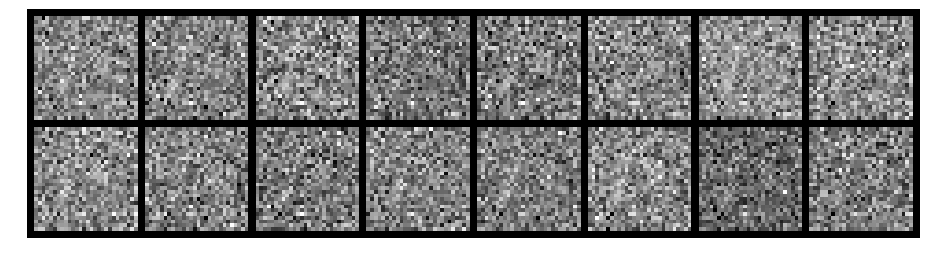

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3809, Generator Loss: 0.6798
D(x): 0.5095, D(G(z)): 0.5065


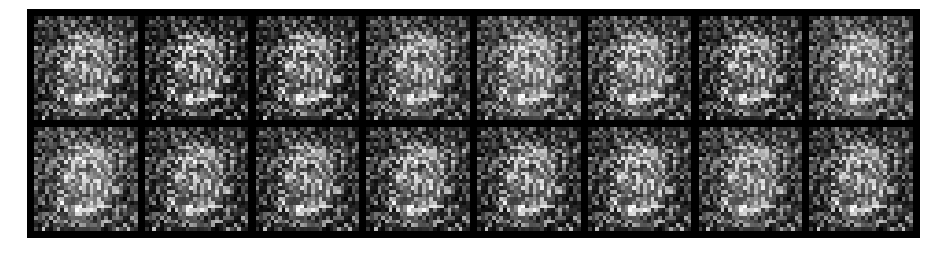

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.5948, Generator Loss: 1.1829
D(x): 0.6939, D(G(z)): 0.6379


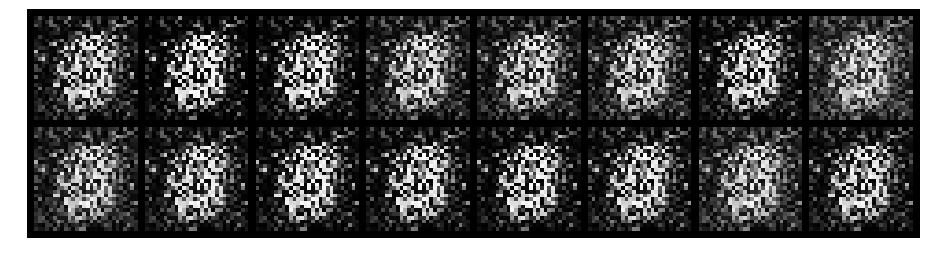

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.7603, Generator Loss: 3.4832
D(x): 0.7788, D(G(z)): 0.3022


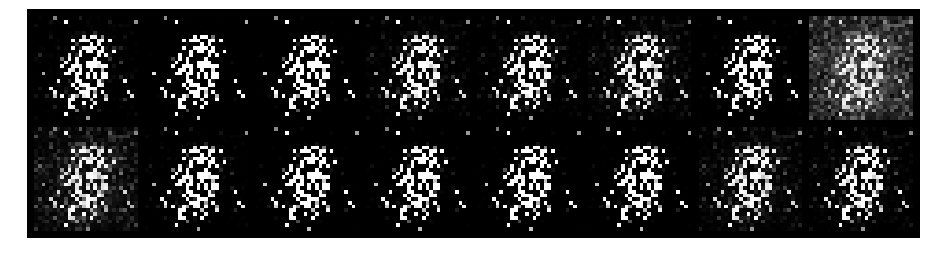

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.1081, Generator Loss: 6.9087
D(x): 0.9345, D(G(z)): 0.0167


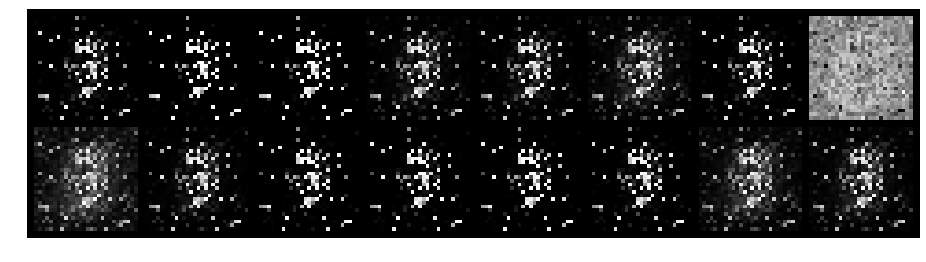

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.0276, Generator Loss: 7.9707
D(x): 0.9927, D(G(z)): 0.0184


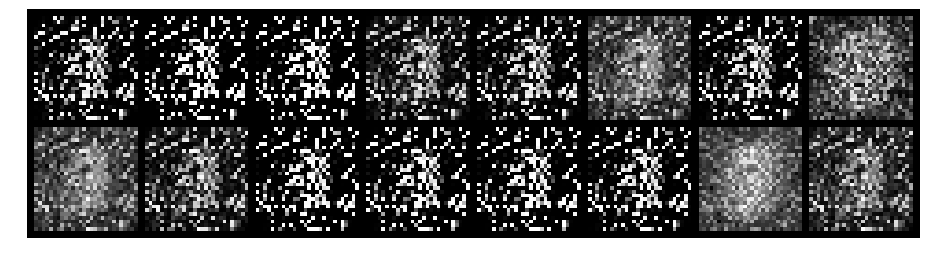

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.4521, Generator Loss: 7.5303
D(x): 0.7026, D(G(z)): 0.0184


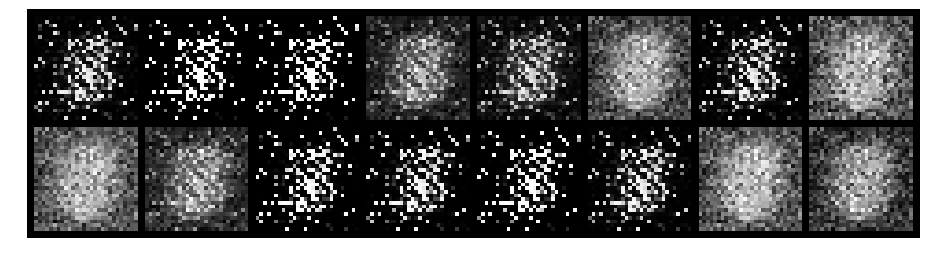

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.2921, Generator Loss: 6.4119
D(x): 0.9541, D(G(z)): 0.1340


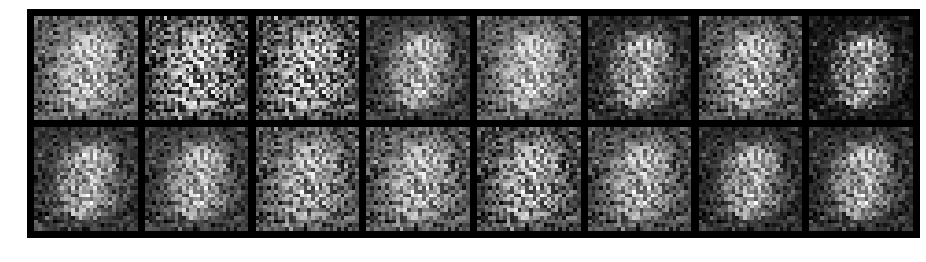

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.1530, Generator Loss: 2.0130
D(x): 0.7279, D(G(z)): 0.4422


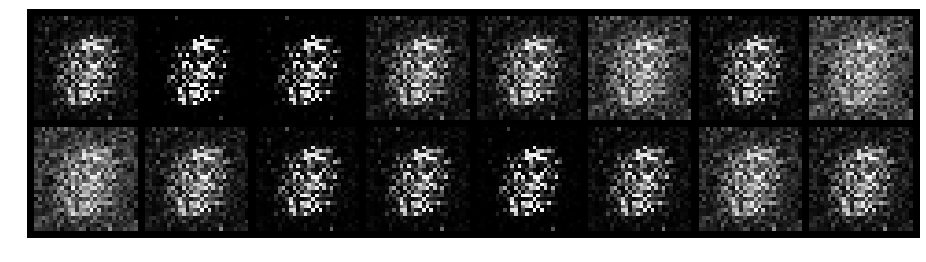

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.4809, Generator Loss: 2.9310
D(x): 0.7940, D(G(z)): 0.1320


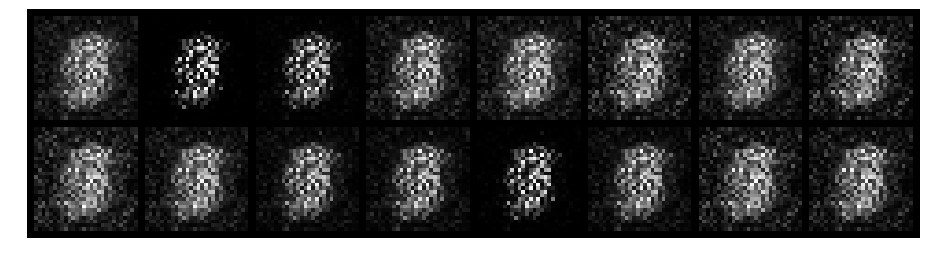

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.5886, Generator Loss: 6.5703
D(x): 0.8235, D(G(z)): 0.1764


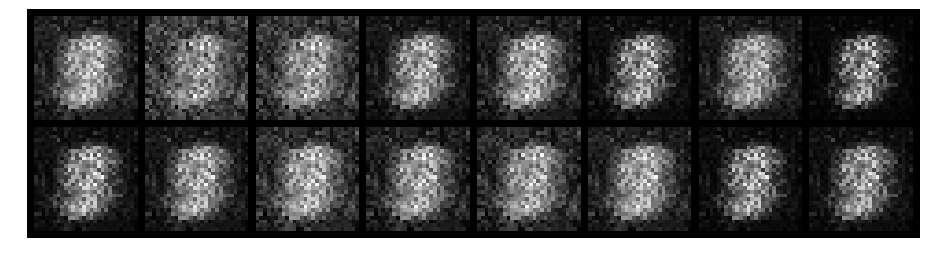

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.4444, Generator Loss: 1.4279
D(x): 0.6786, D(G(z)): 0.4377


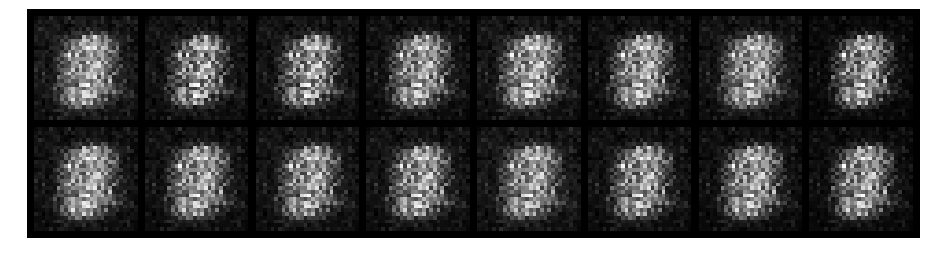

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.5417, Generator Loss: 3.1590
D(x): 0.8108, D(G(z)): 0.1882


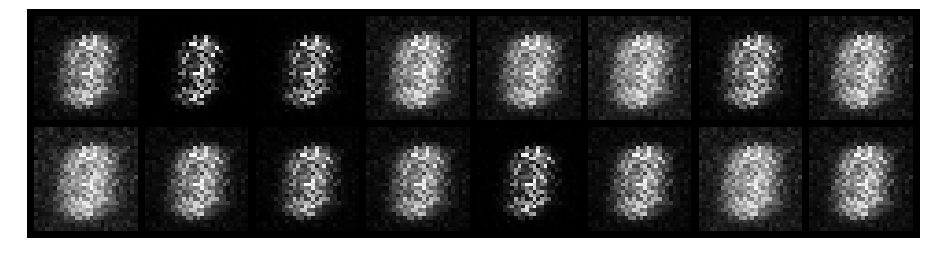

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 1.1305, Generator Loss: 1.4615
D(x): 0.6178, D(G(z)): 0.3840


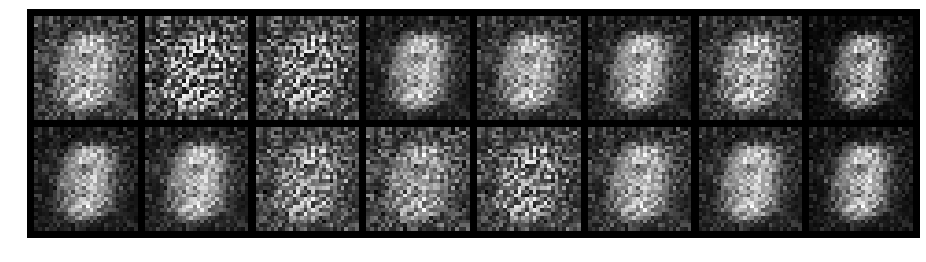

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 1.0130, Generator Loss: 2.1126
D(x): 0.7536, D(G(z)): 0.3646


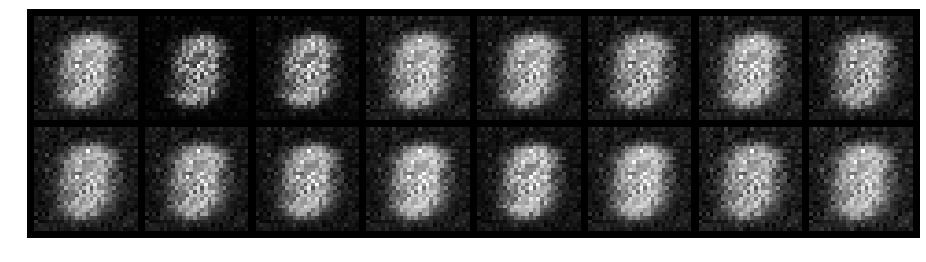

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.4524, Generator Loss: 0.6551
D(x): 0.6662, D(G(z)): 0.5890


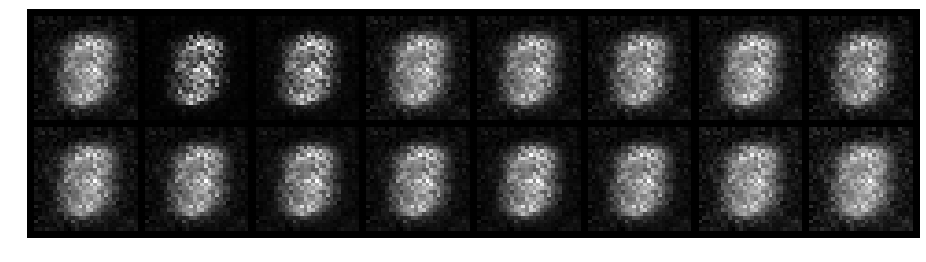

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.7835, Generator Loss: 1.2845
D(x): 0.7153, D(G(z)): 0.3272


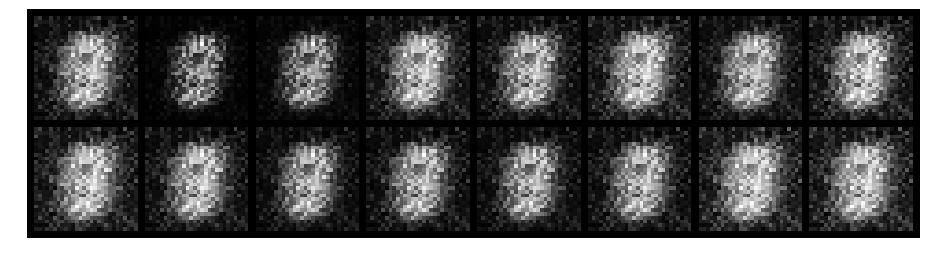

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 1.0579, Generator Loss: 1.0626
D(x): 0.6572, D(G(z)): 0.4121


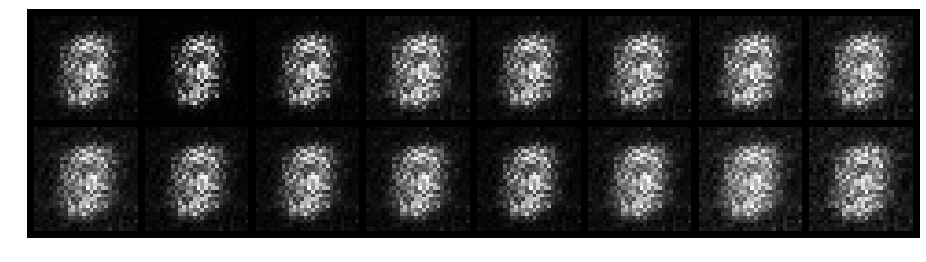

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.7288, Generator Loss: 2.4144
D(x): 0.8568, D(G(z)): 0.2908


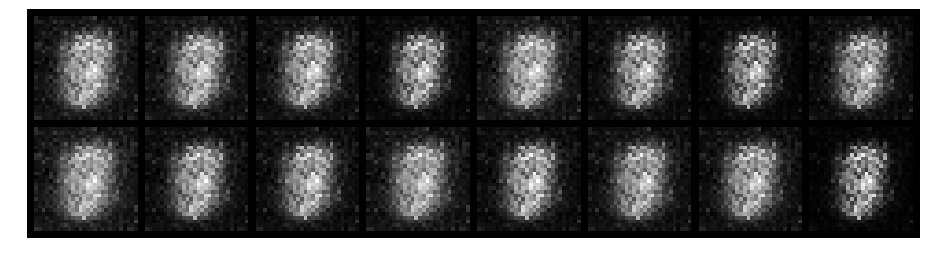

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.6190, Generator Loss: 1.4009
D(x): 0.8154, D(G(z)): 0.2421


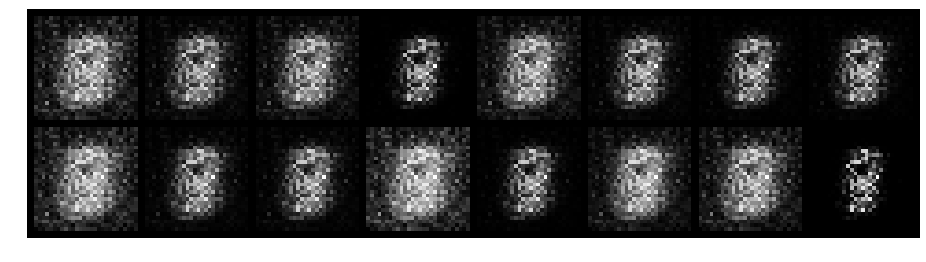

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.4174, Generator Loss: 3.1408
D(x): 0.8515, D(G(z)): 0.1393


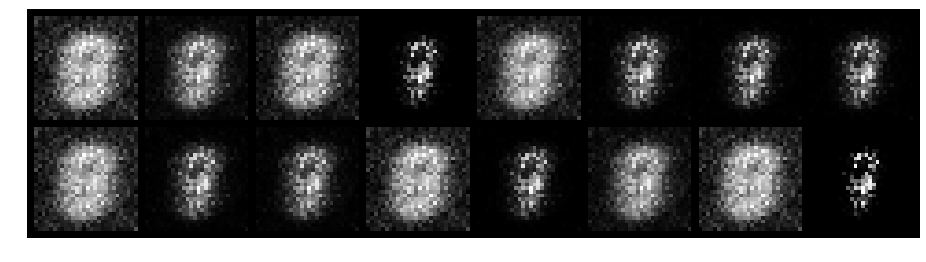

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 1.1542, Generator Loss: 2.7537
D(x): 0.8751, D(G(z)): 0.4187


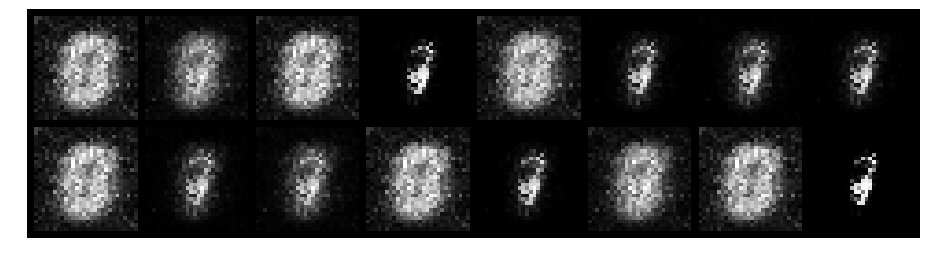

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.6317, Generator Loss: 3.1200
D(x): 0.7884, D(G(z)): 0.1028


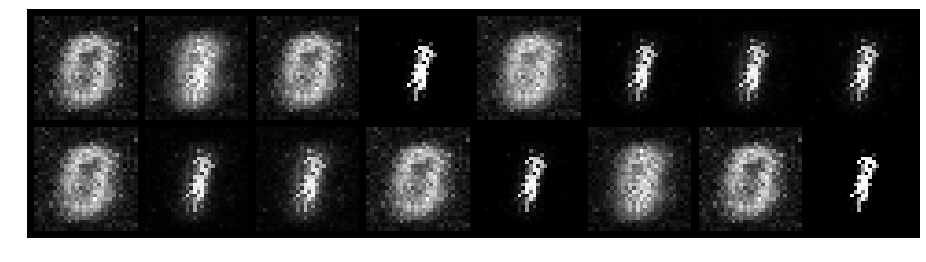

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 1.0437, Generator Loss: 1.7471
D(x): 0.7541, D(G(z)): 0.3137


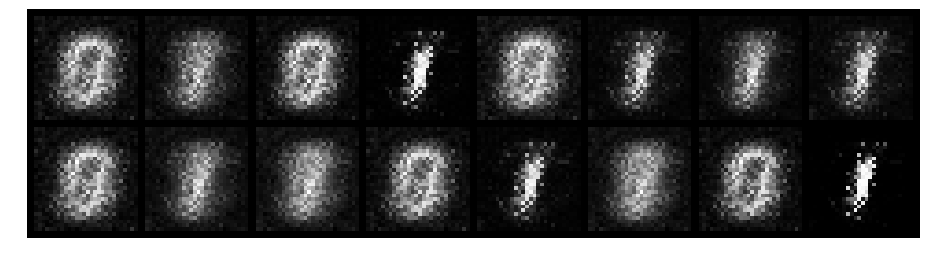

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.4128, Generator Loss: 2.7918
D(x): 0.9059, D(G(z)): 0.1552


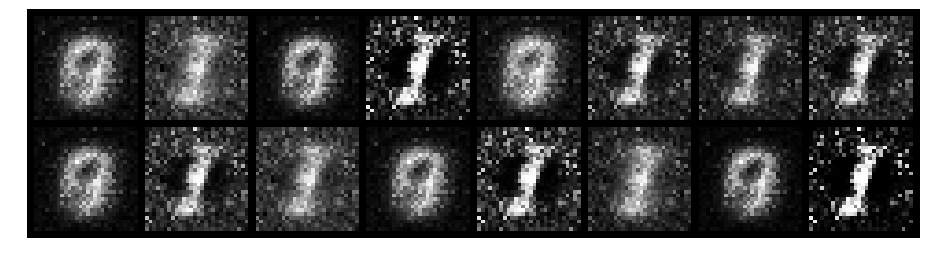

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.6233, Generator Loss: 3.6096
D(x): 0.8452, D(G(z)): 0.1951


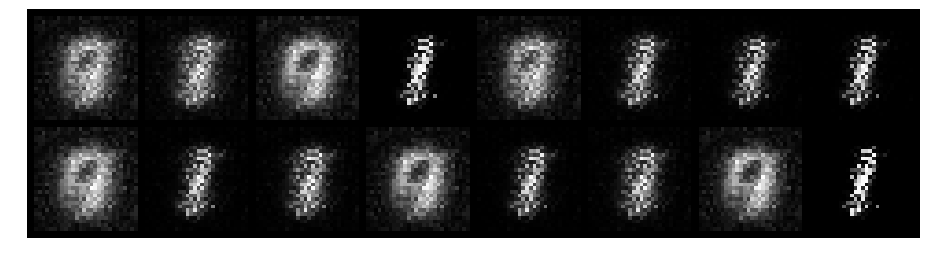

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.7944, Generator Loss: 2.0089
D(x): 0.7643, D(G(z)): 0.2142


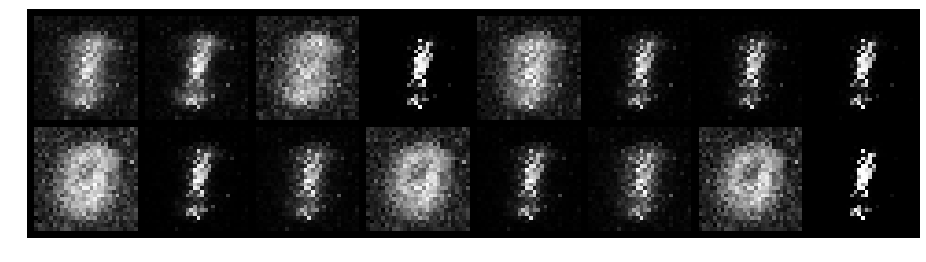

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.4012, Generator Loss: 3.0454
D(x): 0.9071, D(G(z)): 0.1389


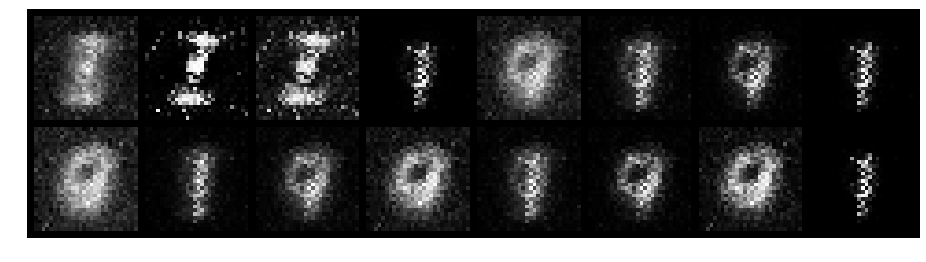

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.5756, Generator Loss: 2.4605
D(x): 0.8326, D(G(z)): 0.1487


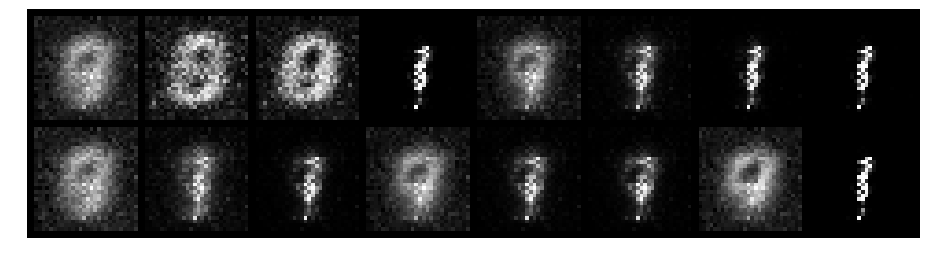

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.3355, Generator Loss: 4.3780
D(x): 0.9318, D(G(z)): 0.1374


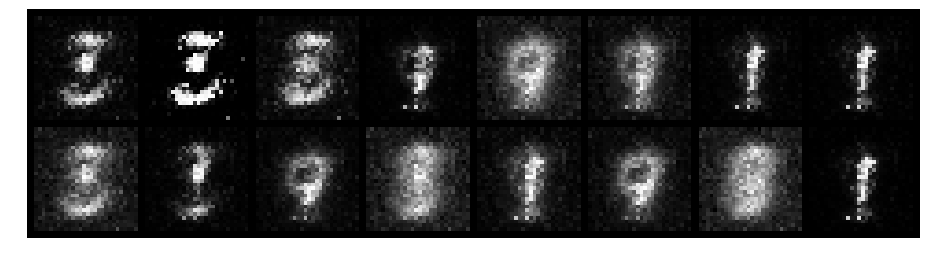

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.4873, Generator Loss: 3.8591
D(x): 0.8587, D(G(z)): 0.1186


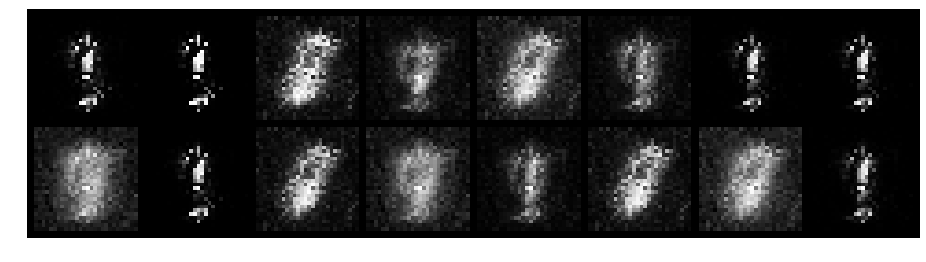

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.2062, Generator Loss: 4.1009
D(x): 0.9177, D(G(z)): 0.0473


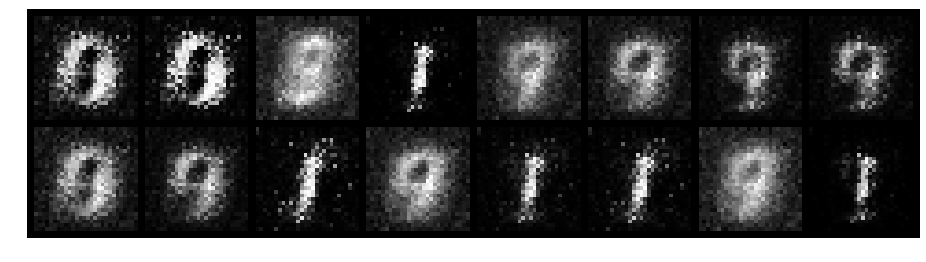

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.5625, Generator Loss: 2.8576
D(x): 0.8239, D(G(z)): 0.1689


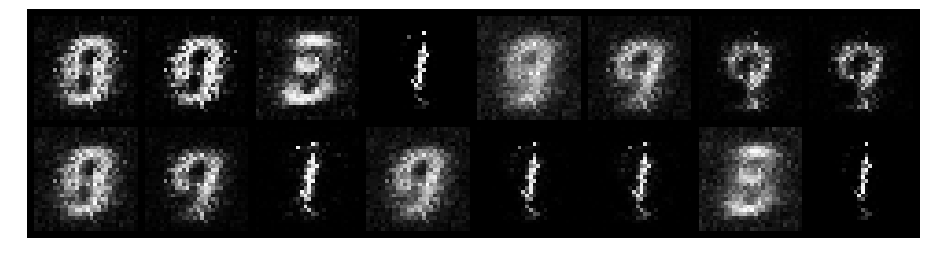

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.5707, Generator Loss: 4.2307
D(x): 0.7903, D(G(z)): 0.0579


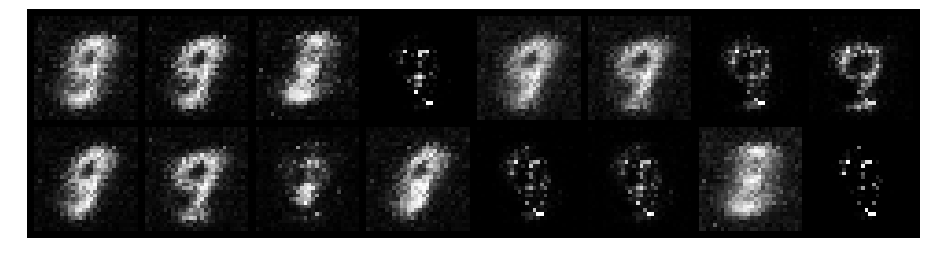

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.3385, Generator Loss: 4.5269
D(x): 0.9390, D(G(z)): 0.1464


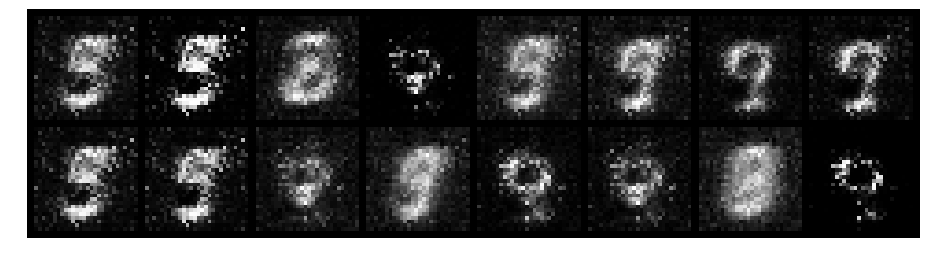

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.4829, Generator Loss: 3.7618
D(x): 0.9099, D(G(z)): 0.2228


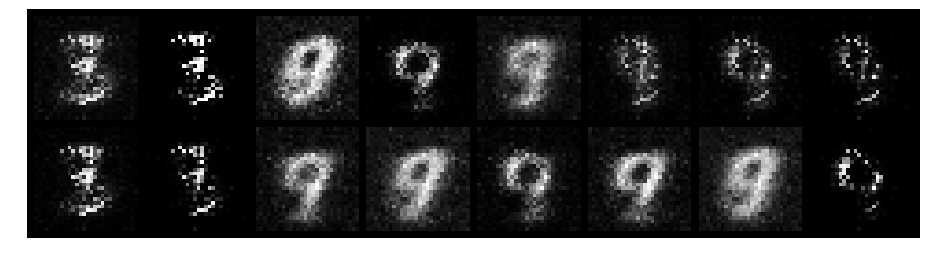

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.9254, Generator Loss: 2.3301
D(x): 0.8088, D(G(z)): 0.3511


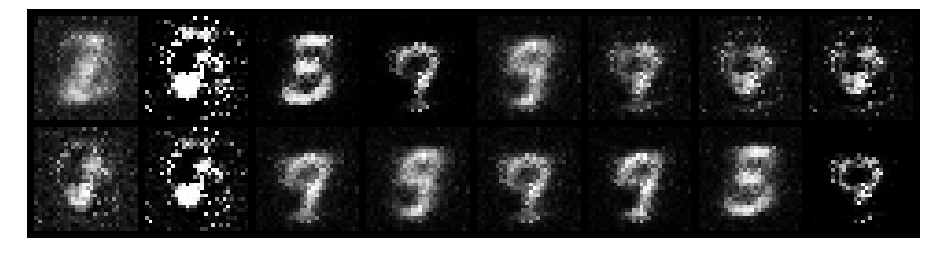

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.3885, Generator Loss: 3.1446
D(x): 0.8888, D(G(z)): 0.1227


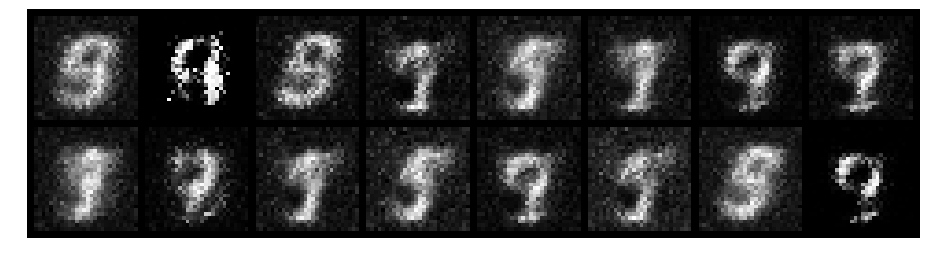

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.7837, Generator Loss: 1.7163
D(x): 0.8353, D(G(z)): 0.3181


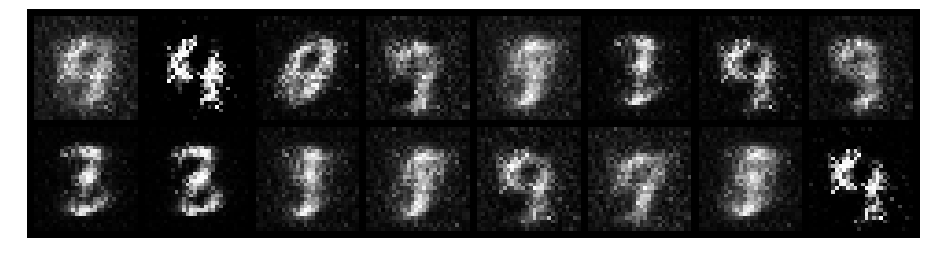

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 1.0696, Generator Loss: 1.1019
D(x): 0.7584, D(G(z)): 0.4098


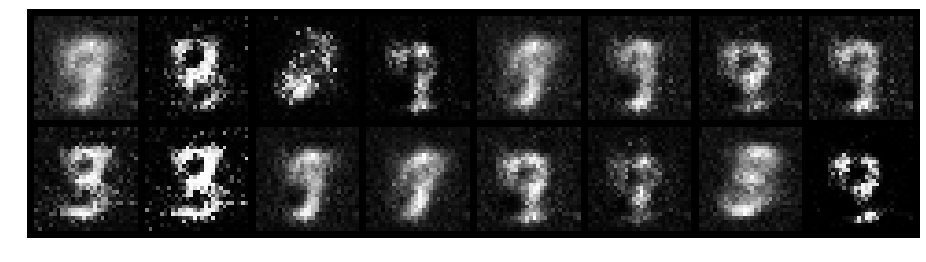

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 1.1214, Generator Loss: 1.7518
D(x): 0.7702, D(G(z)): 0.4021


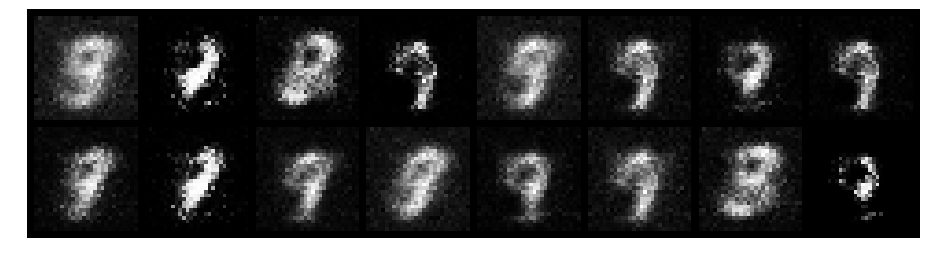

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.6182, Generator Loss: 2.5797
D(x): 0.7940, D(G(z)): 0.1591


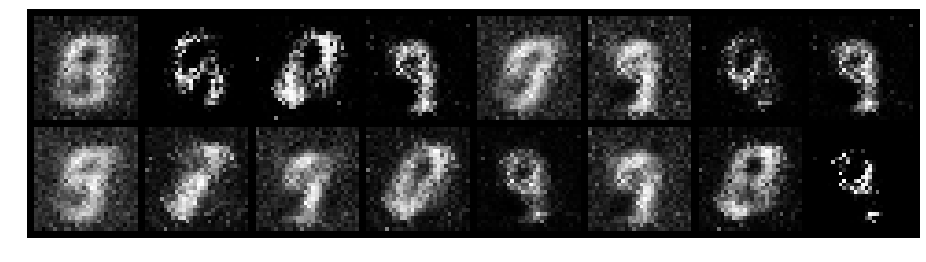

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.4534, Generator Loss: 3.7711
D(x): 0.8534, D(G(z)): 0.1182


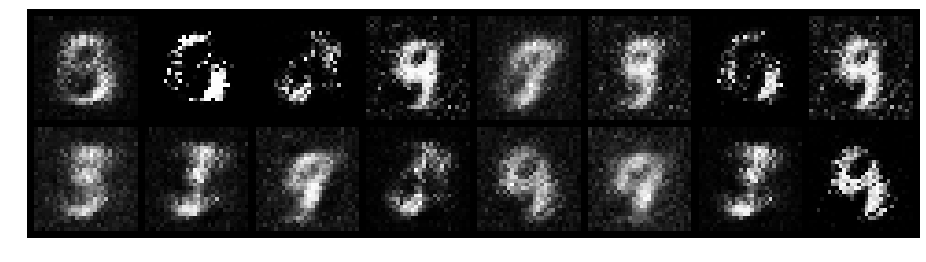

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.5402, Generator Loss: 3.9514
D(x): 0.8331, D(G(z)): 0.1833


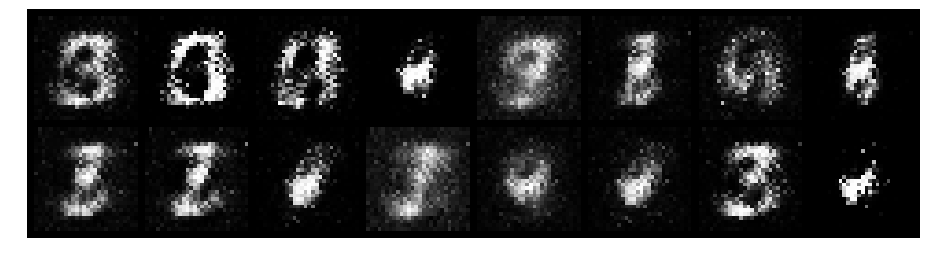

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.4785, Generator Loss: 1.8940
D(x): 0.8638, D(G(z)): 0.2225


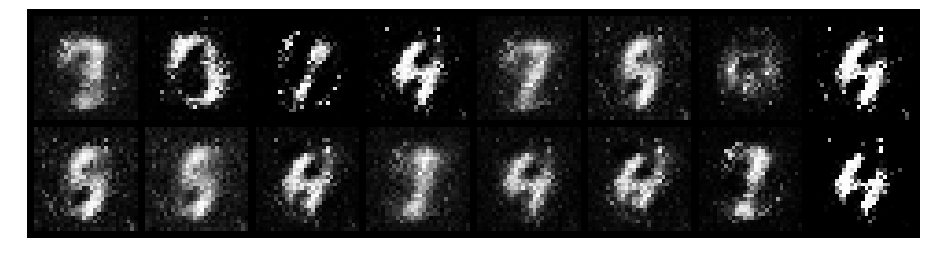

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.5879, Generator Loss: 2.7194
D(x): 0.8686, D(G(z)): 0.2510


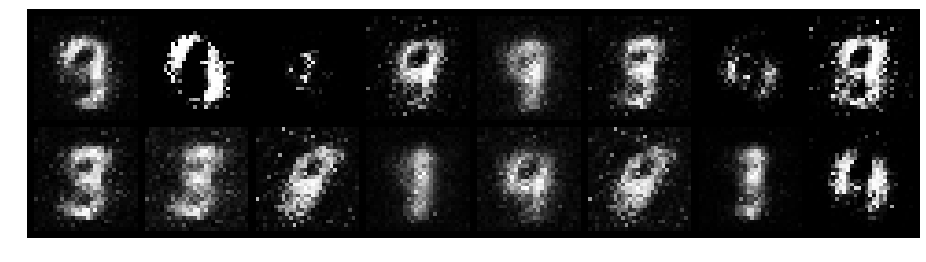

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.4353, Generator Loss: 2.7813
D(x): 0.8204, D(G(z)): 0.1197


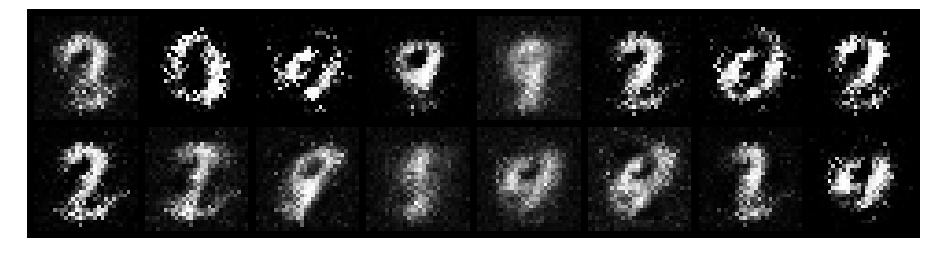

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.5859, Generator Loss: 2.4356
D(x): 0.8889, D(G(z)): 0.2233


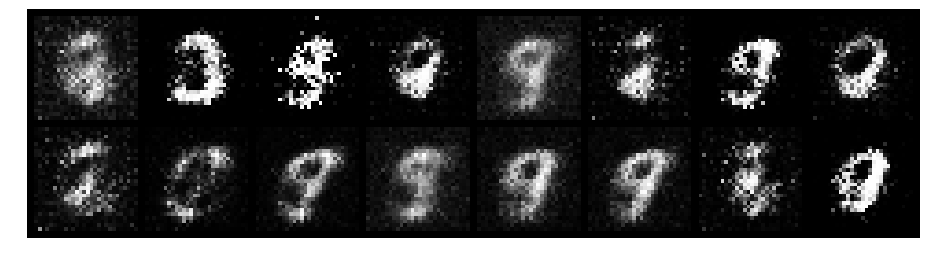

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.3213, Generator Loss: 3.2153
D(x): 0.9122, D(G(z)): 0.1489


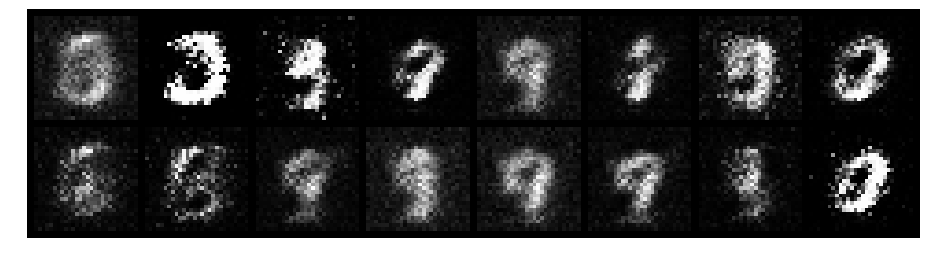

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.4788, Generator Loss: 2.9807
D(x): 0.8634, D(G(z)): 0.1503


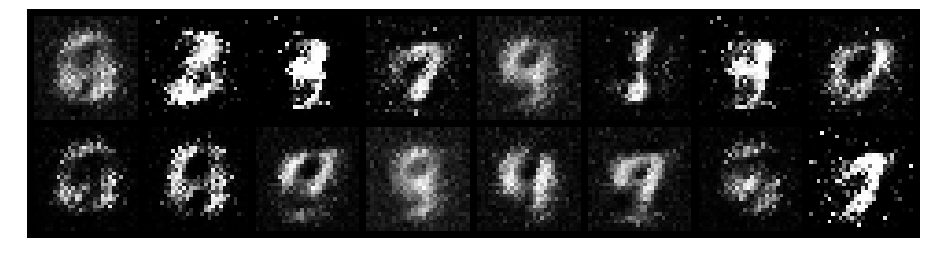

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5923, Generator Loss: 2.0411
D(x): 0.8106, D(G(z)): 0.1861


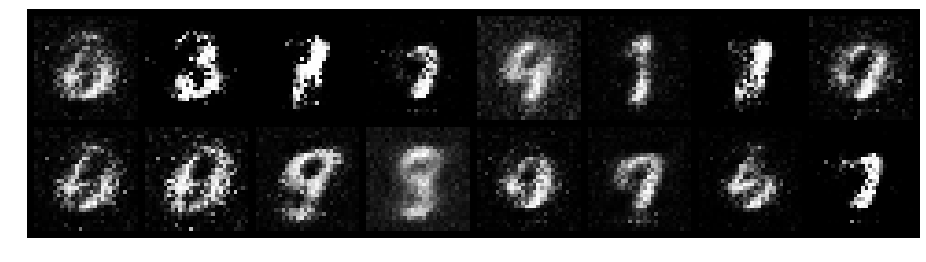

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.7687, Generator Loss: 1.8270
D(x): 0.7593, D(G(z)): 0.2835


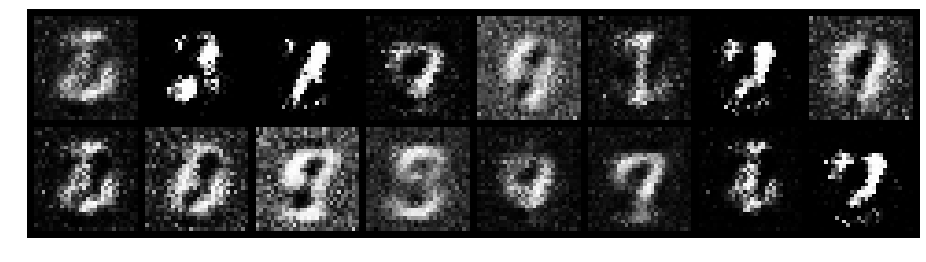

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.7487, Generator Loss: 1.8625
D(x): 0.7799, D(G(z)): 0.2649


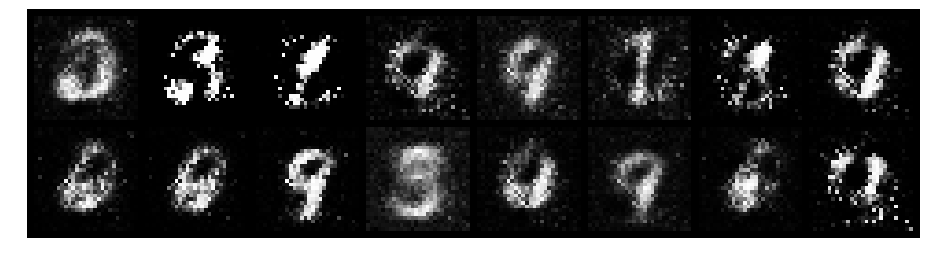

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.6993, Generator Loss: 2.9362
D(x): 0.7279, D(G(z)): 0.1538


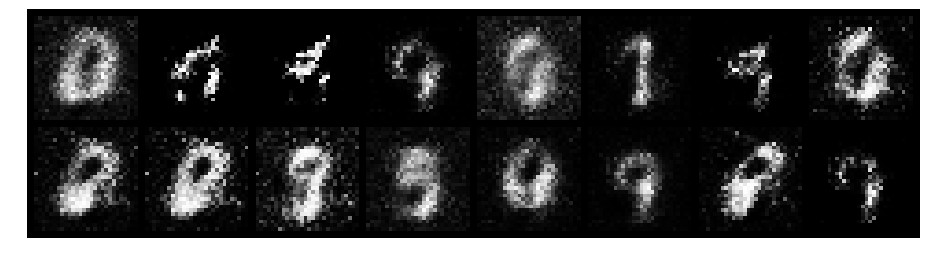

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5651, Generator Loss: 2.6374
D(x): 0.8376, D(G(z)): 0.1978


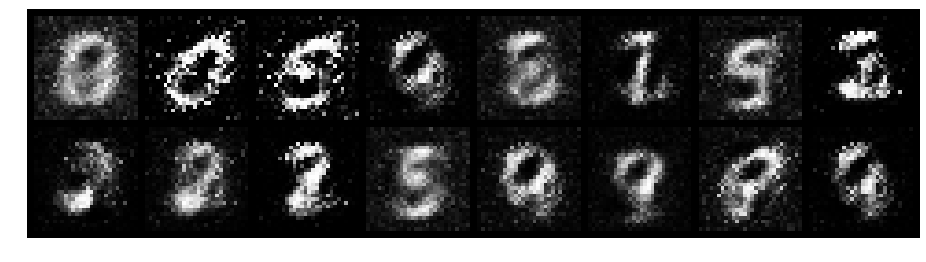

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7248, Generator Loss: 2.2927
D(x): 0.8056, D(G(z)): 0.2669


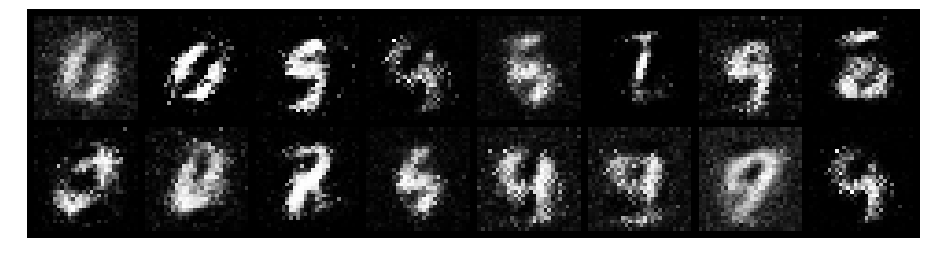

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.5214, Generator Loss: 2.0606
D(x): 0.8584, D(G(z)): 0.1960


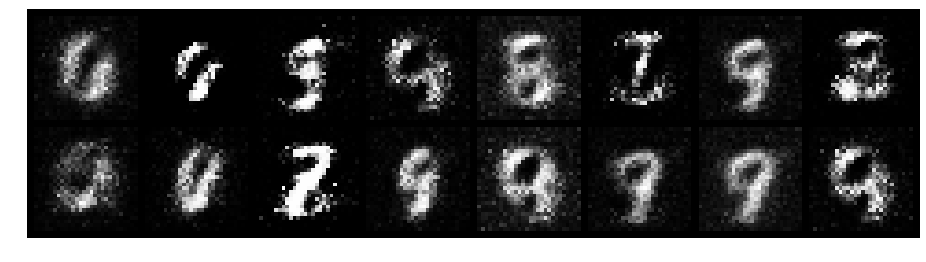

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.6090, Generator Loss: 3.9294
D(x): 0.8079, D(G(z)): 0.1062


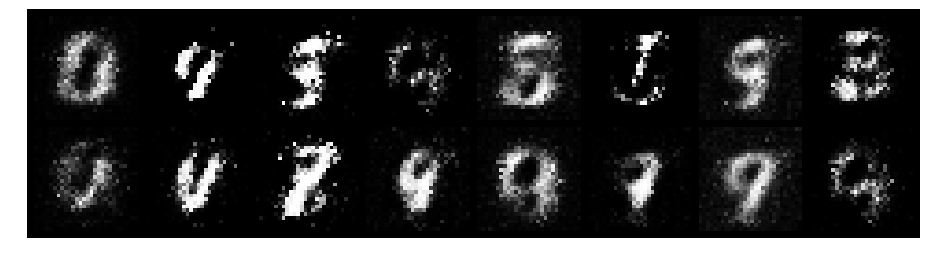

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.1895, Generator Loss: 3.5097
D(x): 0.9291, D(G(z)): 0.0814


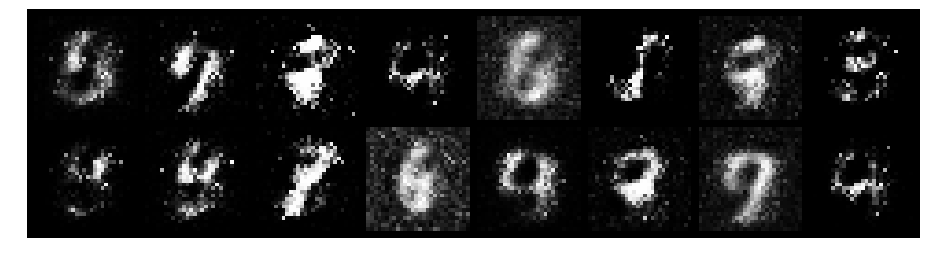

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.5300, Generator Loss: 2.8983
D(x): 0.8356, D(G(z)): 0.2066


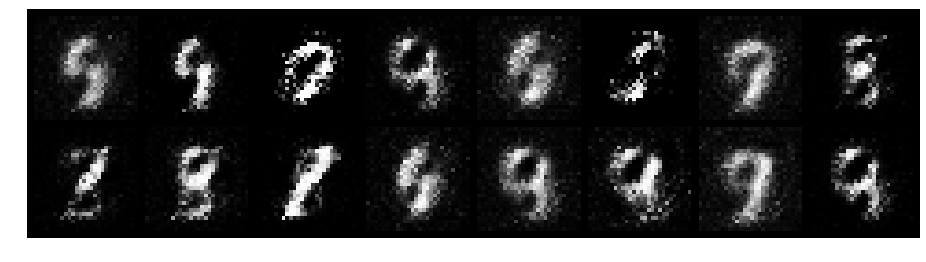

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.6731, Generator Loss: 2.4686
D(x): 0.7629, D(G(z)): 0.1861


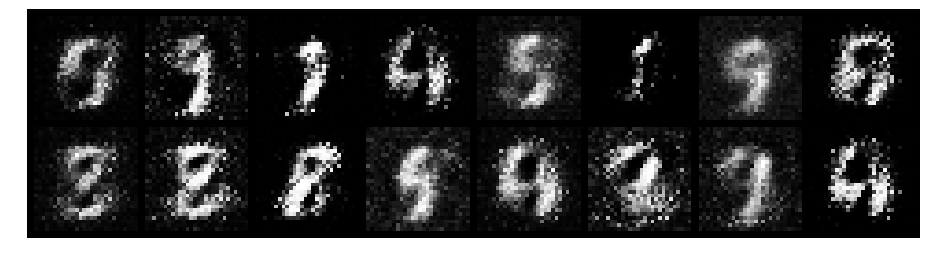

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.5935, Generator Loss: 2.7640
D(x): 0.8111, D(G(z)): 0.1833


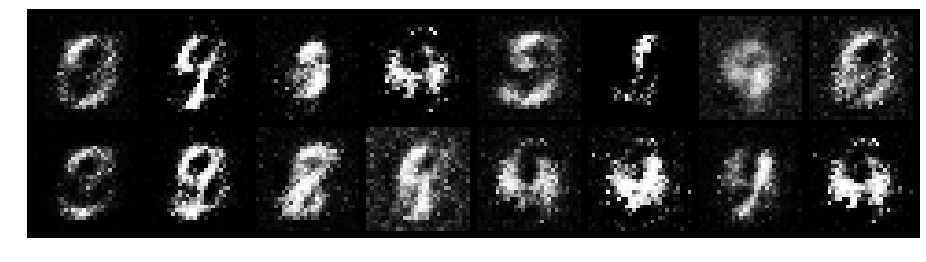

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.6654, Generator Loss: 3.2480
D(x): 0.7782, D(G(z)): 0.1492


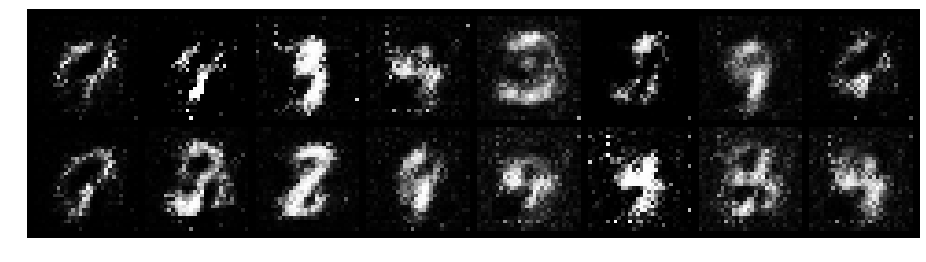

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.8551, Generator Loss: 2.5406
D(x): 0.7125, D(G(z)): 0.1696


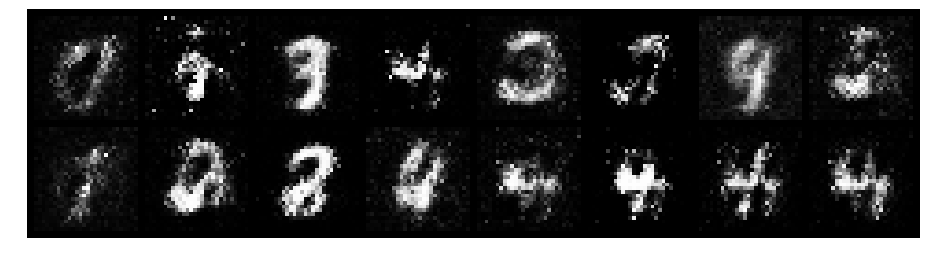

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.4959, Generator Loss: 2.8782
D(x): 0.8433, D(G(z)): 0.1874


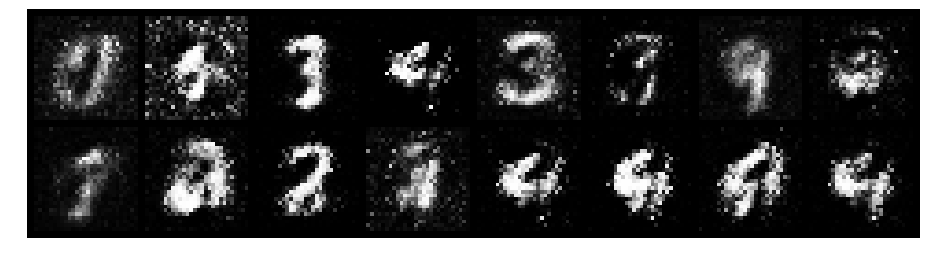

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.7856, Generator Loss: 2.1602
D(x): 0.6992, D(G(z)): 0.1886


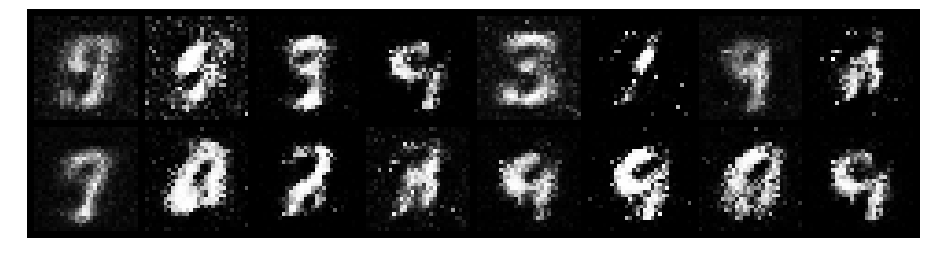

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.4650, Generator Loss: 2.7270
D(x): 0.8106, D(G(z)): 0.1062


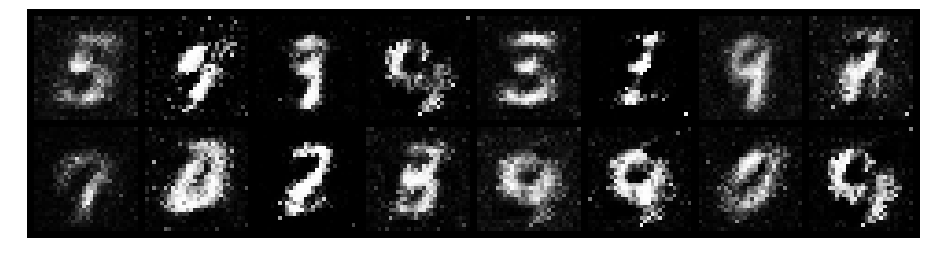

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.4803, Generator Loss: 2.7677
D(x): 0.8365, D(G(z)): 0.1357


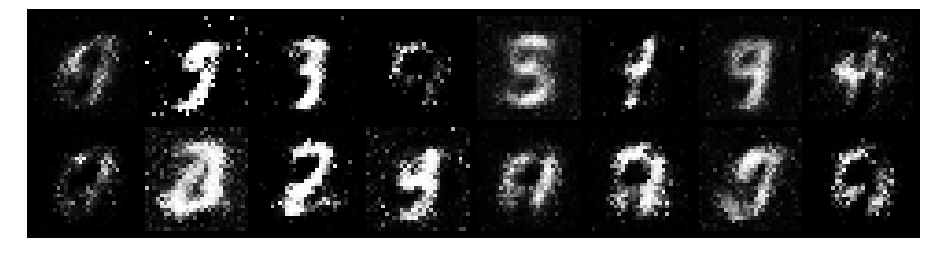

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.6848, Generator Loss: 2.7143
D(x): 0.7586, D(G(z)): 0.1709


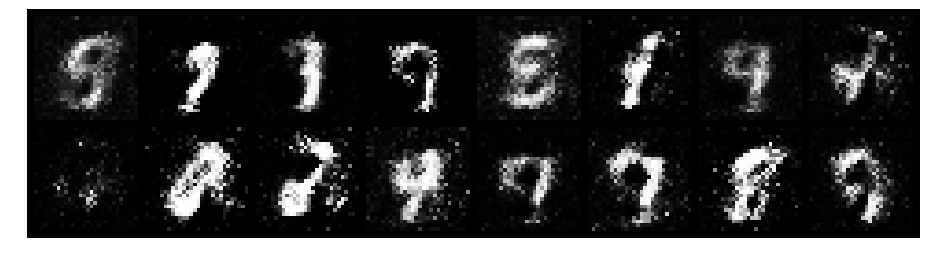

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.8113, Generator Loss: 1.9782
D(x): 0.7321, D(G(z)): 0.2520


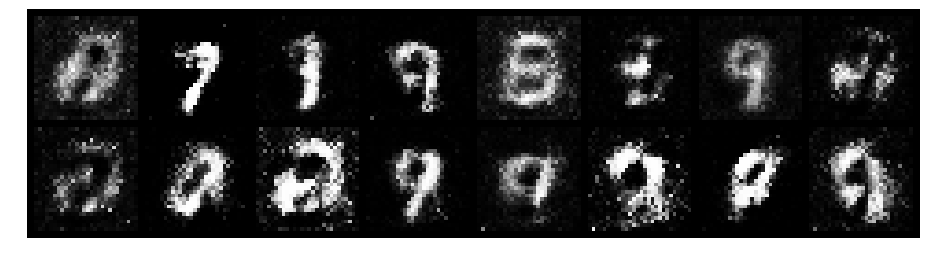

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.7914, Generator Loss: 1.7047
D(x): 0.7399, D(G(z)): 0.2303


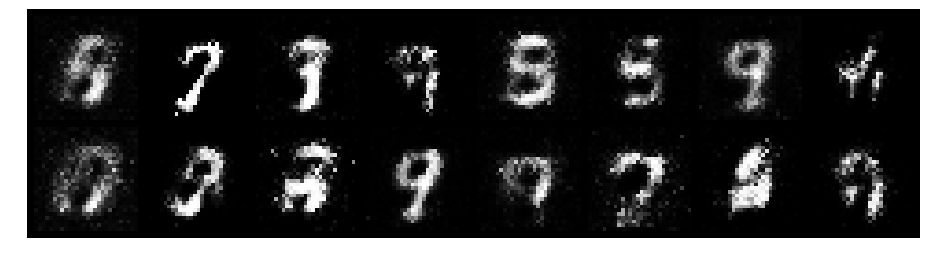

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.6305, Generator Loss: 2.5474
D(x): 0.7937, D(G(z)): 0.1786


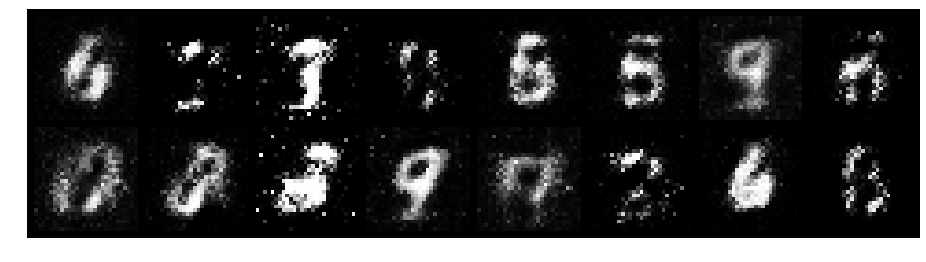

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.7416, Generator Loss: 2.1239
D(x): 0.7537, D(G(z)): 0.2376


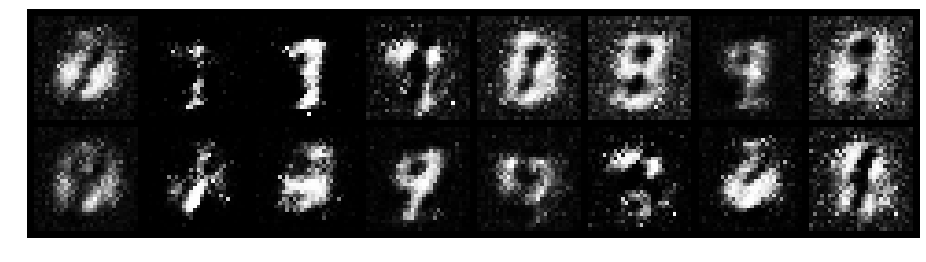

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.7020, Generator Loss: 1.5752
D(x): 0.7564, D(G(z)): 0.2584


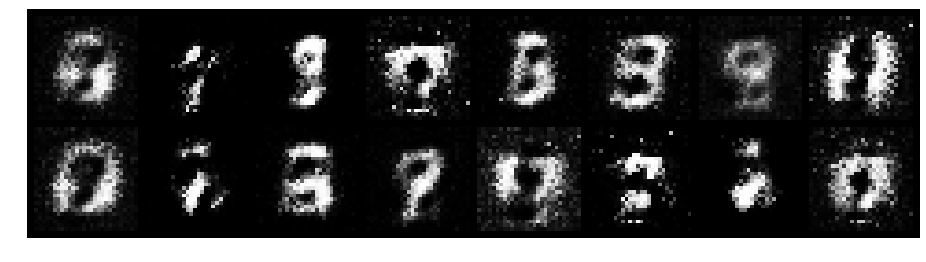

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.8075, Generator Loss: 1.5603
D(x): 0.7091, D(G(z)): 0.2731


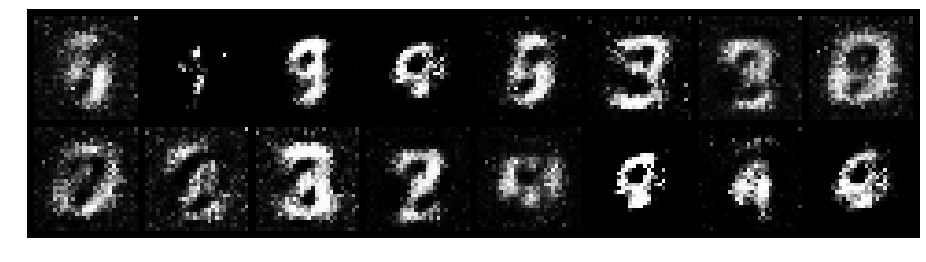

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.6461, Generator Loss: 2.6601
D(x): 0.7667, D(G(z)): 0.2035


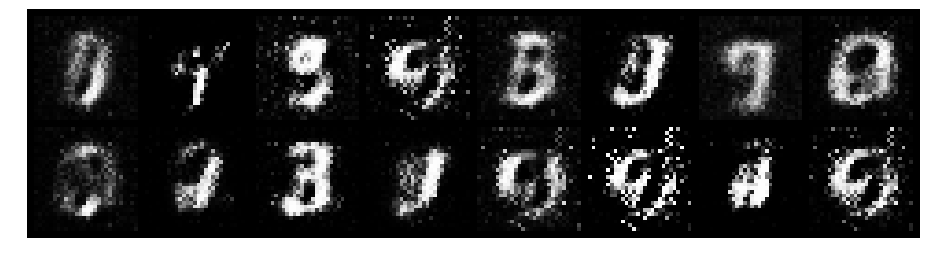

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.6382, Generator Loss: 2.5977
D(x): 0.8003, D(G(z)): 0.2237


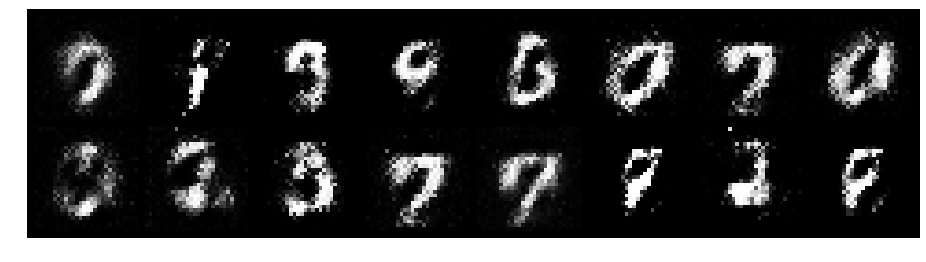

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.5529, Generator Loss: 3.0453
D(x): 0.7836, D(G(z)): 0.1325


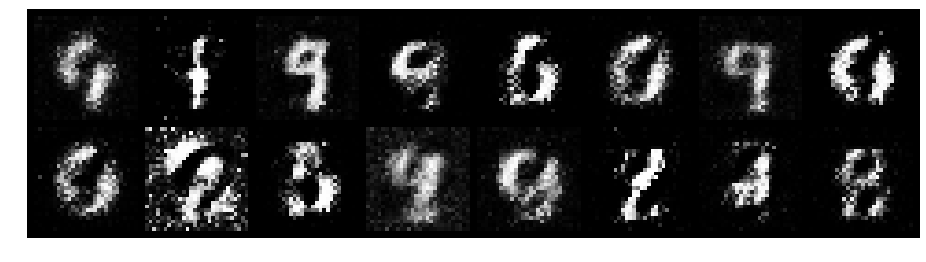

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.6767, Generator Loss: 2.3185
D(x): 0.8498, D(G(z)): 0.2172


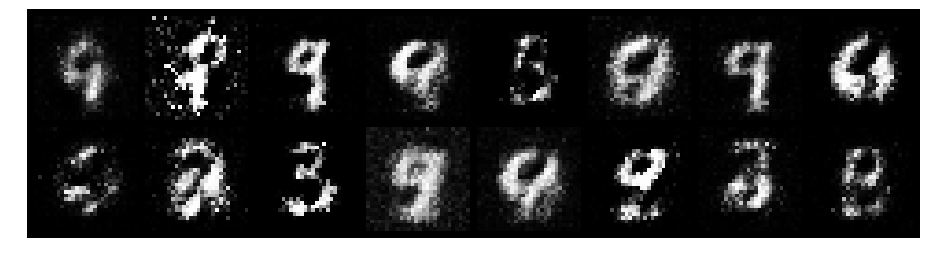

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.3763, Generator Loss: 3.2196
D(x): 0.8988, D(G(z)): 0.1393


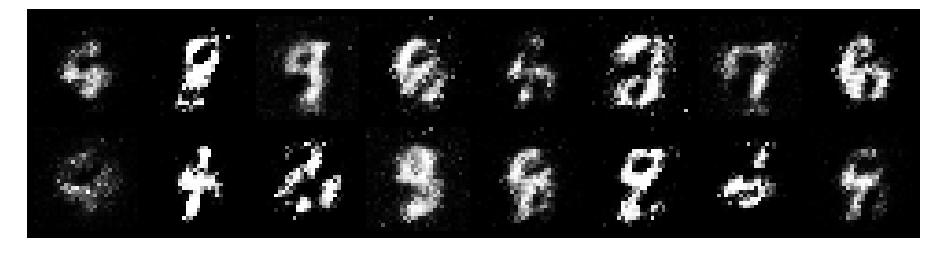

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.5532, Generator Loss: 2.7189
D(x): 0.8127, D(G(z)): 0.1511


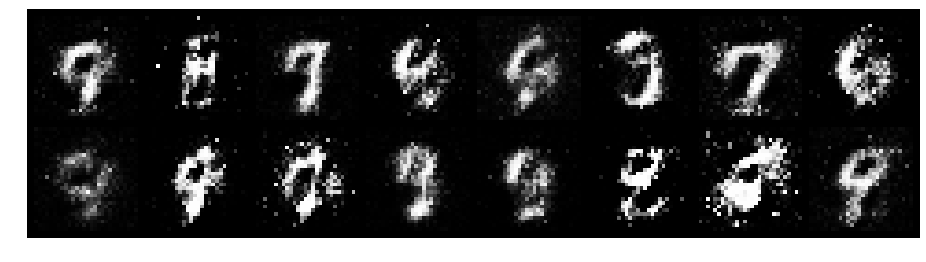

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.4670, Generator Loss: 2.0607
D(x): 0.9324, D(G(z)): 0.2423


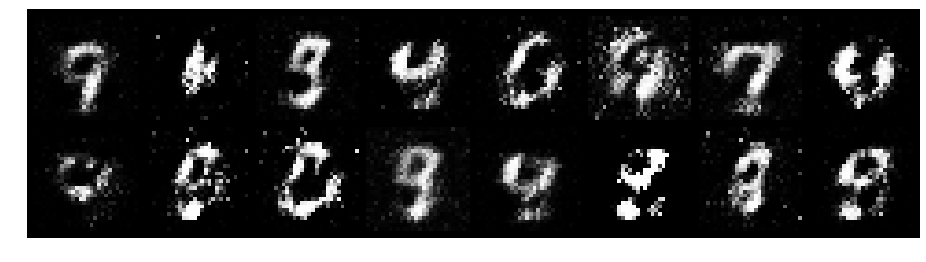

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.7692, Generator Loss: 3.2988
D(x): 0.8527, D(G(z)): 0.2619


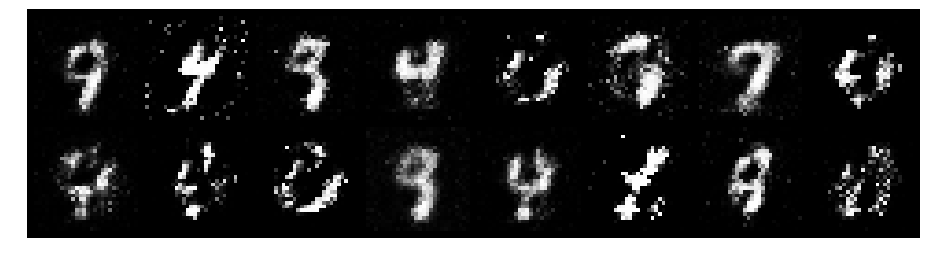

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.5531, Generator Loss: 2.0827
D(x): 0.8786, D(G(z)): 0.2579


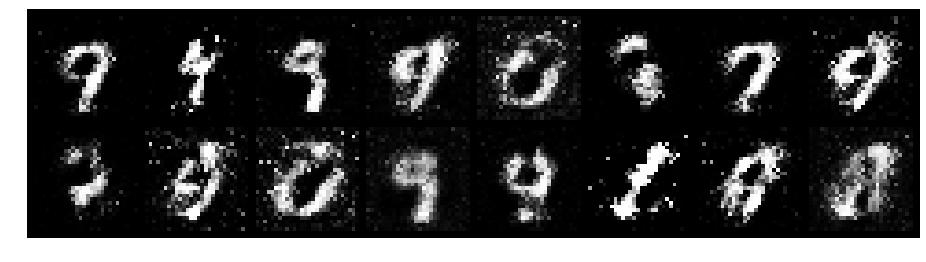

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.5615, Generator Loss: 2.5185
D(x): 0.7423, D(G(z)): 0.1357


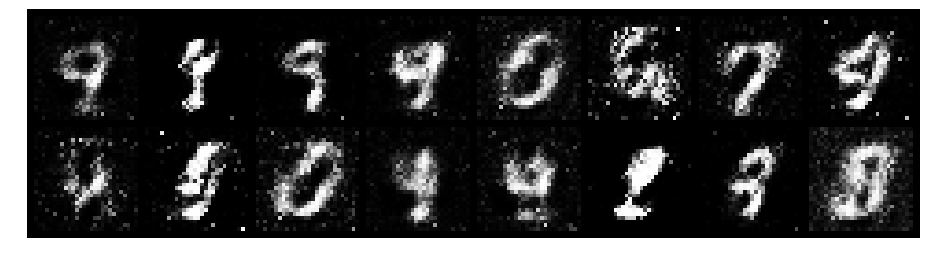

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.6330, Generator Loss: 1.8673
D(x): 0.8138, D(G(z)): 0.2411


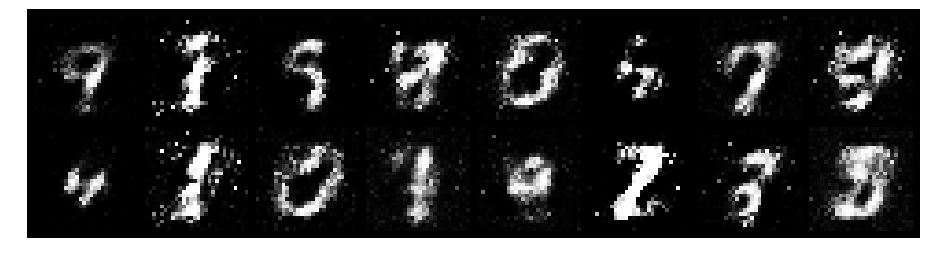

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.9978, Generator Loss: 1.9345
D(x): 0.6969, D(G(z)): 0.2733


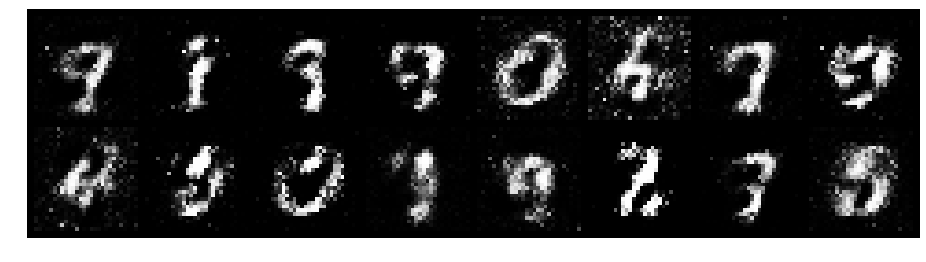

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.7750, Generator Loss: 1.7403
D(x): 0.8456, D(G(z)): 0.3618


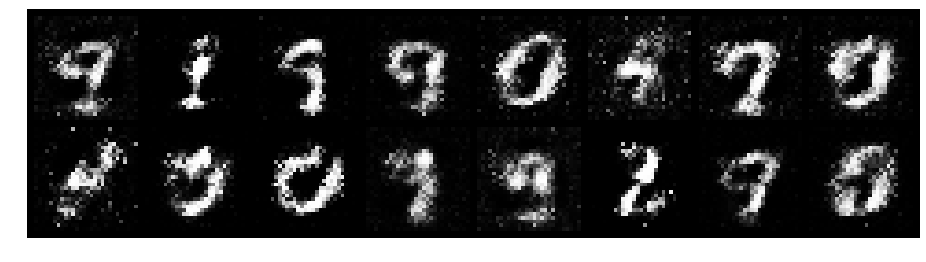

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.8453, Generator Loss: 1.4882
D(x): 0.7792, D(G(z)): 0.3427


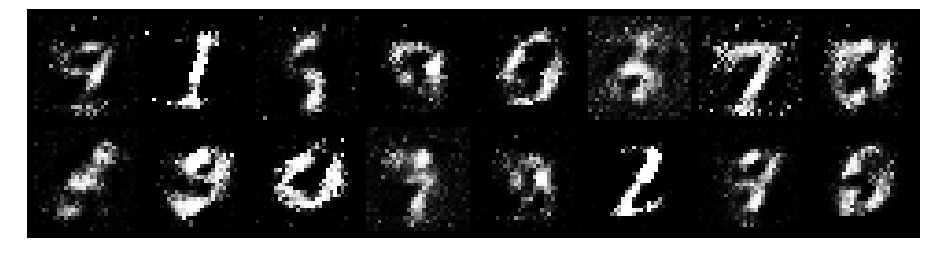

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8729, Generator Loss: 1.7224
D(x): 0.7459, D(G(z)): 0.2989


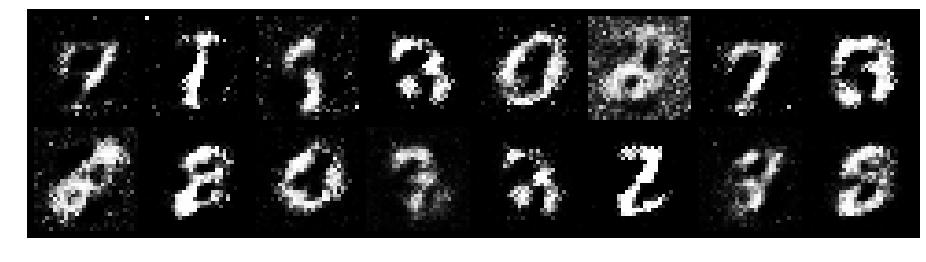

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.5653, Generator Loss: 1.6626
D(x): 0.7843, D(G(z)): 0.1894


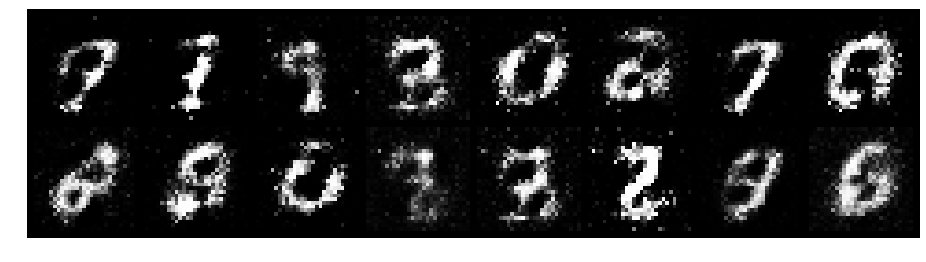

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.8529, Generator Loss: 1.4494
D(x): 0.7796, D(G(z)): 0.3141


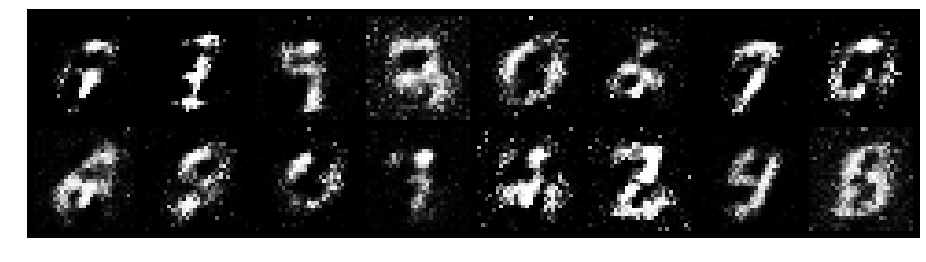

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.6504, Generator Loss: 1.9433
D(x): 0.8131, D(G(z)): 0.2453


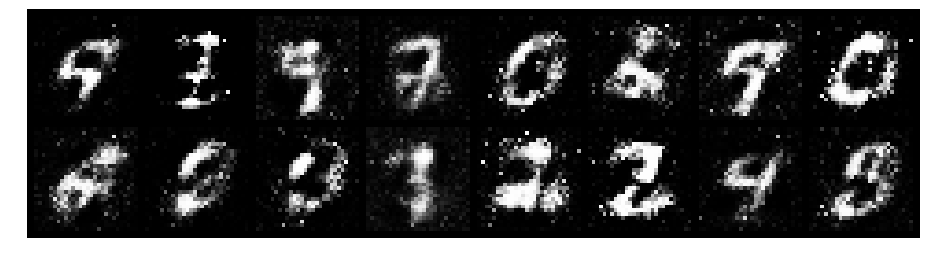

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.7656, Generator Loss: 1.9197
D(x): 0.7064, D(G(z)): 0.2509


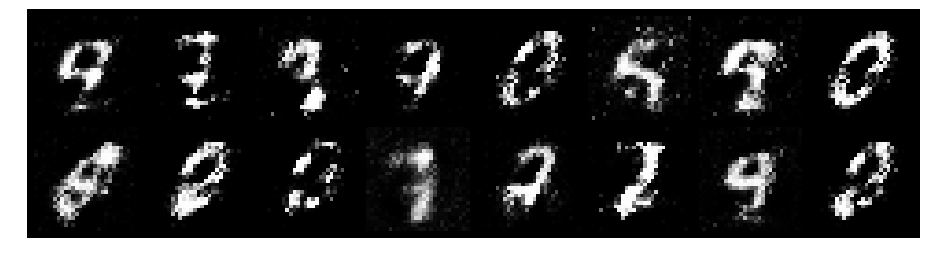

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.8855, Generator Loss: 1.6573
D(x): 0.7242, D(G(z)): 0.3056


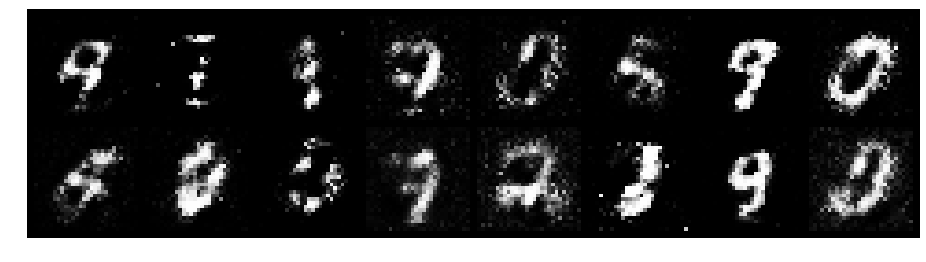

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.7978, Generator Loss: 1.7008
D(x): 0.7911, D(G(z)): 0.2932


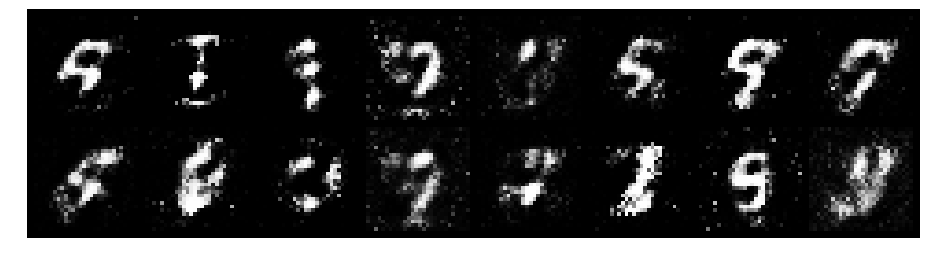

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.9195, Generator Loss: 1.9023
D(x): 0.7058, D(G(z)): 0.2829


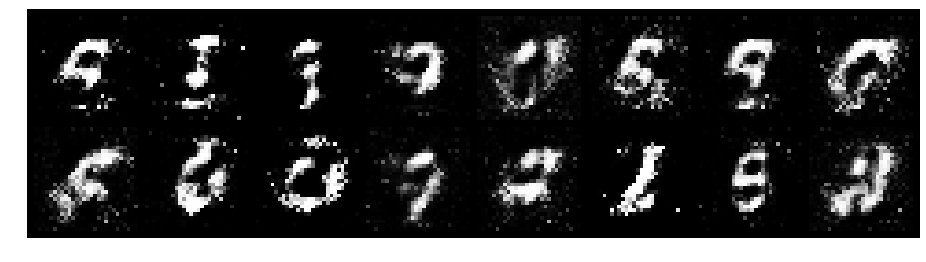

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.8118, Generator Loss: 2.7570
D(x): 0.7290, D(G(z)): 0.2438


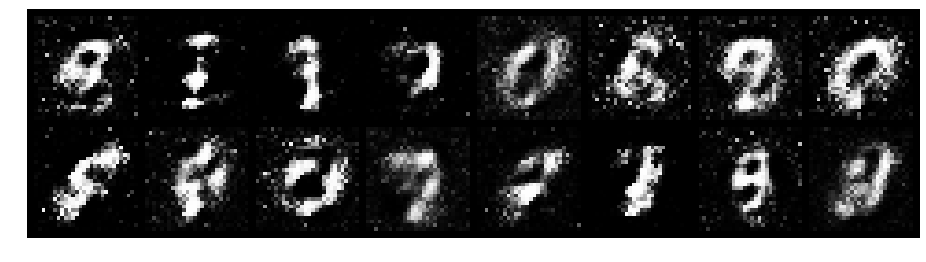

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.8150, Generator Loss: 2.4786
D(x): 0.7359, D(G(z)): 0.2083


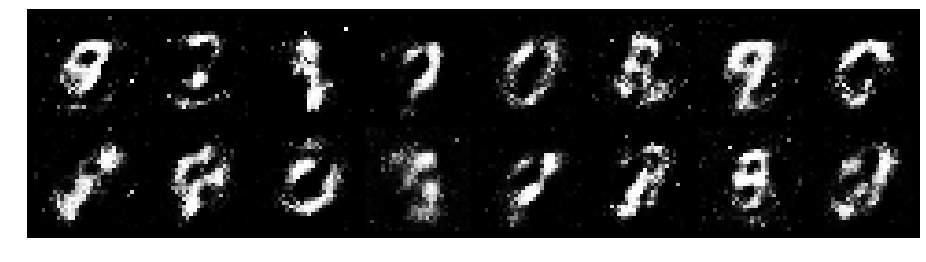

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.5655, Generator Loss: 1.8088
D(x): 0.8314, D(G(z)): 0.2393


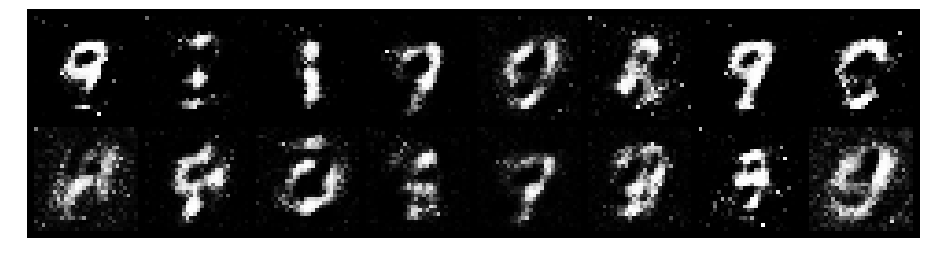

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 1.1360, Generator Loss: 1.2822
D(x): 0.6202, D(G(z)): 0.3016


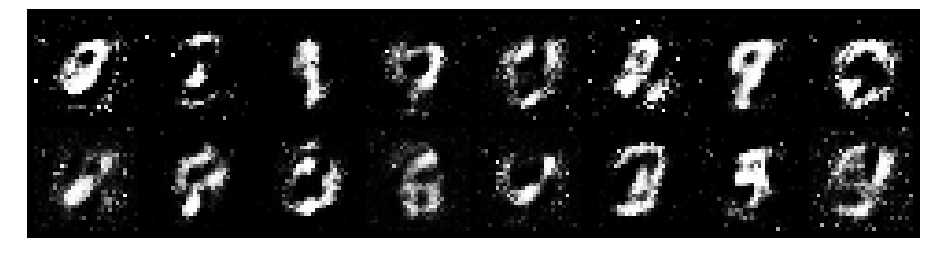

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.8029, Generator Loss: 1.9282
D(x): 0.8008, D(G(z)): 0.3315


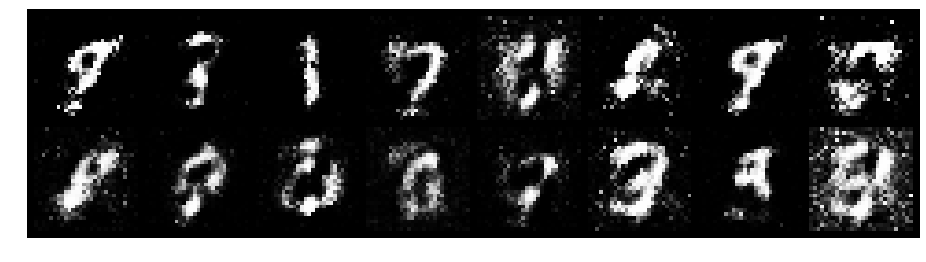

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.6159, Generator Loss: 2.1551
D(x): 0.8048, D(G(z)): 0.2544


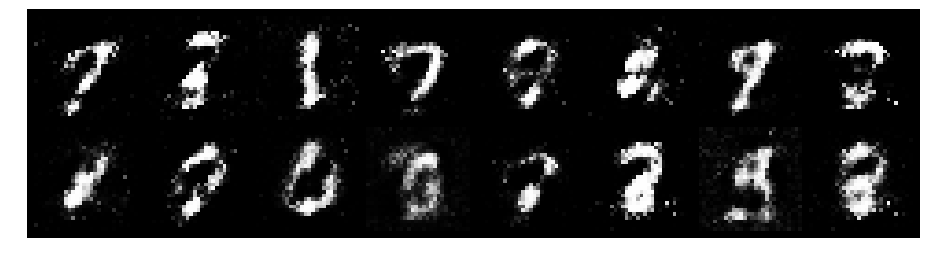

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.9074, Generator Loss: 1.7519
D(x): 0.7290, D(G(z)): 0.2708


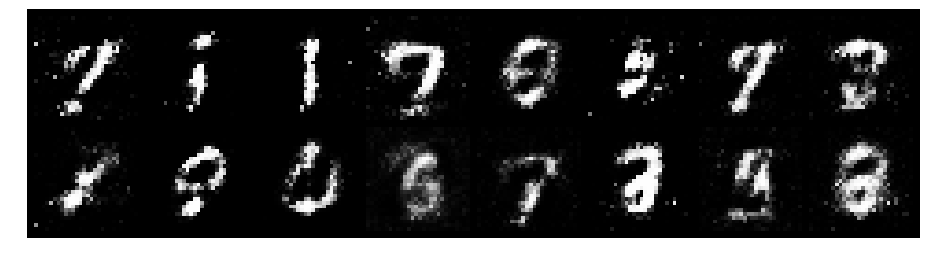

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 1.1186, Generator Loss: 1.2899
D(x): 0.7763, D(G(z)): 0.4174


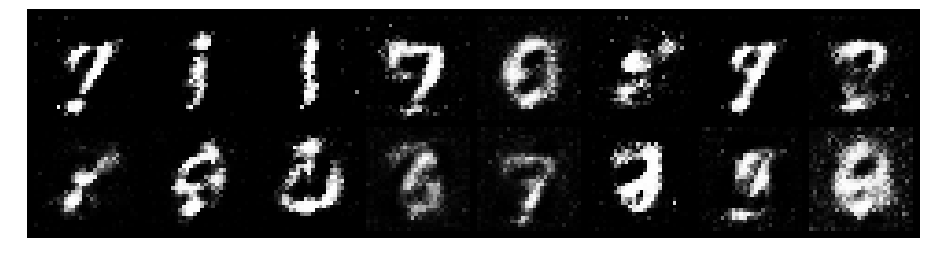

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.5984, Generator Loss: 2.3196
D(x): 0.8405, D(G(z)): 0.2412


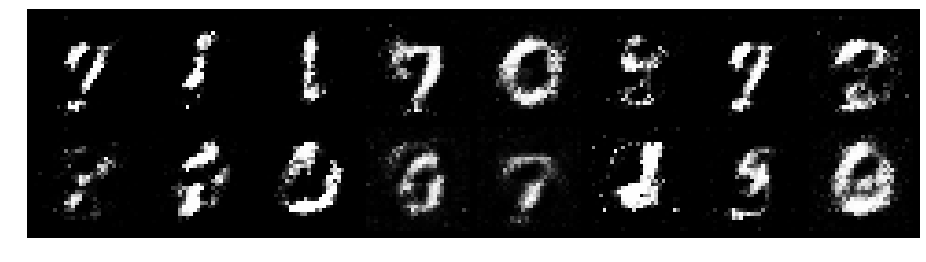

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.6857, Generator Loss: 1.6796
D(x): 0.8404, D(G(z)): 0.2701


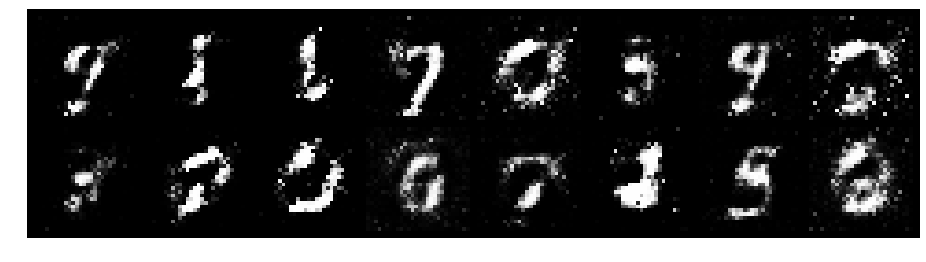

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 1.0343, Generator Loss: 1.6088
D(x): 0.6162, D(G(z)): 0.2604


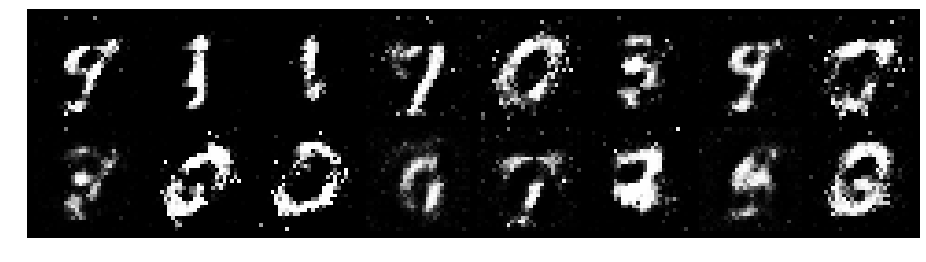

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.7172, Generator Loss: 2.1098
D(x): 0.7902, D(G(z)): 0.3009


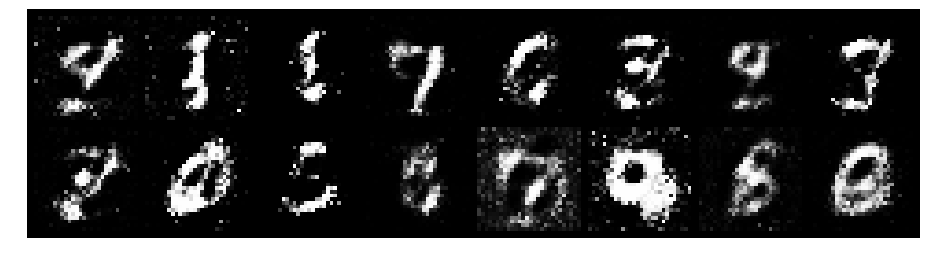

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.9094, Generator Loss: 1.5439
D(x): 0.6814, D(G(z)): 0.3241


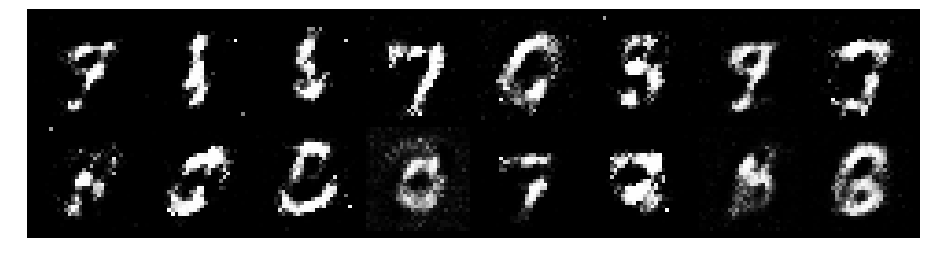

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.7917, Generator Loss: 1.4075
D(x): 0.7681, D(G(z)): 0.3009


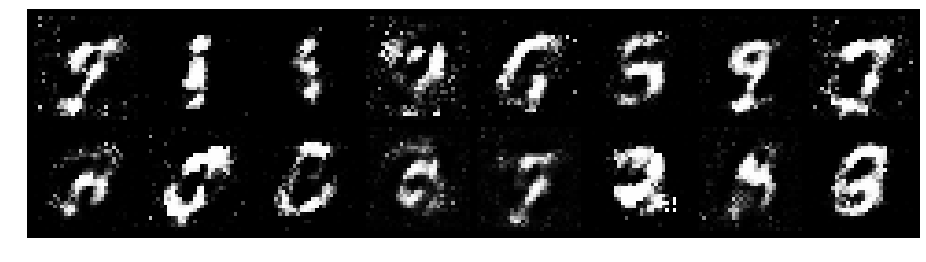

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.9226, Generator Loss: 1.5825
D(x): 0.6485, D(G(z)): 0.2363


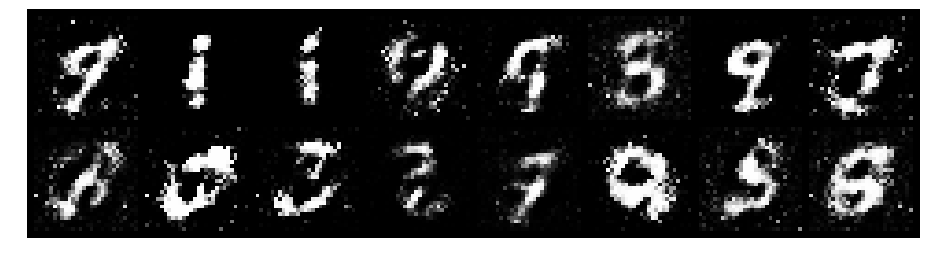

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.8613, Generator Loss: 1.7279
D(x): 0.7424, D(G(z)): 0.2872


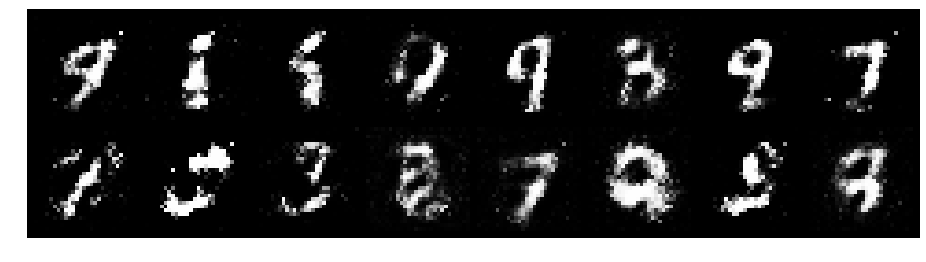

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 1.0604, Generator Loss: 1.7367
D(x): 0.6706, D(G(z)): 0.3171


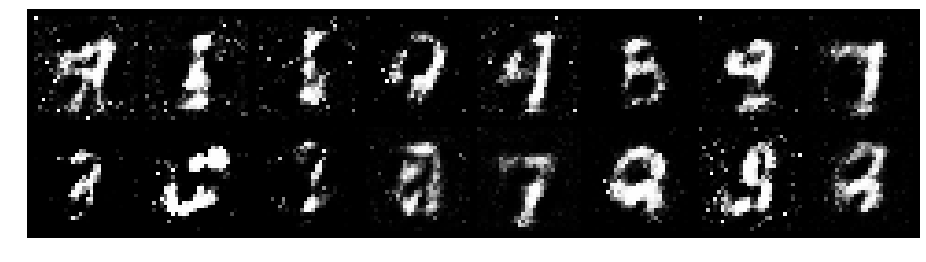

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.6300, Generator Loss: 2.2480
D(x): 0.7408, D(G(z)): 0.1883


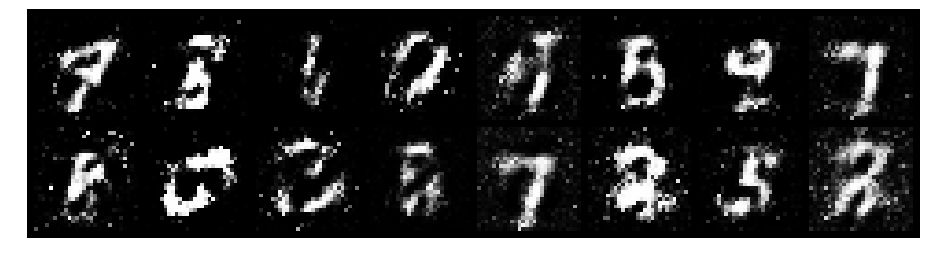

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.9333, Generator Loss: 1.1983
D(x): 0.7543, D(G(z)): 0.3725


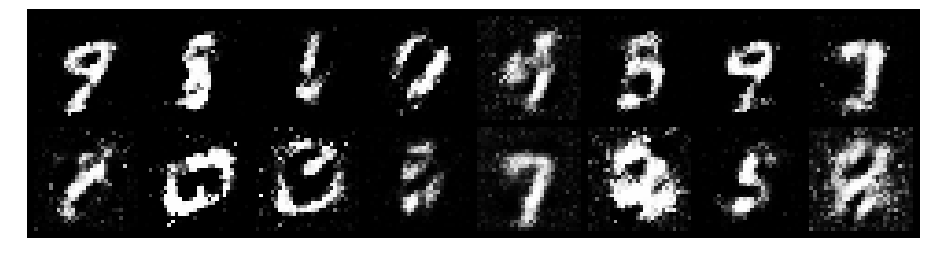

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.9020, Generator Loss: 1.8164
D(x): 0.7095, D(G(z)): 0.2968


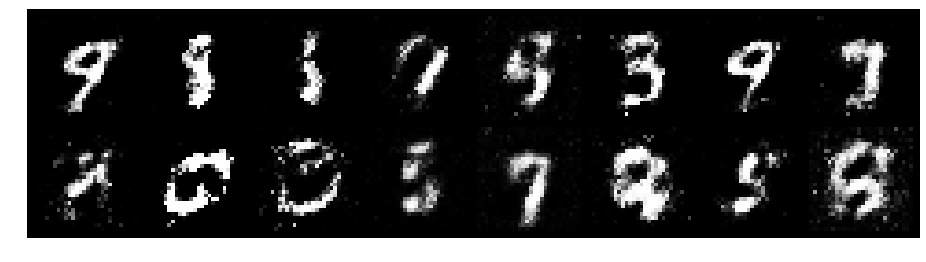

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.8571, Generator Loss: 2.0829
D(x): 0.7774, D(G(z)): 0.2966


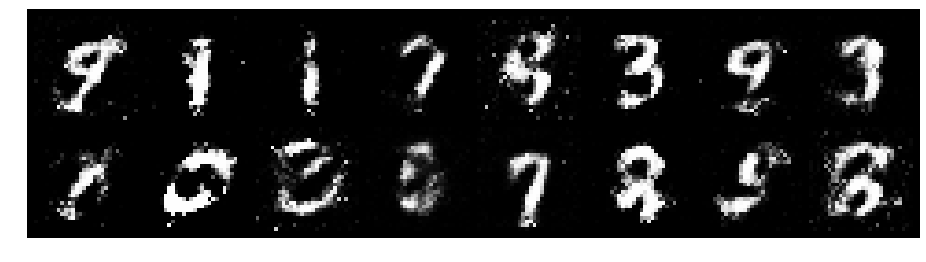

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.8011, Generator Loss: 1.6831
D(x): 0.7394, D(G(z)): 0.2604


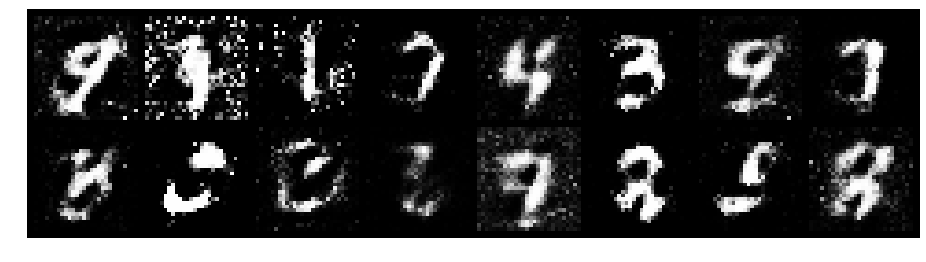

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.9548, Generator Loss: 2.0170
D(x): 0.6536, D(G(z)): 0.2380


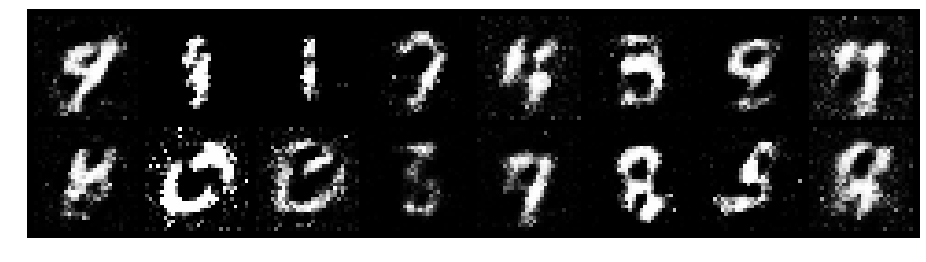

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.7991, Generator Loss: 1.6040
D(x): 0.8348, D(G(z)): 0.3218


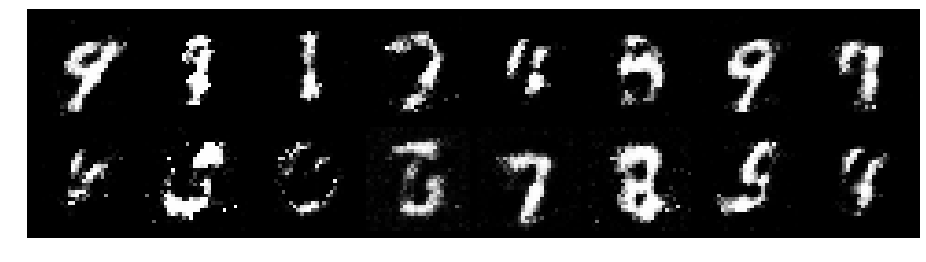

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.8279, Generator Loss: 1.7416
D(x): 0.7356, D(G(z)): 0.2949


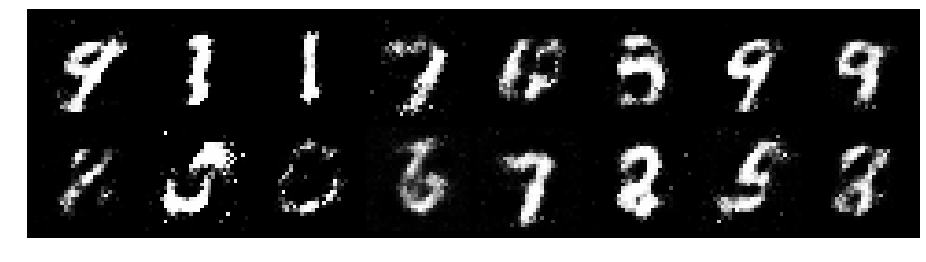

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.8261, Generator Loss: 2.0568
D(x): 0.6955, D(G(z)): 0.2248


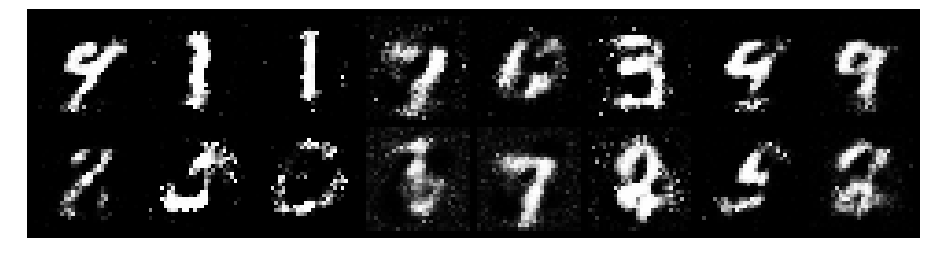

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 1.0312, Generator Loss: 1.5066
D(x): 0.6854, D(G(z)): 0.3213


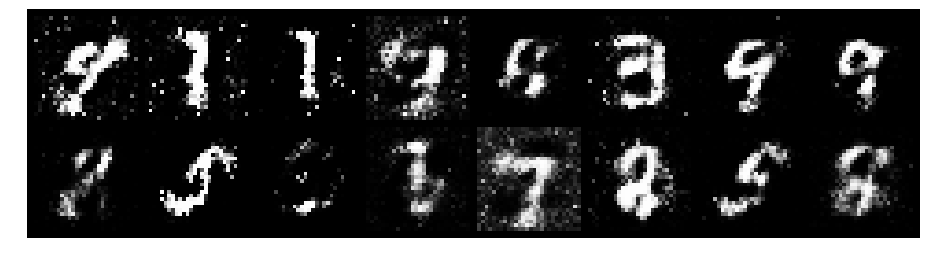

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.9176, Generator Loss: 1.6256
D(x): 0.6009, D(G(z)): 0.2419


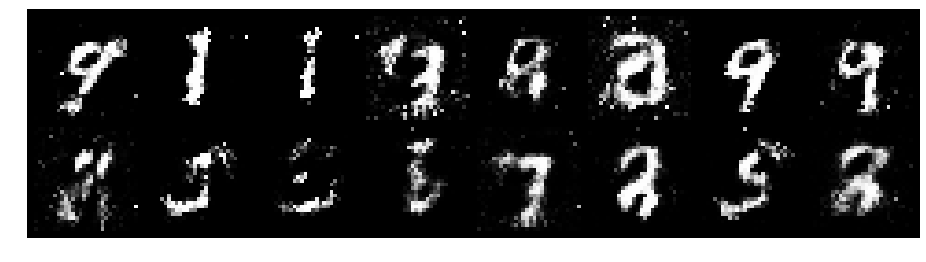

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.7851, Generator Loss: 1.5118
D(x): 0.7823, D(G(z)): 0.3070


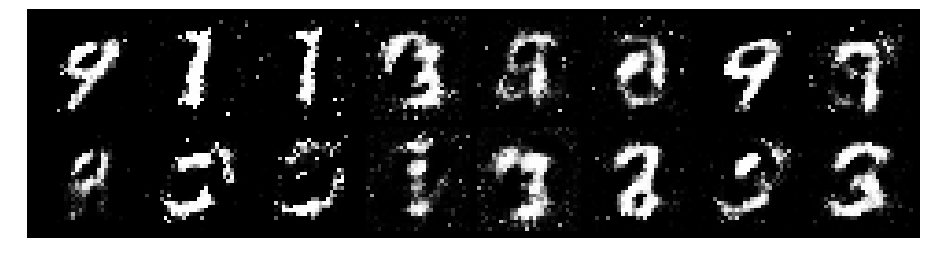

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.8034, Generator Loss: 1.7976
D(x): 0.7232, D(G(z)): 0.2581


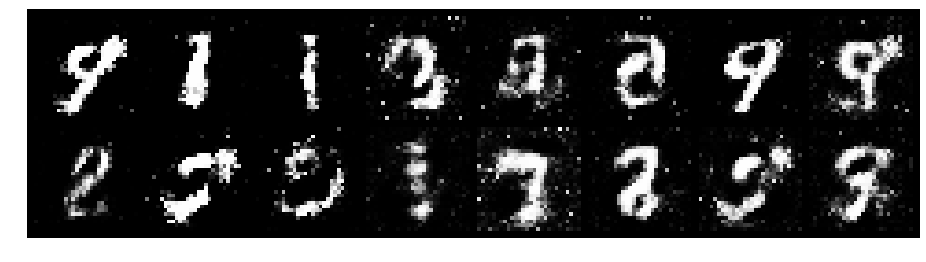

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 1.0948, Generator Loss: 1.3304
D(x): 0.6742, D(G(z)): 0.3238


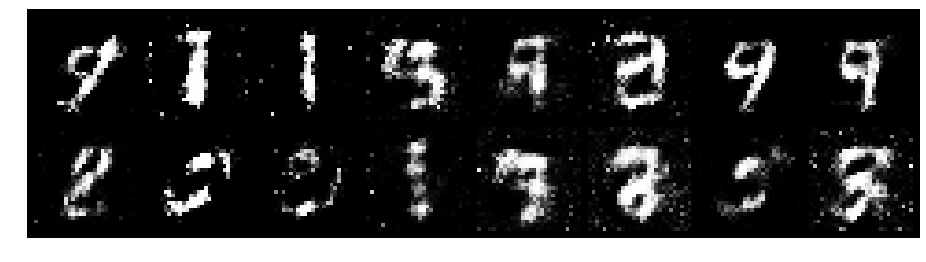

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.2154, Generator Loss: 1.0028
D(x): 0.6959, D(G(z)): 0.4524


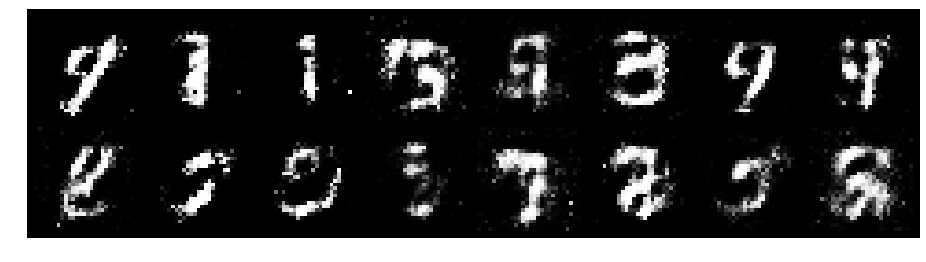

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 1.0880, Generator Loss: 1.4875
D(x): 0.6299, D(G(z)): 0.3223


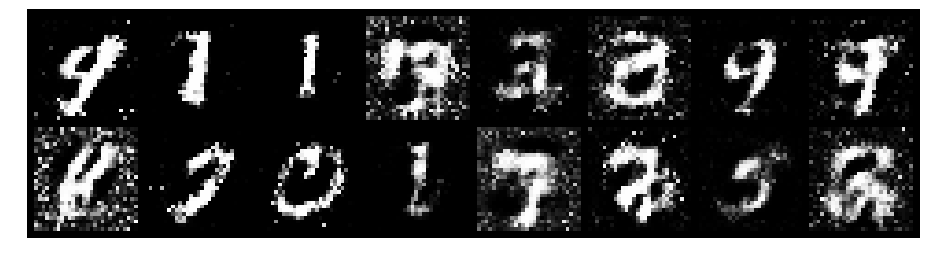

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8661, Generator Loss: 1.8458
D(x): 0.7284, D(G(z)): 0.3072


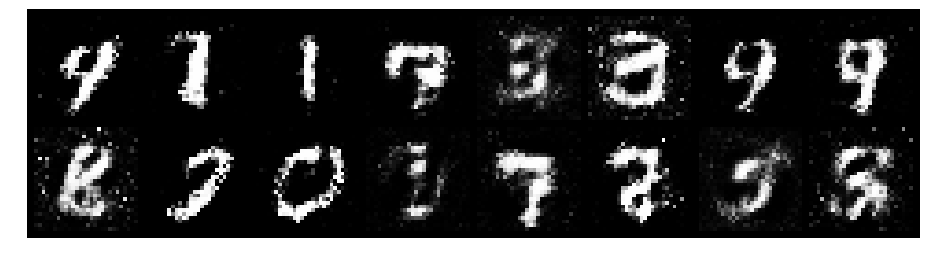

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.8247, Generator Loss: 1.6270
D(x): 0.7136, D(G(z)): 0.2647


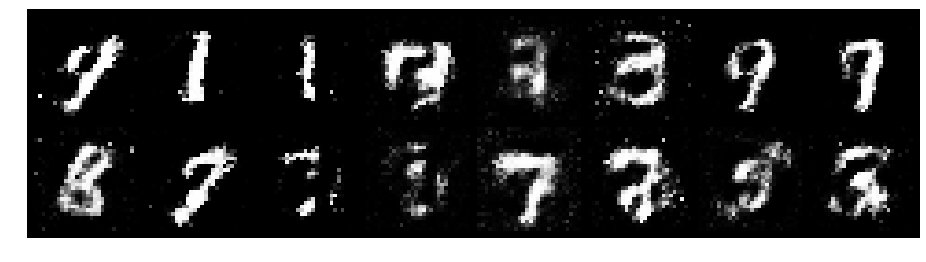

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.9413, Generator Loss: 1.5266
D(x): 0.7308, D(G(z)): 0.3180


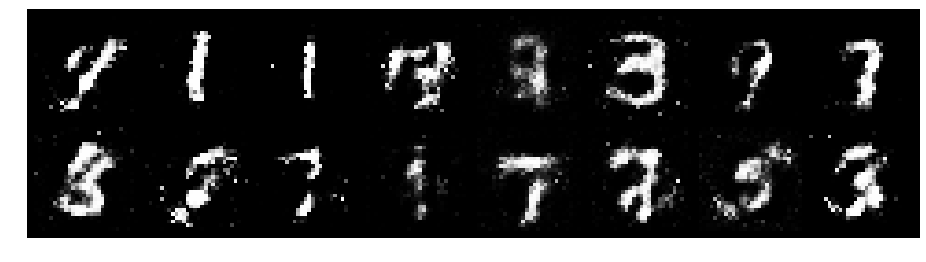

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.9502, Generator Loss: 1.5818
D(x): 0.7166, D(G(z)): 0.3157


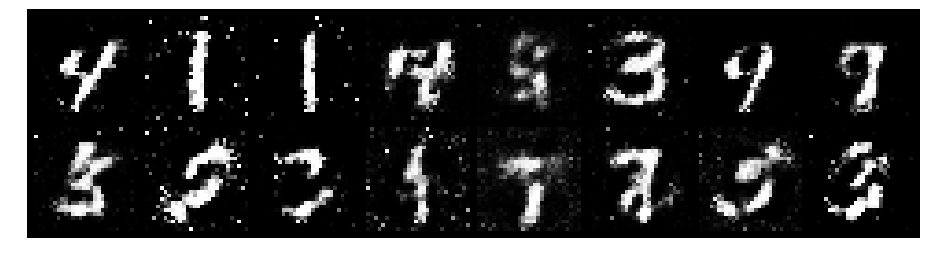

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.9901, Generator Loss: 1.5364
D(x): 0.6777, D(G(z)): 0.2966


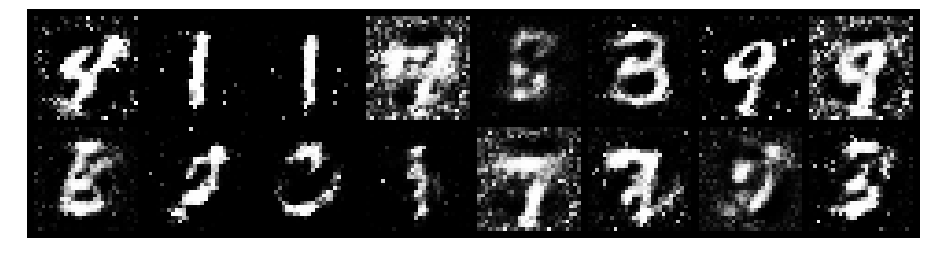

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0627, Generator Loss: 1.2891
D(x): 0.7354, D(G(z)): 0.3554


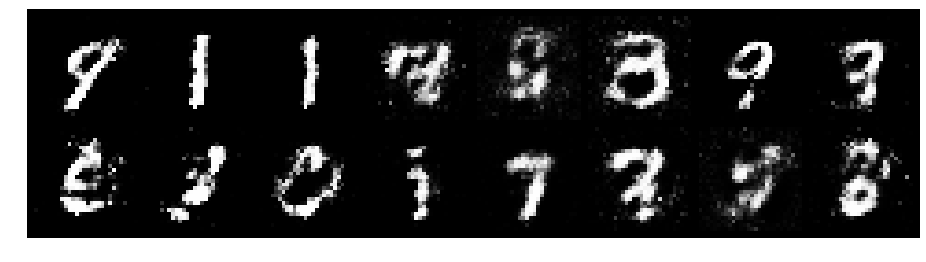

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 1.1570, Generator Loss: 1.4285
D(x): 0.5807, D(G(z)): 0.2864


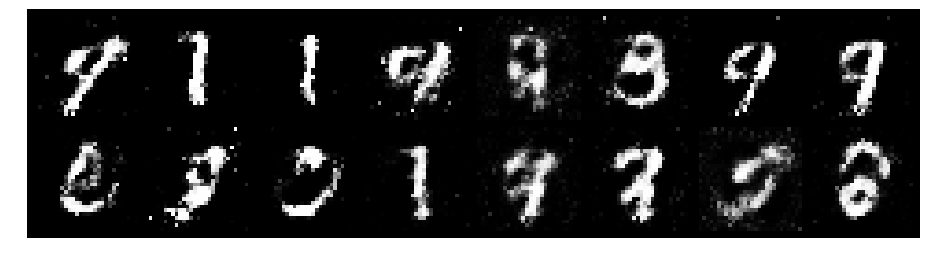

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9238, Generator Loss: 1.6575
D(x): 0.6730, D(G(z)): 0.2738


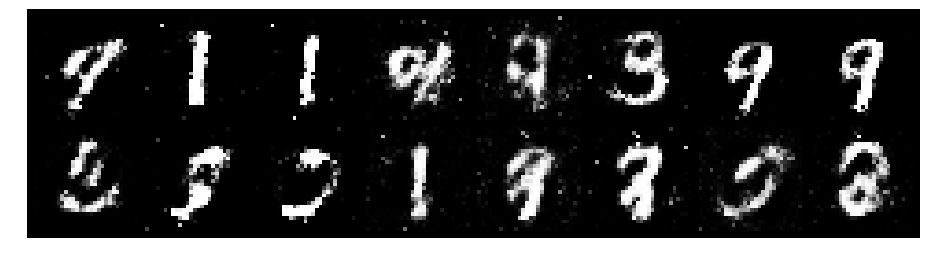

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 1.0994, Generator Loss: 2.0375
D(x): 0.5948, D(G(z)): 0.2515


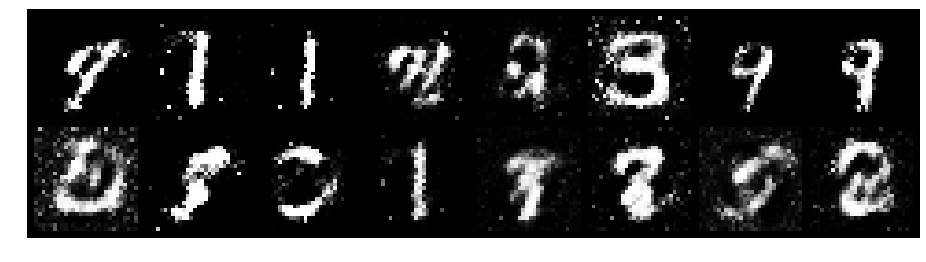

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8558, Generator Loss: 1.3251
D(x): 0.7373, D(G(z)): 0.3404


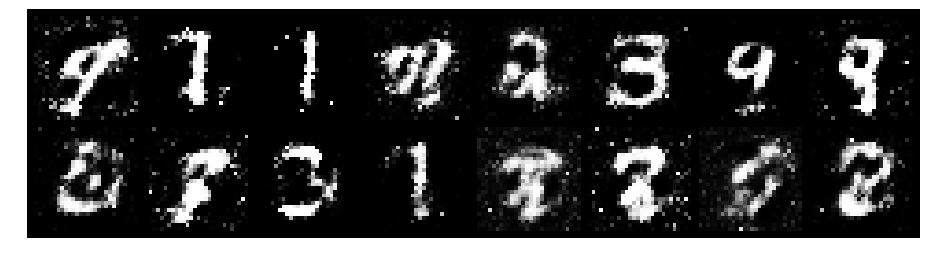

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 1.0619, Generator Loss: 1.2971
D(x): 0.6272, D(G(z)): 0.3295


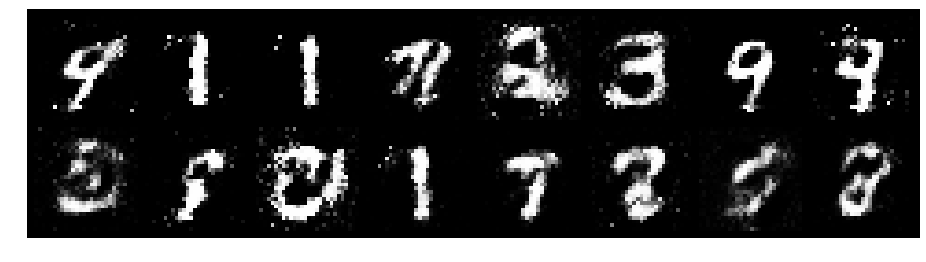

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 1.1028, Generator Loss: 1.2817
D(x): 0.6010, D(G(z)): 0.3145


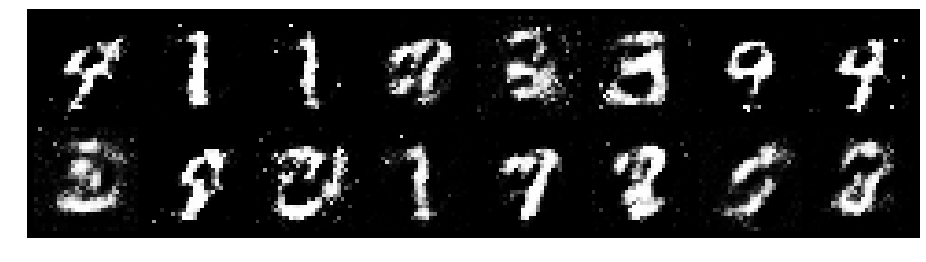

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.0104, Generator Loss: 1.1190
D(x): 0.6375, D(G(z)): 0.3199


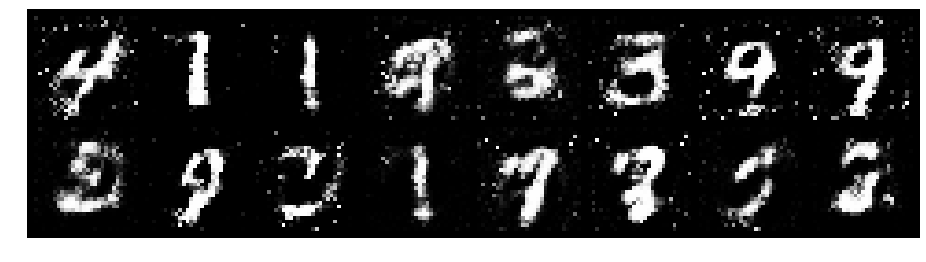

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.1463, Generator Loss: 1.4873
D(x): 0.6535, D(G(z)): 0.3698


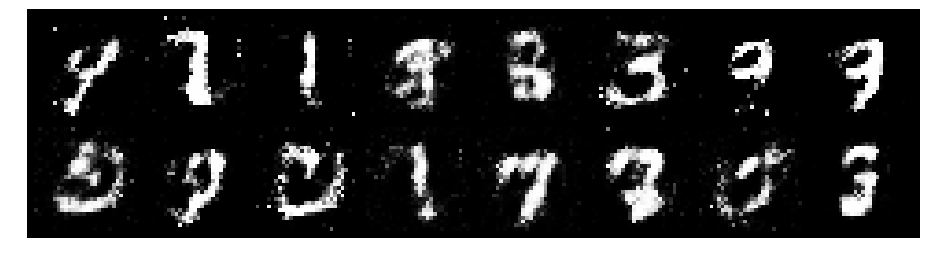

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 1.0591, Generator Loss: 1.5256
D(x): 0.6071, D(G(z)): 0.2606


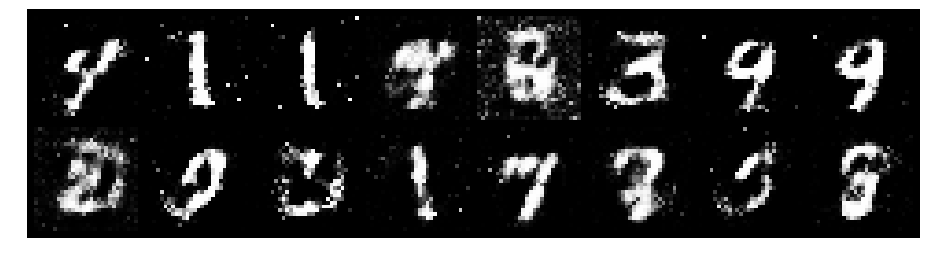

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.8033, Generator Loss: 1.8024
D(x): 0.6993, D(G(z)): 0.2284


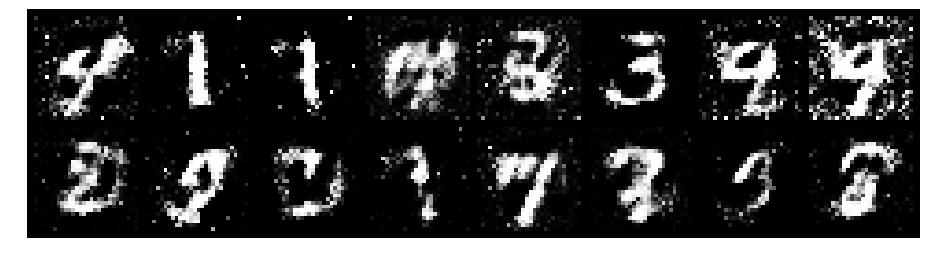

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.8146, Generator Loss: 1.9499
D(x): 0.7521, D(G(z)): 0.2672


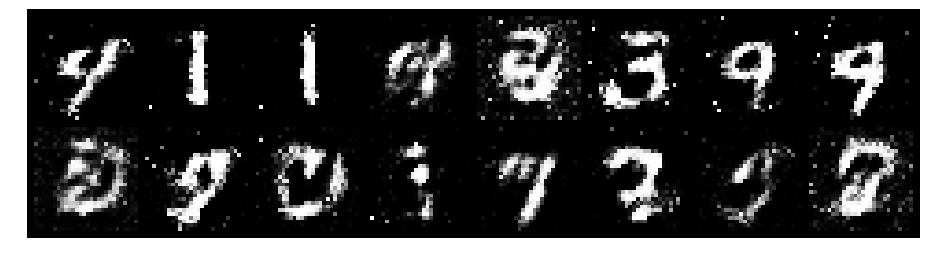

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9436, Generator Loss: 1.7133
D(x): 0.7118, D(G(z)): 0.3058


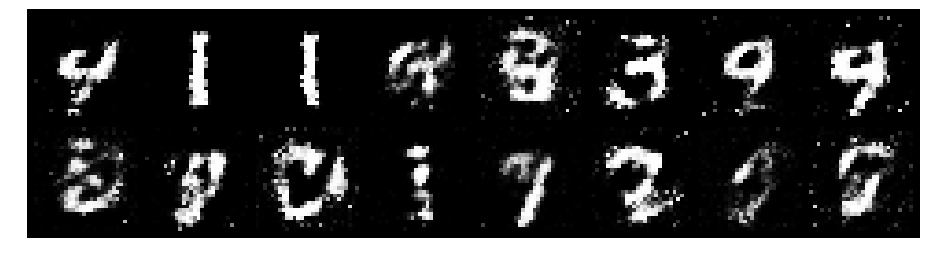

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.2087, Generator Loss: 1.1438
D(x): 0.6345, D(G(z)): 0.3797


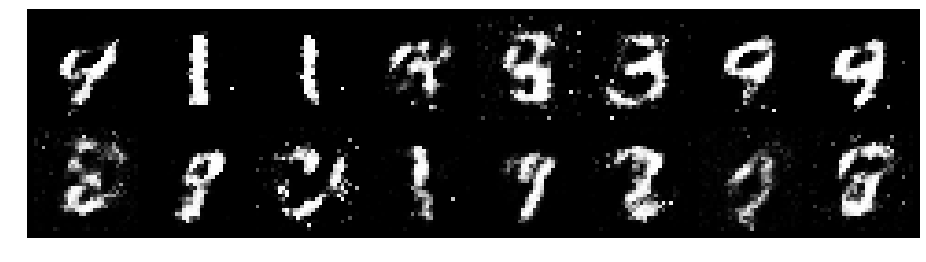

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.0354, Generator Loss: 1.3016
D(x): 0.6753, D(G(z)): 0.3575


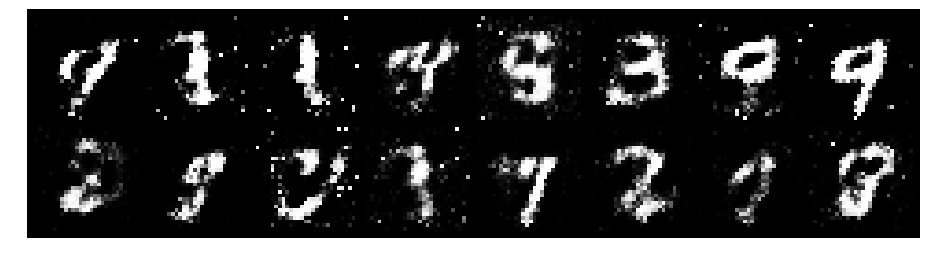

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.8341, Generator Loss: 1.6187
D(x): 0.7187, D(G(z)): 0.2624


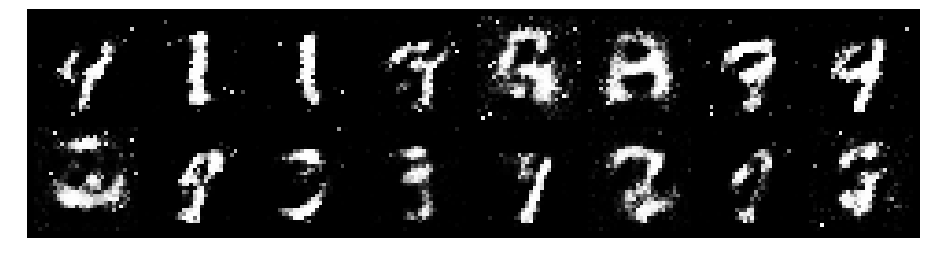

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.7278, Generator Loss: 1.6693
D(x): 0.7696, D(G(z)): 0.2706


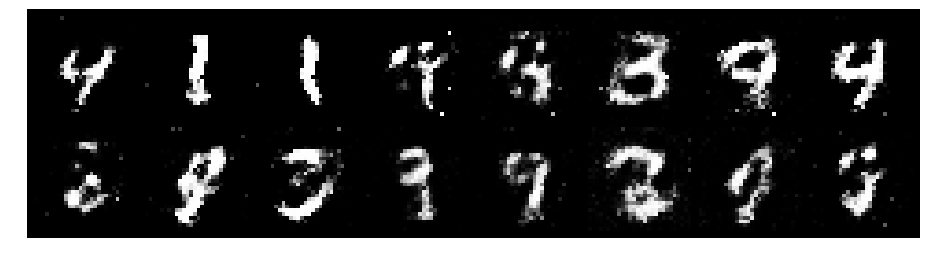

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.7983, Generator Loss: 1.4076
D(x): 0.7830, D(G(z)): 0.3353


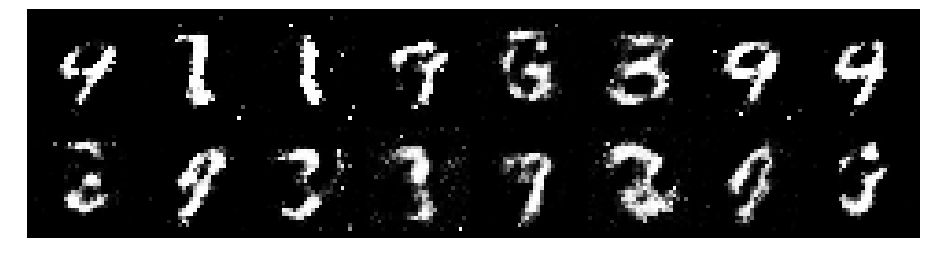

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9136, Generator Loss: 1.5601
D(x): 0.7317, D(G(z)): 0.3345


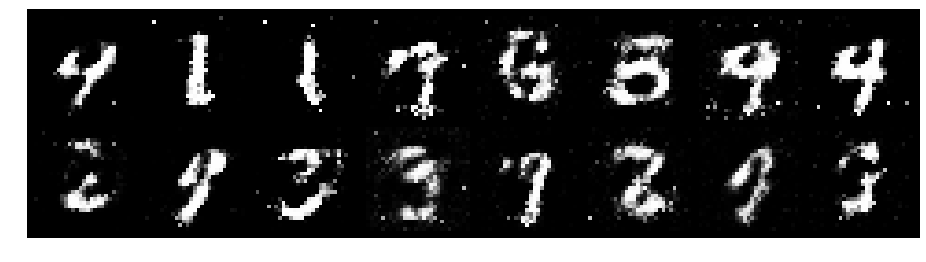

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.8705, Generator Loss: 1.7189
D(x): 0.7185, D(G(z)): 0.2752


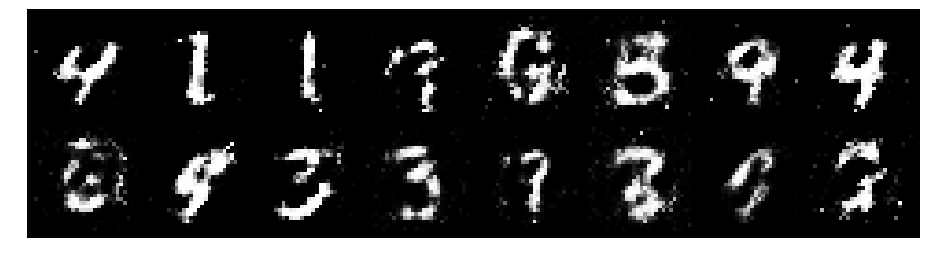

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.8193, Generator Loss: 1.3982
D(x): 0.7376, D(G(z)): 0.3124


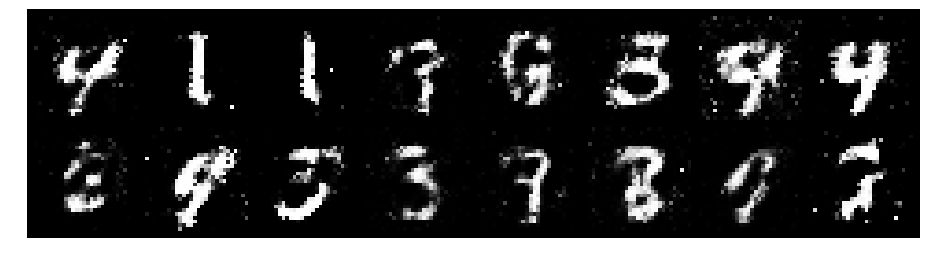

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.9334, Generator Loss: 1.3362
D(x): 0.6680, D(G(z)): 0.3117


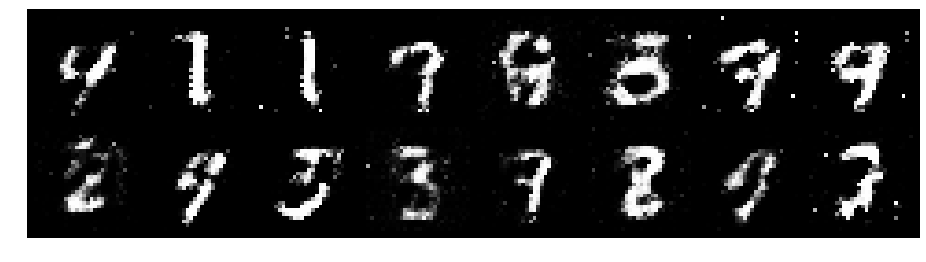

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.8422, Generator Loss: 1.5357
D(x): 0.7612, D(G(z)): 0.3536


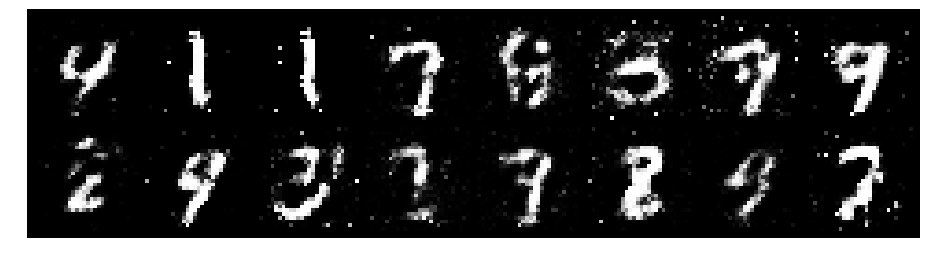

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0102, Generator Loss: 1.2185
D(x): 0.6618, D(G(z)): 0.3551


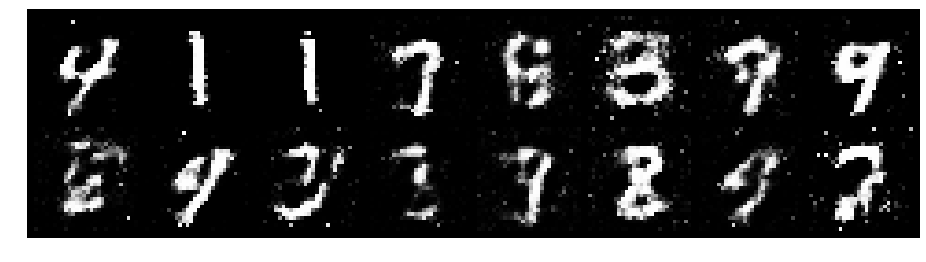

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9563, Generator Loss: 1.1869
D(x): 0.7171, D(G(z)): 0.3468


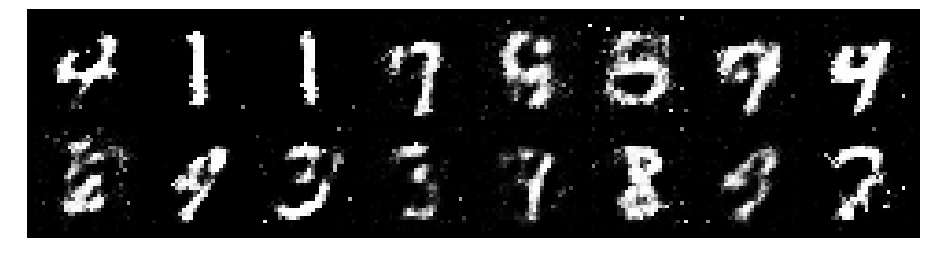

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 1.0584, Generator Loss: 1.2696
D(x): 0.6485, D(G(z)): 0.3272


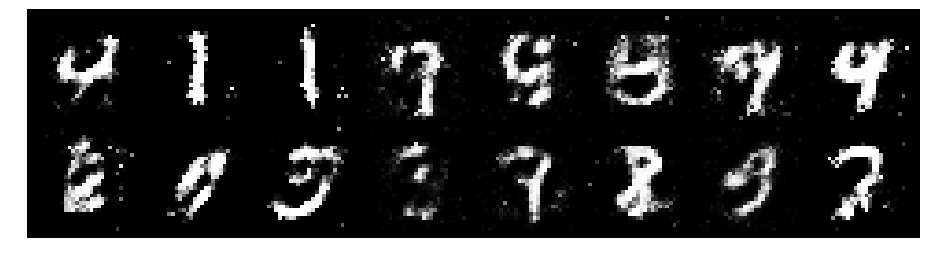

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.9413, Generator Loss: 1.4339
D(x): 0.6392, D(G(z)): 0.2663


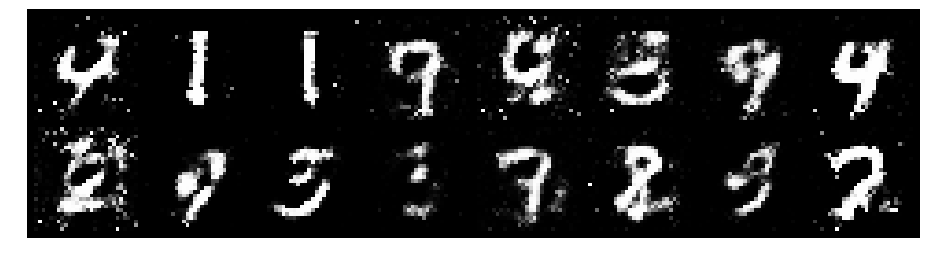

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.9438, Generator Loss: 1.3926
D(x): 0.6635, D(G(z)): 0.3013


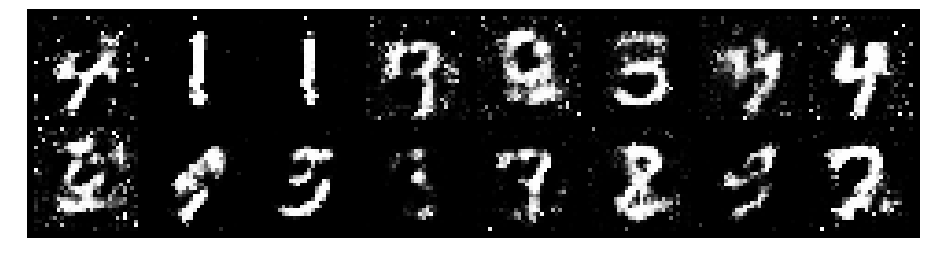

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9678, Generator Loss: 1.5650
D(x): 0.7053, D(G(z)): 0.3417


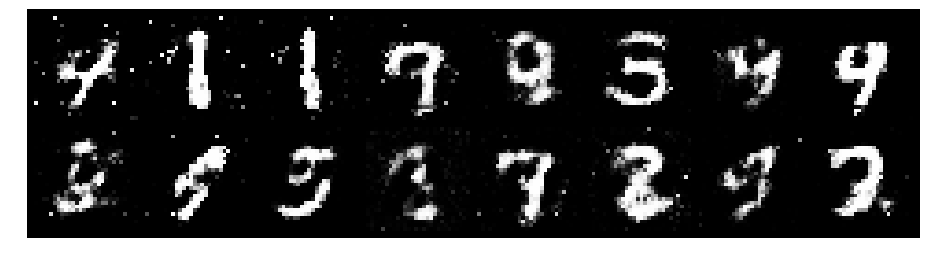

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.8612, Generator Loss: 1.4989
D(x): 0.6648, D(G(z)): 0.2369


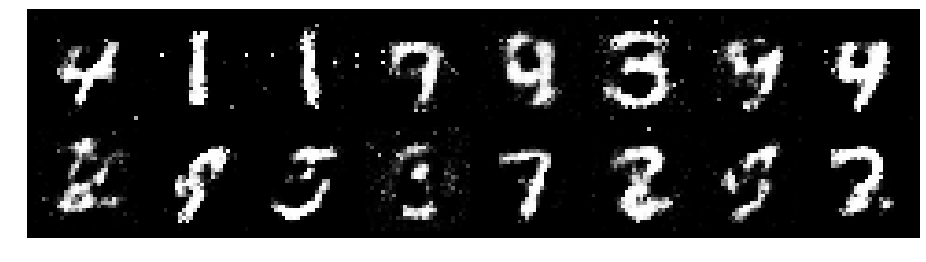

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8175, Generator Loss: 1.7393
D(x): 0.6960, D(G(z)): 0.2339


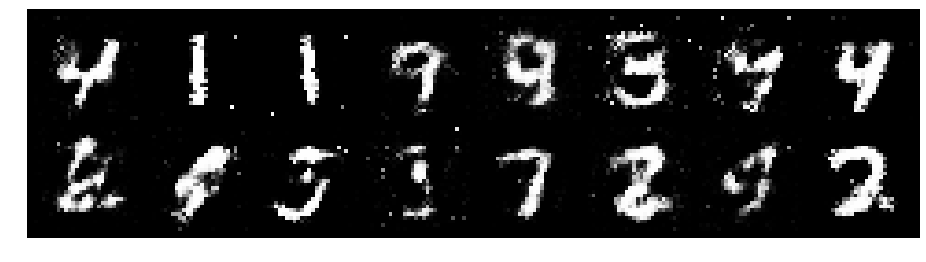

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8849, Generator Loss: 1.4209
D(x): 0.6508, D(G(z)): 0.2865


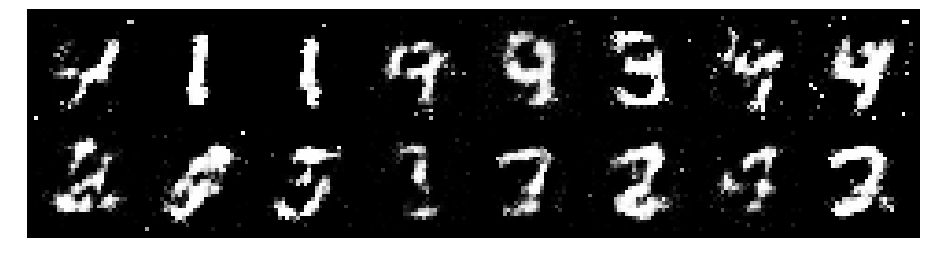

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.8945, Generator Loss: 1.4230
D(x): 0.6894, D(G(z)): 0.3067


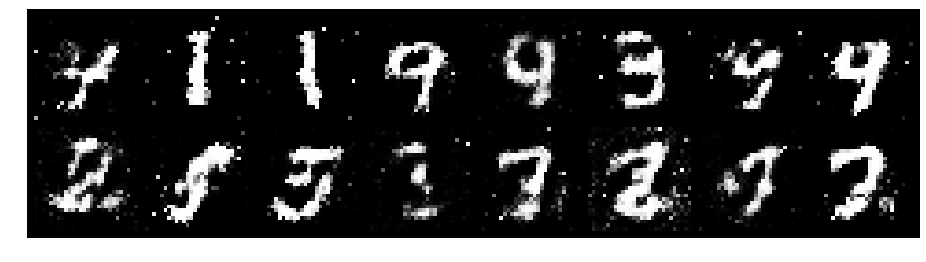

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 0.9003, Generator Loss: 1.4366
D(x): 0.7146, D(G(z)): 0.3393


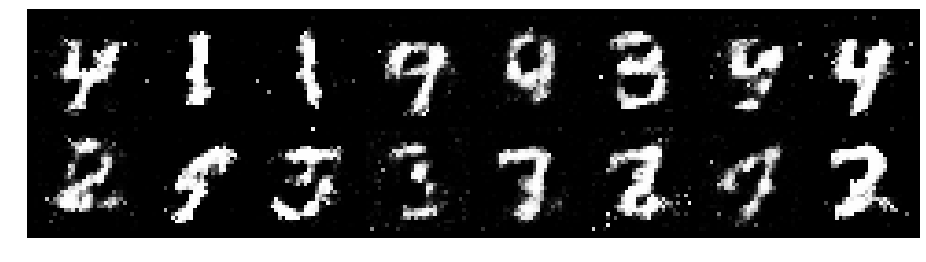

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.7690, Generator Loss: 1.9777
D(x): 0.7382, D(G(z)): 0.2421


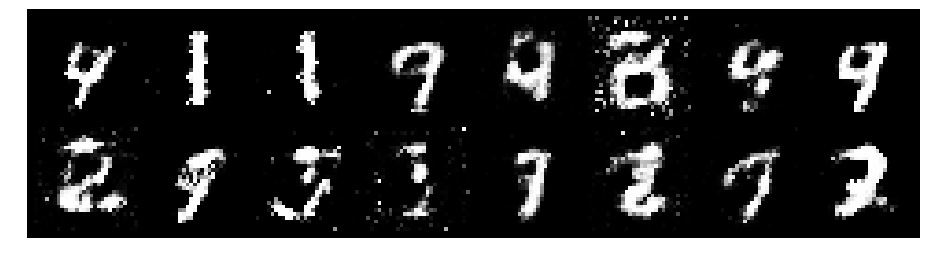

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0061, Generator Loss: 1.6707
D(x): 0.6417, D(G(z)): 0.3081


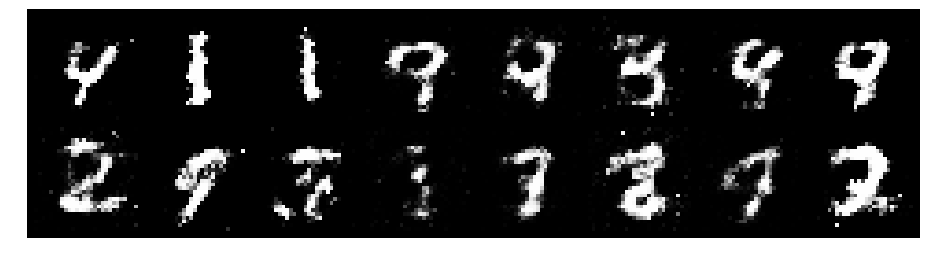

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.9416, Generator Loss: 1.7825
D(x): 0.6894, D(G(z)): 0.3023


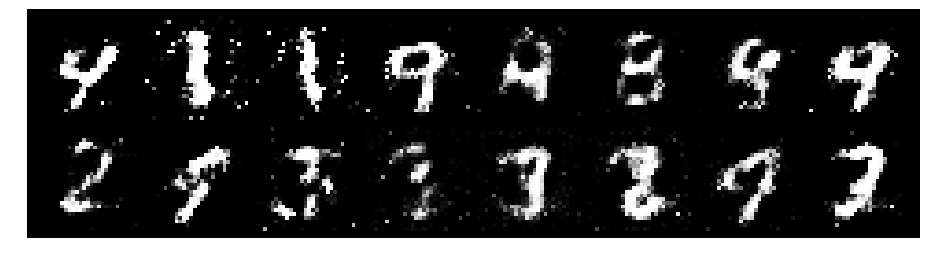

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 1.1259, Generator Loss: 1.3955
D(x): 0.6120, D(G(z)): 0.3513


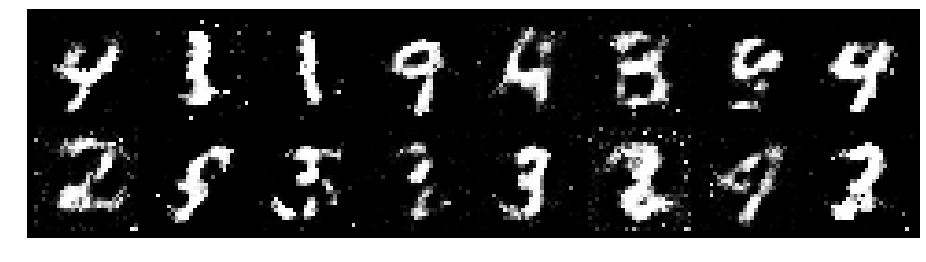

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.0541, Generator Loss: 1.7357
D(x): 0.6387, D(G(z)): 0.3108


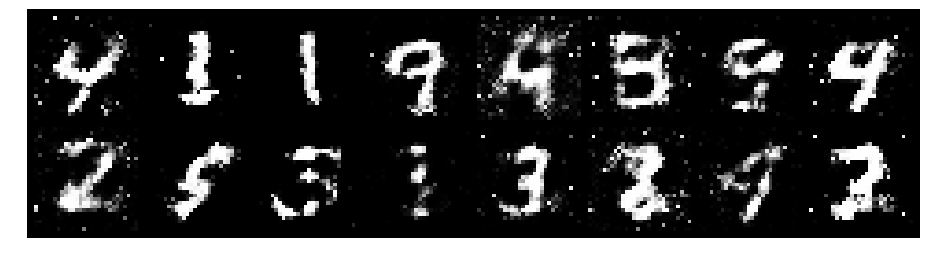

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.1461, Generator Loss: 1.4983
D(x): 0.6131, D(G(z)): 0.3261


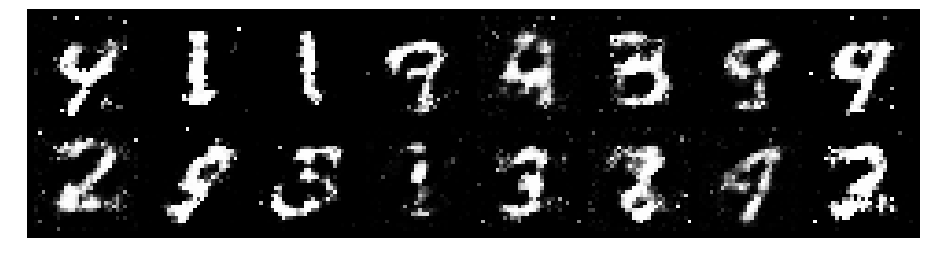

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.2151, Generator Loss: 1.2840
D(x): 0.5780, D(G(z)): 0.3374


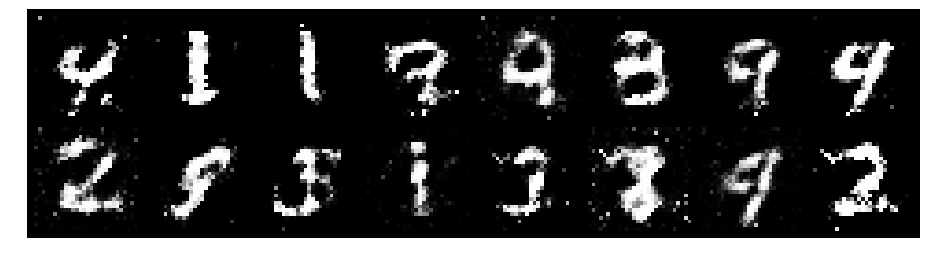

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.9495, Generator Loss: 1.3699
D(x): 0.6627, D(G(z)): 0.3246


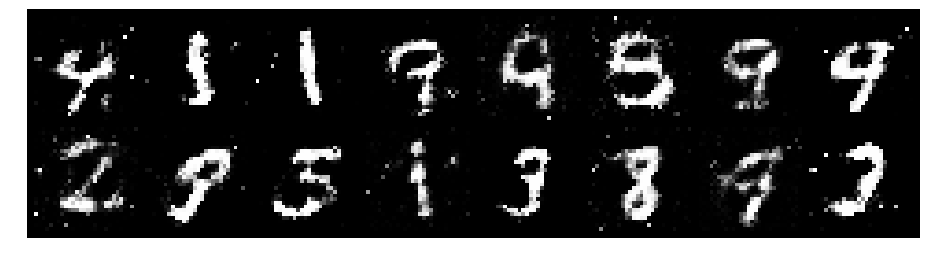

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.9994, Generator Loss: 1.4181
D(x): 0.6673, D(G(z)): 0.3273


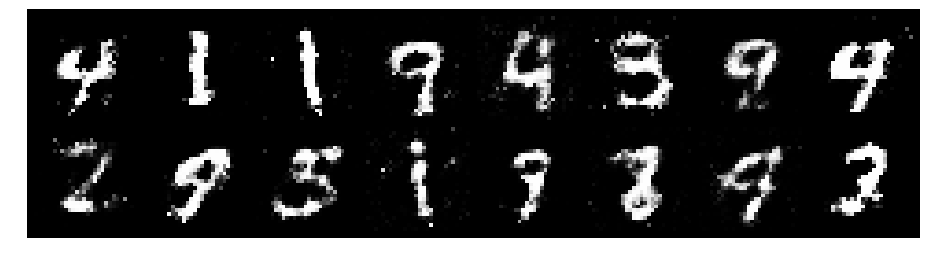

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9894, Generator Loss: 1.3648
D(x): 0.6825, D(G(z)): 0.3082


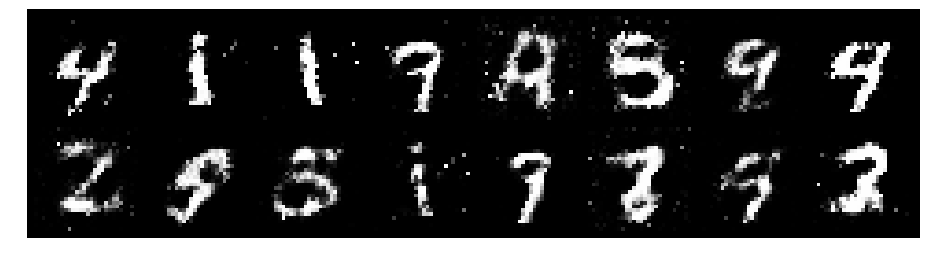

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.8646, Generator Loss: 1.6102
D(x): 0.7105, D(G(z)): 0.2901


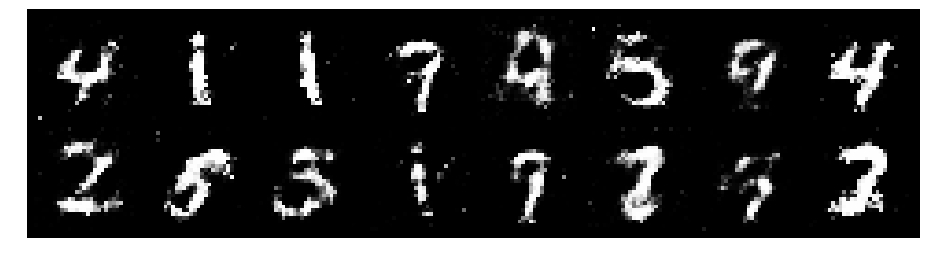

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.8140, Generator Loss: 1.4857
D(x): 0.6907, D(G(z)): 0.2798


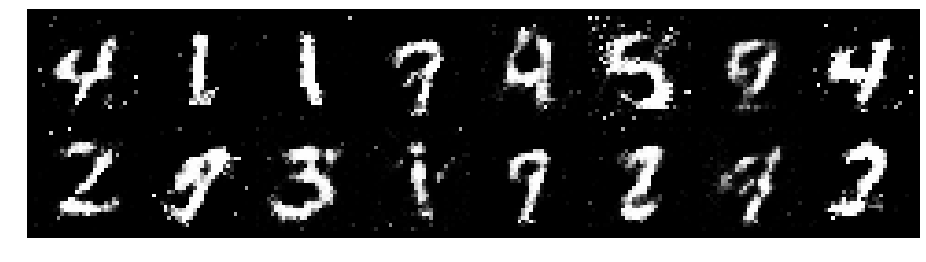

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.9175, Generator Loss: 1.3841
D(x): 0.7269, D(G(z)): 0.3639


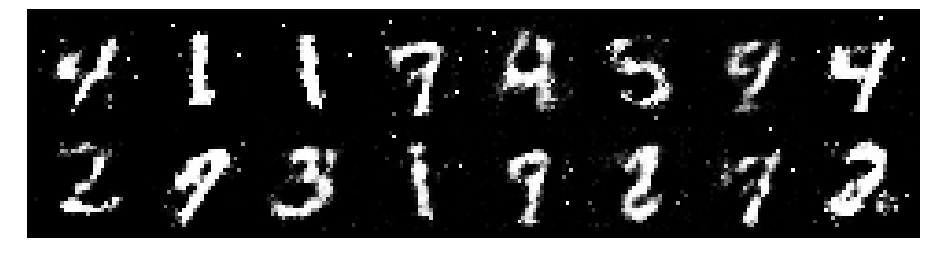

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.9015, Generator Loss: 1.8198
D(x): 0.7061, D(G(z)): 0.2822


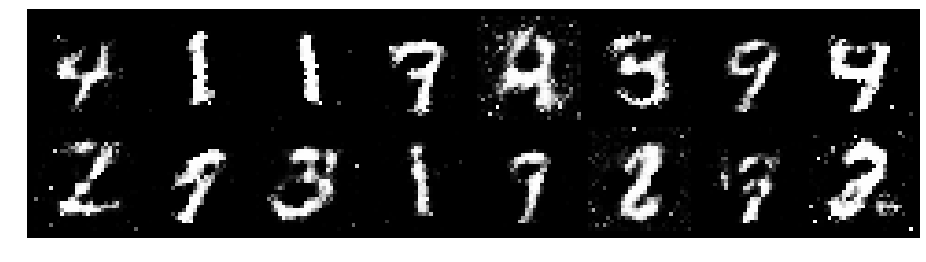

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.7968, Generator Loss: 1.6650
D(x): 0.6964, D(G(z)): 0.2477


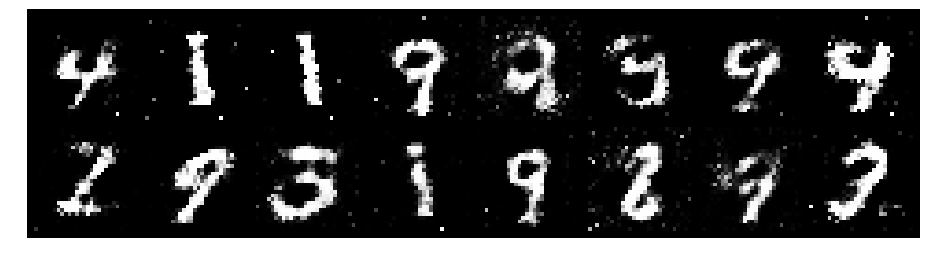

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.7329, Generator Loss: 1.5376
D(x): 0.7129, D(G(z)): 0.2384


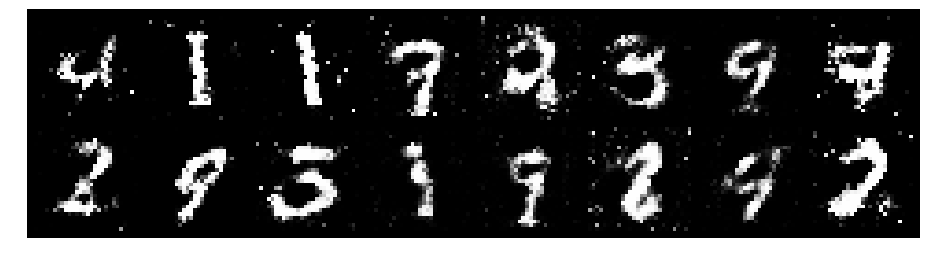

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.8860, Generator Loss: 1.3861
D(x): 0.7055, D(G(z)): 0.3284


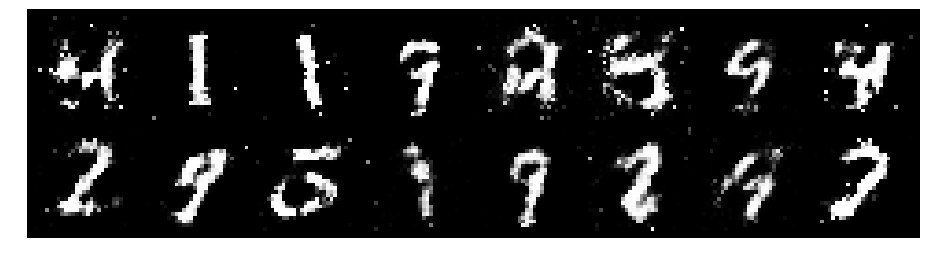

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.1156, Generator Loss: 1.2504
D(x): 0.6320, D(G(z)): 0.3666


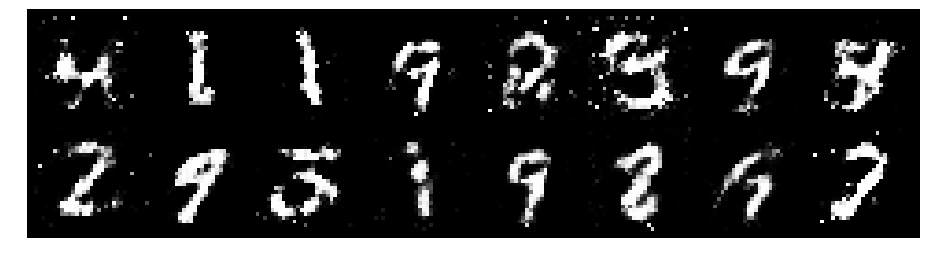

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.0289, Generator Loss: 0.9970
D(x): 0.6447, D(G(z)): 0.3732


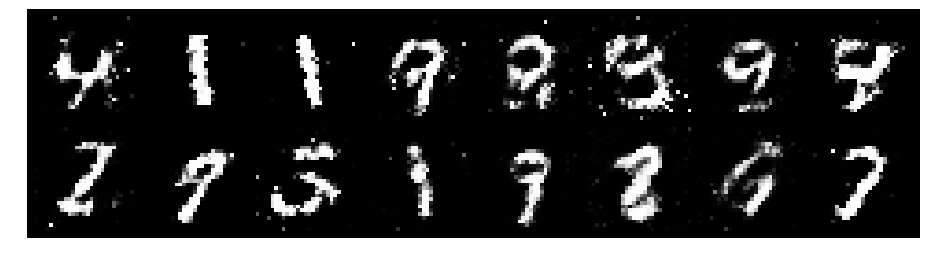

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9023, Generator Loss: 1.2648
D(x): 0.6712, D(G(z)): 0.2963


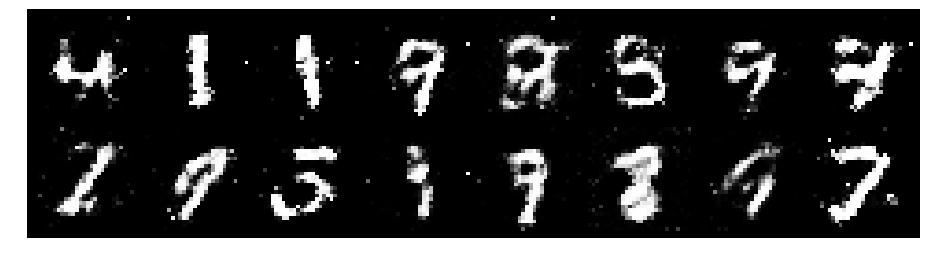

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.3822, Generator Loss: 0.9153
D(x): 0.6181, D(G(z)): 0.4858


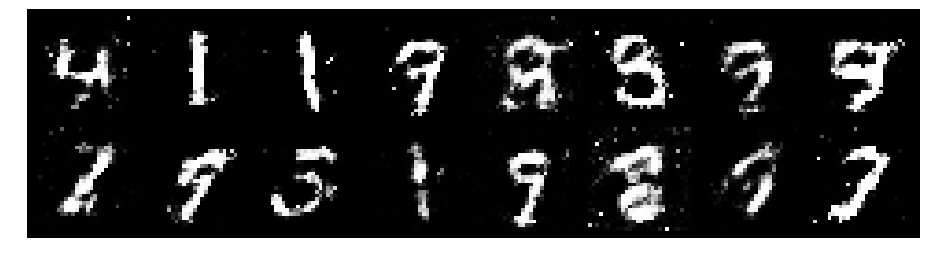

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.0171, Generator Loss: 1.1592
D(x): 0.6416, D(G(z)): 0.3501


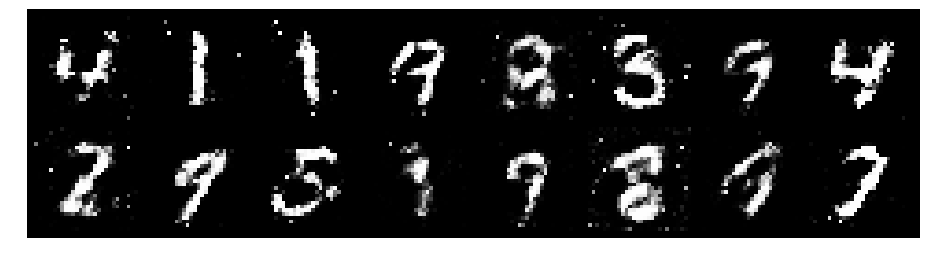

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9064, Generator Loss: 1.3022
D(x): 0.6384, D(G(z)): 0.2969


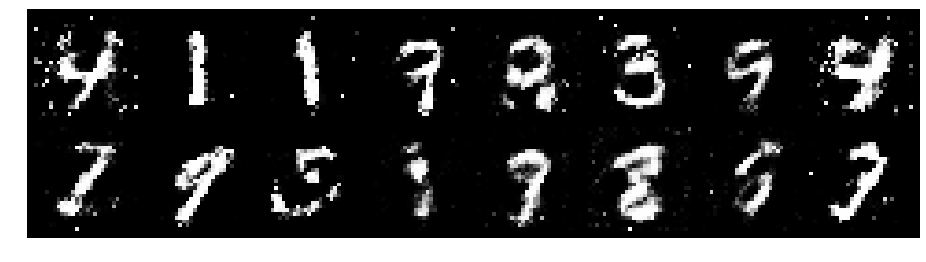

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.8100, Generator Loss: 1.7160
D(x): 0.7198, D(G(z)): 0.2932


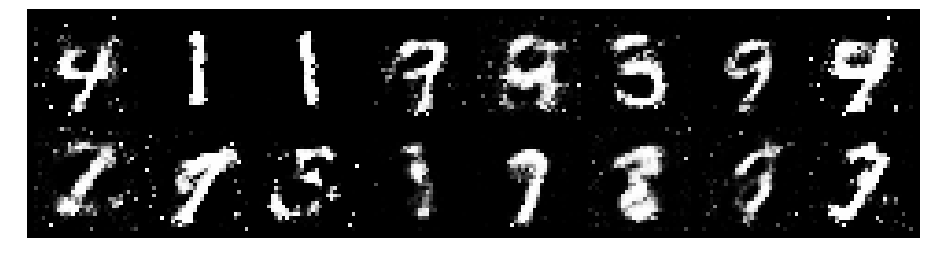

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.9614, Generator Loss: 1.5380
D(x): 0.6354, D(G(z)): 0.3003


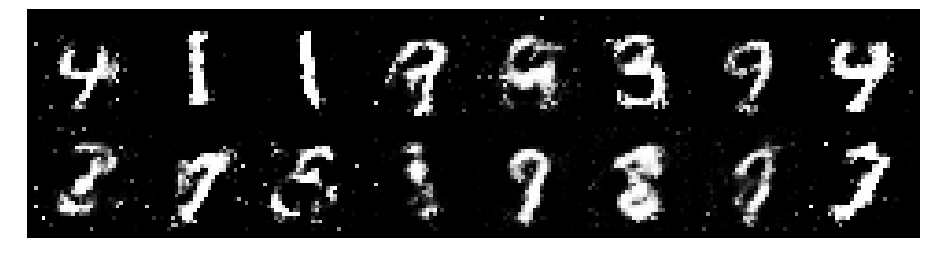

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.9343, Generator Loss: 1.1100
D(x): 0.7297, D(G(z)): 0.3700


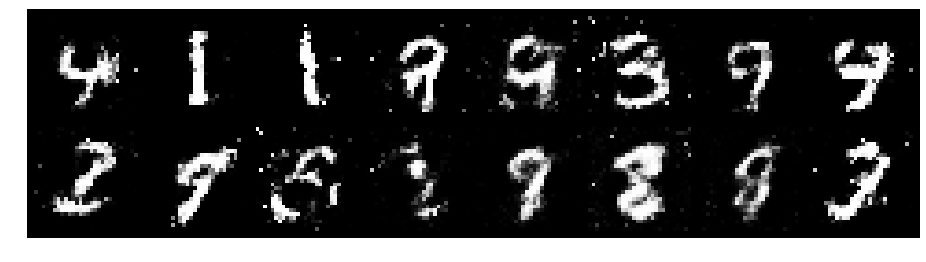

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.9312, Generator Loss: 1.3477
D(x): 0.7133, D(G(z)): 0.3517


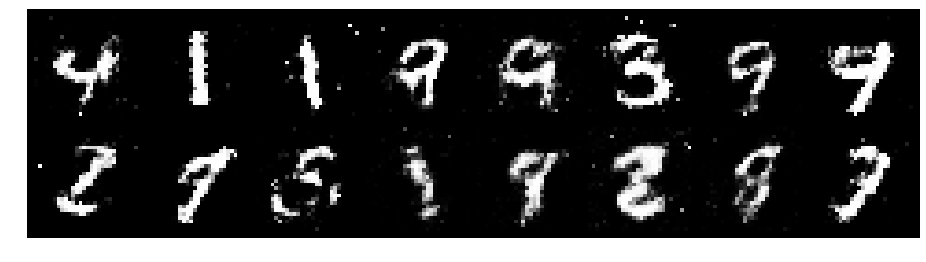

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.0271, Generator Loss: 1.3642
D(x): 0.6085, D(G(z)): 0.3121


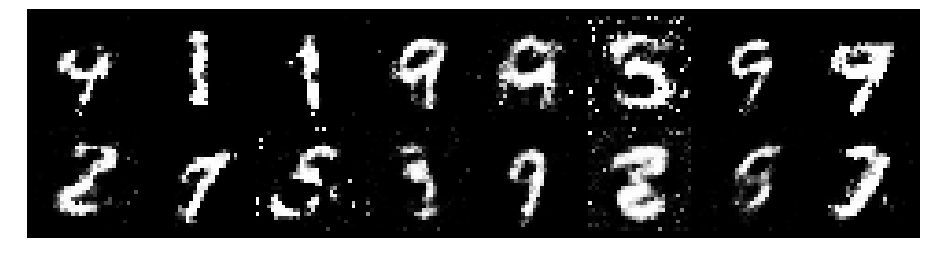

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0778, Generator Loss: 1.2760
D(x): 0.6391, D(G(z)): 0.3434


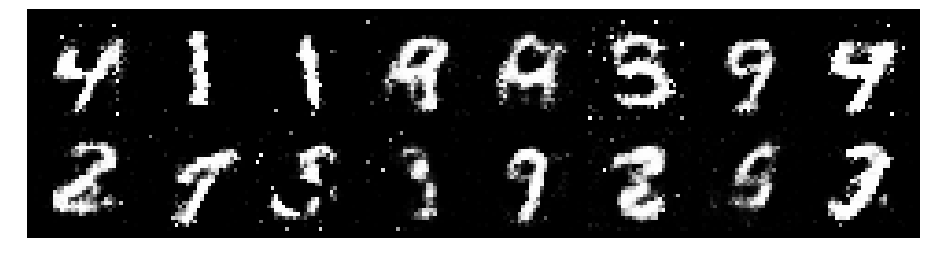

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.0164, Generator Loss: 1.3655
D(x): 0.6667, D(G(z)): 0.3440


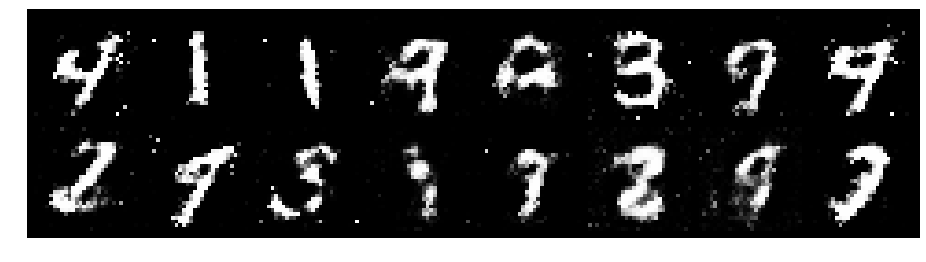

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.8522, Generator Loss: 1.2411
D(x): 0.7169, D(G(z)): 0.3413


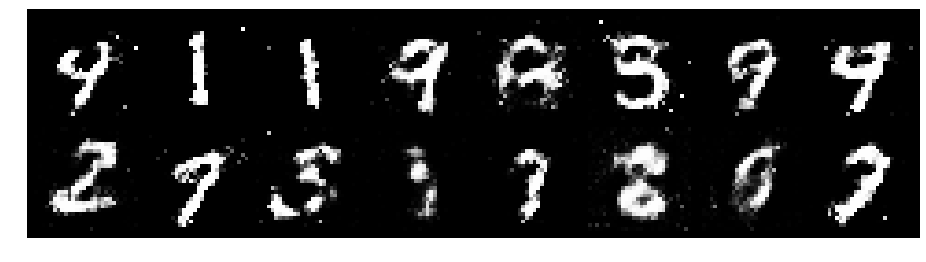

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.9818, Generator Loss: 1.2273
D(x): 0.6605, D(G(z)): 0.3471


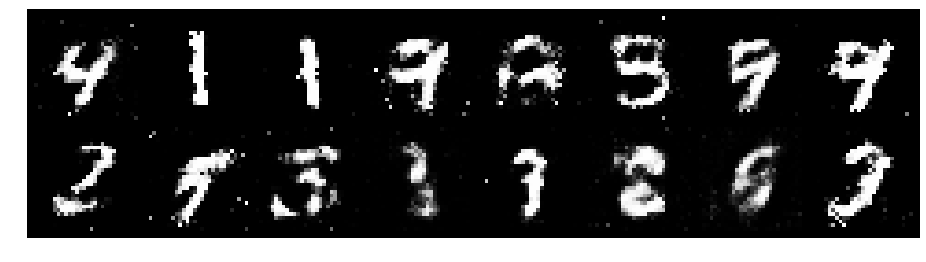

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 0.9534, Generator Loss: 1.2583
D(x): 0.6639, D(G(z)): 0.3515


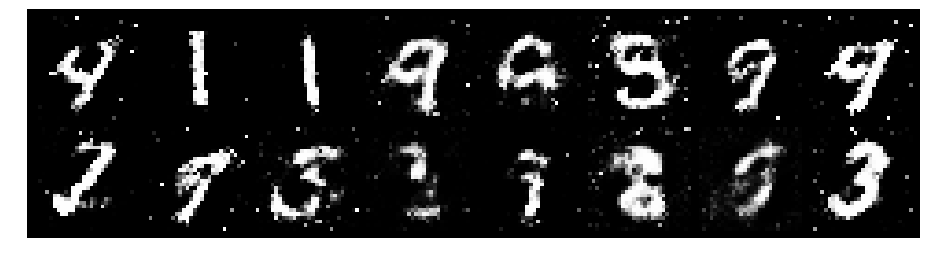

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 0.9557, Generator Loss: 1.2777
D(x): 0.6275, D(G(z)): 0.3004


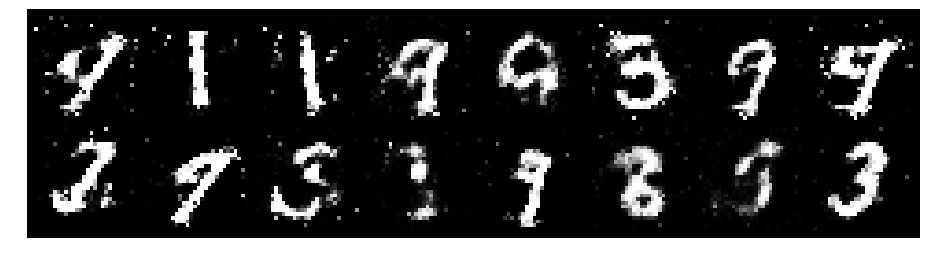

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 0.9905, Generator Loss: 1.3151
D(x): 0.6453, D(G(z)): 0.3430


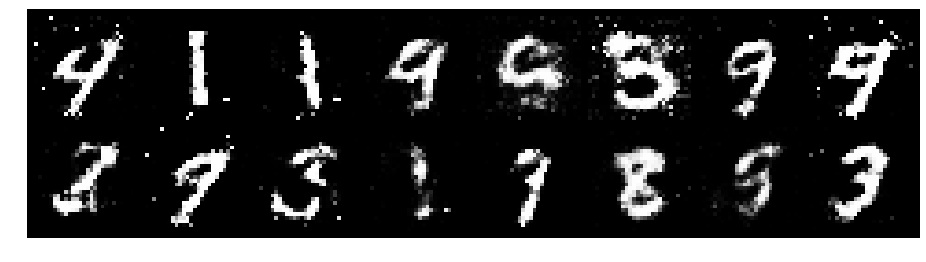

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.0831, Generator Loss: 1.2400
D(x): 0.5916, D(G(z)): 0.3262


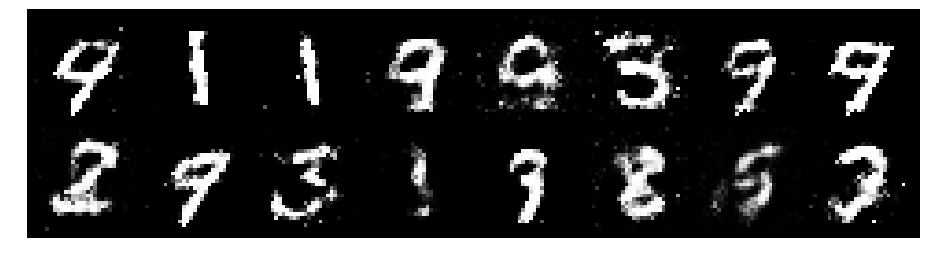

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 0.8892, Generator Loss: 1.5871
D(x): 0.7610, D(G(z)): 0.3414


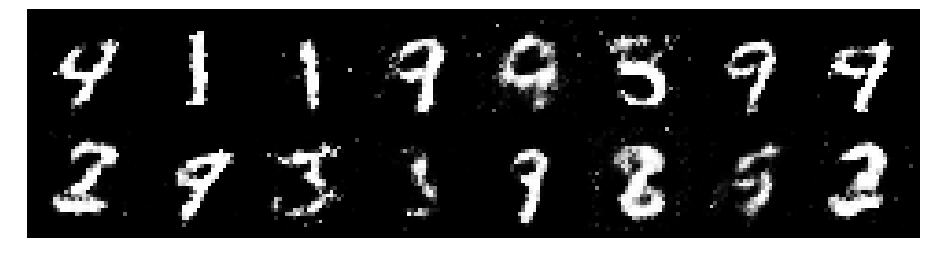

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.7451, Generator Loss: 1.5381
D(x): 0.7249, D(G(z)): 0.2592


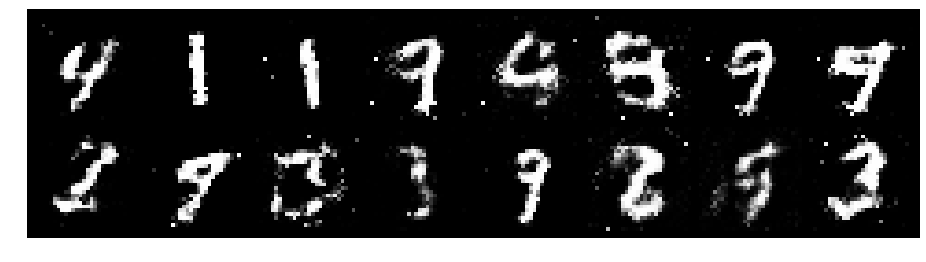

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.8377, Generator Loss: 1.2855
D(x): 0.7138, D(G(z)): 0.3068


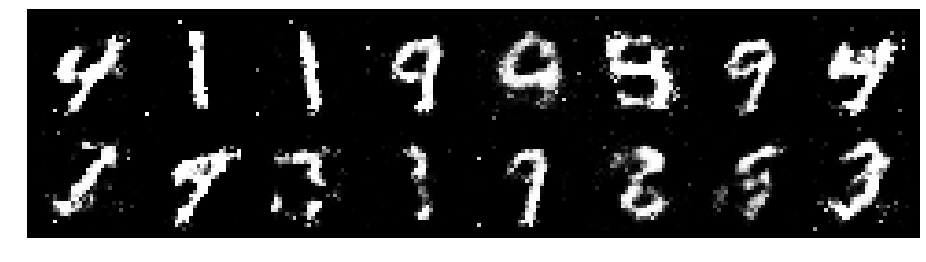

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.8139, Generator Loss: 1.5946
D(x): 0.7239, D(G(z)): 0.3103


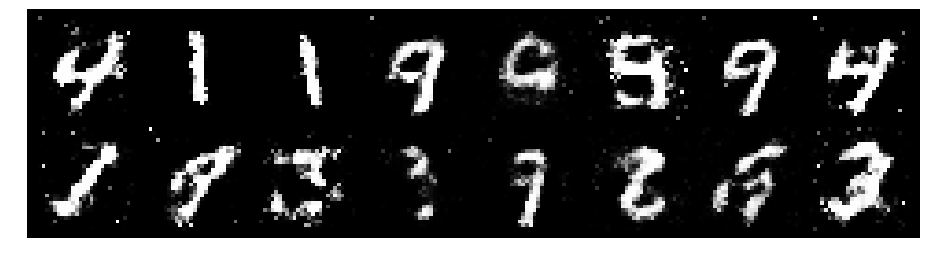

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.1086, Generator Loss: 1.5109
D(x): 0.6707, D(G(z)): 0.3365


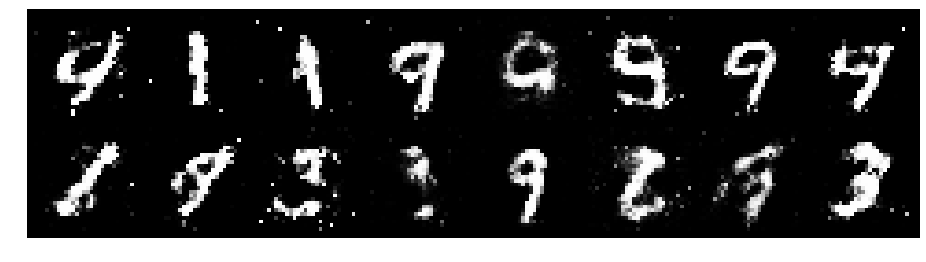

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9094, Generator Loss: 1.5304
D(x): 0.7570, D(G(z)): 0.3805


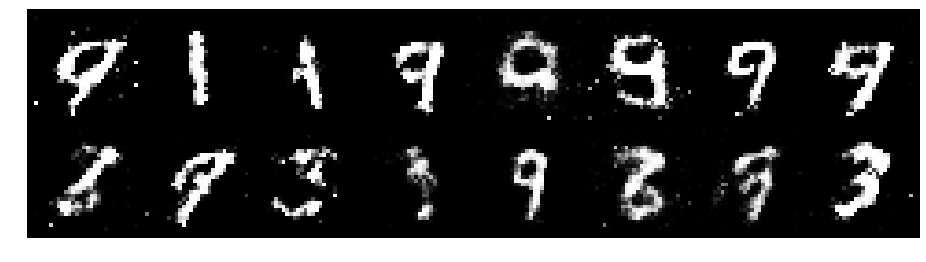

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 0.9852, Generator Loss: 1.0990
D(x): 0.6541, D(G(z)): 0.3314


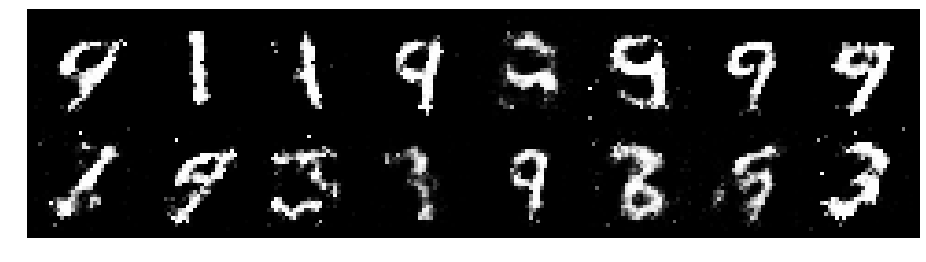

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.9170, Generator Loss: 1.3537
D(x): 0.6765, D(G(z)): 0.3314


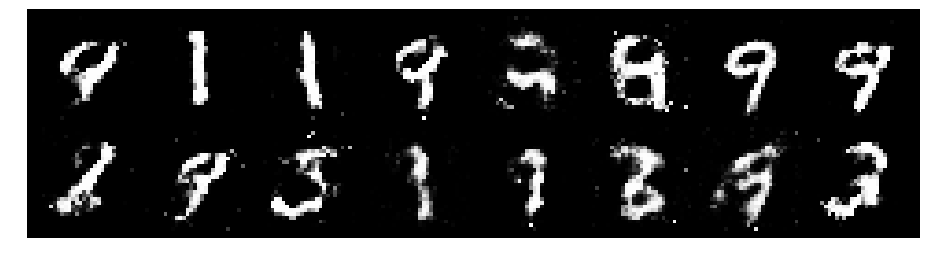

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 0.9845, Generator Loss: 1.2288
D(x): 0.6840, D(G(z)): 0.3777


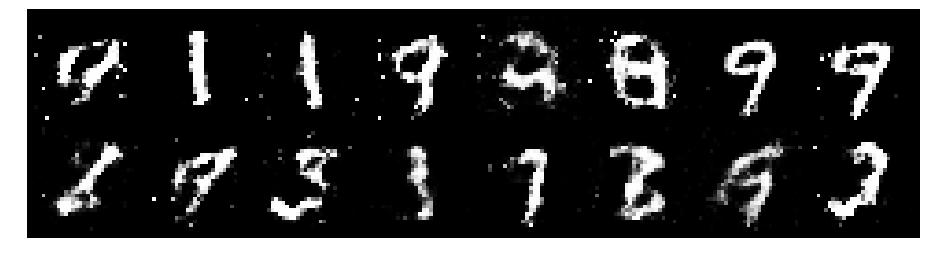

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.1755, Generator Loss: 1.2056
D(x): 0.6130, D(G(z)): 0.4043


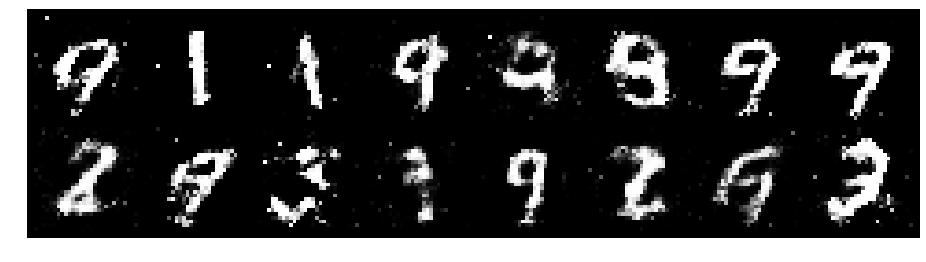

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.2633, Generator Loss: 1.0102
D(x): 0.6246, D(G(z)): 0.4526


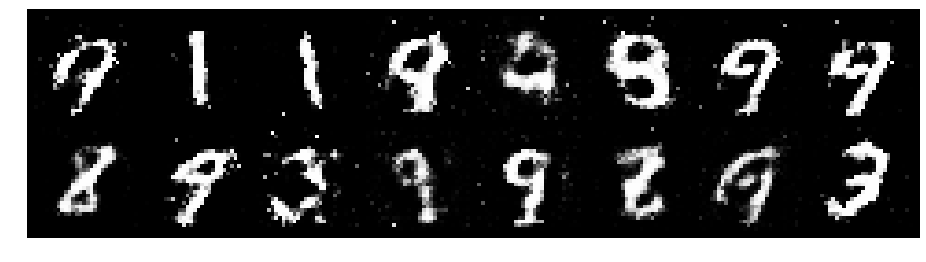

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0999, Generator Loss: 0.9326
D(x): 0.6339, D(G(z)): 0.4131


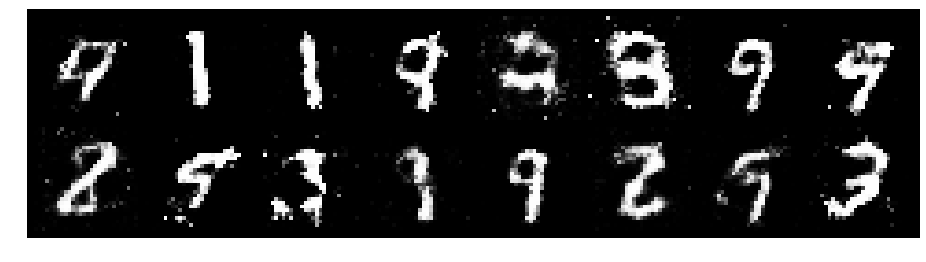

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1175, Generator Loss: 1.2100
D(x): 0.6369, D(G(z)): 0.4030


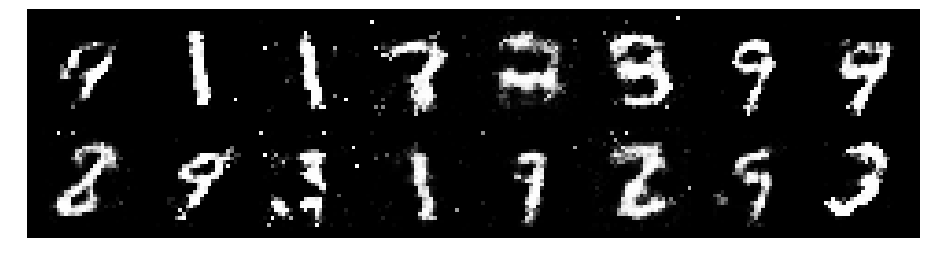

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.1973, Generator Loss: 1.1542
D(x): 0.5912, D(G(z)): 0.3797


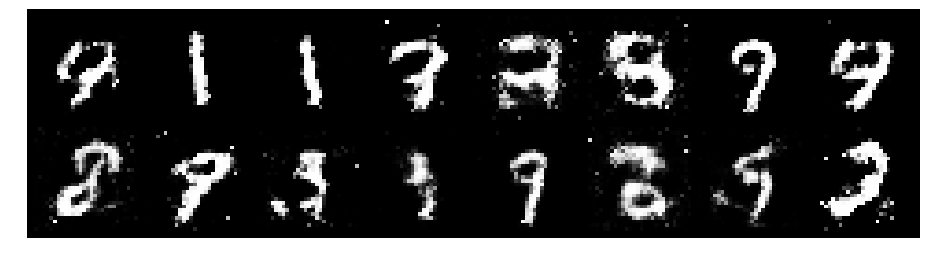

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.1773, Generator Loss: 1.0439
D(x): 0.6578, D(G(z)): 0.4201


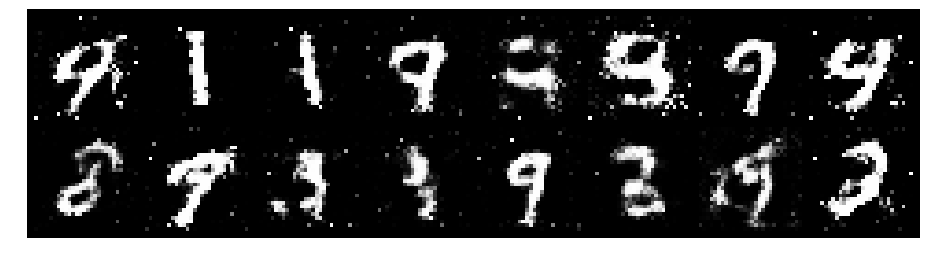

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1026, Generator Loss: 0.9688
D(x): 0.7205, D(G(z)): 0.4556


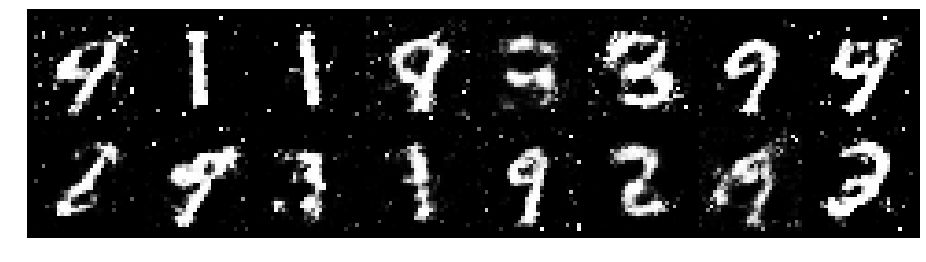

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.1564, Generator Loss: 1.0825
D(x): 0.6857, D(G(z)): 0.4368


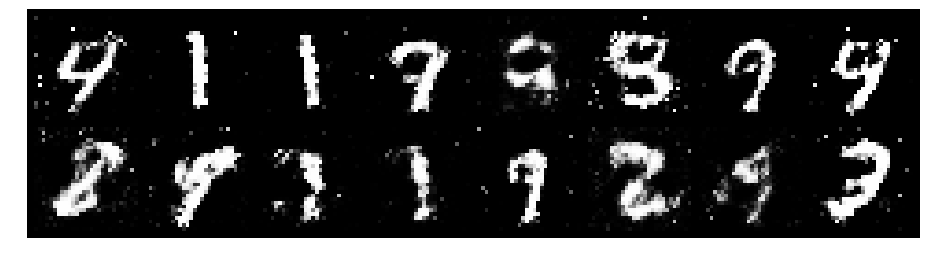

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.2132, Generator Loss: 1.5922
D(x): 0.5324, D(G(z)): 0.2971


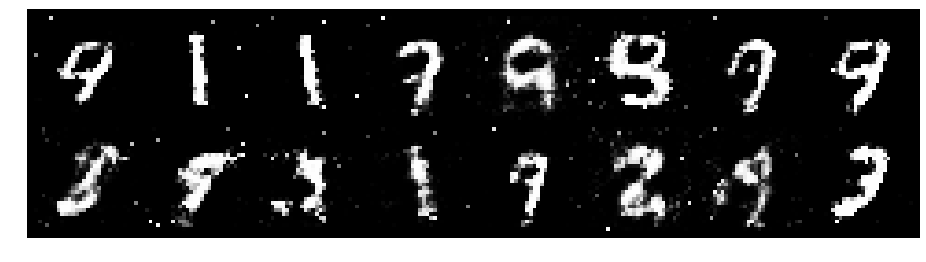

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.1407, Generator Loss: 1.6573
D(x): 0.6712, D(G(z)): 0.3530


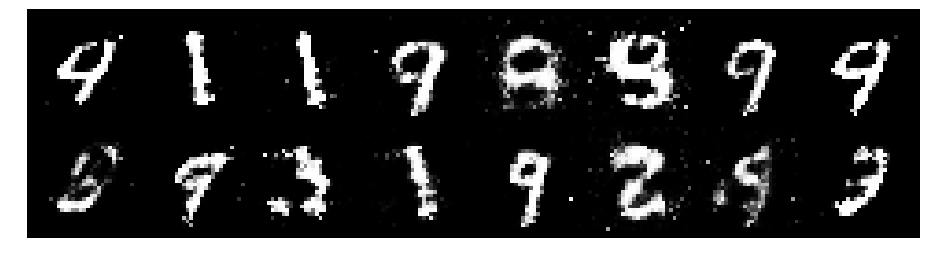

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0508, Generator Loss: 1.3830
D(x): 0.6614, D(G(z)): 0.3703


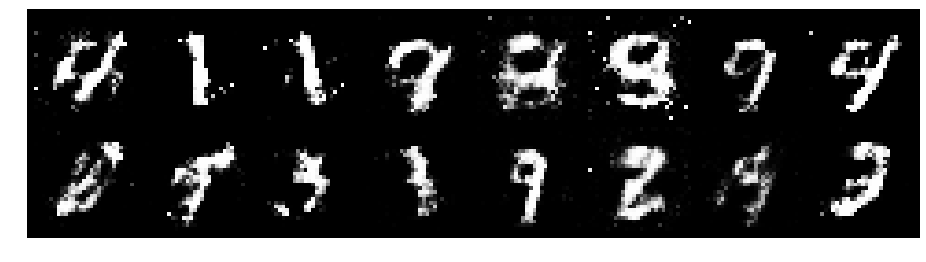

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1922, Generator Loss: 1.4085
D(x): 0.6111, D(G(z)): 0.3536


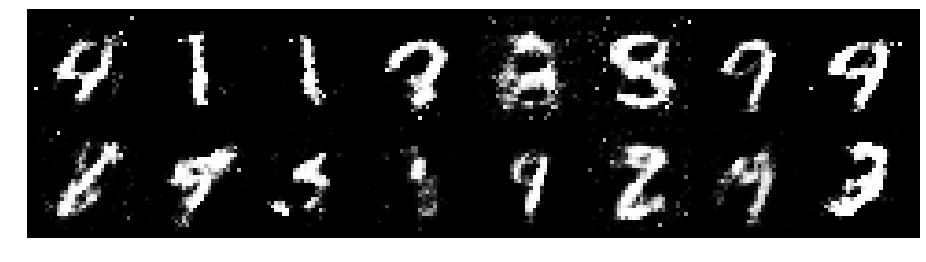

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.2245, Generator Loss: 1.0031
D(x): 0.5392, D(G(z)): 0.3632


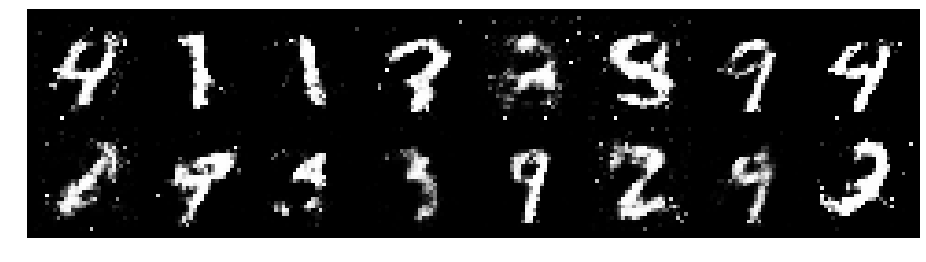

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.1297, Generator Loss: 1.1473
D(x): 0.6408, D(G(z)): 0.3896


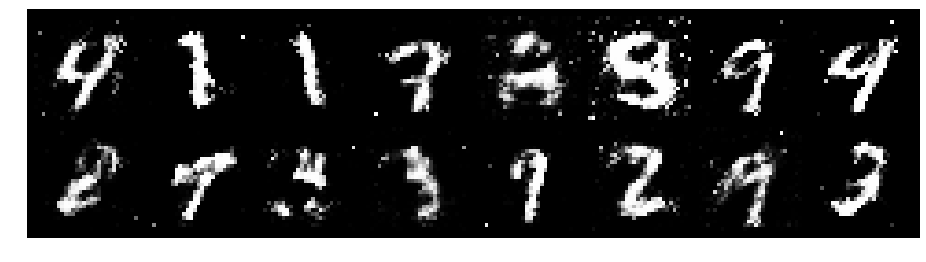

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.2259, Generator Loss: 1.0186
D(x): 0.6016, D(G(z)): 0.4101


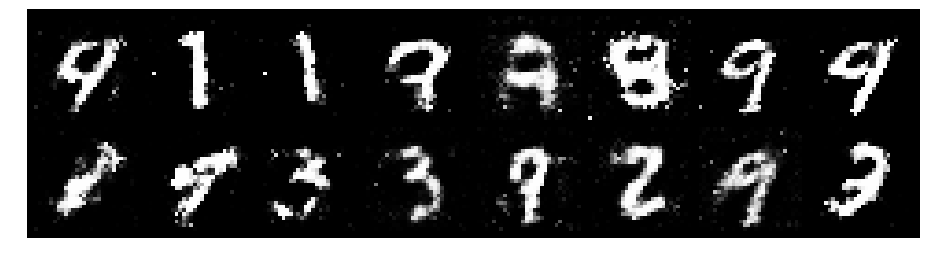

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1439, Generator Loss: 1.1166
D(x): 0.6952, D(G(z)): 0.4288


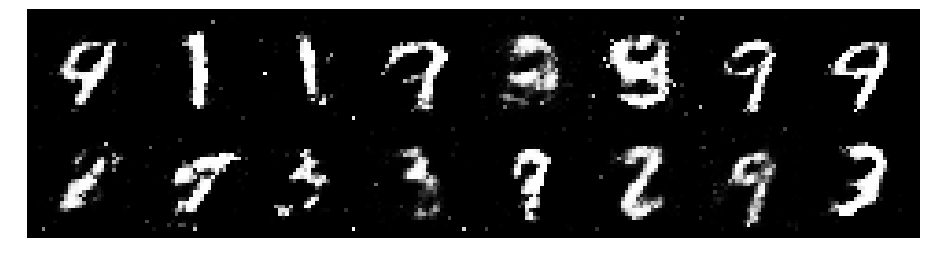

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1741, Generator Loss: 1.1031
D(x): 0.6180, D(G(z)): 0.4255


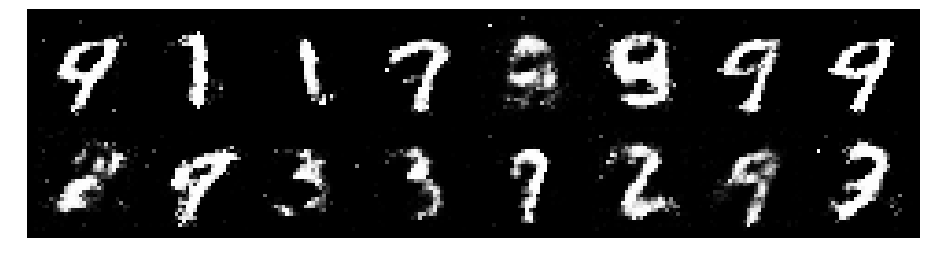

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.1339, Generator Loss: 1.2397
D(x): 0.5764, D(G(z)): 0.3434


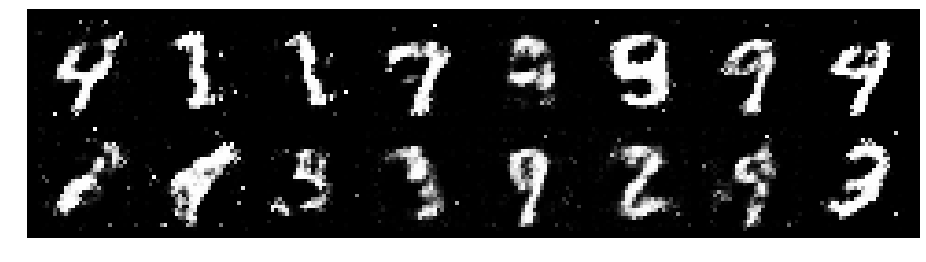

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.0739, Generator Loss: 1.3954
D(x): 0.5906, D(G(z)): 0.3081


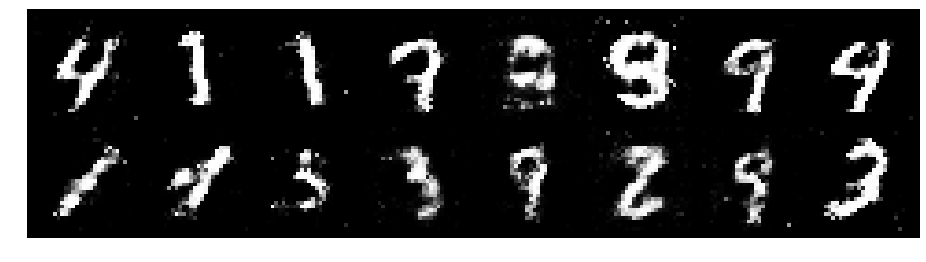

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.2998, Generator Loss: 0.8895
D(x): 0.6049, D(G(z)): 0.4571


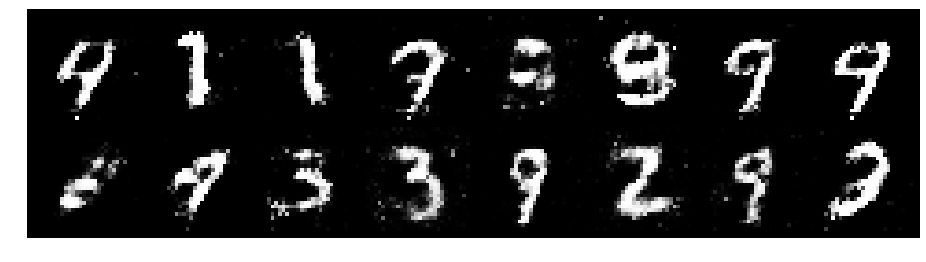

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.2759, Generator Loss: 1.0447
D(x): 0.5466, D(G(z)): 0.3841


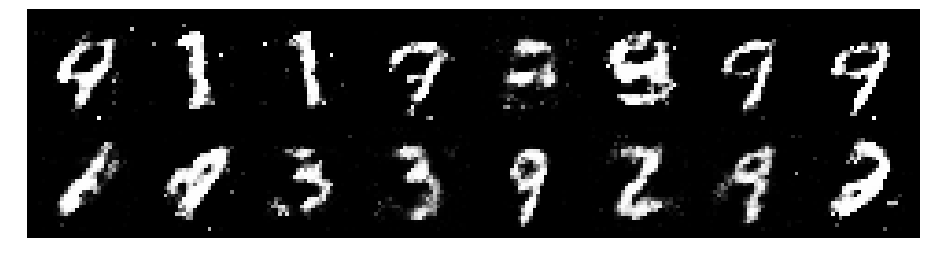

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1014, Generator Loss: 1.1698
D(x): 0.6172, D(G(z)): 0.3607


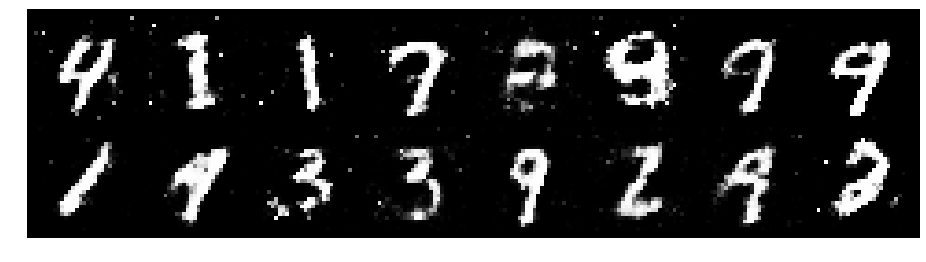

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.2194, Generator Loss: 1.4686
D(x): 0.5483, D(G(z)): 0.3002


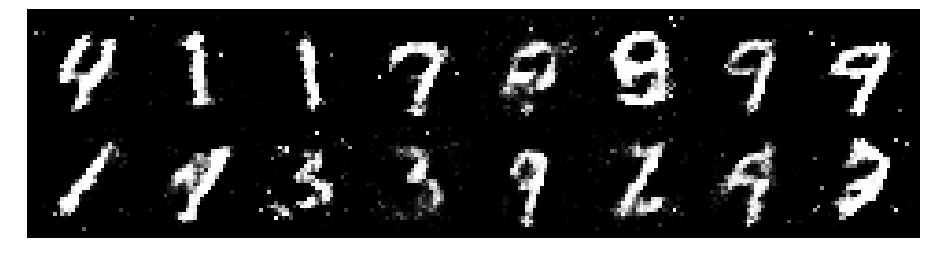

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1348, Generator Loss: 1.0446
D(x): 0.7172, D(G(z)): 0.4136


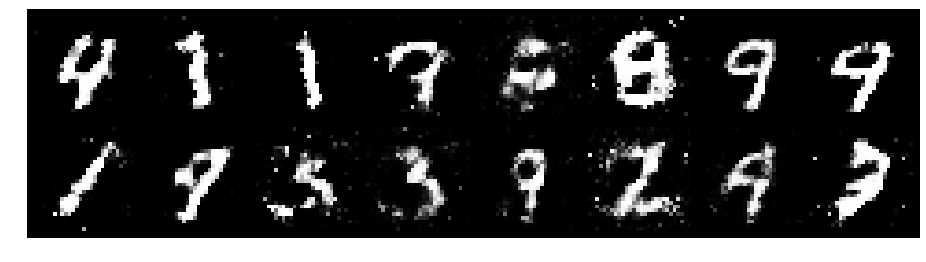

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.0468, Generator Loss: 1.1853
D(x): 0.7064, D(G(z)): 0.3848


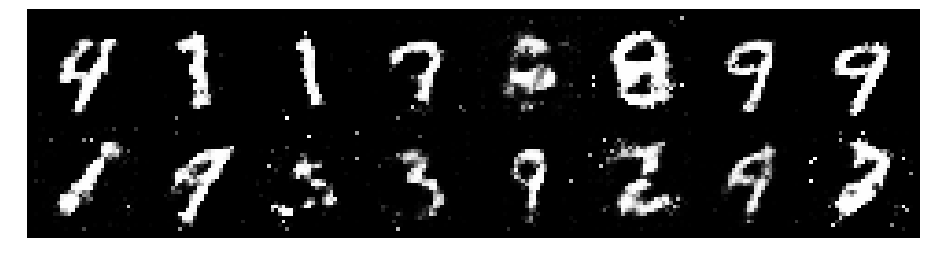

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.0205, Generator Loss: 1.1377
D(x): 0.6371, D(G(z)): 0.3515


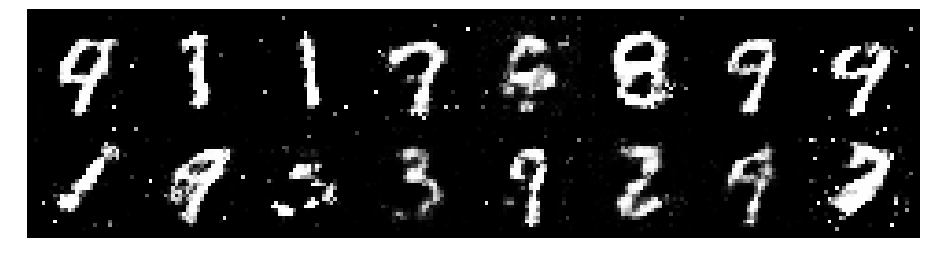

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.8963, Generator Loss: 1.5775
D(x): 0.6644, D(G(z)): 0.3009


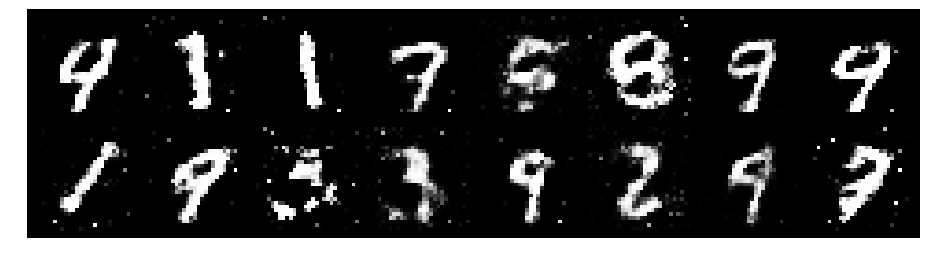

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 0.9873, Generator Loss: 1.3571
D(x): 0.6750, D(G(z)): 0.3437


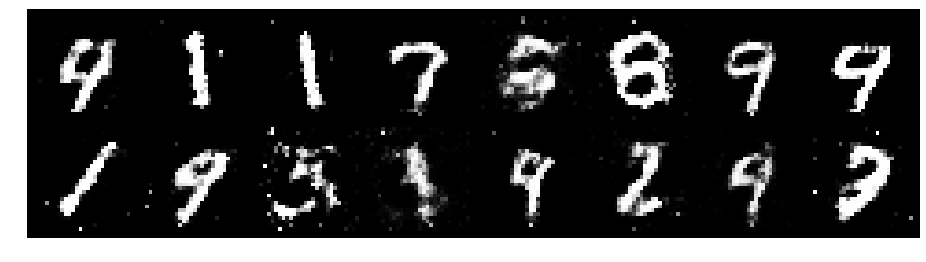

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 0.8994, Generator Loss: 1.5956
D(x): 0.7052, D(G(z)): 0.3272


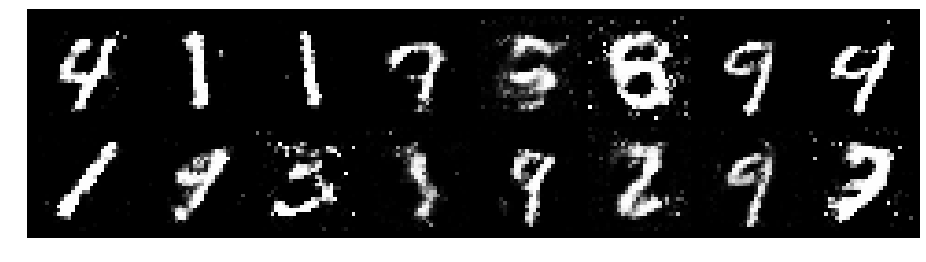

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.1238, Generator Loss: 1.4688
D(x): 0.6497, D(G(z)): 0.3619


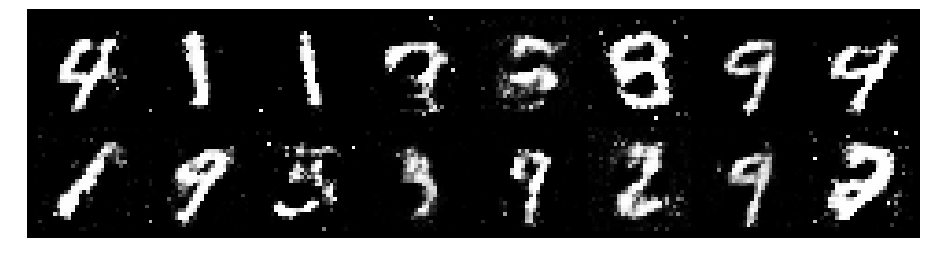

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 0.9741, Generator Loss: 1.6718
D(x): 0.6912, D(G(z)): 0.3532


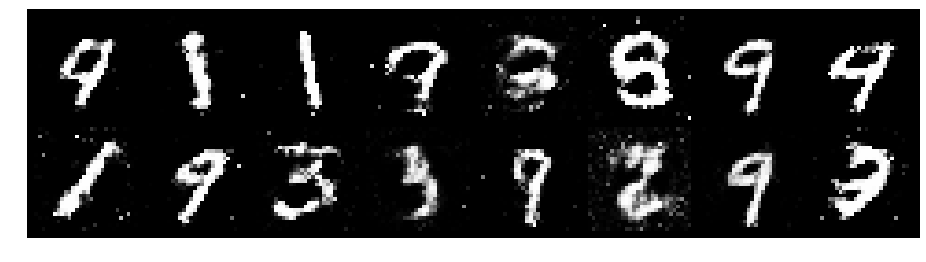

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0580, Generator Loss: 1.3779
D(x): 0.6459, D(G(z)): 0.3580


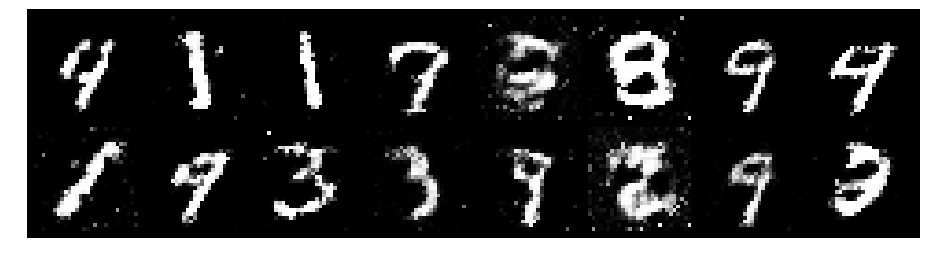

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.1218, Generator Loss: 1.1355
D(x): 0.6223, D(G(z)): 0.3929


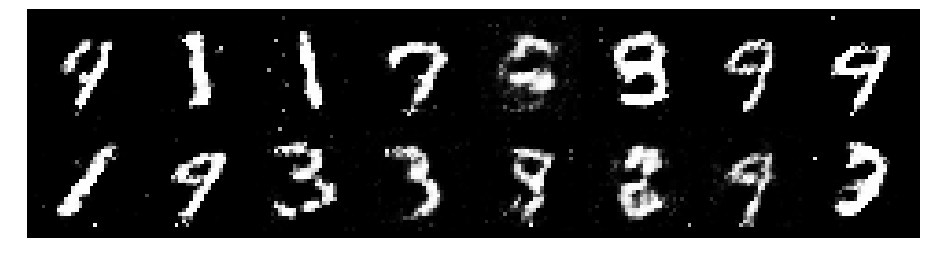

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.2036, Generator Loss: 0.9529
D(x): 0.6391, D(G(z)): 0.4507


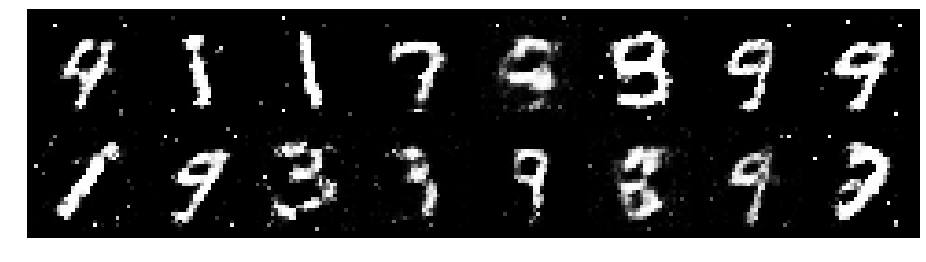

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1586, Generator Loss: 0.9286
D(x): 0.6499, D(G(z)): 0.4175


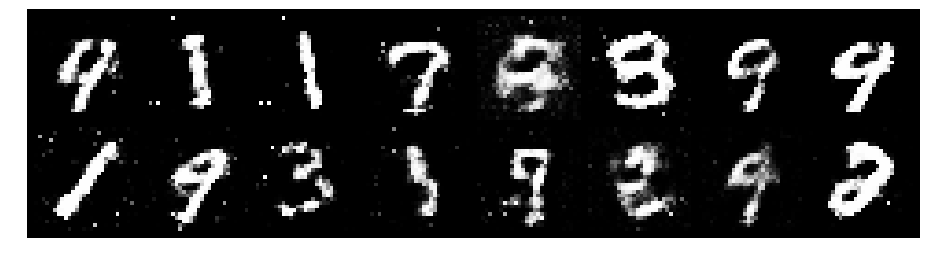

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.0444, Generator Loss: 1.2068
D(x): 0.6067, D(G(z)): 0.3280


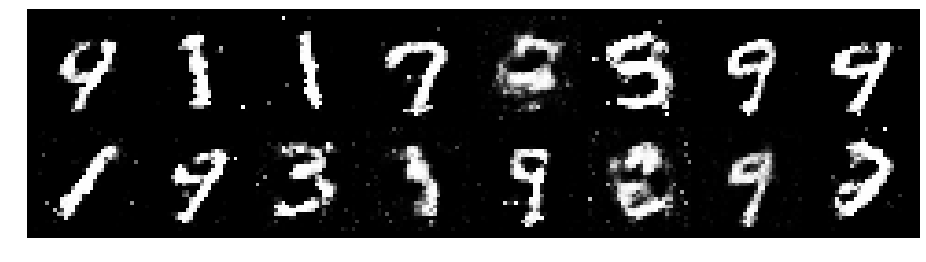

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0835, Generator Loss: 1.1500
D(x): 0.6235, D(G(z)): 0.3804


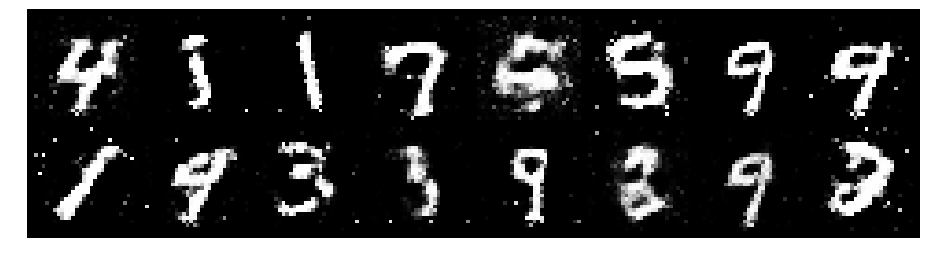

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1035, Generator Loss: 1.0293
D(x): 0.6299, D(G(z)): 0.3949


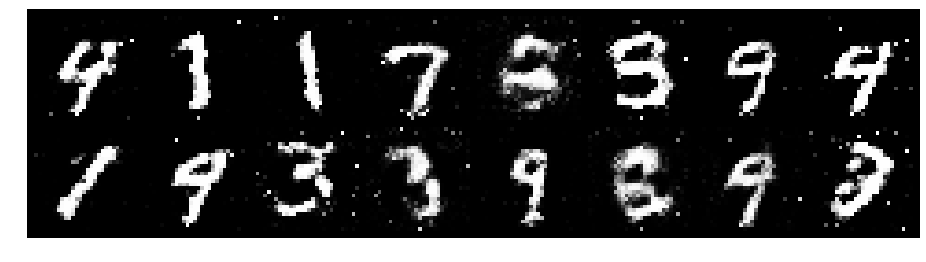

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.0658, Generator Loss: 1.2377
D(x): 0.6539, D(G(z)): 0.3674


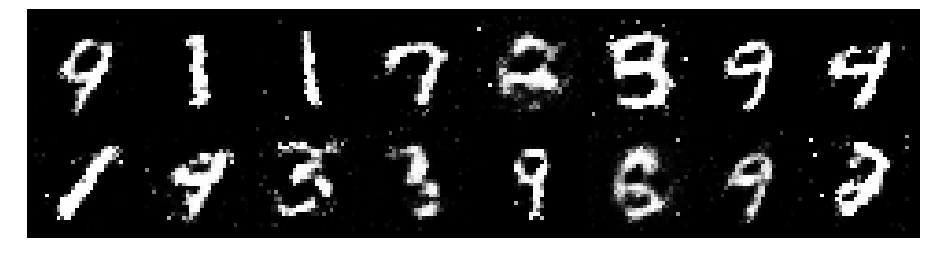

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.0814, Generator Loss: 1.2447
D(x): 0.6014, D(G(z)): 0.3591


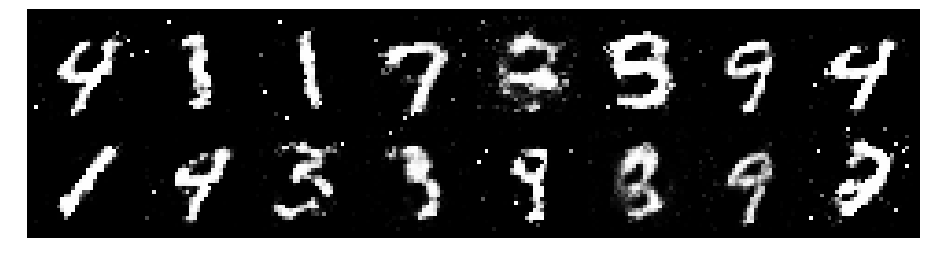

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 0.9838, Generator Loss: 1.2455
D(x): 0.6781, D(G(z)): 0.3433


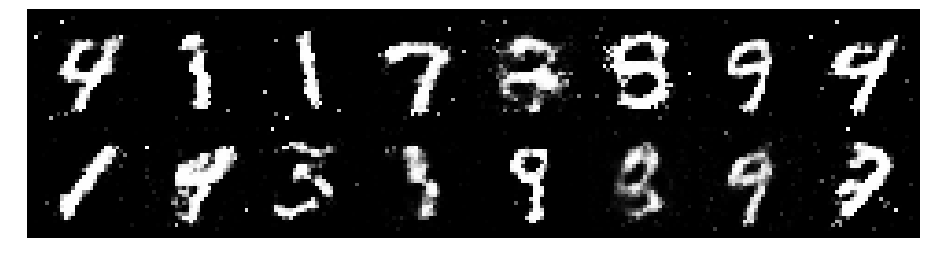

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1813, Generator Loss: 1.1856
D(x): 0.5390, D(G(z)): 0.3275


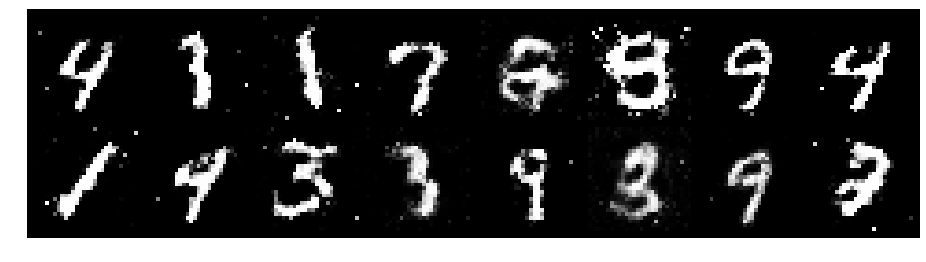

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.0226, Generator Loss: 1.1532
D(x): 0.6007, D(G(z)): 0.3232


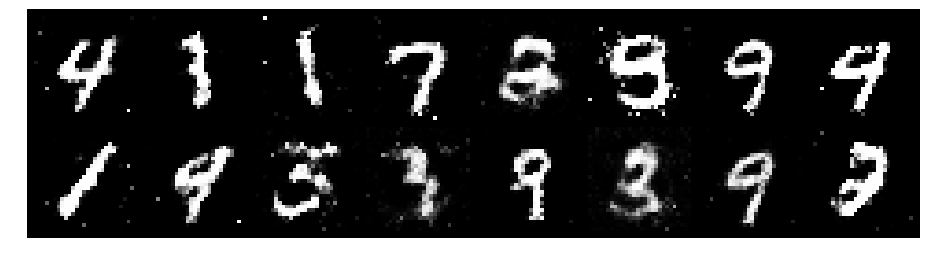

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0475, Generator Loss: 1.2989
D(x): 0.6238, D(G(z)): 0.3596


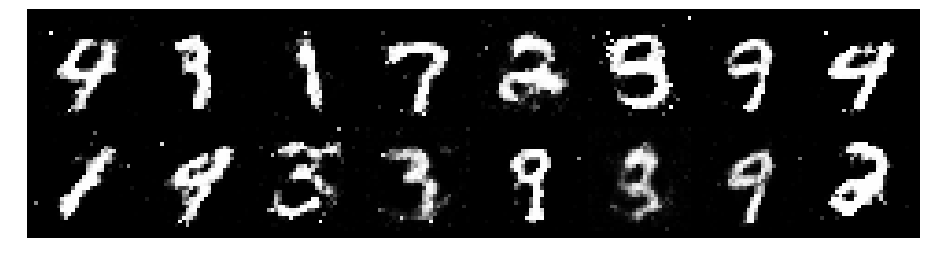

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.1166, Generator Loss: 1.2677
D(x): 0.5797, D(G(z)): 0.3244


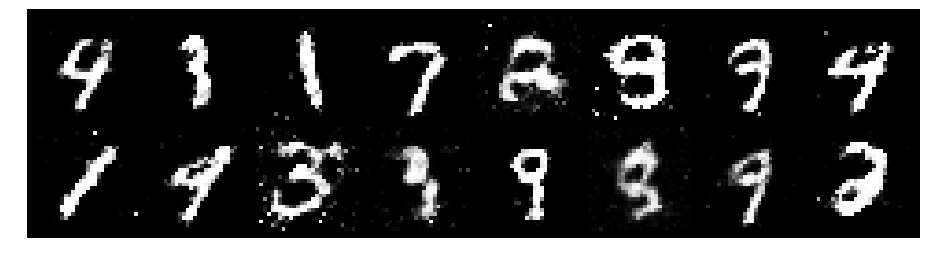

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.0299, Generator Loss: 1.3931
D(x): 0.6237, D(G(z)): 0.3243


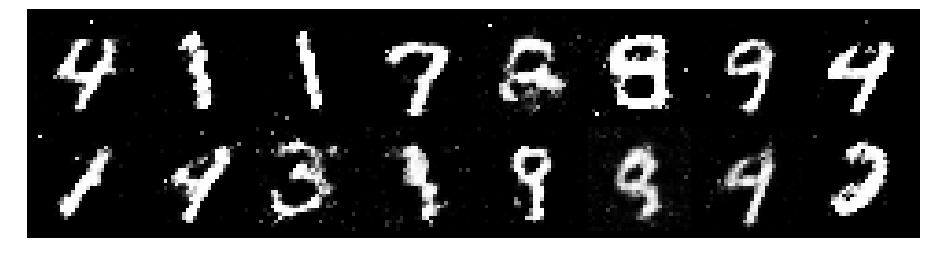

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0506, Generator Loss: 1.3870
D(x): 0.6724, D(G(z)): 0.3507


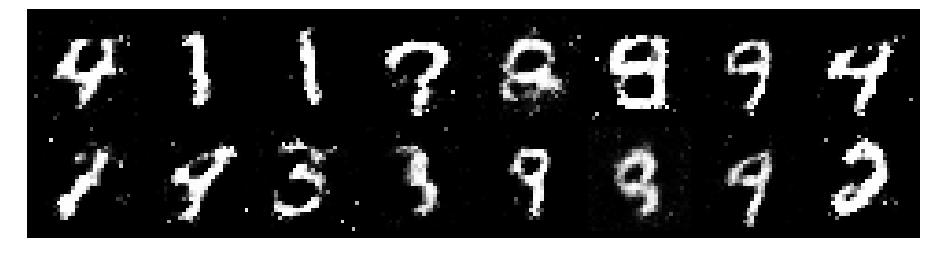

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1349, Generator Loss: 1.2613
D(x): 0.6208, D(G(z)): 0.3946


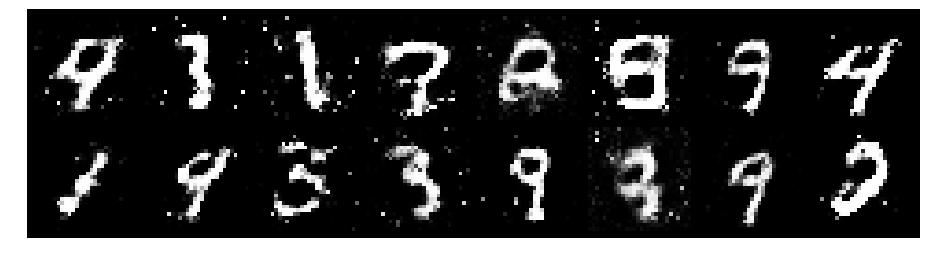

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.1813, Generator Loss: 1.2016
D(x): 0.6157, D(G(z)): 0.3861


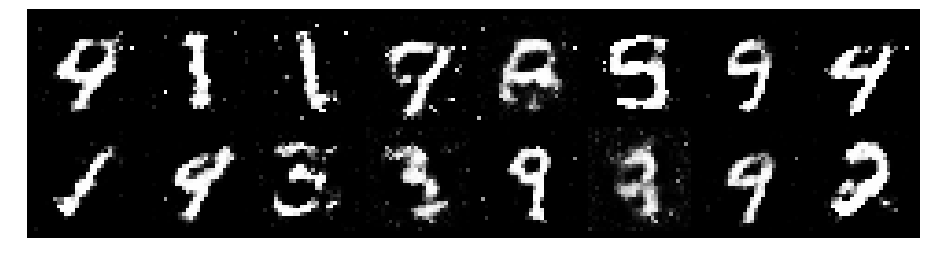

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1865, Generator Loss: 1.0270
D(x): 0.6208, D(G(z)): 0.4046


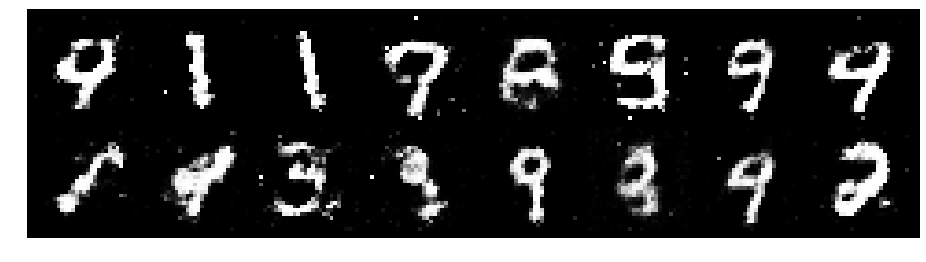

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.0323, Generator Loss: 1.5231
D(x): 0.6182, D(G(z)): 0.3134


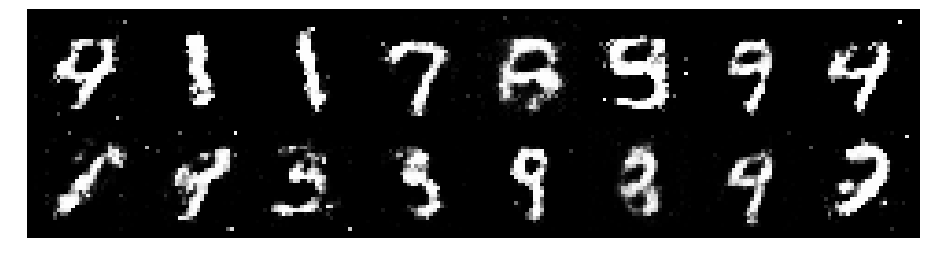

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1858, Generator Loss: 0.9677
D(x): 0.5897, D(G(z)): 0.3884


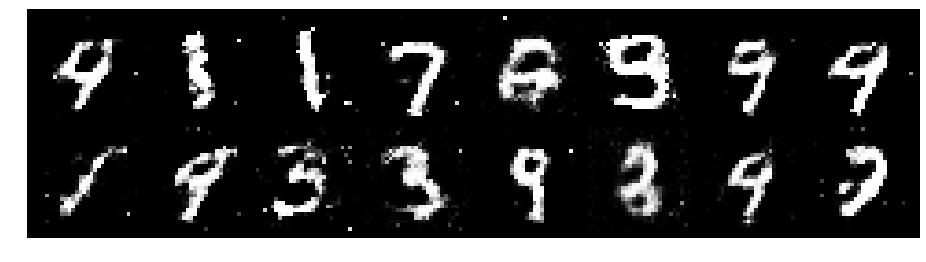

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.2273, Generator Loss: 0.8778
D(x): 0.7142, D(G(z)): 0.4936


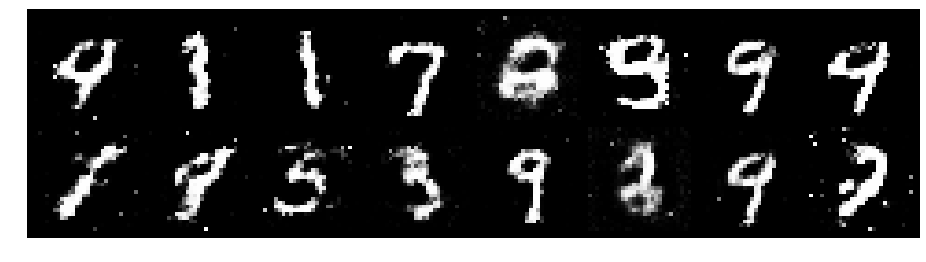

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1410, Generator Loss: 1.1437
D(x): 0.5978, D(G(z)): 0.3632


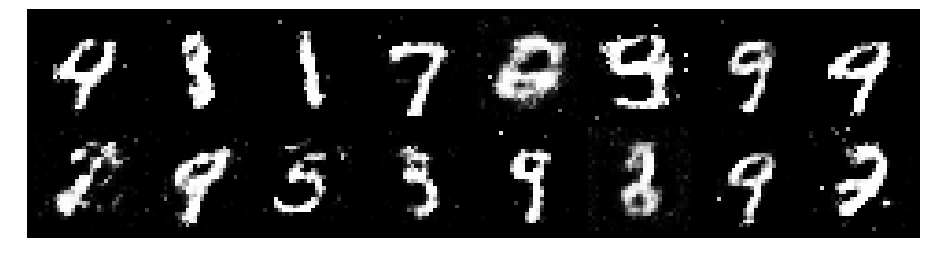

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.0737, Generator Loss: 1.2918
D(x): 0.6581, D(G(z)): 0.3808


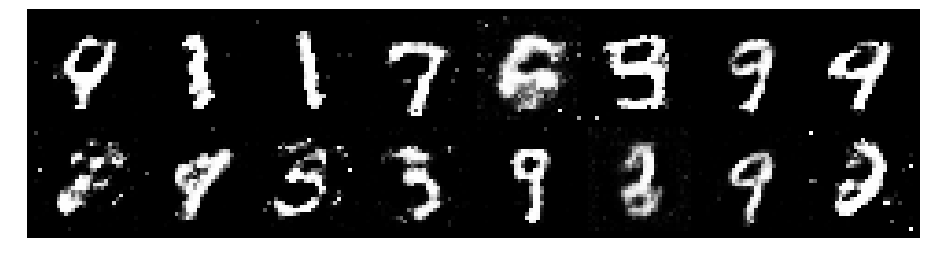

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.0201, Generator Loss: 1.1490
D(x): 0.6983, D(G(z)): 0.3606


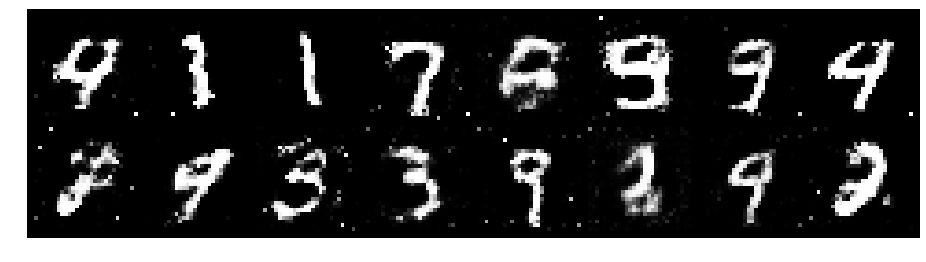

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.1141, Generator Loss: 1.2051
D(x): 0.6503, D(G(z)): 0.3740


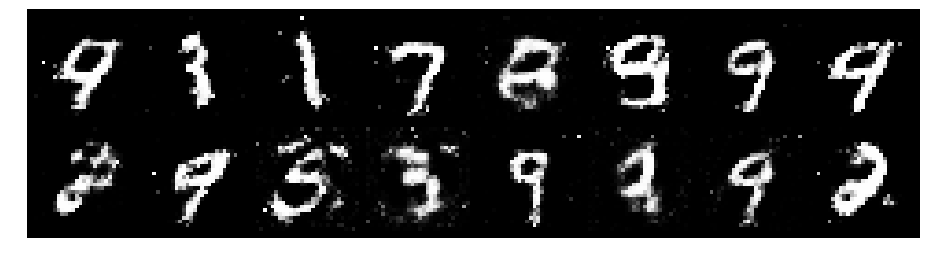

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0754, Generator Loss: 1.3218
D(x): 0.5849, D(G(z)): 0.3540


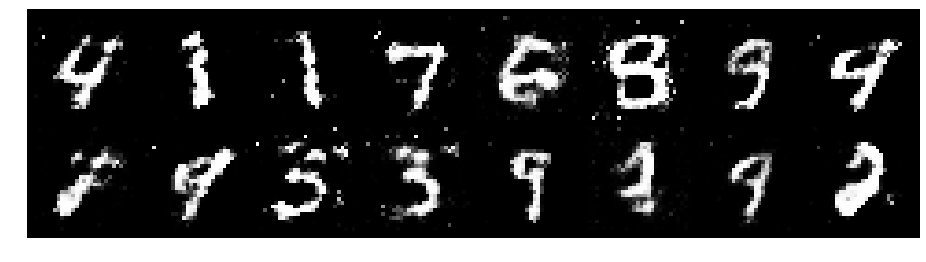

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.0128, Generator Loss: 1.1901
D(x): 0.6179, D(G(z)): 0.3403


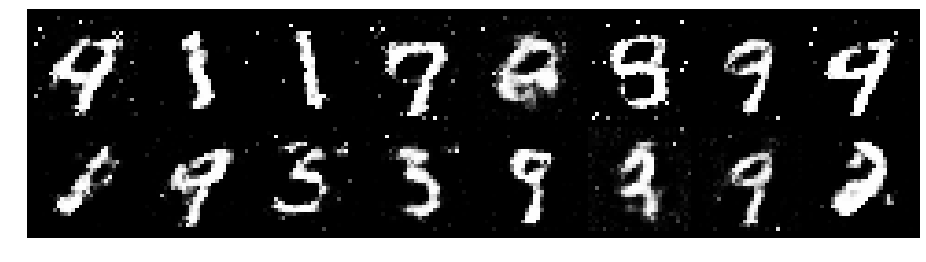

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1443, Generator Loss: 1.0138
D(x): 0.6175, D(G(z)): 0.4218


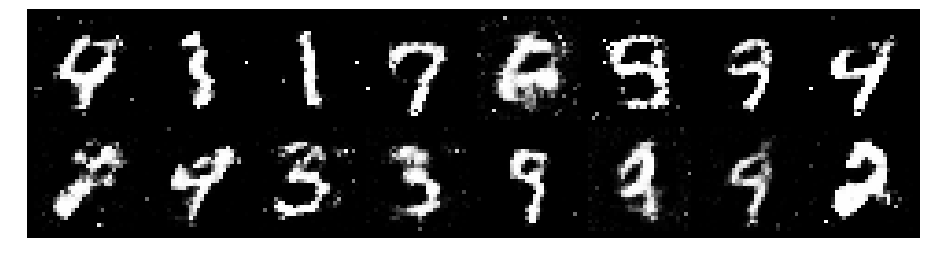

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.0905, Generator Loss: 1.0763
D(x): 0.6568, D(G(z)): 0.4196


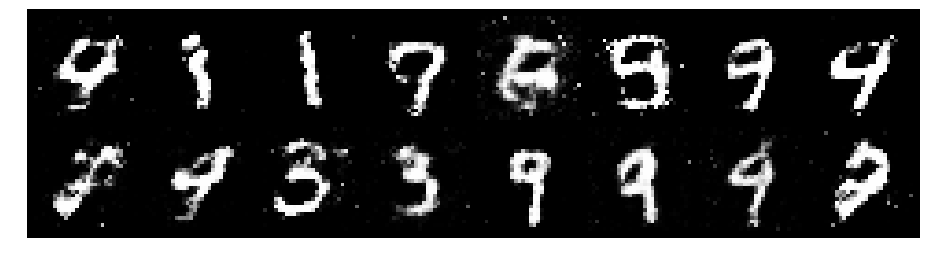

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.0682, Generator Loss: 1.1793
D(x): 0.6170, D(G(z)): 0.3635


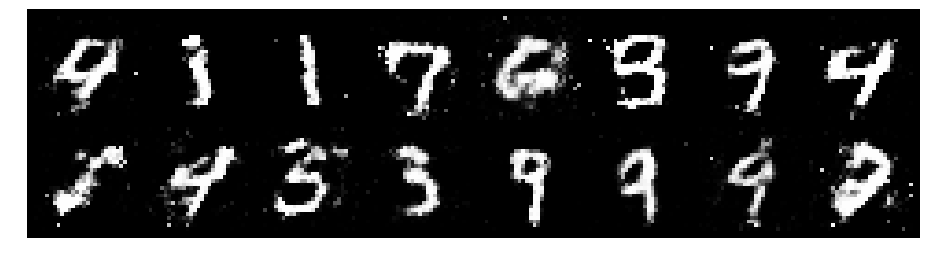

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 0.9945, Generator Loss: 1.2294
D(x): 0.6151, D(G(z)): 0.3108


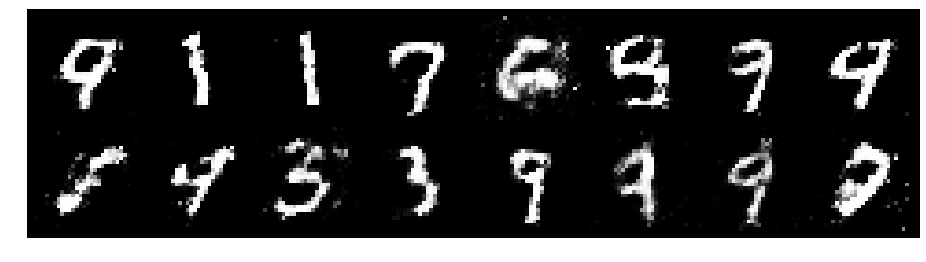

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1550, Generator Loss: 1.2611
D(x): 0.6242, D(G(z)): 0.3795


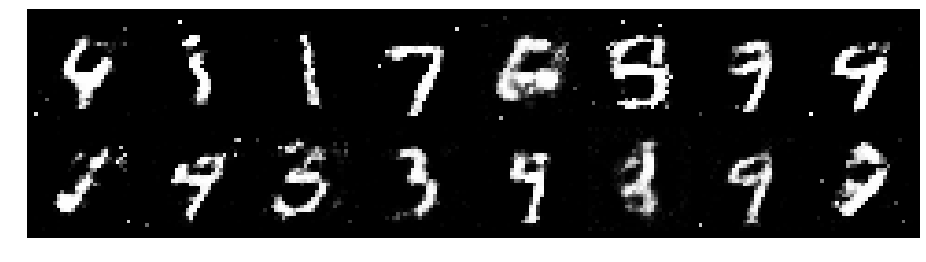

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.3015, Generator Loss: 0.9043
D(x): 0.5919, D(G(z)): 0.4360


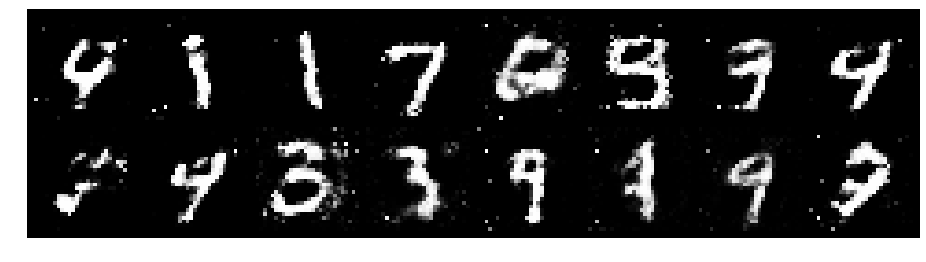

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.1317, Generator Loss: 1.0157
D(x): 0.6287, D(G(z)): 0.3904


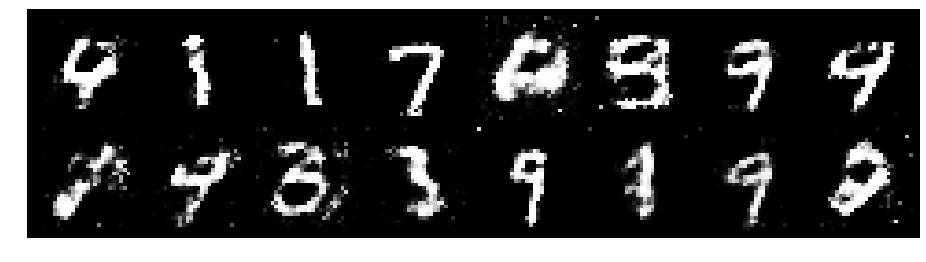

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.2037, Generator Loss: 1.0223
D(x): 0.5704, D(G(z)): 0.3771


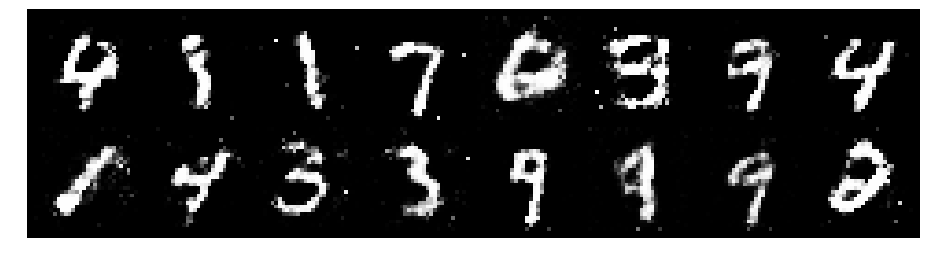

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.4111, Generator Loss: 0.9254
D(x): 0.6176, D(G(z)): 0.5164


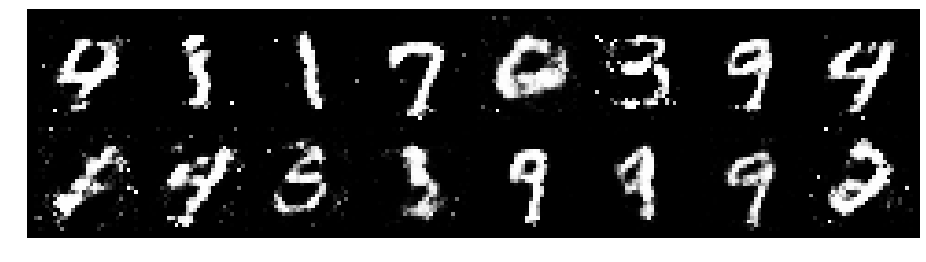

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.0941, Generator Loss: 1.1837
D(x): 0.6421, D(G(z)): 0.3888


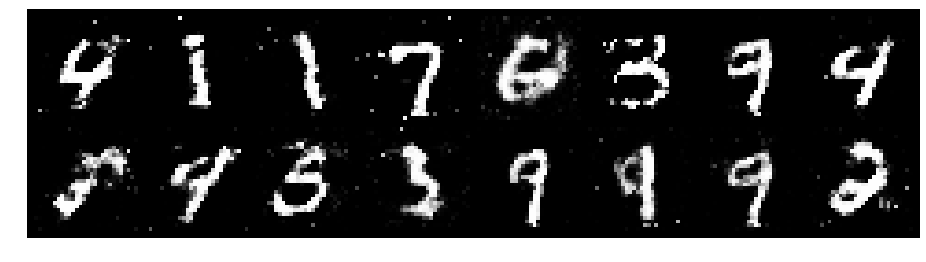

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.0758, Generator Loss: 1.2216
D(x): 0.5989, D(G(z)): 0.3360


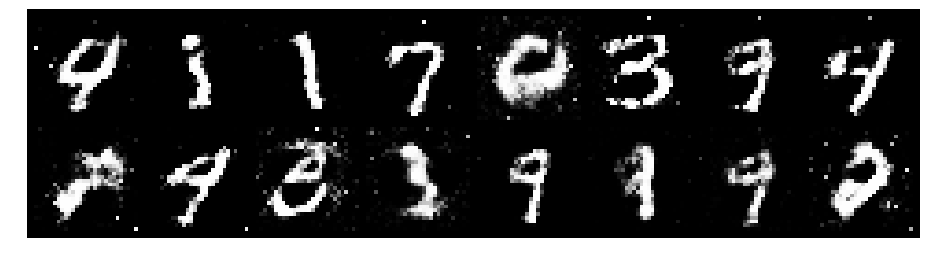

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1176, Generator Loss: 1.2484
D(x): 0.5664, D(G(z)): 0.3468


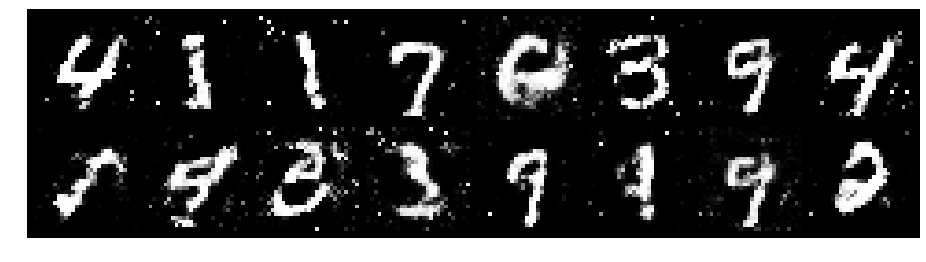

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1220, Generator Loss: 1.0685
D(x): 0.5982, D(G(z)): 0.3925


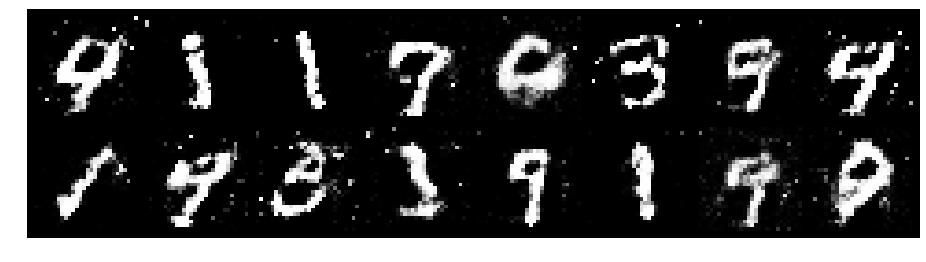

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1057, Generator Loss: 1.0655
D(x): 0.5968, D(G(z)): 0.3823


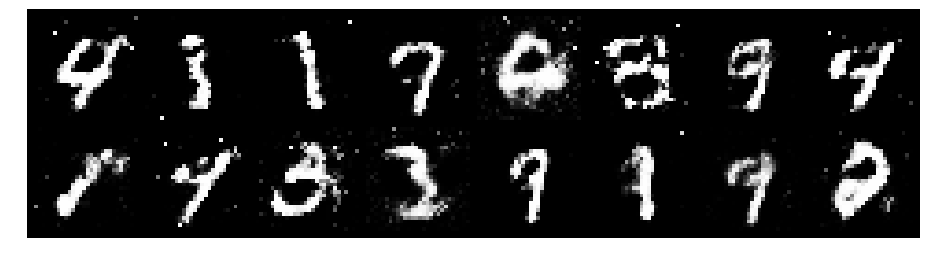

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 0.9626, Generator Loss: 1.2249
D(x): 0.6486, D(G(z)): 0.3435


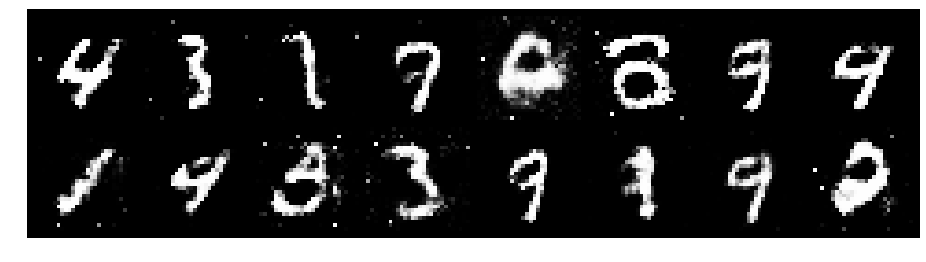

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.2538, Generator Loss: 0.9783
D(x): 0.5868, D(G(z)): 0.4427


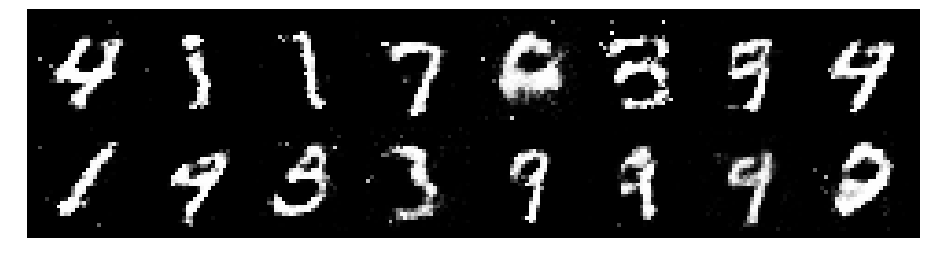

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.2005, Generator Loss: 0.9414
D(x): 0.5845, D(G(z)): 0.4234


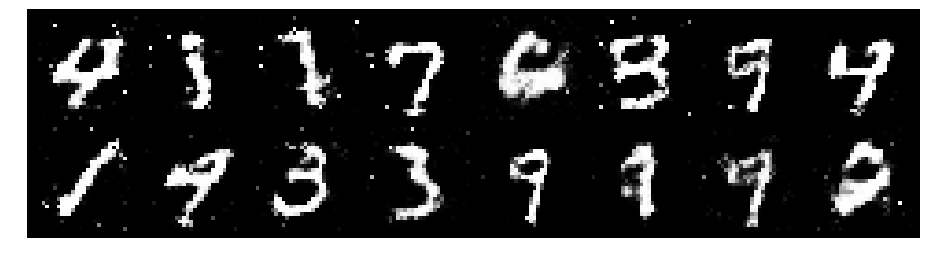

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0986, Generator Loss: 1.1202
D(x): 0.6364, D(G(z)): 0.4072


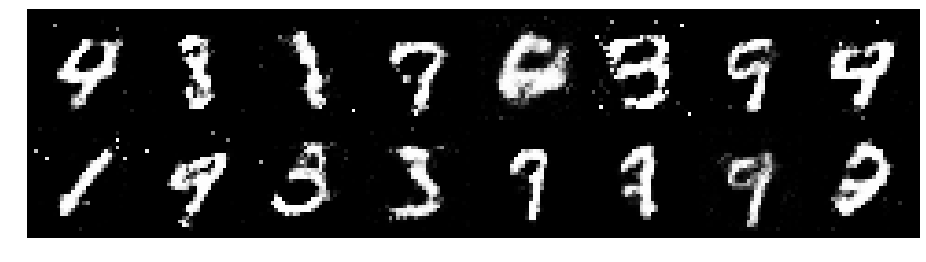

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1357, Generator Loss: 1.3389
D(x): 0.6103, D(G(z)): 0.3551


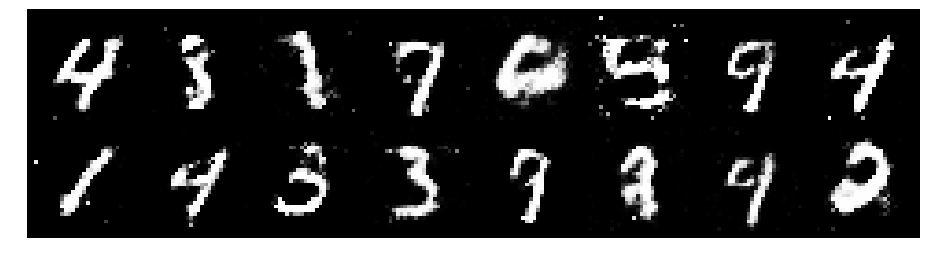

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1547, Generator Loss: 0.9280
D(x): 0.6236, D(G(z)): 0.4465


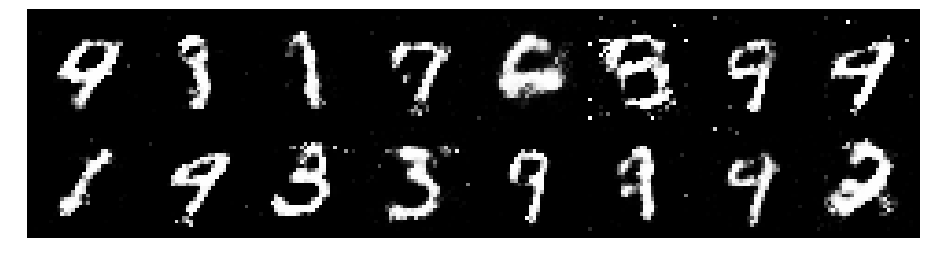

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.3792, Generator Loss: 1.2538
D(x): 0.5221, D(G(z)): 0.3984


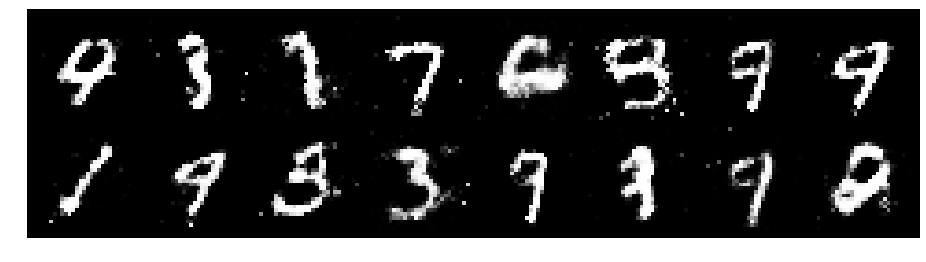

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.0878, Generator Loss: 1.4005
D(x): 0.6146, D(G(z)): 0.3281


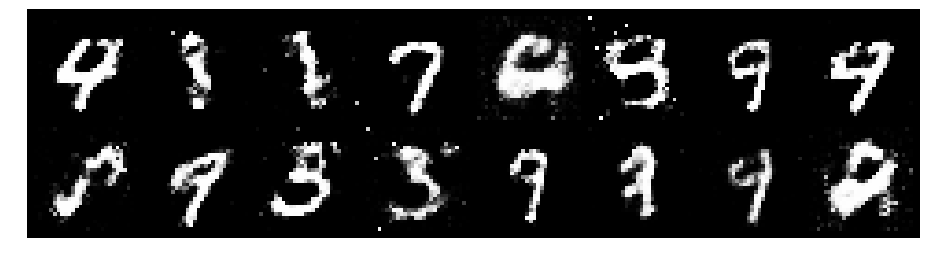

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1262, Generator Loss: 1.1102
D(x): 0.7049, D(G(z)): 0.4565


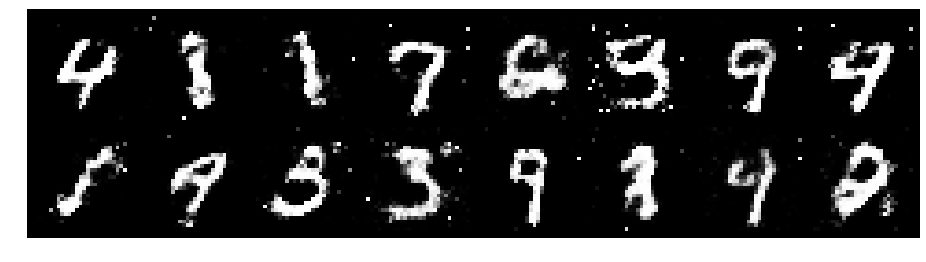

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 0.9921, Generator Loss: 1.0441
D(x): 0.6635, D(G(z)): 0.3620


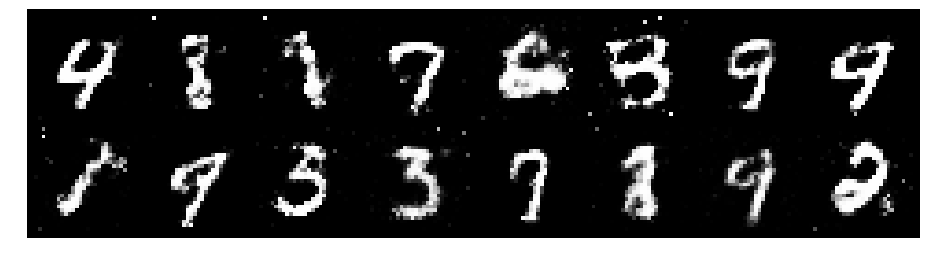

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1263, Generator Loss: 1.0519
D(x): 0.6227, D(G(z)): 0.3882


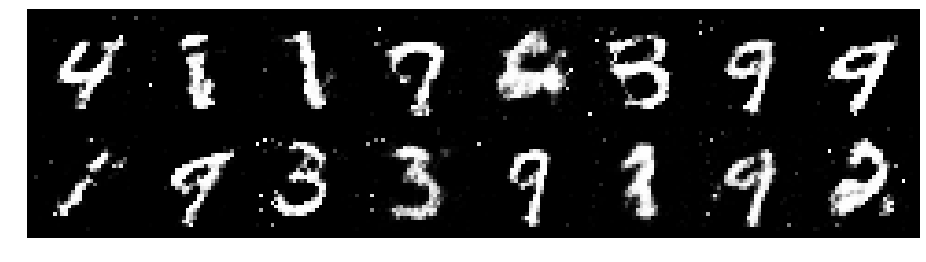

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 0.9303, Generator Loss: 1.1037
D(x): 0.6875, D(G(z)): 0.3406


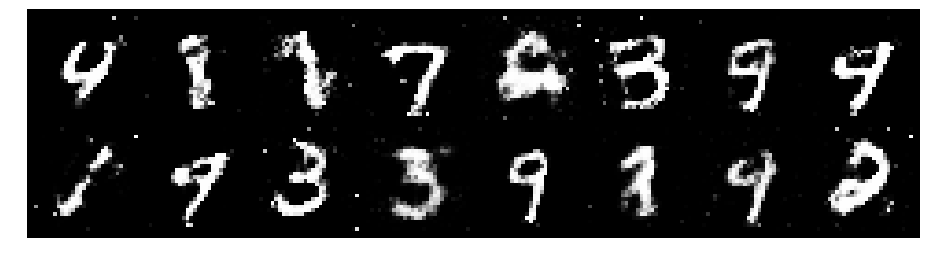

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.0638, Generator Loss: 1.1778
D(x): 0.6187, D(G(z)): 0.3712


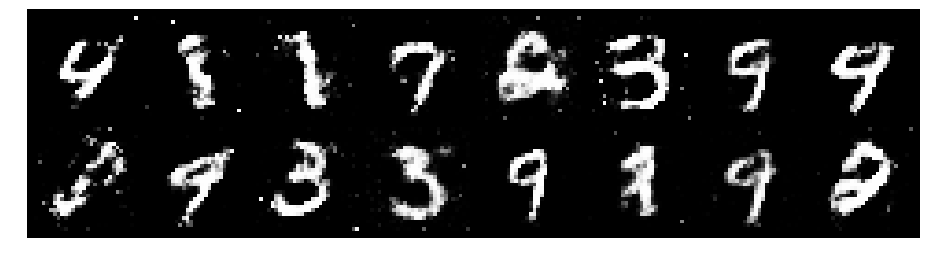

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.2046, Generator Loss: 1.1794
D(x): 0.5929, D(G(z)): 0.3801


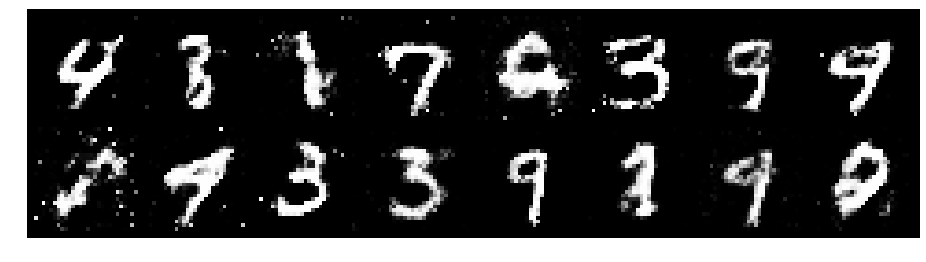

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.3671, Generator Loss: 1.0472
D(x): 0.5578, D(G(z)): 0.4593


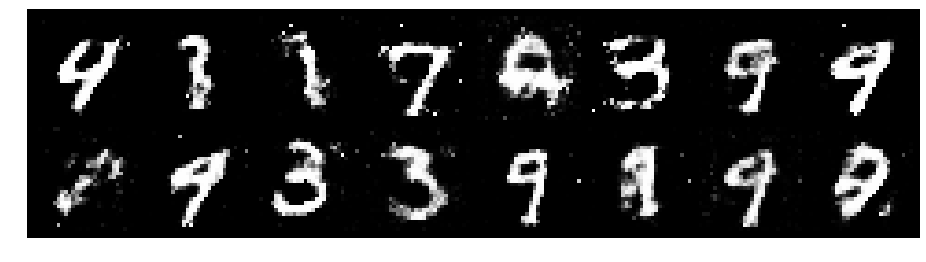

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.2669, Generator Loss: 0.8859
D(x): 0.5653, D(G(z)): 0.4101


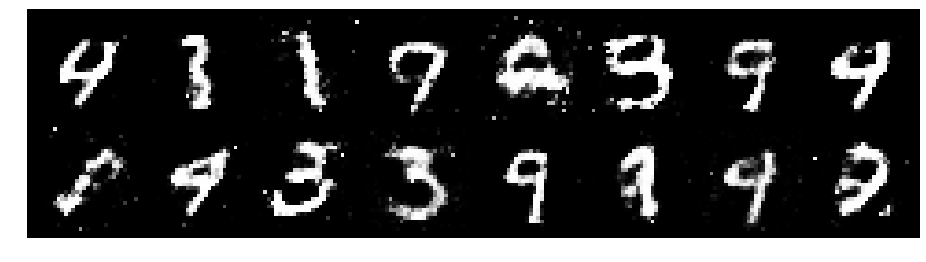

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.2613, Generator Loss: 0.9637
D(x): 0.6084, D(G(z)): 0.4451


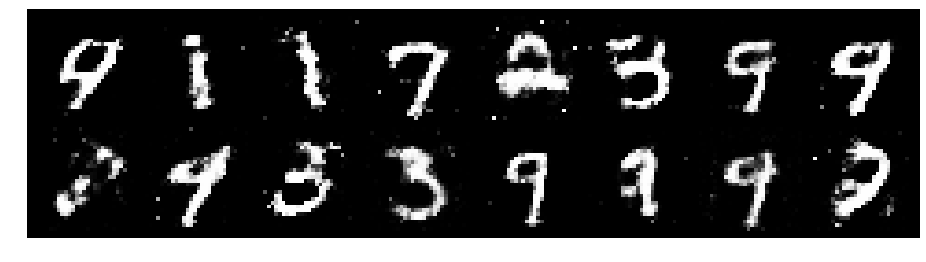

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.2092, Generator Loss: 1.0237
D(x): 0.5685, D(G(z)): 0.3976


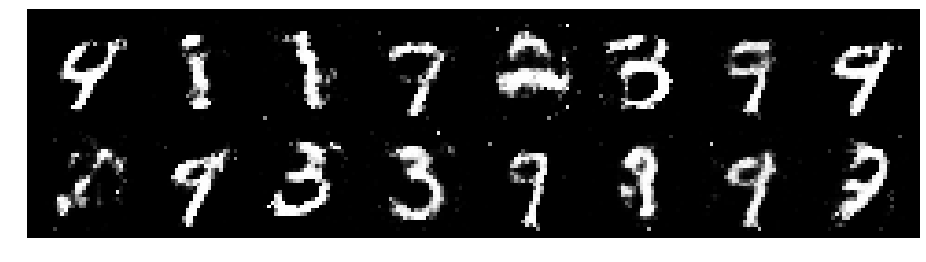

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1196, Generator Loss: 1.1055
D(x): 0.5995, D(G(z)): 0.3956


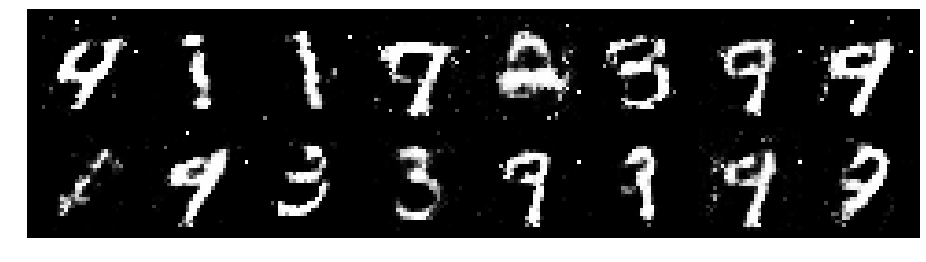

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.2314, Generator Loss: 0.9297
D(x): 0.6069, D(G(z)): 0.4360


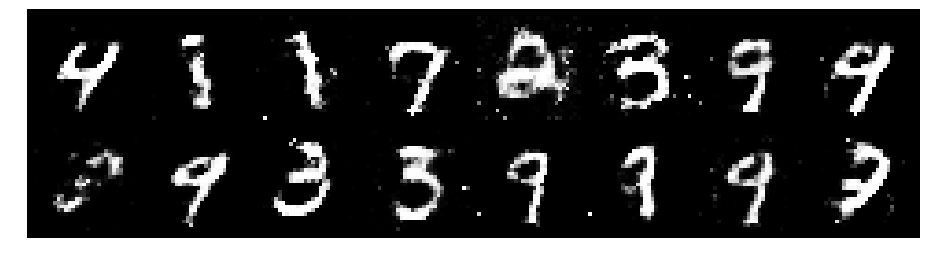

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1114, Generator Loss: 1.0850
D(x): 0.6191, D(G(z)): 0.3967


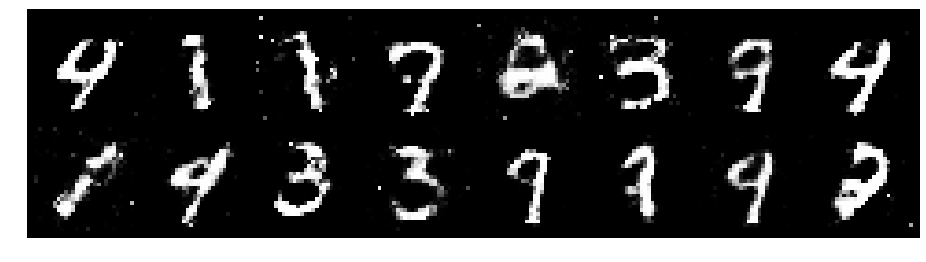

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1550, Generator Loss: 1.1386
D(x): 0.5740, D(G(z)): 0.3469


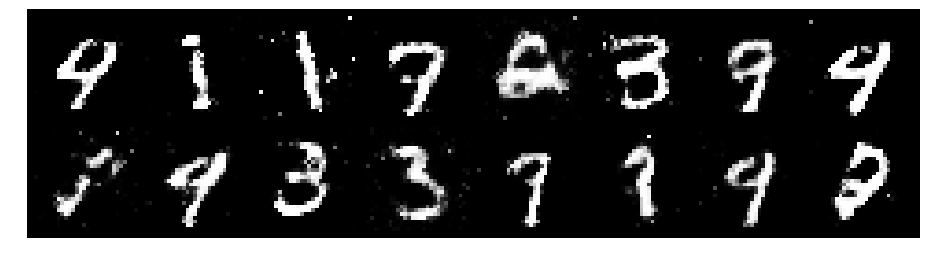

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.3230, Generator Loss: 0.9869
D(x): 0.5554, D(G(z)): 0.4430


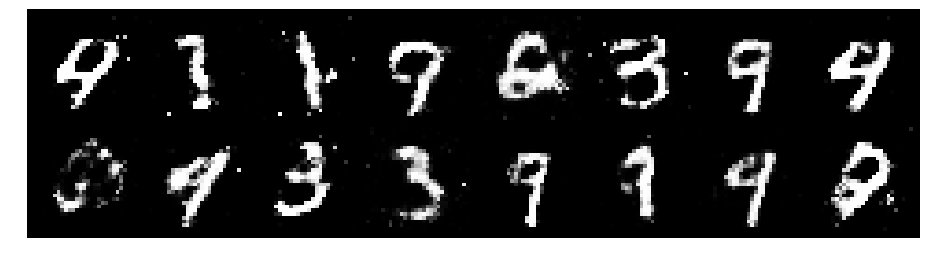

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.2352, Generator Loss: 1.0798
D(x): 0.5449, D(G(z)): 0.3804


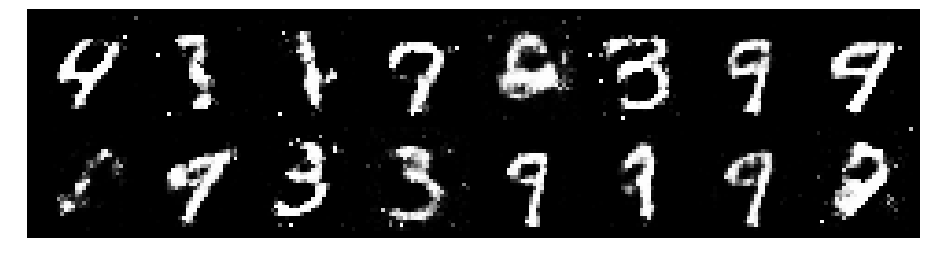

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.2334, Generator Loss: 1.1054
D(x): 0.5846, D(G(z)): 0.3929


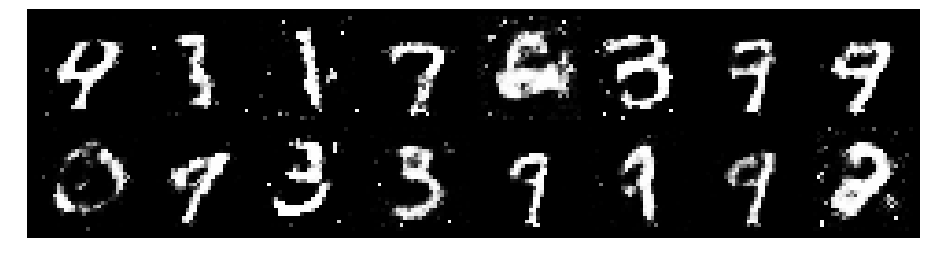

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.2094, Generator Loss: 1.2306
D(x): 0.5848, D(G(z)): 0.3779


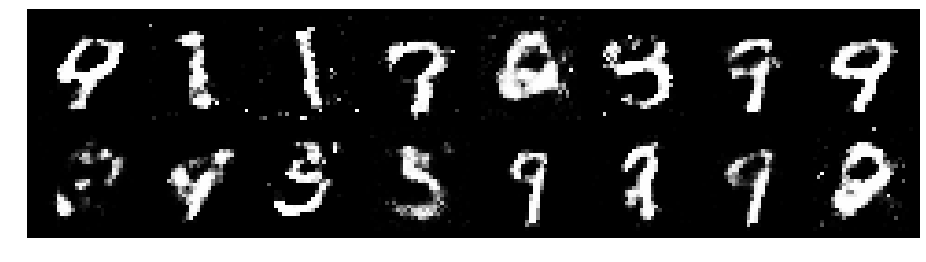

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.2657, Generator Loss: 0.9822
D(x): 0.6138, D(G(z)): 0.4798


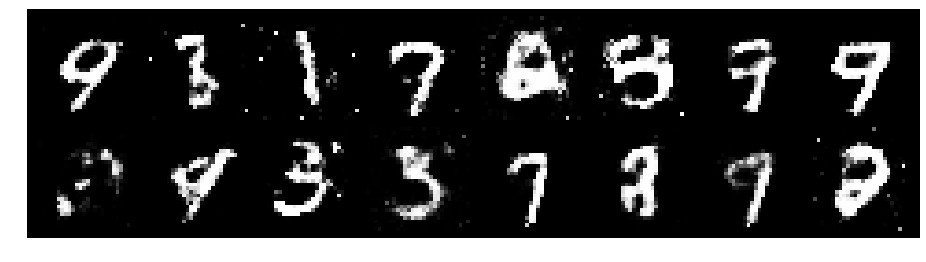

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.2122, Generator Loss: 1.2121
D(x): 0.5437, D(G(z)): 0.3478


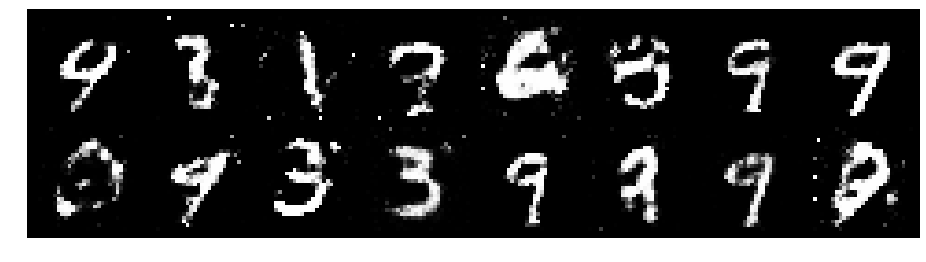

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1147, Generator Loss: 1.0305
D(x): 0.6518, D(G(z)): 0.4042


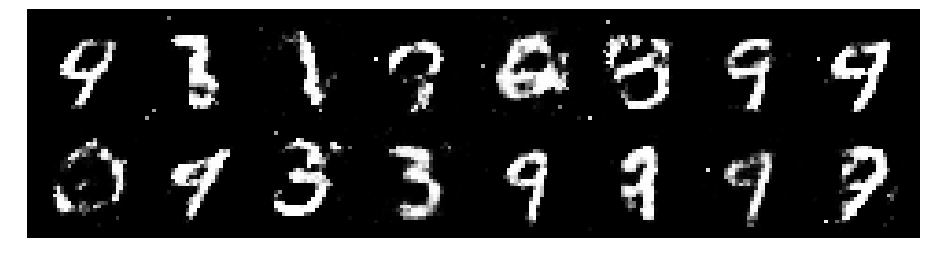

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.2632, Generator Loss: 1.0932
D(x): 0.5212, D(G(z)): 0.3458


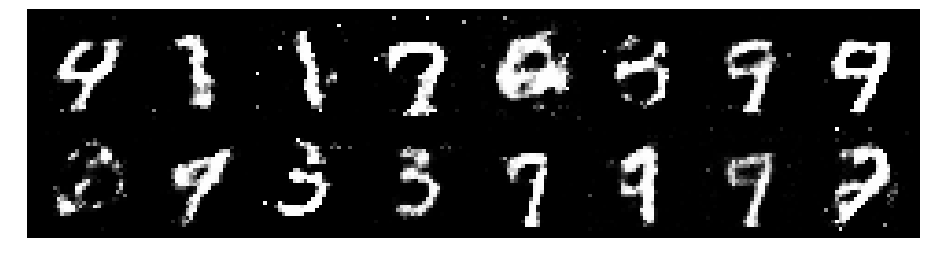

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.1611, Generator Loss: 1.5359
D(x): 0.6550, D(G(z)): 0.3908


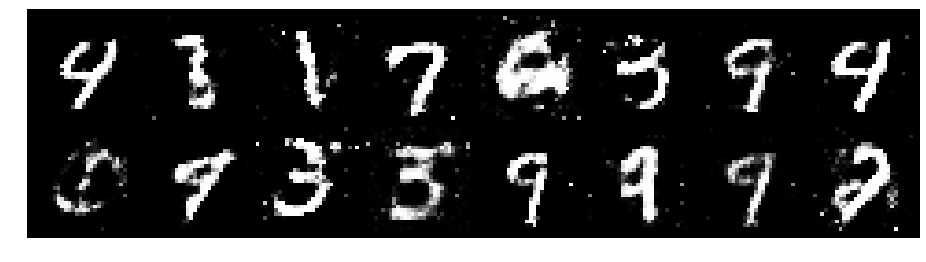

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1574, Generator Loss: 1.0773
D(x): 0.6157, D(G(z)): 0.4141


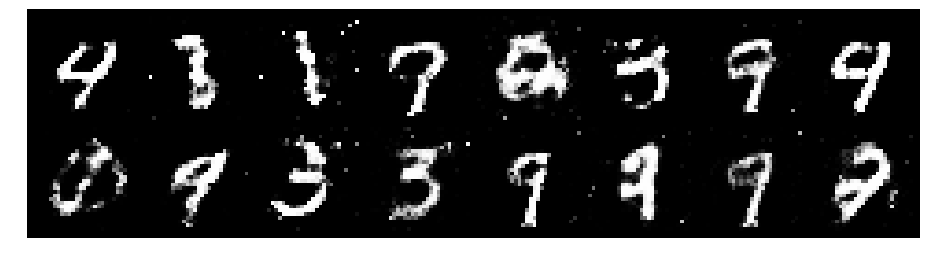

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.0361, Generator Loss: 1.3305
D(x): 0.6138, D(G(z)): 0.3165


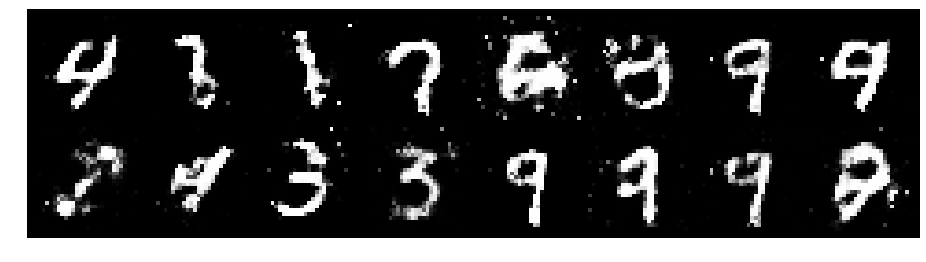

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.0429, Generator Loss: 0.9090
D(x): 0.6421, D(G(z)): 0.4186


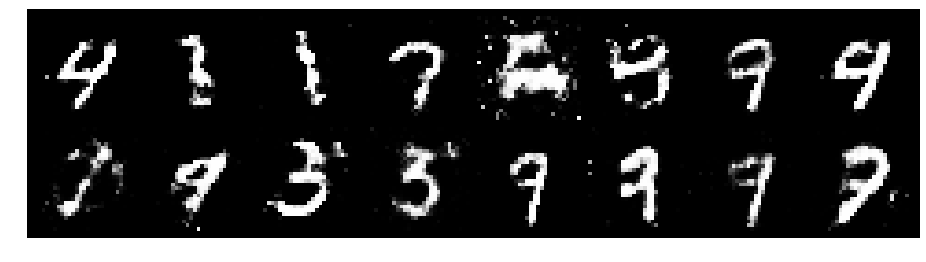

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.2150, Generator Loss: 0.9162
D(x): 0.5737, D(G(z)): 0.4320


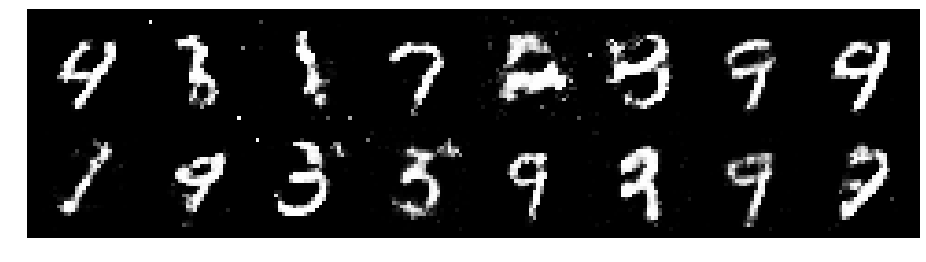

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.1287, Generator Loss: 1.0298
D(x): 0.6090, D(G(z)): 0.4071


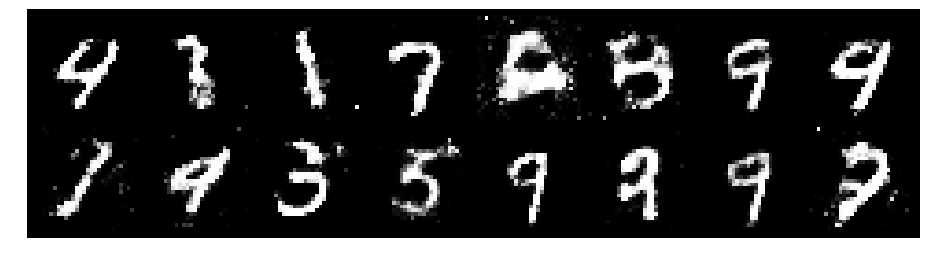

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.3042, Generator Loss: 0.9021
D(x): 0.6373, D(G(z)): 0.4909


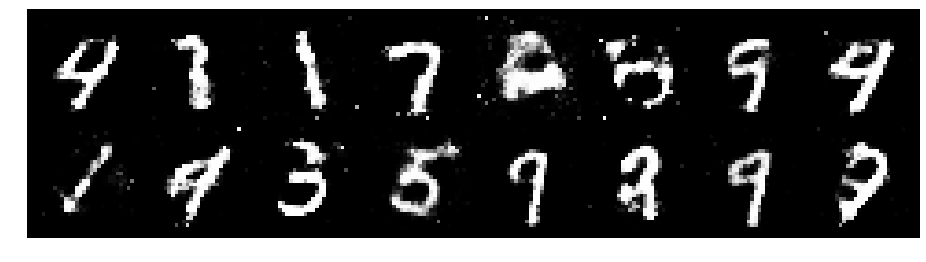

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.4007, Generator Loss: 0.9899
D(x): 0.5988, D(G(z)): 0.4898


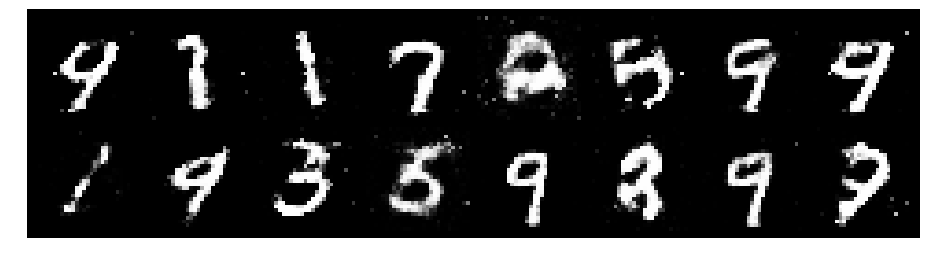

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1424, Generator Loss: 1.5272
D(x): 0.5884, D(G(z)): 0.3351


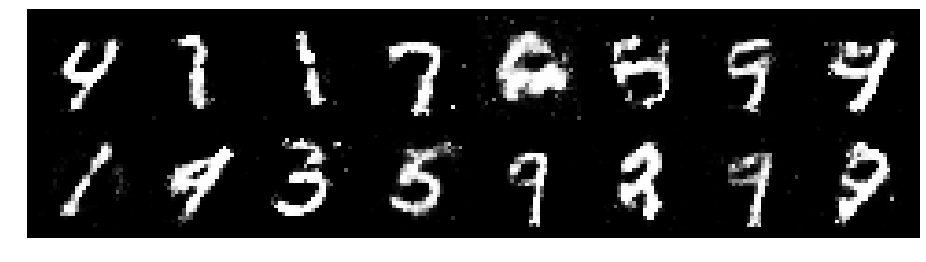

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.3786, Generator Loss: 1.0037
D(x): 0.5604, D(G(z)): 0.4200


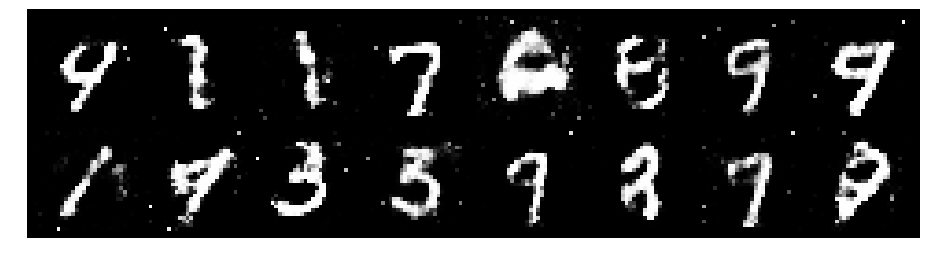

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2279, Generator Loss: 1.1091
D(x): 0.5935, D(G(z)): 0.4410


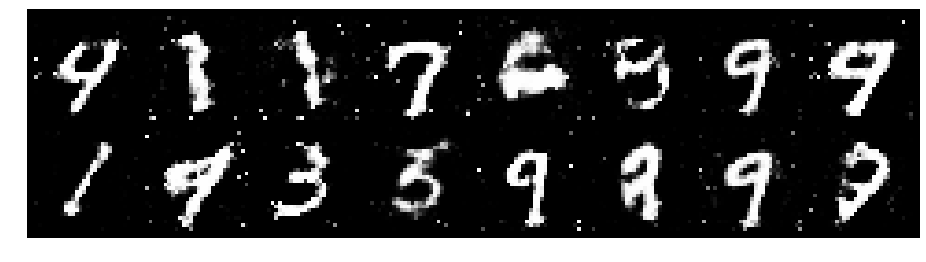

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.2596, Generator Loss: 0.9636
D(x): 0.5779, D(G(z)): 0.4498


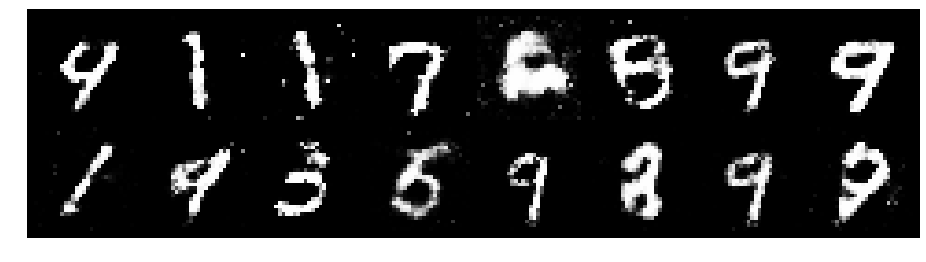

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2045, Generator Loss: 0.9966
D(x): 0.6103, D(G(z)): 0.4415


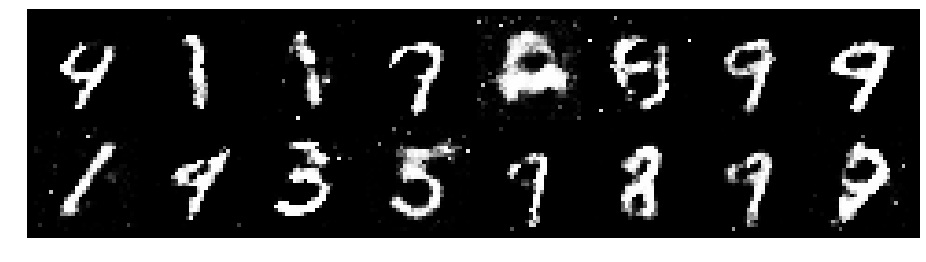

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1472, Generator Loss: 1.5028
D(x): 0.5855, D(G(z)): 0.3424


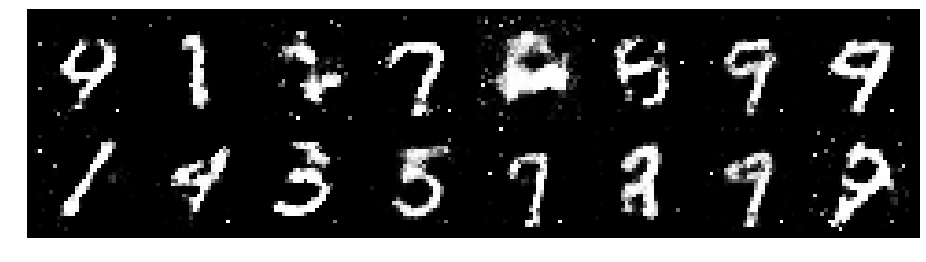

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.0842, Generator Loss: 1.0867
D(x): 0.6032, D(G(z)): 0.3675


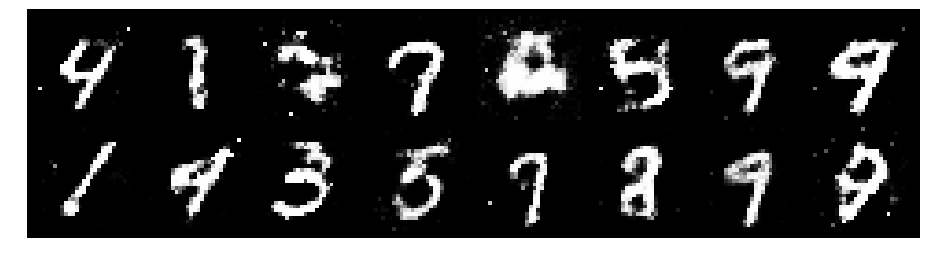

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2083, Generator Loss: 1.0028
D(x): 0.5806, D(G(z)): 0.3895


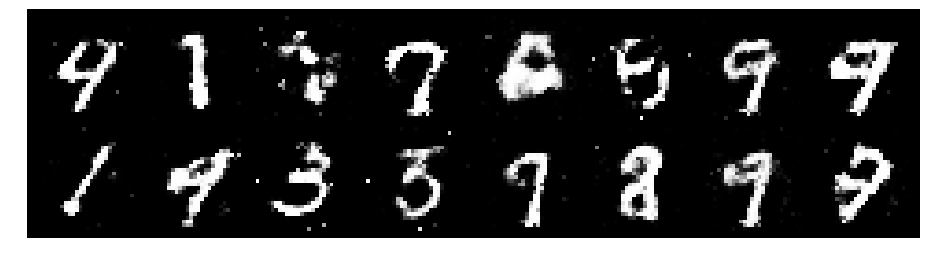

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2032, Generator Loss: 1.0003
D(x): 0.6323, D(G(z)): 0.4636


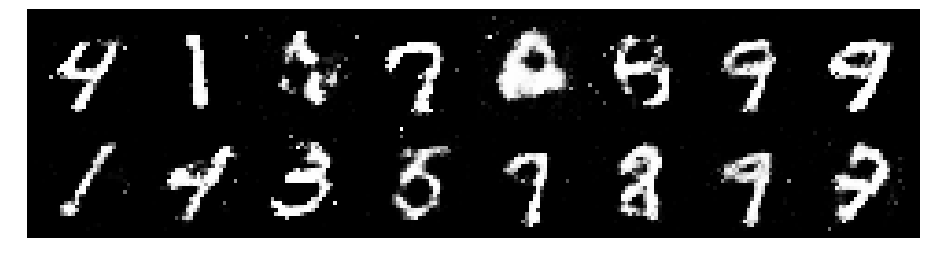

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1020, Generator Loss: 1.0611
D(x): 0.6740, D(G(z)): 0.4420


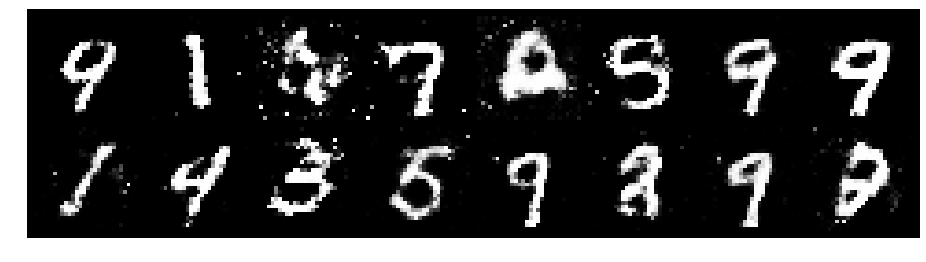

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1226, Generator Loss: 1.3955
D(x): 0.6060, D(G(z)): 0.3750


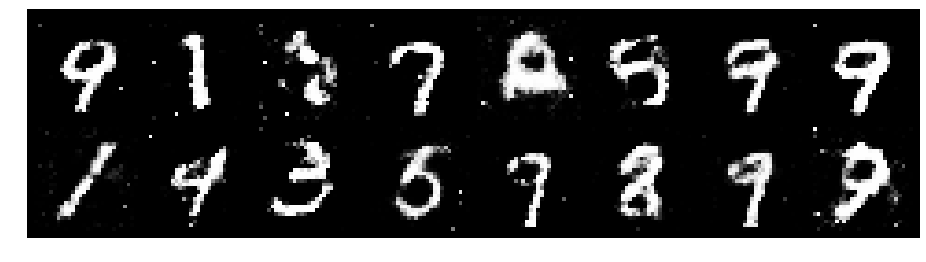

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.1670, Generator Loss: 1.0118
D(x): 0.6099, D(G(z)): 0.4111


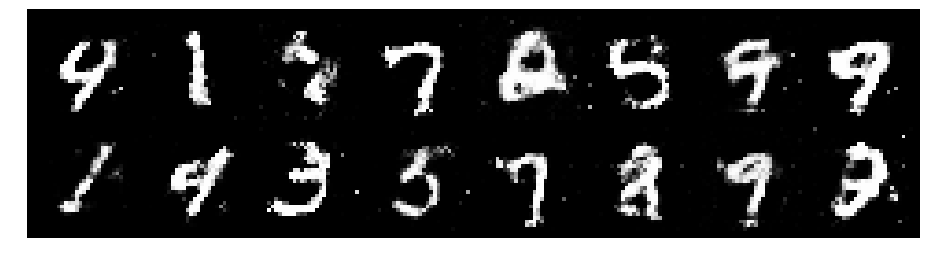

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2122, Generator Loss: 0.8519
D(x): 0.5902, D(G(z)): 0.4503


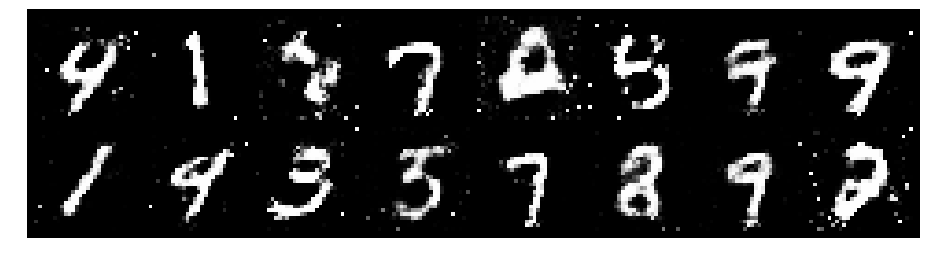

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1480, Generator Loss: 0.9935
D(x): 0.6004, D(G(z)): 0.4227


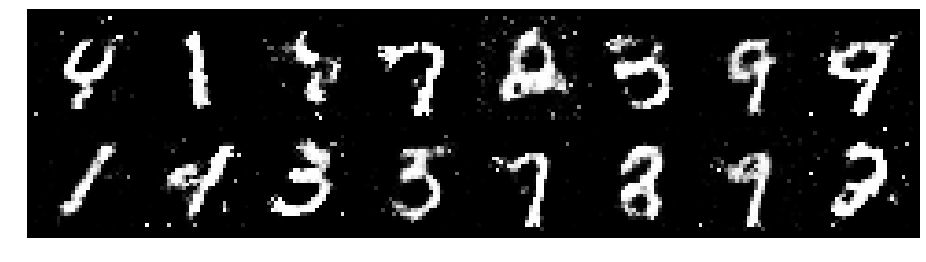

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1271, Generator Loss: 0.9880
D(x): 0.6111, D(G(z)): 0.3984


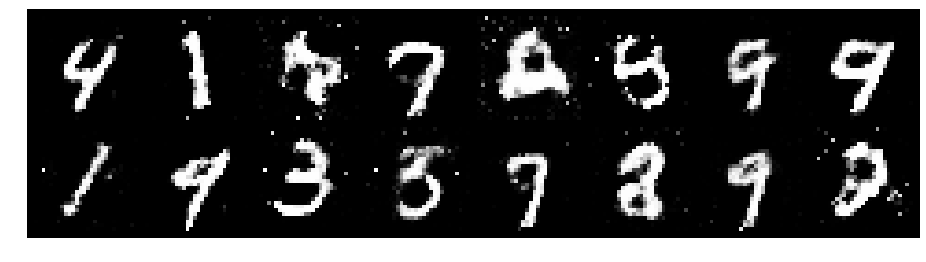

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2865, Generator Loss: 0.9265
D(x): 0.5489, D(G(z)): 0.4020


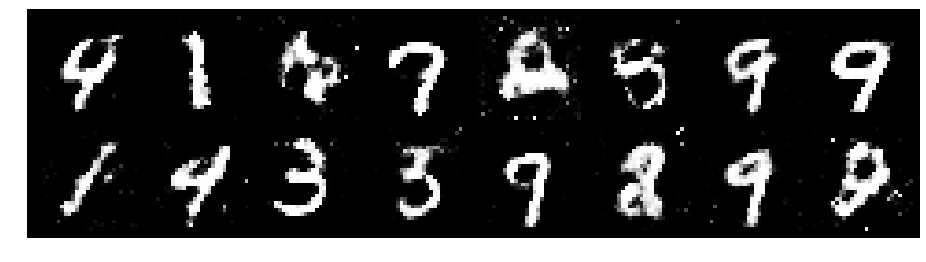

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.3830, Generator Loss: 1.0157
D(x): 0.5968, D(G(z)): 0.4542


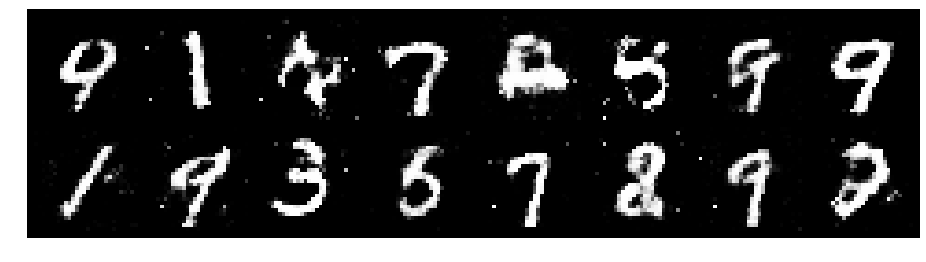

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.2365, Generator Loss: 0.9854
D(x): 0.5757, D(G(z)): 0.4150


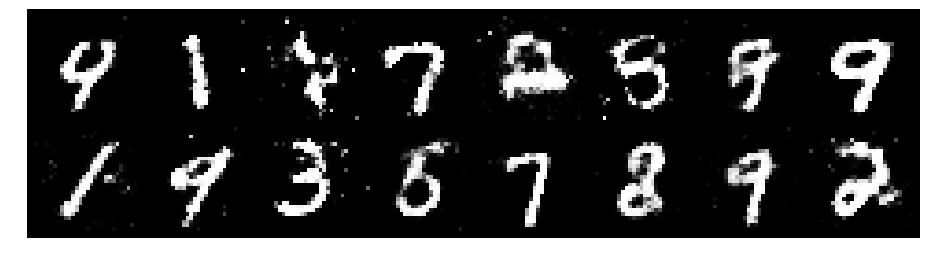

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.1993, Generator Loss: 1.1384
D(x): 0.5465, D(G(z)): 0.3805


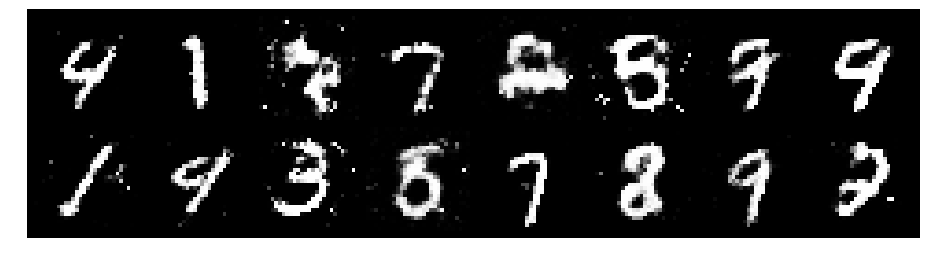

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.0584, Generator Loss: 1.0164
D(x): 0.6162, D(G(z)): 0.3926


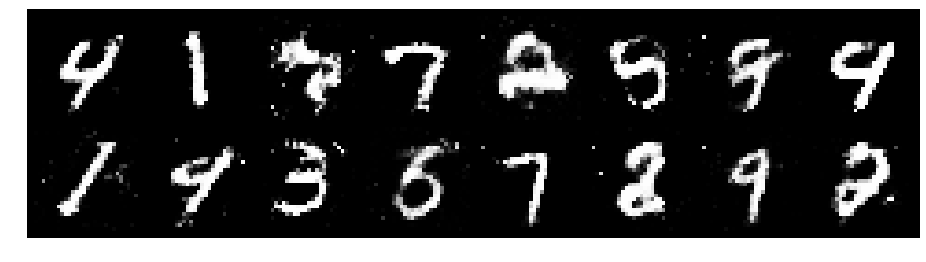

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.0907, Generator Loss: 1.0234
D(x): 0.6411, D(G(z)): 0.4248


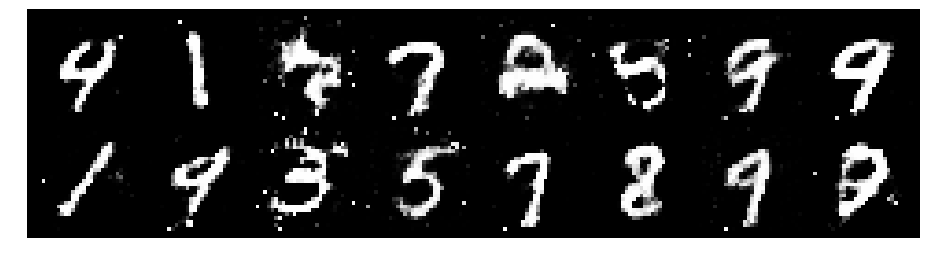

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2384, Generator Loss: 0.9401
D(x): 0.5846, D(G(z)): 0.4111


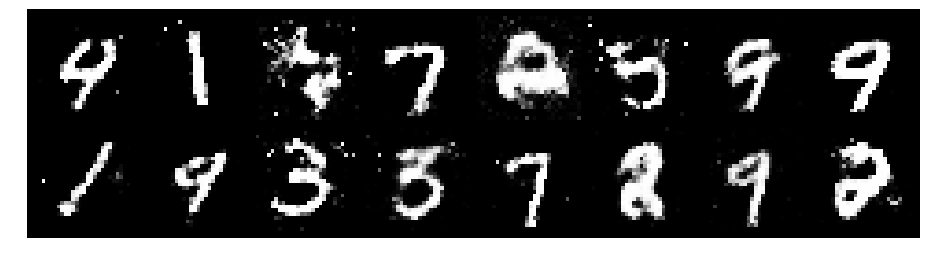

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1884, Generator Loss: 1.0221
D(x): 0.5537, D(G(z)): 0.3740


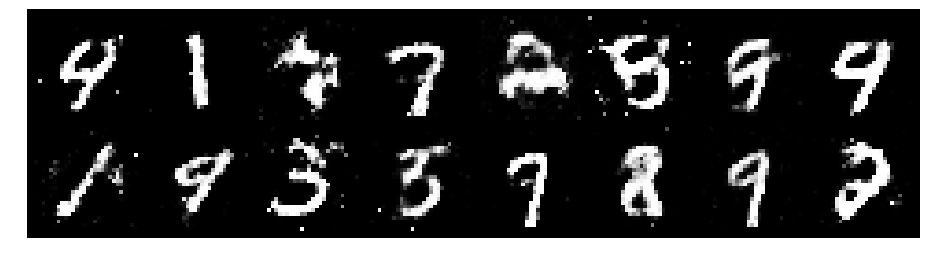

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.3600, Generator Loss: 1.0080
D(x): 0.5394, D(G(z)): 0.4283


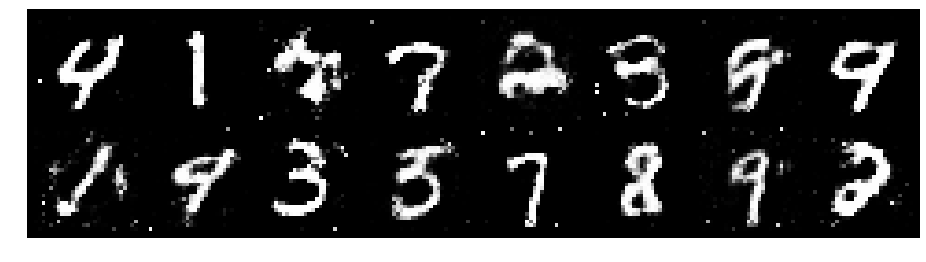

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.3181, Generator Loss: 1.1899
D(x): 0.6028, D(G(z)): 0.4285


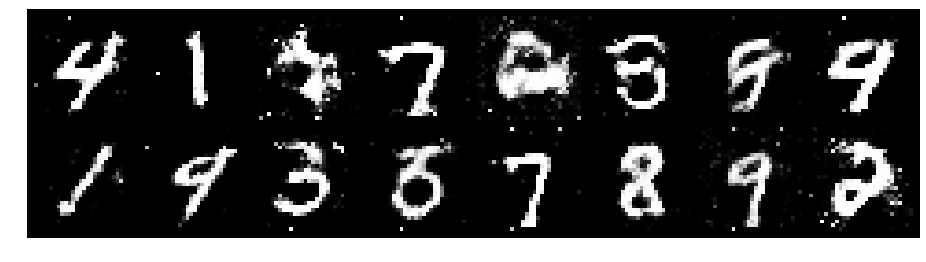

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1065, Generator Loss: 1.2238
D(x): 0.5984, D(G(z)): 0.3596


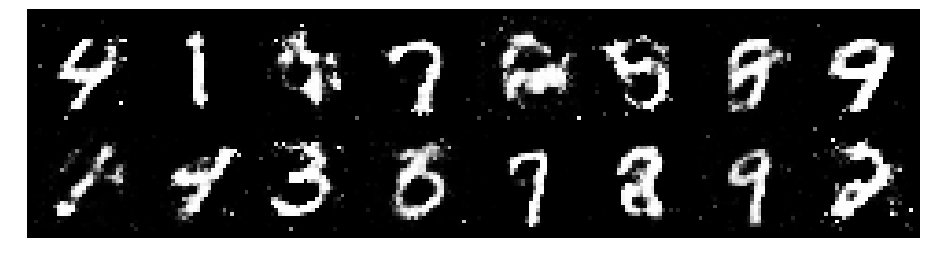

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2320, Generator Loss: 1.0691
D(x): 0.6590, D(G(z)): 0.4373


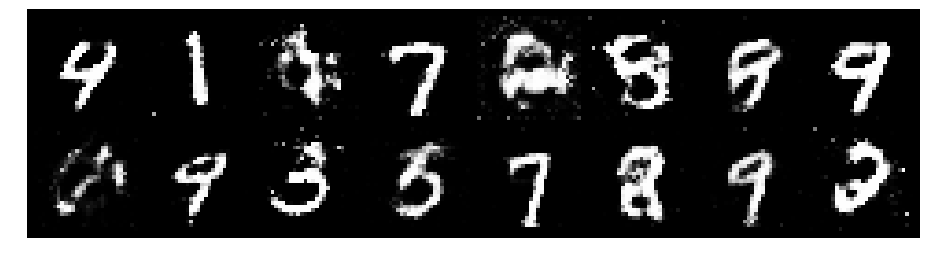

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1738, Generator Loss: 0.9434
D(x): 0.5821, D(G(z)): 0.4102


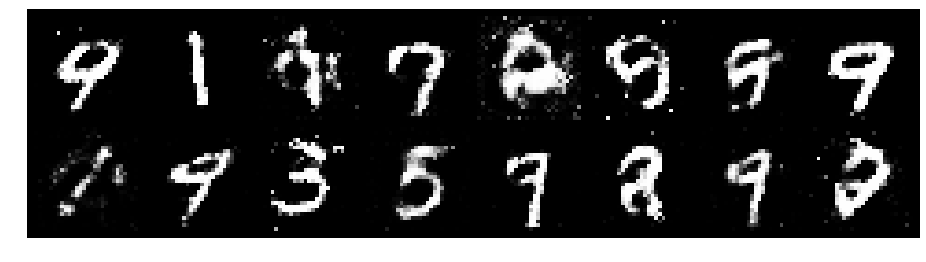

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2535, Generator Loss: 0.7636
D(x): 0.5929, D(G(z)): 0.4881


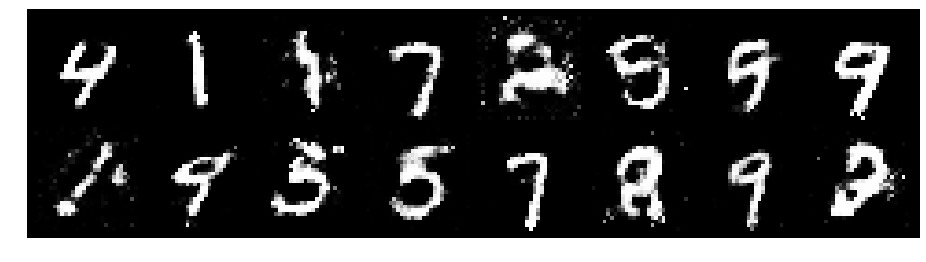

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2948, Generator Loss: 0.9851
D(x): 0.5653, D(G(z)): 0.4458


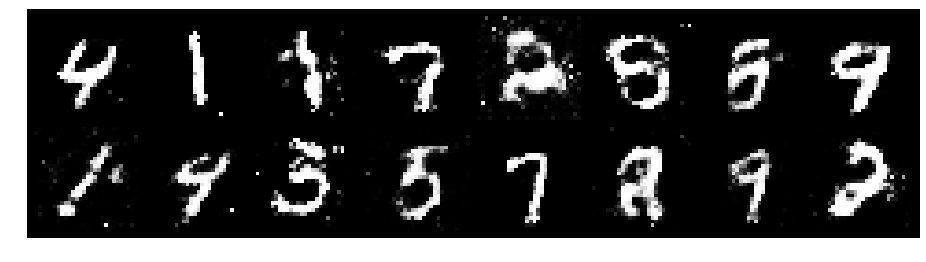

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2104, Generator Loss: 0.9021
D(x): 0.6048, D(G(z)): 0.4481


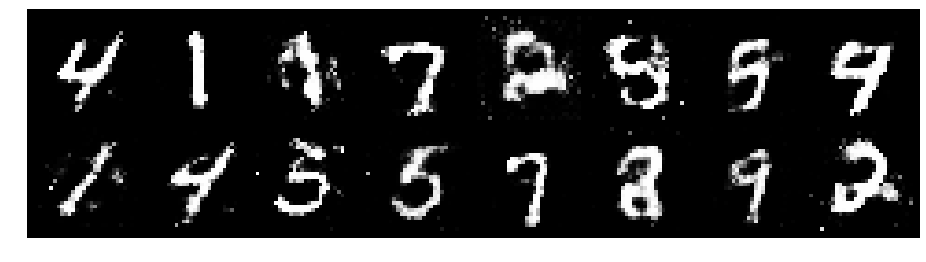

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2991, Generator Loss: 1.1695
D(x): 0.5799, D(G(z)): 0.4300


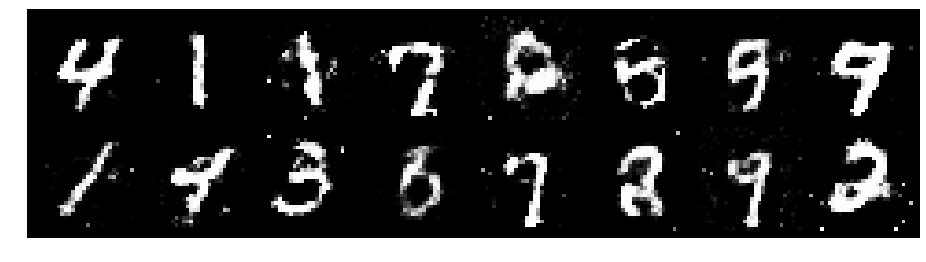

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.2138, Generator Loss: 0.8991
D(x): 0.5919, D(G(z)): 0.4131


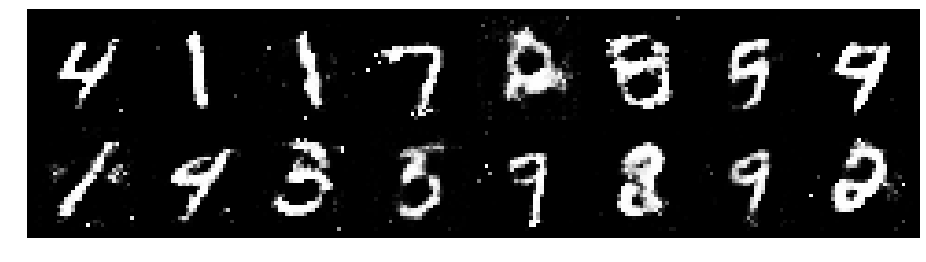

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.1905, Generator Loss: 1.1761
D(x): 0.5543, D(G(z)): 0.3746


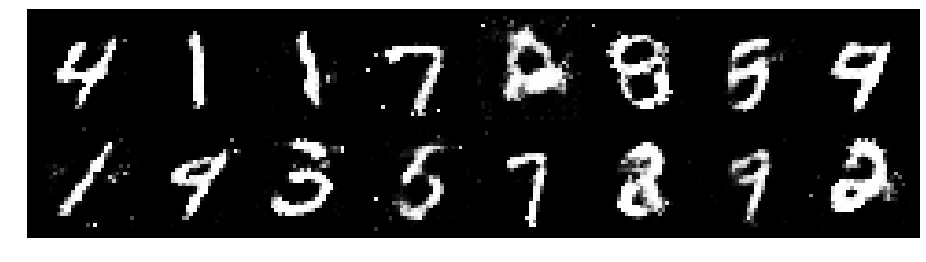

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.1694, Generator Loss: 1.0779
D(x): 0.6501, D(G(z)): 0.4191


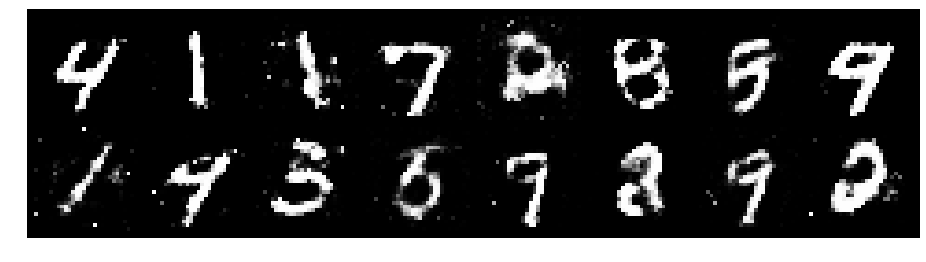

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1323, Generator Loss: 1.1305
D(x): 0.5975, D(G(z)): 0.3848


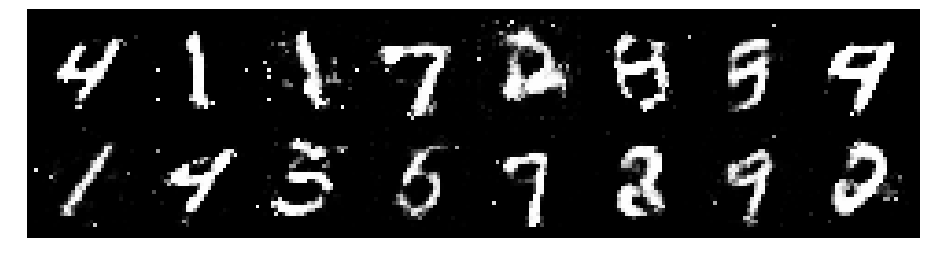

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1000, Generator Loss: 1.1870
D(x): 0.6337, D(G(z)): 0.3876


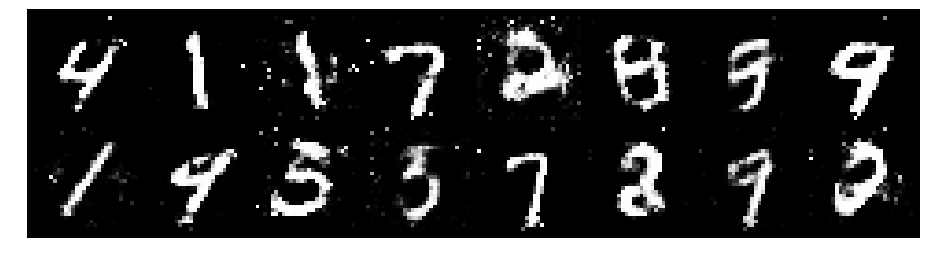

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1016, Generator Loss: 1.1628
D(x): 0.6136, D(G(z)): 0.3664


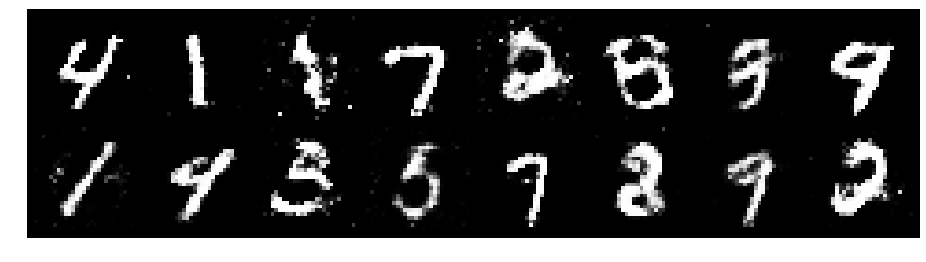

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1984, Generator Loss: 0.9977
D(x): 0.5492, D(G(z)): 0.3831


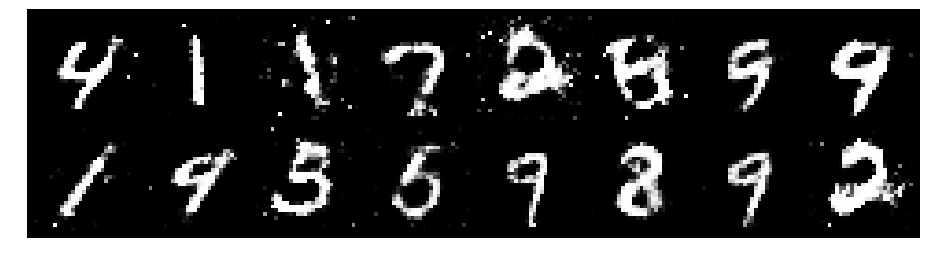

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.3405, Generator Loss: 0.9347
D(x): 0.5462, D(G(z)): 0.4590


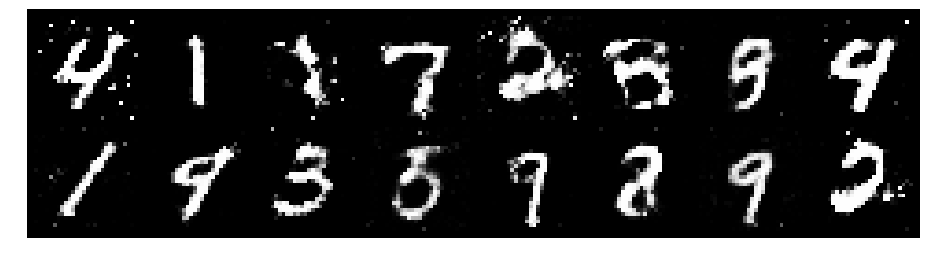

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1754, Generator Loss: 0.8834
D(x): 0.6265, D(G(z)): 0.4533


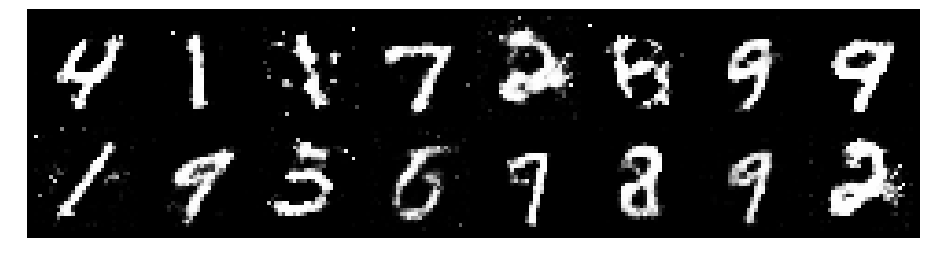

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.2953, Generator Loss: 1.0098
D(x): 0.5129, D(G(z)): 0.3910


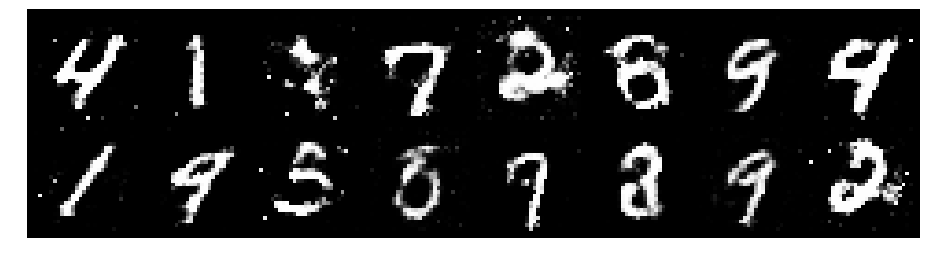

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.2866, Generator Loss: 1.0575
D(x): 0.6175, D(G(z)): 0.4748


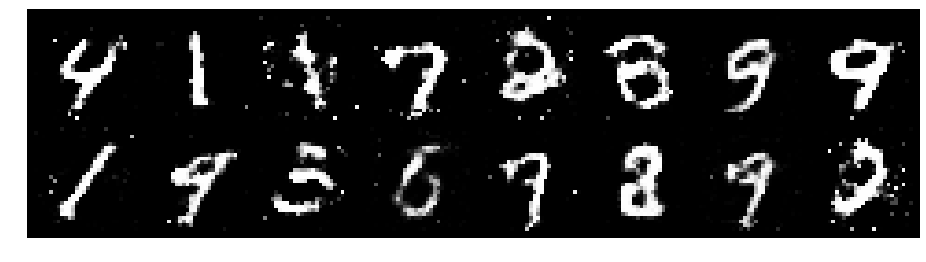

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1648, Generator Loss: 1.1014
D(x): 0.5802, D(G(z)): 0.3848


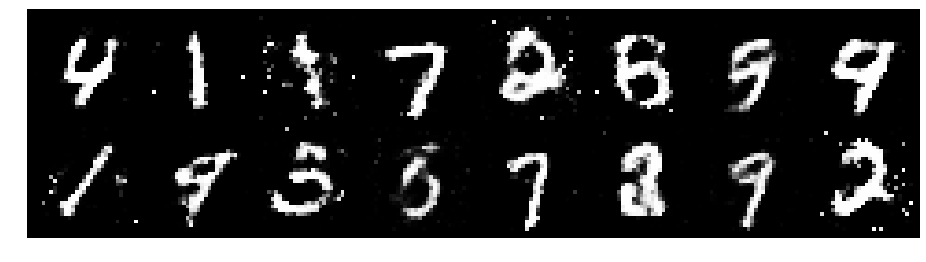

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1805, Generator Loss: 1.2831
D(x): 0.6332, D(G(z)): 0.4160


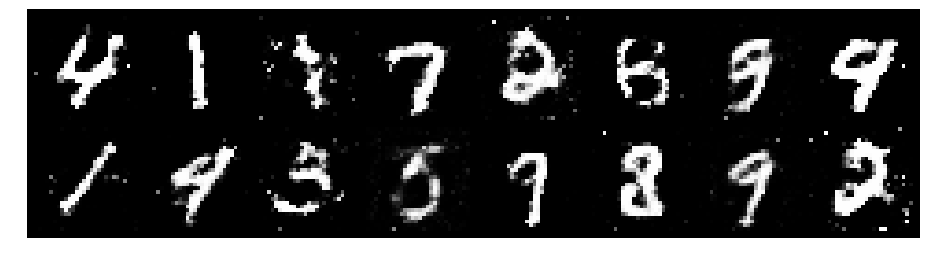

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1130, Generator Loss: 0.9184
D(x): 0.6688, D(G(z)): 0.4432


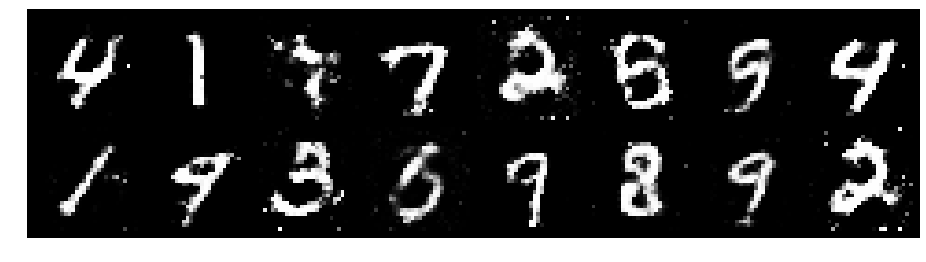

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1320, Generator Loss: 0.9321
D(x): 0.6319, D(G(z)): 0.4264


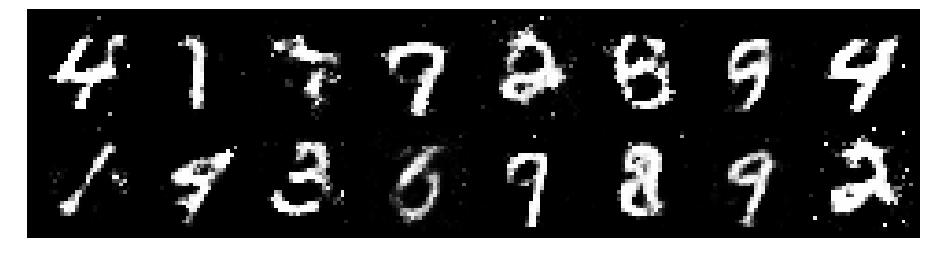

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.0744, Generator Loss: 1.0705
D(x): 0.6364, D(G(z)): 0.3999


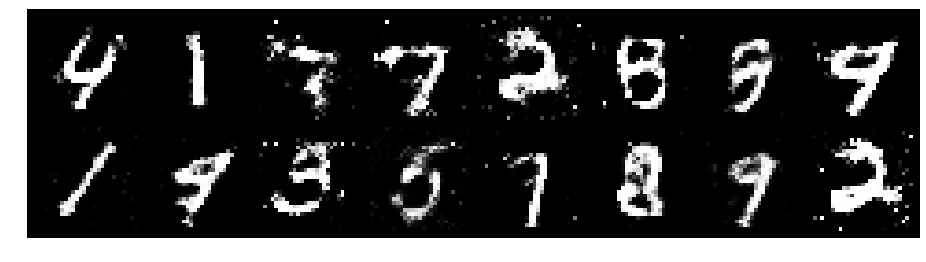

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2158, Generator Loss: 0.8214
D(x): 0.5621, D(G(z)): 0.4431


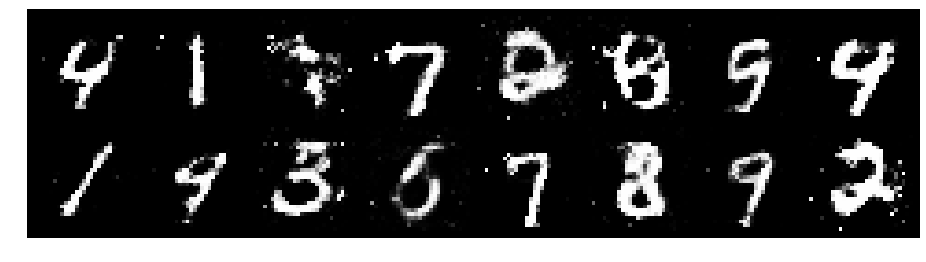

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2567, Generator Loss: 0.9772
D(x): 0.5285, D(G(z)): 0.4188


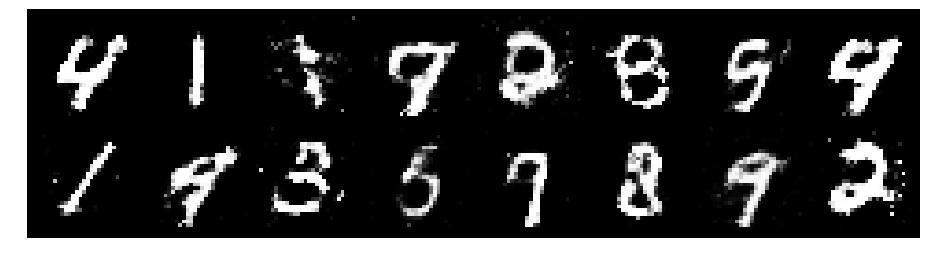

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.3358, Generator Loss: 0.8787
D(x): 0.5632, D(G(z)): 0.4712


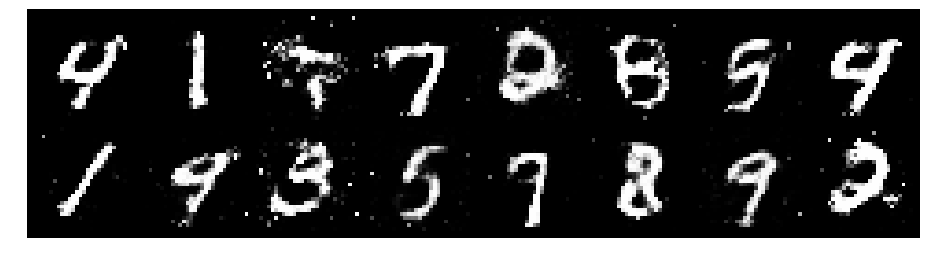

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2235, Generator Loss: 0.9808
D(x): 0.5761, D(G(z)): 0.4375


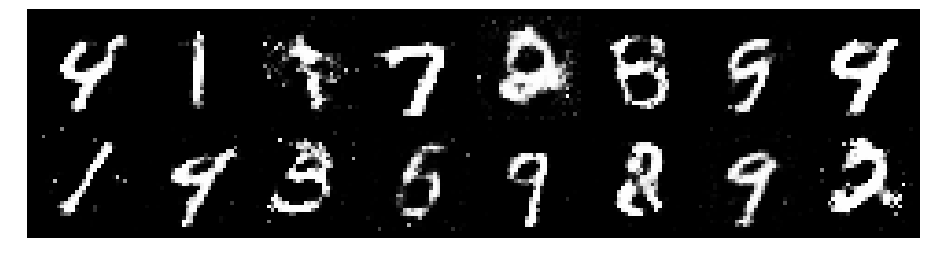

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.1031, Generator Loss: 1.1365
D(x): 0.5946, D(G(z)): 0.3666


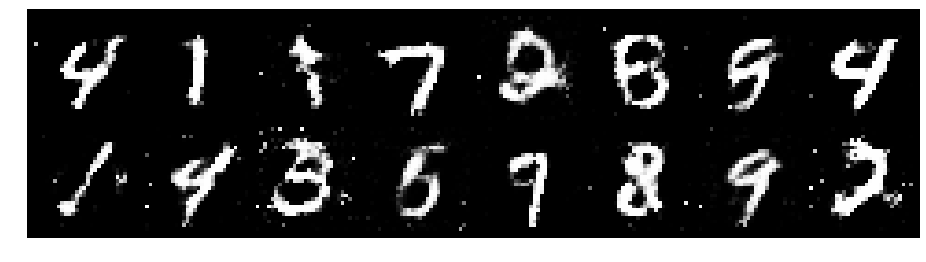

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.0893, Generator Loss: 1.0057
D(x): 0.6205, D(G(z)): 0.3835


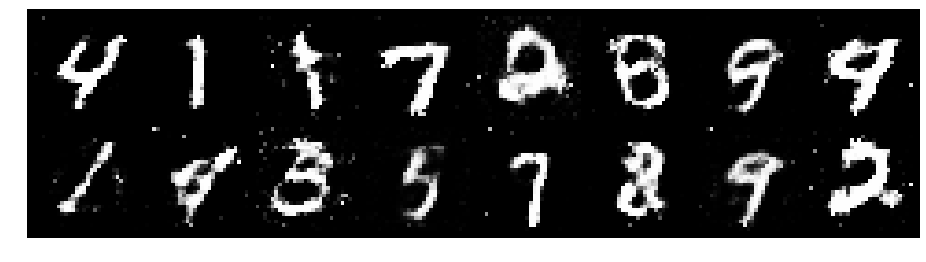

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2527, Generator Loss: 0.9827
D(x): 0.6376, D(G(z)): 0.4544


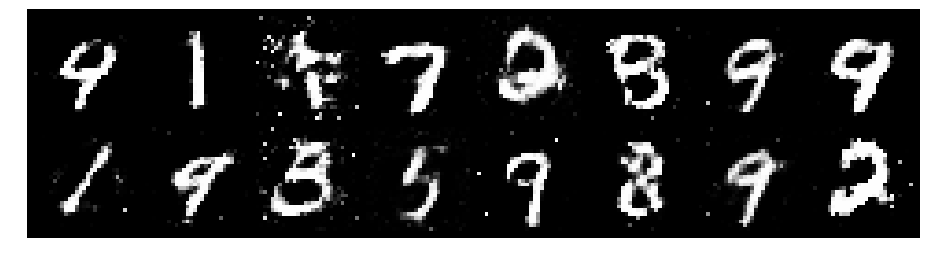

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1412, Generator Loss: 1.3018
D(x): 0.6559, D(G(z)): 0.4236


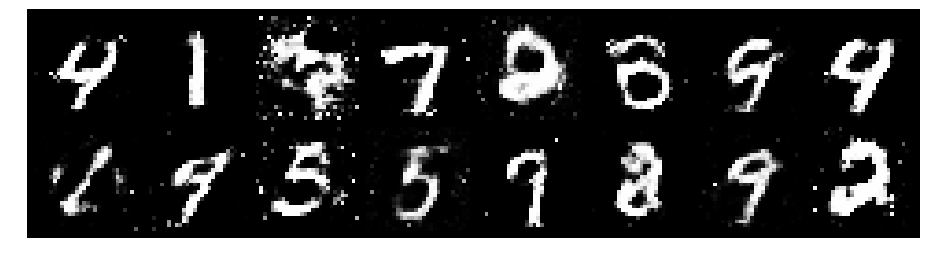

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2549, Generator Loss: 1.1041
D(x): 0.5669, D(G(z)): 0.4123


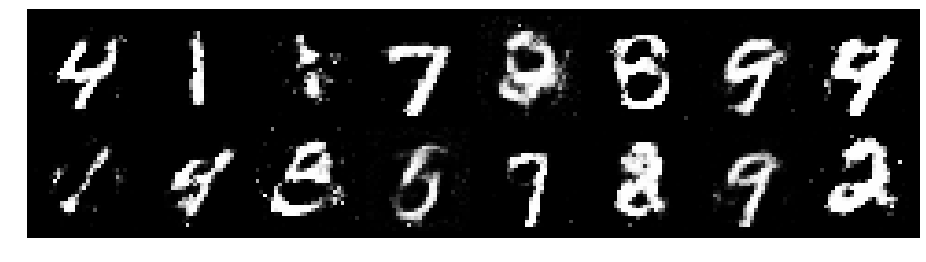

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1237, Generator Loss: 1.0894
D(x): 0.6214, D(G(z)): 0.3916


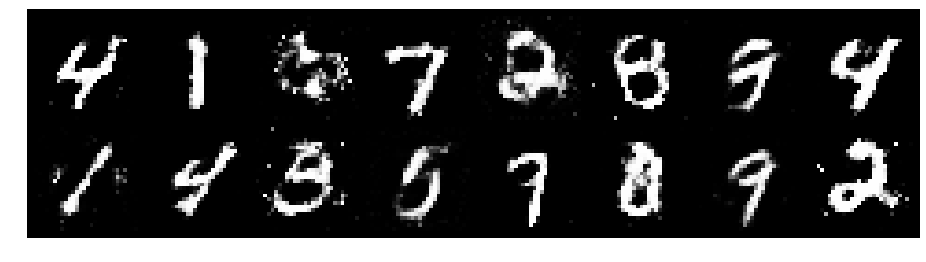

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2254, Generator Loss: 0.9783
D(x): 0.6115, D(G(z)): 0.4395


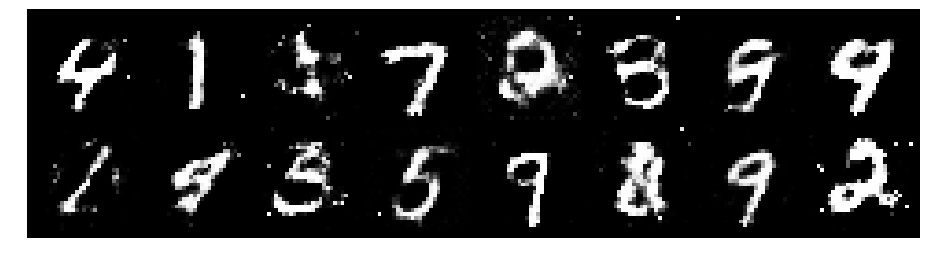

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.1577, Generator Loss: 1.0892
D(x): 0.5965, D(G(z)): 0.3782


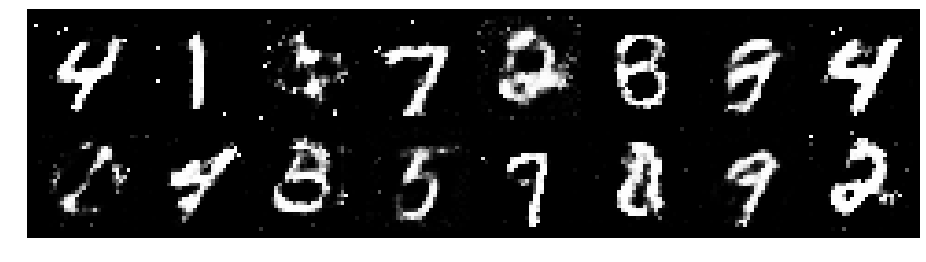

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.1013, Generator Loss: 1.2435
D(x): 0.5815, D(G(z)): 0.3563


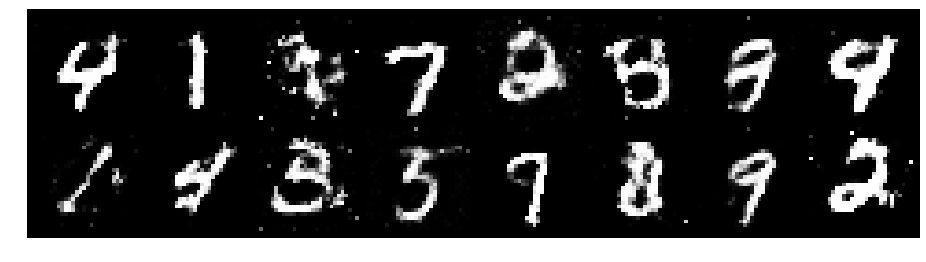

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.0706, Generator Loss: 1.1328
D(x): 0.6420, D(G(z)): 0.3918


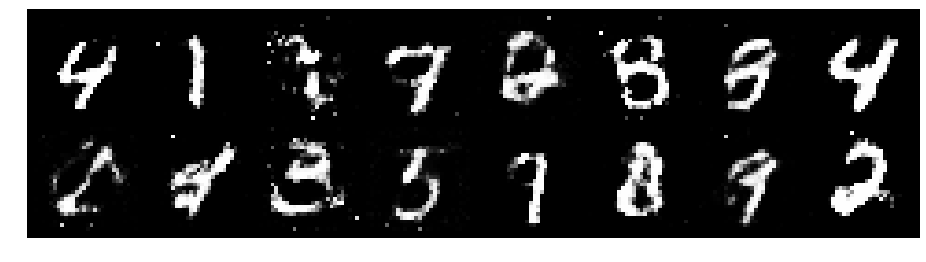

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1925, Generator Loss: 0.9343
D(x): 0.5772, D(G(z)): 0.4232


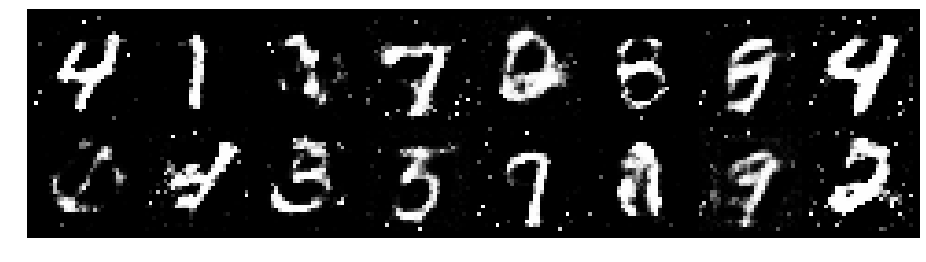

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.3167, Generator Loss: 0.8835
D(x): 0.6236, D(G(z)): 0.4830


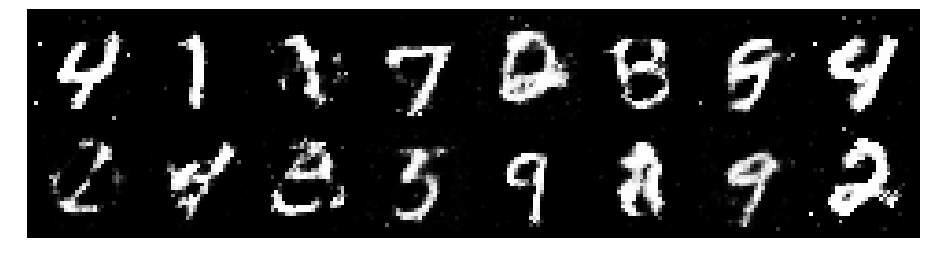

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.3282, Generator Loss: 0.7859
D(x): 0.5431, D(G(z)): 0.4698


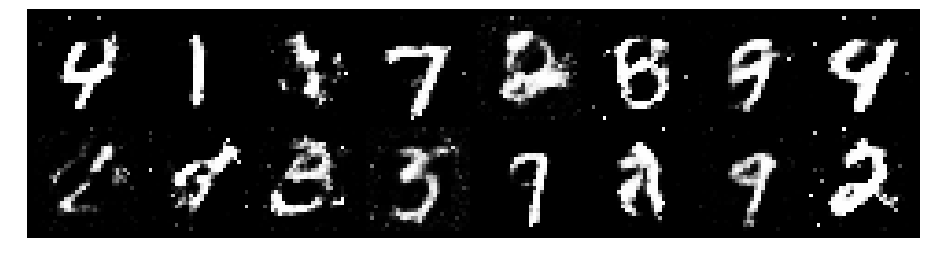

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.3162, Generator Loss: 0.8258
D(x): 0.5957, D(G(z)): 0.4791


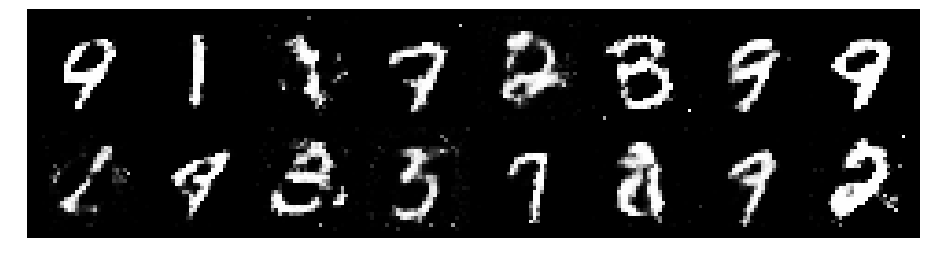

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2729, Generator Loss: 0.9733
D(x): 0.5786, D(G(z)): 0.4436


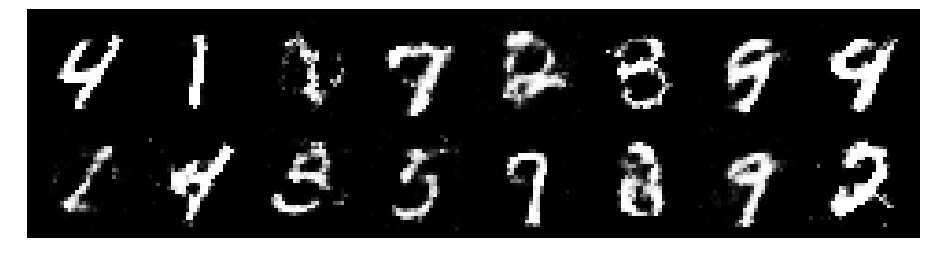

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.0540, Generator Loss: 1.2462
D(x): 0.5891, D(G(z)): 0.3480


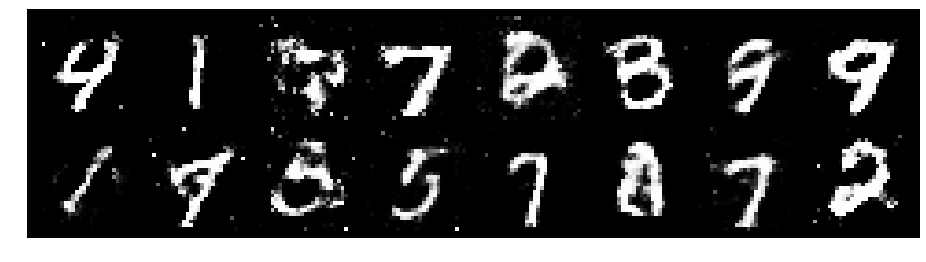

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.0853, Generator Loss: 1.0141
D(x): 0.6181, D(G(z)): 0.3999


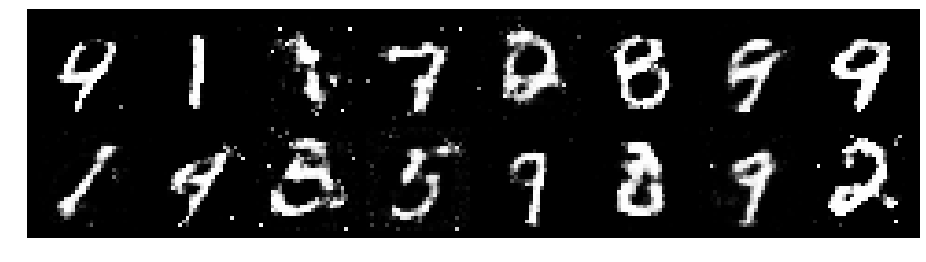

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.3780, Generator Loss: 0.8792
D(x): 0.5429, D(G(z)): 0.4376


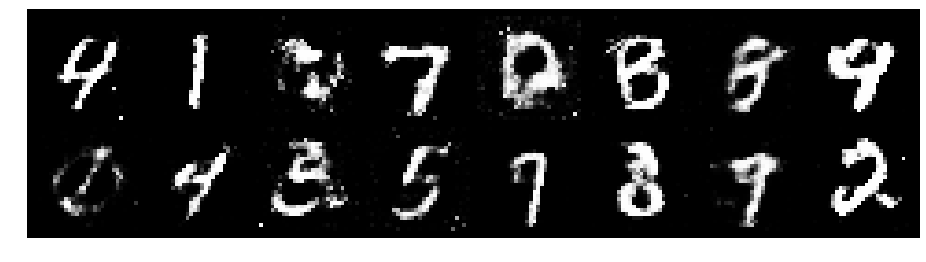

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2206, Generator Loss: 0.9072
D(x): 0.5899, D(G(z)): 0.4500


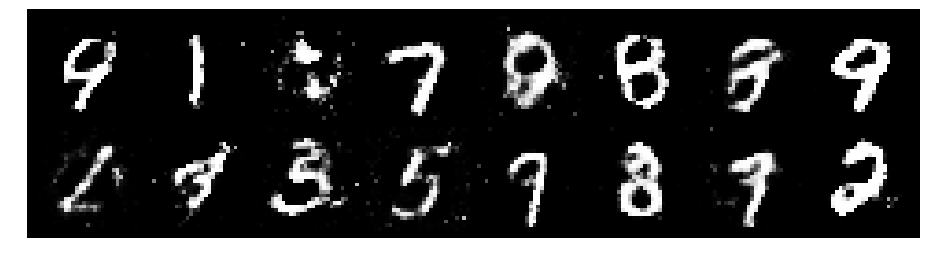

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2358, Generator Loss: 1.0042
D(x): 0.6029, D(G(z)): 0.3910


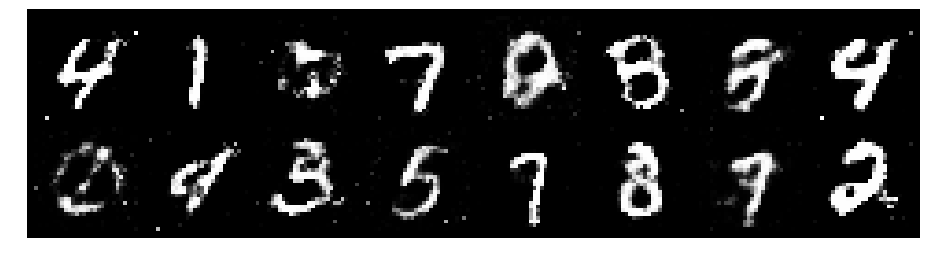

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2734, Generator Loss: 1.0729
D(x): 0.5673, D(G(z)): 0.4266


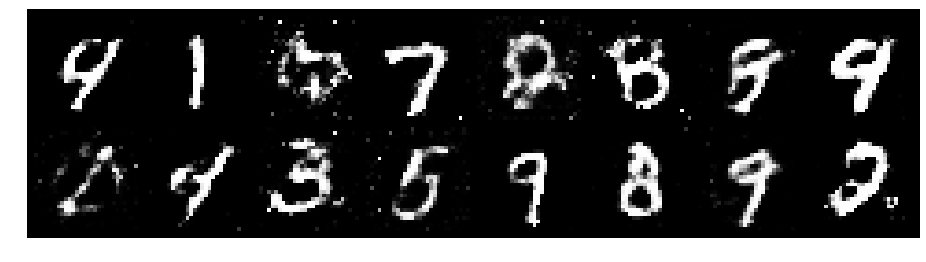

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.3108, Generator Loss: 0.9787
D(x): 0.5697, D(G(z)): 0.4421


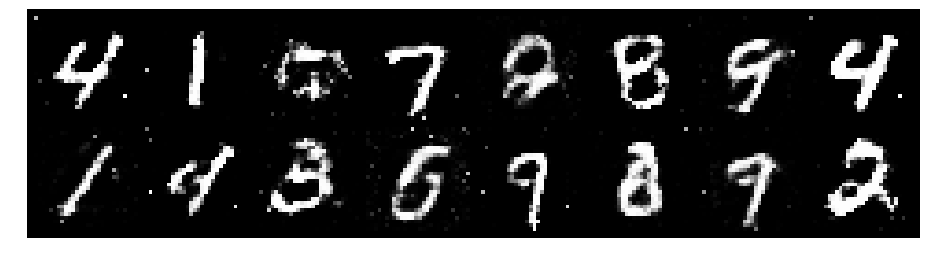

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1699, Generator Loss: 1.1016
D(x): 0.5870, D(G(z)): 0.3928


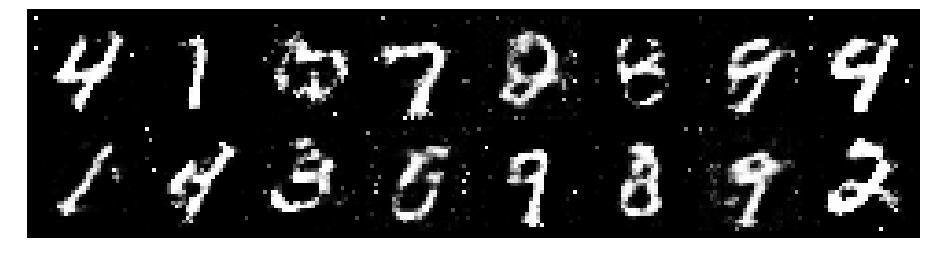

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1118, Generator Loss: 1.0202
D(x): 0.5924, D(G(z)): 0.3891


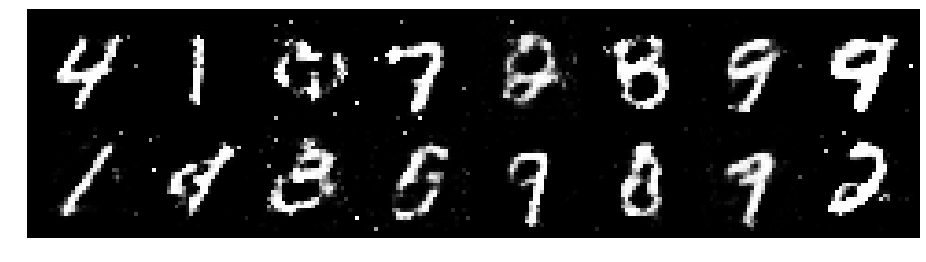

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.3093, Generator Loss: 0.9223
D(x): 0.5662, D(G(z)): 0.4661


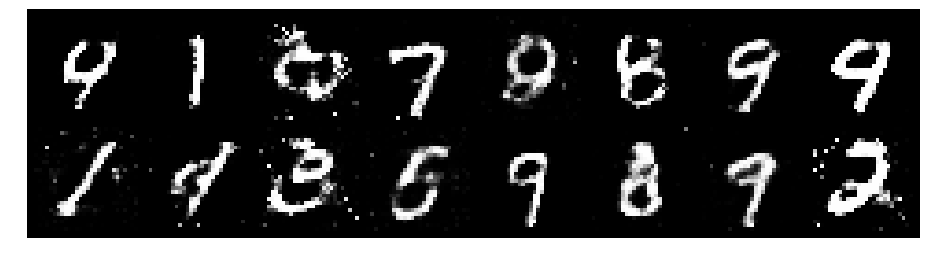

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.4030, Generator Loss: 0.8618
D(x): 0.5417, D(G(z)): 0.4604


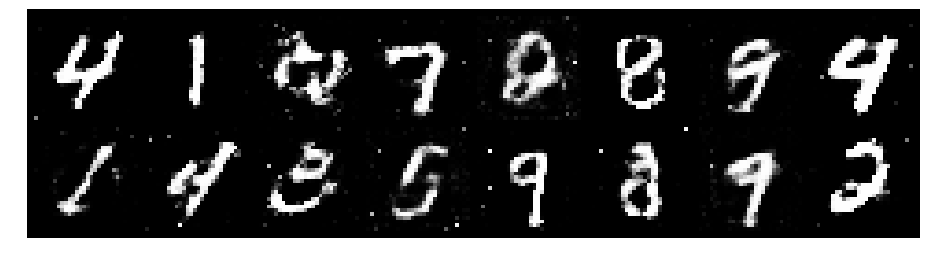

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.4166, Generator Loss: 0.9354
D(x): 0.5773, D(G(z)): 0.4854


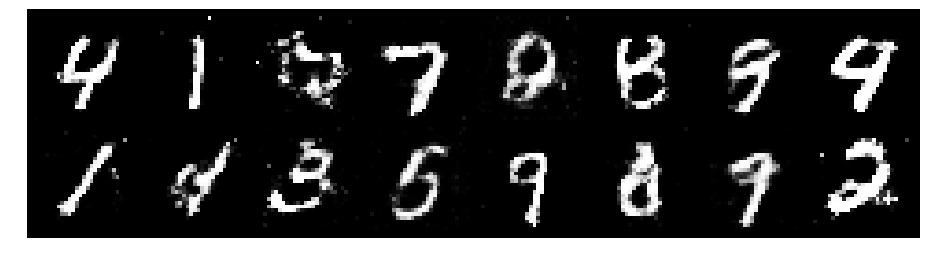

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1717, Generator Loss: 0.9324
D(x): 0.5879, D(G(z)): 0.4079


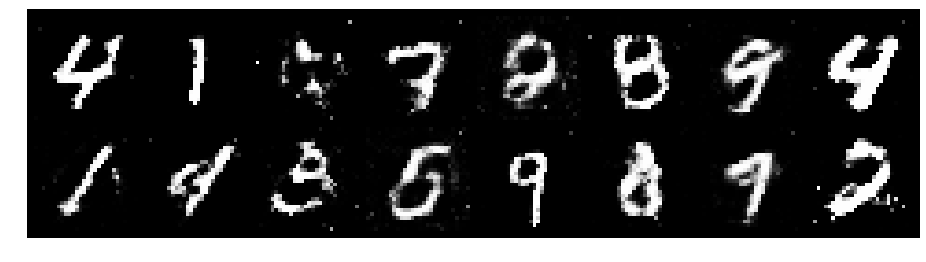

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1509, Generator Loss: 0.9361
D(x): 0.5578, D(G(z)): 0.3923


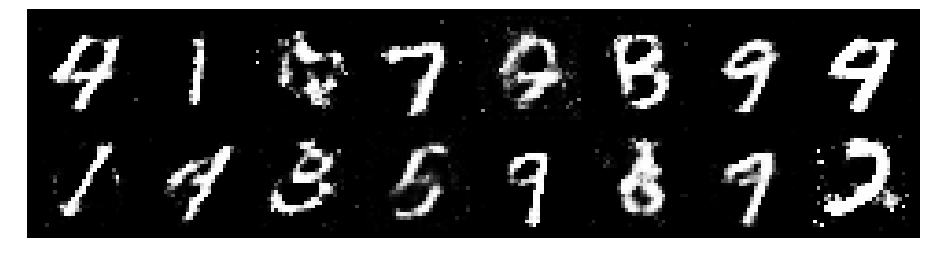

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1669, Generator Loss: 1.0090
D(x): 0.5706, D(G(z)): 0.4105


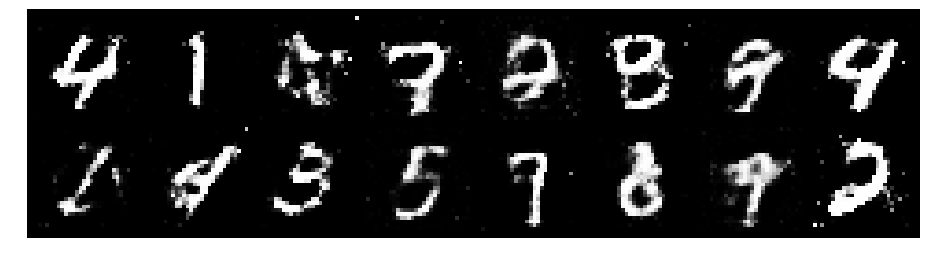

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1247, Generator Loss: 1.0774
D(x): 0.5450, D(G(z)): 0.3411


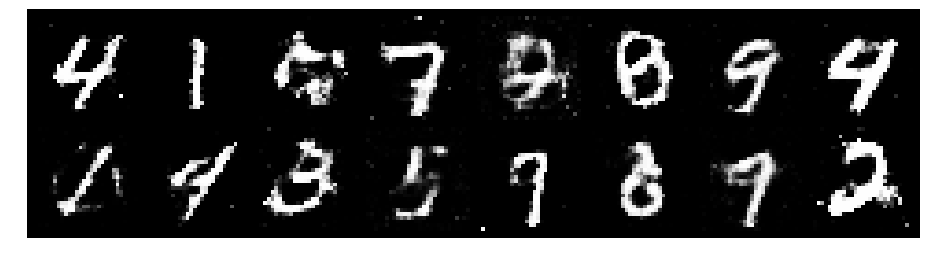

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1039, Generator Loss: 1.2498
D(x): 0.6145, D(G(z)): 0.3711


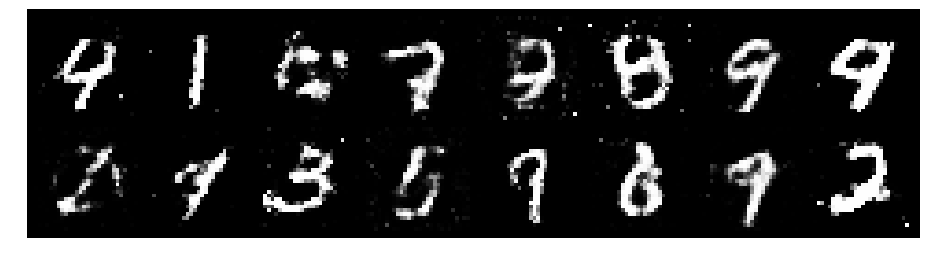

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.1396, Generator Loss: 1.4700
D(x): 0.5798, D(G(z)): 0.3642


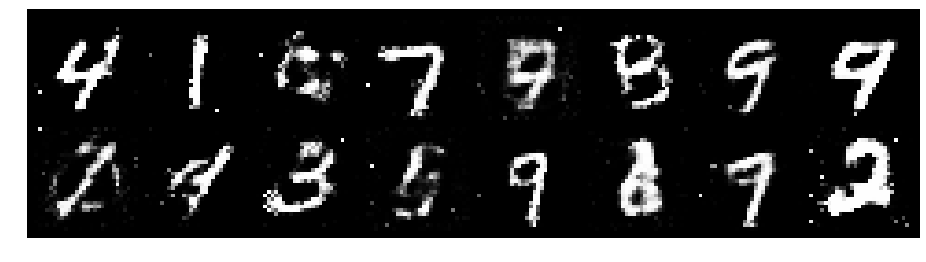

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2686, Generator Loss: 0.9775
D(x): 0.5753, D(G(z)): 0.4368


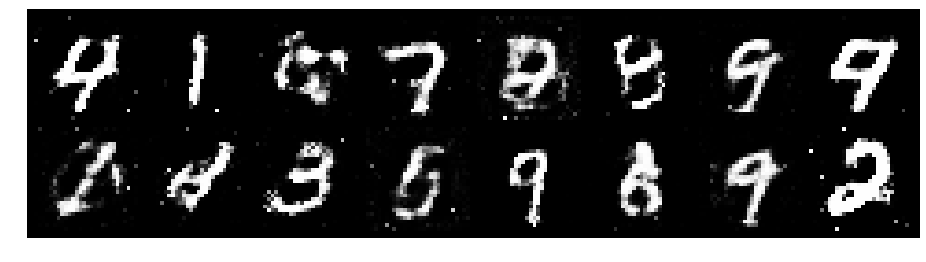

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2664, Generator Loss: 0.9608
D(x): 0.5499, D(G(z)): 0.4331


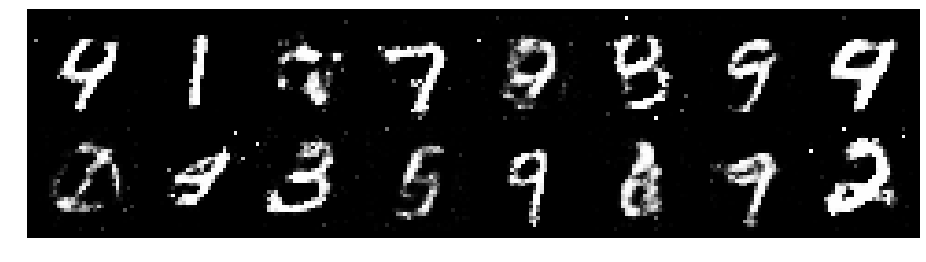

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2587, Generator Loss: 1.0585
D(x): 0.5429, D(G(z)): 0.3924


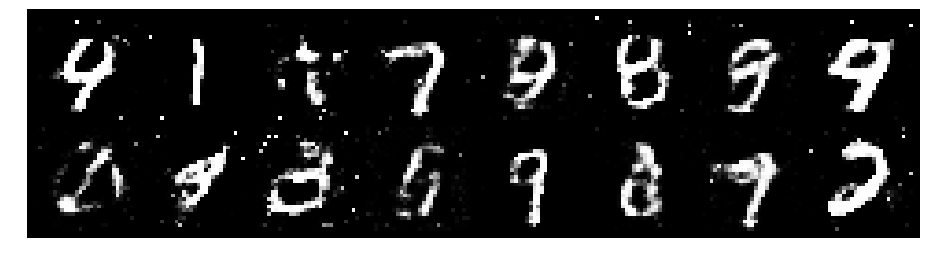

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.3616, Generator Loss: 0.8795
D(x): 0.5952, D(G(z)): 0.4921


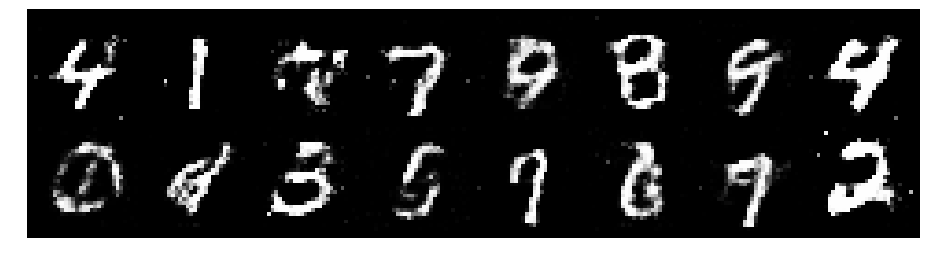

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2869, Generator Loss: 0.9176
D(x): 0.5375, D(G(z)): 0.4038


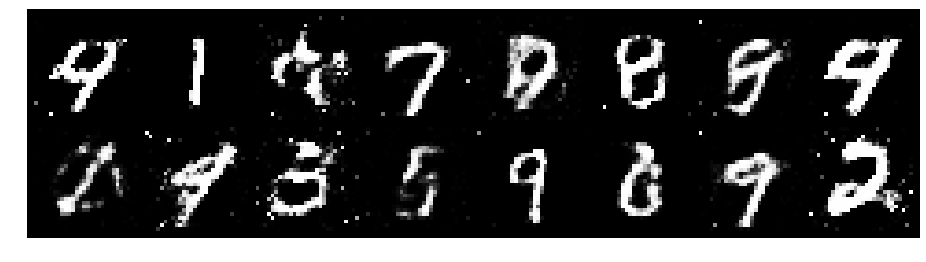

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.3028, Generator Loss: 0.9687
D(x): 0.5507, D(G(z)): 0.4451


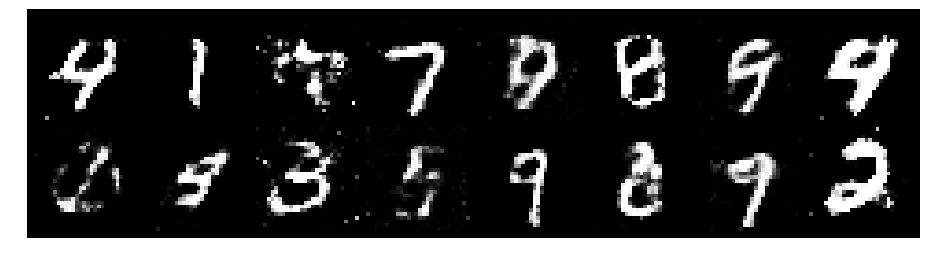

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1592, Generator Loss: 1.1950
D(x): 0.5971, D(G(z)): 0.3764


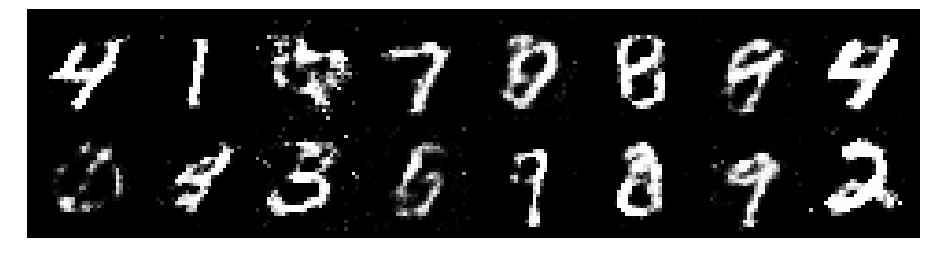

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.3910, Generator Loss: 0.9744
D(x): 0.5666, D(G(z)): 0.4226


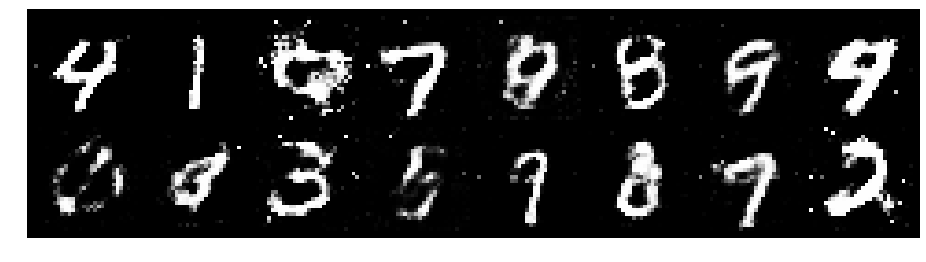

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1260, Generator Loss: 1.1841
D(x): 0.6258, D(G(z)): 0.3978


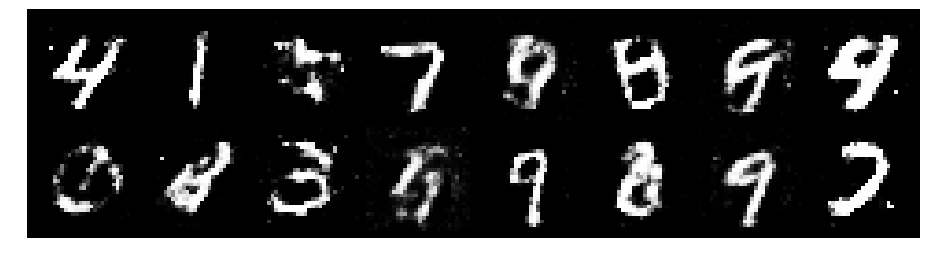

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.0353, Generator Loss: 1.0473
D(x): 0.6532, D(G(z)): 0.3809


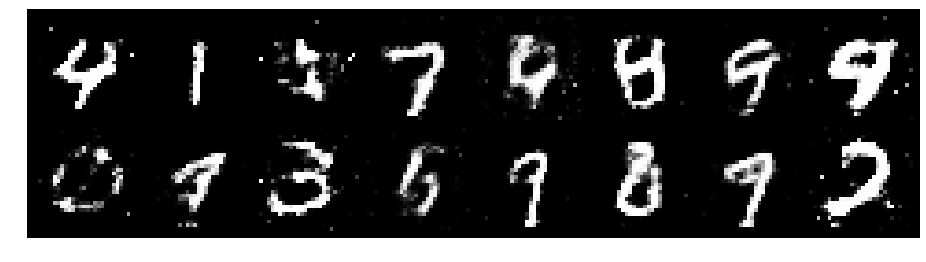

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1403, Generator Loss: 1.0112
D(x): 0.5701, D(G(z)): 0.3663


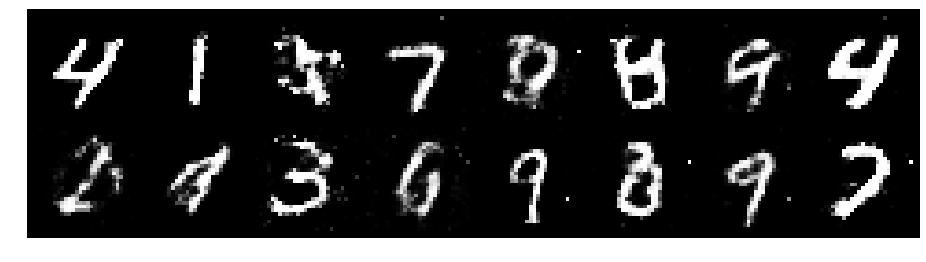

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1571, Generator Loss: 0.9575
D(x): 0.6024, D(G(z)): 0.4295


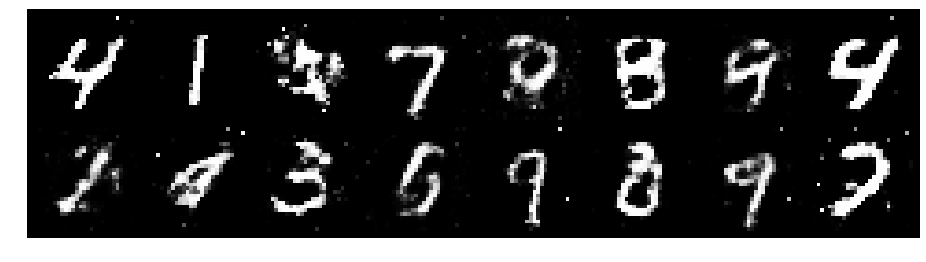

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.1873, Generator Loss: 0.8085
D(x): 0.5945, D(G(z)): 0.4336


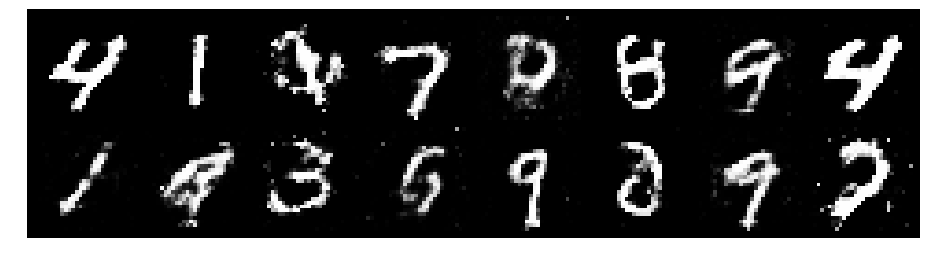

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2590, Generator Loss: 0.8682
D(x): 0.5551, D(G(z)): 0.4405


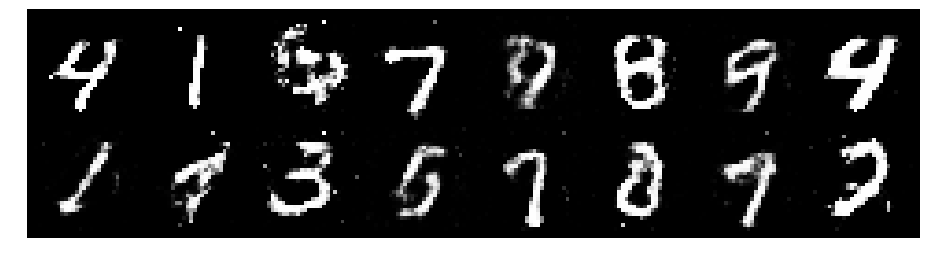

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.3764, Generator Loss: 0.9865
D(x): 0.5253, D(G(z)): 0.4208


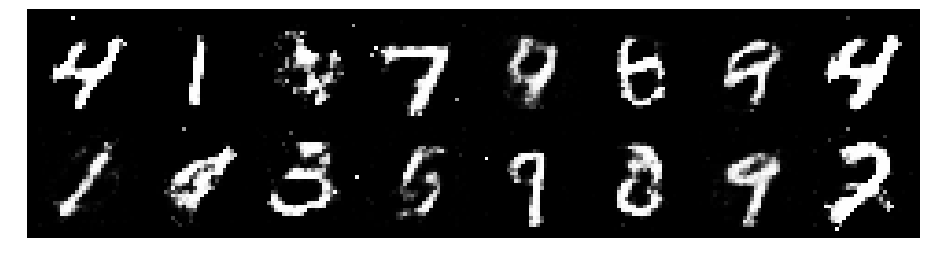

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.2506, Generator Loss: 1.0277
D(x): 0.6071, D(G(z)): 0.4667


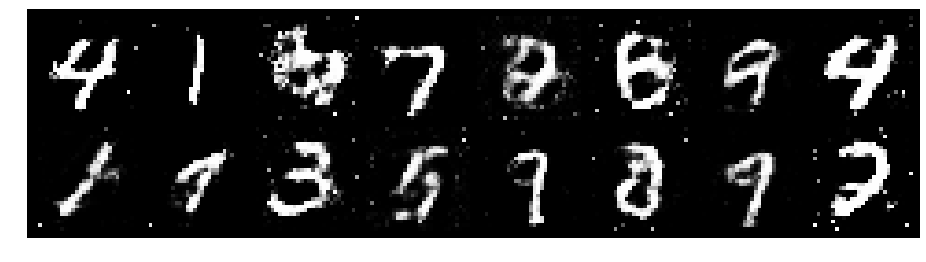

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.2508, Generator Loss: 1.0194
D(x): 0.5446, D(G(z)): 0.4048


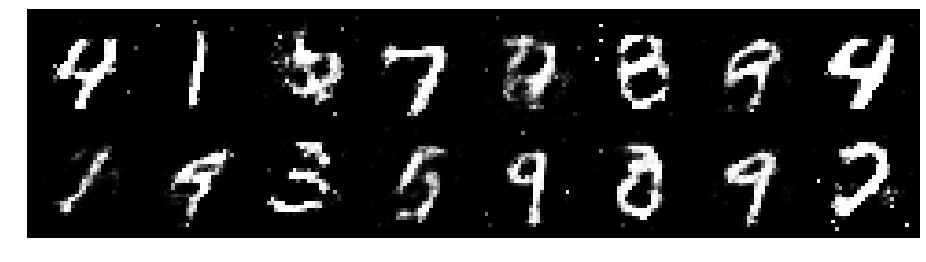

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2985, Generator Loss: 0.9268
D(x): 0.5335, D(G(z)): 0.4166


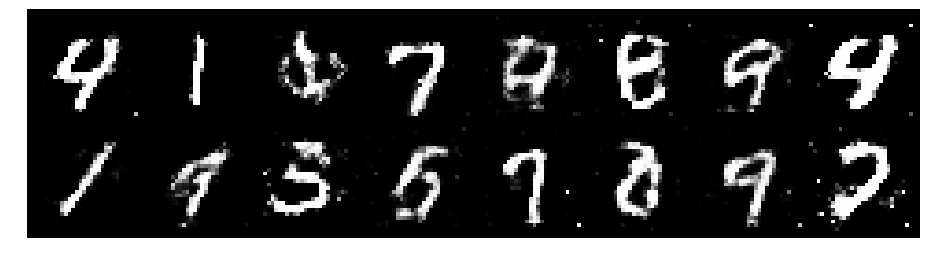

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2586, Generator Loss: 0.9144
D(x): 0.5767, D(G(z)): 0.4563


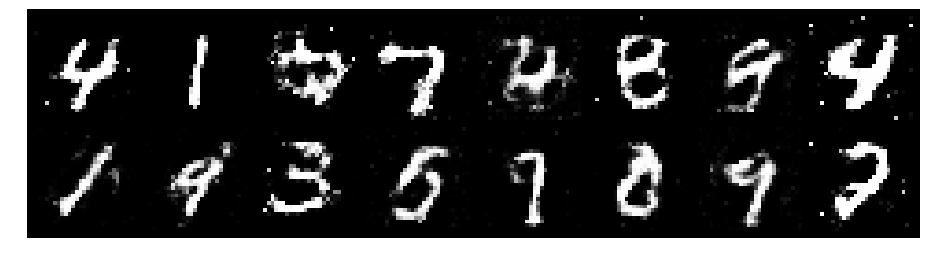

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1760, Generator Loss: 1.0767
D(x): 0.5696, D(G(z)): 0.3775


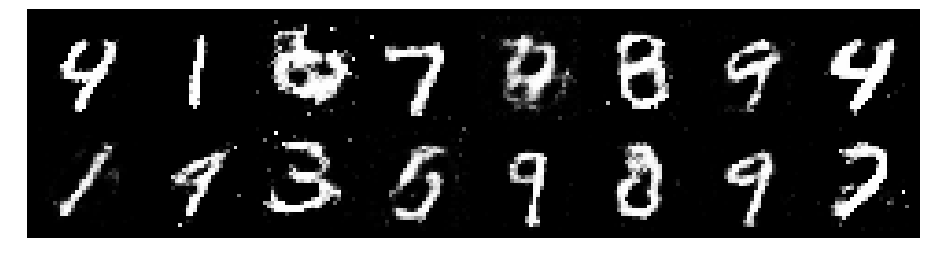

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.3017, Generator Loss: 1.0314
D(x): 0.5297, D(G(z)): 0.4198


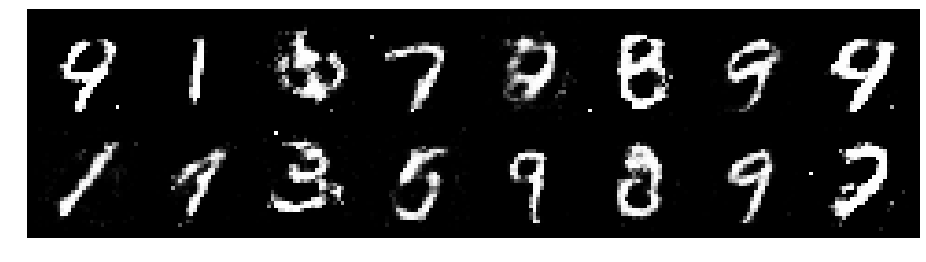

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.0953, Generator Loss: 1.0328
D(x): 0.5951, D(G(z)): 0.3850


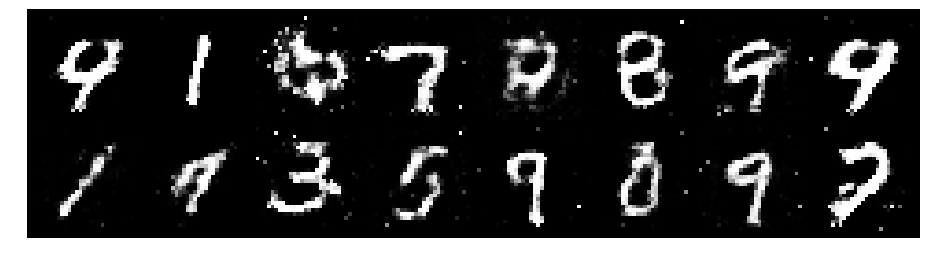

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2204, Generator Loss: 0.9358
D(x): 0.5447, D(G(z)): 0.4087


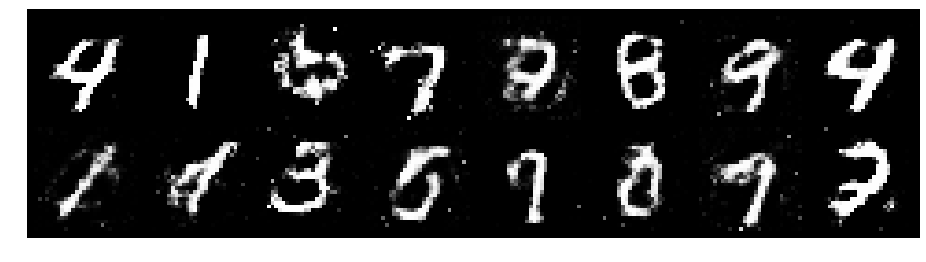

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1685, Generator Loss: 1.0875
D(x): 0.5754, D(G(z)): 0.3792


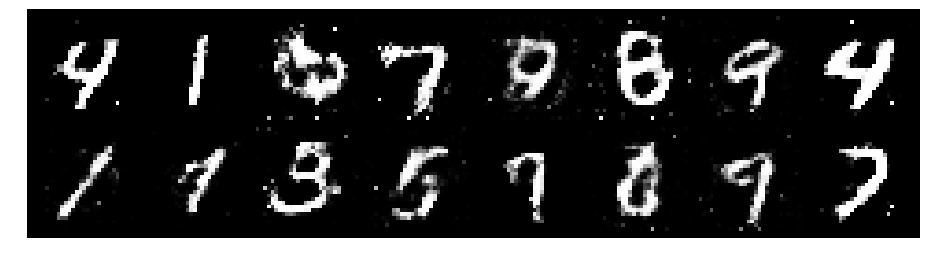

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.0929, Generator Loss: 1.0590
D(x): 0.6047, D(G(z)): 0.3851


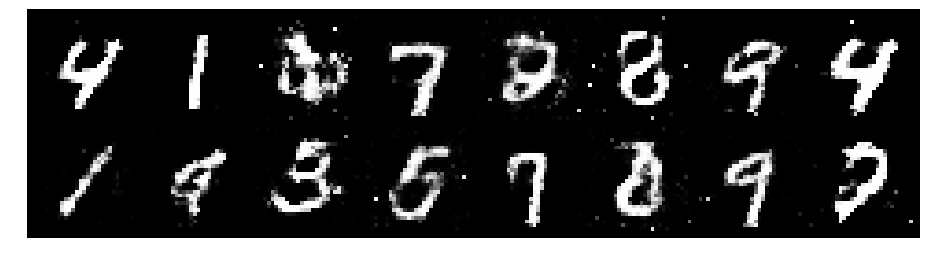

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2017, Generator Loss: 0.9658
D(x): 0.5837, D(G(z)): 0.4353


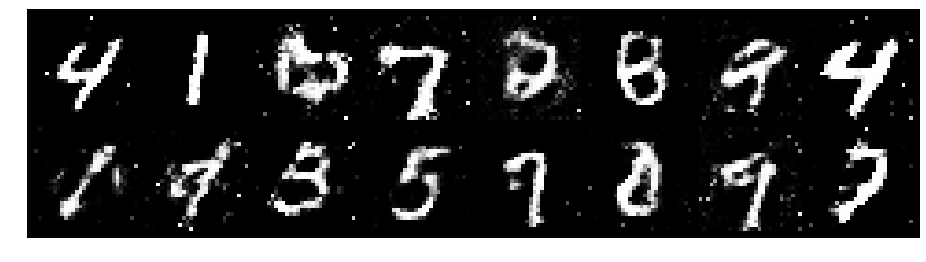

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.1672, Generator Loss: 0.9900
D(x): 0.5660, D(G(z)): 0.4123


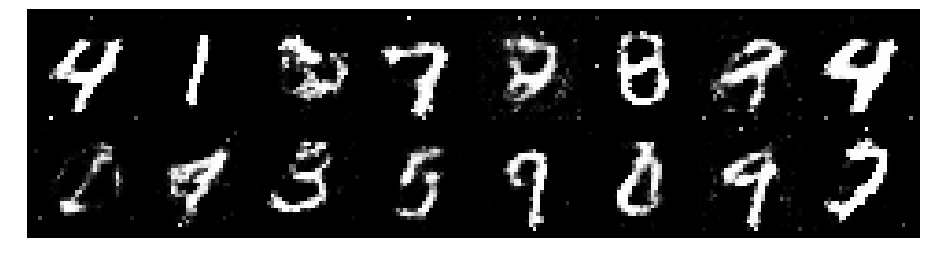

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2429, Generator Loss: 0.8633
D(x): 0.5751, D(G(z)): 0.4375


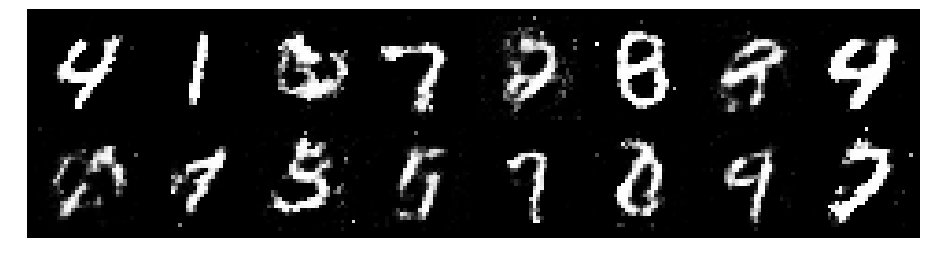

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1568, Generator Loss: 1.0336
D(x): 0.6008, D(G(z)): 0.4082


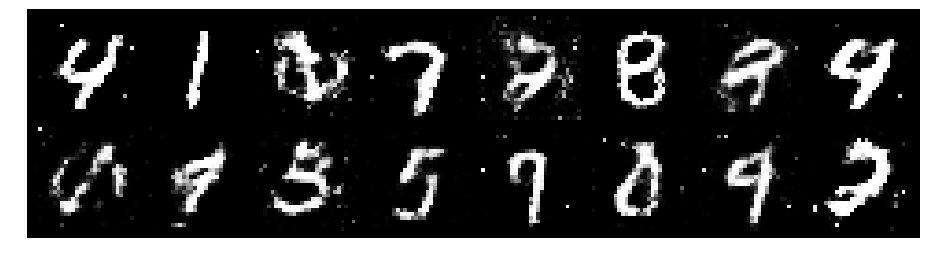

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1623, Generator Loss: 1.0409
D(x): 0.5873, D(G(z)): 0.3942


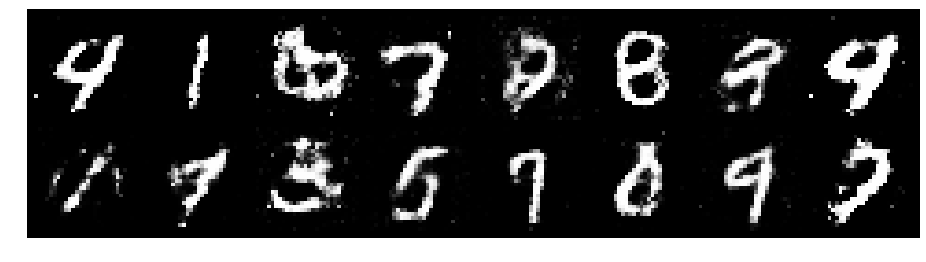

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2616, Generator Loss: 0.9862
D(x): 0.6206, D(G(z)): 0.4254


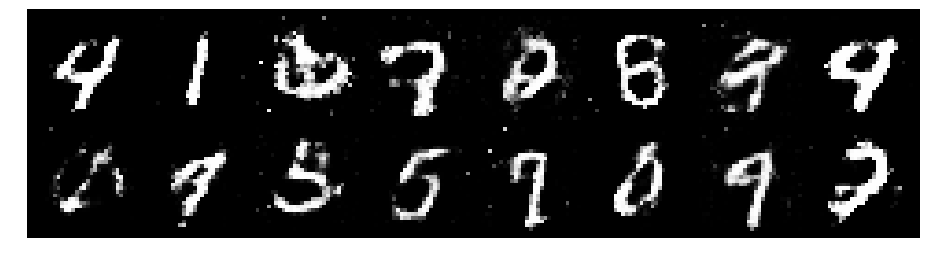

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2507, Generator Loss: 1.0243
D(x): 0.5669, D(G(z)): 0.4353


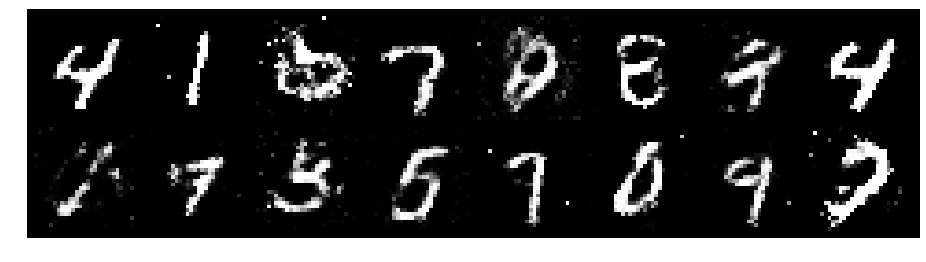

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2808, Generator Loss: 0.8264
D(x): 0.5855, D(G(z)): 0.4787


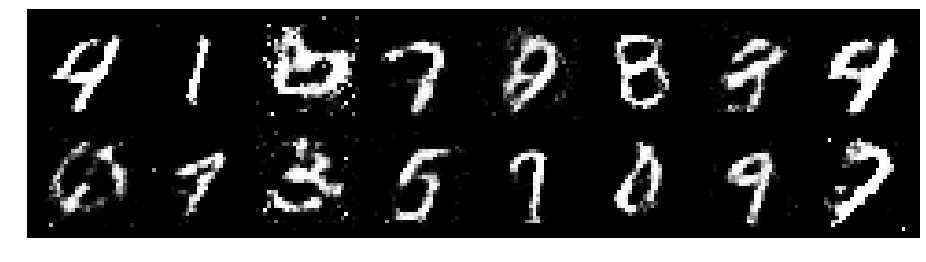

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.3246, Generator Loss: 0.9496
D(x): 0.6181, D(G(z)): 0.5006


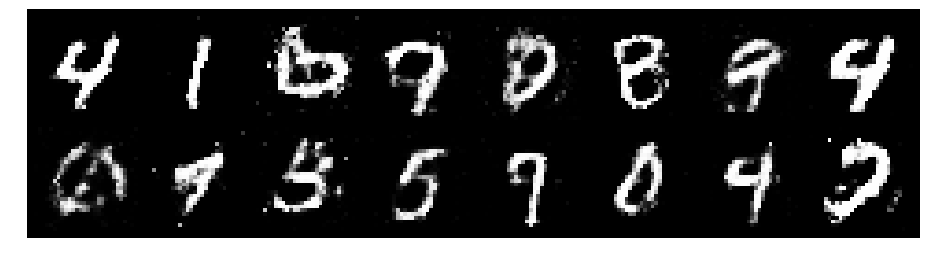

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2635, Generator Loss: 0.8761
D(x): 0.5293, D(G(z)): 0.4111


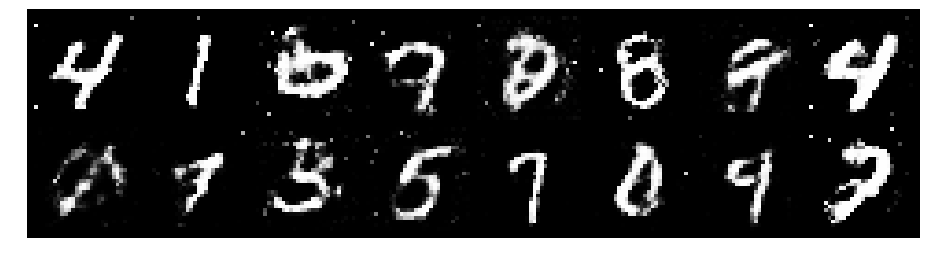

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2332, Generator Loss: 0.9349
D(x): 0.5883, D(G(z)): 0.4289


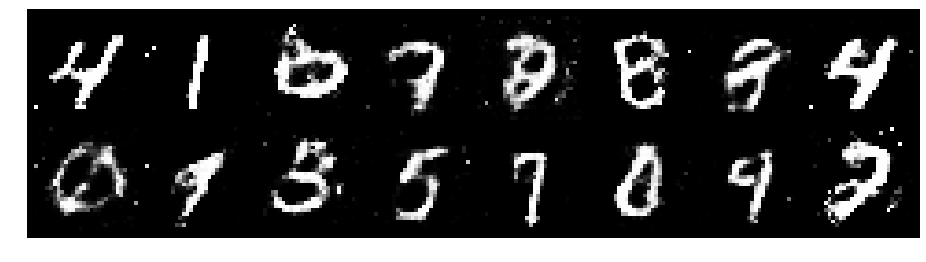

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.2569, Generator Loss: 1.1090
D(x): 0.6338, D(G(z)): 0.4486


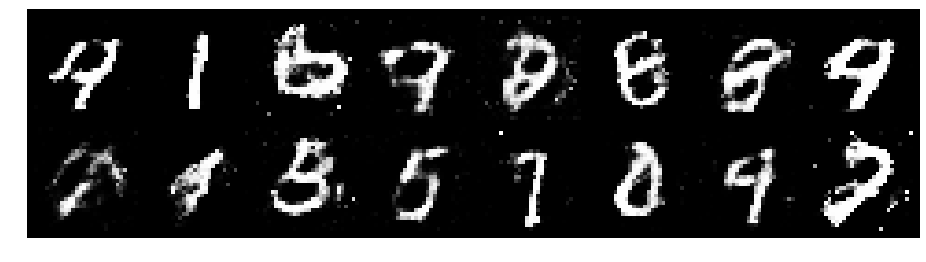

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.0263, Generator Loss: 1.1134
D(x): 0.6027, D(G(z)): 0.3506


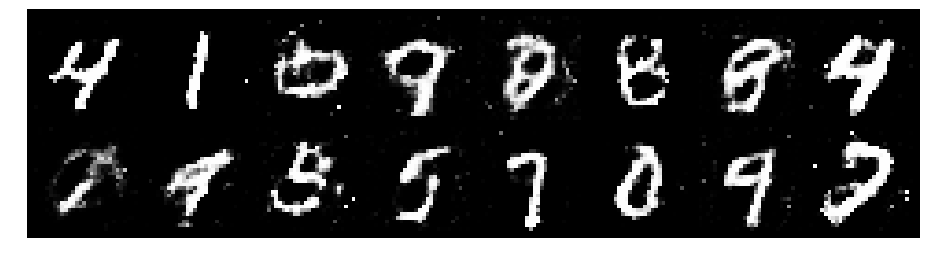

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1204, Generator Loss: 0.9908
D(x): 0.5682, D(G(z)): 0.3664


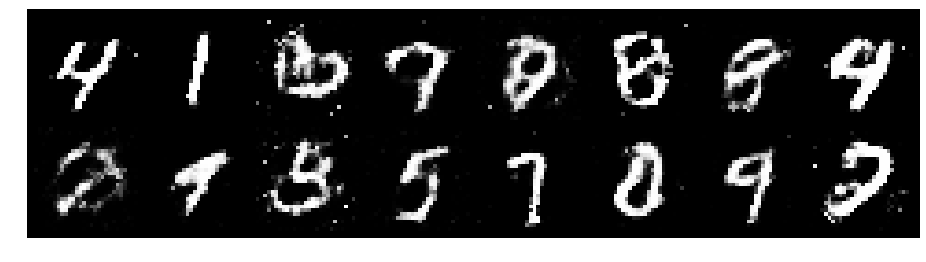

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1915, Generator Loss: 1.0368
D(x): 0.5839, D(G(z)): 0.3937


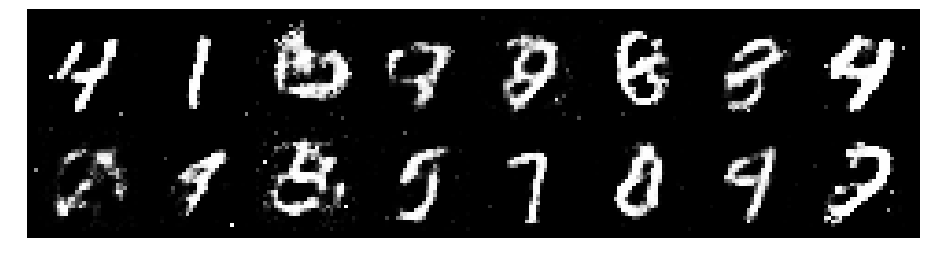

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.3536, Generator Loss: 1.0911
D(x): 0.5219, D(G(z)): 0.3775


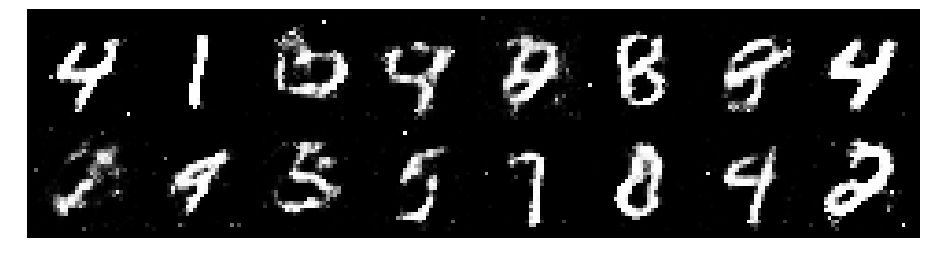

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.1508, Generator Loss: 1.0374
D(x): 0.6586, D(G(z)): 0.4065


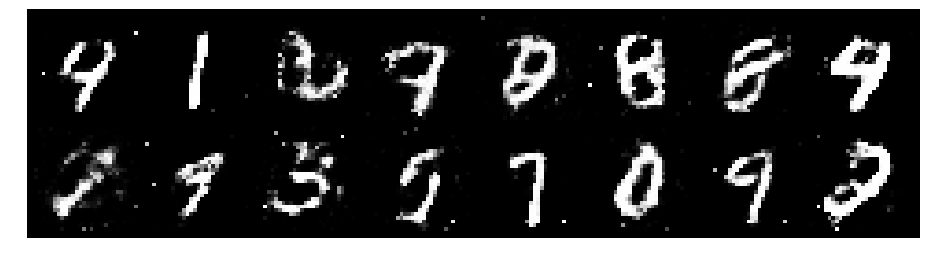

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1553, Generator Loss: 1.0689
D(x): 0.5969, D(G(z)): 0.3909


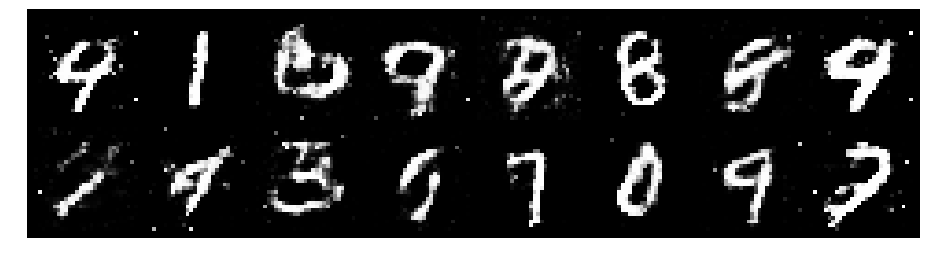

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.3375, Generator Loss: 0.9422
D(x): 0.5131, D(G(z)): 0.3929


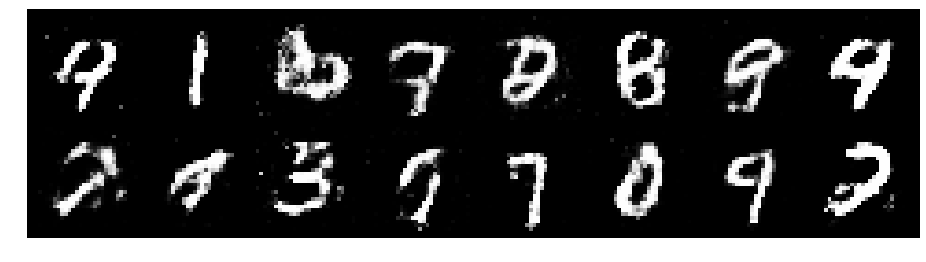

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2053, Generator Loss: 1.1504
D(x): 0.5612, D(G(z)): 0.3834


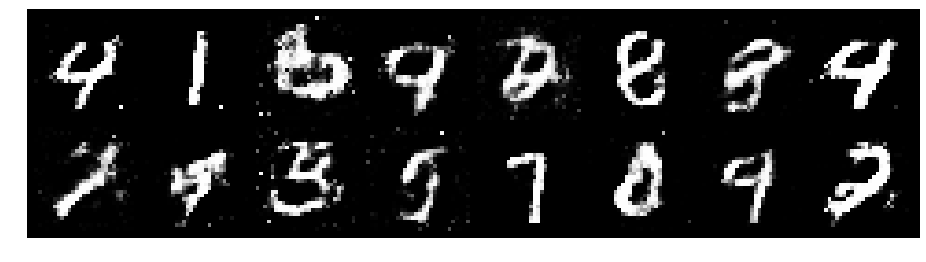

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2118, Generator Loss: 1.1649
D(x): 0.5851, D(G(z)): 0.3985


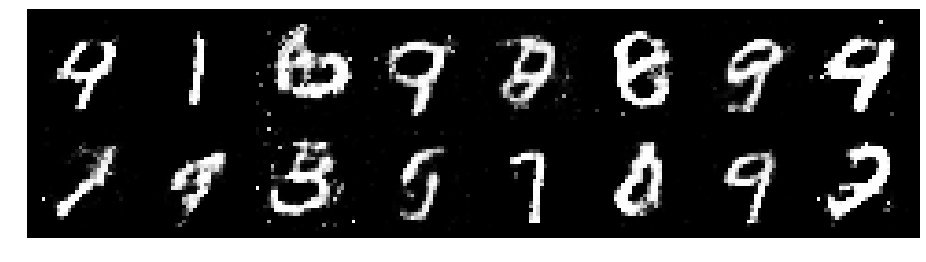

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.1814, Generator Loss: 1.1346
D(x): 0.6186, D(G(z)): 0.4065


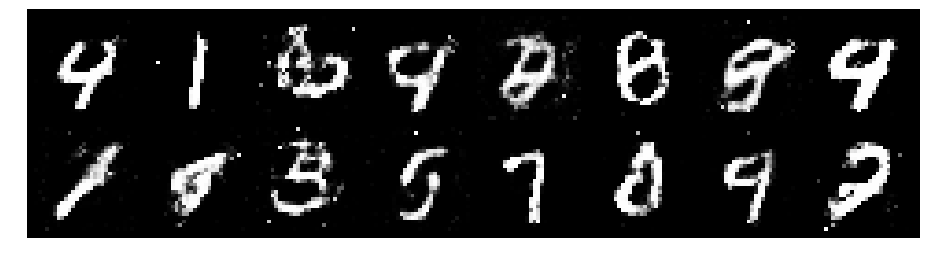

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2388, Generator Loss: 1.0413
D(x): 0.5951, D(G(z)): 0.4439


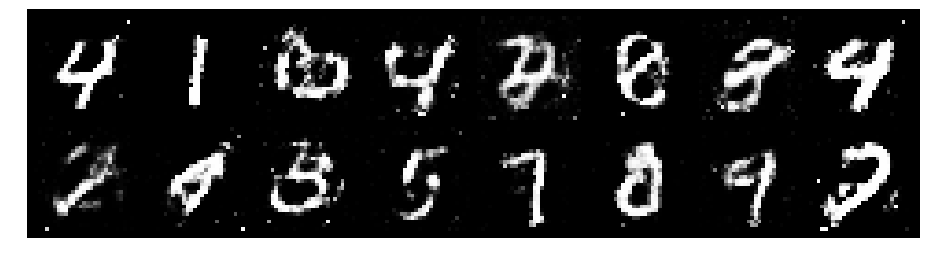

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2237, Generator Loss: 0.8369
D(x): 0.5989, D(G(z)): 0.4495


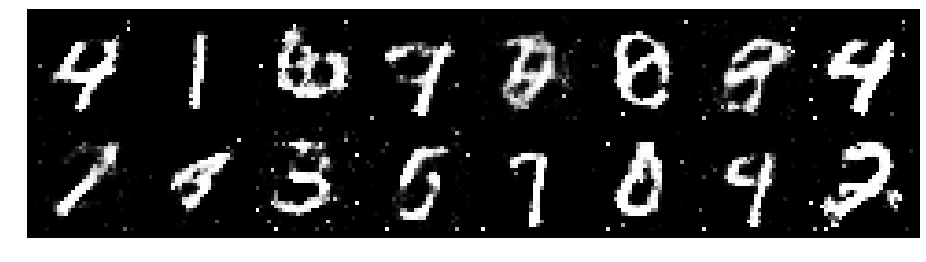

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2110, Generator Loss: 1.0140
D(x): 0.6115, D(G(z)): 0.4236


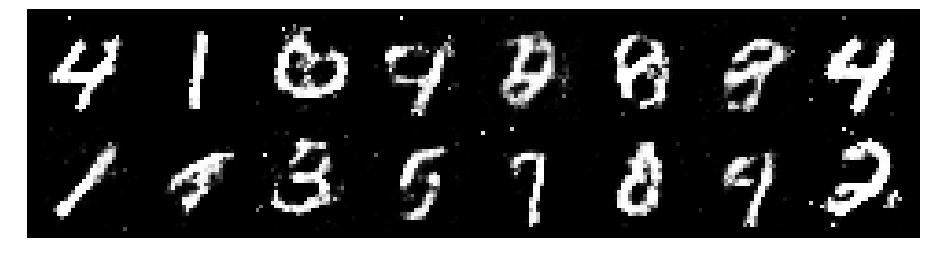

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.0776, Generator Loss: 1.3058
D(x): 0.6188, D(G(z)): 0.3492


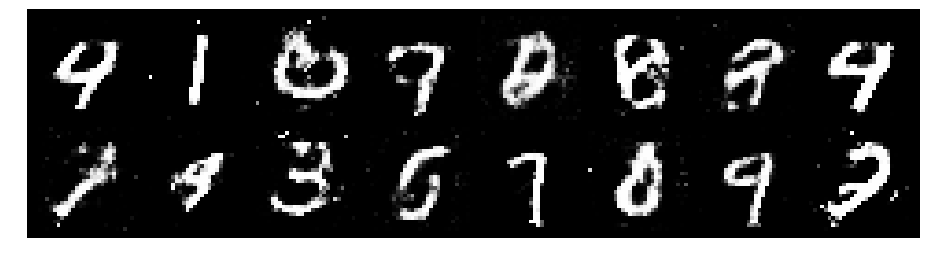

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 0.9581, Generator Loss: 1.3995
D(x): 0.6419, D(G(z)): 0.3374


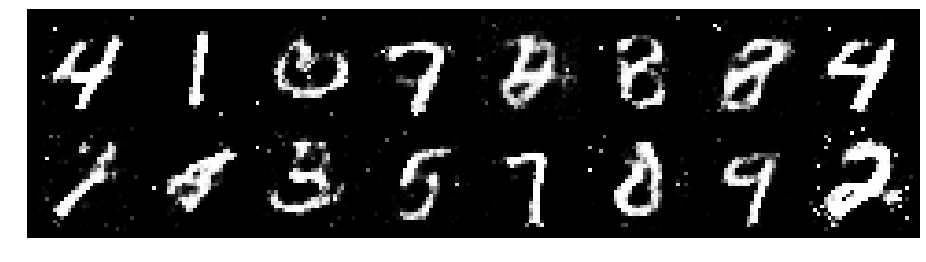

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8727
D(x): 0.5515, D(G(z)): 0.4498


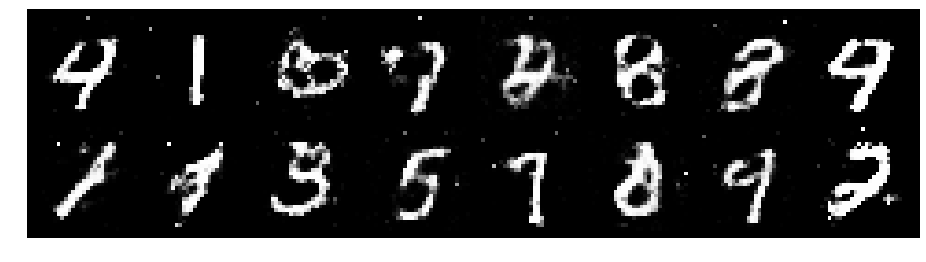

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2730, Generator Loss: 0.8387
D(x): 0.5702, D(G(z)): 0.4532


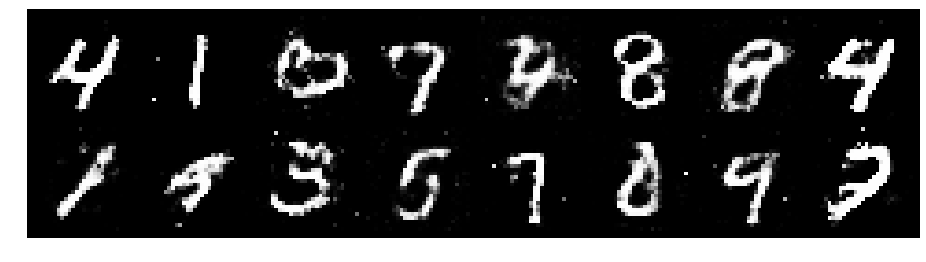

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.3730, Generator Loss: 0.8962
D(x): 0.5960, D(G(z)): 0.5046


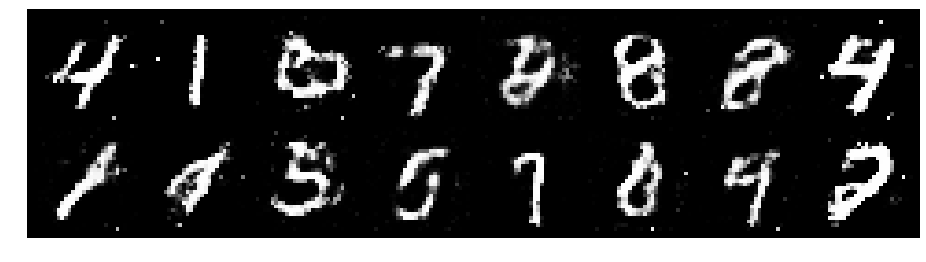

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2127, Generator Loss: 1.0188
D(x): 0.5902, D(G(z)): 0.4304


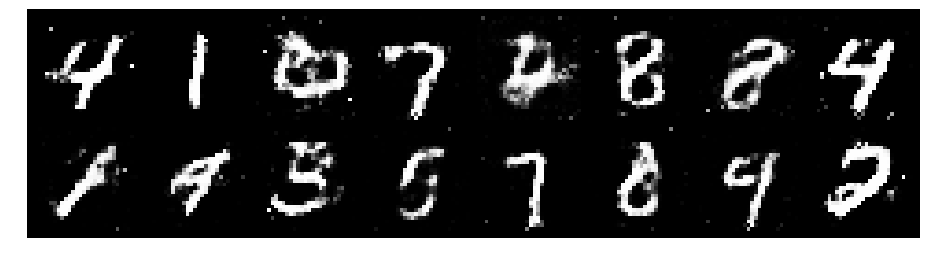

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2116, Generator Loss: 1.0656
D(x): 0.5932, D(G(z)): 0.3954


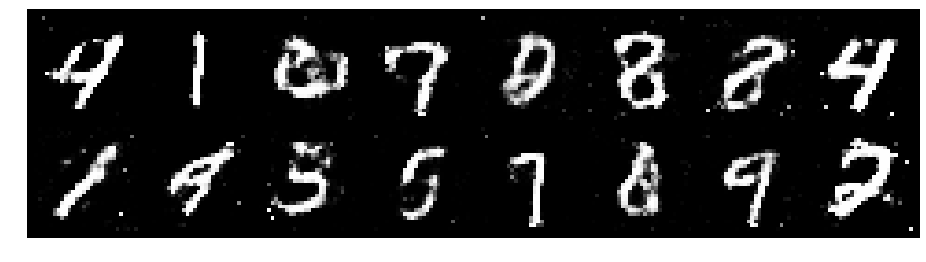

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.1203, Generator Loss: 1.0689
D(x): 0.5933, D(G(z)): 0.3919


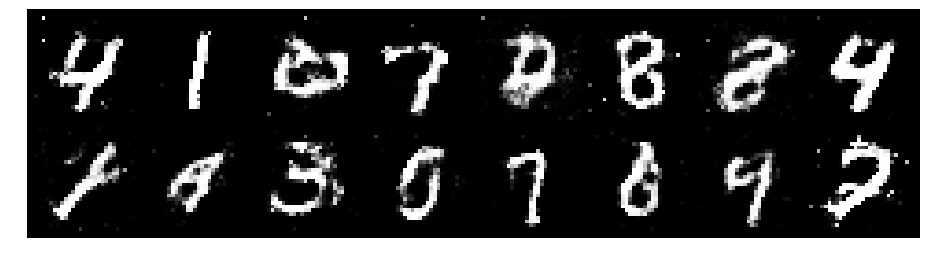

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.2002, Generator Loss: 1.0202
D(x): 0.5745, D(G(z)): 0.4154


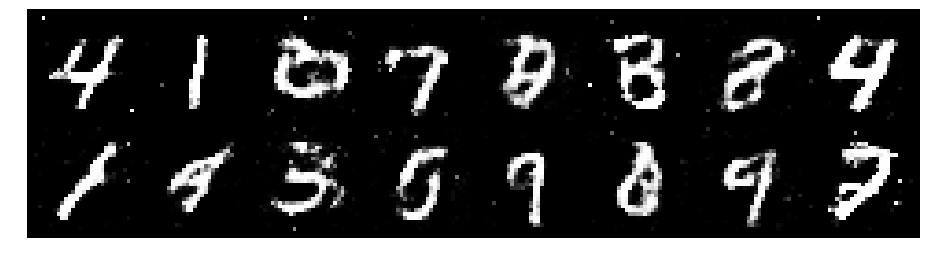

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.3749, Generator Loss: 0.9153
D(x): 0.5342, D(G(z)): 0.4442


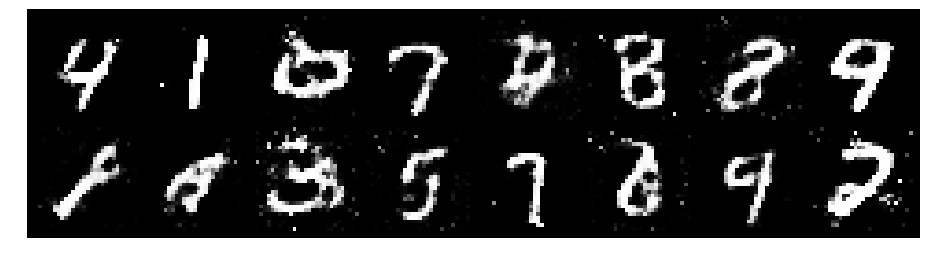

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2911, Generator Loss: 0.8074
D(x): 0.6138, D(G(z)): 0.5063


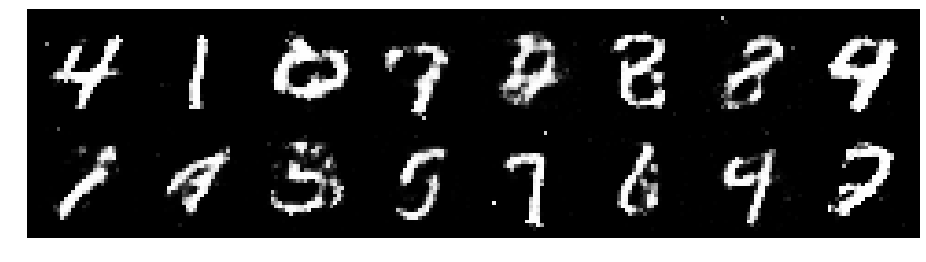

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.5487, Generator Loss: 0.9463
D(x): 0.4694, D(G(z)): 0.4427


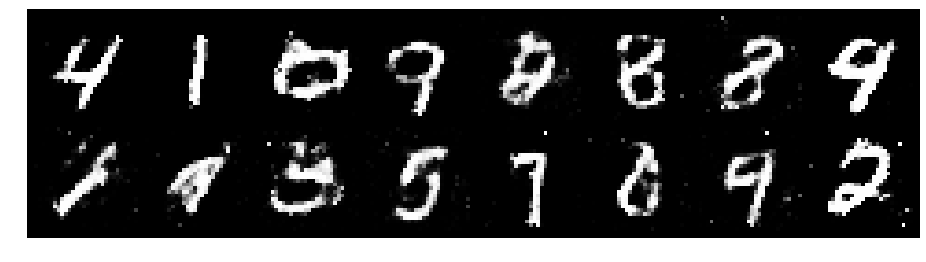

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.4165, Generator Loss: 0.9245
D(x): 0.5490, D(G(z)): 0.4869


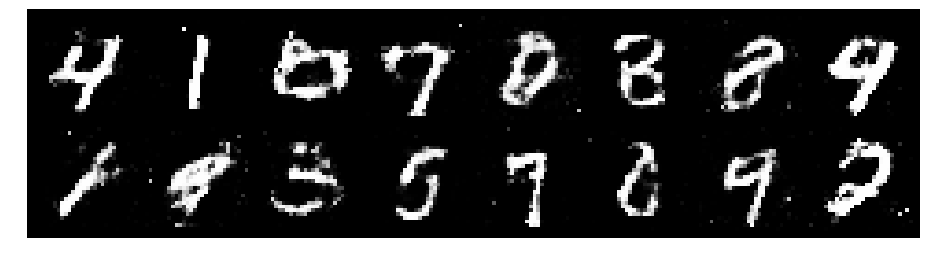

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3432, Generator Loss: 0.9159
D(x): 0.5140, D(G(z)): 0.4400


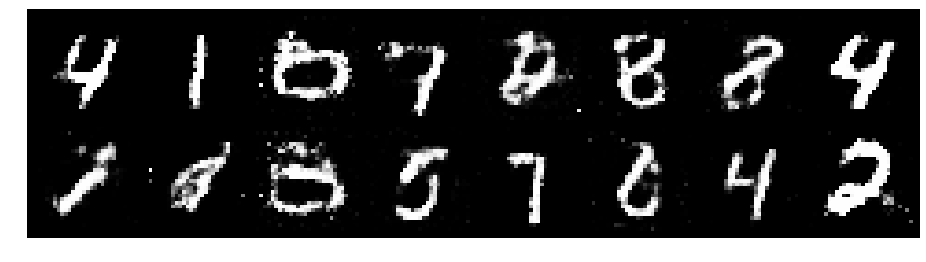

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3206, Generator Loss: 0.9247
D(x): 0.5774, D(G(z)): 0.4563


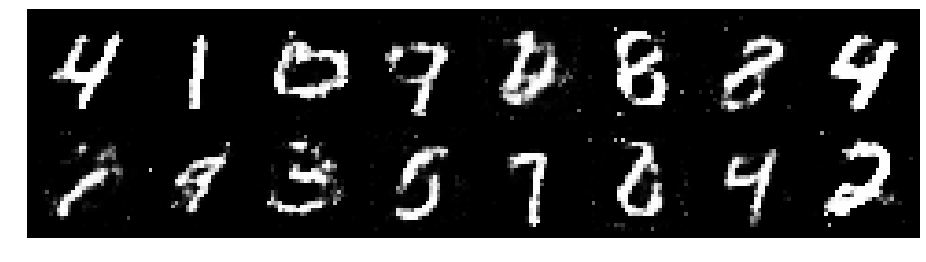

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2241, Generator Loss: 0.9060
D(x): 0.5737, D(G(z)): 0.4186


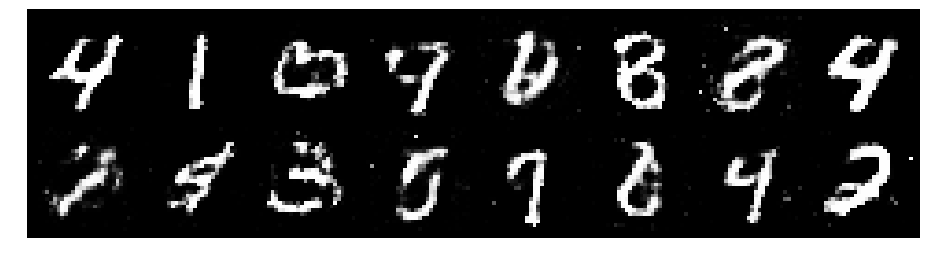

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8756
D(x): 0.5715, D(G(z)): 0.4038


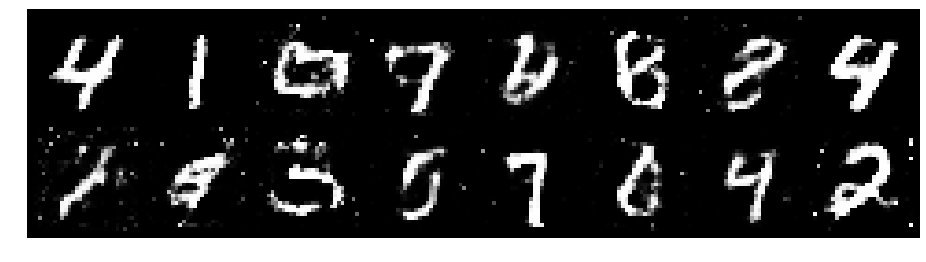

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2276, Generator Loss: 1.0159
D(x): 0.5861, D(G(z)): 0.4407


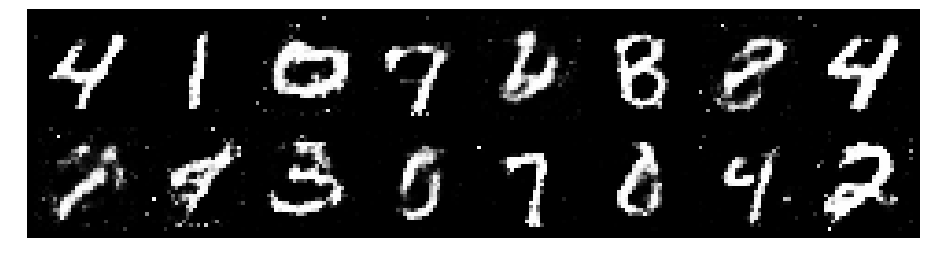

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.0870, Generator Loss: 0.9698
D(x): 0.6479, D(G(z)): 0.4070


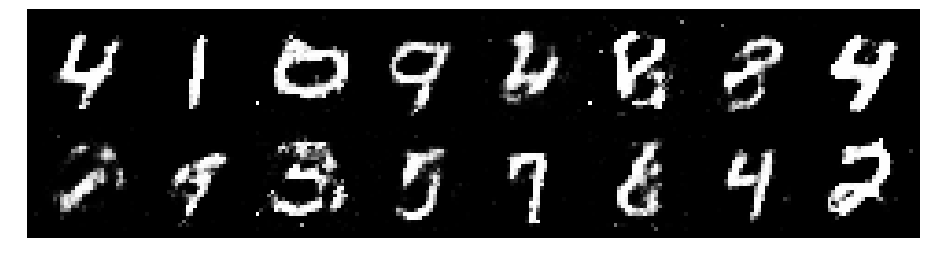

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1516, Generator Loss: 0.8792
D(x): 0.5786, D(G(z)): 0.3990


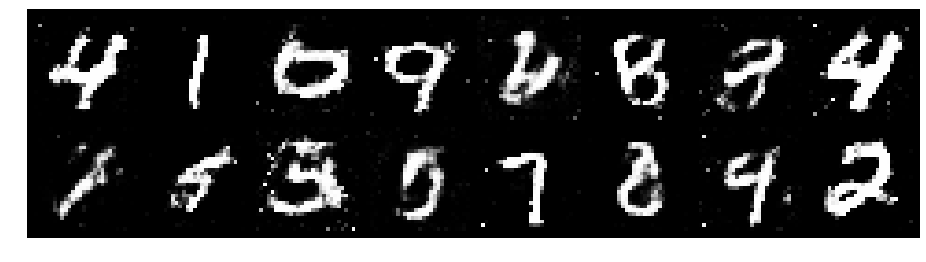

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2558, Generator Loss: 0.8524
D(x): 0.5806, D(G(z)): 0.4765


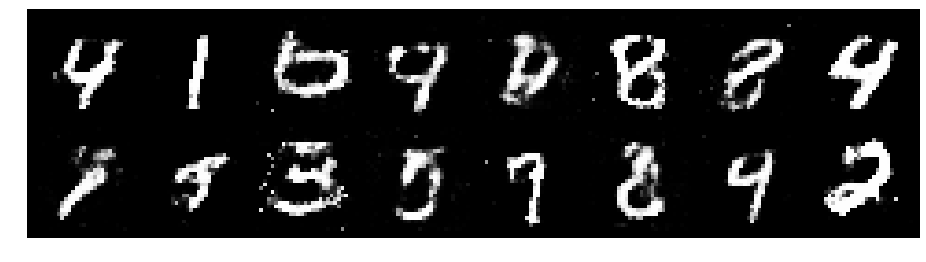

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2984, Generator Loss: 0.8176
D(x): 0.5598, D(G(z)): 0.4672


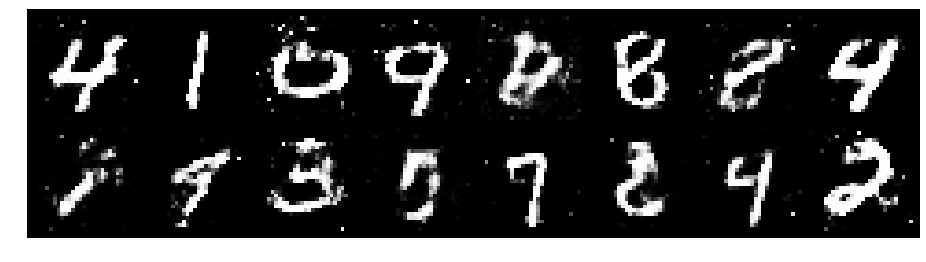

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.3341, Generator Loss: 0.9129
D(x): 0.5619, D(G(z)): 0.4740


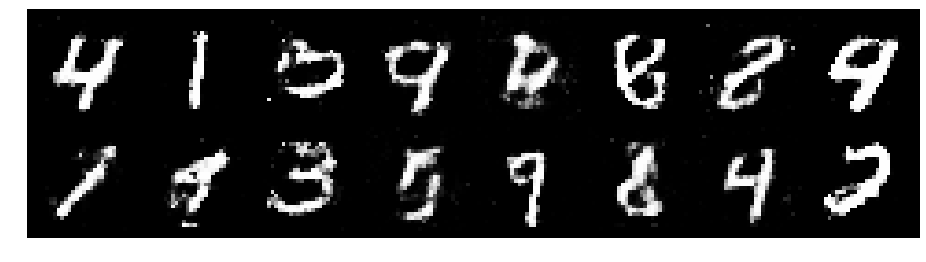

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2126, Generator Loss: 0.9766
D(x): 0.5799, D(G(z)): 0.4412


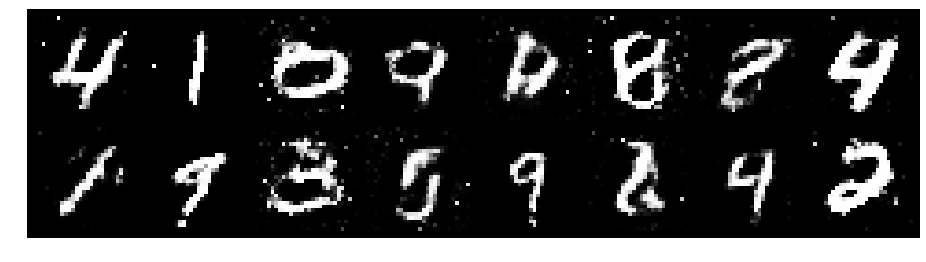

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2759, Generator Loss: 0.8287
D(x): 0.5531, D(G(z)): 0.4588


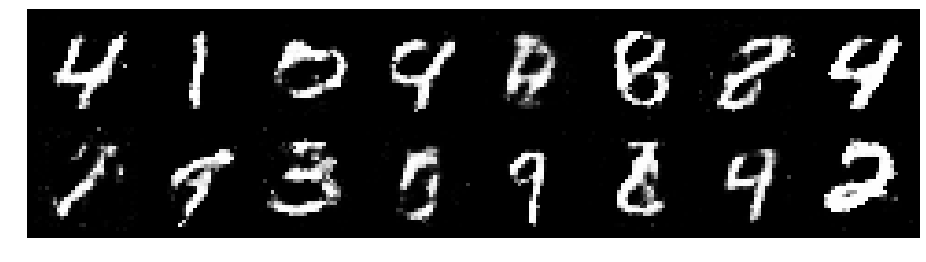

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2039, Generator Loss: 0.9768
D(x): 0.6051, D(G(z)): 0.4447


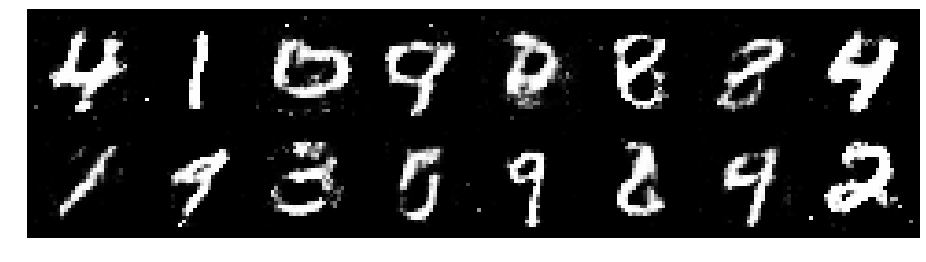

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2467, Generator Loss: 0.8967
D(x): 0.5679, D(G(z)): 0.4162


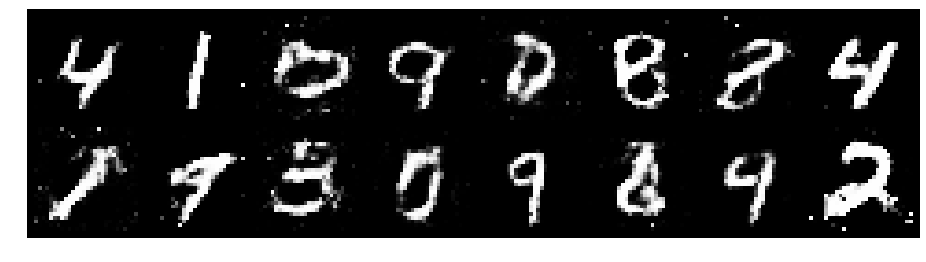

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2324, Generator Loss: 0.9891
D(x): 0.6291, D(G(z)): 0.4377


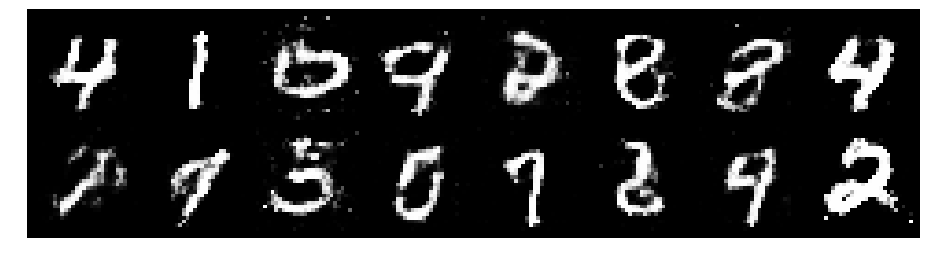

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1466, Generator Loss: 1.3127
D(x): 0.5571, D(G(z)): 0.3420


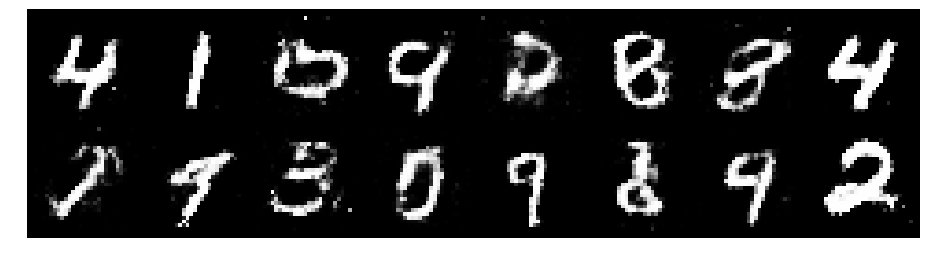

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.0687, Generator Loss: 1.2357
D(x): 0.5811, D(G(z)): 0.3102


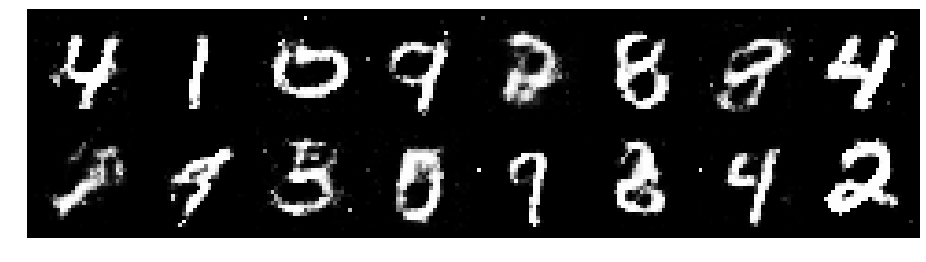

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2812, Generator Loss: 1.0181
D(x): 0.5662, D(G(z)): 0.4304


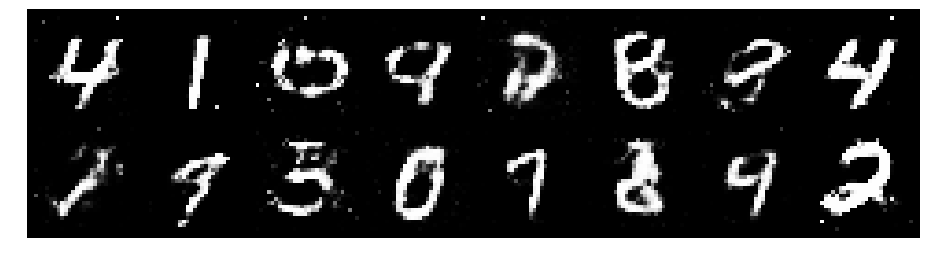

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.3081, Generator Loss: 0.9263
D(x): 0.5707, D(G(z)): 0.4503


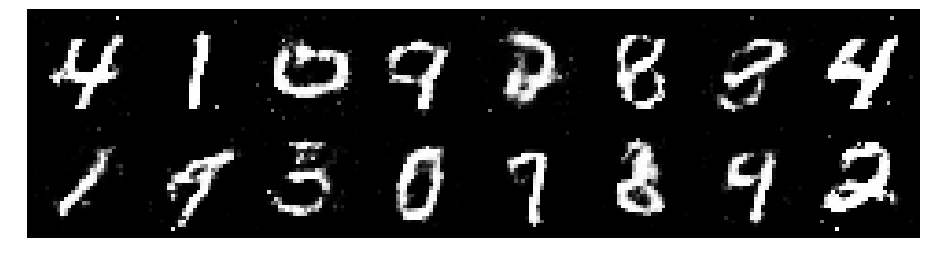

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2457, Generator Loss: 1.0305
D(x): 0.5904, D(G(z)): 0.4371


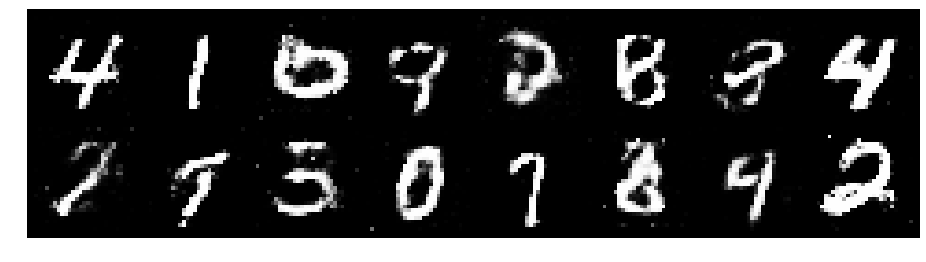

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2846, Generator Loss: 0.8222
D(x): 0.5803, D(G(z)): 0.4665


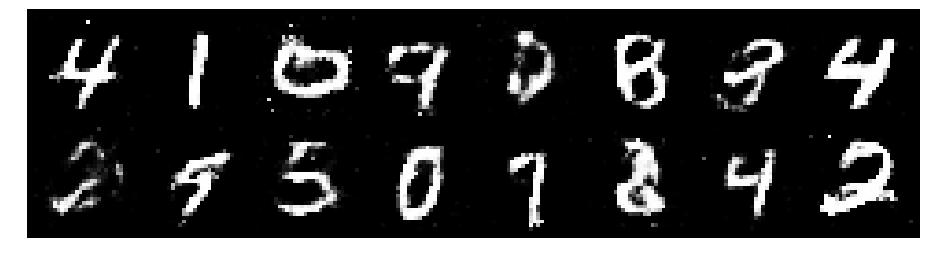

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.3062, Generator Loss: 0.8970
D(x): 0.5625, D(G(z)): 0.4623


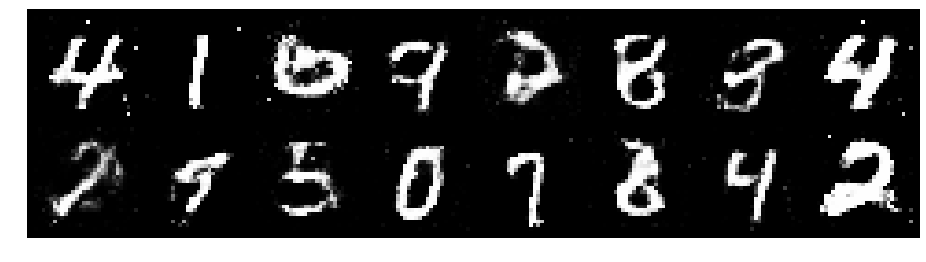

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.3076, Generator Loss: 0.9088
D(x): 0.5557, D(G(z)): 0.4690


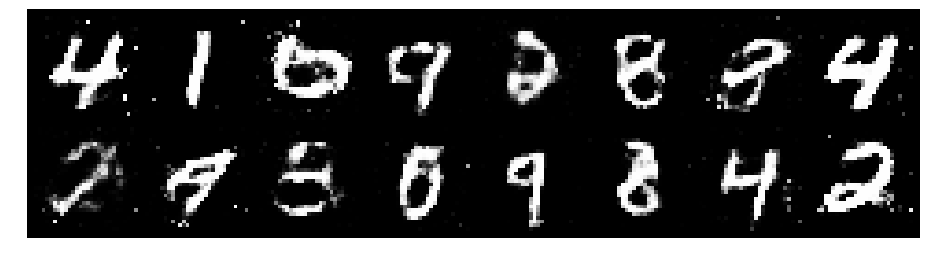

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9794
D(x): 0.5425, D(G(z)): 0.4057


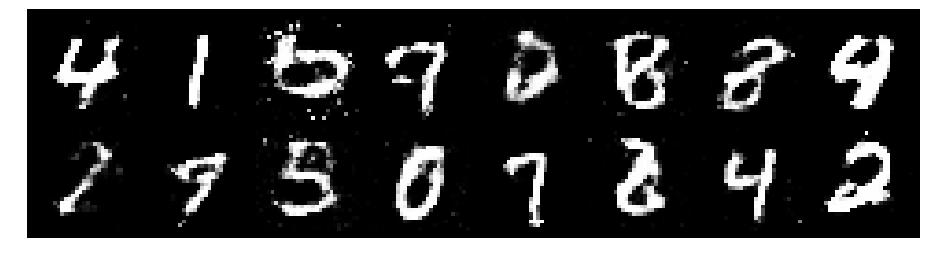

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2409, Generator Loss: 0.8470
D(x): 0.5697, D(G(z)): 0.4354


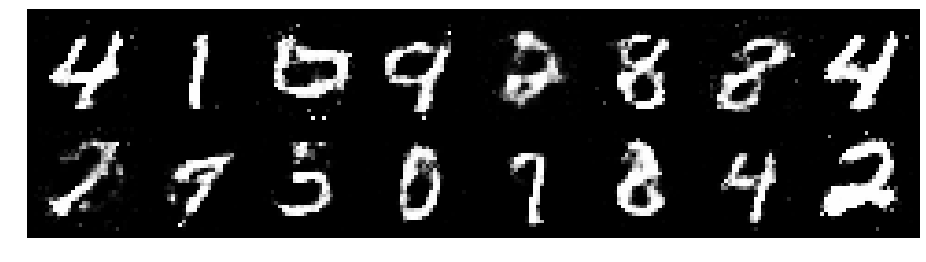

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2788, Generator Loss: 1.0319
D(x): 0.5666, D(G(z)): 0.4414


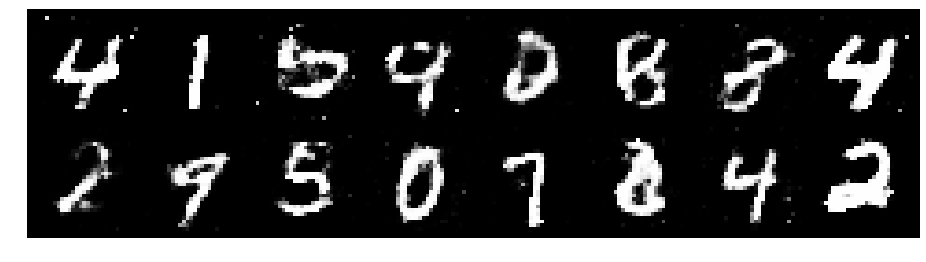

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2745, Generator Loss: 0.8626
D(x): 0.6021, D(G(z)): 0.4832


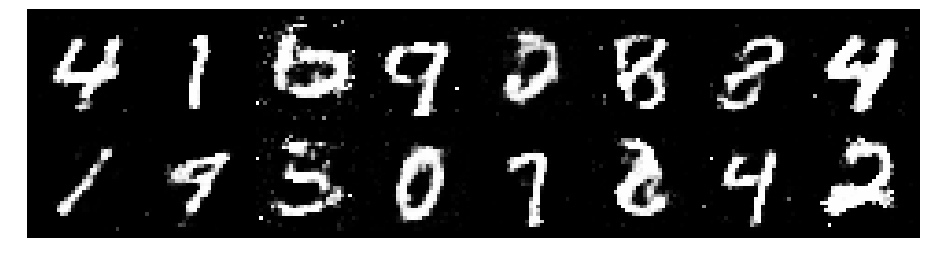

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.4101, Generator Loss: 0.8561
D(x): 0.5446, D(G(z)): 0.4616


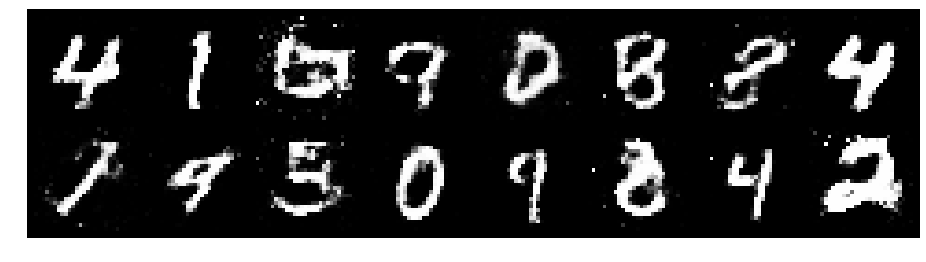

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2540, Generator Loss: 0.8756
D(x): 0.5752, D(G(z)): 0.4501


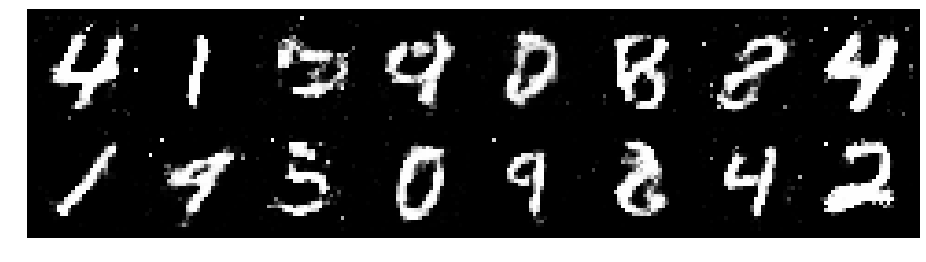

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2898, Generator Loss: 0.9617
D(x): 0.5794, D(G(z)): 0.4668


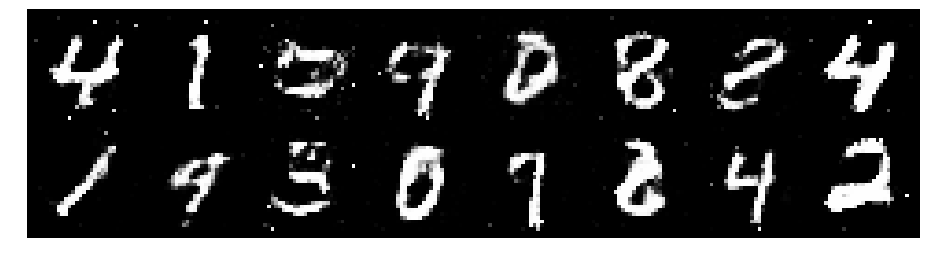

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.1643, Generator Loss: 1.0299
D(x): 0.6033, D(G(z)): 0.4176


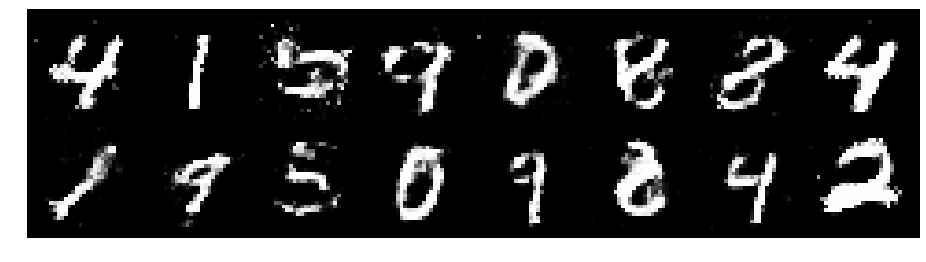

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2541, Generator Loss: 1.0941
D(x): 0.5817, D(G(z)): 0.4292


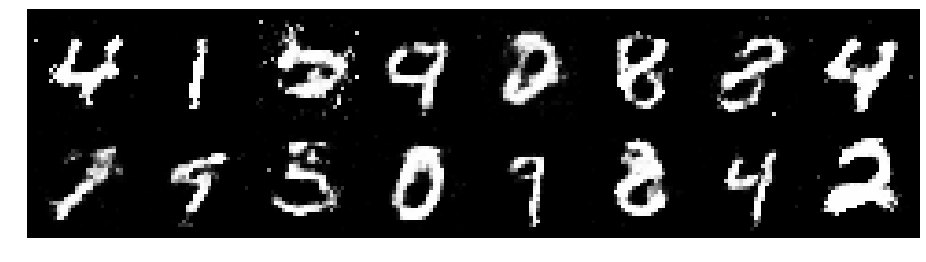

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.3093, Generator Loss: 0.9830
D(x): 0.5519, D(G(z)): 0.4245


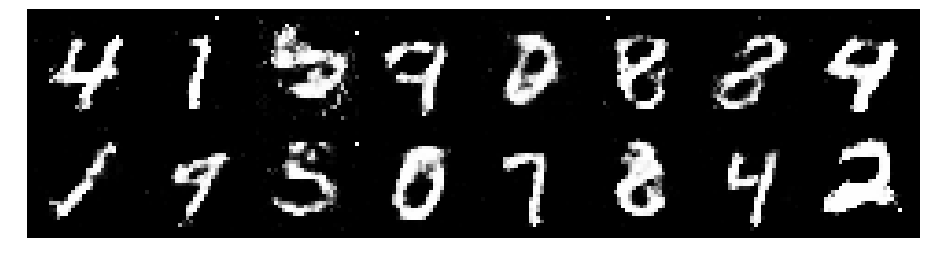

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.1875, Generator Loss: 0.8295
D(x): 0.6085, D(G(z)): 0.4520


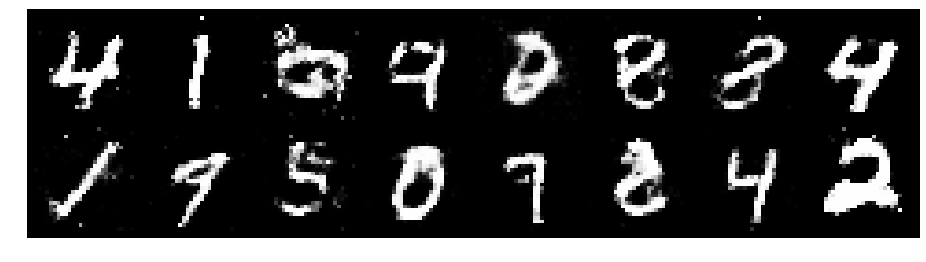

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2132, Generator Loss: 1.1035
D(x): 0.5629, D(G(z)): 0.4079


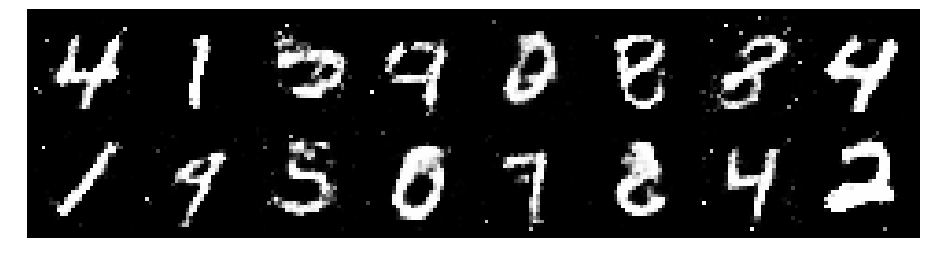

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2810, Generator Loss: 1.1090
D(x): 0.5556, D(G(z)): 0.4131


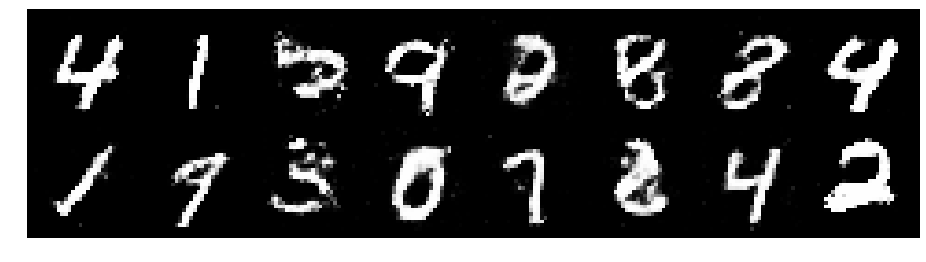

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.1950, Generator Loss: 0.9859
D(x): 0.5833, D(G(z)): 0.4186


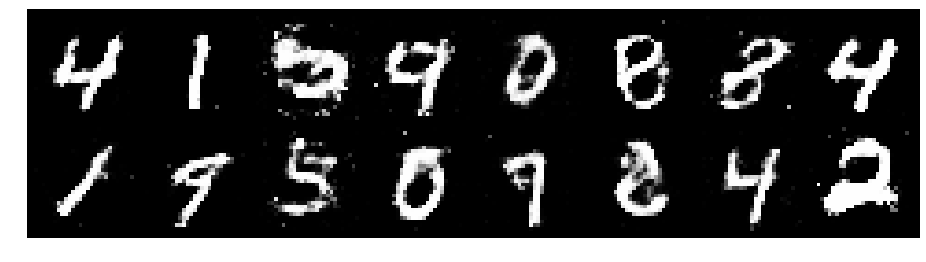

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.0720, Generator Loss: 0.9559
D(x): 0.6287, D(G(z)): 0.4112


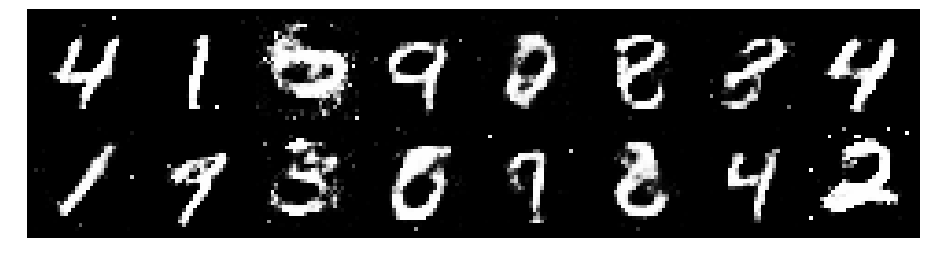

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2390, Generator Loss: 0.7599
D(x): 0.6001, D(G(z)): 0.4670


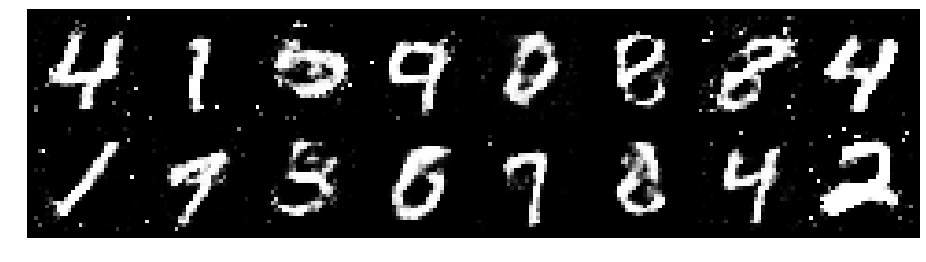

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2681, Generator Loss: 0.8833
D(x): 0.5961, D(G(z)): 0.4832


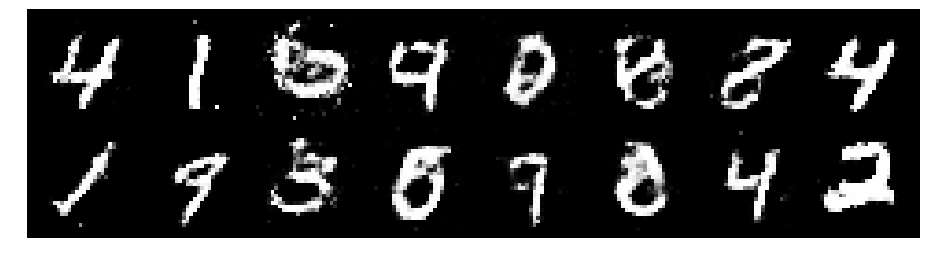

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2246, Generator Loss: 0.8729
D(x): 0.5764, D(G(z)): 0.4547


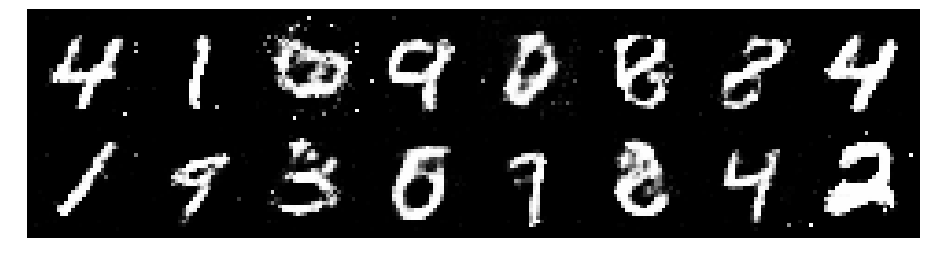

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.3062, Generator Loss: 0.8106
D(x): 0.6230, D(G(z)): 0.5040


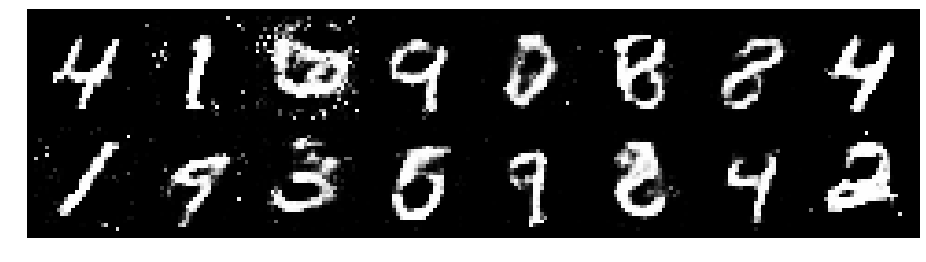

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.3060, Generator Loss: 0.8462
D(x): 0.5281, D(G(z)): 0.4324


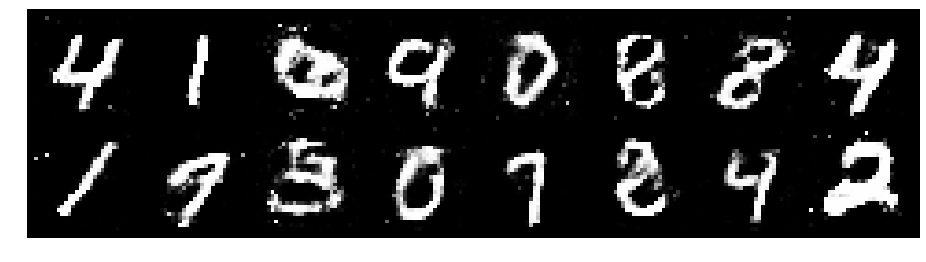

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.3772, Generator Loss: 0.8598
D(x): 0.5075, D(G(z)): 0.4439


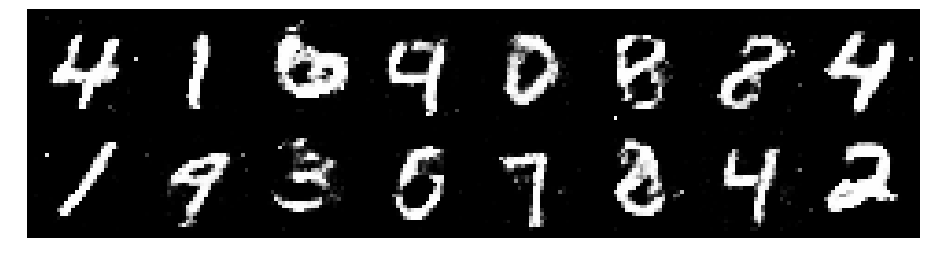

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2229, Generator Loss: 1.0423
D(x): 0.5246, D(G(z)): 0.3745


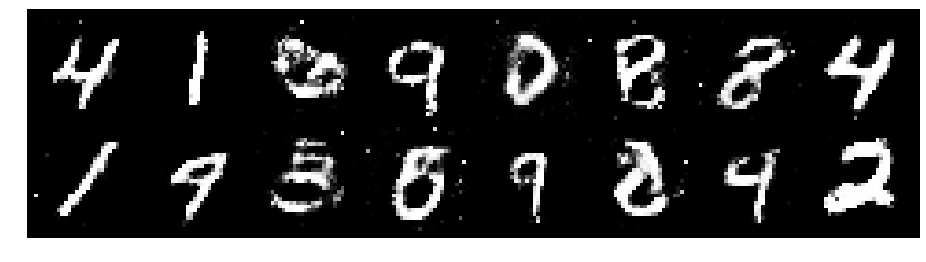

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.0819, Generator Loss: 1.2776
D(x): 0.5983, D(G(z)): 0.3614


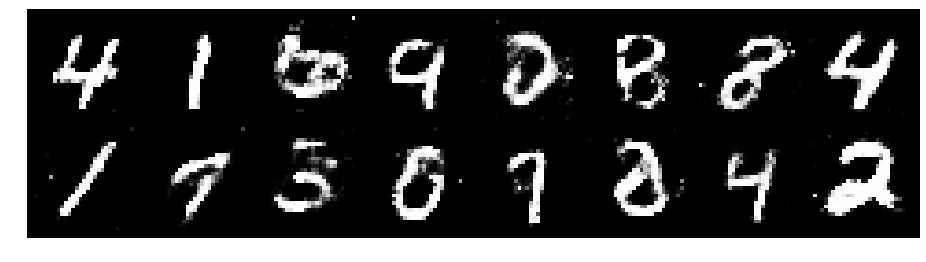

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2387, Generator Loss: 0.9354
D(x): 0.5357, D(G(z)): 0.4174


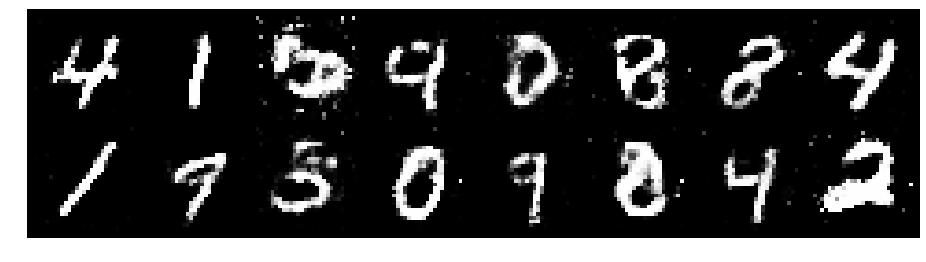

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.1838, Generator Loss: 1.0778
D(x): 0.5527, D(G(z)): 0.3854


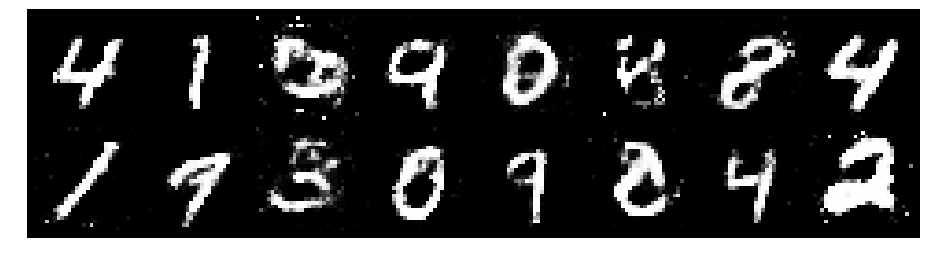

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.1814, Generator Loss: 1.0609
D(x): 0.5966, D(G(z)): 0.4073


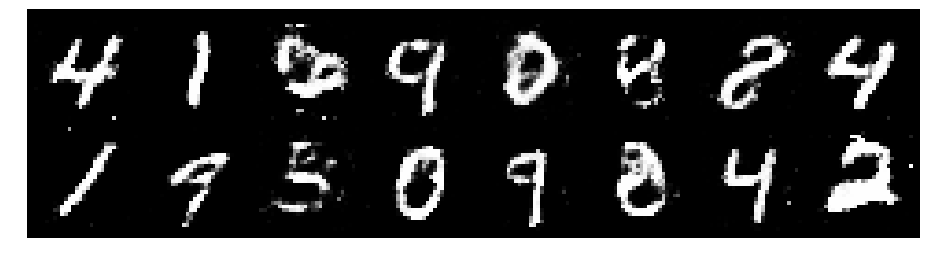

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.1603, Generator Loss: 1.0682
D(x): 0.6084, D(G(z)): 0.3863


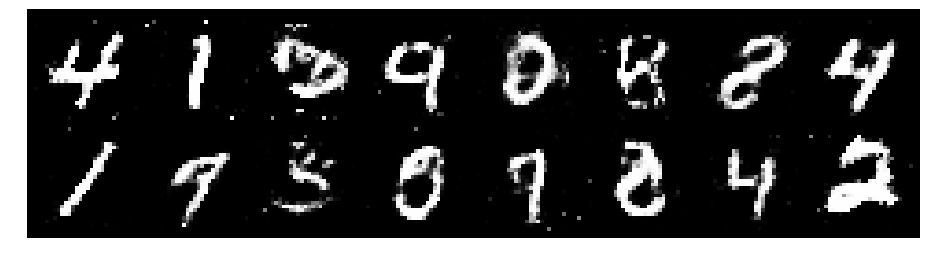

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2441, Generator Loss: 1.0001
D(x): 0.5767, D(G(z)): 0.4255


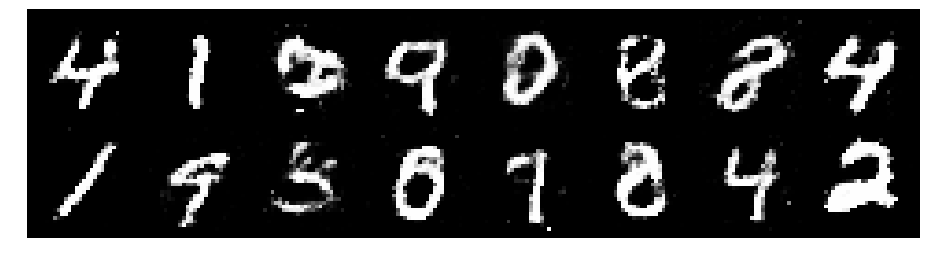

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2315, Generator Loss: 0.9339
D(x): 0.5540, D(G(z)): 0.4378


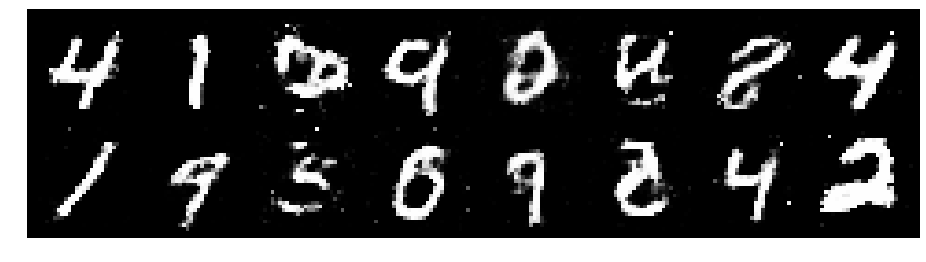

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2754, Generator Loss: 0.9463
D(x): 0.5424, D(G(z)): 0.4305


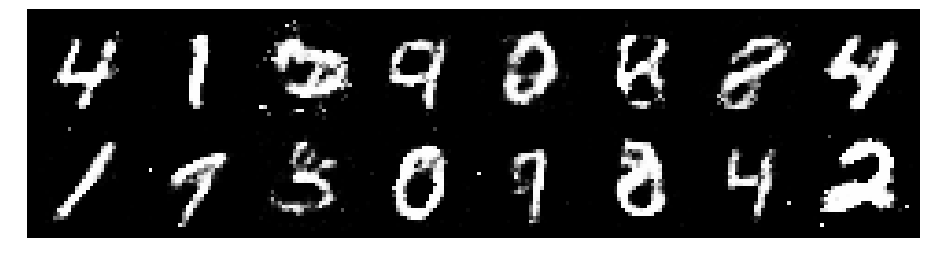

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2841, Generator Loss: 0.8973
D(x): 0.5707, D(G(z)): 0.4638


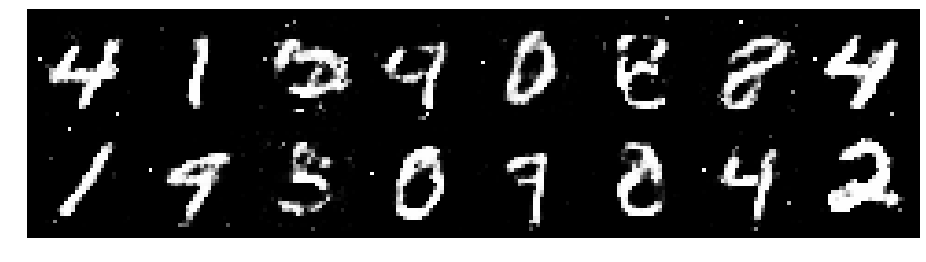

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1915, Generator Loss: 0.8746
D(x): 0.5958, D(G(z)): 0.4432


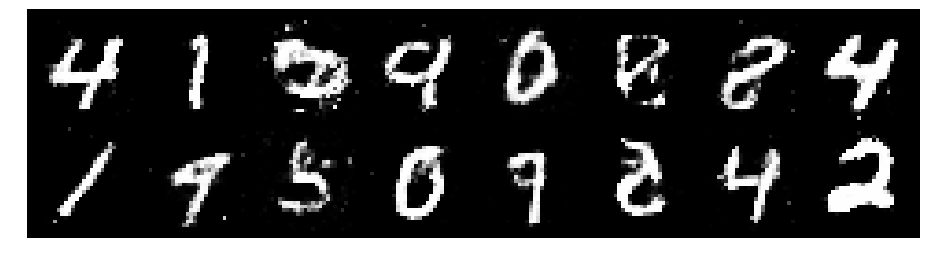

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.1130, Generator Loss: 0.9946
D(x): 0.5683, D(G(z)): 0.3632


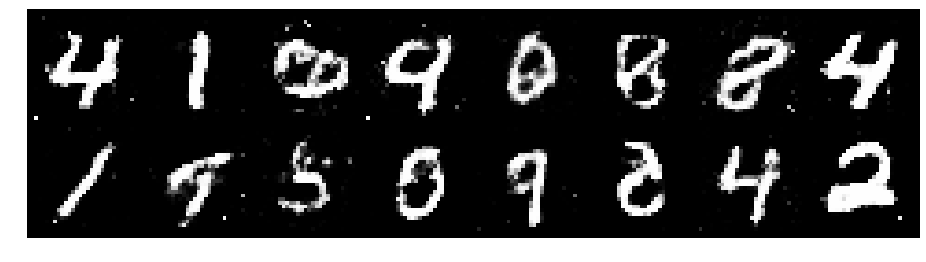

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2358, Generator Loss: 0.9629
D(x): 0.5850, D(G(z)): 0.4356


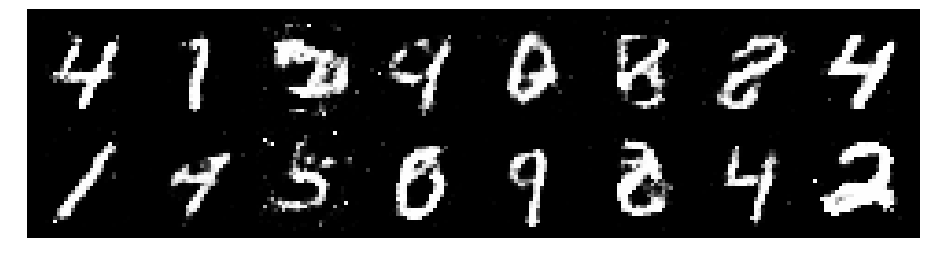

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.3170, Generator Loss: 0.9946
D(x): 0.5874, D(G(z)): 0.4629


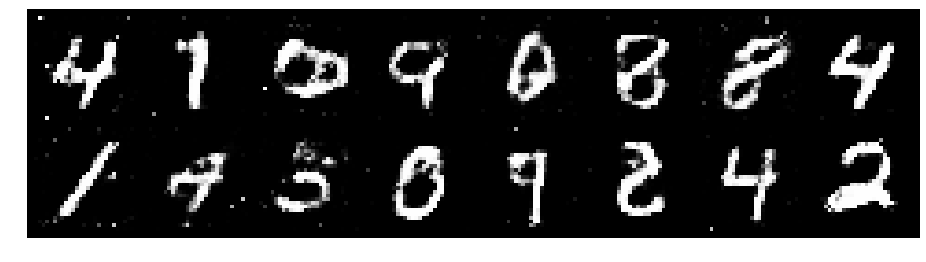

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2419, Generator Loss: 1.1344
D(x): 0.5346, D(G(z)): 0.4085


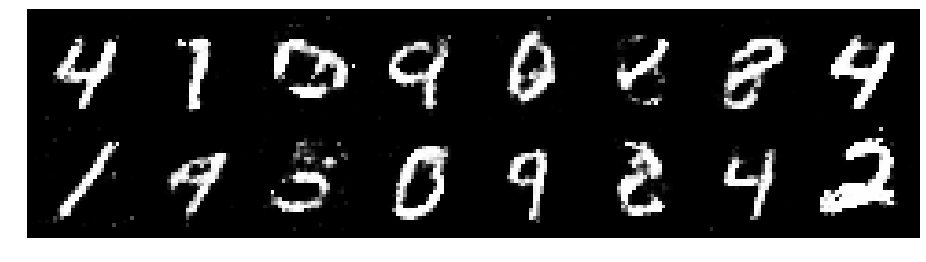

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2132, Generator Loss: 0.9389
D(x): 0.5449, D(G(z)): 0.4151


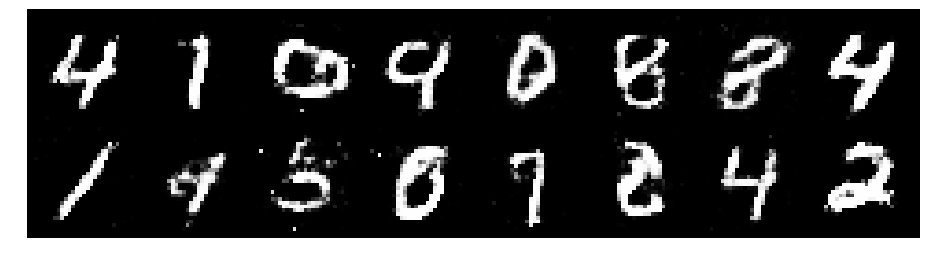

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.2965, Generator Loss: 0.8907
D(x): 0.5618, D(G(z)): 0.4520


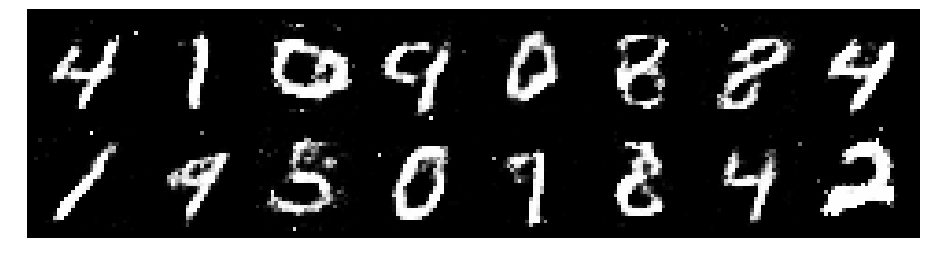

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2327, Generator Loss: 0.9422
D(x): 0.6167, D(G(z)): 0.4765


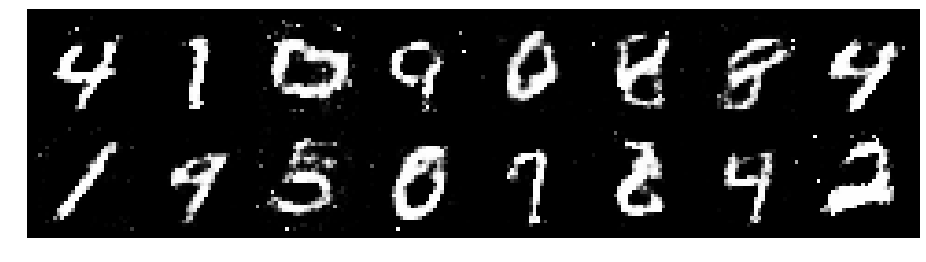

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2911, Generator Loss: 0.8664
D(x): 0.5454, D(G(z)): 0.4530


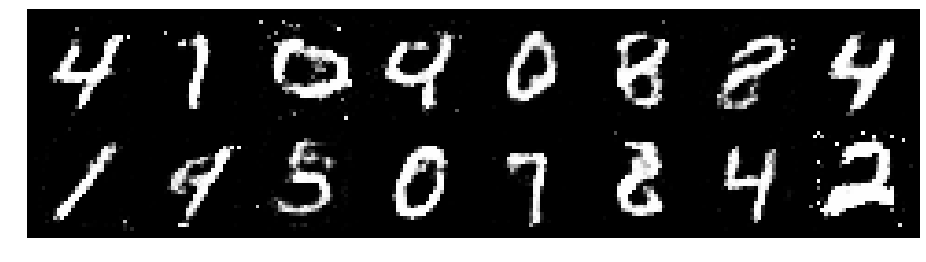

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2691, Generator Loss: 0.8842
D(x): 0.5570, D(G(z)): 0.4547


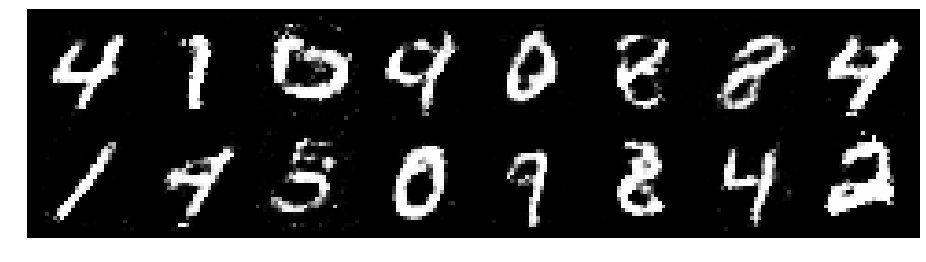

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2189, Generator Loss: 0.9301
D(x): 0.5746, D(G(z)): 0.4229


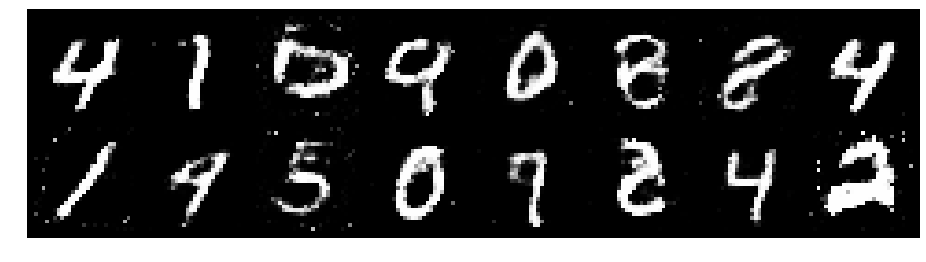

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.3336, Generator Loss: 0.9657
D(x): 0.5179, D(G(z)): 0.4406


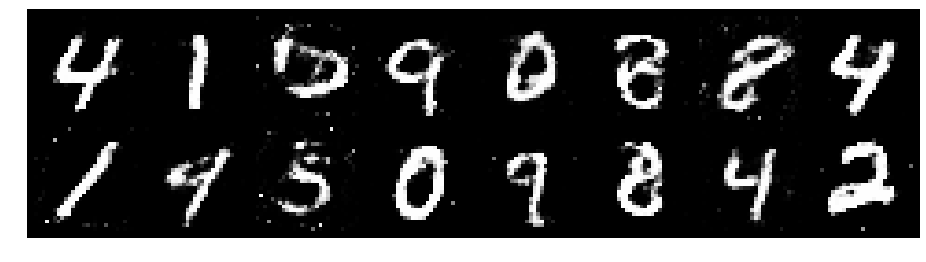

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2626, Generator Loss: 0.9078
D(x): 0.5520, D(G(z)): 0.4511


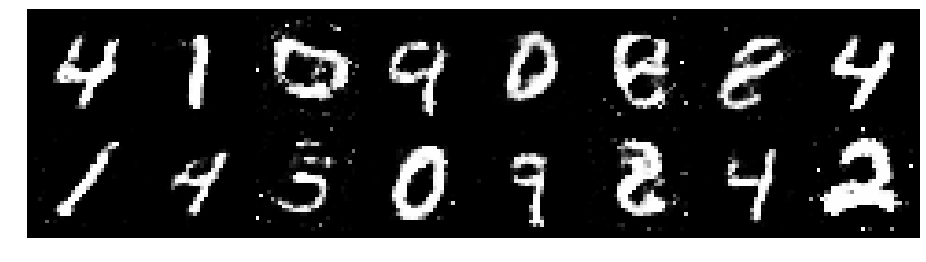

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.3992, Generator Loss: 0.9049
D(x): 0.5009, D(G(z)): 0.4467


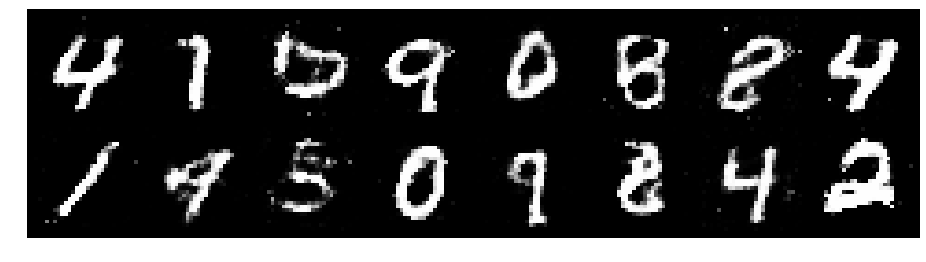

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2385, Generator Loss: 0.9334
D(x): 0.5548, D(G(z)): 0.4272


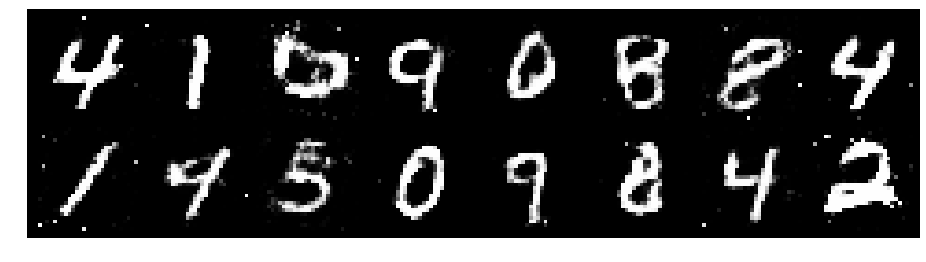

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.4524, Generator Loss: 0.8003
D(x): 0.5617, D(G(z)): 0.5011


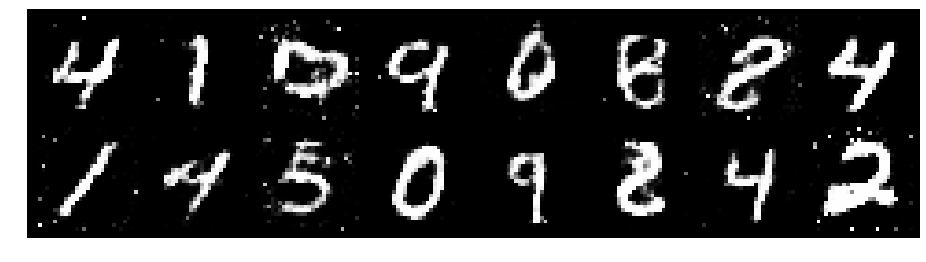

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.1642, Generator Loss: 0.9260
D(x): 0.5991, D(G(z)): 0.4026


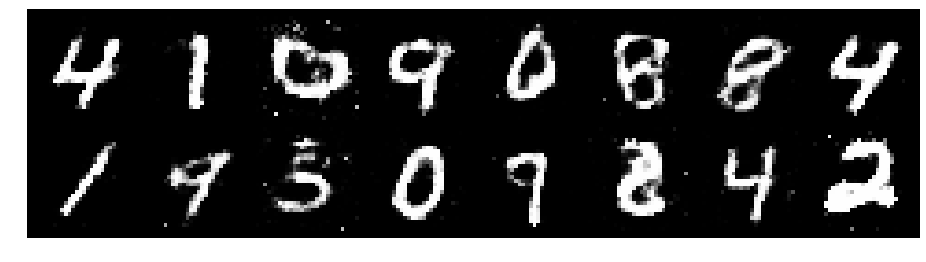

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2523, Generator Loss: 1.0261
D(x): 0.5215, D(G(z)): 0.3620


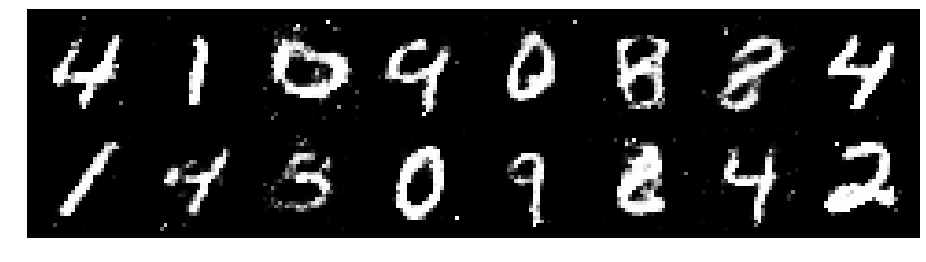

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.1272, Generator Loss: 0.7990
D(x): 0.6163, D(G(z)): 0.4344


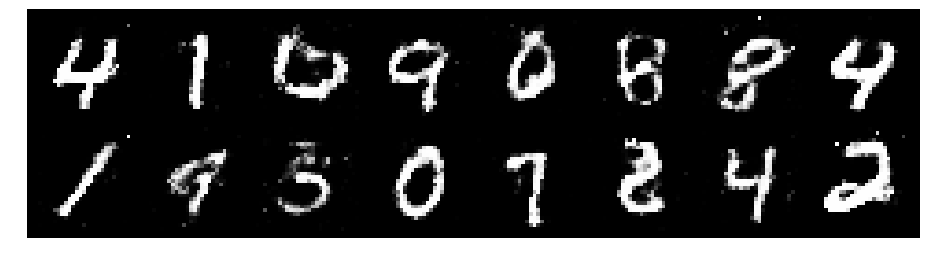

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.3400, Generator Loss: 0.9526
D(x): 0.5104, D(G(z)): 0.4418


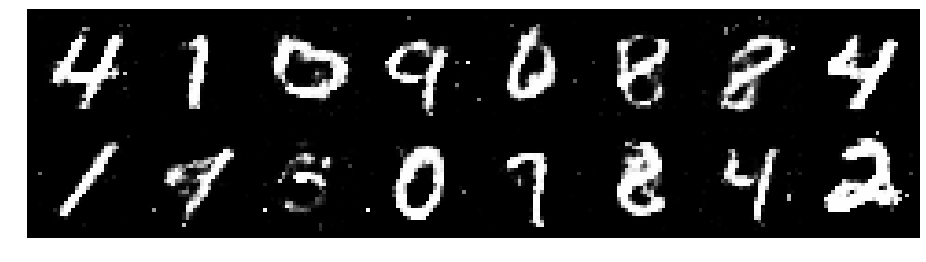

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2925, Generator Loss: 0.7940
D(x): 0.5558, D(G(z)): 0.4575


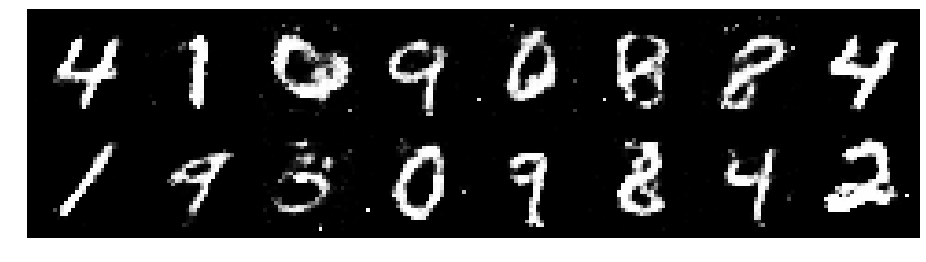

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2842, Generator Loss: 1.0282
D(x): 0.5909, D(G(z)): 0.4415


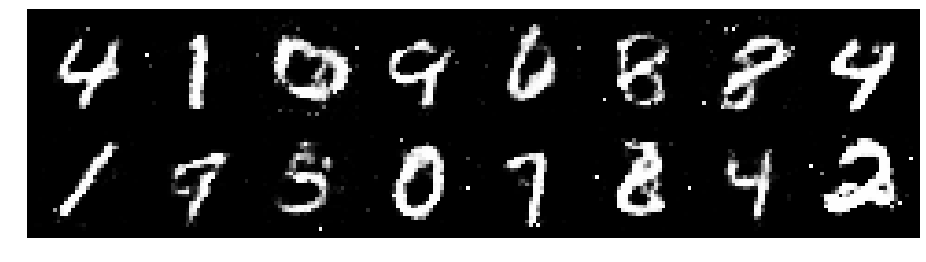

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.1734, Generator Loss: 1.1228
D(x): 0.5804, D(G(z)): 0.3913


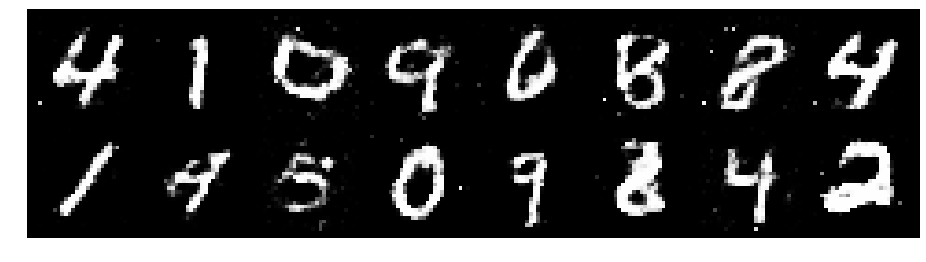

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.1365, Generator Loss: 0.9201
D(x): 0.6059, D(G(z)): 0.4099


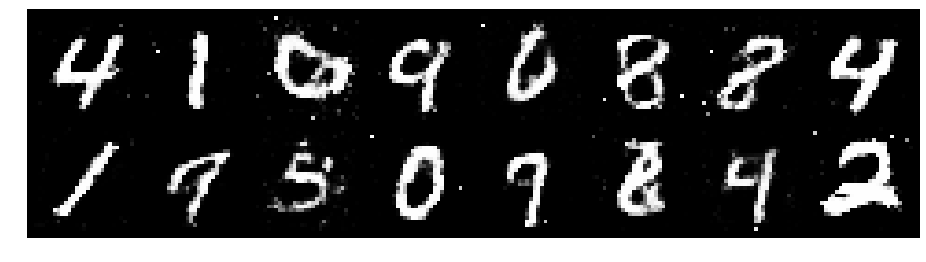

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.3342, Generator Loss: 0.8677
D(x): 0.5590, D(G(z)): 0.4743


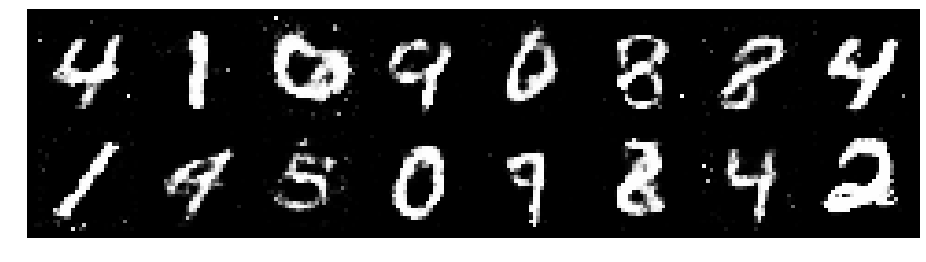

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2326, Generator Loss: 0.8714
D(x): 0.5405, D(G(z)): 0.4145


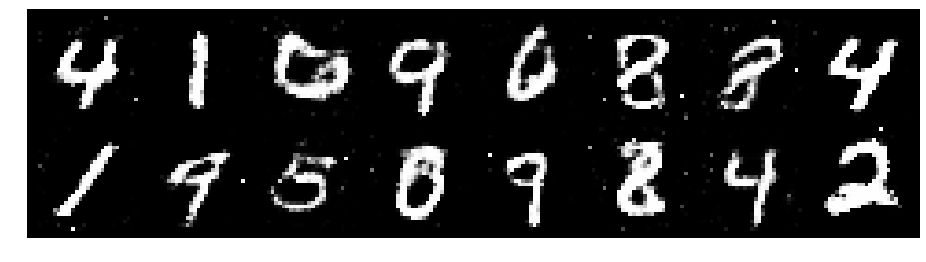

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2599, Generator Loss: 0.8618
D(x): 0.5609, D(G(z)): 0.4452


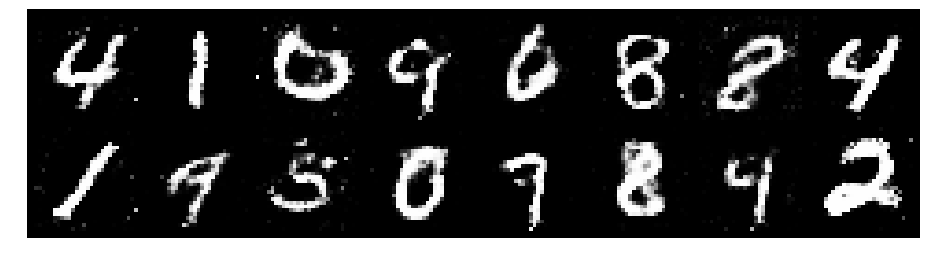

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.3558, Generator Loss: 0.8006
D(x): 0.5656, D(G(z)): 0.5041


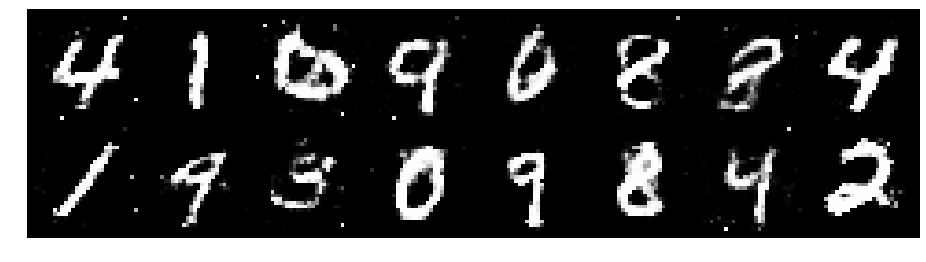

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2396, Generator Loss: 1.0705
D(x): 0.5116, D(G(z)): 0.3728


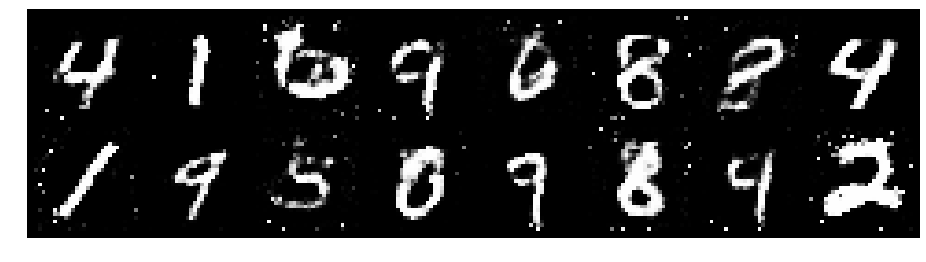

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1106, Generator Loss: 0.9442
D(x): 0.5782, D(G(z)): 0.3955


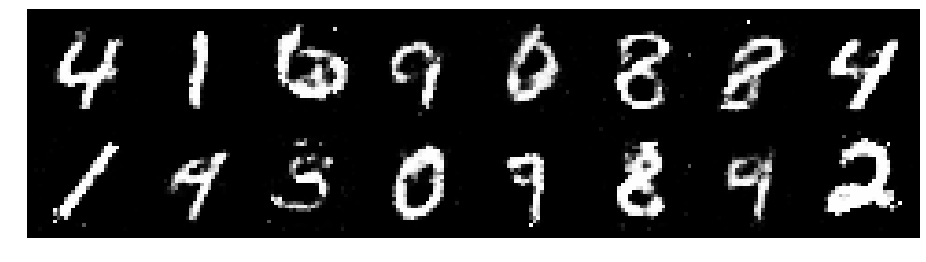

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.0399, Generator Loss: 1.0843
D(x): 0.6192, D(G(z)): 0.3894


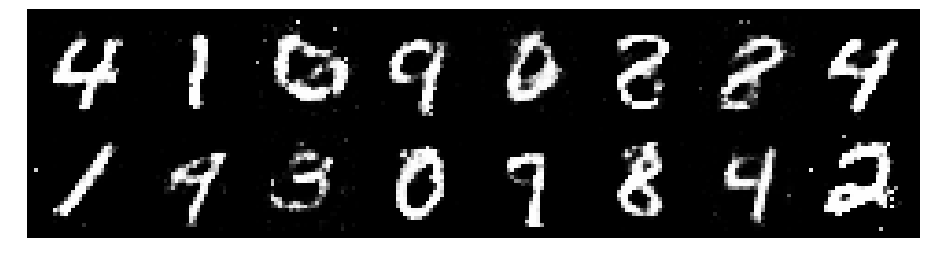

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.1613, Generator Loss: 1.1643
D(x): 0.5640, D(G(z)): 0.3941


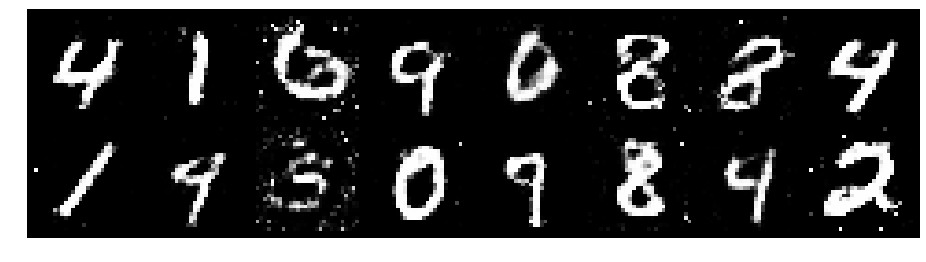

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.1745, Generator Loss: 0.9228
D(x): 0.5707, D(G(z)): 0.4022


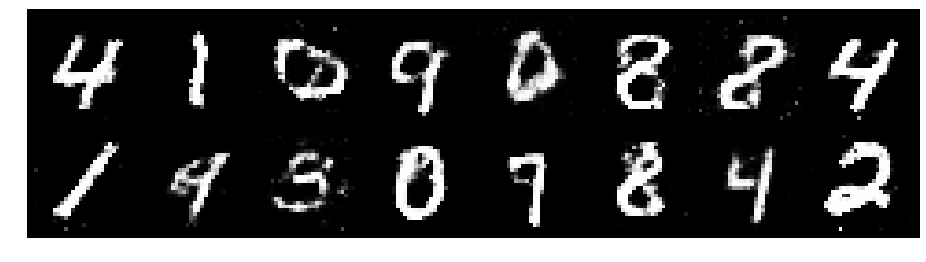

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.3178, Generator Loss: 0.9180
D(x): 0.5428, D(G(z)): 0.4466


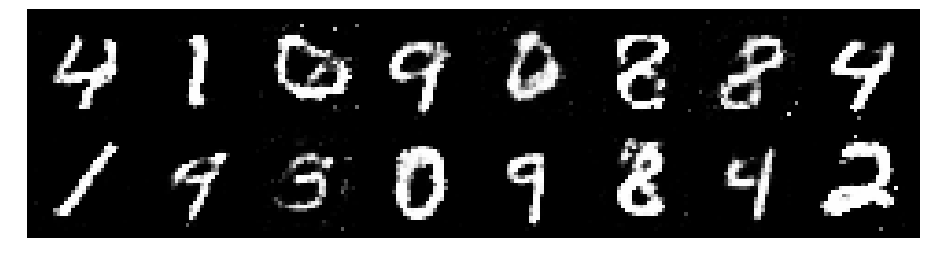

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.3943, Generator Loss: 0.9215
D(x): 0.5564, D(G(z)): 0.4934


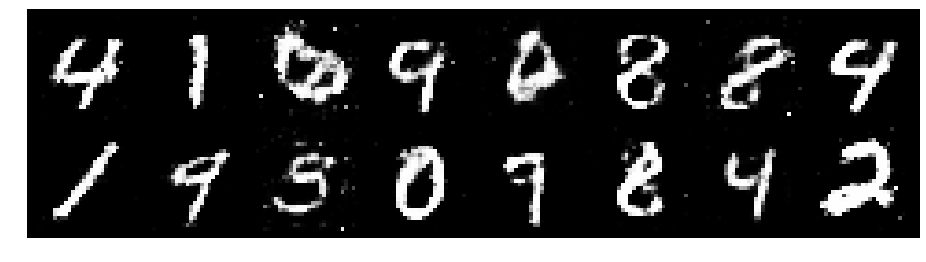

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2271, Generator Loss: 0.9088
D(x): 0.5724, D(G(z)): 0.4317


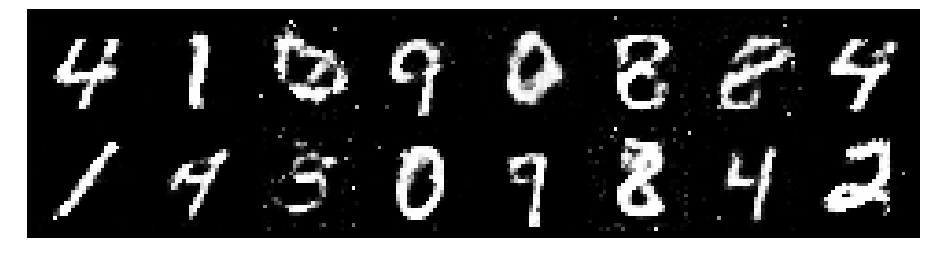

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2401, Generator Loss: 0.9717
D(x): 0.6082, D(G(z)): 0.4580


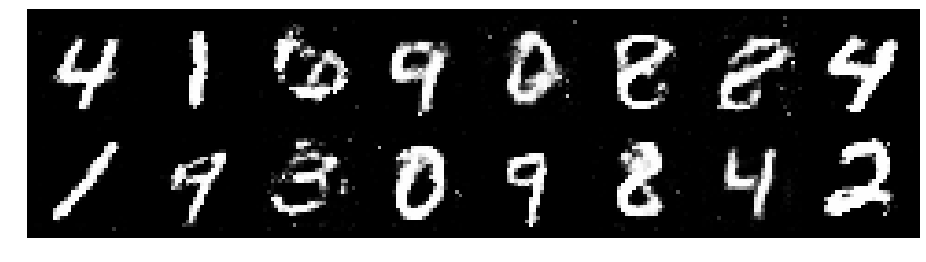

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2024, Generator Loss: 0.9966
D(x): 0.5815, D(G(z)): 0.4091


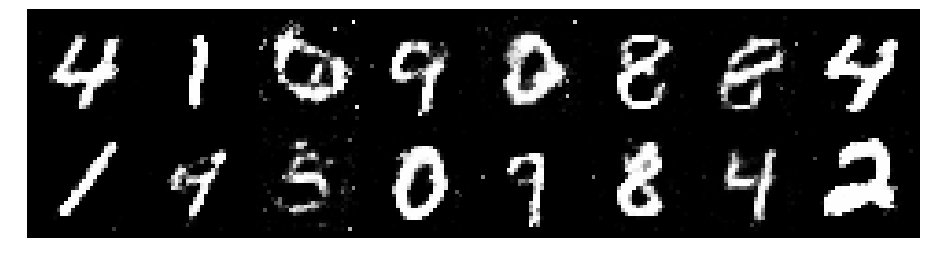

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2952, Generator Loss: 0.8304
D(x): 0.5559, D(G(z)): 0.4491


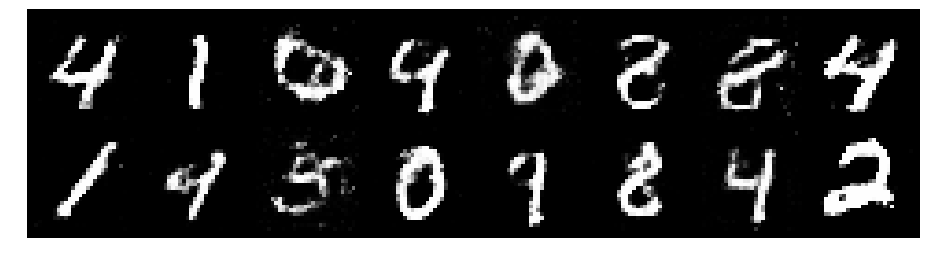

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2710, Generator Loss: 0.8314
D(x): 0.5372, D(G(z)): 0.4505


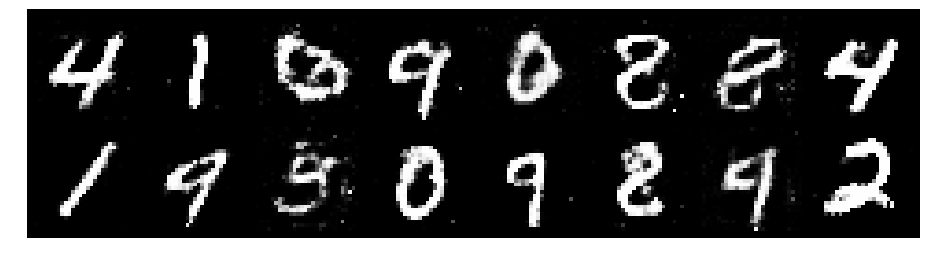

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2915, Generator Loss: 0.8722
D(x): 0.5591, D(G(z)): 0.4556


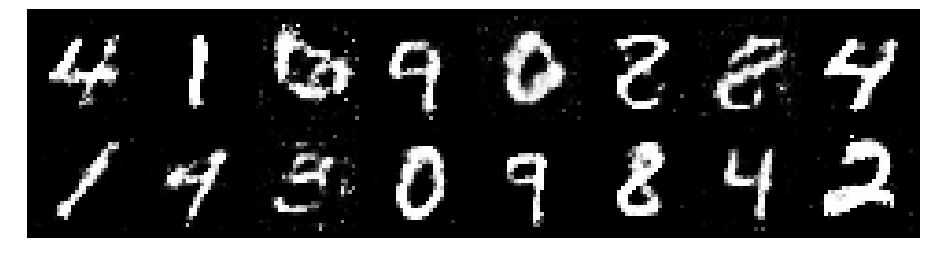

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2461, Generator Loss: 1.0627
D(x): 0.5160, D(G(z)): 0.3844


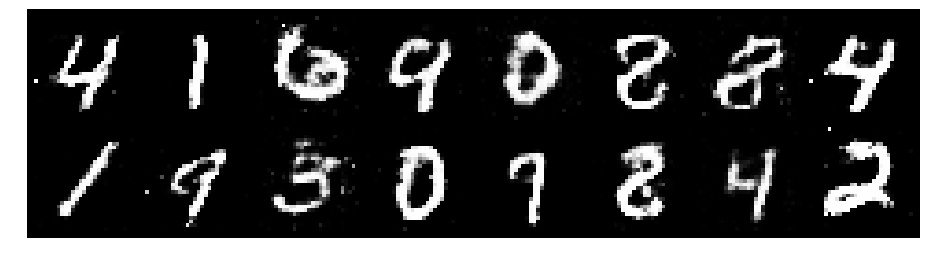

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.0811, Generator Loss: 1.0567
D(x): 0.6049, D(G(z)): 0.3773


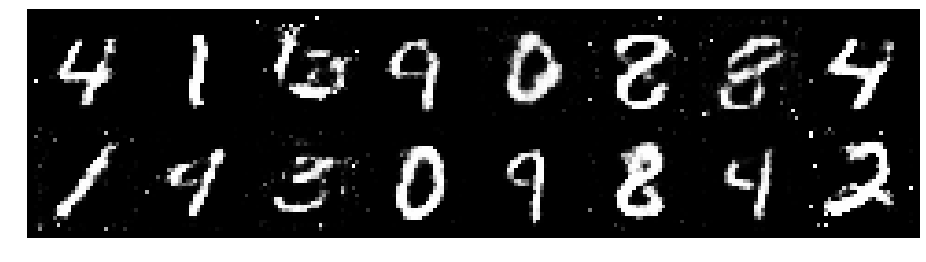

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.3713, Generator Loss: 0.8659
D(x): 0.5306, D(G(z)): 0.4839


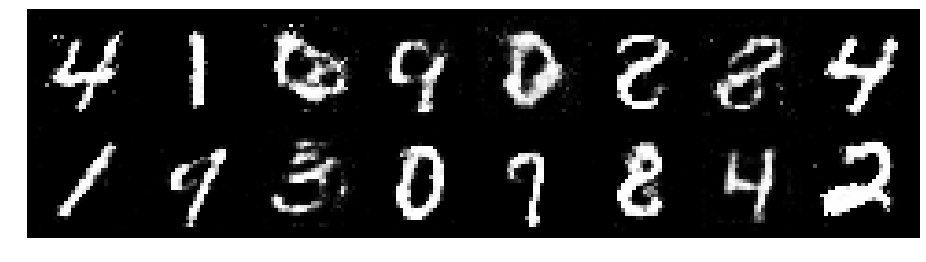

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.3478, Generator Loss: 0.9037
D(x): 0.5237, D(G(z)): 0.4510


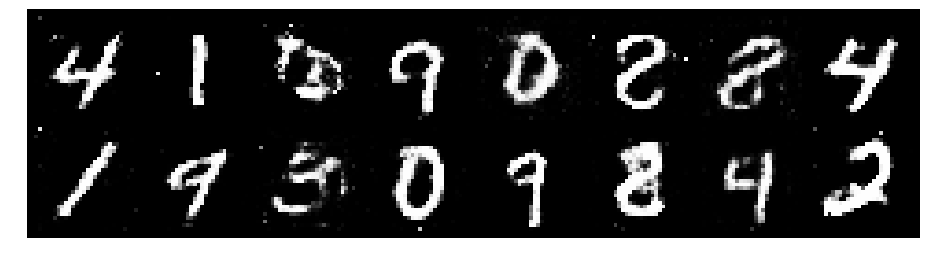

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2089, Generator Loss: 1.0834
D(x): 0.5653, D(G(z)): 0.4190


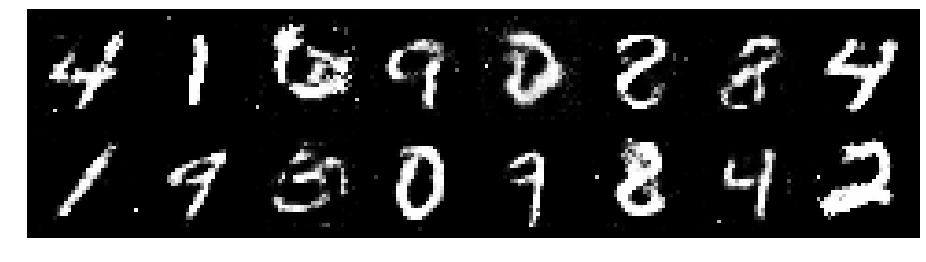

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2202, Generator Loss: 1.0580
D(x): 0.5762, D(G(z)): 0.4115


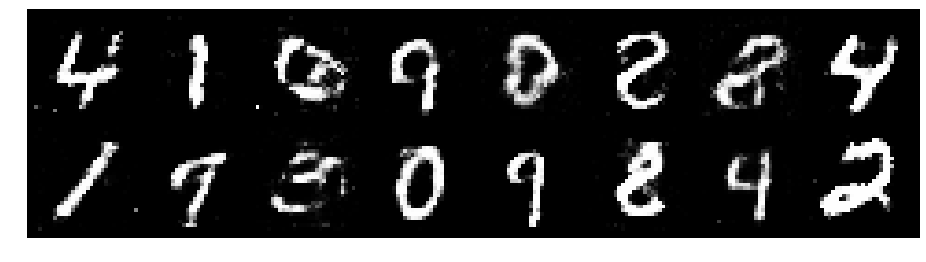

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.1857, Generator Loss: 0.8578
D(x): 0.5953, D(G(z)): 0.4509


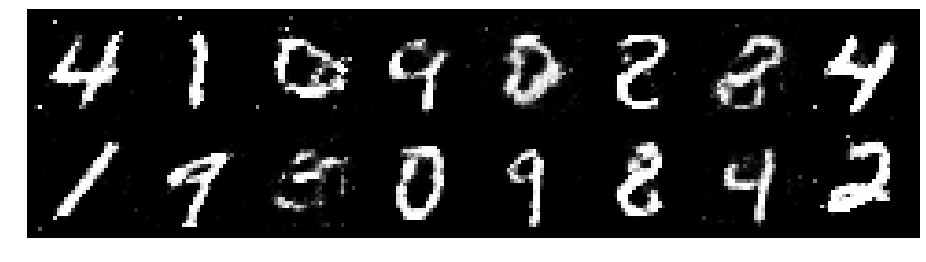

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.3513, Generator Loss: 0.8829
D(x): 0.5033, D(G(z)): 0.4388


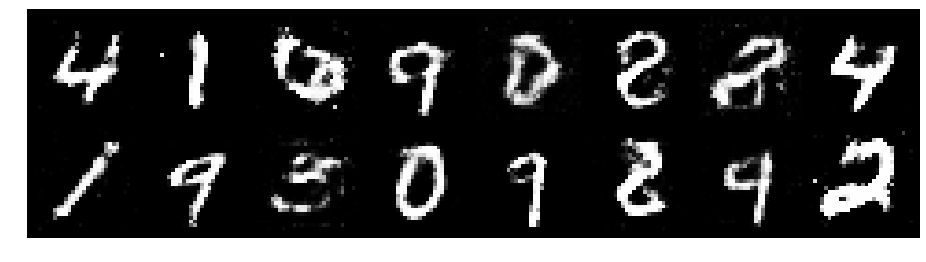

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.3328, Generator Loss: 0.8749
D(x): 0.5271, D(G(z)): 0.4611


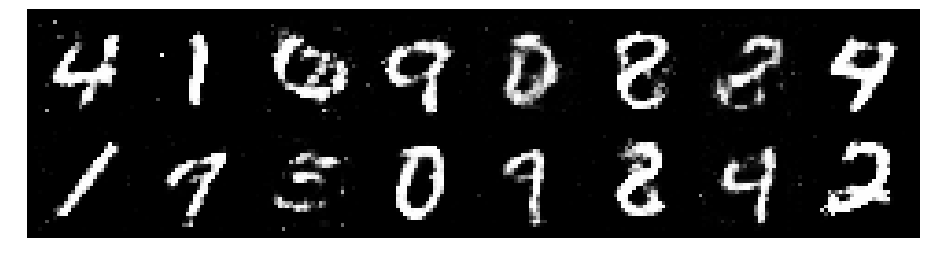

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.4361, Generator Loss: 0.7648
D(x): 0.5280, D(G(z)): 0.4854


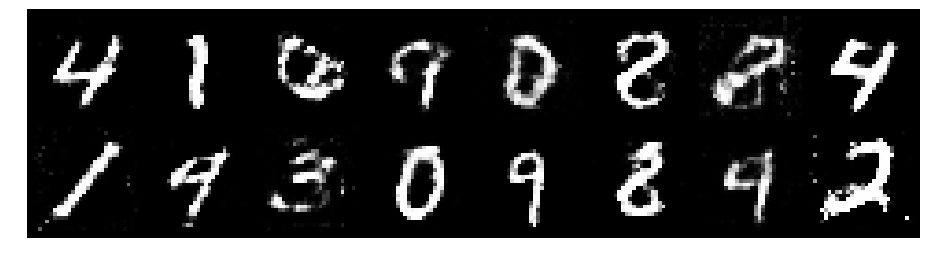

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.1970, Generator Loss: 1.0168
D(x): 0.5963, D(G(z)): 0.4349


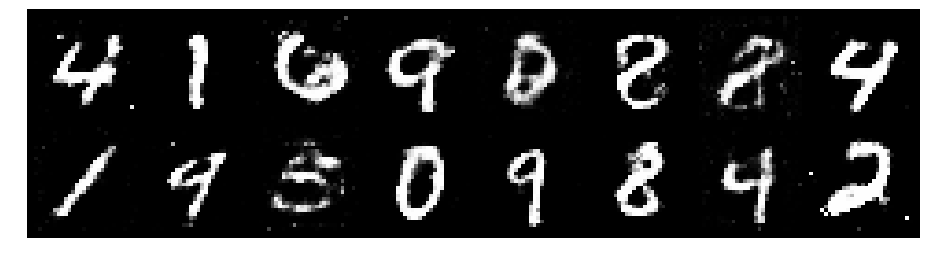

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.3002, Generator Loss: 0.9982
D(x): 0.5644, D(G(z)): 0.4537


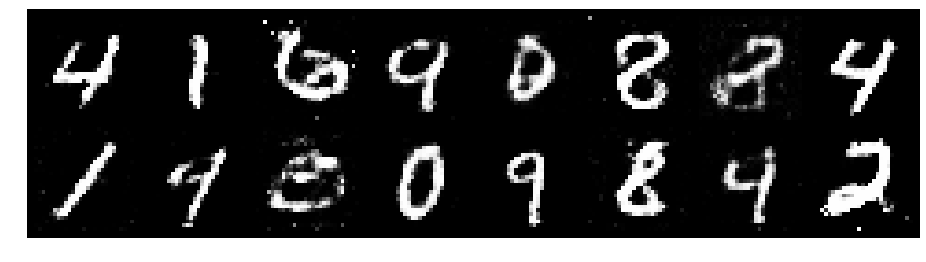

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2659, Generator Loss: 0.9633
D(x): 0.5239, D(G(z)): 0.3966


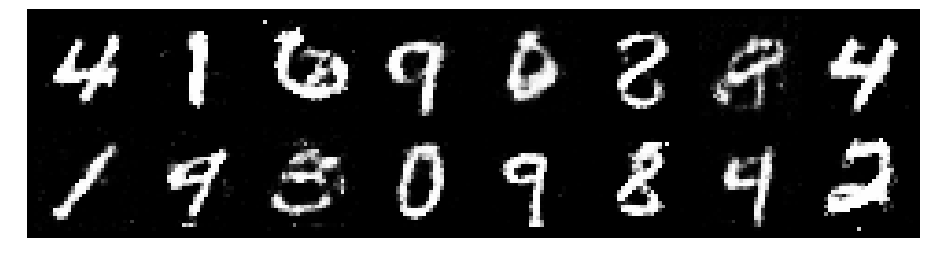

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.0366, Generator Loss: 1.0806
D(x): 0.6424, D(G(z)): 0.4021


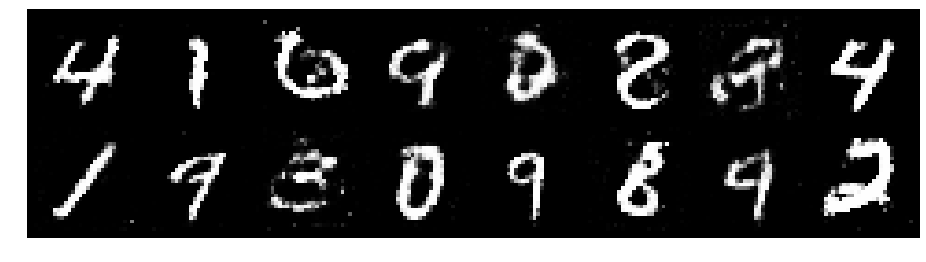

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1507, Generator Loss: 0.9557
D(x): 0.6080, D(G(z)): 0.4354


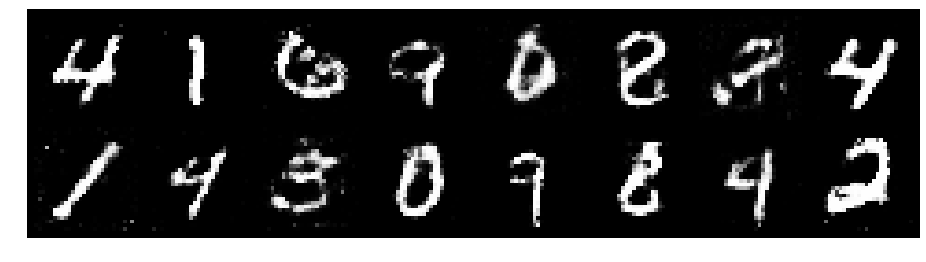

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.1270, Generator Loss: 0.8545
D(x): 0.6199, D(G(z)): 0.4277


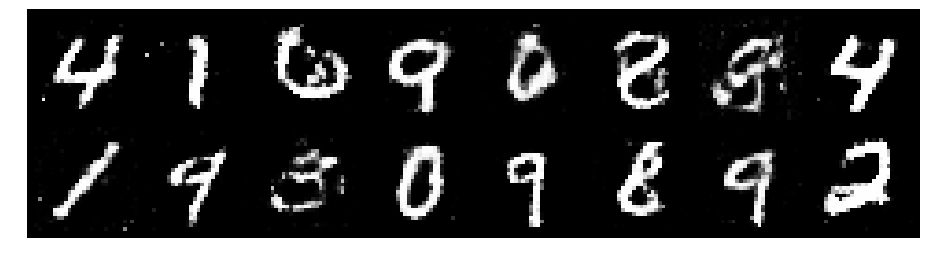

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2915, Generator Loss: 0.8443
D(x): 0.5426, D(G(z)): 0.4524


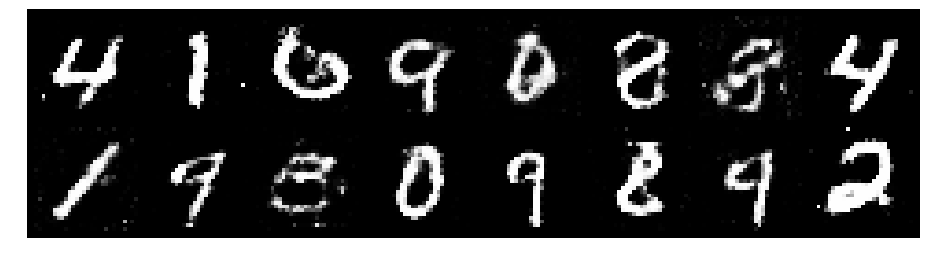

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.3100, Generator Loss: 0.8026
D(x): 0.5771, D(G(z)): 0.4876


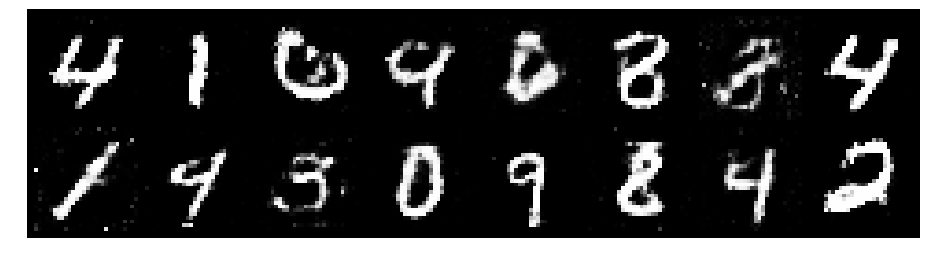

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.1587, Generator Loss: 0.8260
D(x): 0.6181, D(G(z)): 0.4412


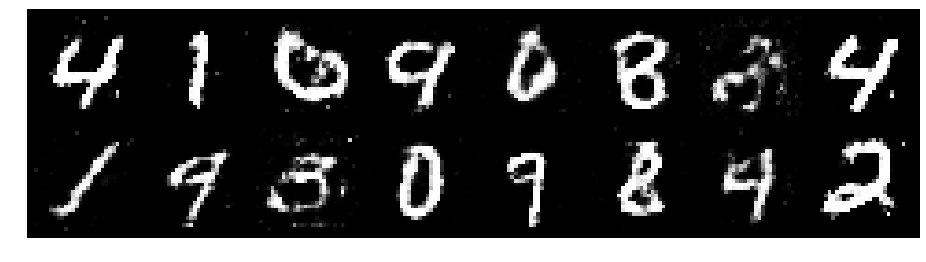

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.1835, Generator Loss: 0.9854
D(x): 0.5773, D(G(z)): 0.4194


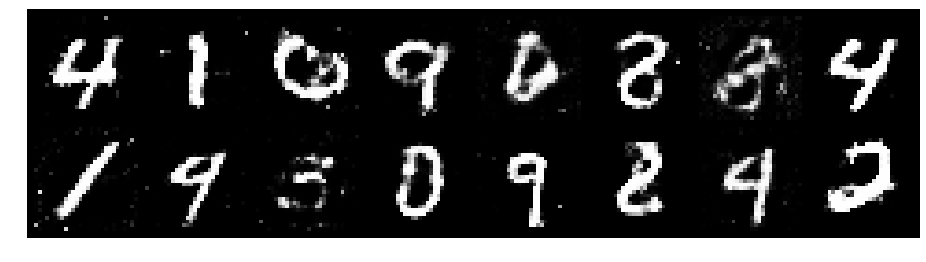

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1796, Generator Loss: 0.9111
D(x): 0.6088, D(G(z)): 0.4448


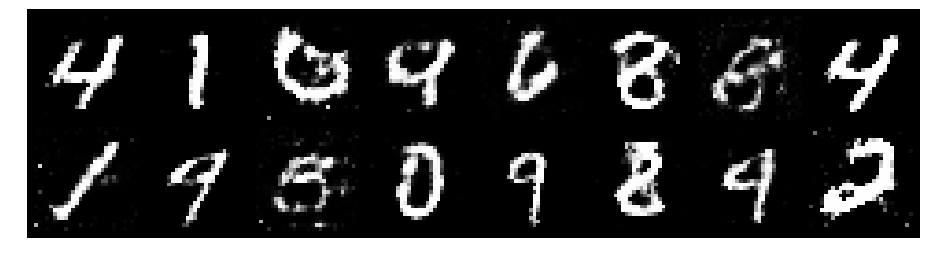

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2295, Generator Loss: 0.8460
D(x): 0.5547, D(G(z)): 0.4270


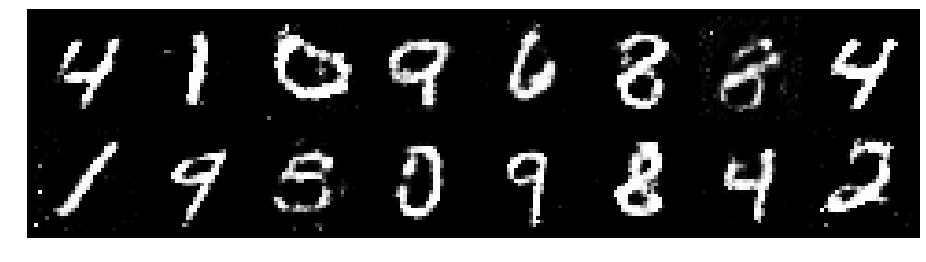

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2176, Generator Loss: 0.9347
D(x): 0.5533, D(G(z)): 0.4173


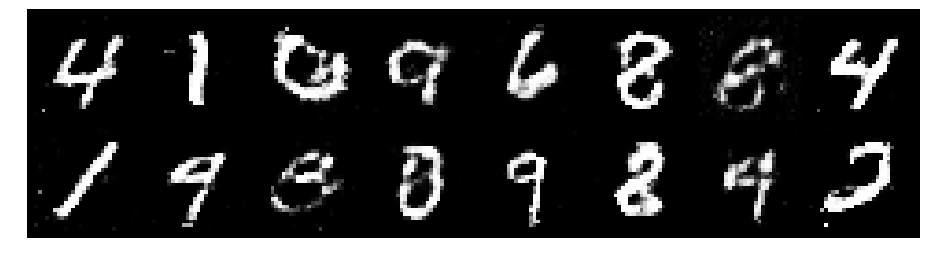

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.3867, Generator Loss: 0.8032
D(x): 0.5358, D(G(z)): 0.4731


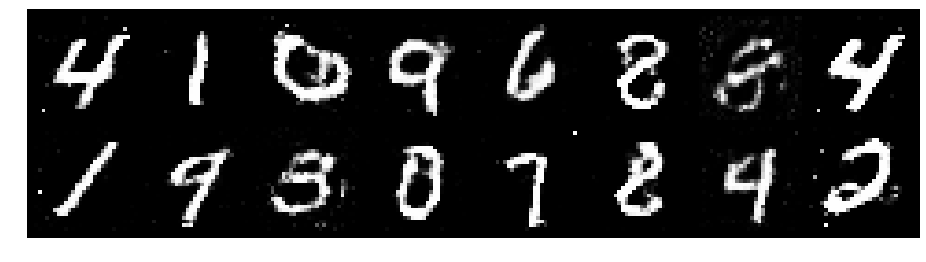

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.2621, Generator Loss: 1.2764
D(x): 0.5565, D(G(z)): 0.3818


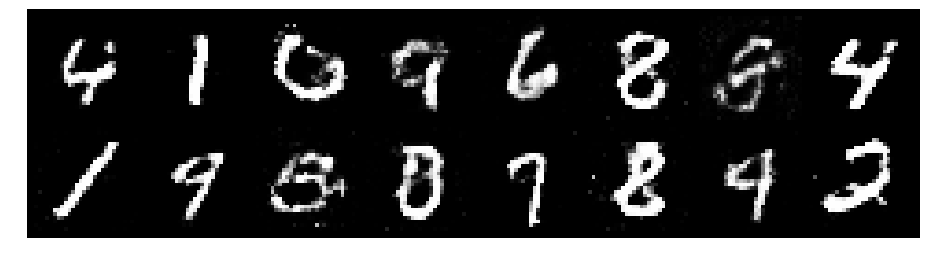

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.0427, Generator Loss: 1.0373
D(x): 0.6143, D(G(z)): 0.3528


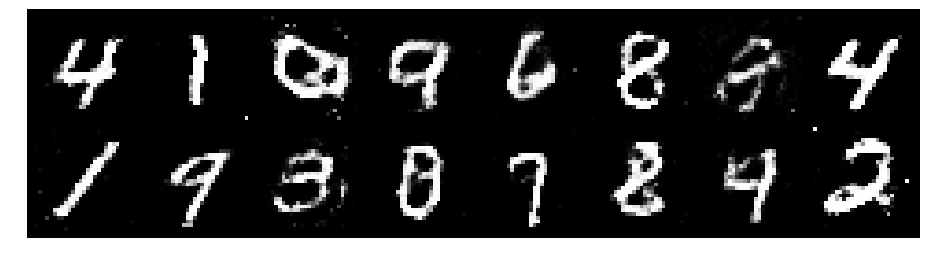

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.0229, Generator Loss: 1.0652
D(x): 0.6055, D(G(z)): 0.3453


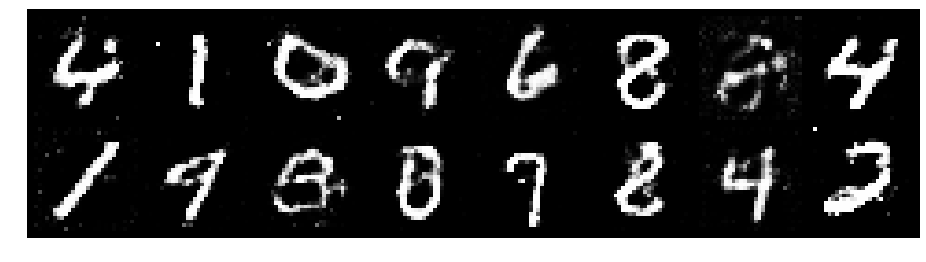

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.0899, Generator Loss: 0.9422
D(x): 0.6153, D(G(z)): 0.4046


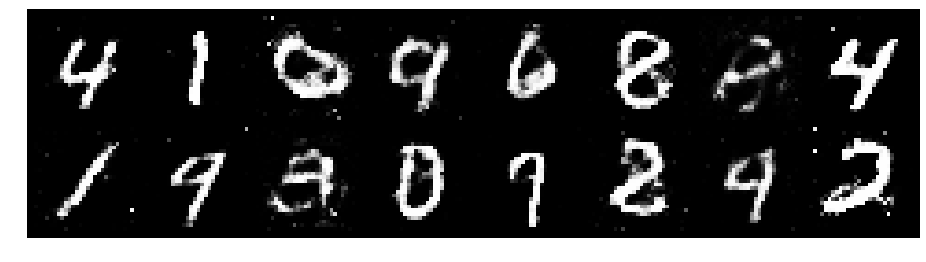

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.1569, Generator Loss: 0.8726
D(x): 0.5833, D(G(z)): 0.4171


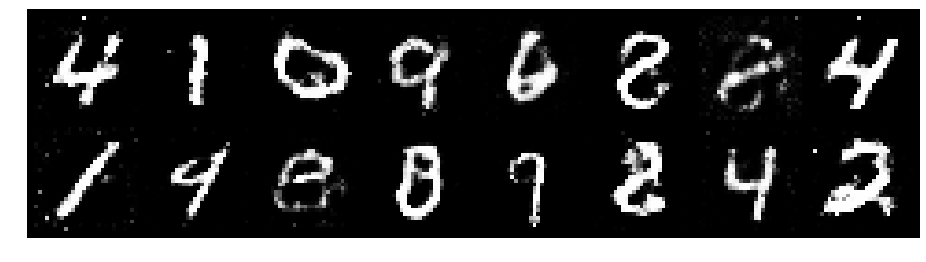

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.1995, Generator Loss: 0.9978
D(x): 0.5925, D(G(z)): 0.4348


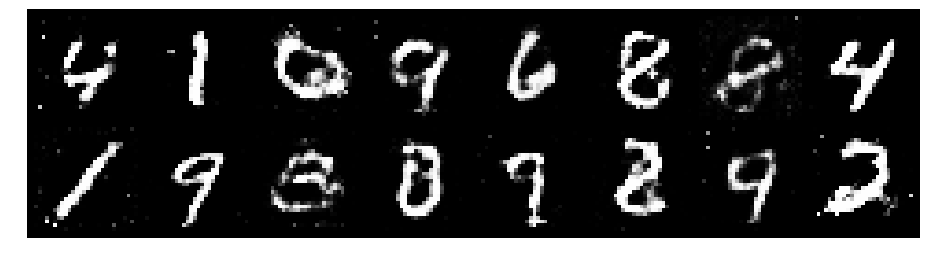

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3856, Generator Loss: 0.8308
D(x): 0.5674, D(G(z)): 0.5010


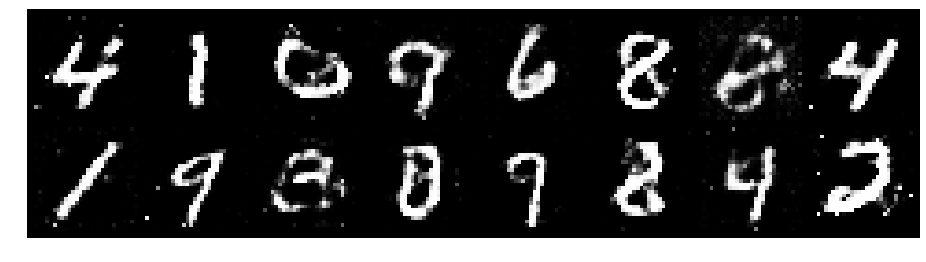

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2595, Generator Loss: 1.1200
D(x): 0.5727, D(G(z)): 0.4201


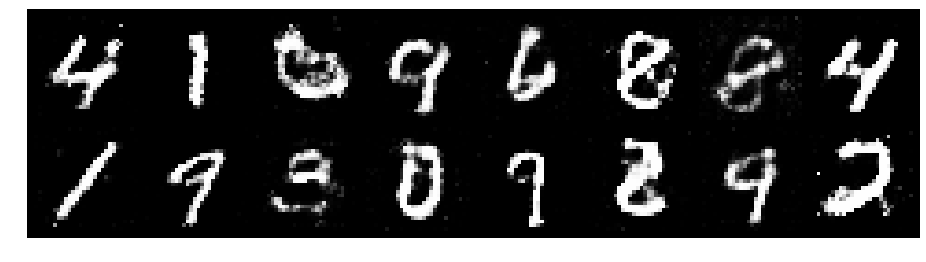

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.1555, Generator Loss: 1.0879
D(x): 0.5720, D(G(z)): 0.3701


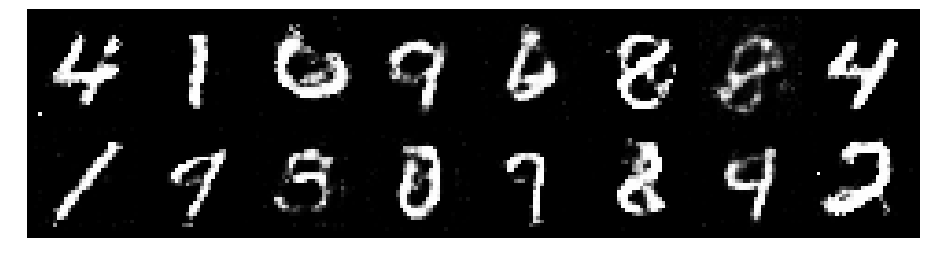

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.1695, Generator Loss: 0.9089
D(x): 0.6068, D(G(z)): 0.4315


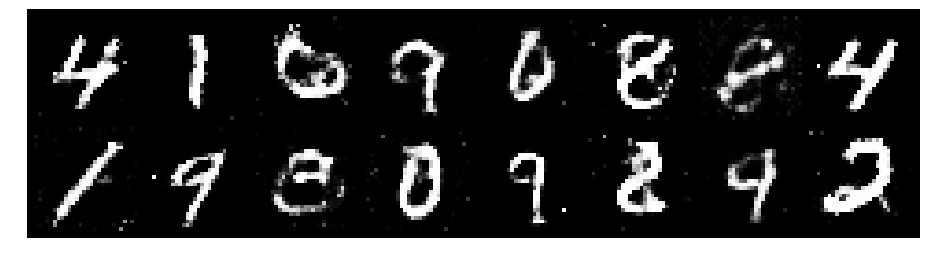

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3520, Generator Loss: 0.8761
D(x): 0.5563, D(G(z)): 0.4620


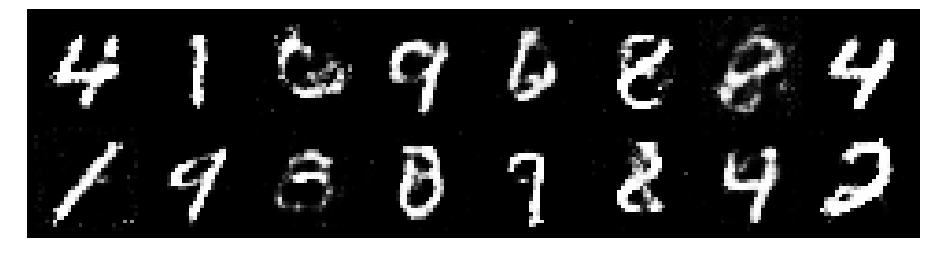

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.3181, Generator Loss: 0.8641
D(x): 0.5561, D(G(z)): 0.4566


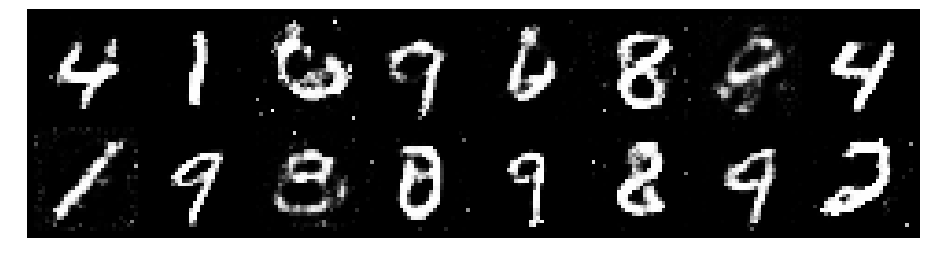

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.3183, Generator Loss: 1.0300
D(x): 0.5185, D(G(z)): 0.3808


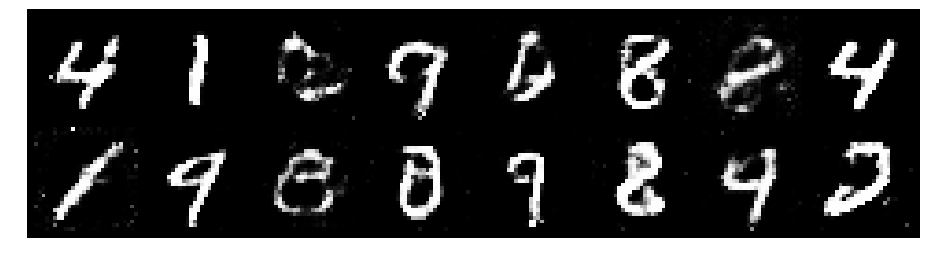

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2263, Generator Loss: 1.1115
D(x): 0.5532, D(G(z)): 0.3955


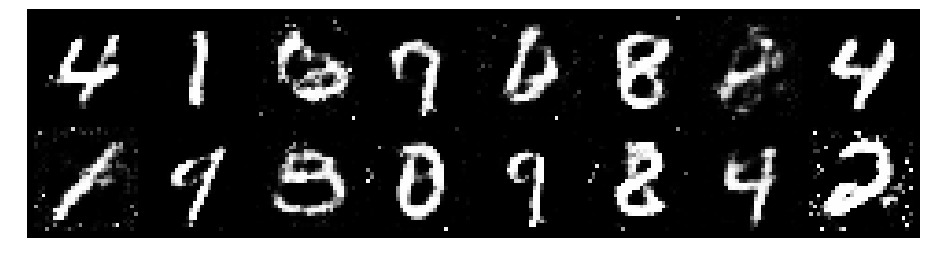

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2323, Generator Loss: 0.8905
D(x): 0.5468, D(G(z)): 0.4285


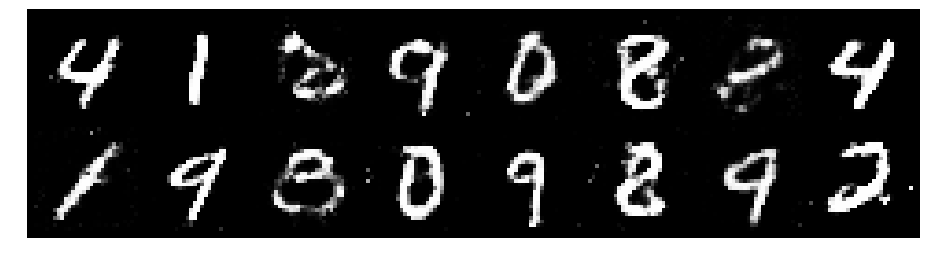

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.3474, Generator Loss: 1.0073
D(x): 0.5732, D(G(z)): 0.4679


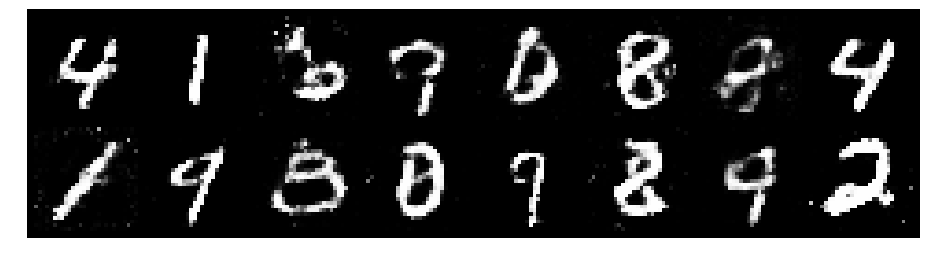

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2300, Generator Loss: 0.8689
D(x): 0.5757, D(G(z)): 0.4499


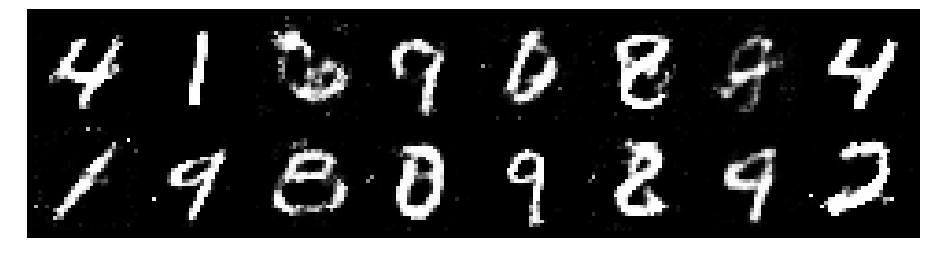

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.1701, Generator Loss: 0.9600
D(x): 0.5804, D(G(z)): 0.3803


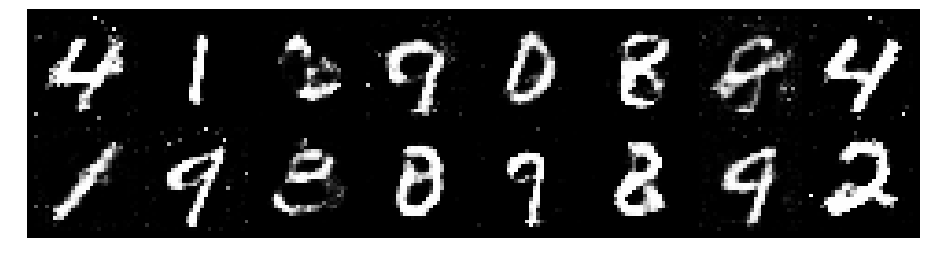

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2786, Generator Loss: 0.8312
D(x): 0.5789, D(G(z)): 0.4663


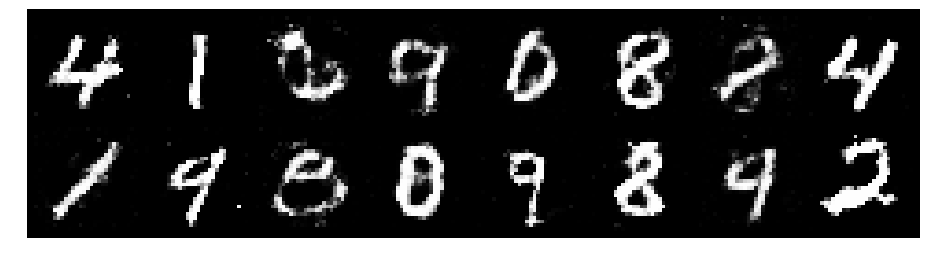

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.2612, Generator Loss: 0.8612
D(x): 0.5417, D(G(z)): 0.4420


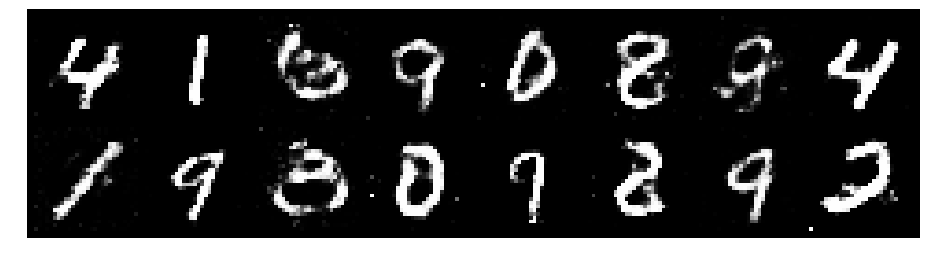

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2688, Generator Loss: 0.8648
D(x): 0.5176, D(G(z)): 0.4119


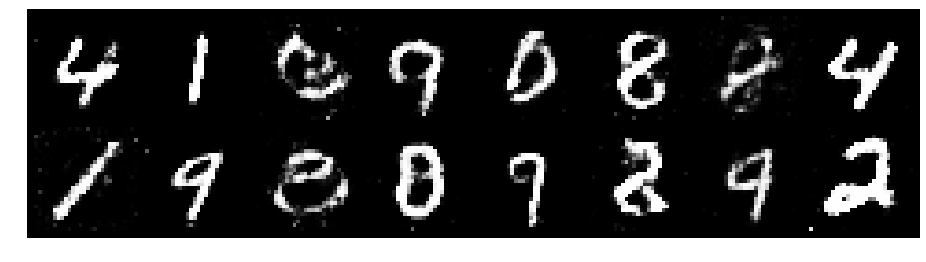

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.1914, Generator Loss: 0.8124
D(x): 0.5759, D(G(z)): 0.4337


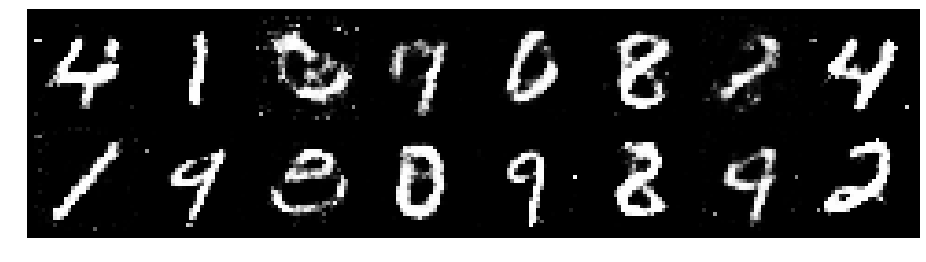

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2503, Generator Loss: 1.0713
D(x): 0.5634, D(G(z)): 0.4098


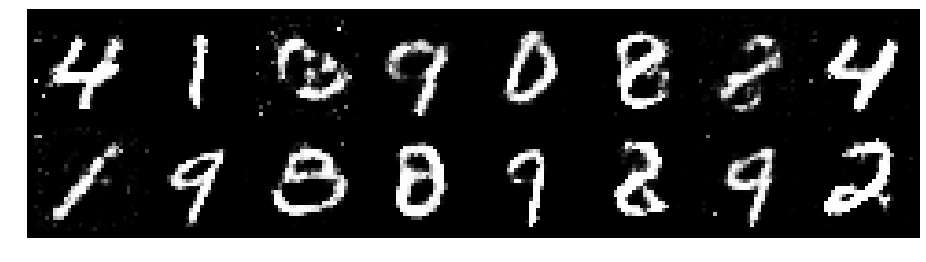

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.1436, Generator Loss: 0.9358
D(x): 0.6258, D(G(z)): 0.4199


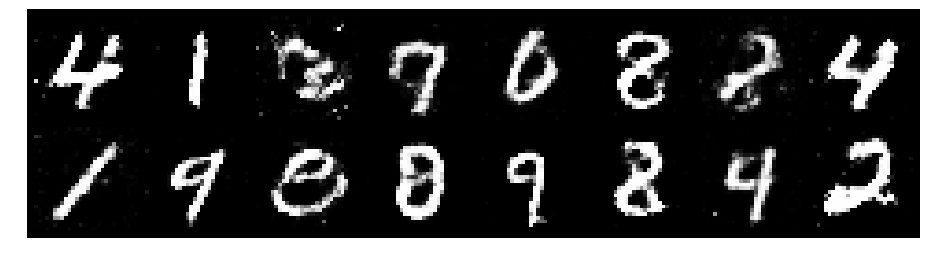

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2575, Generator Loss: 1.0720
D(x): 0.5830, D(G(z)): 0.4377


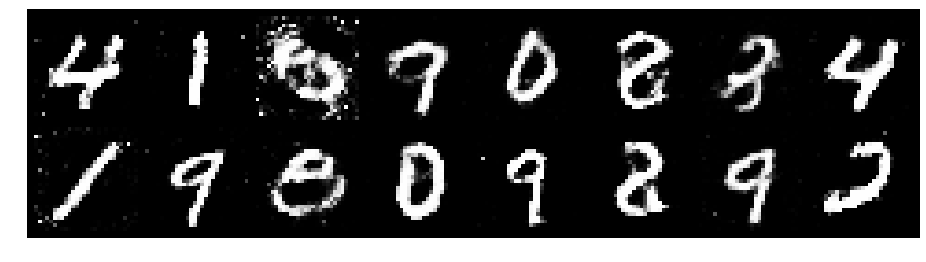

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2936, Generator Loss: 0.8456
D(x): 0.5627, D(G(z)): 0.4657


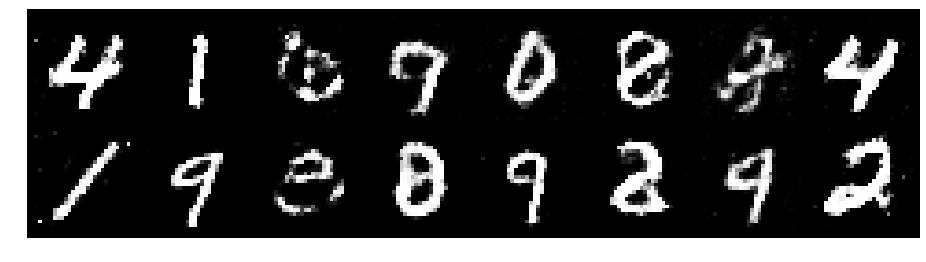

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.3143, Generator Loss: 0.7345
D(x): 0.5586, D(G(z)): 0.4746


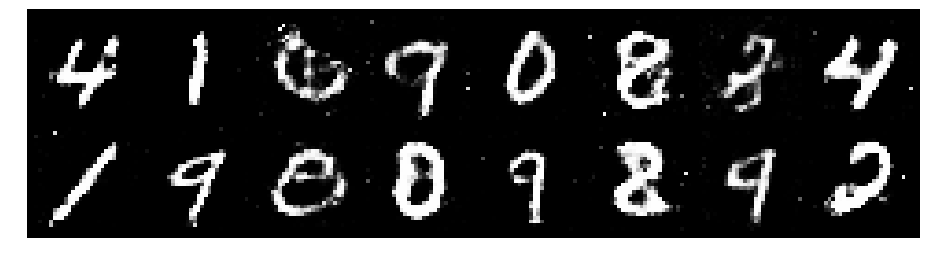

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.4336, Generator Loss: 0.8695
D(x): 0.5073, D(G(z)): 0.4511


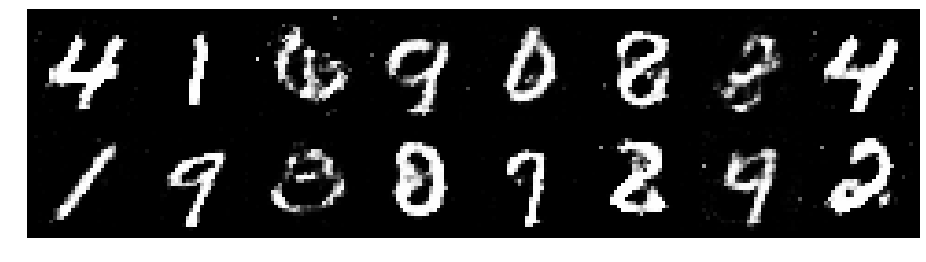

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2802, Generator Loss: 0.8856
D(x): 0.5882, D(G(z)): 0.4771


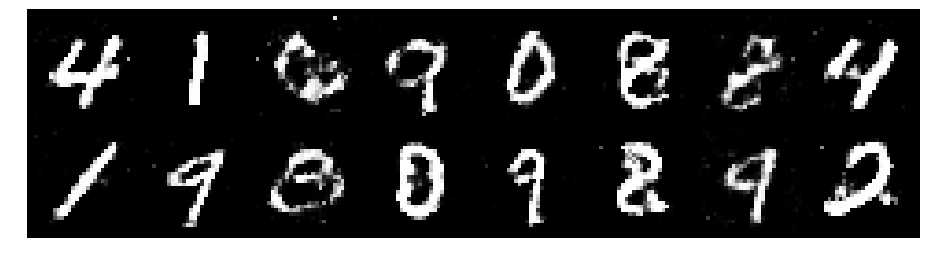

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2036, Generator Loss: 1.0578
D(x): 0.6166, D(G(z)): 0.4538


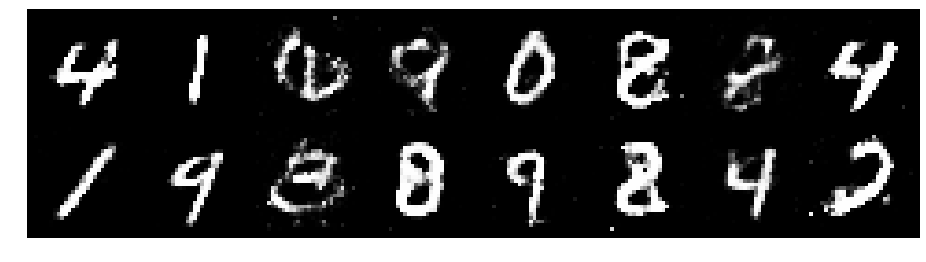

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.1240, Generator Loss: 1.0725
D(x): 0.6259, D(G(z)): 0.4037


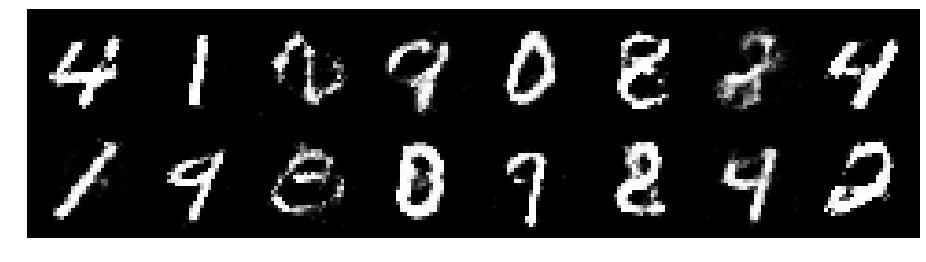

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.1795, Generator Loss: 0.9086
D(x): 0.5673, D(G(z)): 0.4191


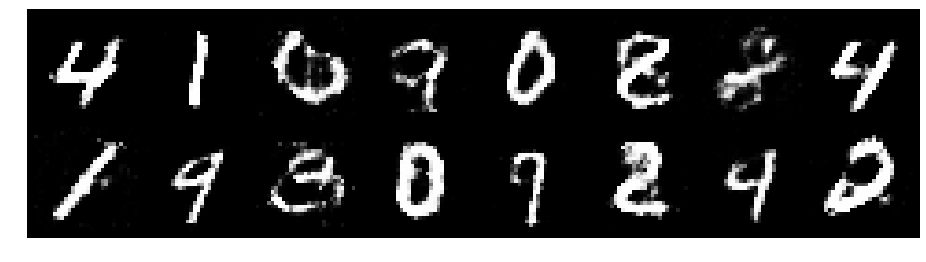

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2571, Generator Loss: 0.9611
D(x): 0.5259, D(G(z)): 0.4245


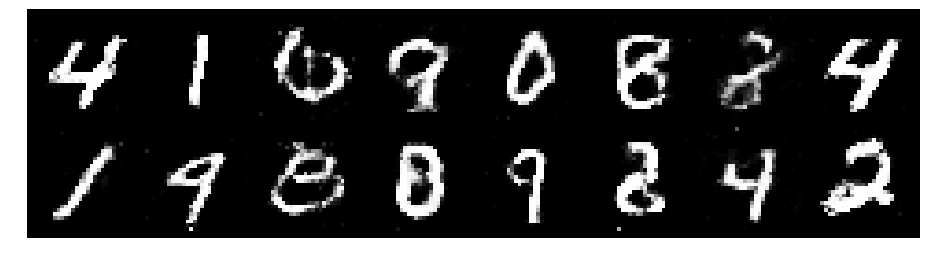

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.1928, Generator Loss: 0.9640
D(x): 0.6156, D(G(z)): 0.4414


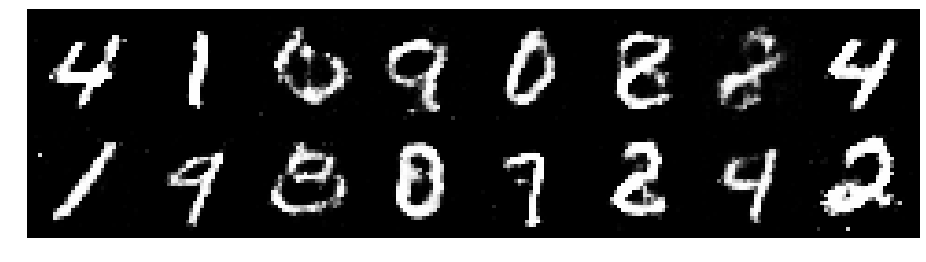

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3217, Generator Loss: 1.0544
D(x): 0.5893, D(G(z)): 0.4650


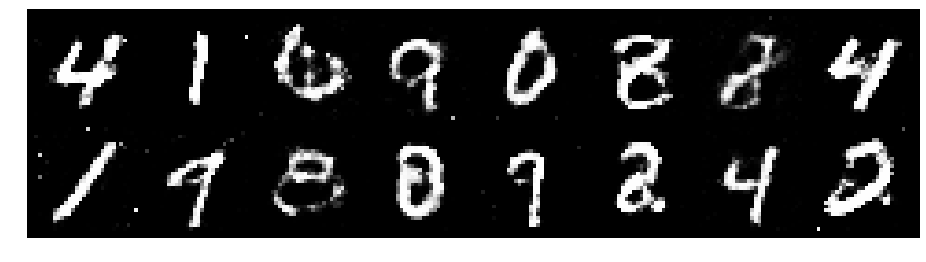

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.1136, Generator Loss: 1.1106
D(x): 0.6112, D(G(z)): 0.4094


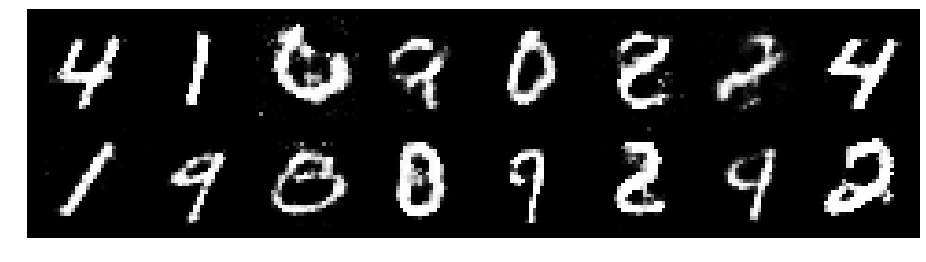

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.1533, Generator Loss: 0.9335
D(x): 0.5706, D(G(z)): 0.3955


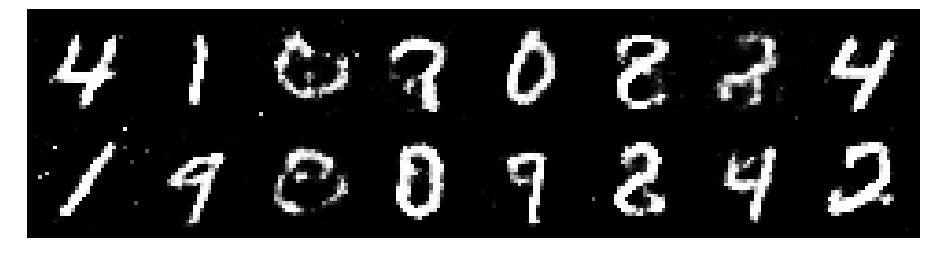

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.1750, Generator Loss: 0.9947
D(x): 0.6136, D(G(z)): 0.4220


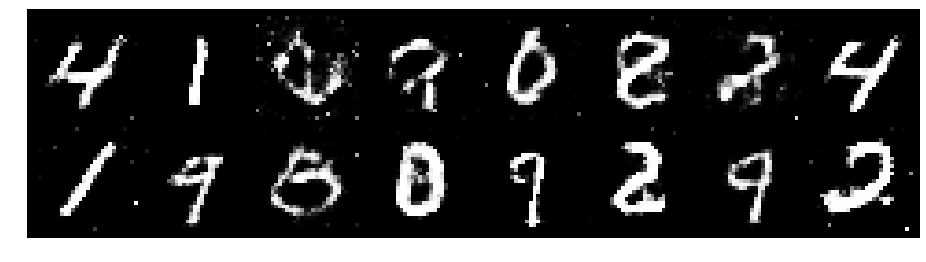

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.1592, Generator Loss: 1.0042
D(x): 0.6019, D(G(z)): 0.4080


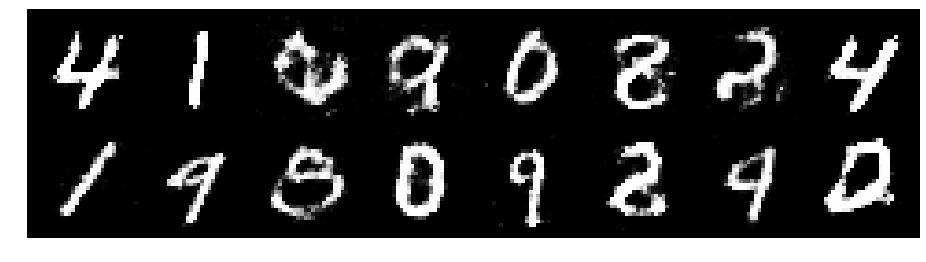

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.1709, Generator Loss: 1.0980
D(x): 0.5649, D(G(z)): 0.4037


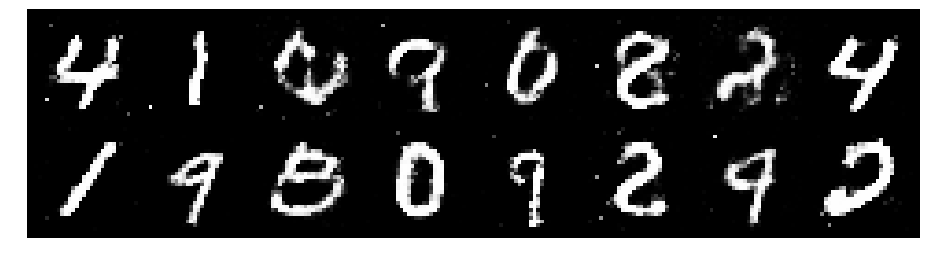

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2424, Generator Loss: 0.9743
D(x): 0.5490, D(G(z)): 0.4191


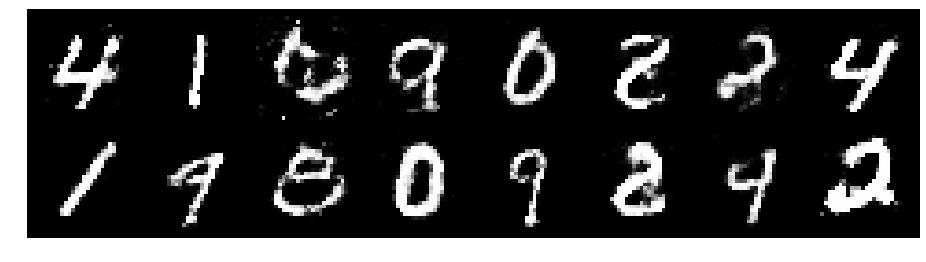

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.1707, Generator Loss: 0.9237
D(x): 0.6062, D(G(z)): 0.4381


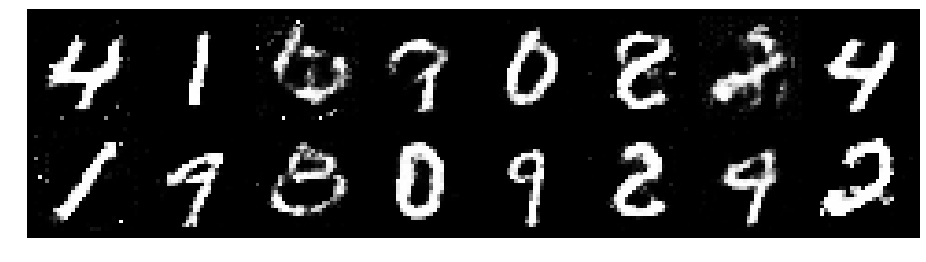

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.1837, Generator Loss: 0.9830
D(x): 0.5684, D(G(z)): 0.3982


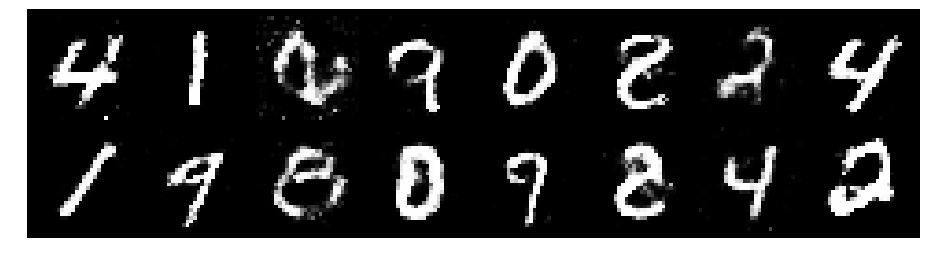

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2707, Generator Loss: 0.9491
D(x): 0.6005, D(G(z)): 0.4739


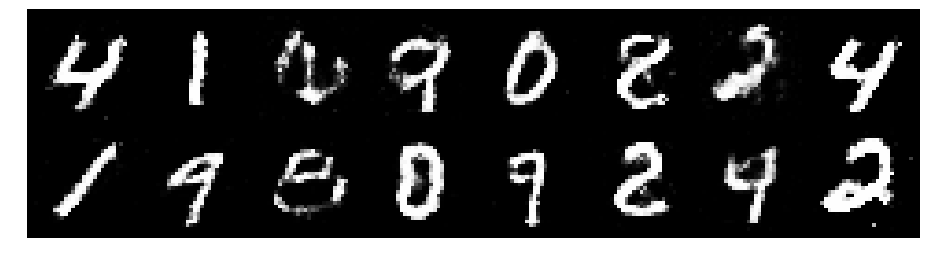

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2497, Generator Loss: 0.8559
D(x): 0.5938, D(G(z)): 0.4600


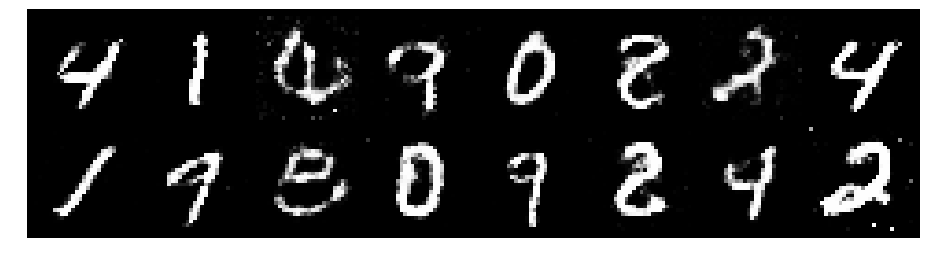

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3272, Generator Loss: 0.8511
D(x): 0.5150, D(G(z)): 0.4558


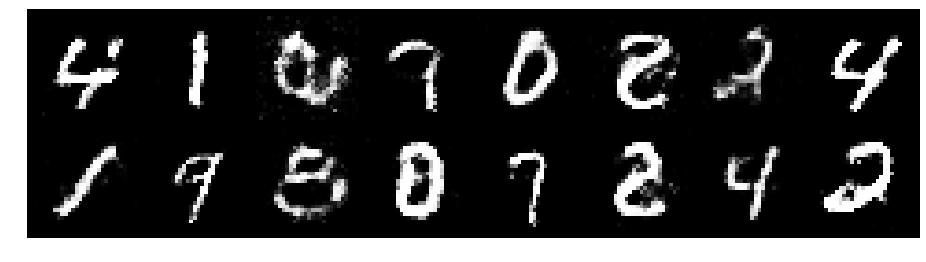

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.3106, Generator Loss: 0.8443
D(x): 0.5427, D(G(z)): 0.4683


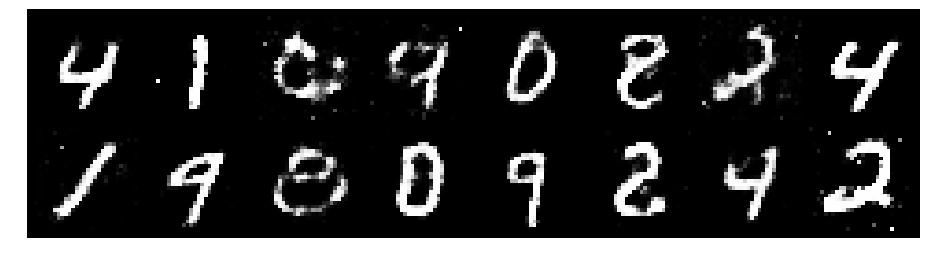

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.3009, Generator Loss: 0.9252
D(x): 0.5479, D(G(z)): 0.4305


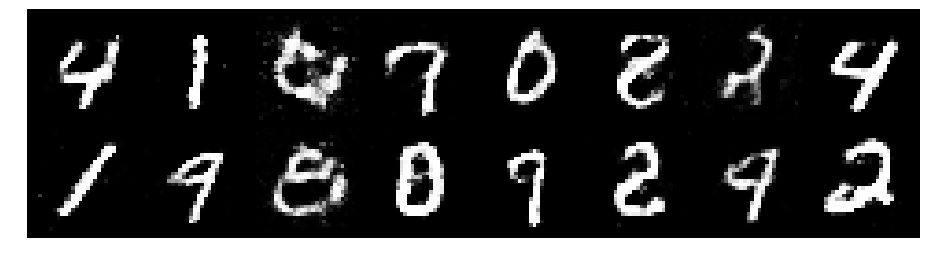

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.3084, Generator Loss: 1.1515
D(x): 0.5329, D(G(z)): 0.4175


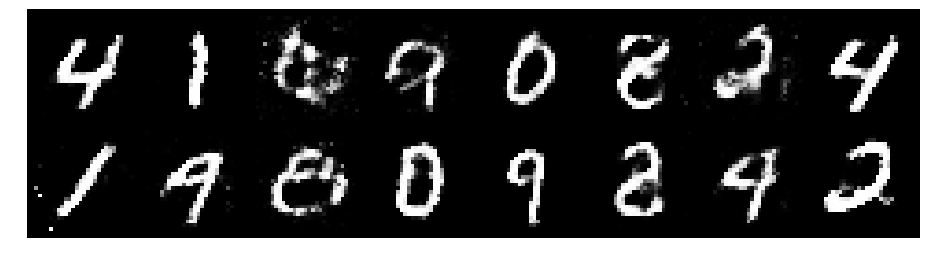

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.1858, Generator Loss: 1.0292
D(x): 0.5841, D(G(z)): 0.4028


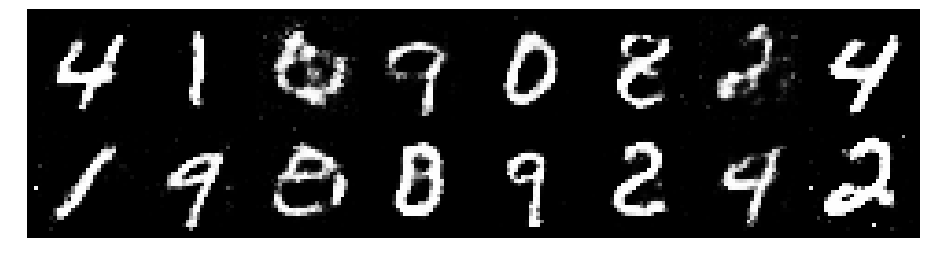

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.1540, Generator Loss: 0.9187
D(x): 0.6021, D(G(z)): 0.4222


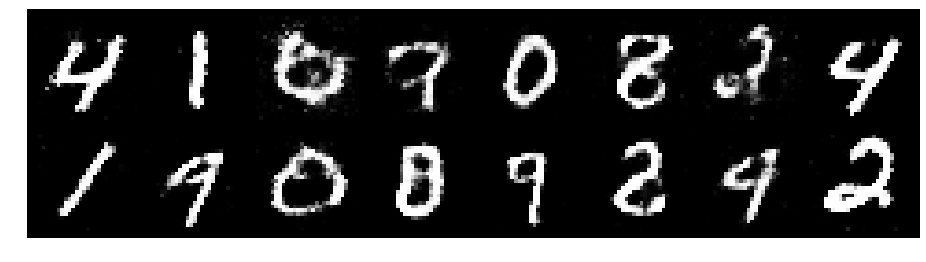

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2513, Generator Loss: 0.8993
D(x): 0.5705, D(G(z)): 0.4217


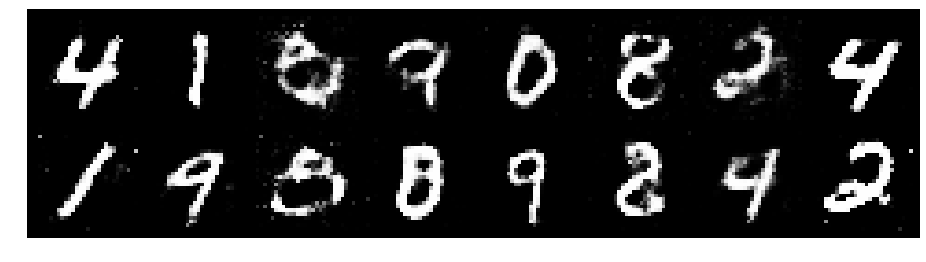

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.3483, Generator Loss: 0.8712
D(x): 0.5192, D(G(z)): 0.4606


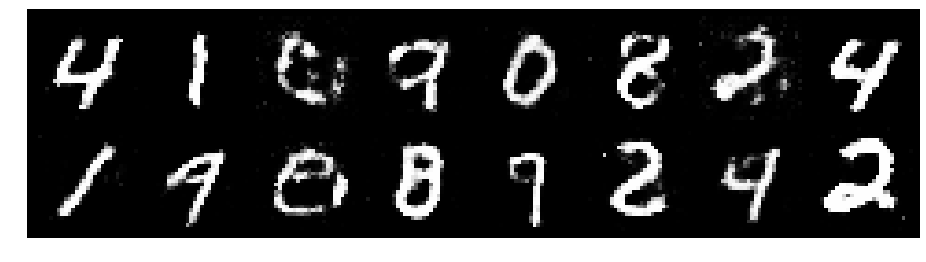

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2039, Generator Loss: 0.9100
D(x): 0.6019, D(G(z)): 0.4443


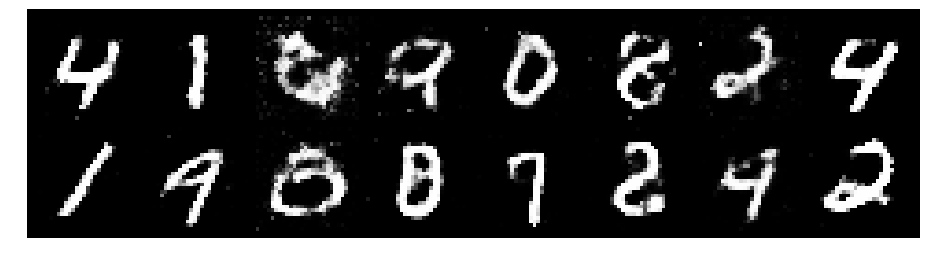

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2885, Generator Loss: 0.9793
D(x): 0.5756, D(G(z)): 0.4548


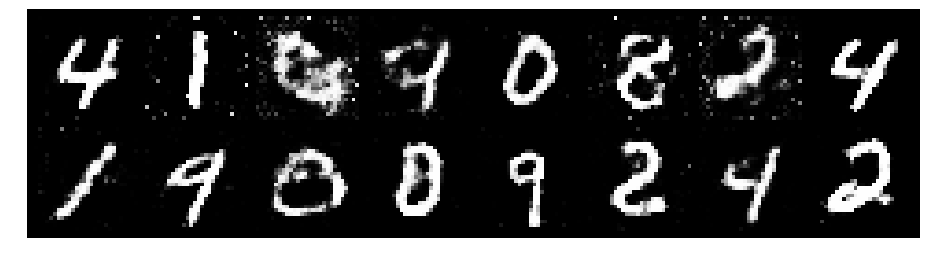

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2298, Generator Loss: 0.8730
D(x): 0.5849, D(G(z)): 0.4388


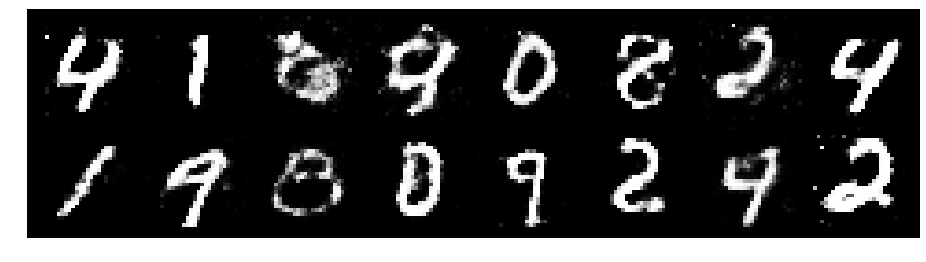

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2275, Generator Loss: 0.9444
D(x): 0.5798, D(G(z)): 0.4289


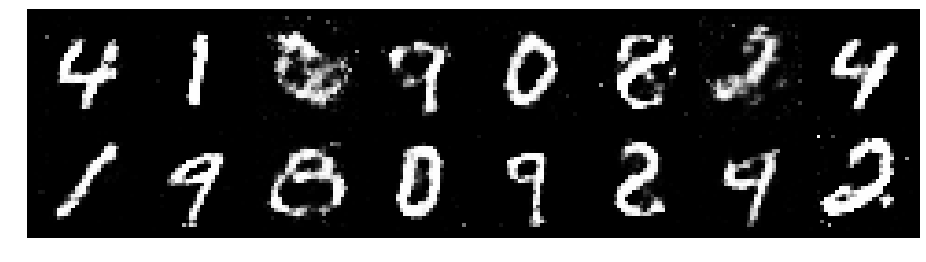

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.3886, Generator Loss: 0.8937
D(x): 0.5541, D(G(z)): 0.4845


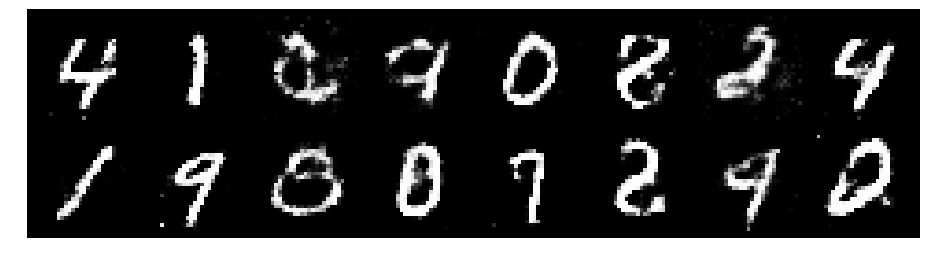

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.3042, Generator Loss: 0.8924
D(x): 0.5332, D(G(z)): 0.4459


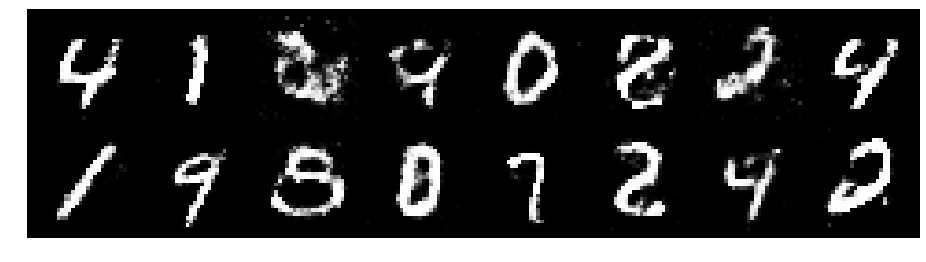

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.1929, Generator Loss: 0.9455
D(x): 0.5704, D(G(z)): 0.4298


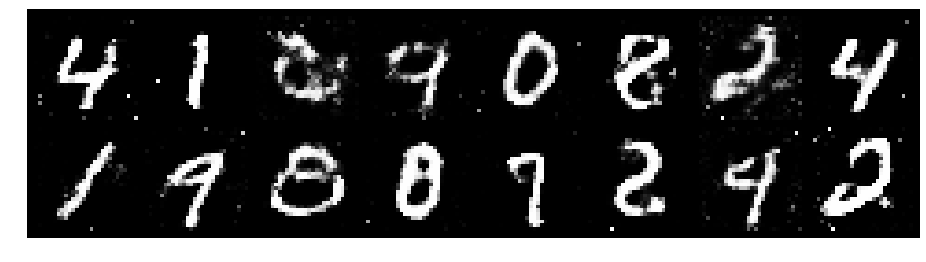

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.3527, Generator Loss: 0.8333
D(x): 0.5338, D(G(z)): 0.4709


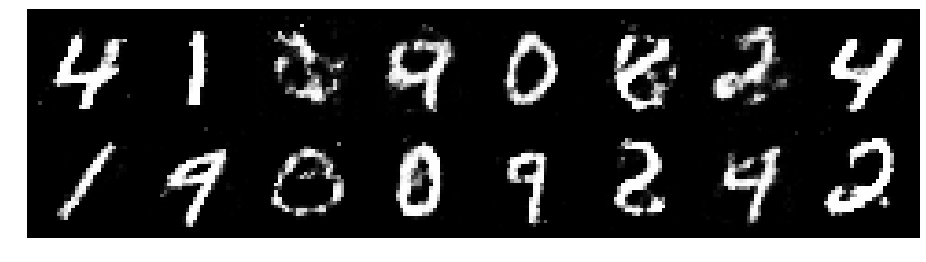

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2467, Generator Loss: 0.8268
D(x): 0.5182, D(G(z)): 0.4154


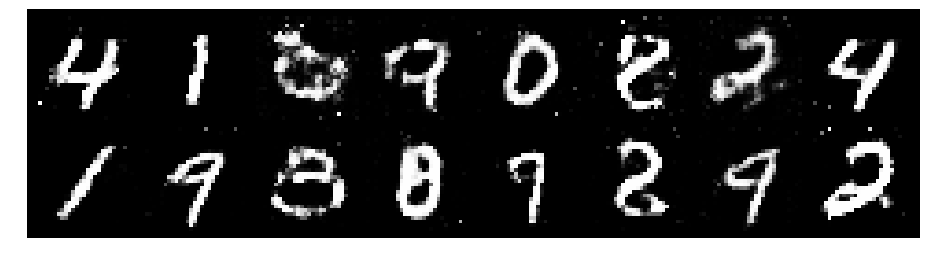

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3554, Generator Loss: 0.9471
D(x): 0.5340, D(G(z)): 0.4465


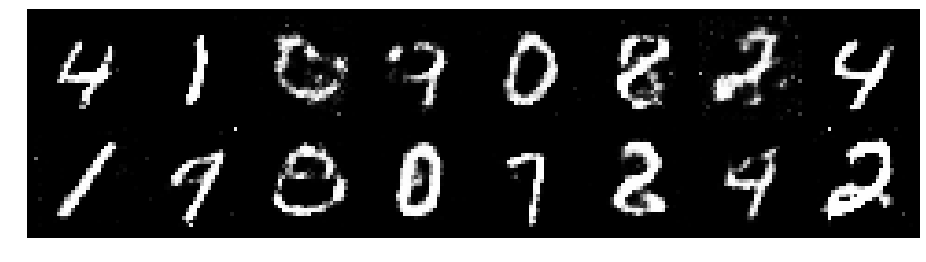

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.4419, Generator Loss: 0.9962
D(x): 0.5297, D(G(z)): 0.4877


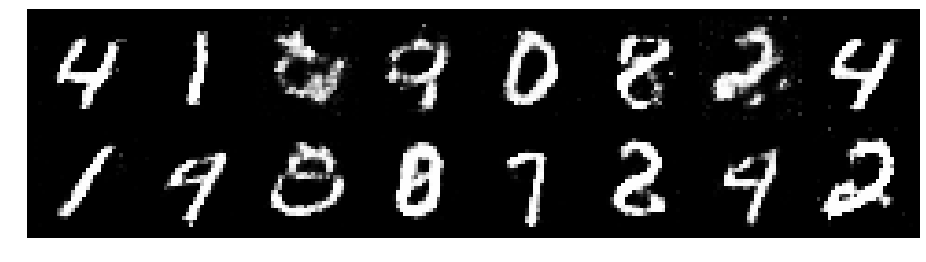

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.2105, Generator Loss: 0.8155
D(x): 0.5892, D(G(z)): 0.4489


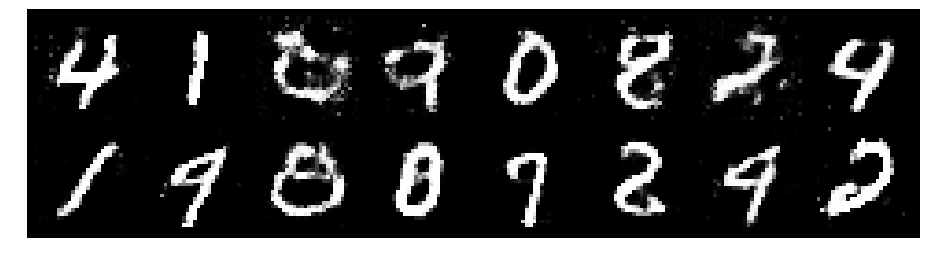

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9648
D(x): 0.5621, D(G(z)): 0.4288


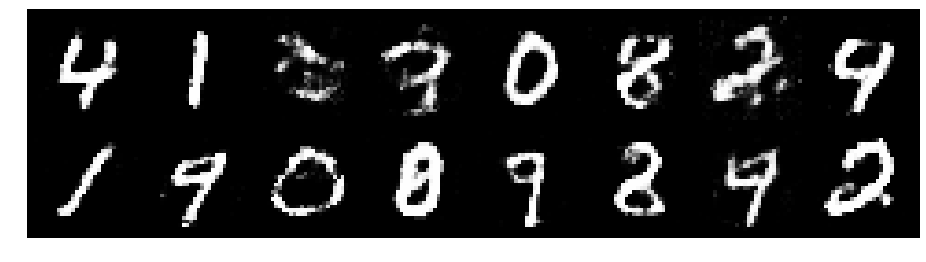

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.1595, Generator Loss: 0.8543
D(x): 0.5847, D(G(z)): 0.4236


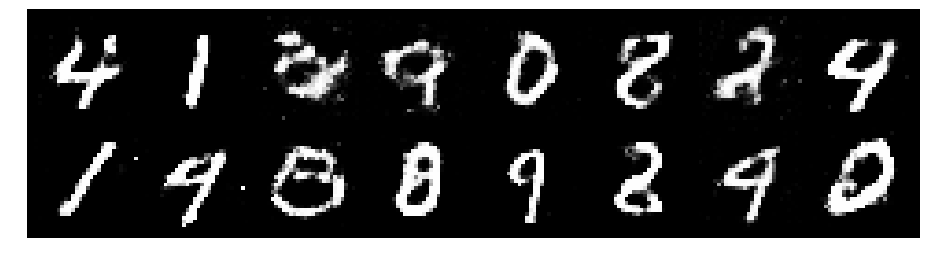

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2227, Generator Loss: 0.8155
D(x): 0.5665, D(G(z)): 0.4484


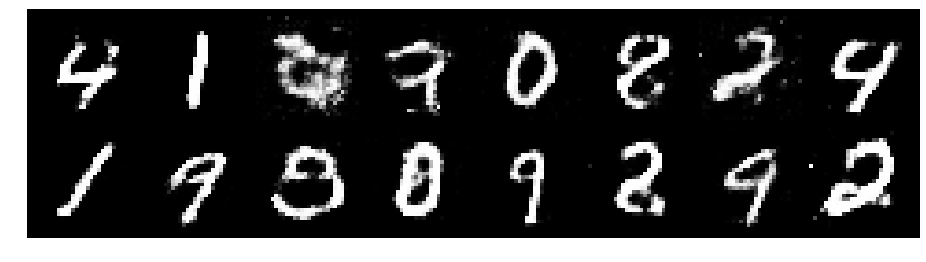

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.3610, Generator Loss: 0.8229
D(x): 0.5332, D(G(z)): 0.4769


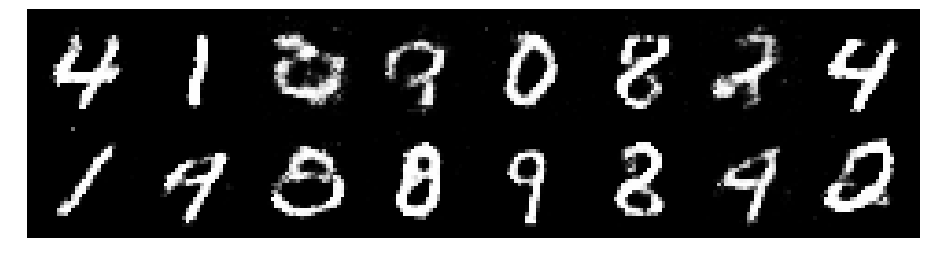

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.3225, Generator Loss: 0.8912
D(x): 0.5352, D(G(z)): 0.4537


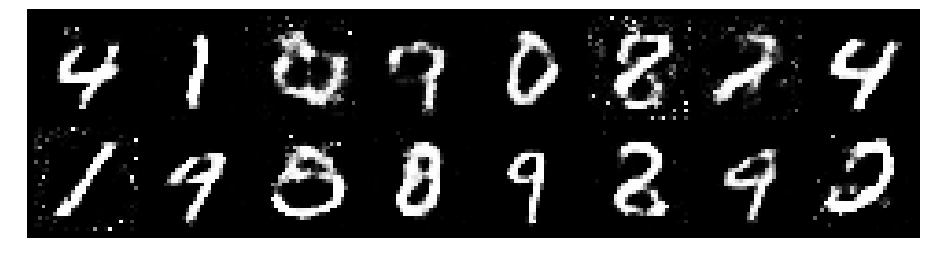

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2487, Generator Loss: 0.8778
D(x): 0.5432, D(G(z)): 0.4114


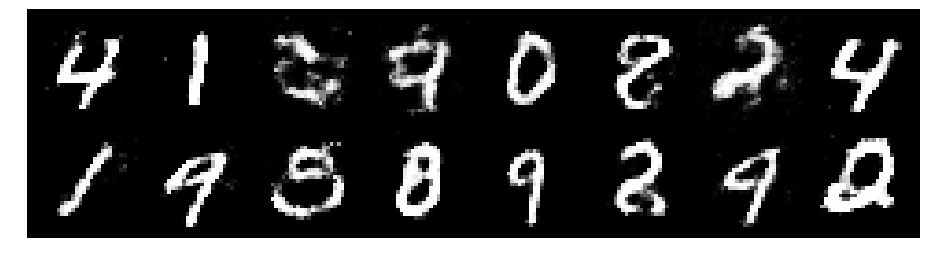

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.4058, Generator Loss: 0.8657
D(x): 0.5226, D(G(z)): 0.4672


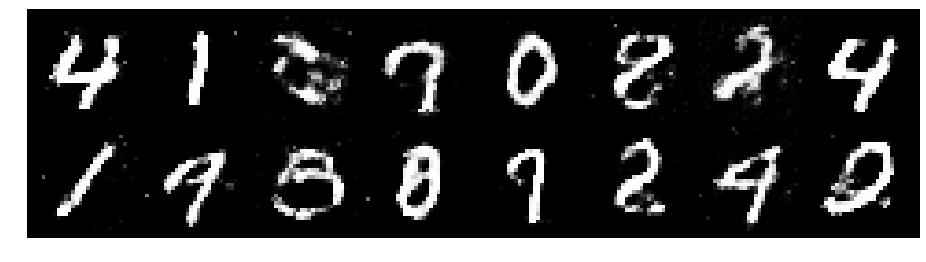

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2868, Generator Loss: 0.9058
D(x): 0.5483, D(G(z)): 0.4302


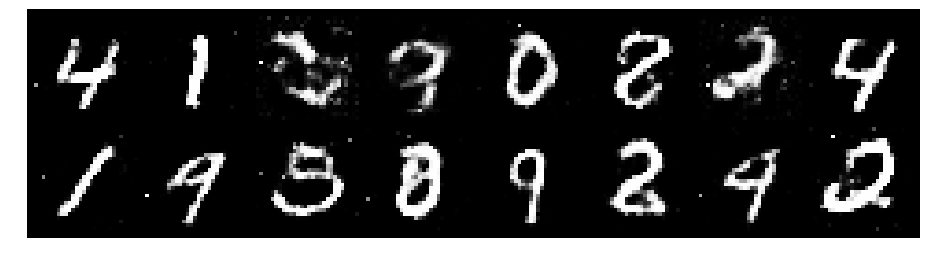

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2420, Generator Loss: 0.8211
D(x): 0.5640, D(G(z)): 0.4390


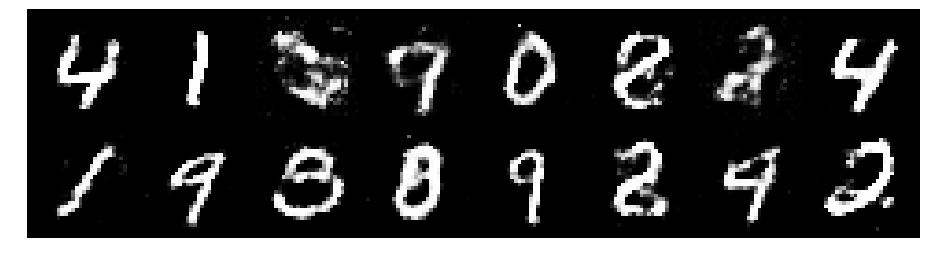

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1980, Generator Loss: 0.8719
D(x): 0.5666, D(G(z)): 0.4196


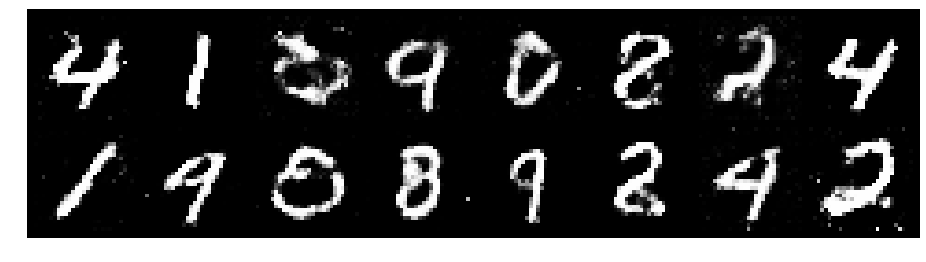

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2360, Generator Loss: 0.8174
D(x): 0.5489, D(G(z)): 0.4422


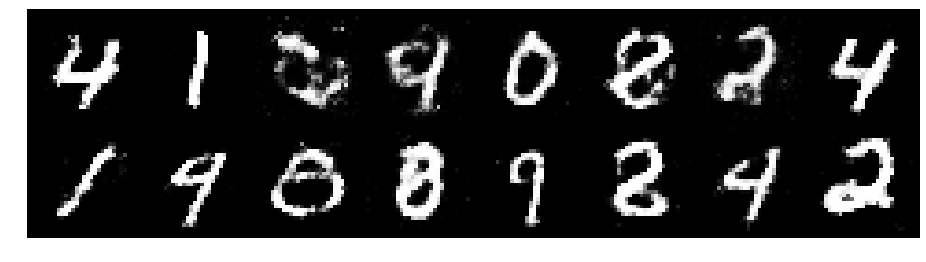

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2526, Generator Loss: 0.9006
D(x): 0.5496, D(G(z)): 0.4215


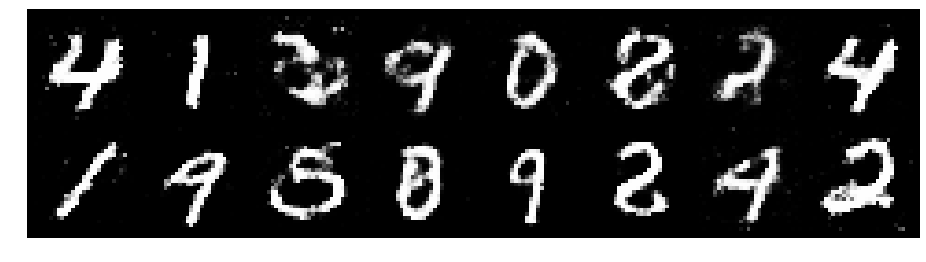

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2472, Generator Loss: 0.9210
D(x): 0.5359, D(G(z)): 0.4172


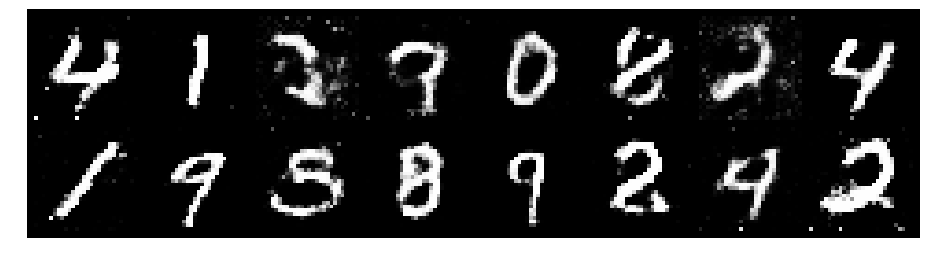

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2525, Generator Loss: 0.8216
D(x): 0.5568, D(G(z)): 0.4533


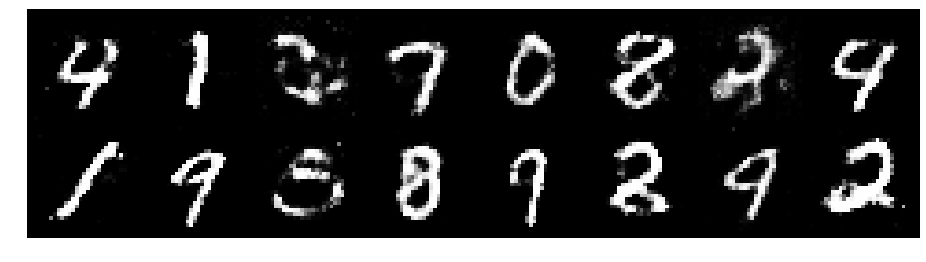

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2297, Generator Loss: 0.8215
D(x): 0.5650, D(G(z)): 0.4522


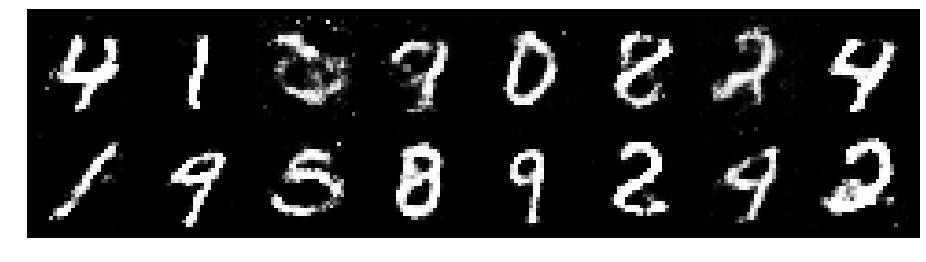

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2494, Generator Loss: 0.8199
D(x): 0.5491, D(G(z)): 0.4452


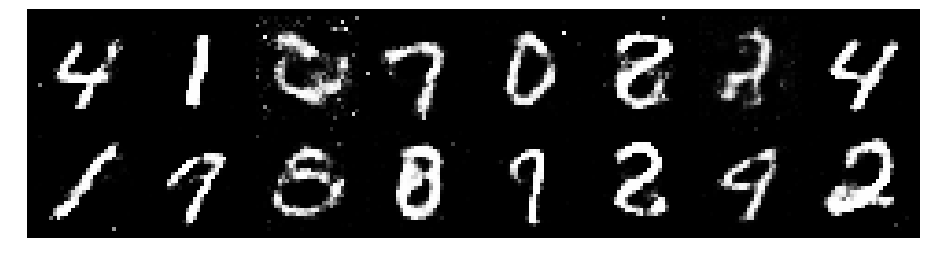

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2081, Generator Loss: 0.9634
D(x): 0.5601, D(G(z)): 0.4186


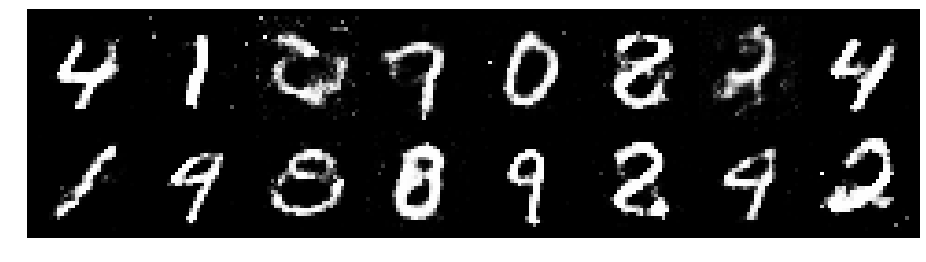

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.1242, Generator Loss: 1.1151
D(x): 0.5912, D(G(z)): 0.3872


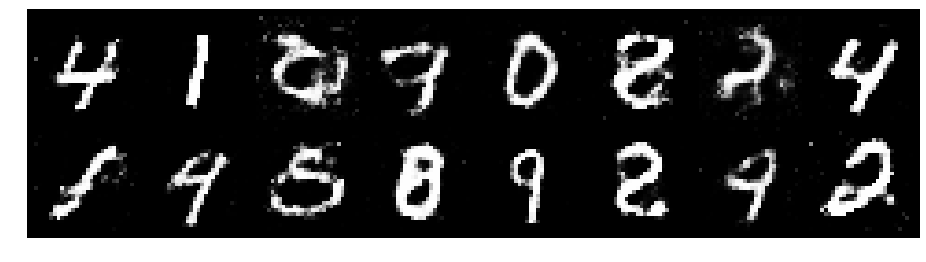

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2490, Generator Loss: 0.8921
D(x): 0.5258, D(G(z)): 0.3973


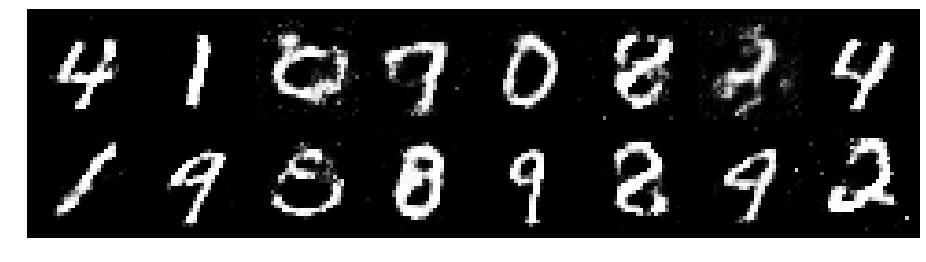

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9907
D(x): 0.5291, D(G(z)): 0.3892


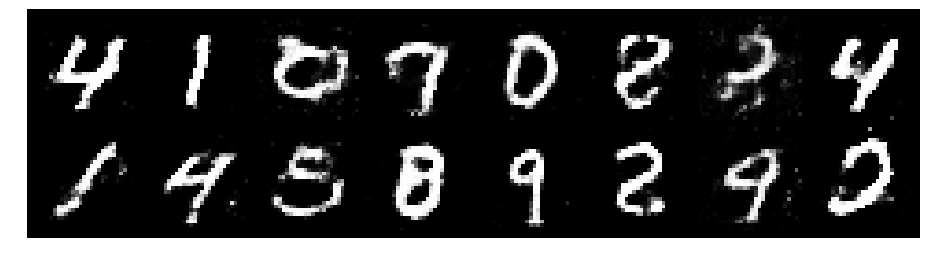

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2810, Generator Loss: 0.9924
D(x): 0.5614, D(G(z)): 0.4499


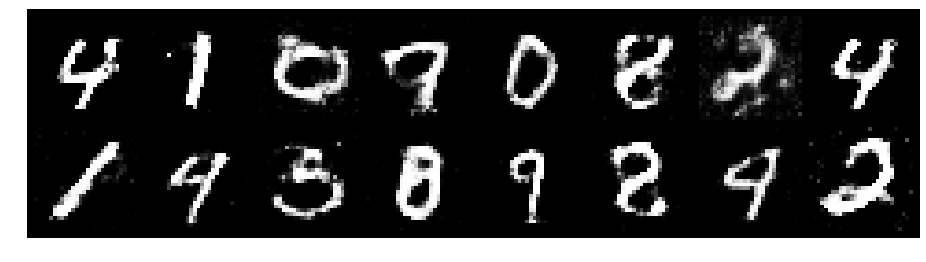

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3173, Generator Loss: 0.9038
D(x): 0.5490, D(G(z)): 0.4459


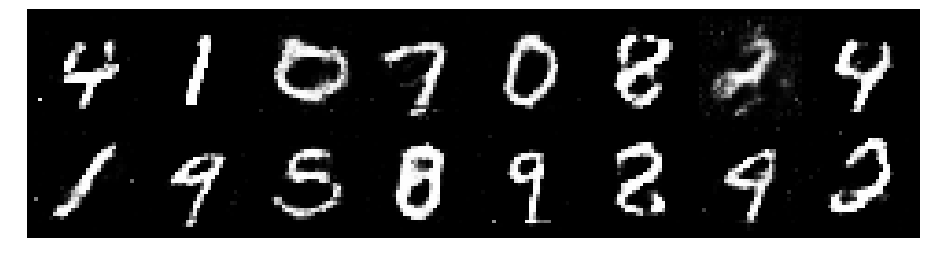

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2701, Generator Loss: 0.8511
D(x): 0.5758, D(G(z)): 0.4553


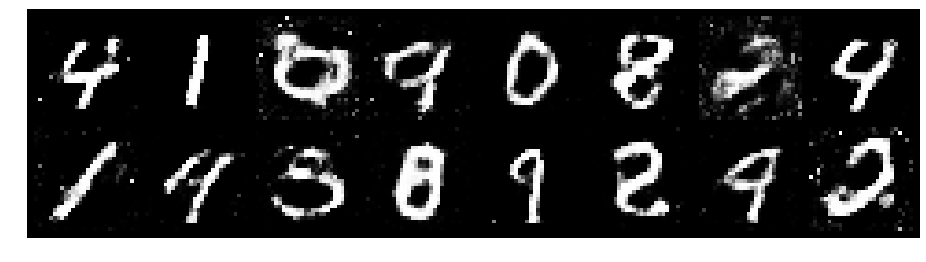

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.2199, Generator Loss: 0.9649
D(x): 0.5751, D(G(z)): 0.4366


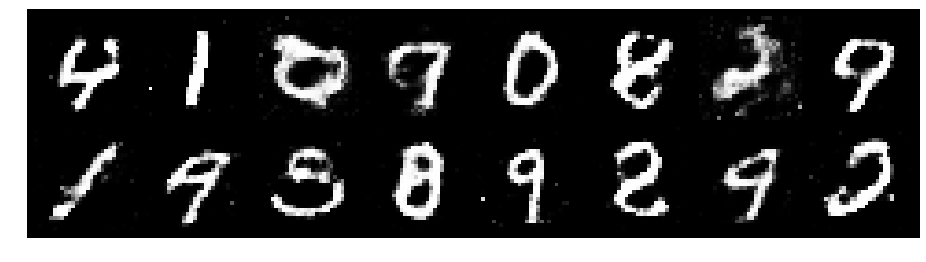

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2216, Generator Loss: 1.0164
D(x): 0.5630, D(G(z)): 0.4131


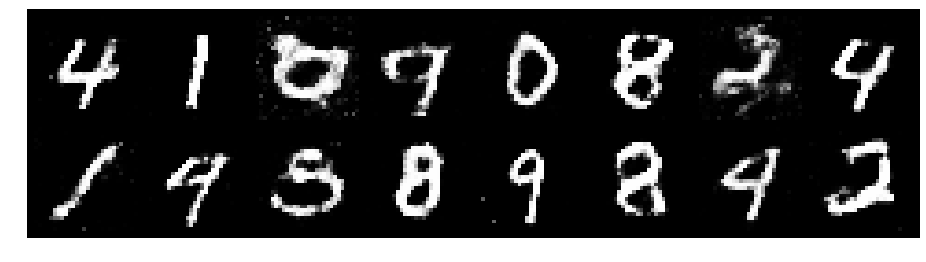

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.3994, Generator Loss: 0.9172
D(x): 0.5611, D(G(z)): 0.4877


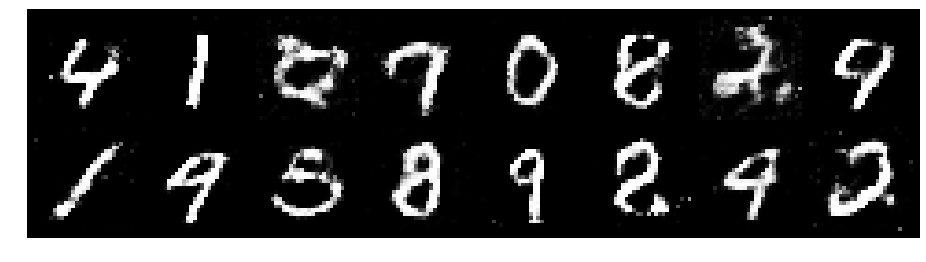

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3372, Generator Loss: 0.8082
D(x): 0.5570, D(G(z)): 0.4960


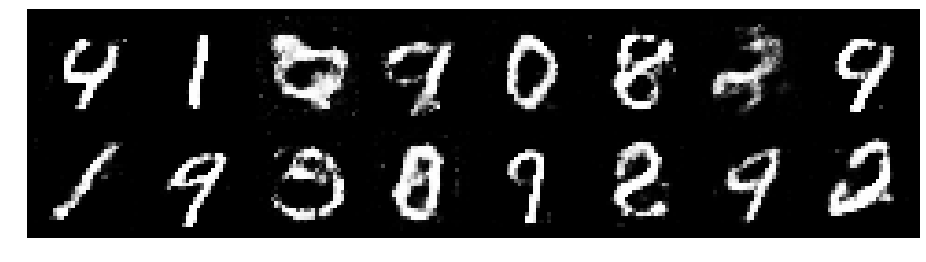

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2846, Generator Loss: 0.7854
D(x): 0.5461, D(G(z)): 0.4519


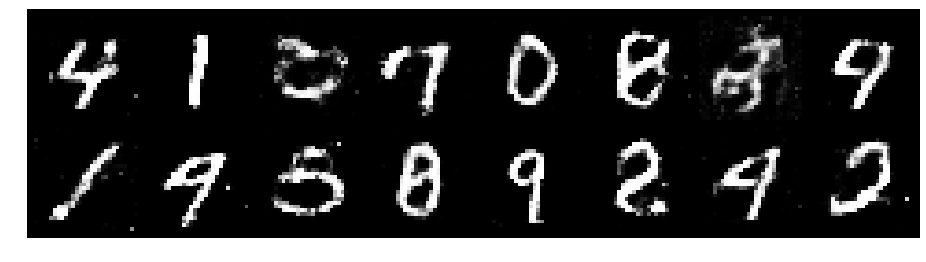

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3613, Generator Loss: 0.7325
D(x): 0.6199, D(G(z)): 0.5264


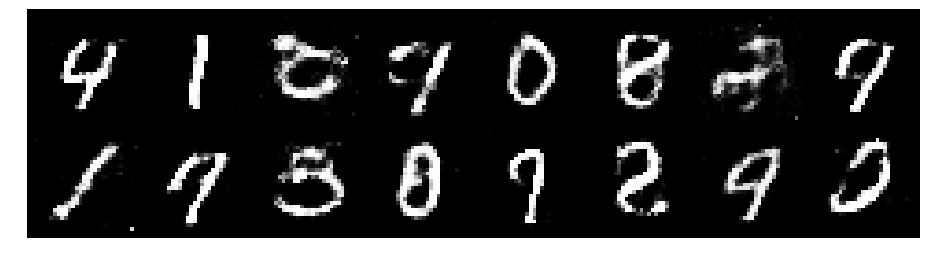

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2528, Generator Loss: 0.9098
D(x): 0.5691, D(G(z)): 0.4405


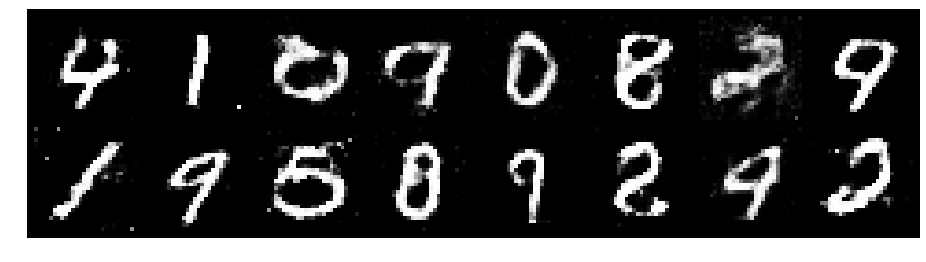

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3134, Generator Loss: 0.7741
D(x): 0.5455, D(G(z)): 0.4744


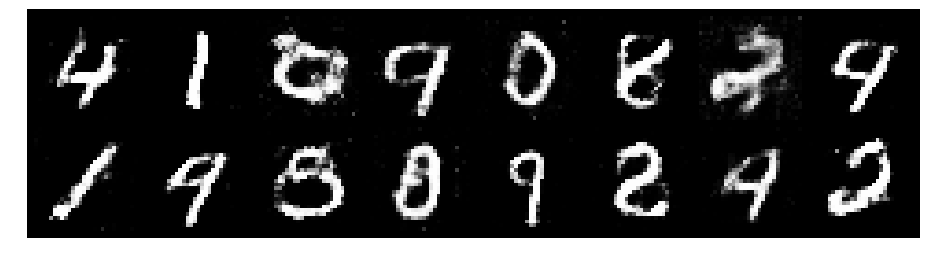

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1964, Generator Loss: 0.8905
D(x): 0.5644, D(G(z)): 0.4283


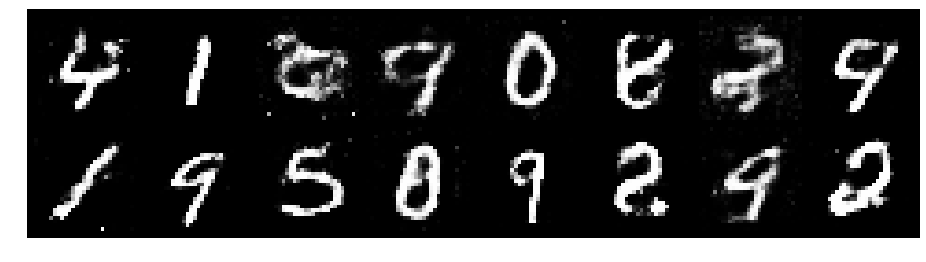

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8706
D(x): 0.5356, D(G(z)): 0.4347


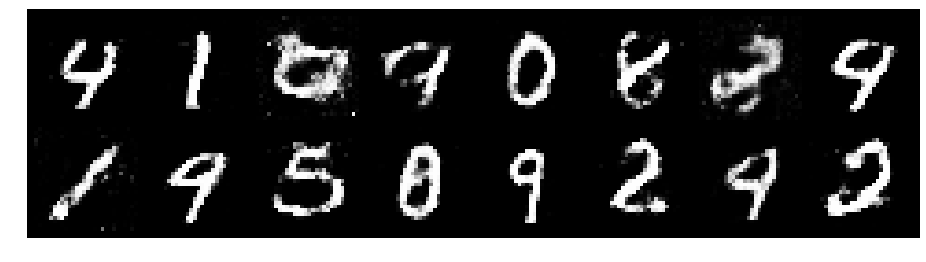

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8474
D(x): 0.5543, D(G(z)): 0.4613


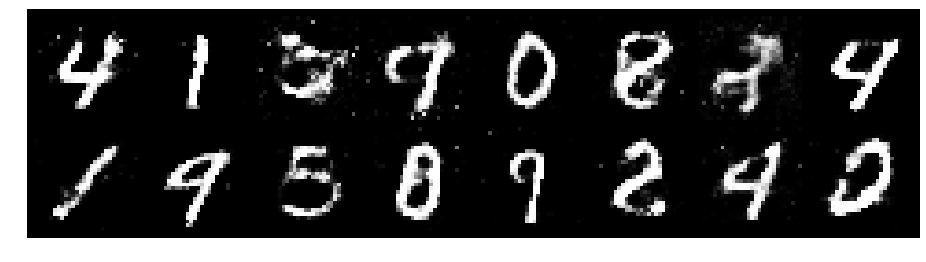

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3258, Generator Loss: 0.9428
D(x): 0.5188, D(G(z)): 0.4482


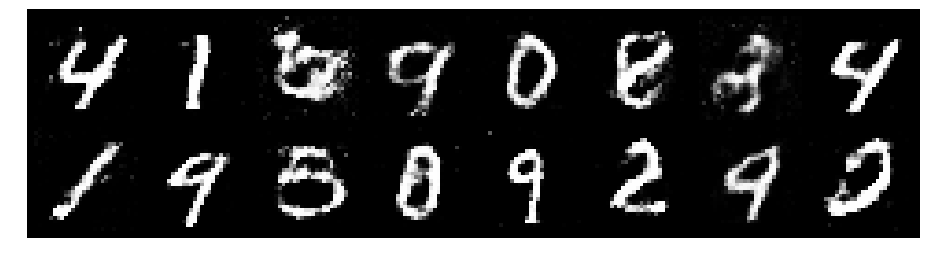

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.3872, Generator Loss: 0.9800
D(x): 0.5183, D(G(z)): 0.4465


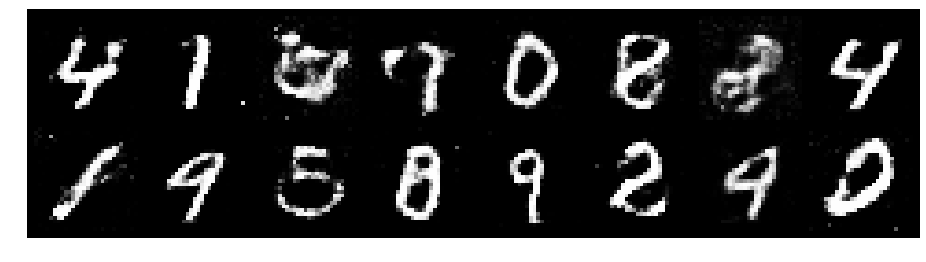

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2730, Generator Loss: 0.8084
D(x): 0.5567, D(G(z)): 0.4515


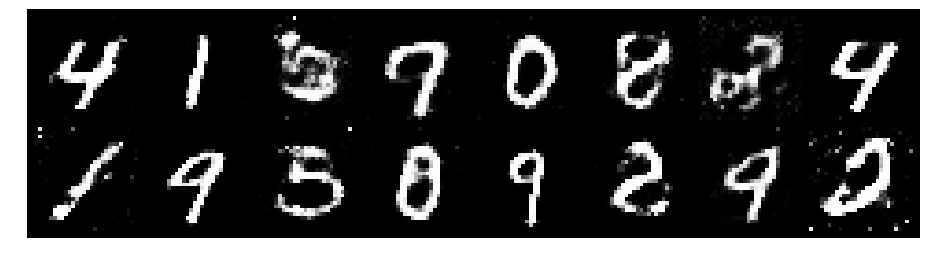

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2715, Generator Loss: 0.9481
D(x): 0.5704, D(G(z)): 0.4417


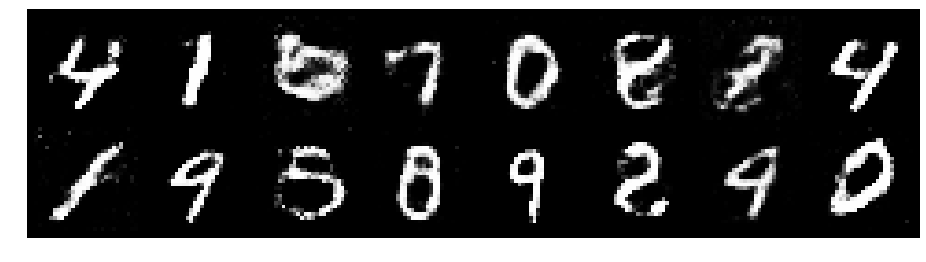

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.2129, Generator Loss: 0.8506
D(x): 0.5652, D(G(z)): 0.4297


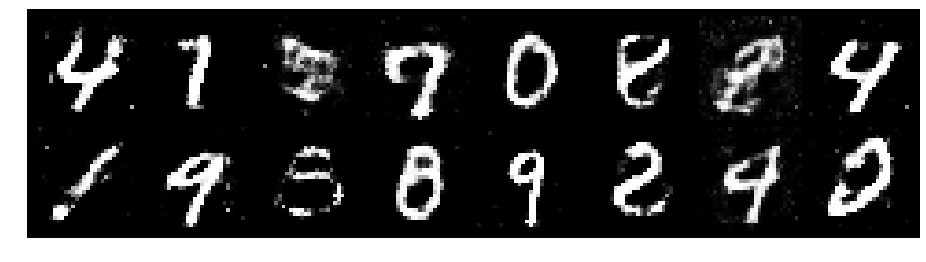

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2371, Generator Loss: 0.8712
D(x): 0.5752, D(G(z)): 0.4675


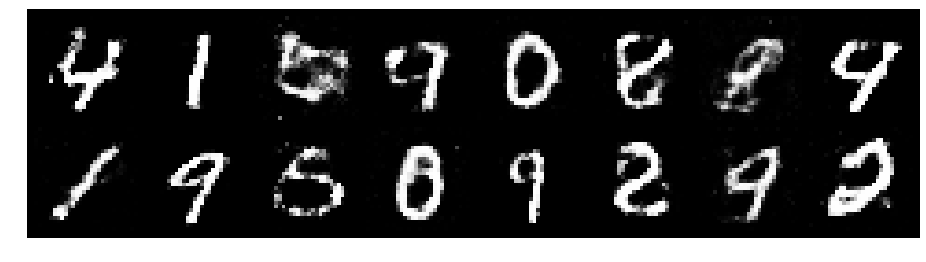

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.3246, Generator Loss: 0.8595
D(x): 0.5494, D(G(z)): 0.4684


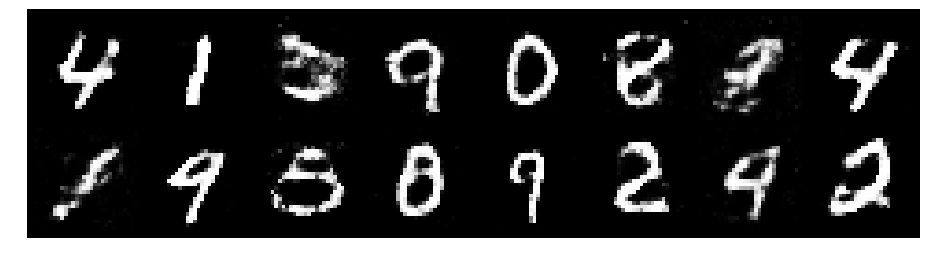

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3587, Generator Loss: 0.9607
D(x): 0.5009, D(G(z)): 0.4194


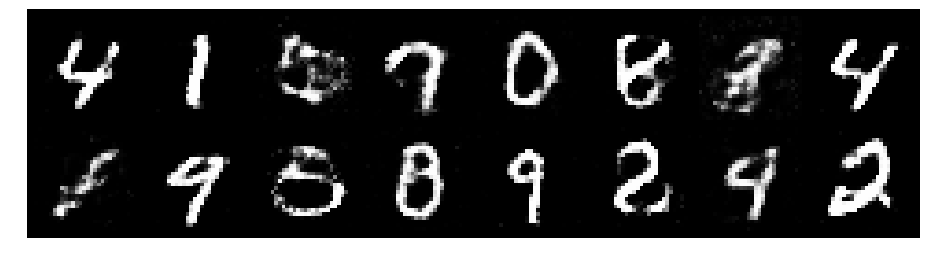

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3932, Generator Loss: 0.8865
D(x): 0.5332, D(G(z)): 0.4489


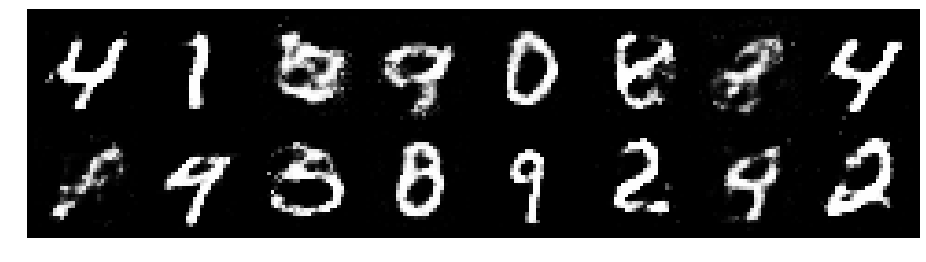

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.3853, Generator Loss: 0.8832
D(x): 0.5384, D(G(z)): 0.4476


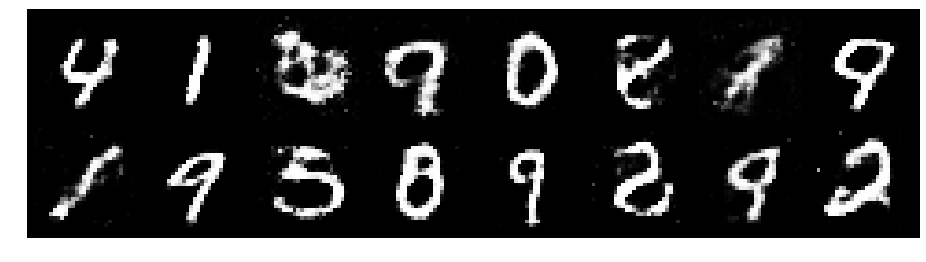

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.2897, Generator Loss: 0.8860
D(x): 0.5895, D(G(z)): 0.4671


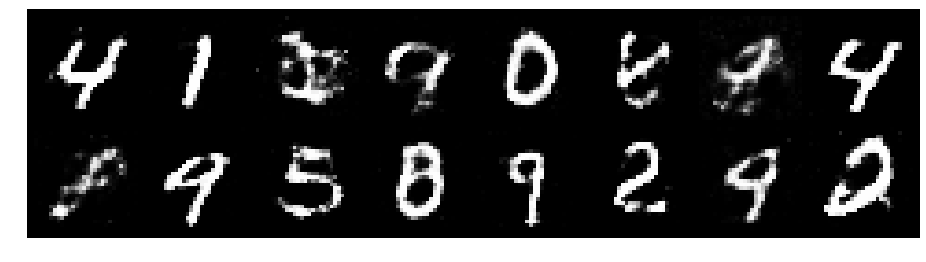

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2018, Generator Loss: 0.8836
D(x): 0.5981, D(G(z)): 0.4368


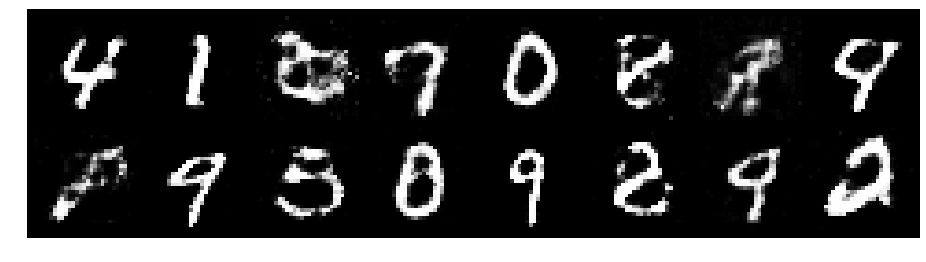

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3192, Generator Loss: 0.8582
D(x): 0.5436, D(G(z)): 0.4539


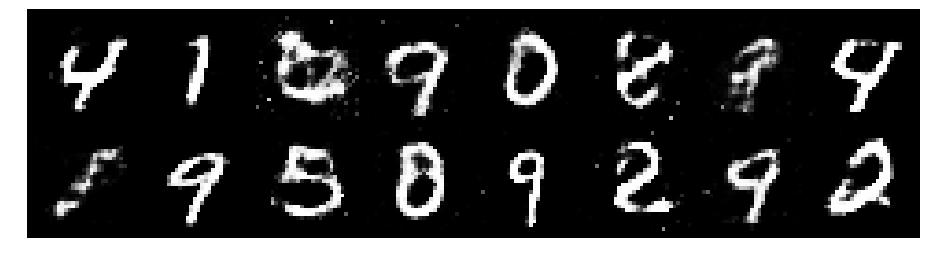

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2487, Generator Loss: 1.1205
D(x): 0.5487, D(G(z)): 0.4164


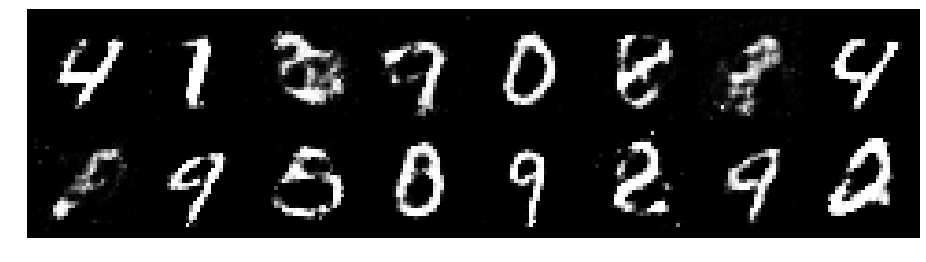

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.4314, Generator Loss: 0.9753
D(x): 0.5042, D(G(z)): 0.4240


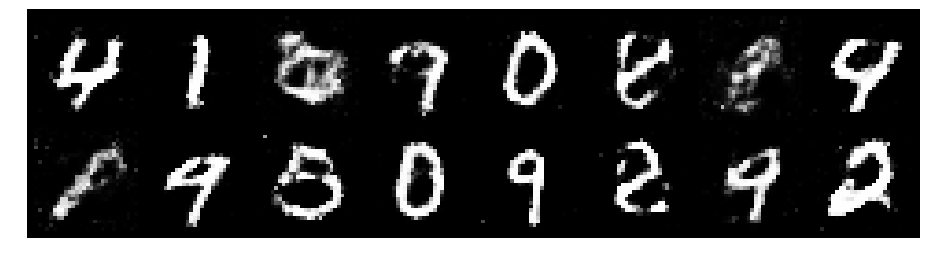

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2300, Generator Loss: 0.8735
D(x): 0.5501, D(G(z)): 0.4282


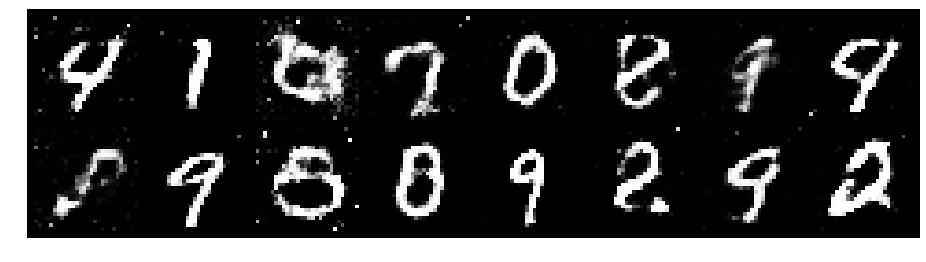

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.3041, Generator Loss: 0.8164
D(x): 0.5091, D(G(z)): 0.4332


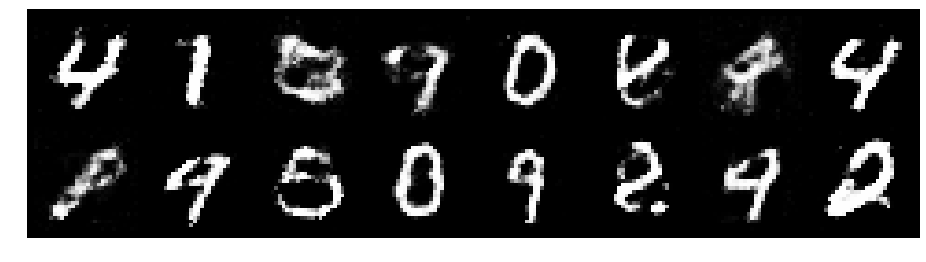

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.1856, Generator Loss: 0.9069
D(x): 0.6012, D(G(z)): 0.4456


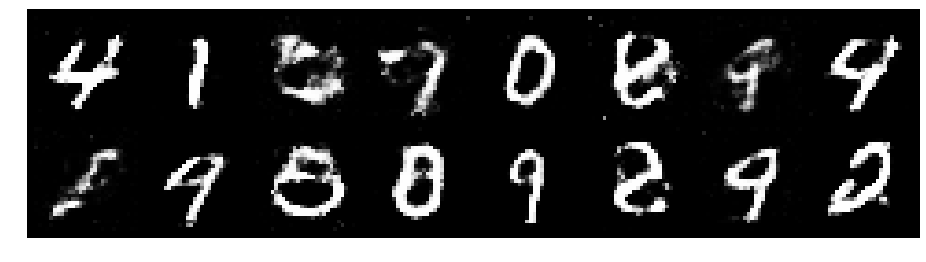

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2069, Generator Loss: 0.9522
D(x): 0.5355, D(G(z)): 0.4005


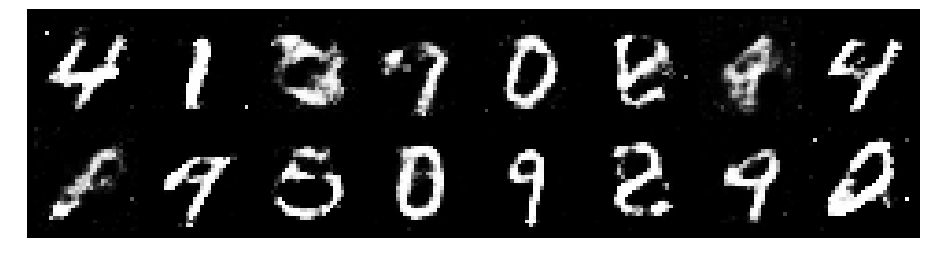

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2101, Generator Loss: 0.9247
D(x): 0.5280, D(G(z)): 0.3901


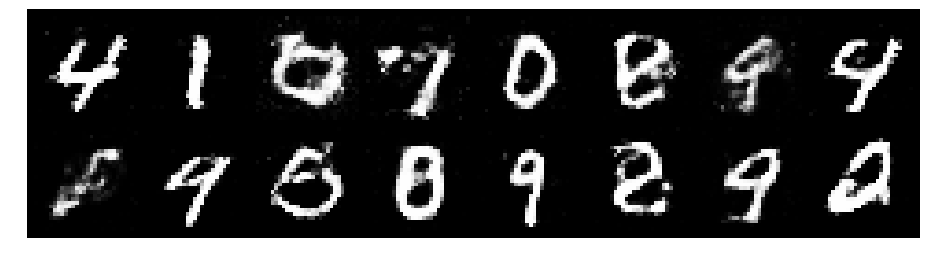

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2064, Generator Loss: 0.9571
D(x): 0.5737, D(G(z)): 0.4272


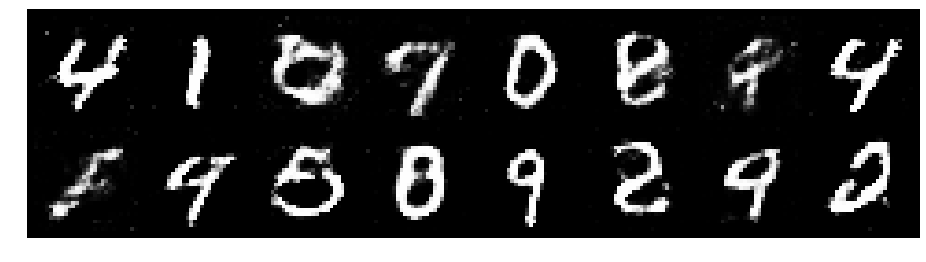

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2383, Generator Loss: 0.8819
D(x): 0.5551, D(G(z)): 0.4255


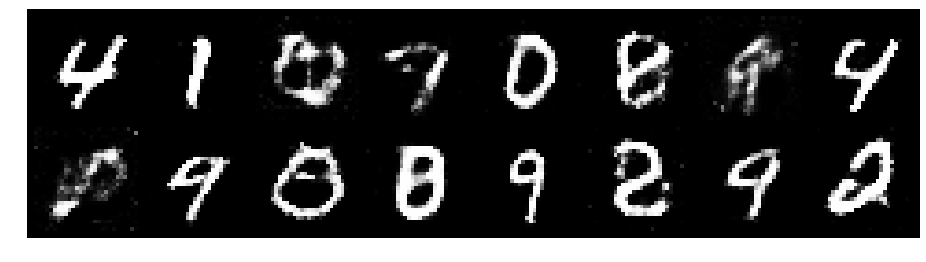

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2073, Generator Loss: 0.9764
D(x): 0.5577, D(G(z)): 0.4131


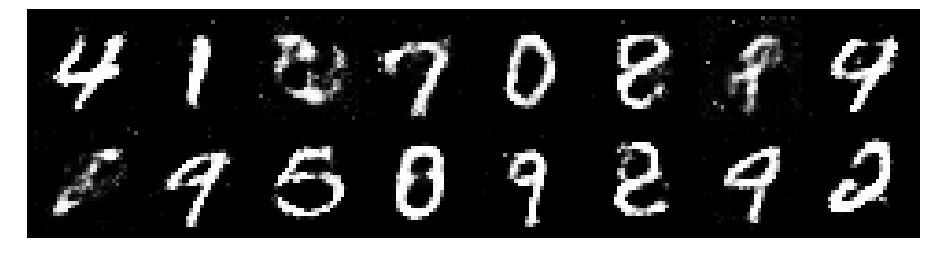

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.3063, Generator Loss: 0.8922
D(x): 0.5352, D(G(z)): 0.4642


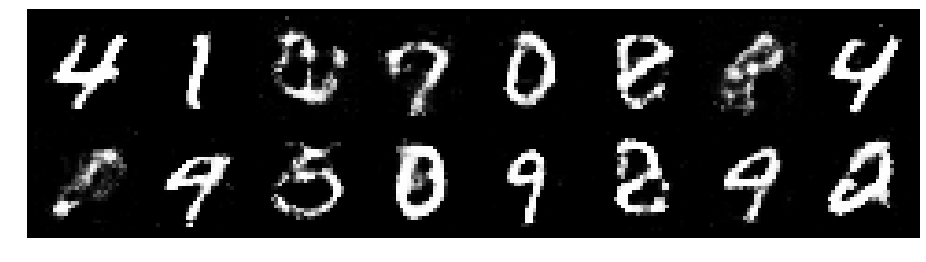

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2364, Generator Loss: 0.8646
D(x): 0.5695, D(G(z)): 0.4474


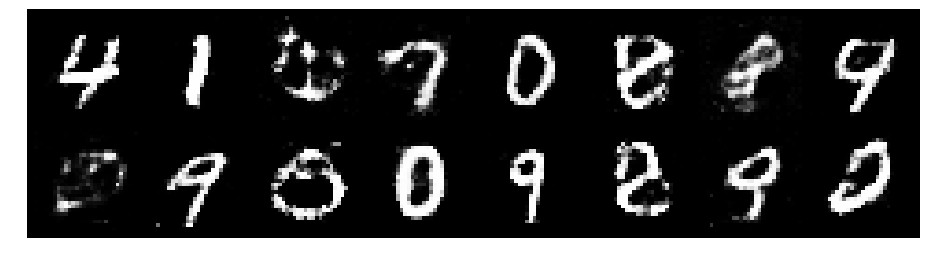

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2362, Generator Loss: 0.8086
D(x): 0.5908, D(G(z)): 0.4751


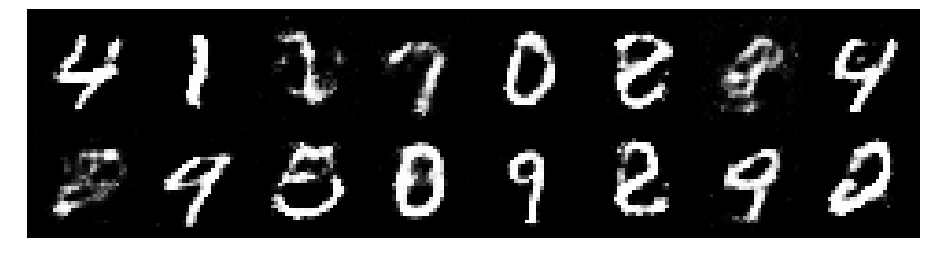

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.4041, Generator Loss: 0.7284
D(x): 0.5823, D(G(z)): 0.5181


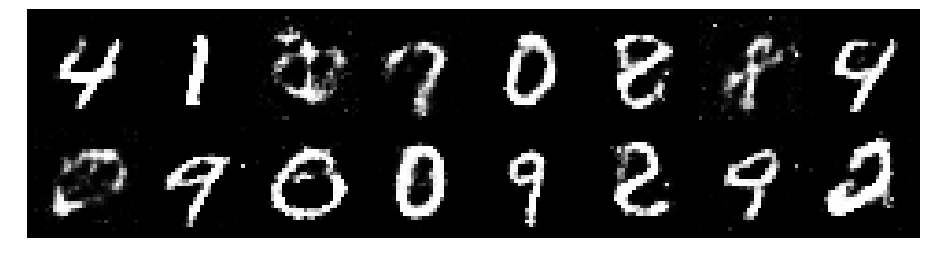

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.3696, Generator Loss: 0.8372
D(x): 0.5311, D(G(z)): 0.4364


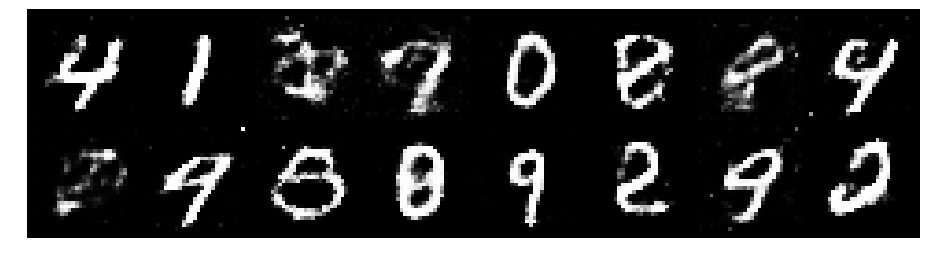

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3612, Generator Loss: 0.9056
D(x): 0.5531, D(G(z)): 0.4706


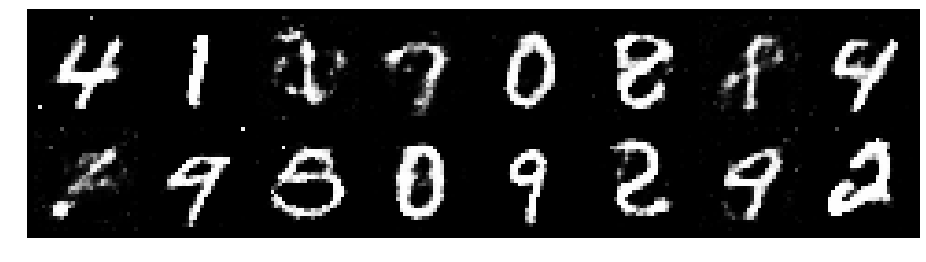

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.4011, Generator Loss: 0.7901
D(x): 0.5447, D(G(z)): 0.4700


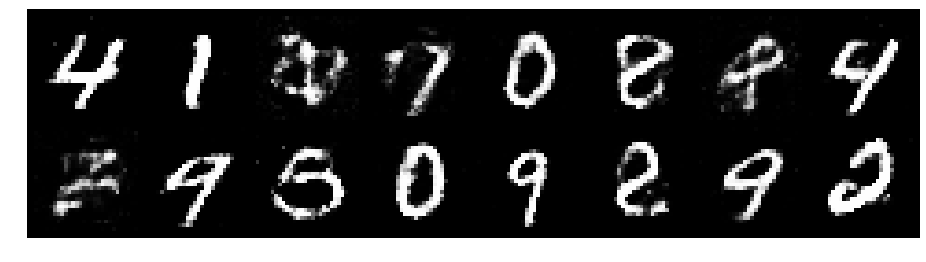

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.4035, Generator Loss: 0.8909
D(x): 0.5608, D(G(z)): 0.4818


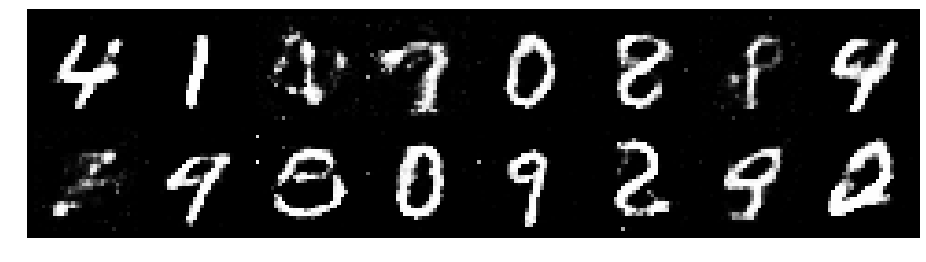

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2526, Generator Loss: 0.9147
D(x): 0.6080, D(G(z)): 0.4438


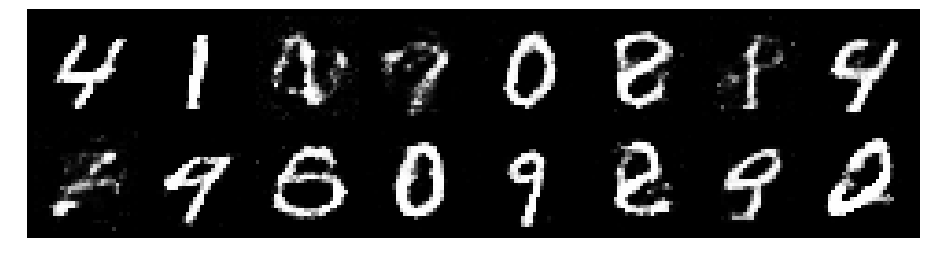

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.3035, Generator Loss: 0.9245
D(x): 0.5297, D(G(z)): 0.4057


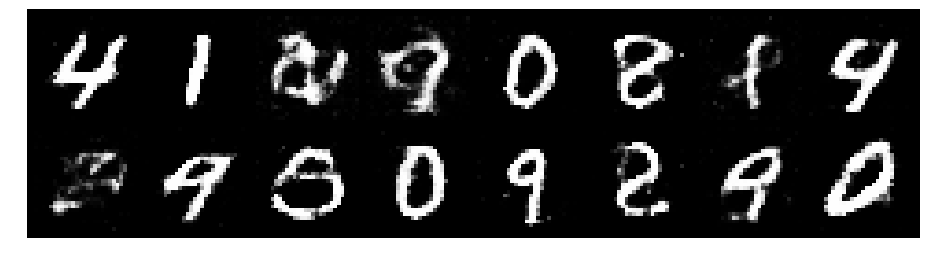

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2853, Generator Loss: 0.9534
D(x): 0.5680, D(G(z)): 0.4427


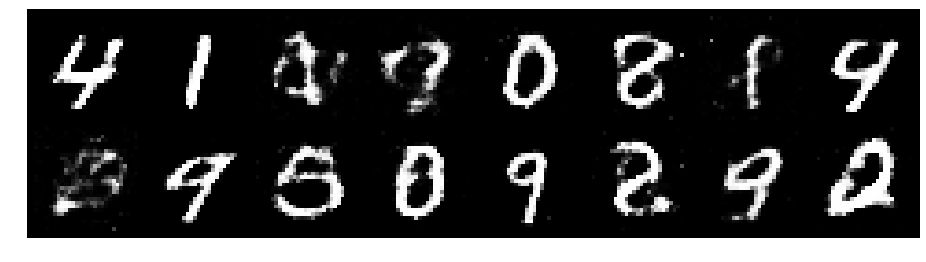

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.3255, Generator Loss: 0.9849
D(x): 0.5788, D(G(z)): 0.4733


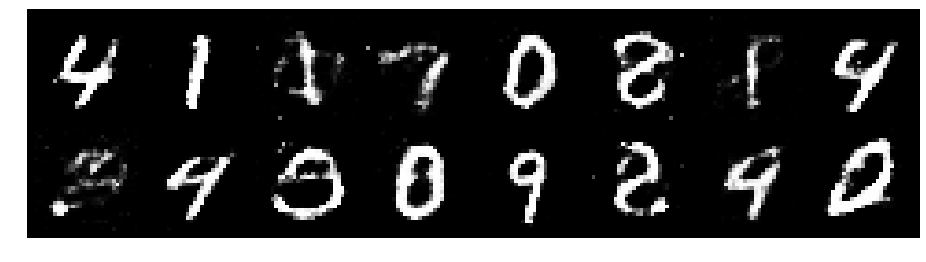

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2766, Generator Loss: 0.9256
D(x): 0.5714, D(G(z)): 0.4391


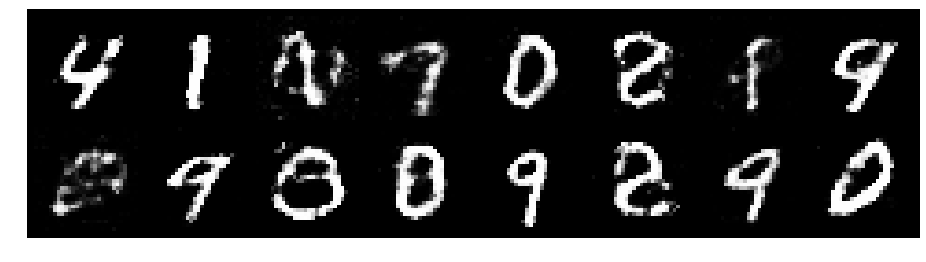

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2074, Generator Loss: 0.9138
D(x): 0.5816, D(G(z)): 0.4298


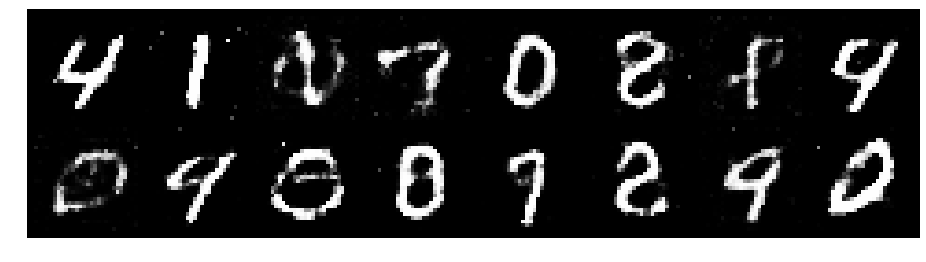

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.1951, Generator Loss: 0.8898
D(x): 0.5515, D(G(z)): 0.4152


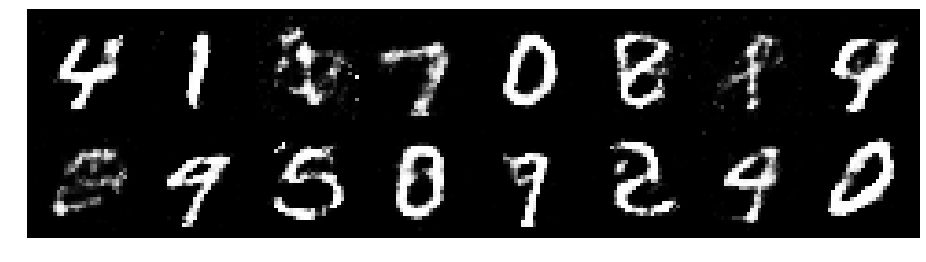

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.3896, Generator Loss: 0.8995
D(x): 0.5092, D(G(z)): 0.4534


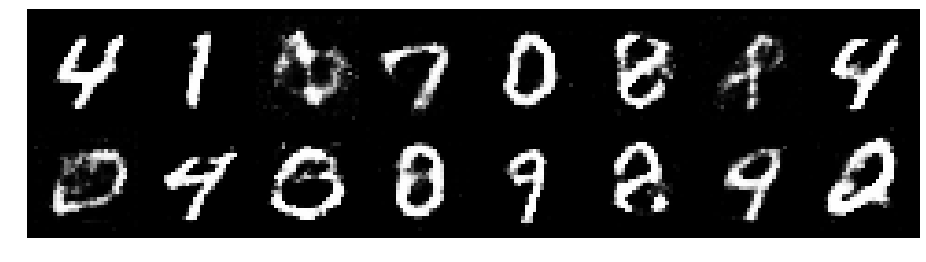

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2466, Generator Loss: 0.7346
D(x): 0.5773, D(G(z)): 0.4643


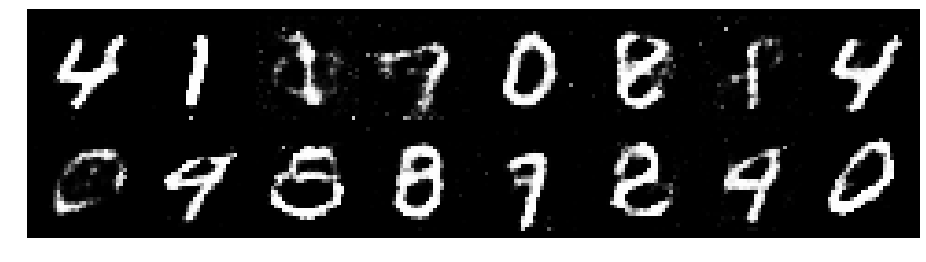

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.3106, Generator Loss: 0.8293
D(x): 0.5564, D(G(z)): 0.4695


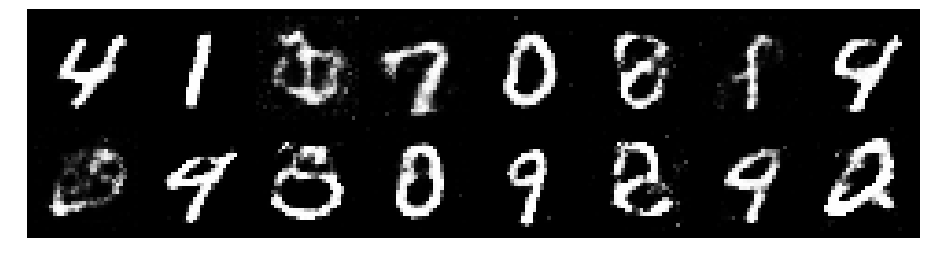

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.3008, Generator Loss: 0.8860
D(x): 0.5205, D(G(z)): 0.4220


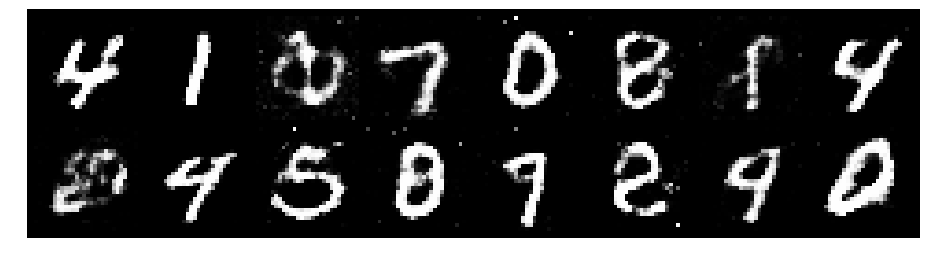

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2960, Generator Loss: 0.7317
D(x): 0.5802, D(G(z)): 0.4725


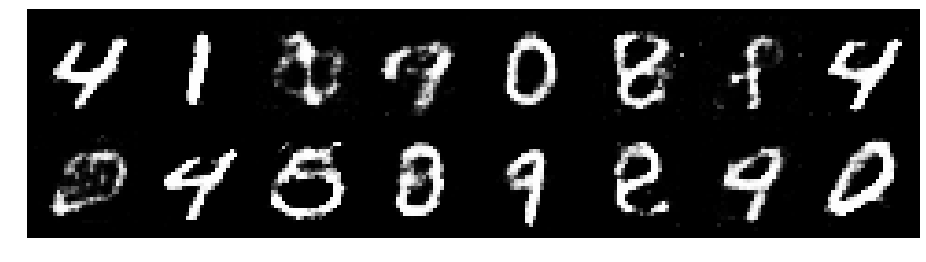

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8936
D(x): 0.5386, D(G(z)): 0.4058


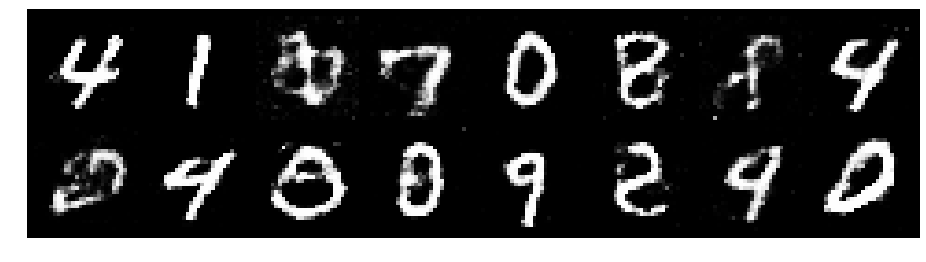

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3774, Generator Loss: 0.9212
D(x): 0.5002, D(G(z)): 0.4560


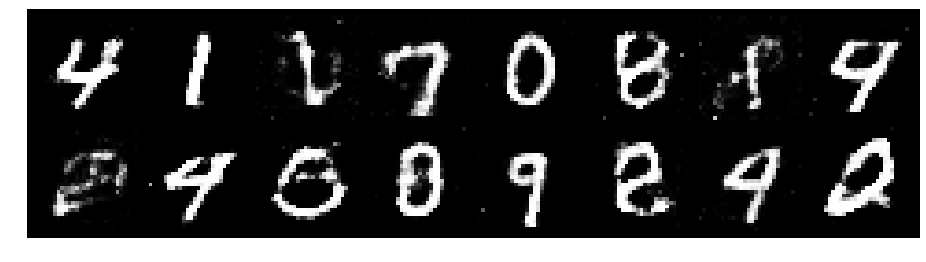

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.3826, Generator Loss: 0.7515
D(x): 0.5514, D(G(z)): 0.4929


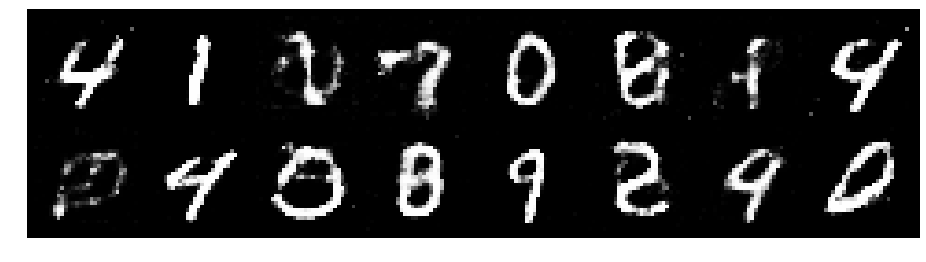

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9055
D(x): 0.5664, D(G(z)): 0.4328


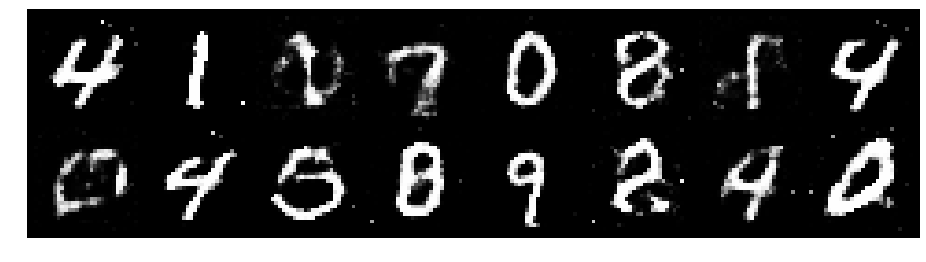

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.1946, Generator Loss: 1.0162
D(x): 0.5677, D(G(z)): 0.4021


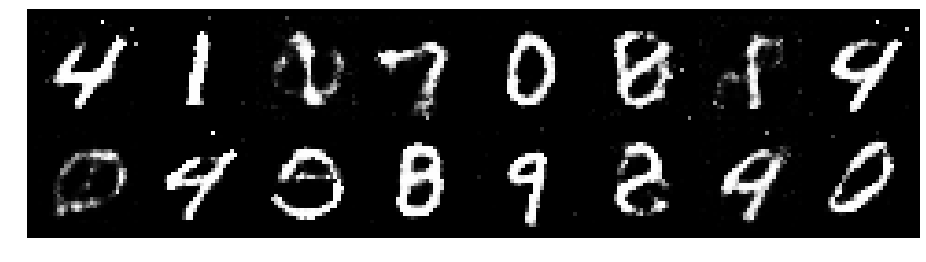

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.1537, Generator Loss: 1.0187
D(x): 0.5574, D(G(z)): 0.3951


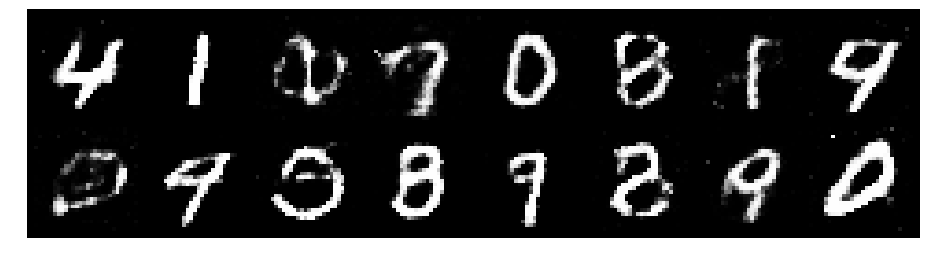

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2250, Generator Loss: 1.0153
D(x): 0.5426, D(G(z)): 0.3966


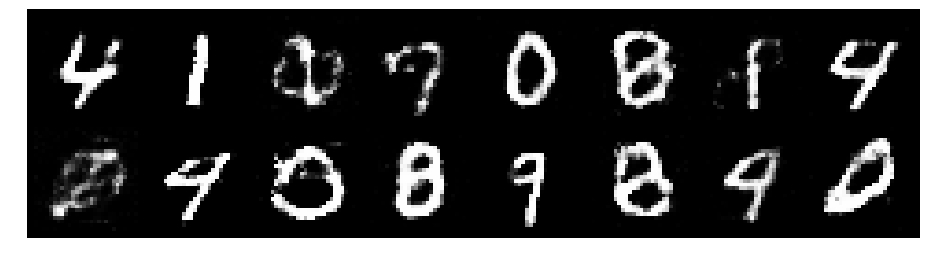

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2385, Generator Loss: 0.8043
D(x): 0.5530, D(G(z)): 0.4481


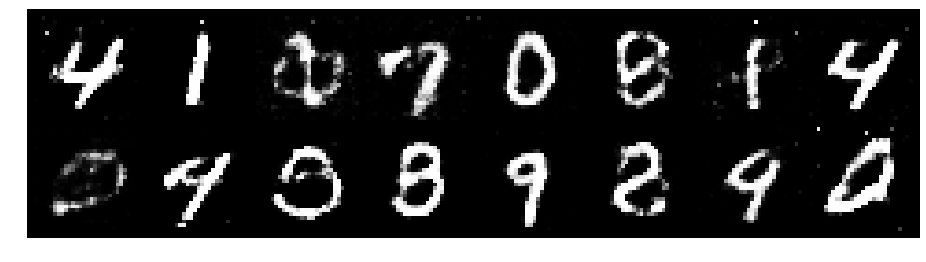

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.3003, Generator Loss: 0.9441
D(x): 0.5034, D(G(z)): 0.4181


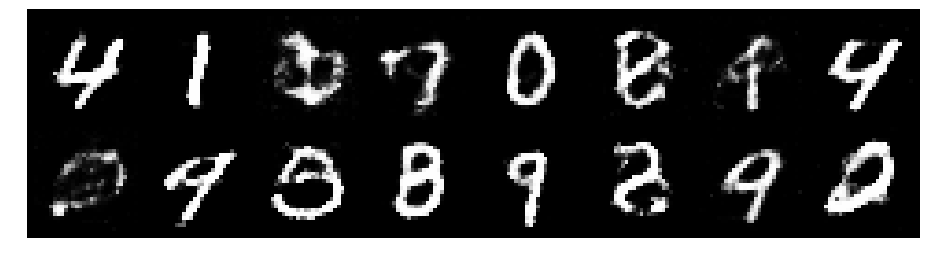

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.1700, Generator Loss: 0.9612
D(x): 0.5388, D(G(z)): 0.3719


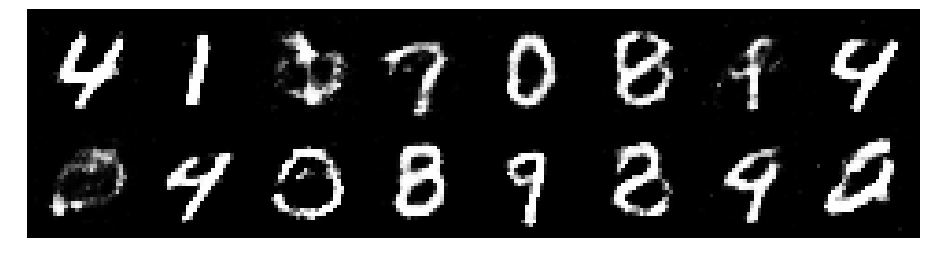

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3398, Generator Loss: 0.7832
D(x): 0.5638, D(G(z)): 0.4745


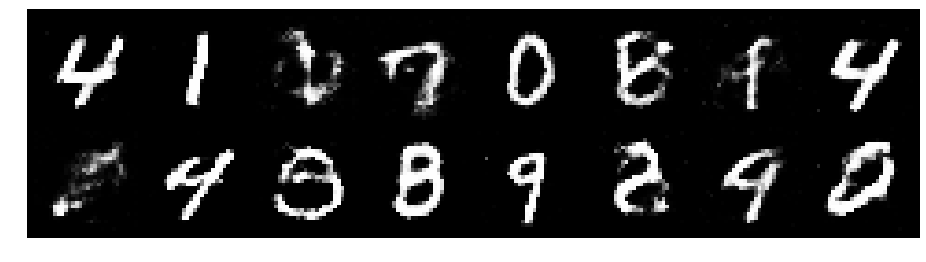

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.3334, Generator Loss: 0.7790
D(x): 0.6039, D(G(z)): 0.5039


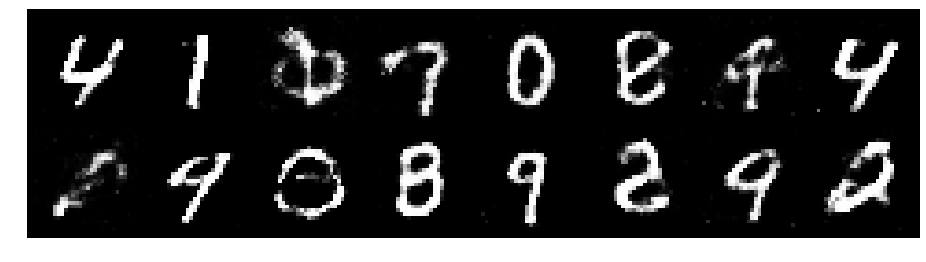

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.5351, Generator Loss: 0.8016
D(x): 0.5282, D(G(z)): 0.5290


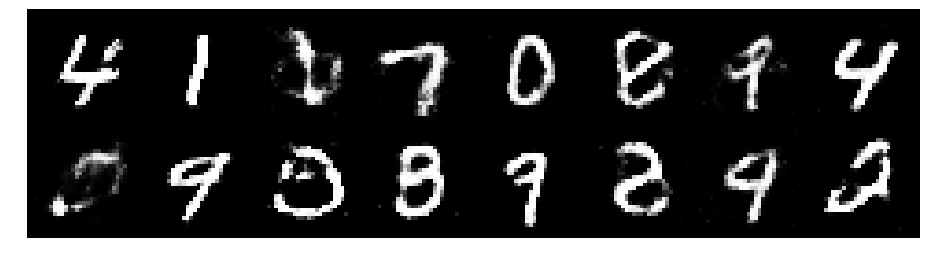

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3386, Generator Loss: 0.8142
D(x): 0.5239, D(G(z)): 0.4579


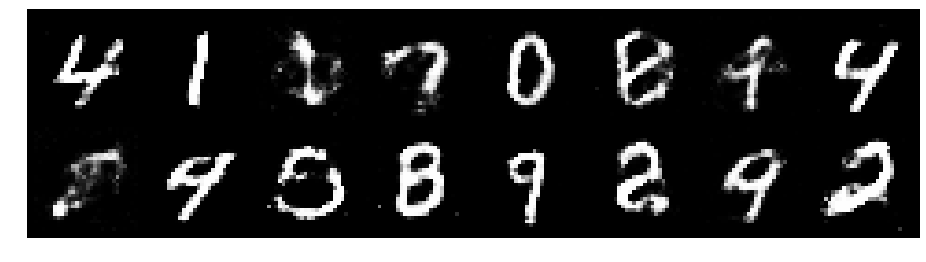

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.3261, Generator Loss: 1.0192
D(x): 0.5311, D(G(z)): 0.4226


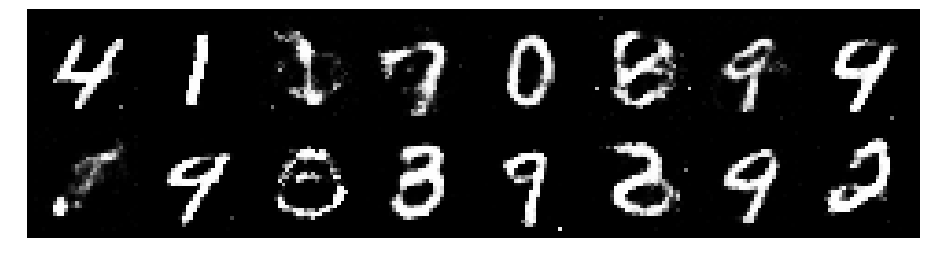

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2768, Generator Loss: 1.0542
D(x): 0.5800, D(G(z)): 0.4471


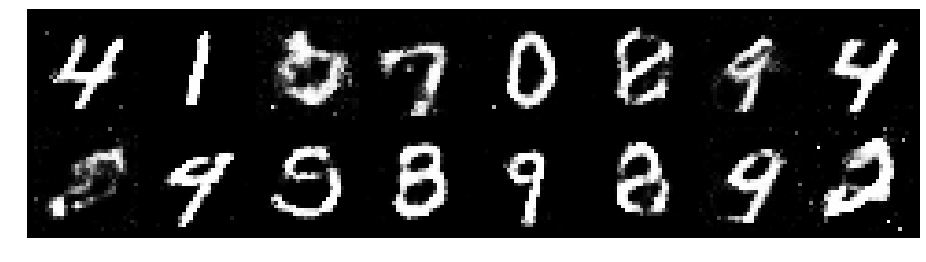

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.1801, Generator Loss: 1.0200
D(x): 0.5532, D(G(z)): 0.3933


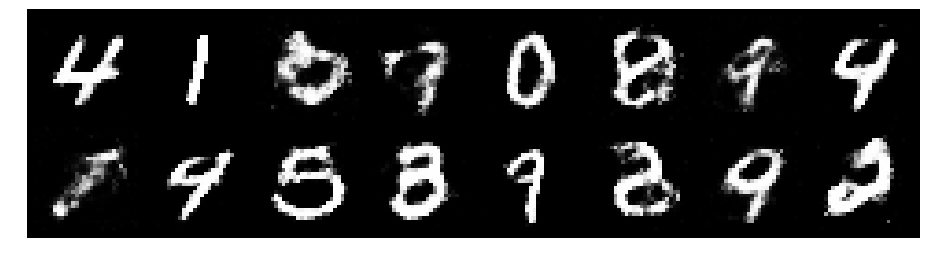

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.1660, Generator Loss: 0.9301
D(x): 0.5759, D(G(z)): 0.4281


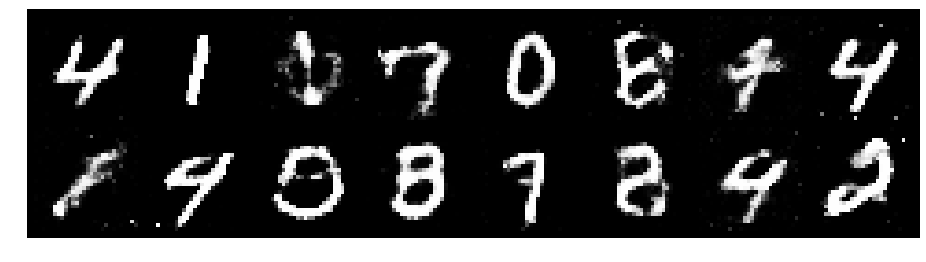

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.3374, Generator Loss: 0.7542
D(x): 0.5751, D(G(z)): 0.5074


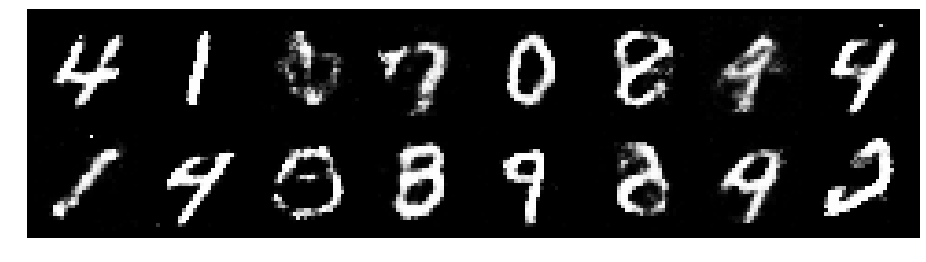

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3729, Generator Loss: 0.8312
D(x): 0.5459, D(G(z)): 0.4808


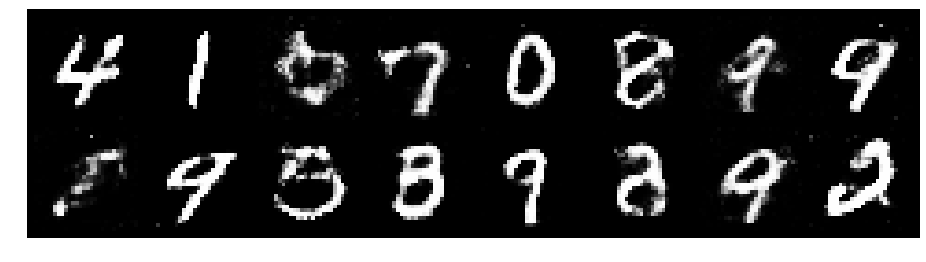

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.4125, Generator Loss: 0.8750
D(x): 0.5119, D(G(z)): 0.4579


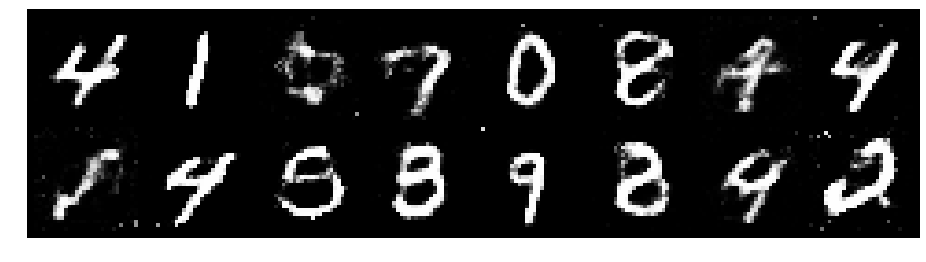

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2875, Generator Loss: 0.8320
D(x): 0.5336, D(G(z)): 0.4500


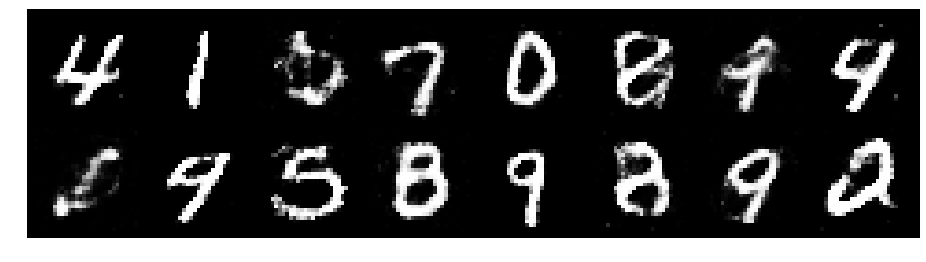

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.3627, Generator Loss: 0.8459
D(x): 0.5287, D(G(z)): 0.4676


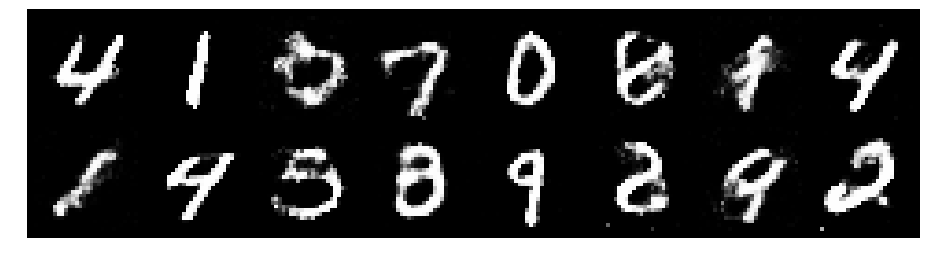

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3254, Generator Loss: 0.9629
D(x): 0.5085, D(G(z)): 0.4146


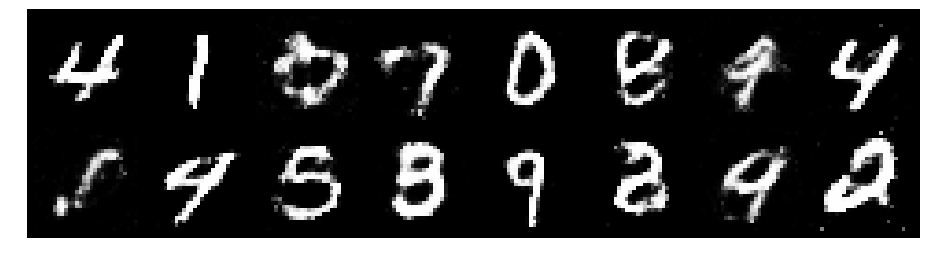

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2298, Generator Loss: 1.0987
D(x): 0.5181, D(G(z)): 0.3765


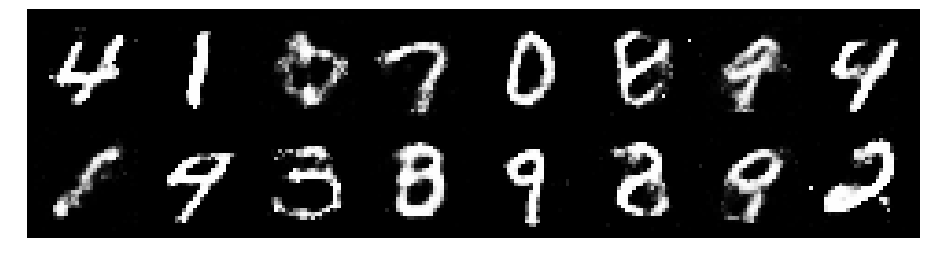

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.3817, Generator Loss: 0.8664
D(x): 0.5308, D(G(z)): 0.4690


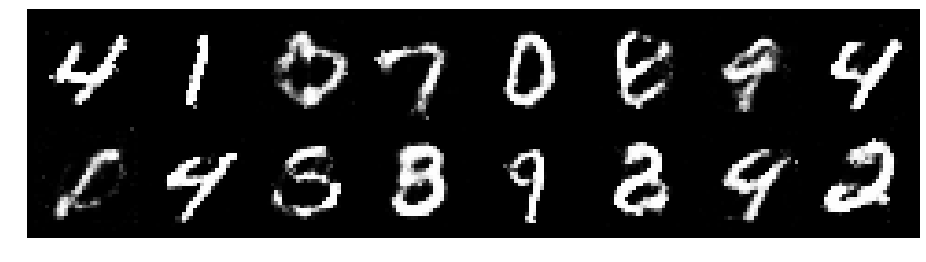

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2190, Generator Loss: 0.9284
D(x): 0.5812, D(G(z)): 0.4314


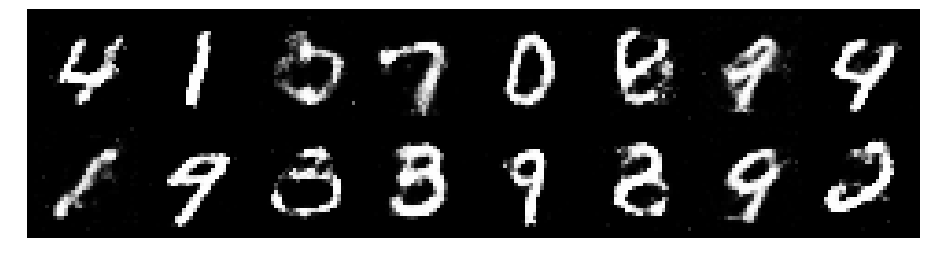

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.3059, Generator Loss: 0.9931
D(x): 0.5242, D(G(z)): 0.4398


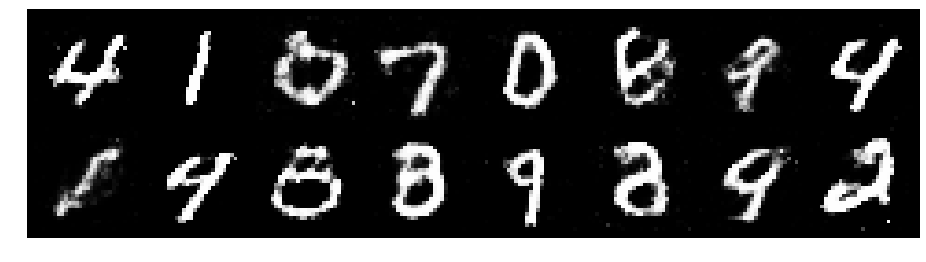

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.1171, Generator Loss: 1.0305
D(x): 0.6129, D(G(z)): 0.4009


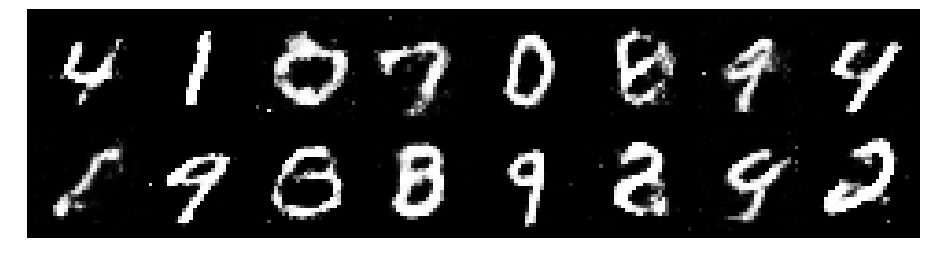

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1029, Generator Loss: 1.0028
D(x): 0.6110, D(G(z)): 0.4143


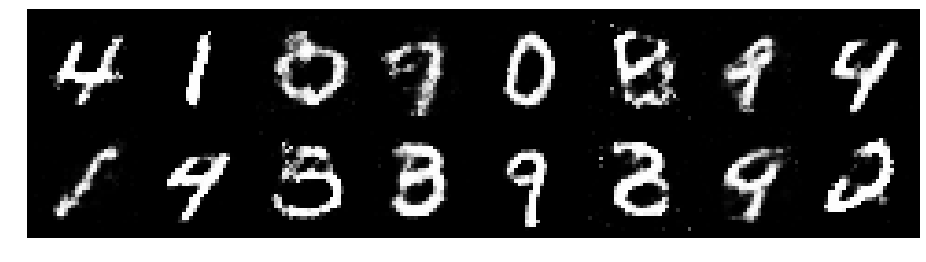

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.1301, Generator Loss: 1.0109
D(x): 0.5698, D(G(z)): 0.3851


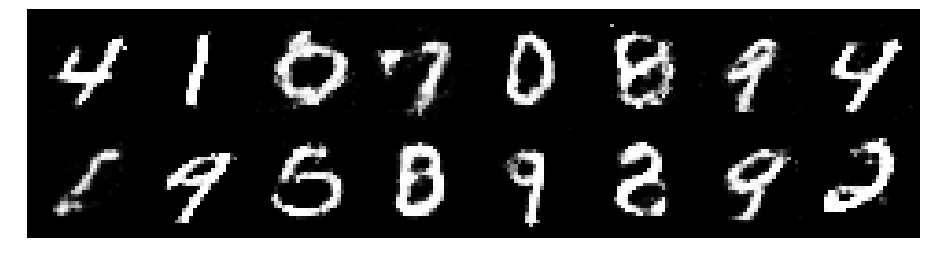

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2108, Generator Loss: 1.0865
D(x): 0.6206, D(G(z)): 0.4245


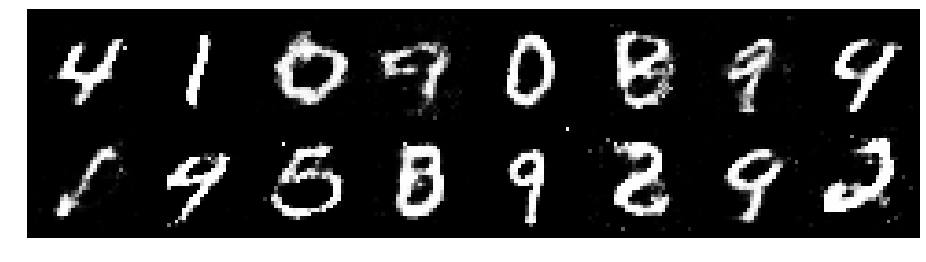

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2236, Generator Loss: 1.0238
D(x): 0.5638, D(G(z)): 0.4170


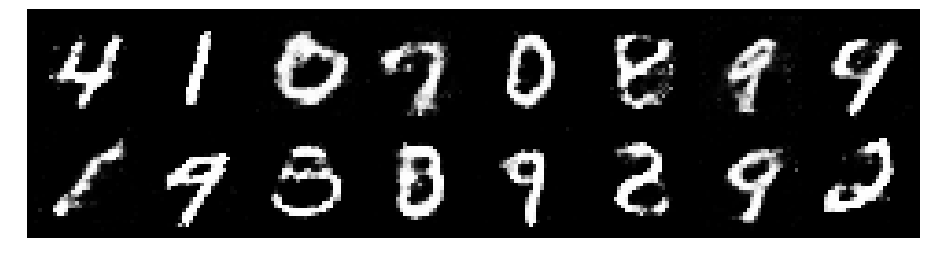

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2208, Generator Loss: 1.0396
D(x): 0.5728, D(G(z)): 0.4019


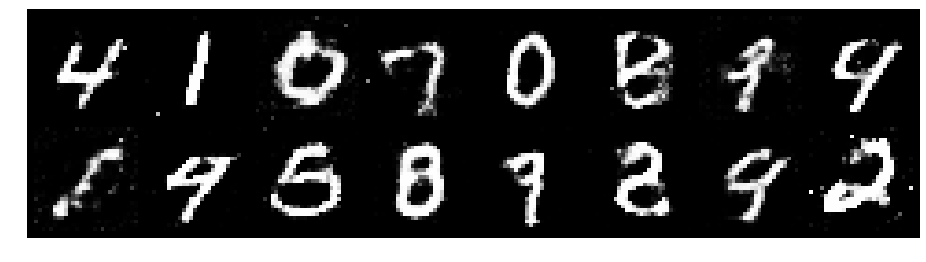

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.1879, Generator Loss: 0.8547
D(x): 0.6092, D(G(z)): 0.4614


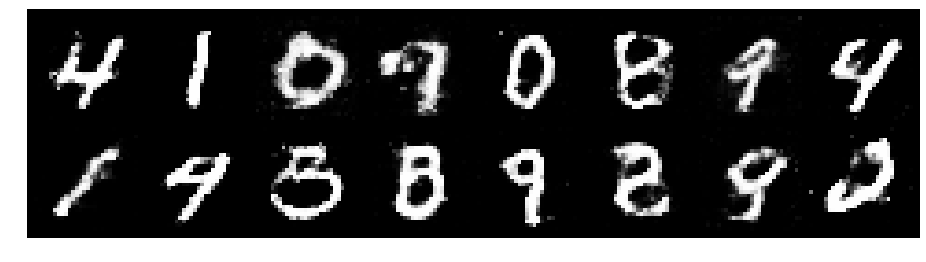

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.1834, Generator Loss: 0.8133
D(x): 0.5849, D(G(z)): 0.4439


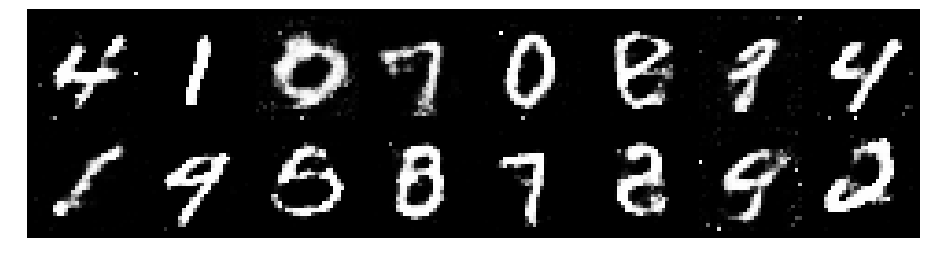

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2511, Generator Loss: 0.8677
D(x): 0.5379, D(G(z)): 0.4417


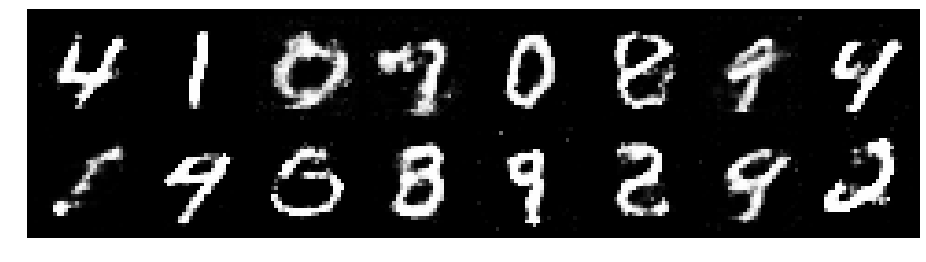

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2192, Generator Loss: 0.8235
D(x): 0.5831, D(G(z)): 0.4540


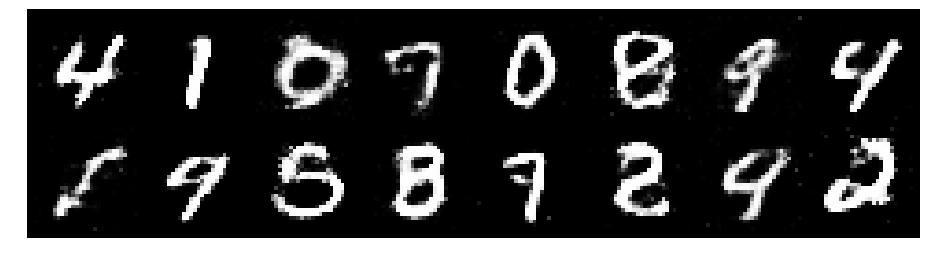

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.3767, Generator Loss: 0.7930
D(x): 0.5270, D(G(z)): 0.4761


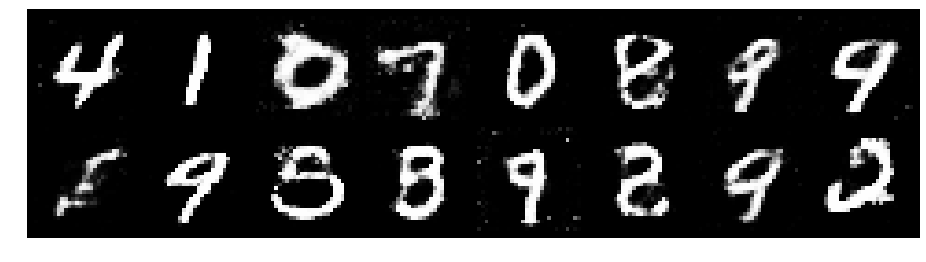

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.3513, Generator Loss: 0.8892
D(x): 0.5284, D(G(z)): 0.4484


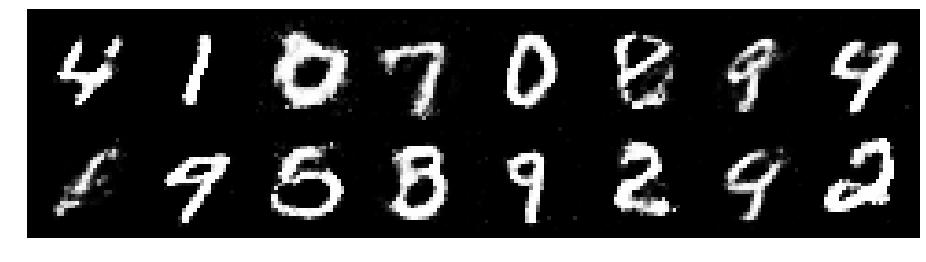

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2508, Generator Loss: 0.7900
D(x): 0.5796, D(G(z)): 0.4703


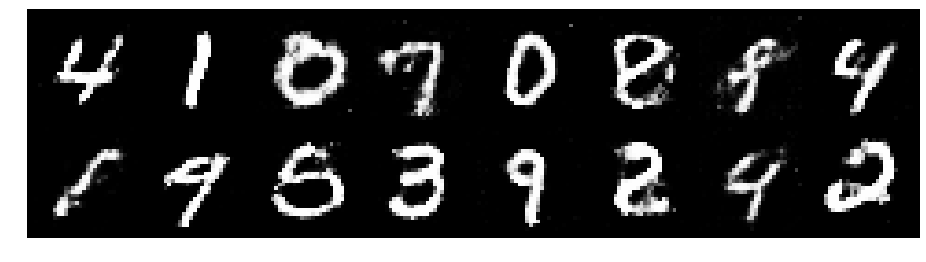

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.5031, Generator Loss: 0.7770
D(x): 0.4860, D(G(z)): 0.4819


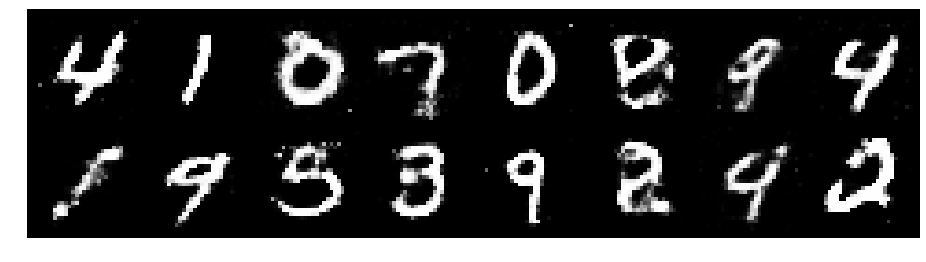

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.1752, Generator Loss: 1.0424
D(x): 0.5995, D(G(z)): 0.4190


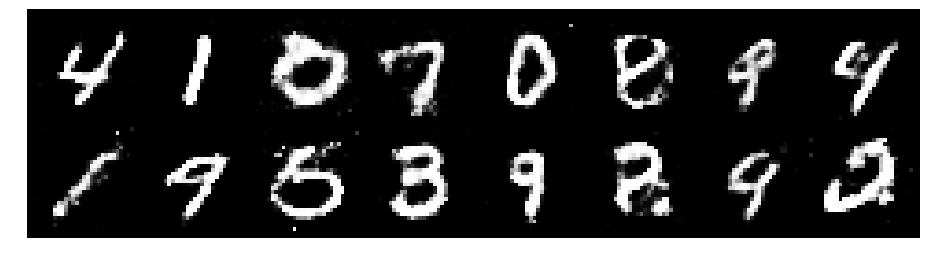

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.1925, Generator Loss: 1.0064
D(x): 0.5834, D(G(z)): 0.4162


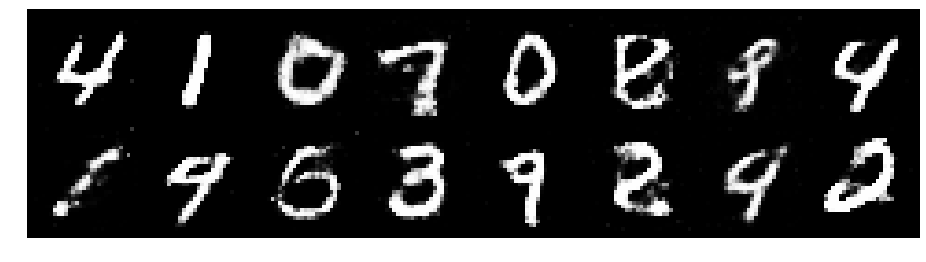

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.1711, Generator Loss: 0.9979
D(x): 0.5693, D(G(z)): 0.3892


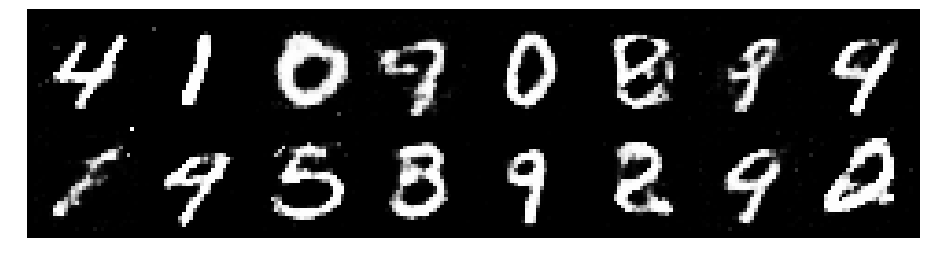

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.3134, Generator Loss: 0.9169
D(x): 0.5746, D(G(z)): 0.4635


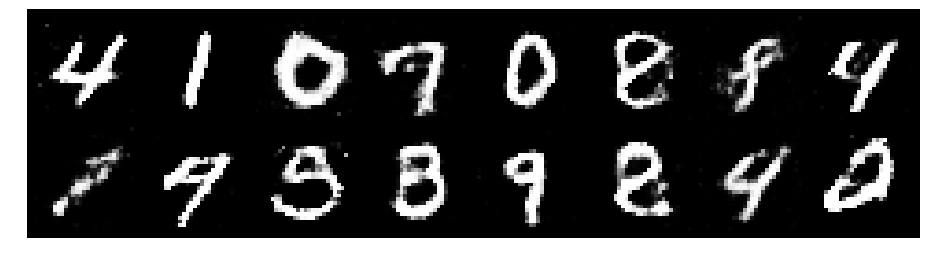

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3053, Generator Loss: 0.8324
D(x): 0.5929, D(G(z)): 0.4899


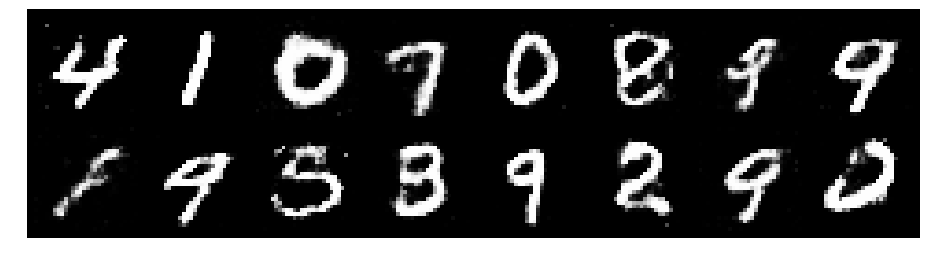

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.3365, Generator Loss: 0.8432
D(x): 0.5374, D(G(z)): 0.4578


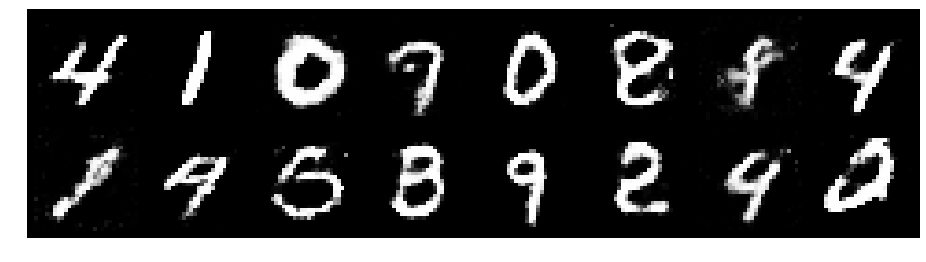

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2978, Generator Loss: 0.9622
D(x): 0.5244, D(G(z)): 0.4312


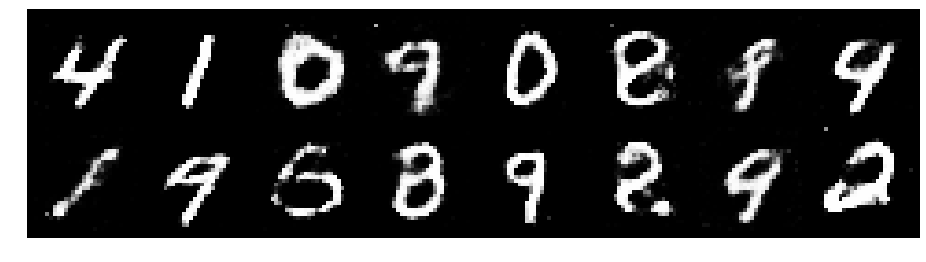

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.3052, Generator Loss: 1.0090
D(x): 0.5655, D(G(z)): 0.4630


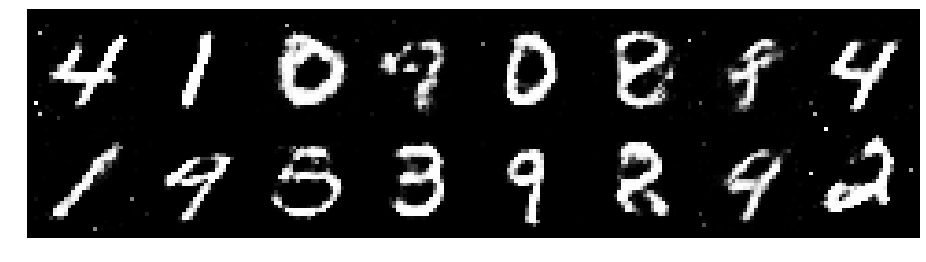

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2272, Generator Loss: 1.0062
D(x): 0.5738, D(G(z)): 0.4415


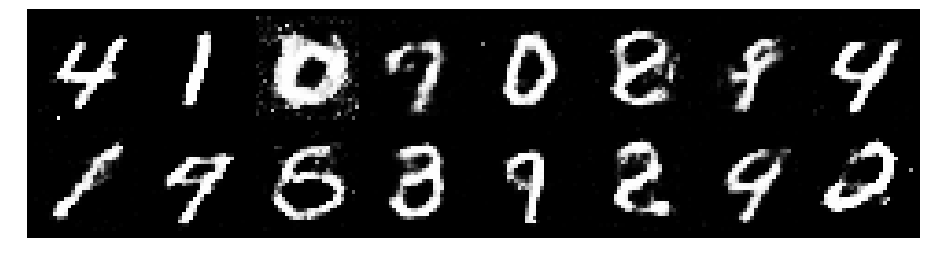

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2135, Generator Loss: 0.8131
D(x): 0.5578, D(G(z)): 0.4261


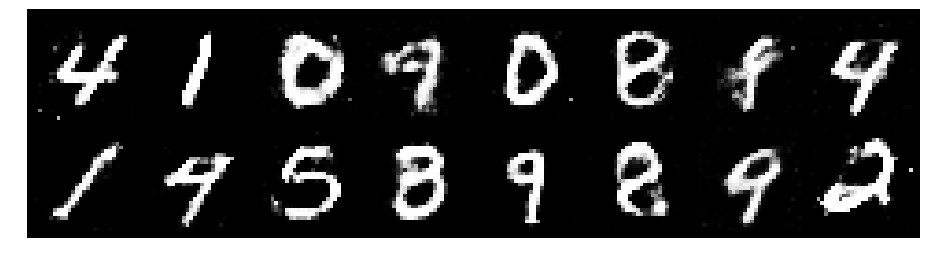

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3218, Generator Loss: 0.7429
D(x): 0.5739, D(G(z)): 0.4979


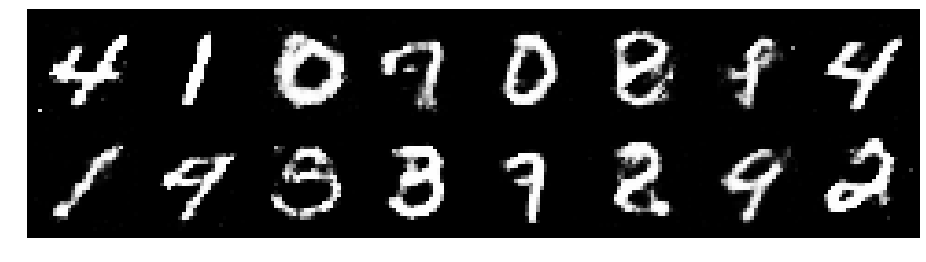

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.3054, Generator Loss: 1.0311
D(x): 0.5190, D(G(z)): 0.4210


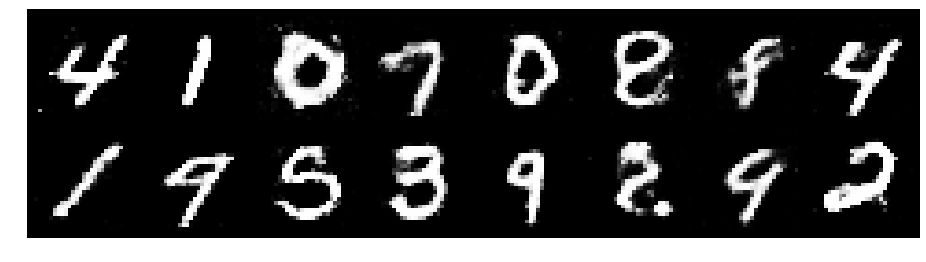

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.4438, Generator Loss: 0.7668
D(x): 0.5278, D(G(z)): 0.5017


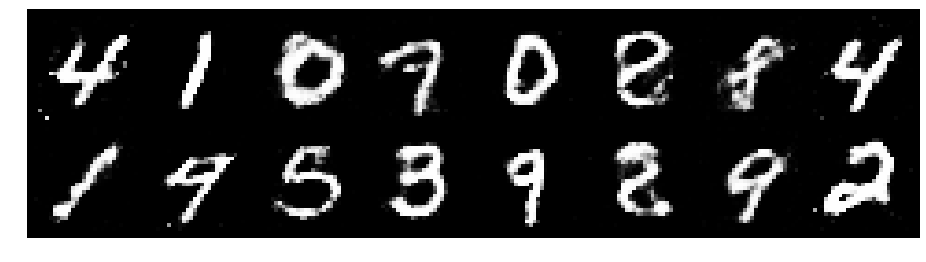

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.3254, Generator Loss: 1.0231
D(x): 0.5798, D(G(z)): 0.4764


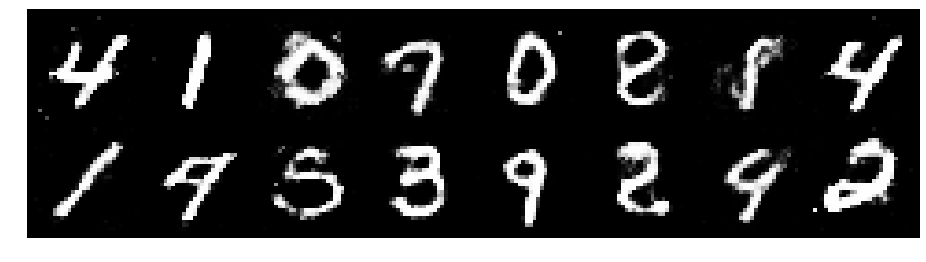

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3062, Generator Loss: 0.9809
D(x): 0.5085, D(G(z)): 0.4161


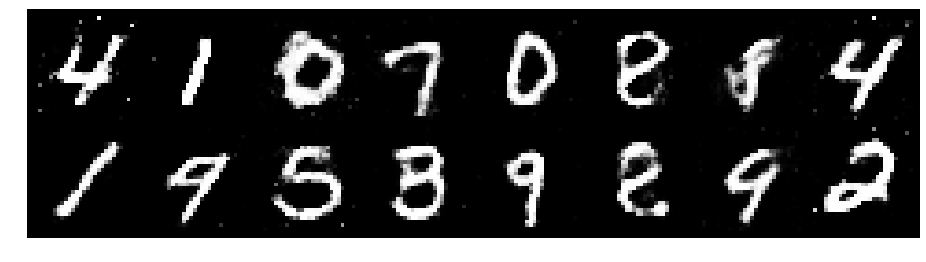

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2037, Generator Loss: 0.9267
D(x): 0.5400, D(G(z)): 0.3982


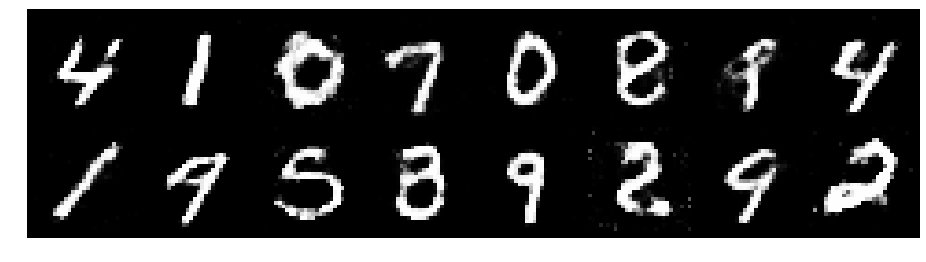

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2068, Generator Loss: 1.0378
D(x): 0.5595, D(G(z)): 0.4073


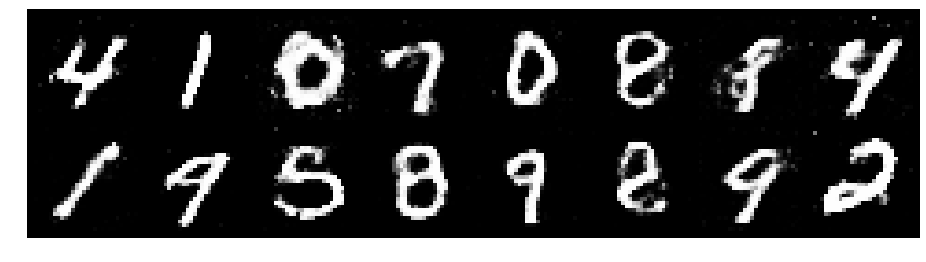

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2208, Generator Loss: 0.9198
D(x): 0.5948, D(G(z)): 0.4612


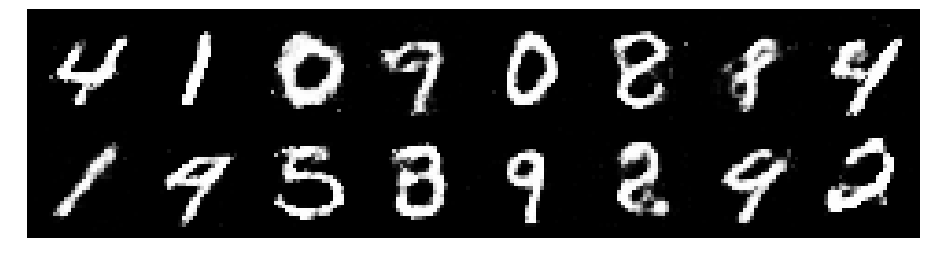

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.3108, Generator Loss: 0.9367
D(x): 0.5115, D(G(z)): 0.4176


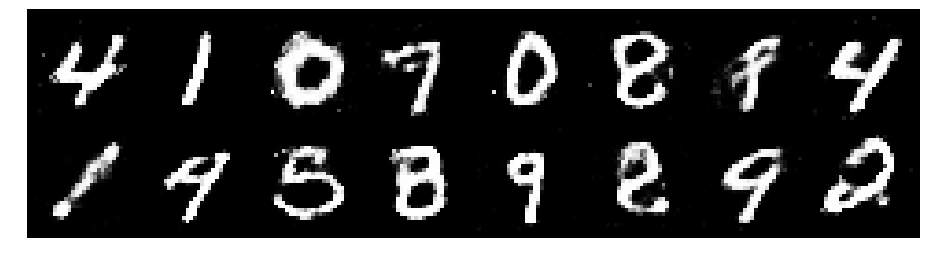

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2415, Generator Loss: 1.0893
D(x): 0.5597, D(G(z)): 0.3902


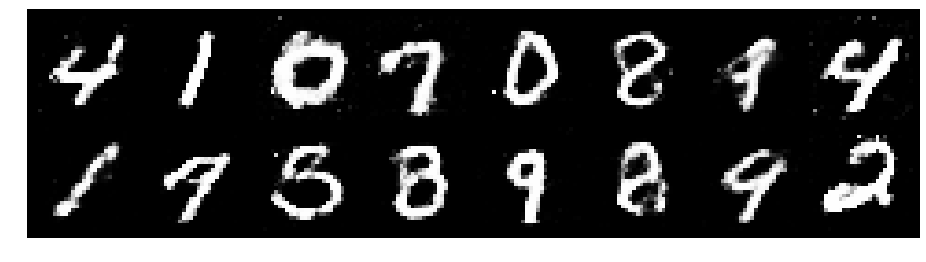

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2388, Generator Loss: 0.9739
D(x): 0.5621, D(G(z)): 0.4029


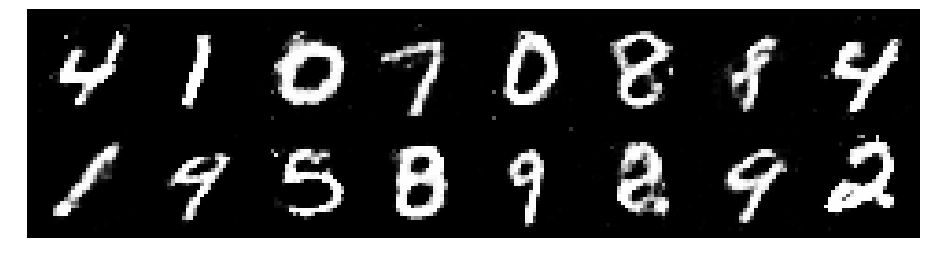

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2957, Generator Loss: 0.9339
D(x): 0.5364, D(G(z)): 0.4466


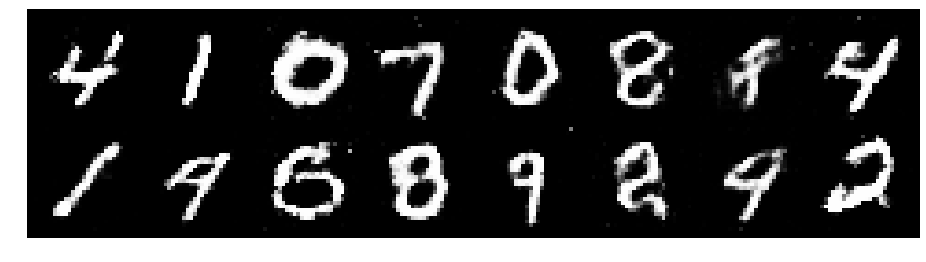

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3256, Generator Loss: 0.8885
D(x): 0.5247, D(G(z)): 0.4415


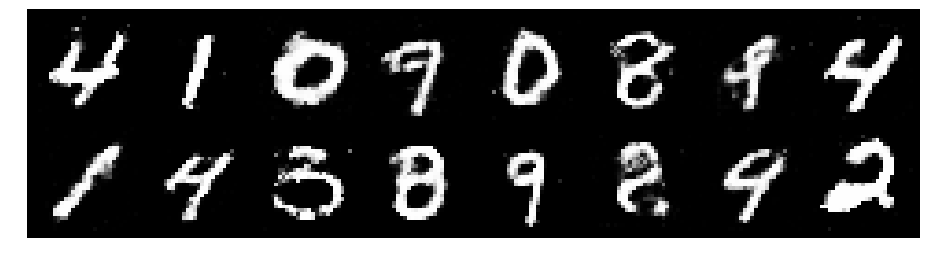

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3605, Generator Loss: 0.9509
D(x): 0.5511, D(G(z)): 0.4758


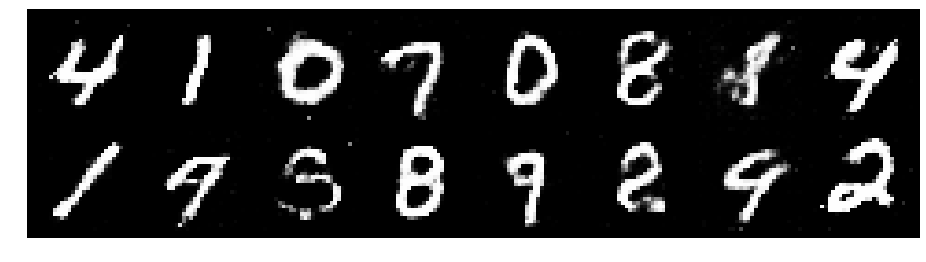

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2838, Generator Loss: 0.9773
D(x): 0.5860, D(G(z)): 0.4690


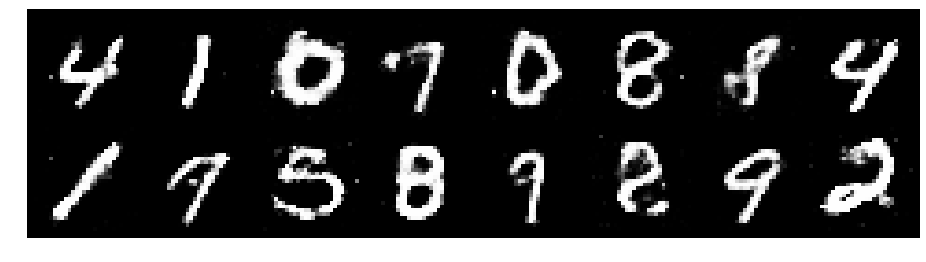

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3070, Generator Loss: 0.8846
D(x): 0.5186, D(G(z)): 0.4326


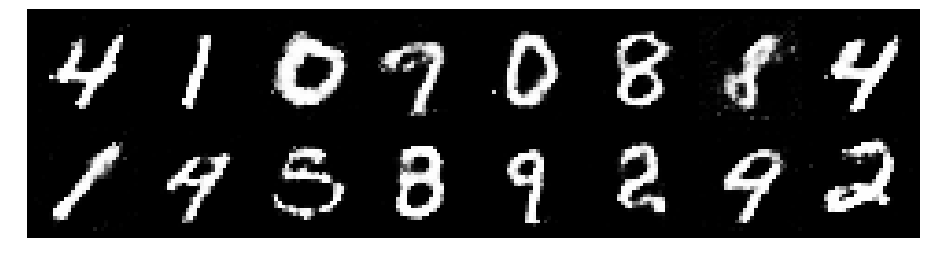

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.3332, Generator Loss: 0.8761
D(x): 0.5247, D(G(z)): 0.4470


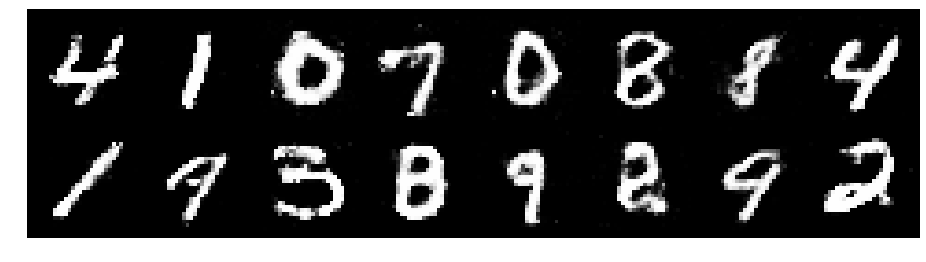

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.3044, Generator Loss: 0.7900
D(x): 0.5764, D(G(z)): 0.4900


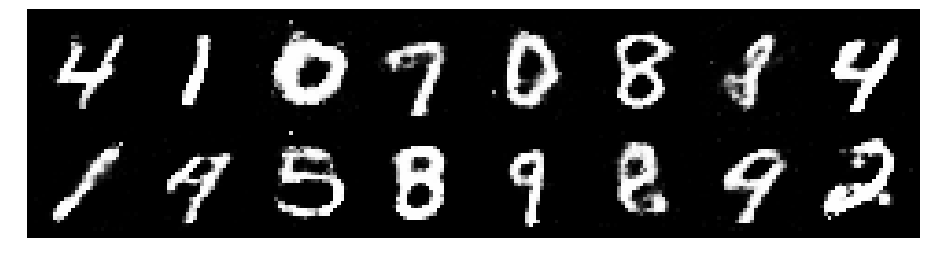

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.4004, Generator Loss: 0.7952
D(x): 0.5322, D(G(z)): 0.4933


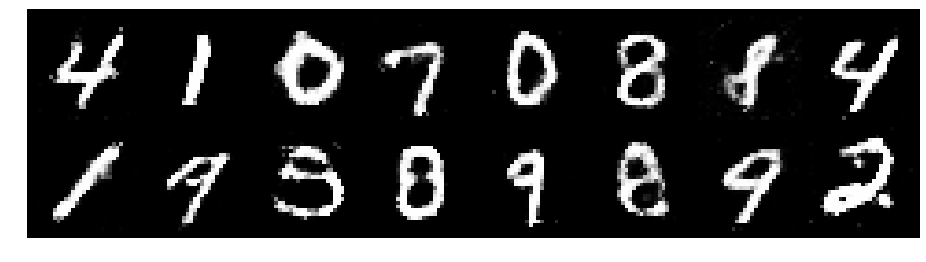

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2451, Generator Loss: 1.0564
D(x): 0.5594, D(G(z)): 0.4170


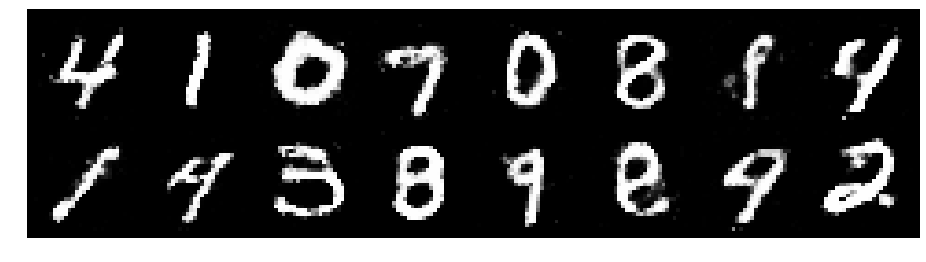

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.1360, Generator Loss: 0.9761
D(x): 0.5733, D(G(z)): 0.3997


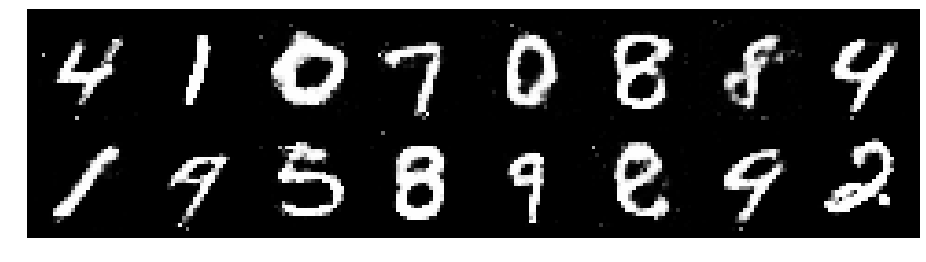

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2672, Generator Loss: 0.8593
D(x): 0.5448, D(G(z)): 0.4540


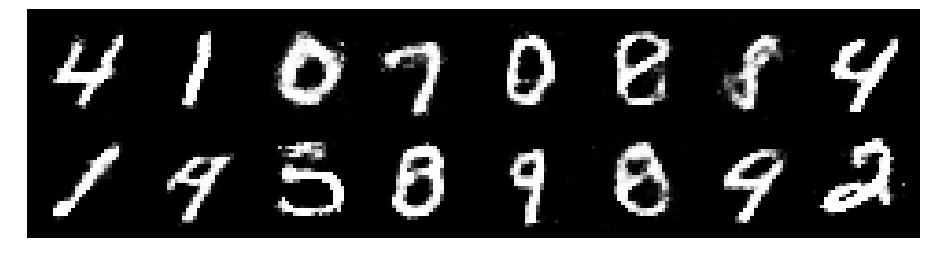

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.1167, Generator Loss: 0.9049
D(x): 0.5982, D(G(z)): 0.4054


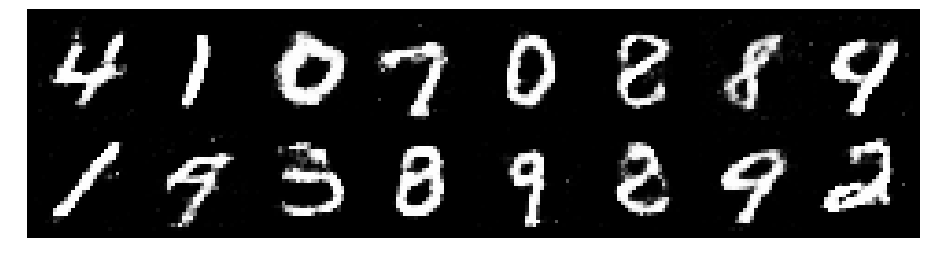

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1977, Generator Loss: 0.9775
D(x): 0.5553, D(G(z)): 0.3901


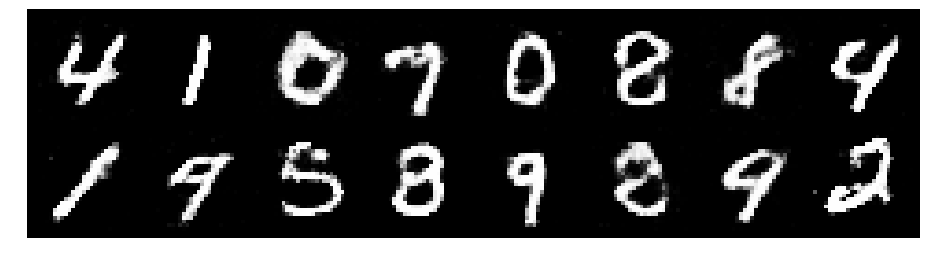

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2647, Generator Loss: 0.9587
D(x): 0.5362, D(G(z)): 0.4205


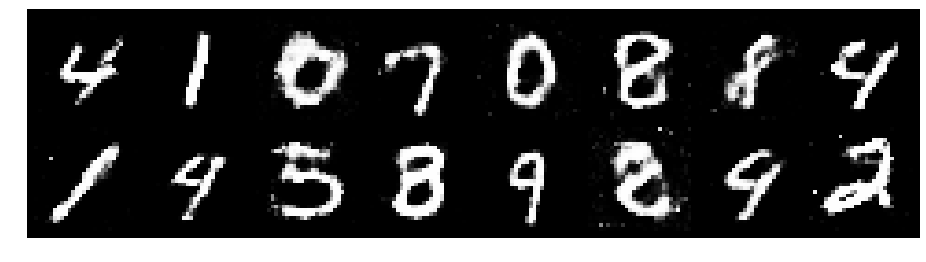

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2740, Generator Loss: 0.8336
D(x): 0.5484, D(G(z)): 0.4703


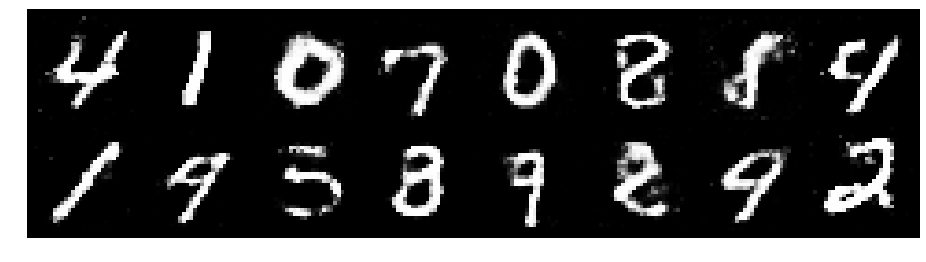

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9113
D(x): 0.5623, D(G(z)): 0.4471


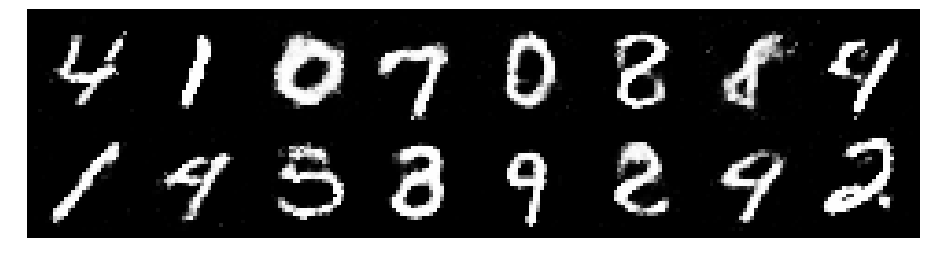

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3256, Generator Loss: 0.8439
D(x): 0.5410, D(G(z)): 0.4667


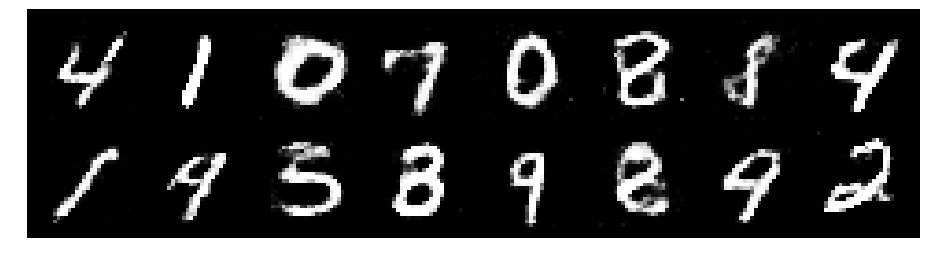

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2637, Generator Loss: 0.8328
D(x): 0.5537, D(G(z)): 0.4471


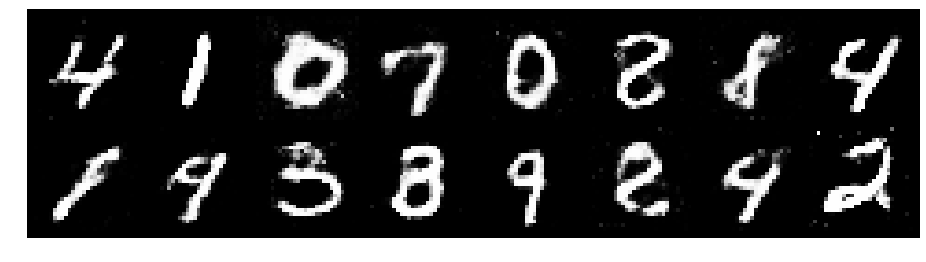

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2815, Generator Loss: 0.7408
D(x): 0.5285, D(G(z)): 0.4426


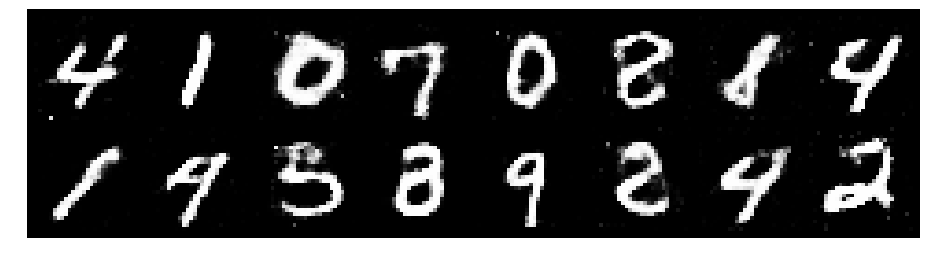

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2728, Generator Loss: 0.8209
D(x): 0.5688, D(G(z)): 0.4365


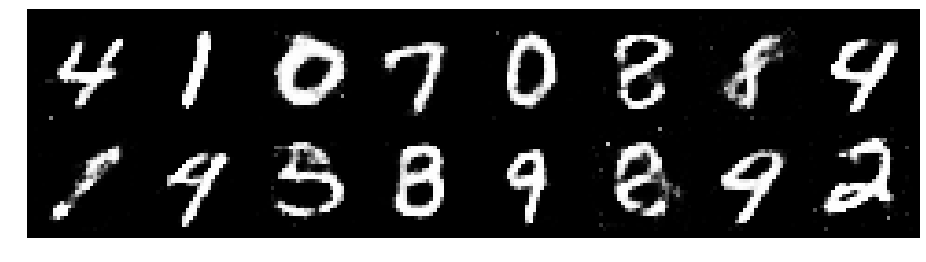

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2044, Generator Loss: 0.8850
D(x): 0.5620, D(G(z)): 0.4178


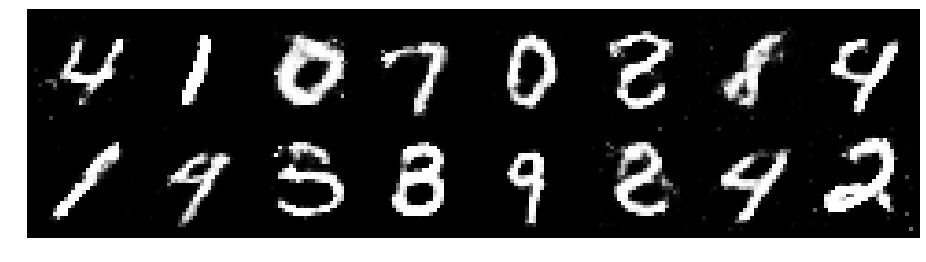

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2235, Generator Loss: 0.9425
D(x): 0.5715, D(G(z)): 0.4351


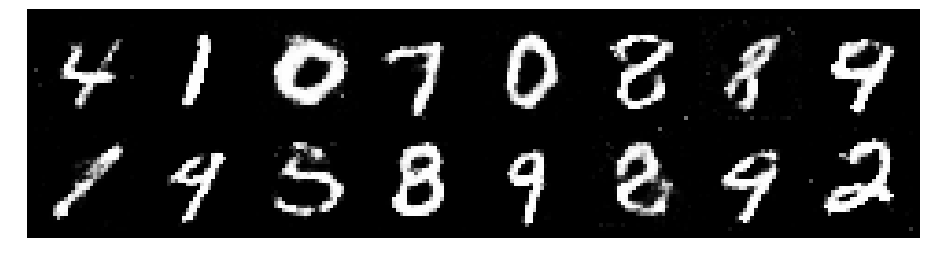

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2085, Generator Loss: 0.9447
D(x): 0.5676, D(G(z)): 0.4190


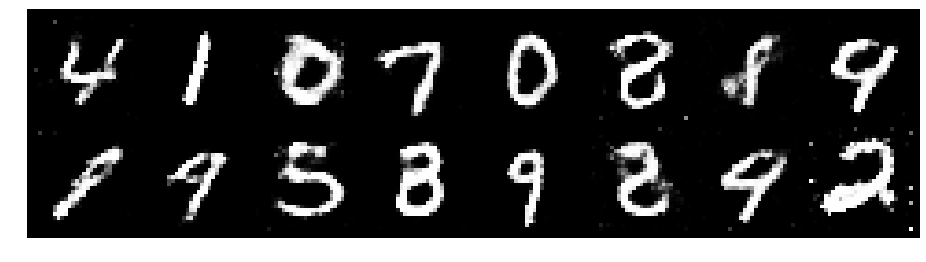

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8637
D(x): 0.5454, D(G(z)): 0.4503


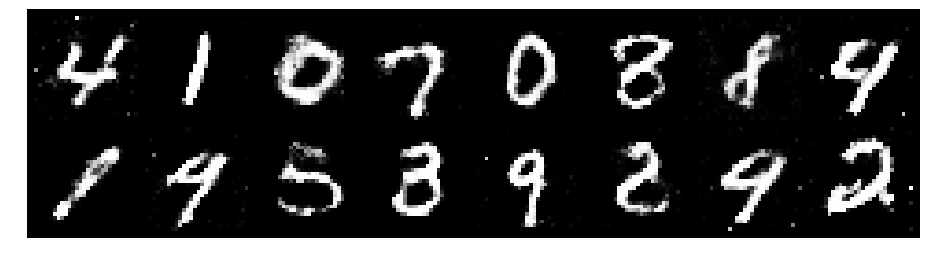

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2820, Generator Loss: 0.8108
D(x): 0.5440, D(G(z)): 0.4496


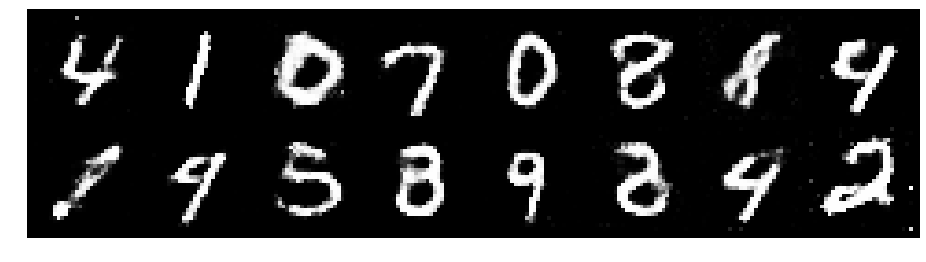

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2246, Generator Loss: 0.8527
D(x): 0.5549, D(G(z)): 0.4338


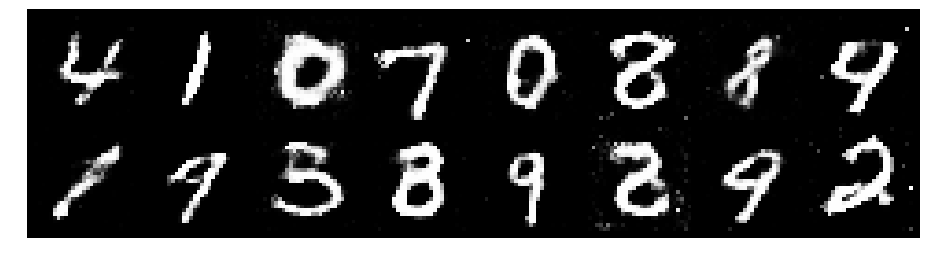

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2826, Generator Loss: 0.9029
D(x): 0.5431, D(G(z)): 0.4586


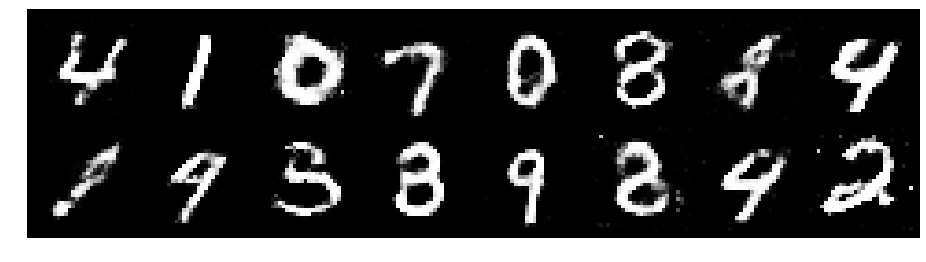

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.3602, Generator Loss: 0.9195
D(x): 0.5227, D(G(z)): 0.4457


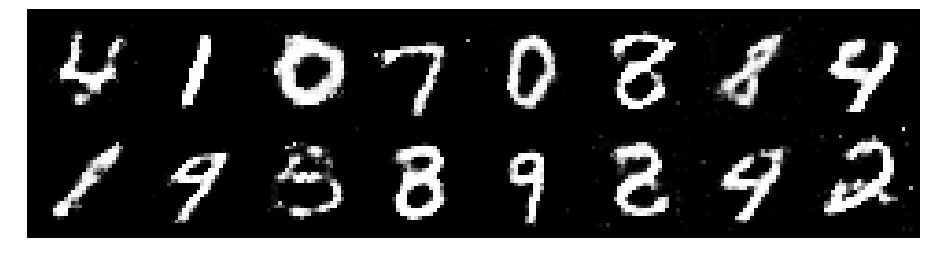

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.1913, Generator Loss: 1.0638
D(x): 0.5851, D(G(z)): 0.4146


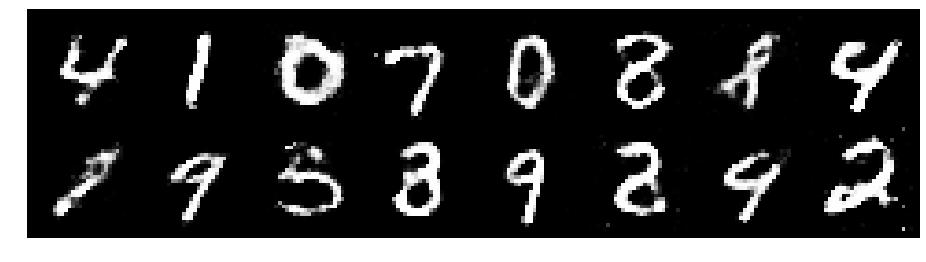

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.1795, Generator Loss: 1.1346
D(x): 0.5903, D(G(z)): 0.3775


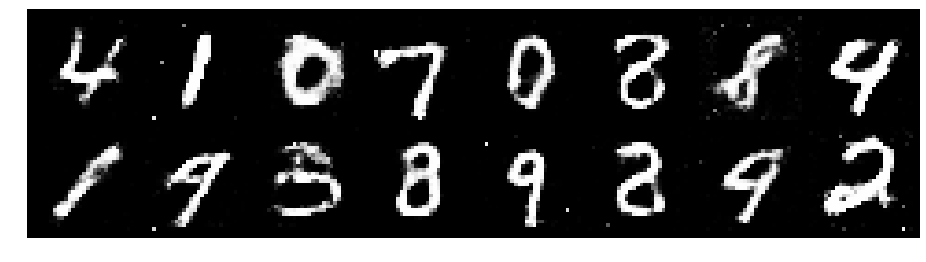

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.1703, Generator Loss: 0.9357
D(x): 0.5685, D(G(z)): 0.4161


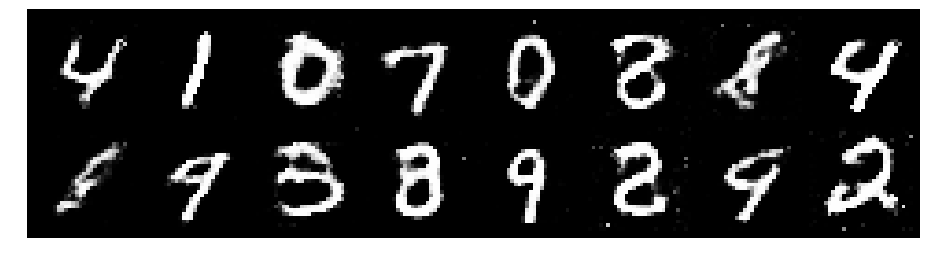

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.1852, Generator Loss: 0.9349
D(x): 0.5715, D(G(z)): 0.4134


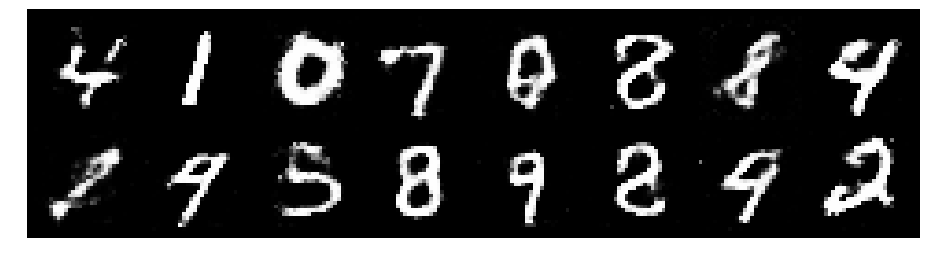

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2176, Generator Loss: 0.8514
D(x): 0.5768, D(G(z)): 0.4550


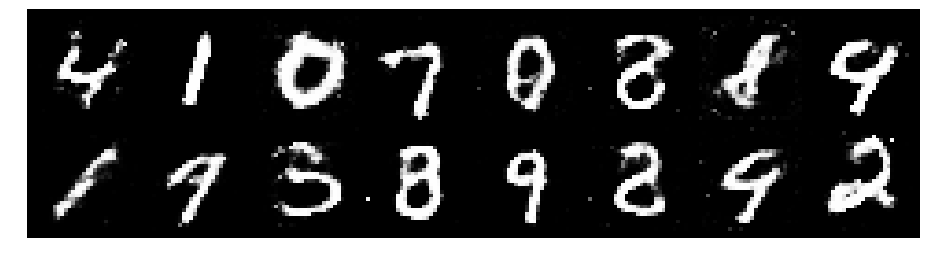

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2428, Generator Loss: 0.8151
D(x): 0.5929, D(G(z)): 0.4665


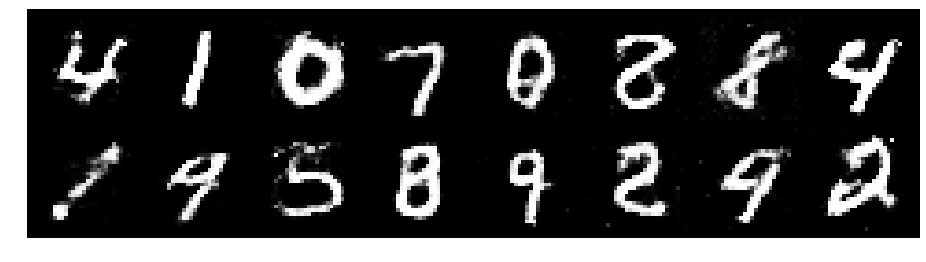

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2490, Generator Loss: 0.9337
D(x): 0.5793, D(G(z)): 0.4464


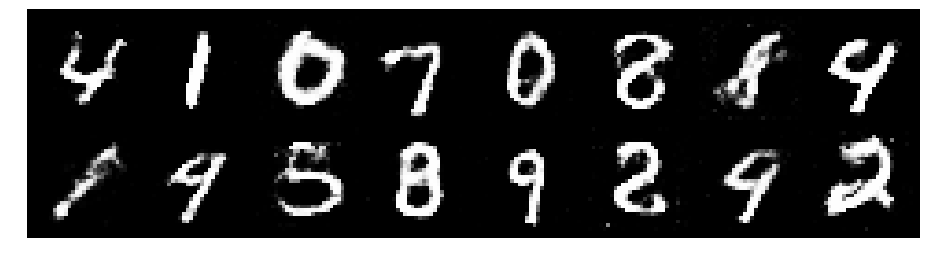

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2344, Generator Loss: 0.8536
D(x): 0.6074, D(G(z)): 0.4747


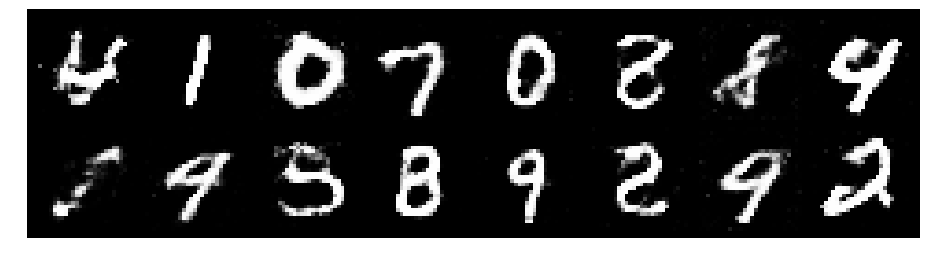

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2459, Generator Loss: 0.8386
D(x): 0.5745, D(G(z)): 0.4505


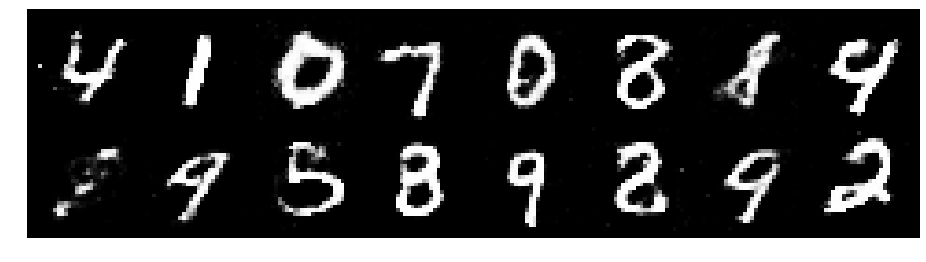

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.4205, Generator Loss: 0.7453
D(x): 0.5254, D(G(z)): 0.5079


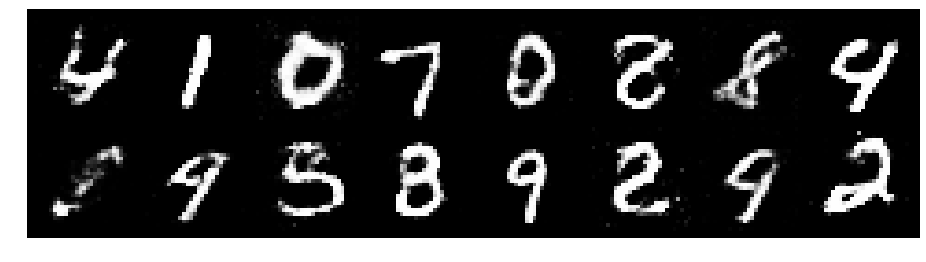

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2712, Generator Loss: 0.9572
D(x): 0.5652, D(G(z)): 0.4598


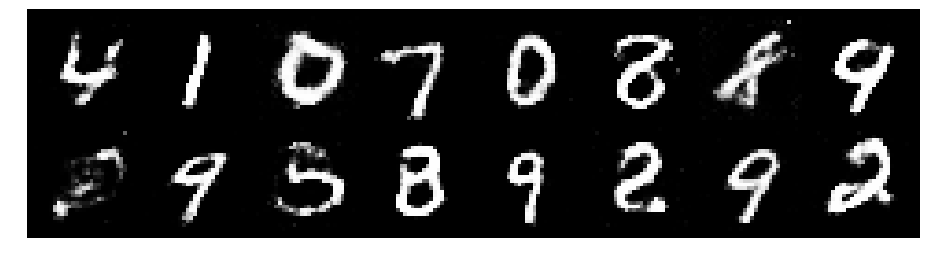

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.3387, Generator Loss: 0.8159
D(x): 0.5662, D(G(z)): 0.4697


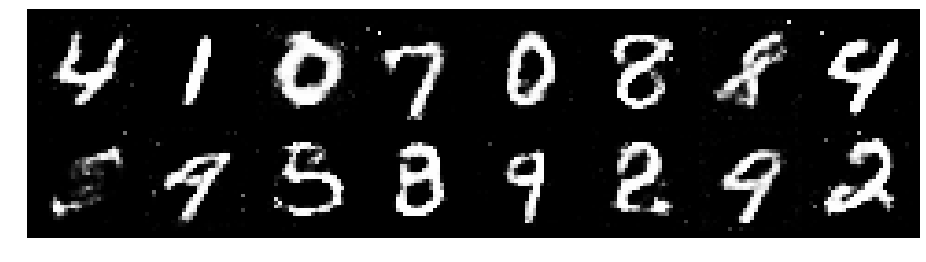

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.2949, Generator Loss: 0.9263
D(x): 0.5405, D(G(z)): 0.4410


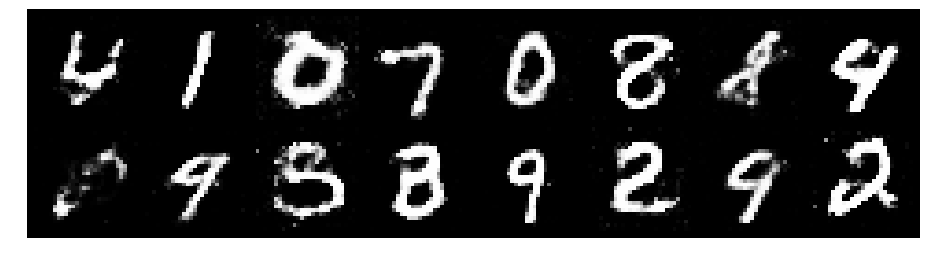

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.1600, Generator Loss: 0.9345
D(x): 0.5767, D(G(z)): 0.3912


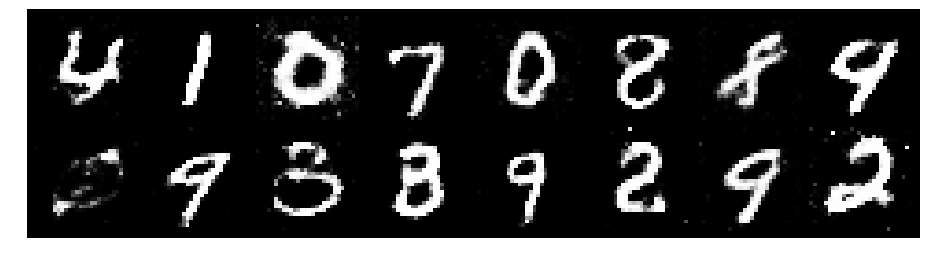

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3392, Generator Loss: 0.9005
D(x): 0.5230, D(G(z)): 0.4289


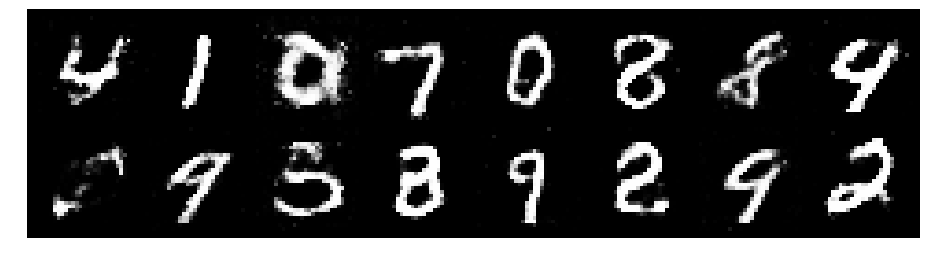

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2069, Generator Loss: 1.0038
D(x): 0.5752, D(G(z)): 0.4160


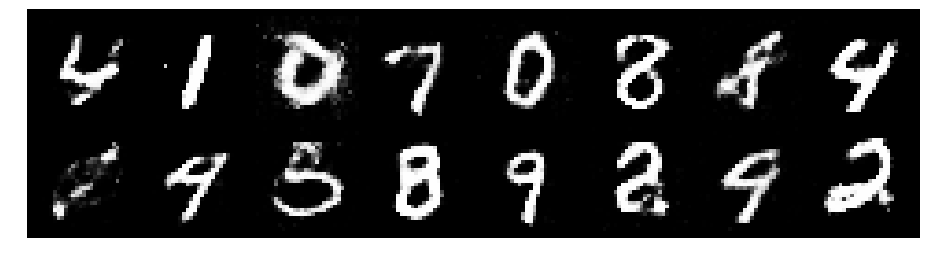

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2694, Generator Loss: 1.0572
D(x): 0.5508, D(G(z)): 0.4039


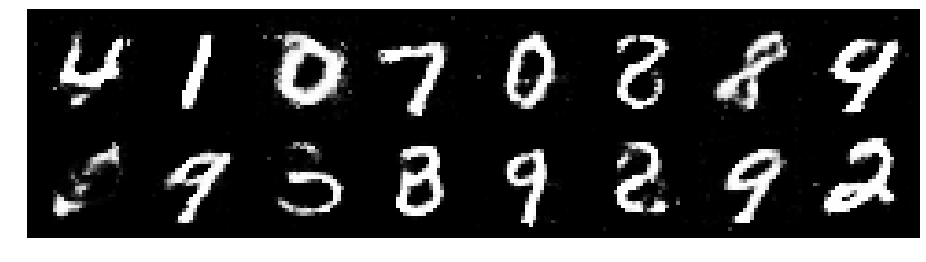

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.4147, Generator Loss: 1.0345
D(x): 0.5211, D(G(z)): 0.4615


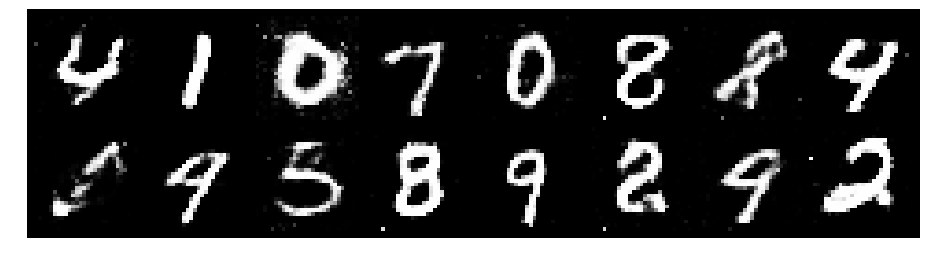

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2637, Generator Loss: 0.9098
D(x): 0.5861, D(G(z)): 0.4477


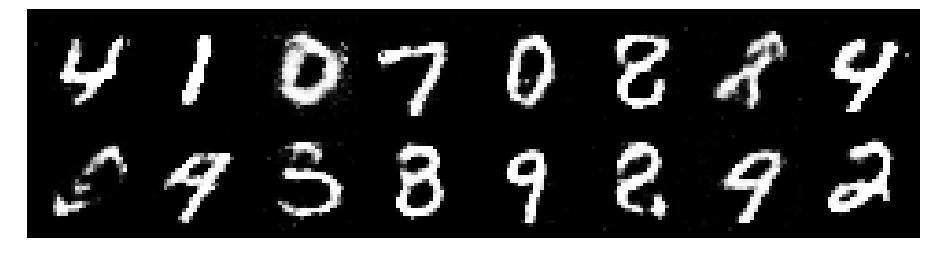

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2485, Generator Loss: 0.9226
D(x): 0.5574, D(G(z)): 0.4358


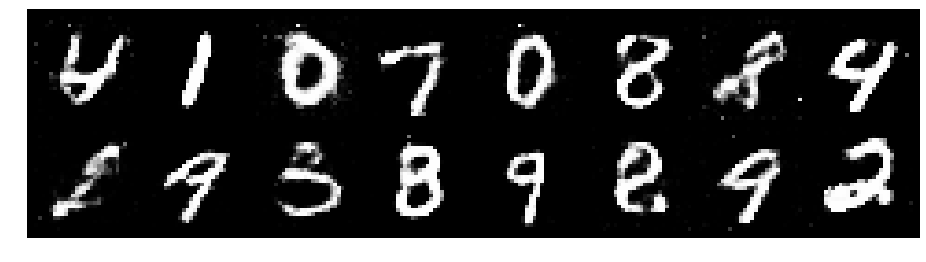

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.1831, Generator Loss: 0.9688
D(x): 0.5535, D(G(z)): 0.4139


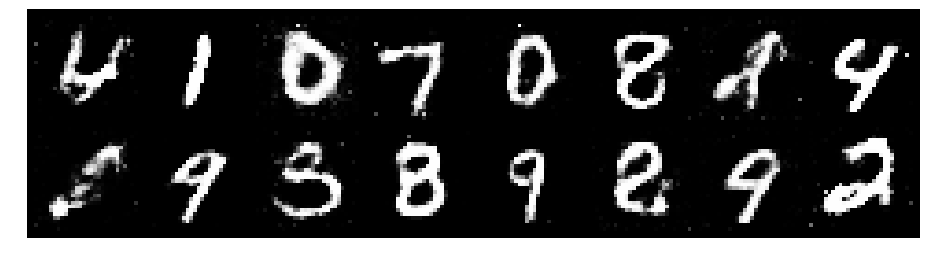

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.1121, Generator Loss: 0.9347
D(x): 0.6499, D(G(z)): 0.4281


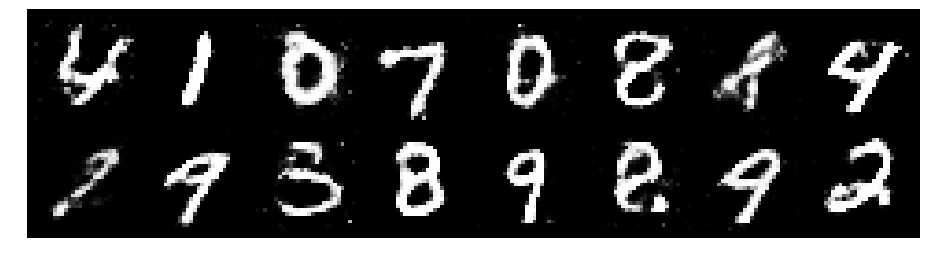

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9126
D(x): 0.5789, D(G(z)): 0.4614


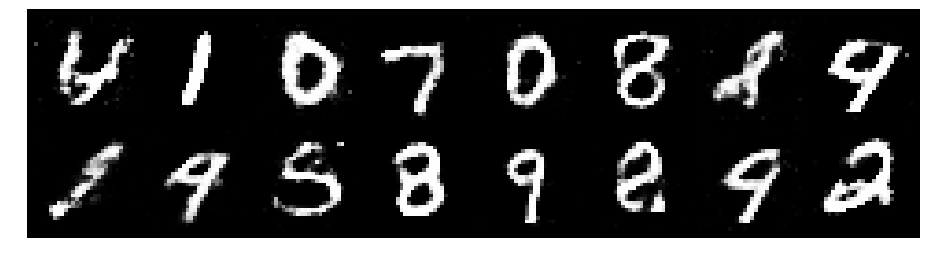

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.1067, Generator Loss: 1.0228
D(x): 0.5889, D(G(z)): 0.3898


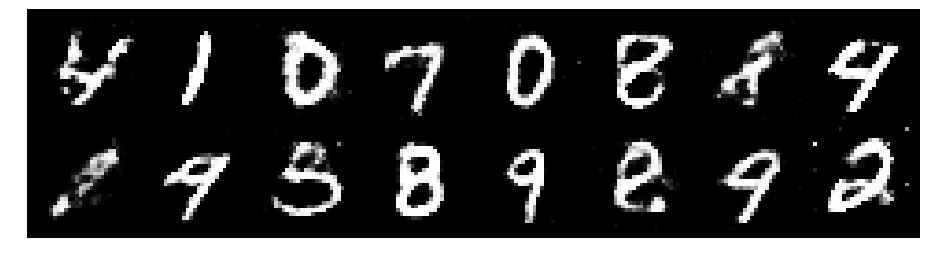

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2672, Generator Loss: 0.9212
D(x): 0.5199, D(G(z)): 0.4134


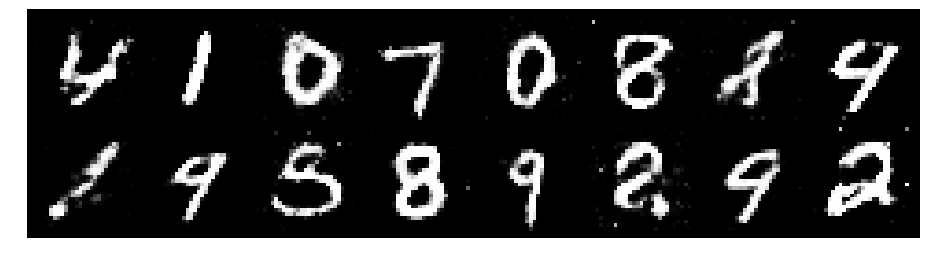

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.3610, Generator Loss: 0.8540
D(x): 0.5412, D(G(z)): 0.4620


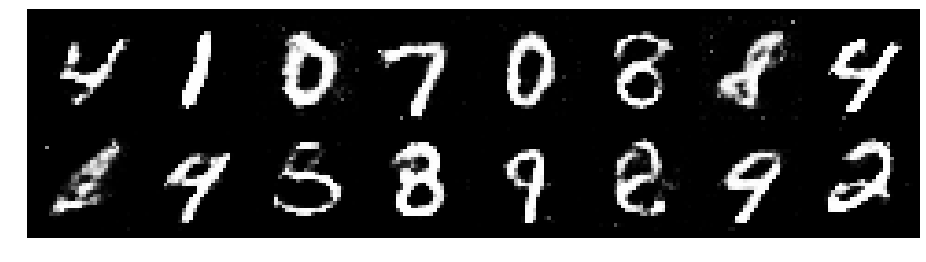

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.3613, Generator Loss: 1.0130
D(x): 0.5023, D(G(z)): 0.4302


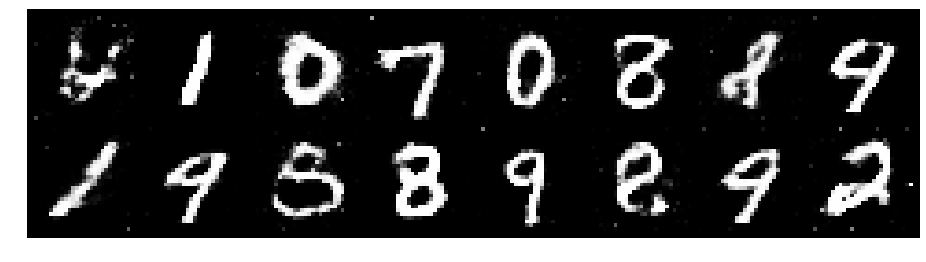

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2883, Generator Loss: 0.8131
D(x): 0.5533, D(G(z)): 0.4490


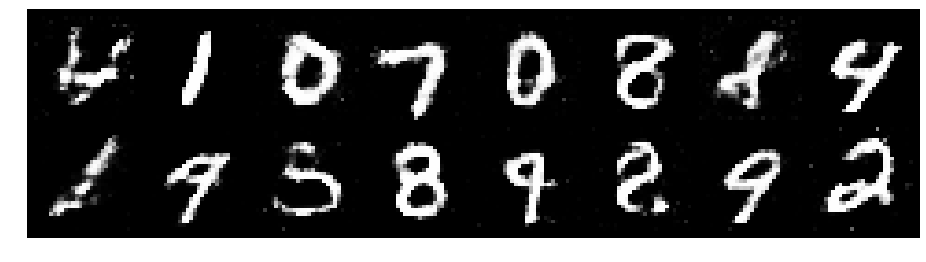

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2752, Generator Loss: 0.8474
D(x): 0.5924, D(G(z)): 0.4508


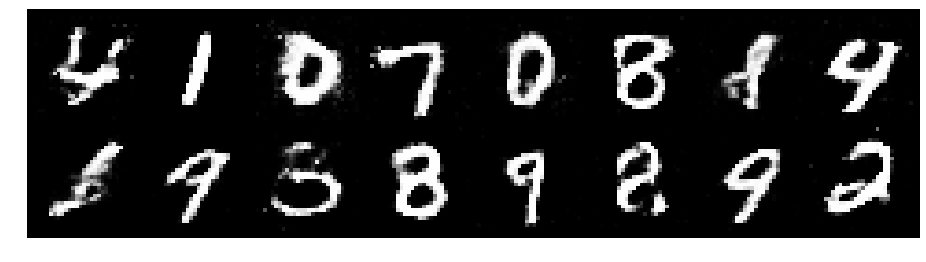

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3711, Generator Loss: 0.9082
D(x): 0.5517, D(G(z)): 0.4638


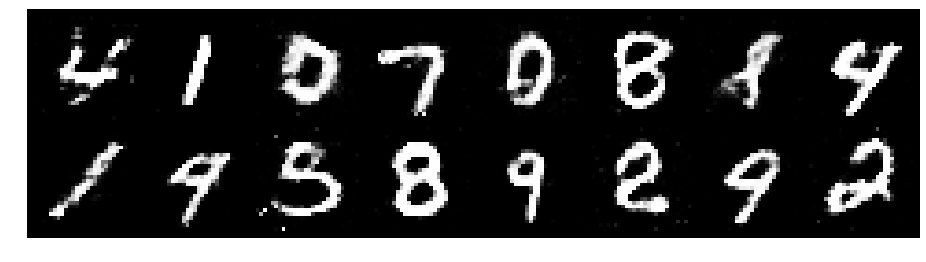

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.3243, Generator Loss: 0.8936
D(x): 0.5268, D(G(z)): 0.4237


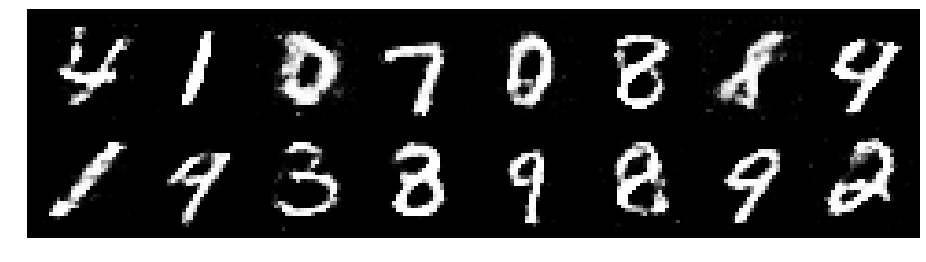

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.3918, Generator Loss: 0.8764
D(x): 0.5376, D(G(z)): 0.4603


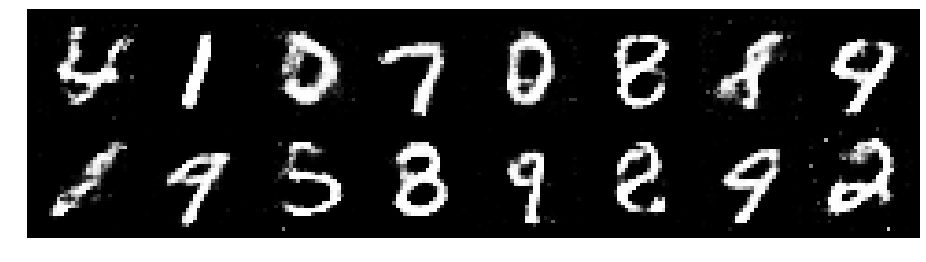

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2469, Generator Loss: 0.8672
D(x): 0.5726, D(G(z)): 0.4513


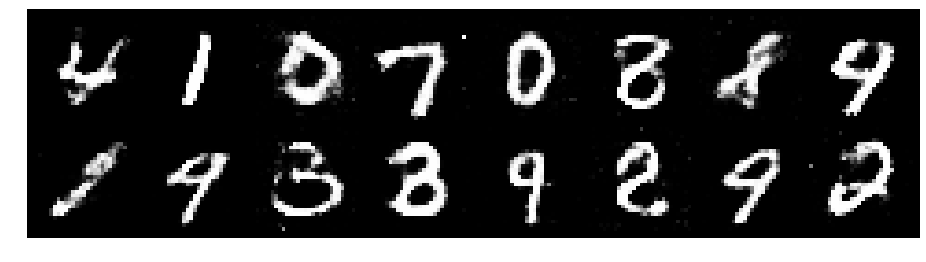

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.3384, Generator Loss: 0.8819
D(x): 0.5231, D(G(z)): 0.4489


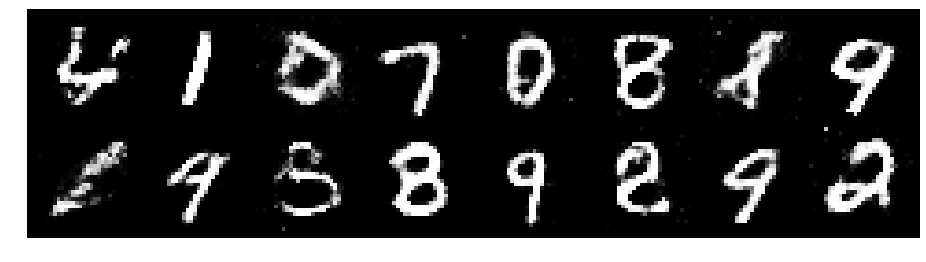

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2320, Generator Loss: 1.0235
D(x): 0.5756, D(G(z)): 0.4308


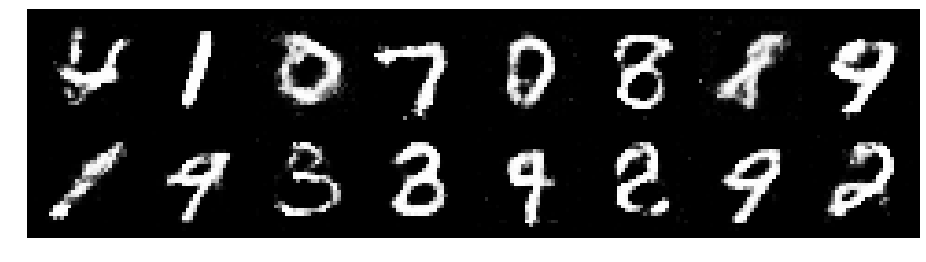

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.1688, Generator Loss: 0.9700
D(x): 0.5658, D(G(z)): 0.4111


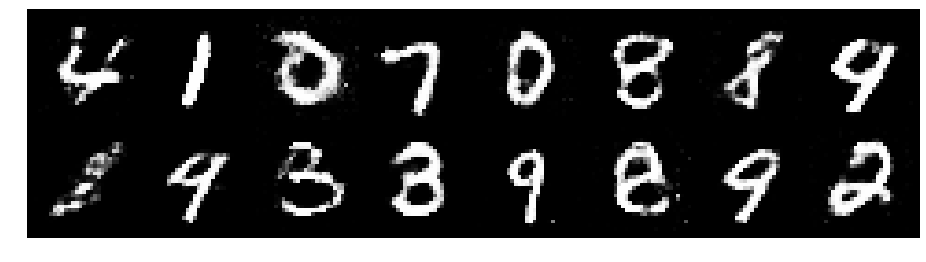

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.2103, Generator Loss: 0.9010
D(x): 0.5877, D(G(z)): 0.4411


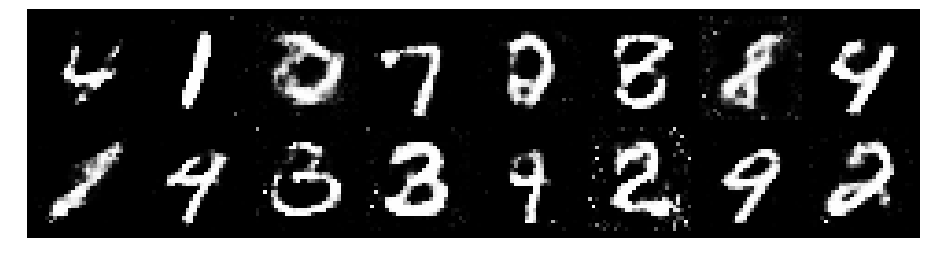

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2543, Generator Loss: 0.9028
D(x): 0.5620, D(G(z)): 0.4462


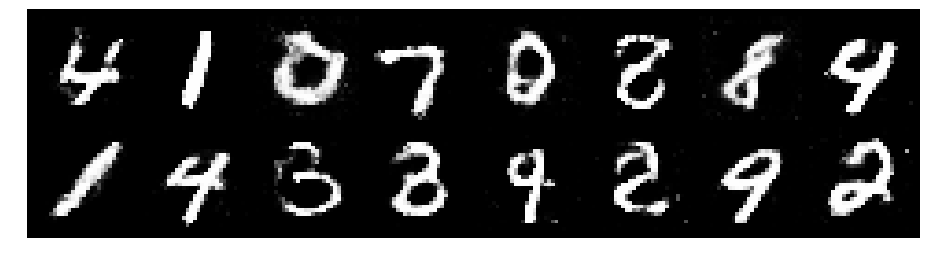

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.3151, Generator Loss: 0.8824
D(x): 0.5340, D(G(z)): 0.4602


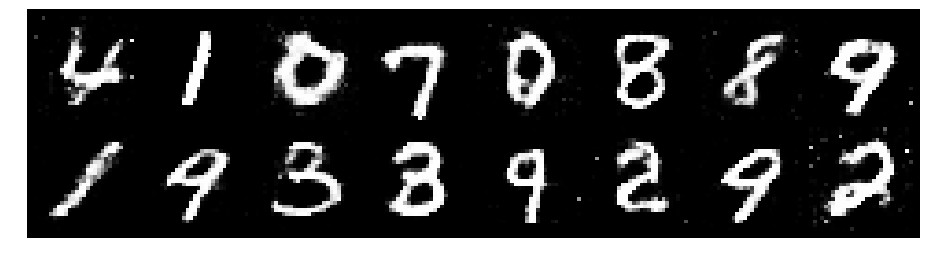

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.2923, Generator Loss: 0.8560
D(x): 0.5654, D(G(z)): 0.4751


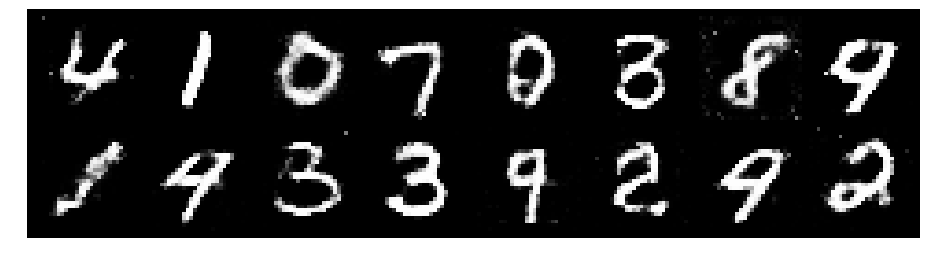

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2427, Generator Loss: 0.8984
D(x): 0.5516, D(G(z)): 0.4334


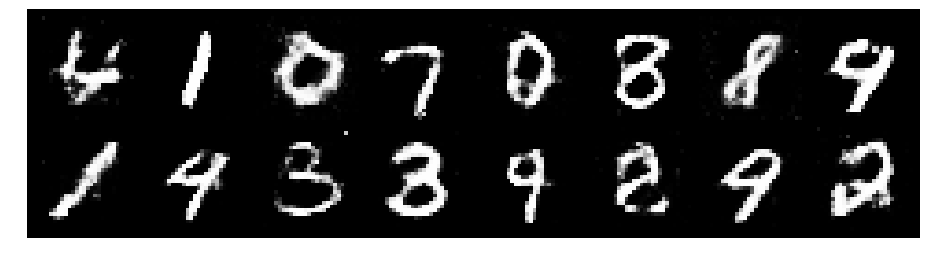

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2463, Generator Loss: 0.8943
D(x): 0.5343, D(G(z)): 0.4135


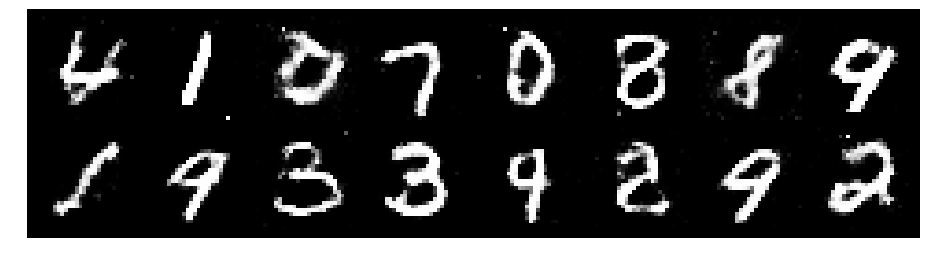

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.1386, Generator Loss: 1.0873
D(x): 0.5921, D(G(z)): 0.3849


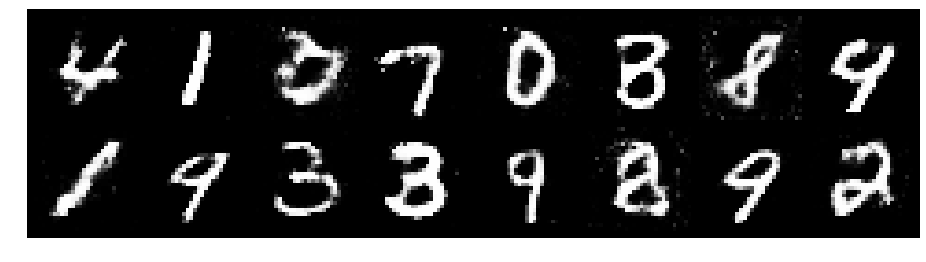

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.1708, Generator Loss: 1.1362
D(x): 0.6155, D(G(z)): 0.4159


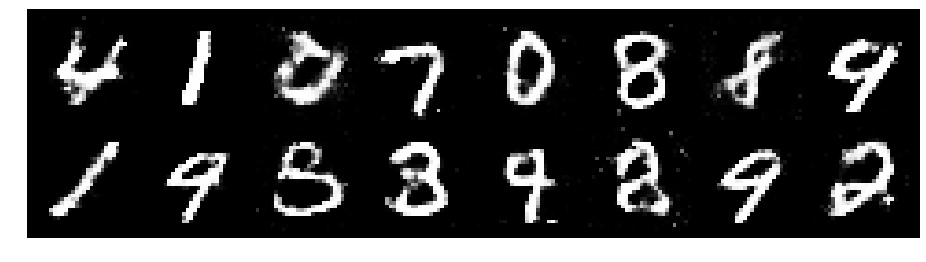

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.1666, Generator Loss: 0.9734
D(x): 0.5970, D(G(z)): 0.4112


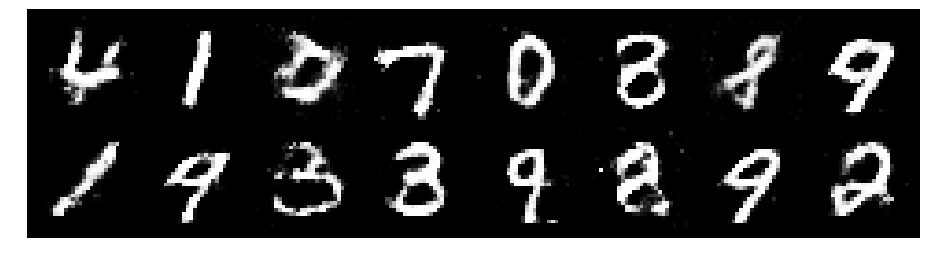

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8637
D(x): 0.5563, D(G(z)): 0.4510


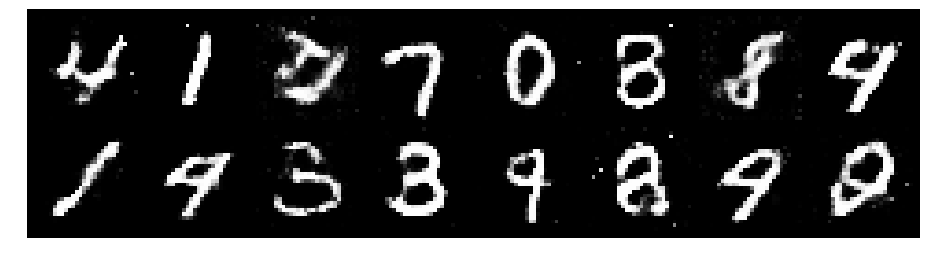

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2806, Generator Loss: 0.8342
D(x): 0.5486, D(G(z)): 0.4389


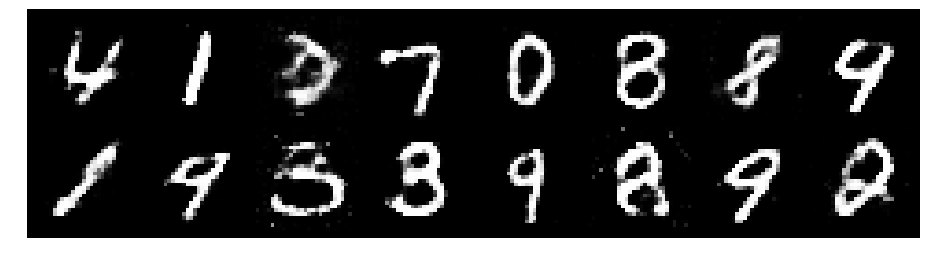

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3285, Generator Loss: 0.8565
D(x): 0.5392, D(G(z)): 0.4604


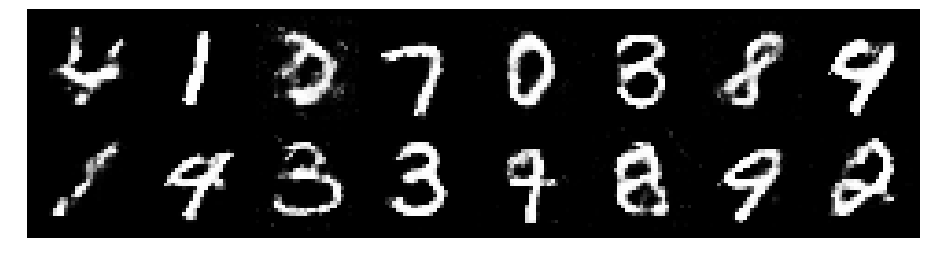

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3517, Generator Loss: 0.7887
D(x): 0.5313, D(G(z)): 0.4807


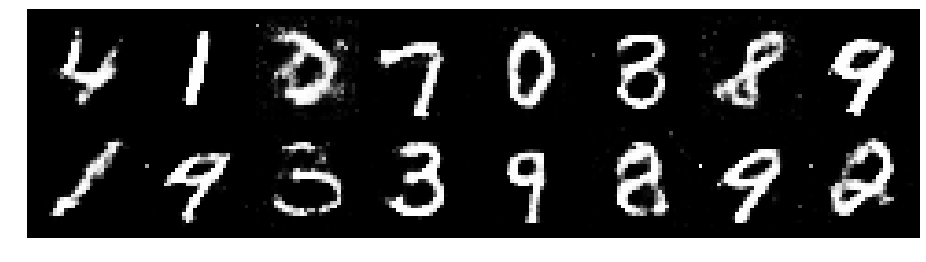

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.3075, Generator Loss: 0.7506
D(x): 0.5550, D(G(z)): 0.4741


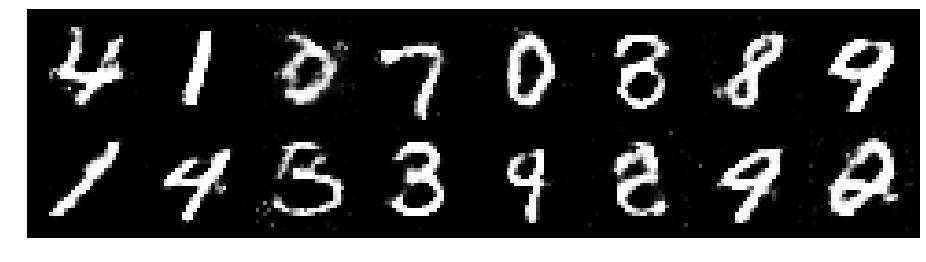

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.3153, Generator Loss: 0.8075
D(x): 0.5701, D(G(z)): 0.4824


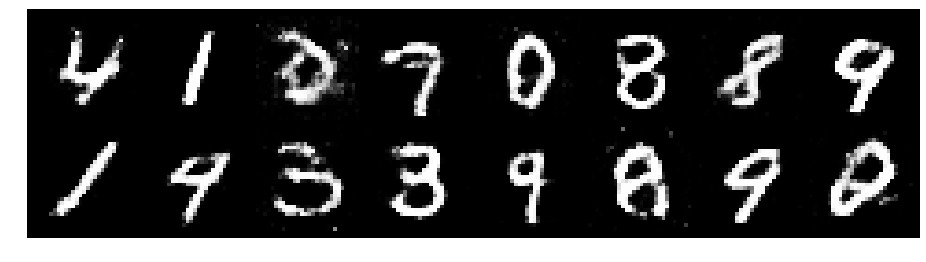

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2682, Generator Loss: 0.7842
D(x): 0.5691, D(G(z)): 0.4485


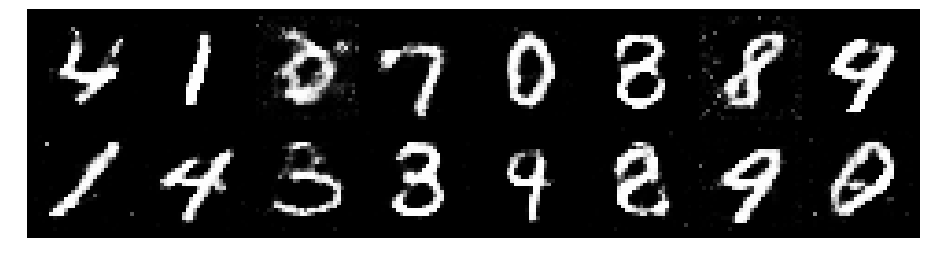

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.2622, Generator Loss: 0.9314
D(x): 0.5840, D(G(z)): 0.4537


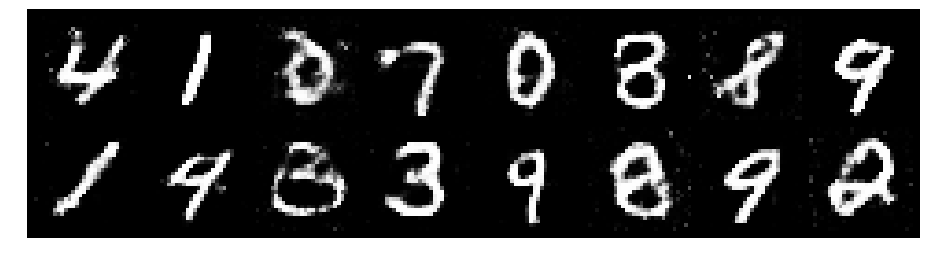

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2081, Generator Loss: 1.0445
D(x): 0.5786, D(G(z)): 0.4091


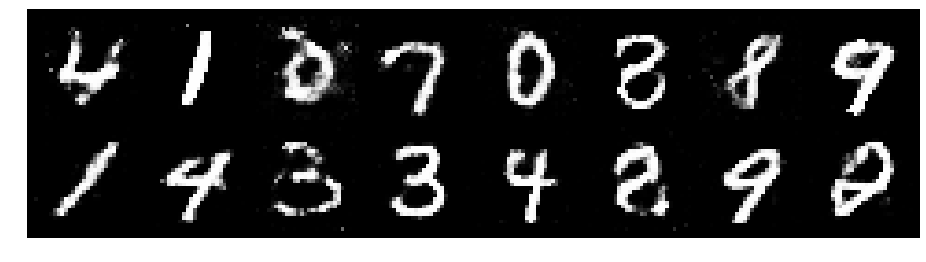

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.1965, Generator Loss: 0.9172
D(x): 0.5944, D(G(z)): 0.4301


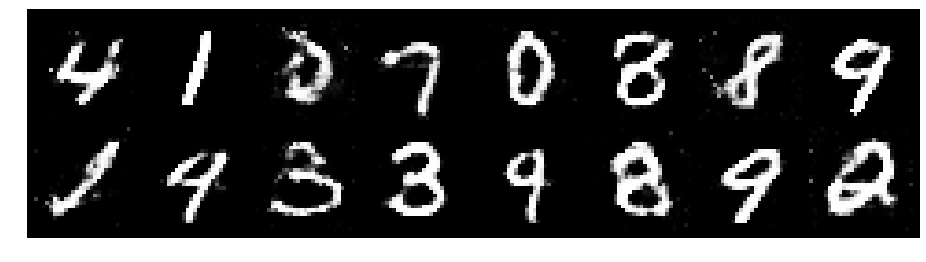

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.2651, Generator Loss: 0.9793
D(x): 0.5391, D(G(z)): 0.4280


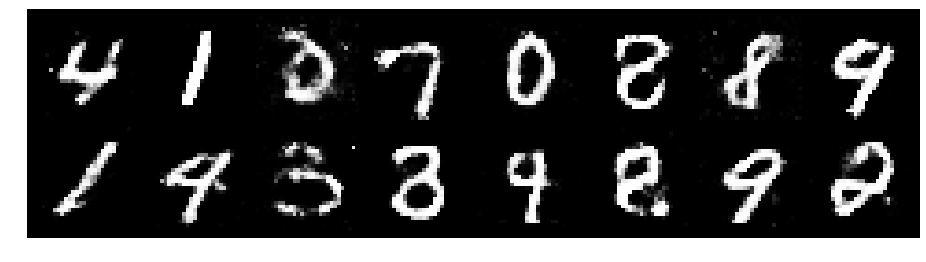

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.2632, Generator Loss: 0.8474
D(x): 0.5449, D(G(z)): 0.4294


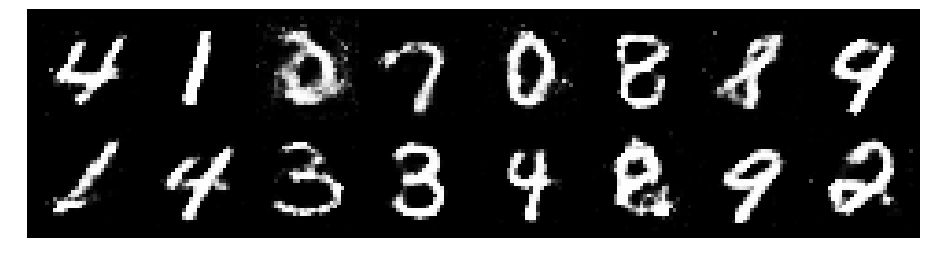

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.2841, Generator Loss: 0.8268
D(x): 0.5376, D(G(z)): 0.4446


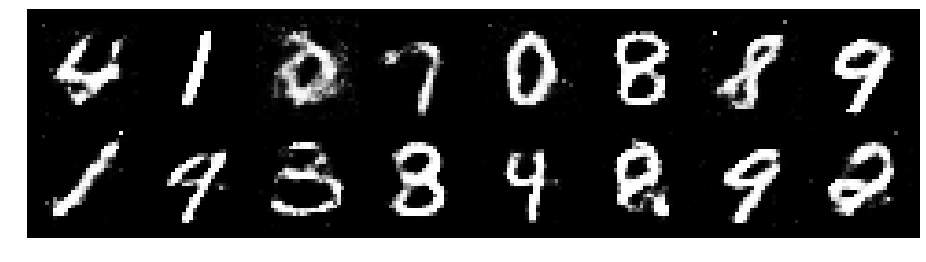

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2798, Generator Loss: 0.7966
D(x): 0.5316, D(G(z)): 0.4405


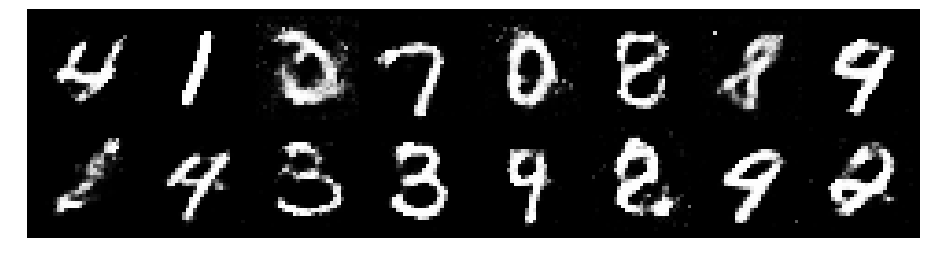

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2590, Generator Loss: 0.9249
D(x): 0.5436, D(G(z)): 0.4372


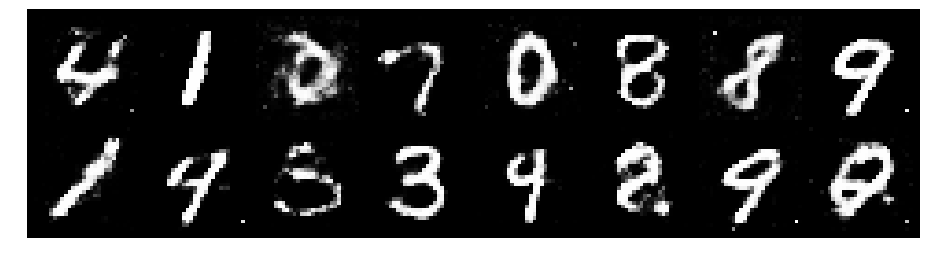

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2435, Generator Loss: 1.0570
D(x): 0.5282, D(G(z)): 0.4061


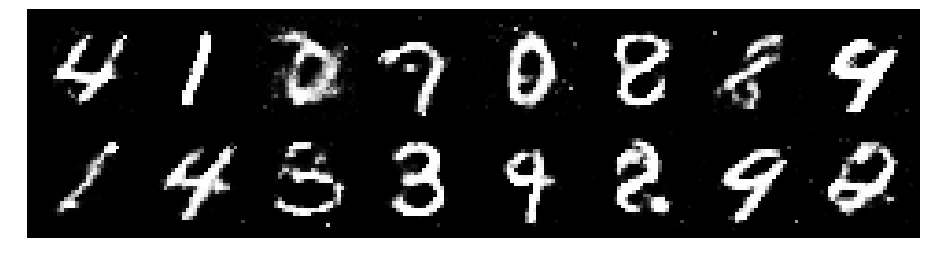

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2185, Generator Loss: 0.8996
D(x): 0.5709, D(G(z)): 0.4306


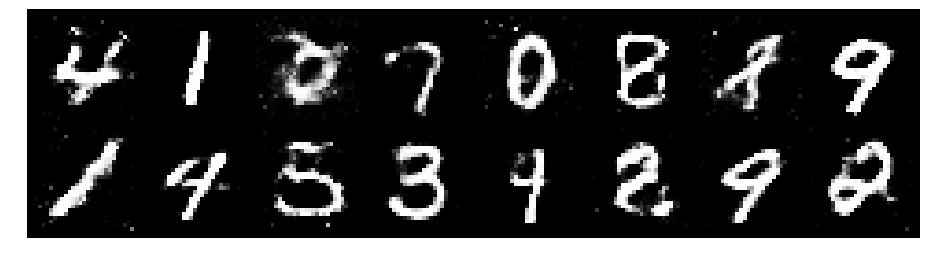

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2795, Generator Loss: 1.0158
D(x): 0.5320, D(G(z)): 0.4211


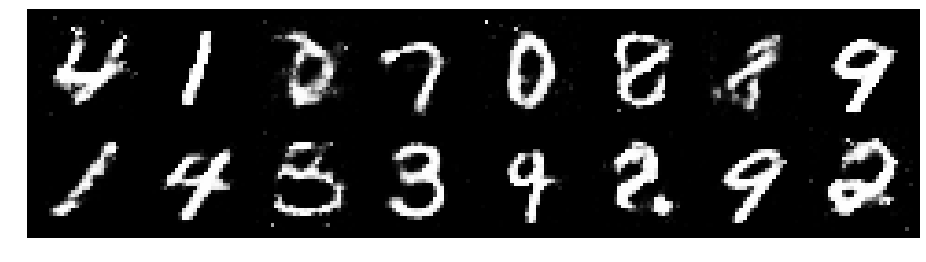

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2920, Generator Loss: 1.0484
D(x): 0.5123, D(G(z)): 0.3845


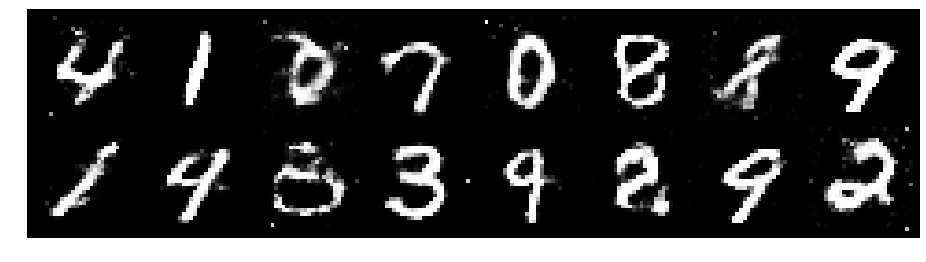

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.1856, Generator Loss: 0.9957
D(x): 0.5982, D(G(z)): 0.4207


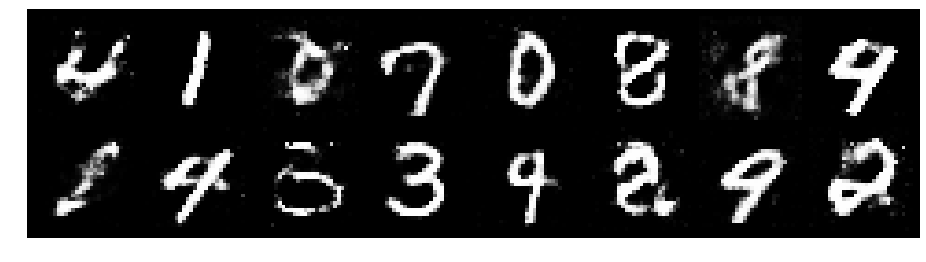

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2344, Generator Loss: 0.8164
D(x): 0.6315, D(G(z)): 0.4598


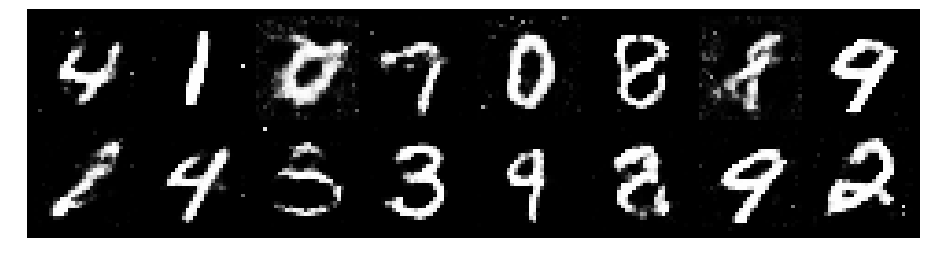

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.3048, Generator Loss: 0.8699
D(x): 0.5557, D(G(z)): 0.4691


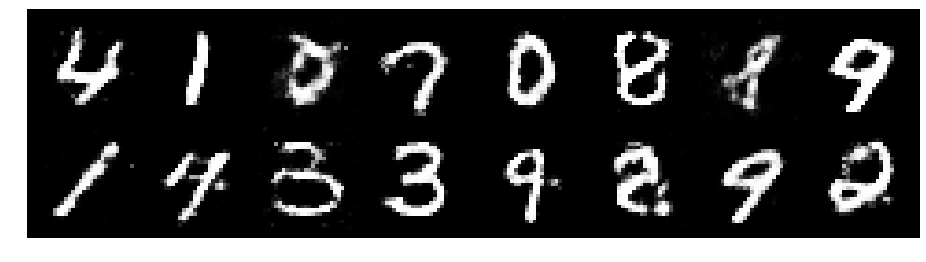

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.3363, Generator Loss: 0.8347
D(x): 0.5366, D(G(z)): 0.4736


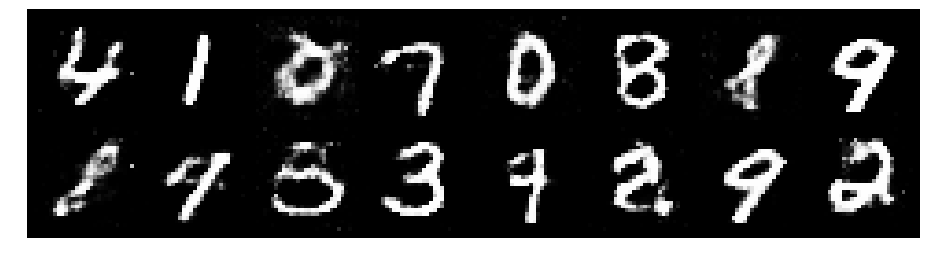

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2535, Generator Loss: 0.9422
D(x): 0.5660, D(G(z)): 0.4404


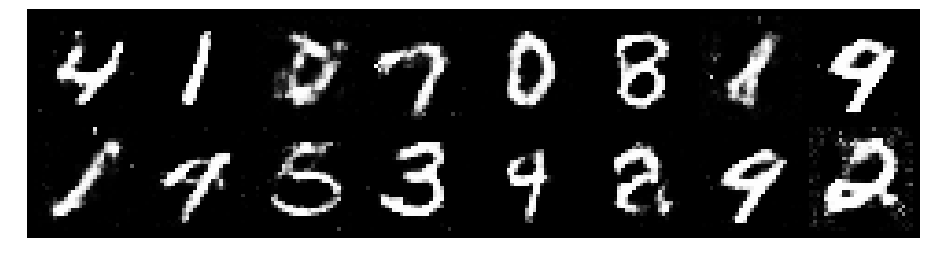

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3094, Generator Loss: 0.7717
D(x): 0.5625, D(G(z)): 0.4874


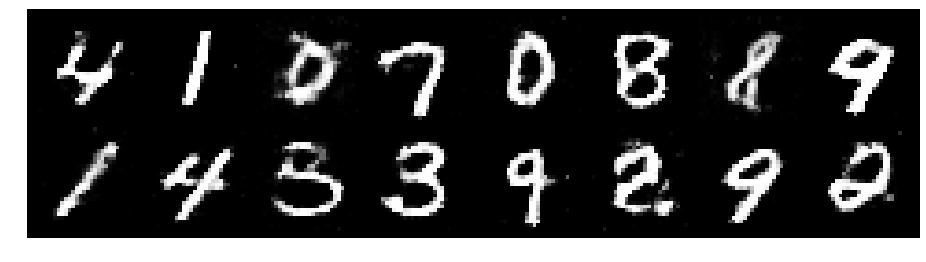

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2192, Generator Loss: 1.0032
D(x): 0.6036, D(G(z)): 0.4606


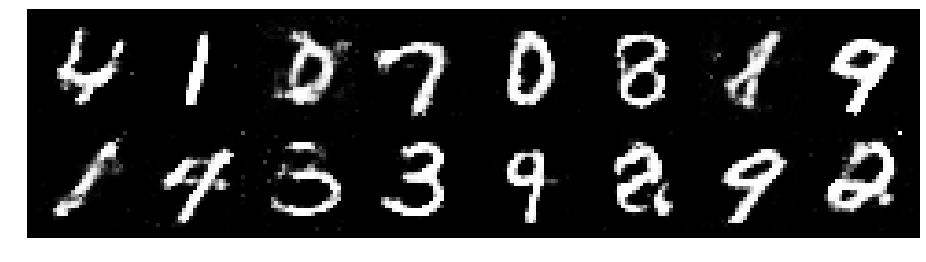

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.1818, Generator Loss: 1.0433
D(x): 0.5580, D(G(z)): 0.3996


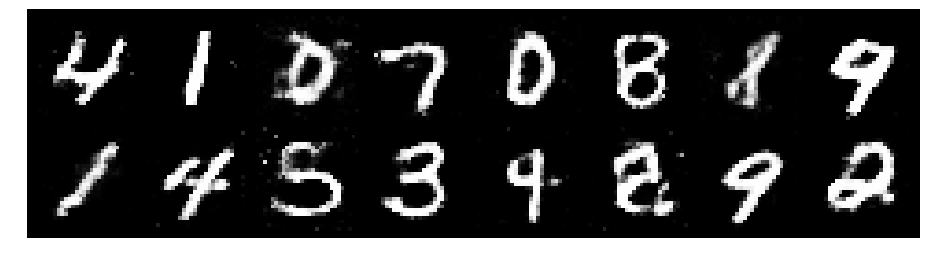

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.1767, Generator Loss: 1.1122
D(x): 0.5467, D(G(z)): 0.3784


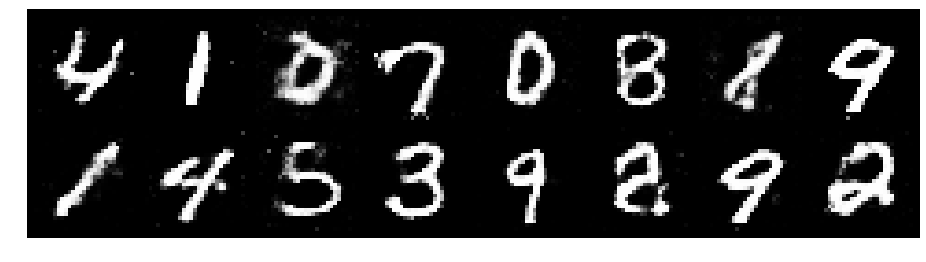

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3025, Generator Loss: 0.7861
D(x): 0.5545, D(G(z)): 0.4516


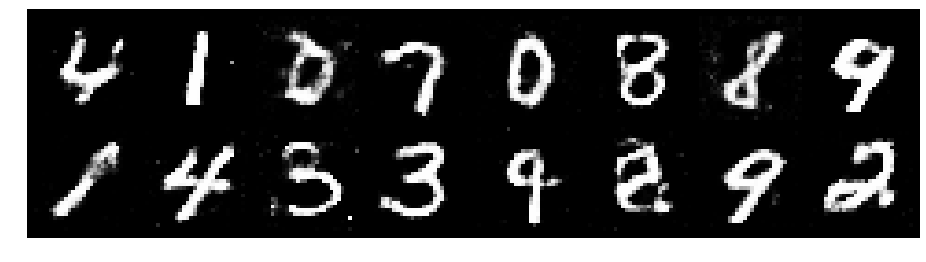

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.3957, Generator Loss: 0.8841
D(x): 0.5330, D(G(z)): 0.4378


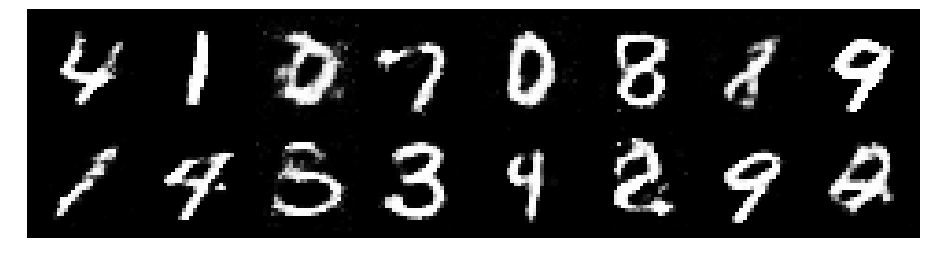

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2499, Generator Loss: 0.9066
D(x): 0.5638, D(G(z)): 0.4361


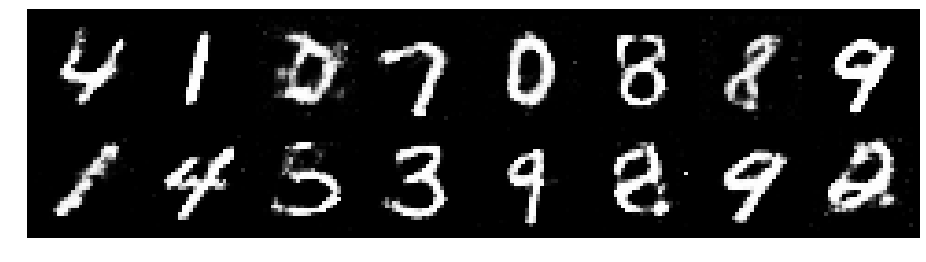

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.3096, Generator Loss: 0.9258
D(x): 0.5505, D(G(z)): 0.4396


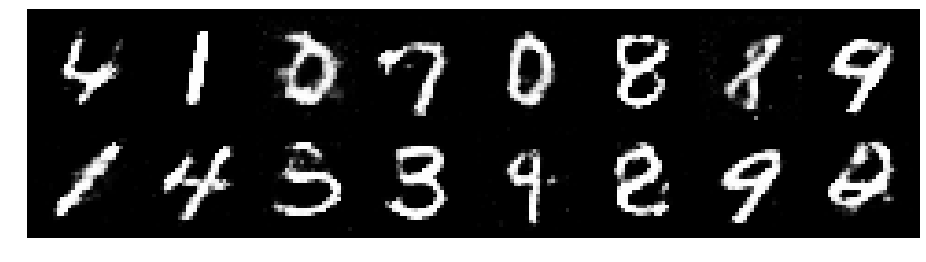

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.3019, Generator Loss: 0.9031
D(x): 0.5510, D(G(z)): 0.4454


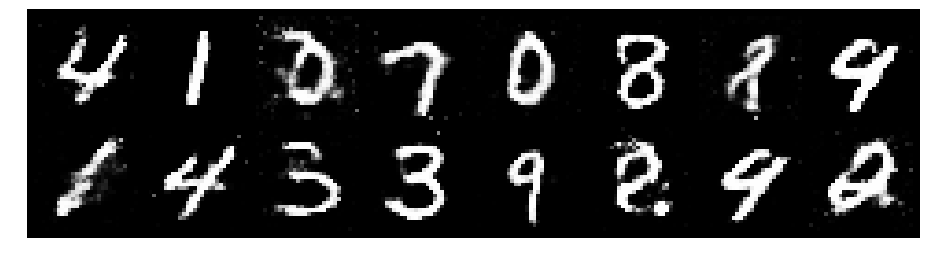

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2609, Generator Loss: 0.9721
D(x): 0.5461, D(G(z)): 0.4149


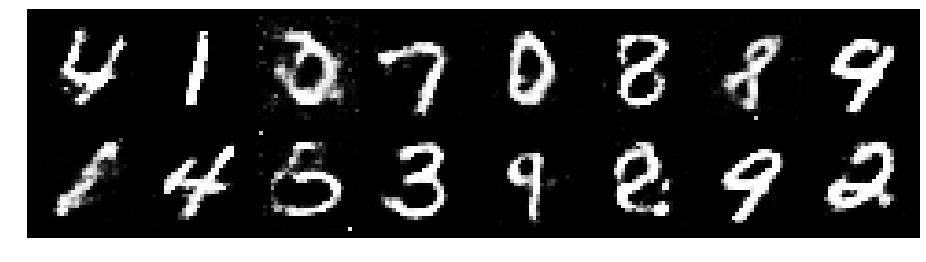

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2578, Generator Loss: 0.9837
D(x): 0.5491, D(G(z)): 0.4188


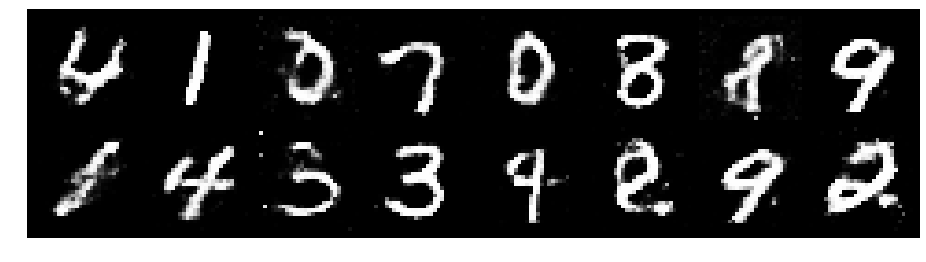

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2179, Generator Loss: 0.8422
D(x): 0.5894, D(G(z)): 0.4579


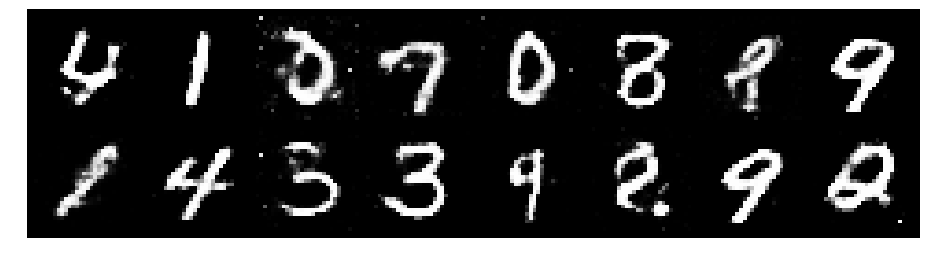

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3326, Generator Loss: 0.8632
D(x): 0.5111, D(G(z)): 0.4220


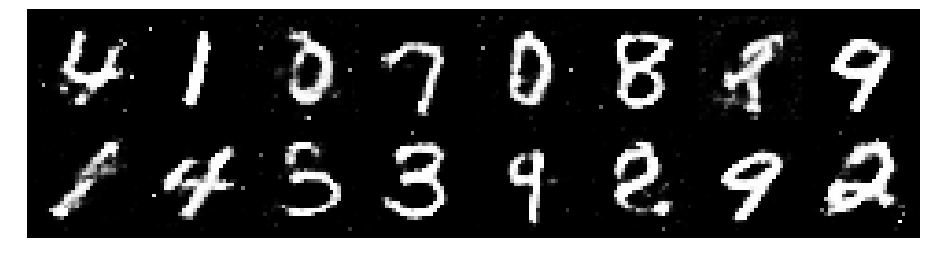

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.3107, Generator Loss: 0.9159
D(x): 0.5620, D(G(z)): 0.4693


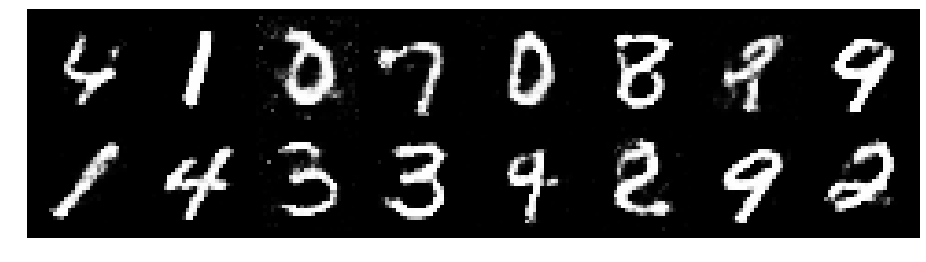

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.3192, Generator Loss: 0.8342
D(x): 0.5697, D(G(z)): 0.4850


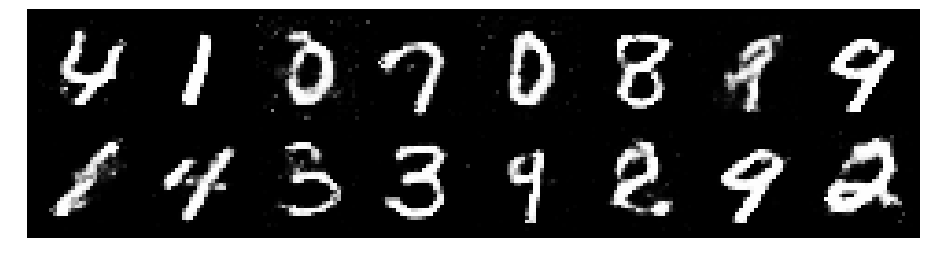

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3063, Generator Loss: 0.8113
D(x): 0.5467, D(G(z)): 0.4651


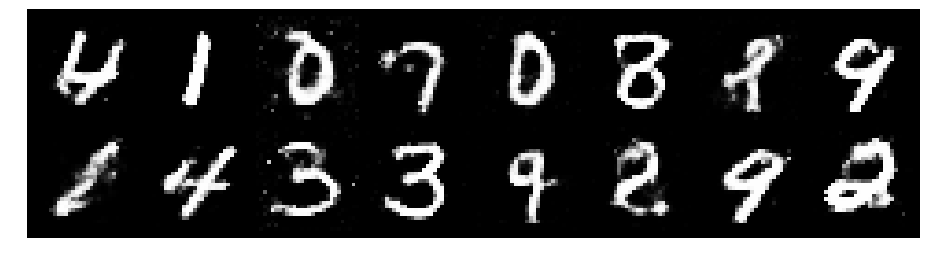

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.1675, Generator Loss: 0.8313
D(x): 0.5895, D(G(z)): 0.4225


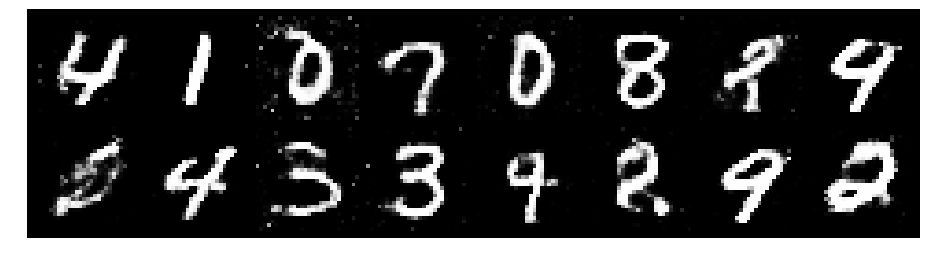

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.3432, Generator Loss: 0.8744
D(x): 0.5017, D(G(z)): 0.4489


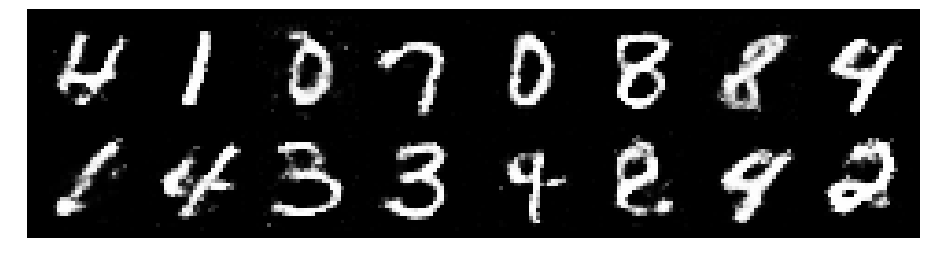

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2389, Generator Loss: 0.8343
D(x): 0.5581, D(G(z)): 0.4447


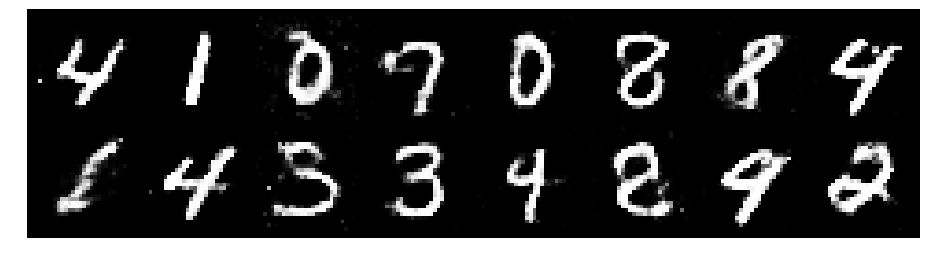

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2623, Generator Loss: 0.8365
D(x): 0.5337, D(G(z)): 0.4346


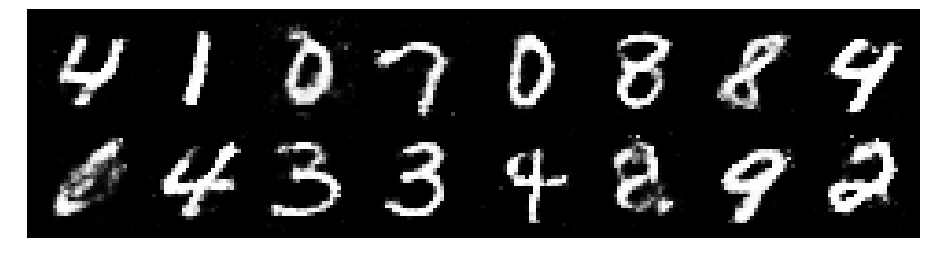

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.1857, Generator Loss: 0.9264
D(x): 0.5680, D(G(z)): 0.4099


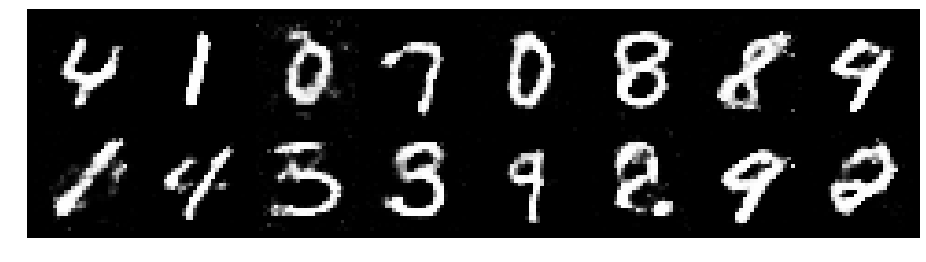

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2818, Generator Loss: 0.8358
D(x): 0.5484, D(G(z)): 0.4536


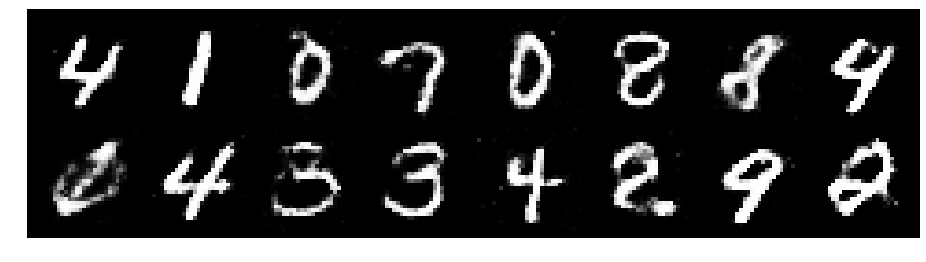

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2702, Generator Loss: 0.9635
D(x): 0.5487, D(G(z)): 0.4207


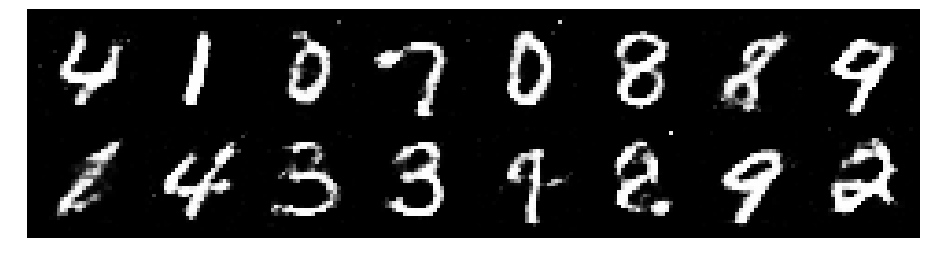

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.3293, Generator Loss: 0.8403
D(x): 0.5340, D(G(z)): 0.4707


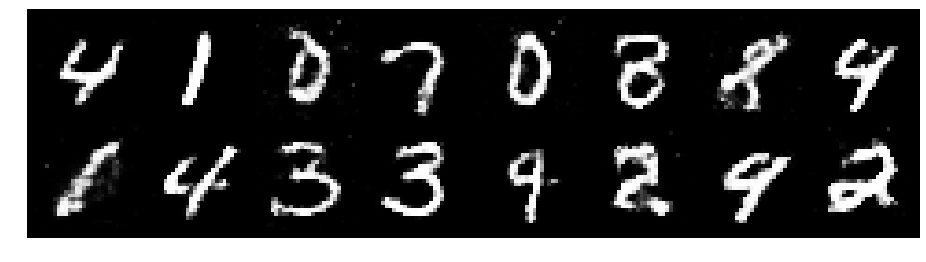

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.1621, Generator Loss: 1.0526
D(x): 0.5938, D(G(z)): 0.4168


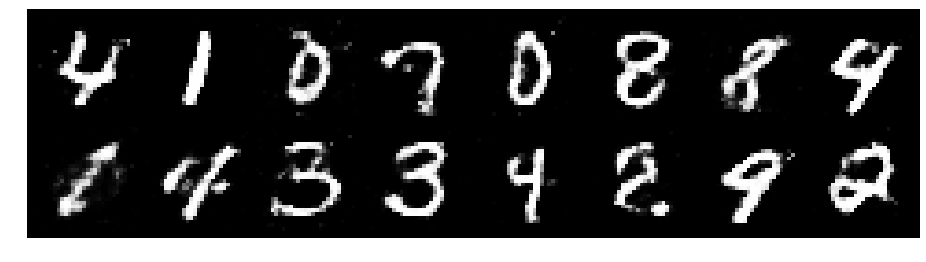

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2731, Generator Loss: 1.0727
D(x): 0.5403, D(G(z)): 0.4073


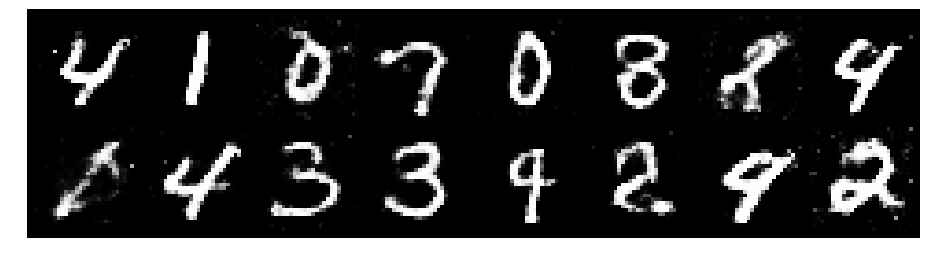

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.1959, Generator Loss: 0.9345
D(x): 0.5707, D(G(z)): 0.4195


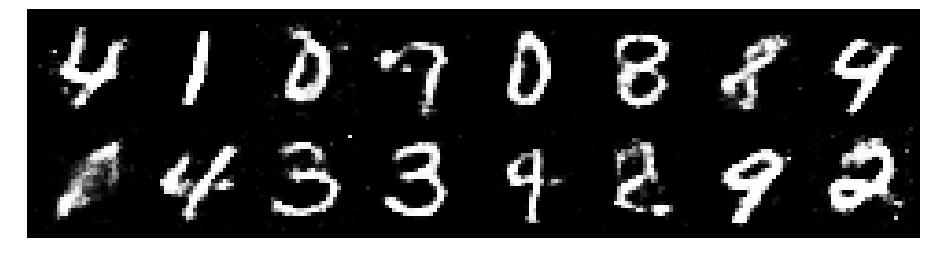

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.3285, Generator Loss: 0.8783
D(x): 0.5496, D(G(z)): 0.4559


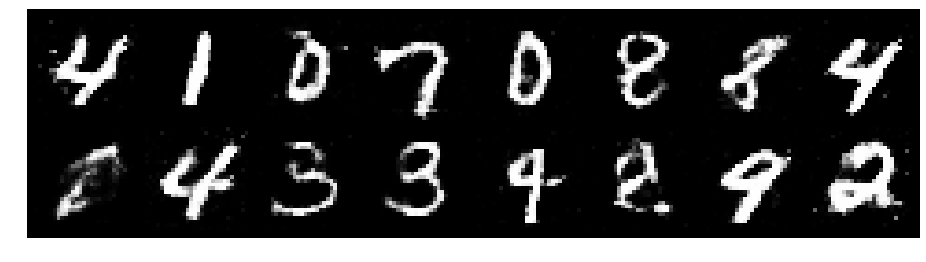

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2047, Generator Loss: 0.9030
D(x): 0.5438, D(G(z)): 0.4206


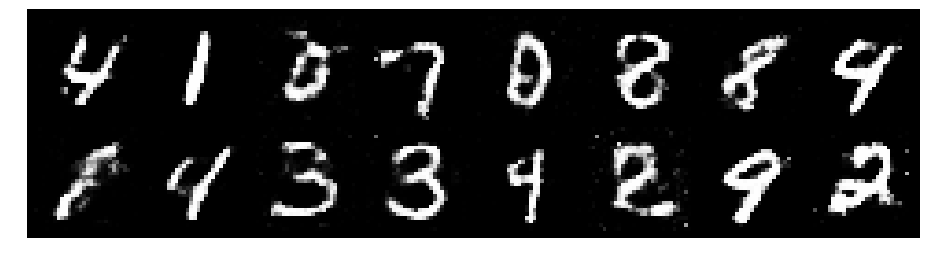

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2666, Generator Loss: 0.9042
D(x): 0.5407, D(G(z)): 0.4447


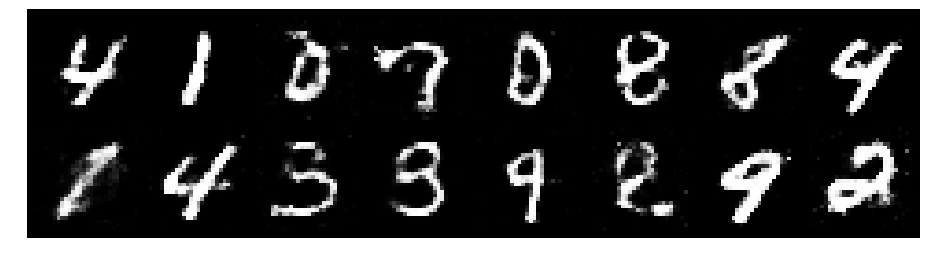

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2947, Generator Loss: 0.9044
D(x): 0.5441, D(G(z)): 0.4550


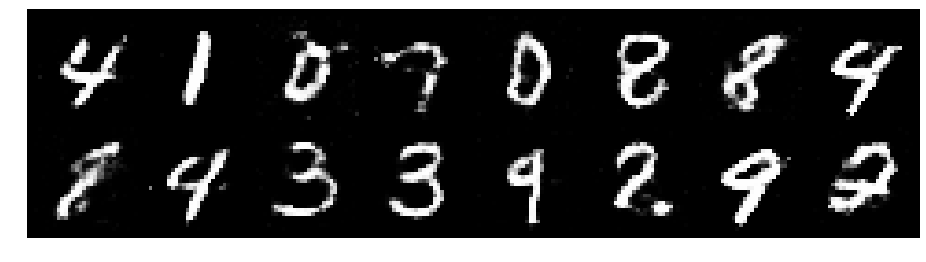

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2756, Generator Loss: 0.8525
D(x): 0.5285, D(G(z)): 0.4490


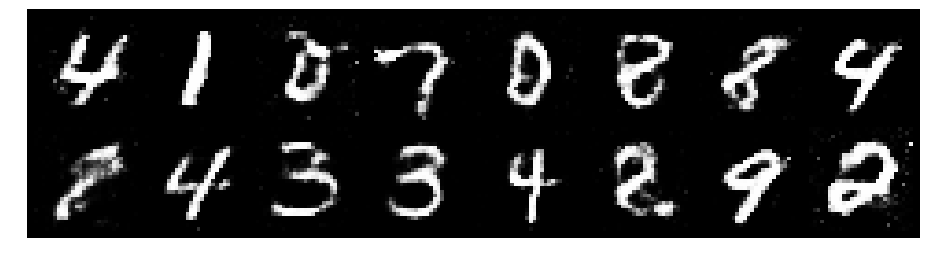

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3049, Generator Loss: 1.0441
D(x): 0.5565, D(G(z)): 0.4432


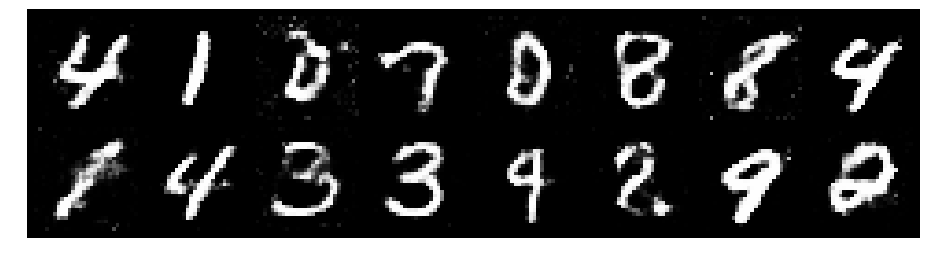

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2473, Generator Loss: 0.9253
D(x): 0.5612, D(G(z)): 0.4327


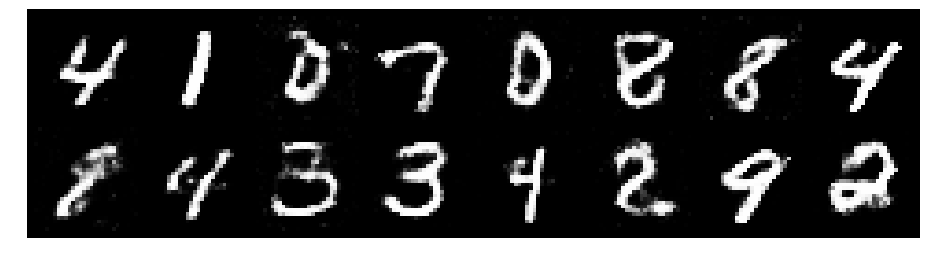

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.1979, Generator Loss: 0.9982
D(x): 0.5797, D(G(z)): 0.3960


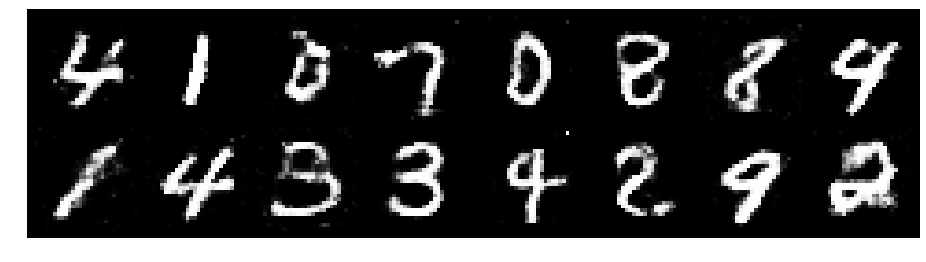

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.1470, Generator Loss: 0.9404
D(x): 0.5900, D(G(z)): 0.3856


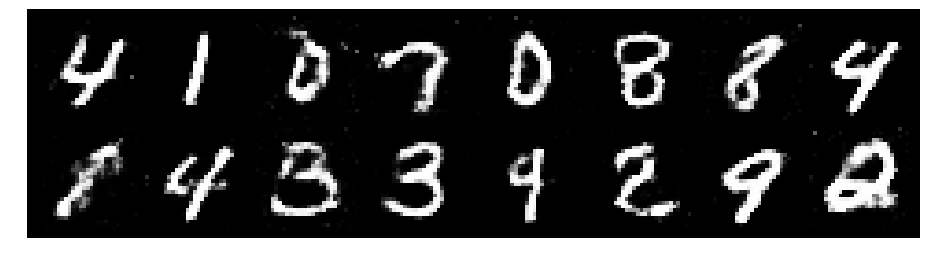

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2794, Generator Loss: 0.9214
D(x): 0.5547, D(G(z)): 0.4203


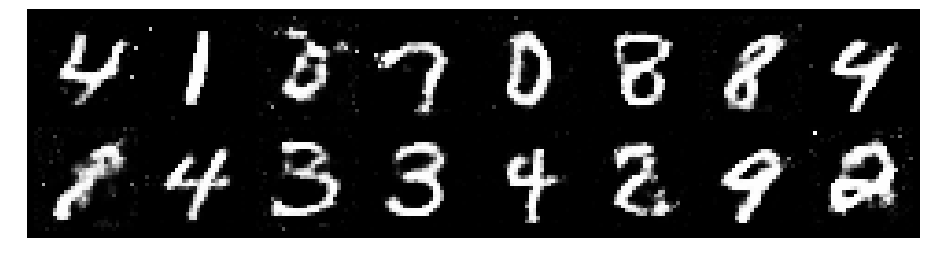

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2738, Generator Loss: 0.9116
D(x): 0.5657, D(G(z)): 0.4358


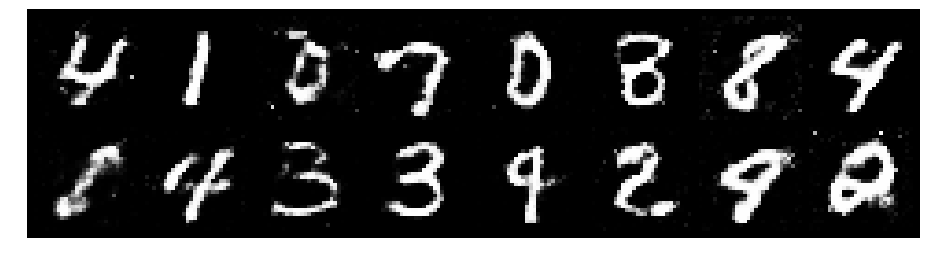

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.1707, Generator Loss: 0.9542
D(x): 0.5540, D(G(z)): 0.3872


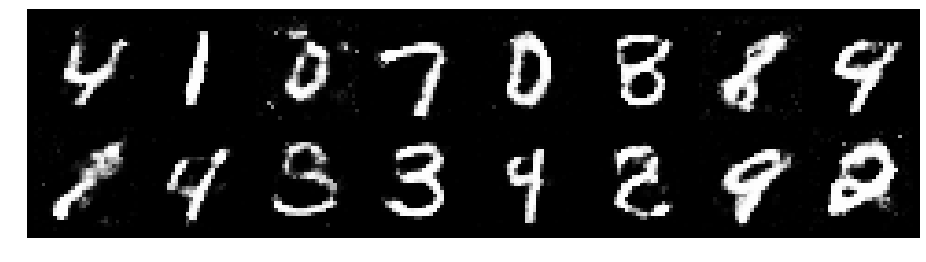

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.3352, Generator Loss: 0.9003
D(x): 0.5152, D(G(z)): 0.4487


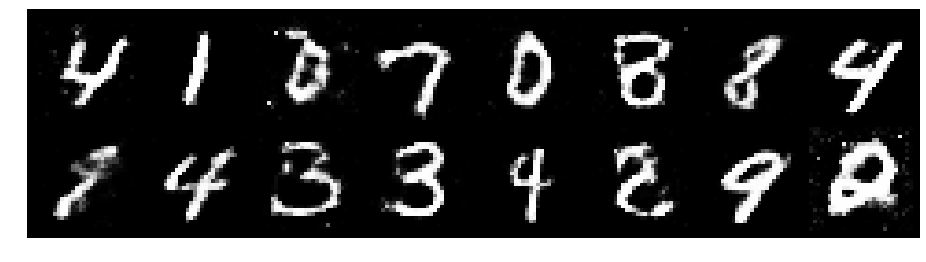

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.3028, Generator Loss: 0.8640
D(x): 0.5538, D(G(z)): 0.4637


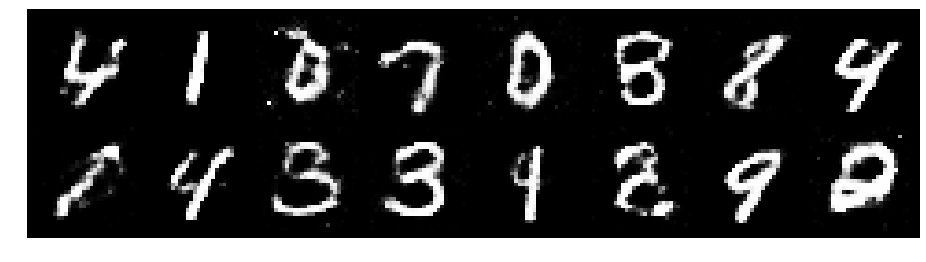

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2781, Generator Loss: 0.8441
D(x): 0.5334, D(G(z)): 0.4493


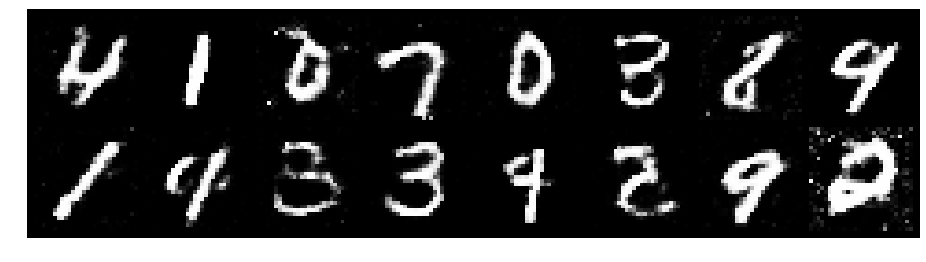

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.1585, Generator Loss: 0.8034
D(x): 0.5800, D(G(z)): 0.4115


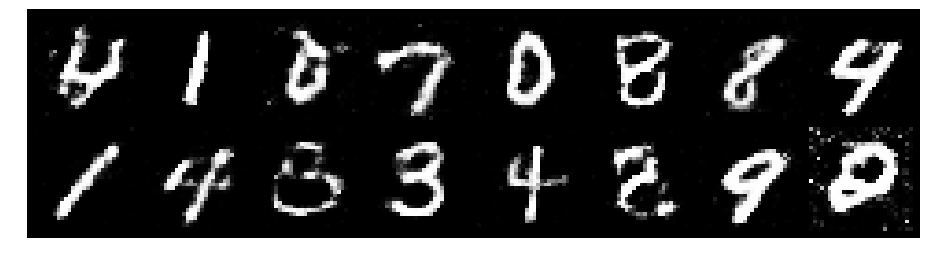

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2500, Generator Loss: 0.7639
D(x): 0.5853, D(G(z)): 0.4819


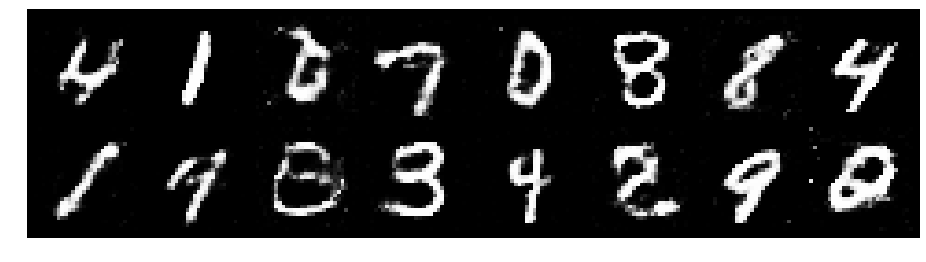

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2980, Generator Loss: 0.8595
D(x): 0.5625, D(G(z)): 0.4619


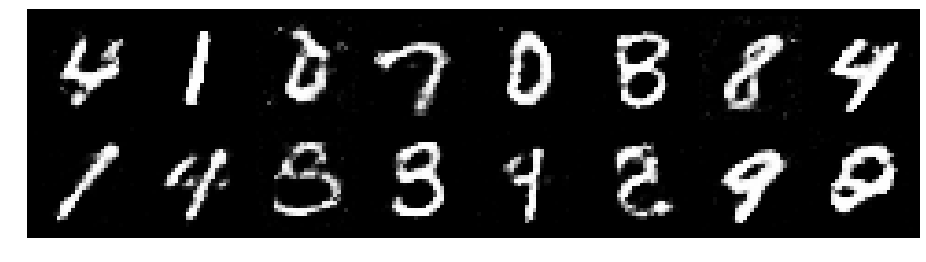

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3014, Generator Loss: 0.7408
D(x): 0.5935, D(G(z)): 0.4895


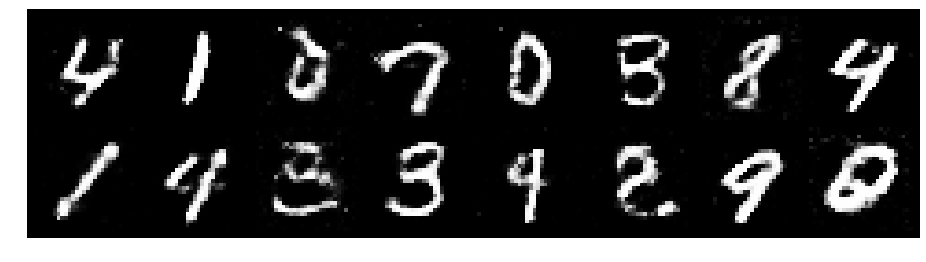

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.4483, Generator Loss: 0.7573
D(x): 0.5439, D(G(z)): 0.5190


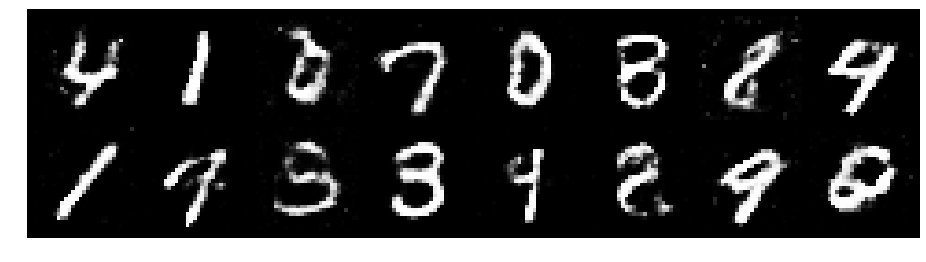

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2564, Generator Loss: 0.7935
D(x): 0.5431, D(G(z)): 0.4363


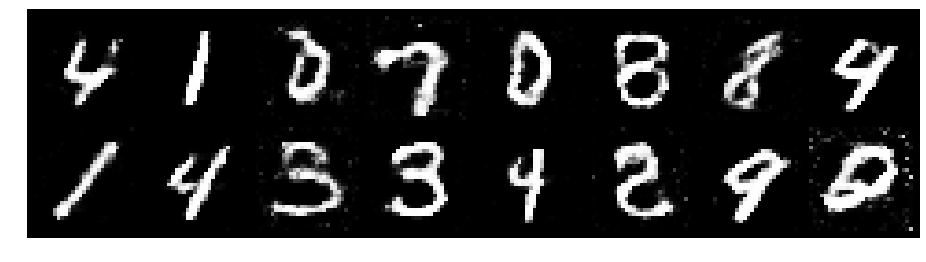

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.2948, Generator Loss: 0.8602
D(x): 0.5186, D(G(z)): 0.4307


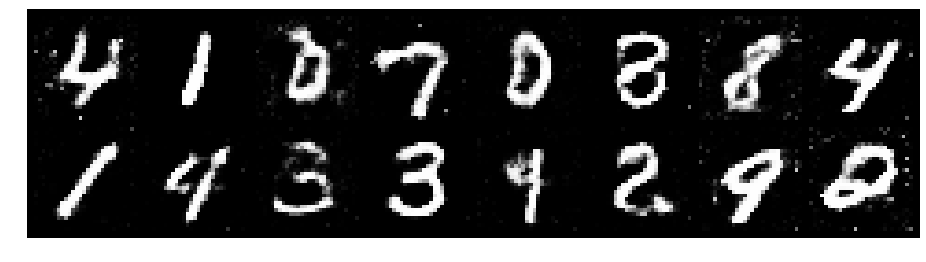

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.2310, Generator Loss: 0.8099
D(x): 0.5784, D(G(z)): 0.4733


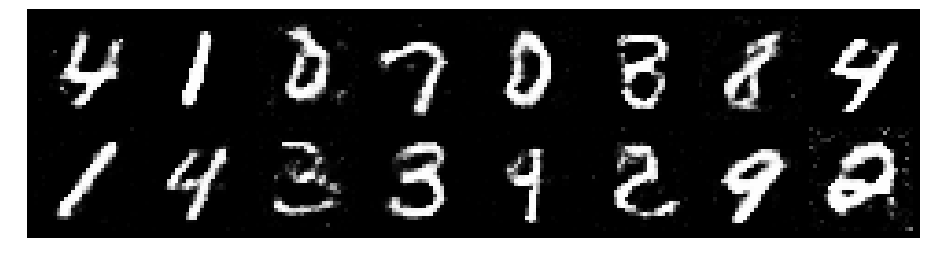

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3473, Generator Loss: 0.8838
D(x): 0.5278, D(G(z)): 0.4709


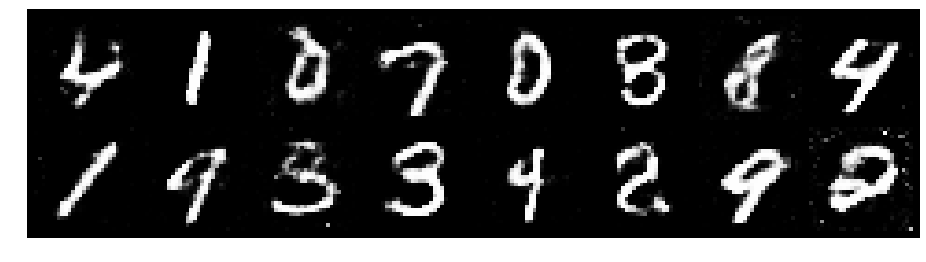

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.4003, Generator Loss: 0.9010
D(x): 0.5671, D(G(z)): 0.5080


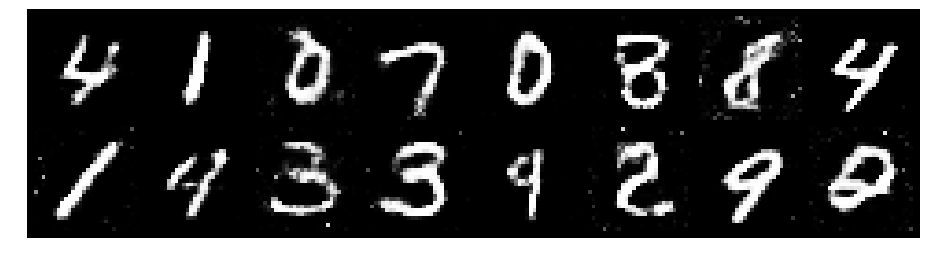

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.2577, Generator Loss: 0.8720
D(x): 0.5566, D(G(z)): 0.4436


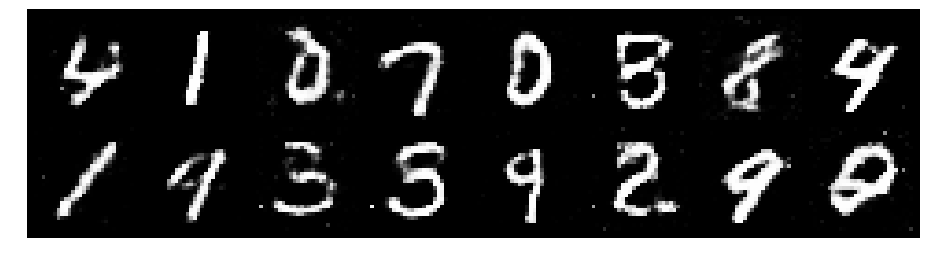

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.1595, Generator Loss: 0.9658
D(x): 0.5627, D(G(z)): 0.3985


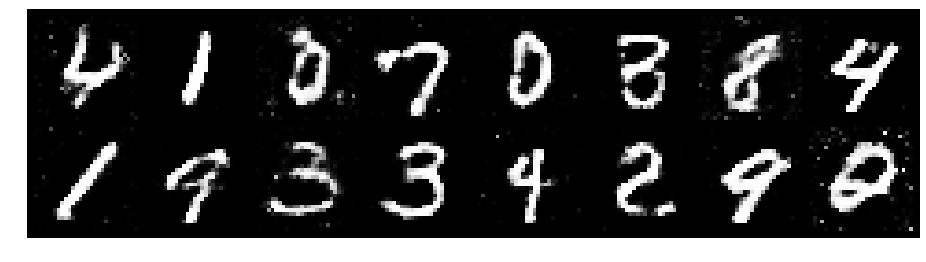

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.1944, Generator Loss: 0.9380
D(x): 0.6123, D(G(z)): 0.4429


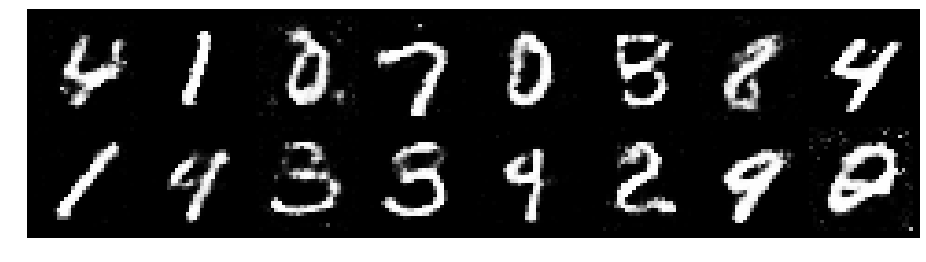

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2117, Generator Loss: 0.9011
D(x): 0.5821, D(G(z)): 0.4331


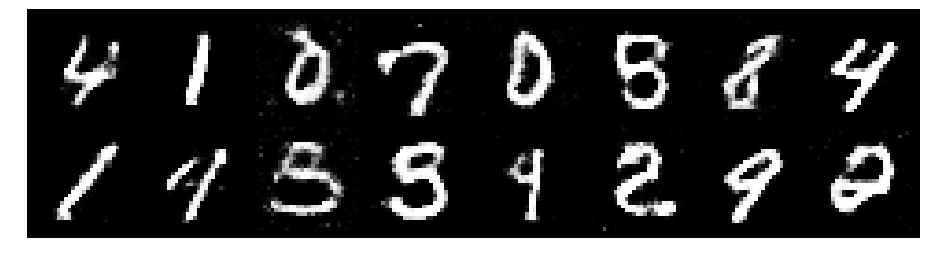

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.3591, Generator Loss: 0.8613
D(x): 0.5019, D(G(z)): 0.4528


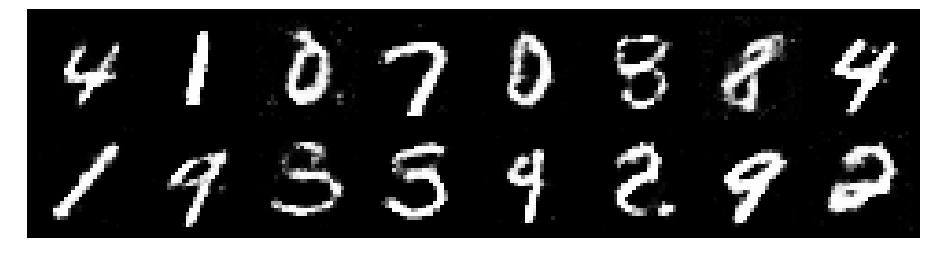

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.3537, Generator Loss: 0.8255
D(x): 0.5589, D(G(z)): 0.4846


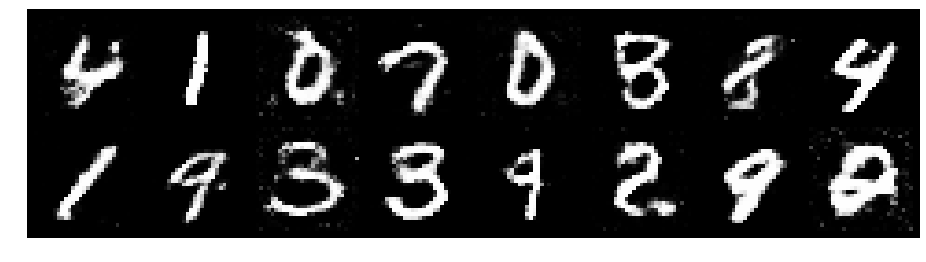

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2469, Generator Loss: 0.8948
D(x): 0.5488, D(G(z)): 0.4302


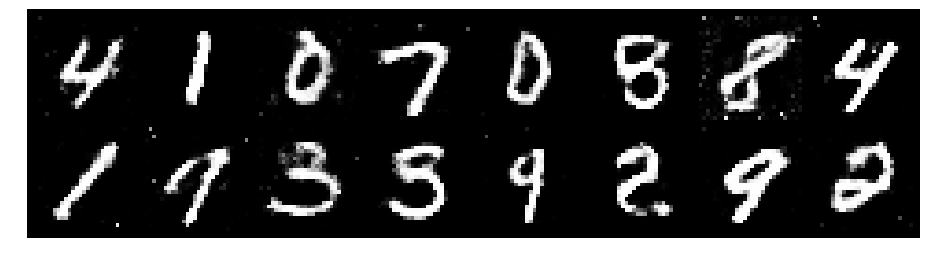

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3123, Generator Loss: 0.9172
D(x): 0.5204, D(G(z)): 0.4196


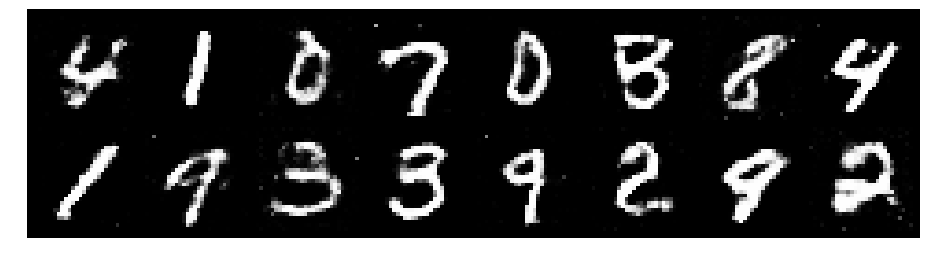

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3006, Generator Loss: 0.9374
D(x): 0.5593, D(G(z)): 0.4377


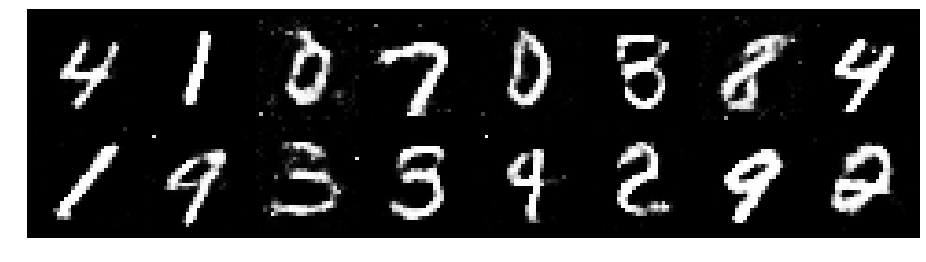

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2340, Generator Loss: 0.9709
D(x): 0.5650, D(G(z)): 0.4358


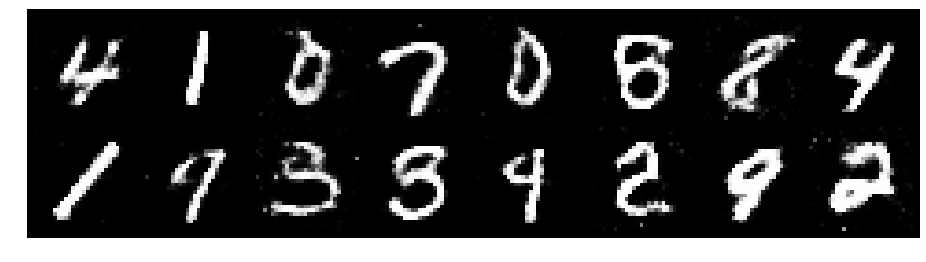

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.1372, Generator Loss: 1.1657
D(x): 0.5940, D(G(z)): 0.4044


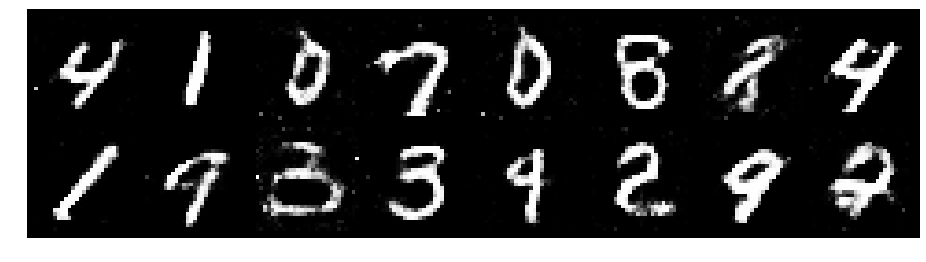

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2195, Generator Loss: 0.8728
D(x): 0.5630, D(G(z)): 0.4504


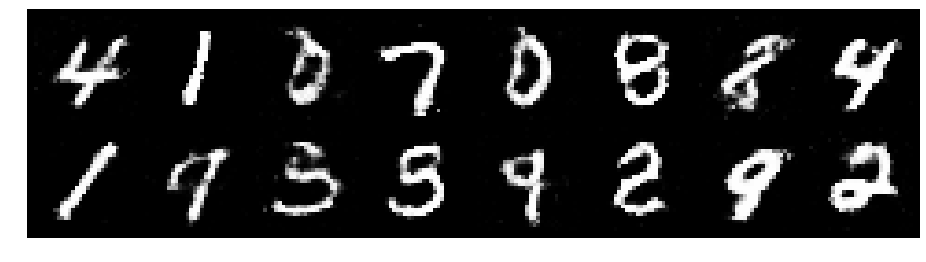

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.1530, Generator Loss: 1.0928
D(x): 0.5923, D(G(z)): 0.4010


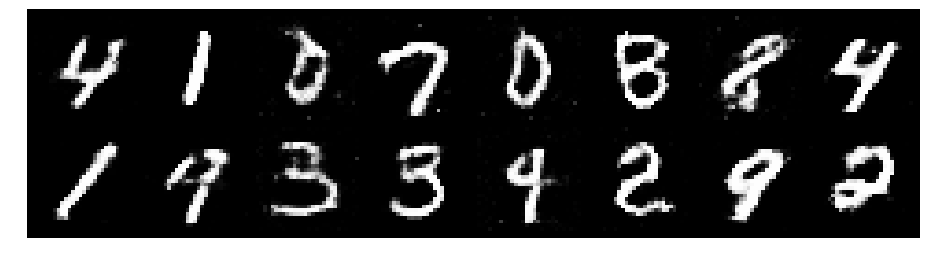

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.3445, Generator Loss: 0.9615
D(x): 0.4936, D(G(z)): 0.4224


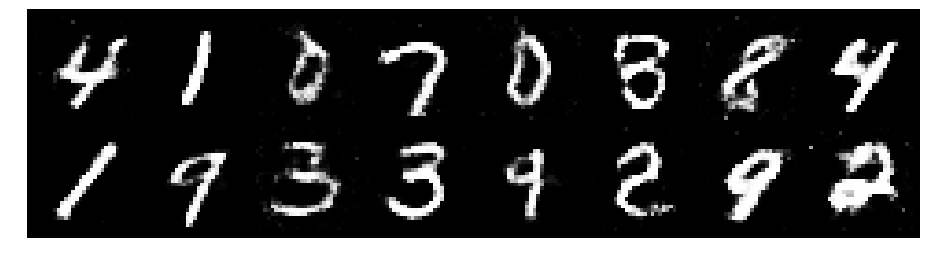

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2732, Generator Loss: 0.8616
D(x): 0.5824, D(G(z)): 0.4681


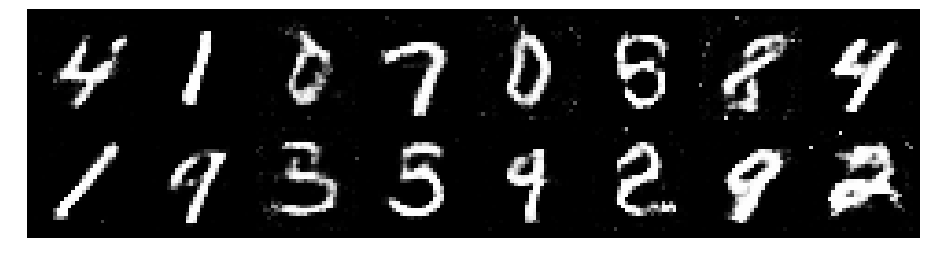

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2812, Generator Loss: 0.8331
D(x): 0.5554, D(G(z)): 0.4482


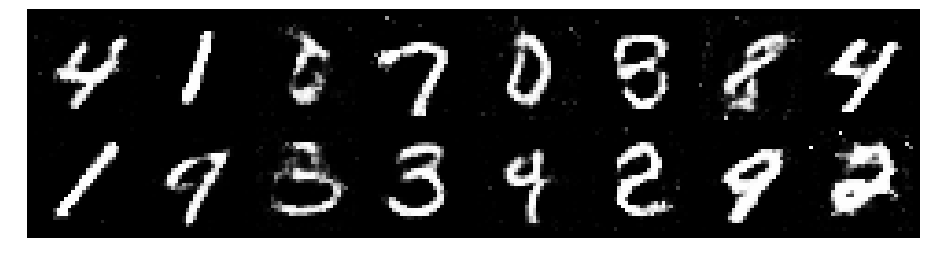

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2979, Generator Loss: 0.8122
D(x): 0.5655, D(G(z)): 0.4768


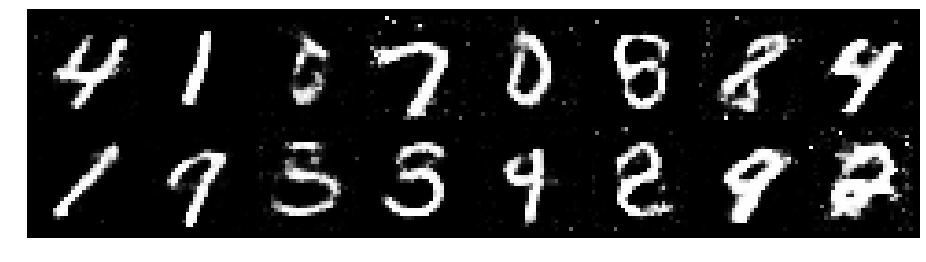

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.2839, Generator Loss: 0.8172
D(x): 0.5671, D(G(z)): 0.4746


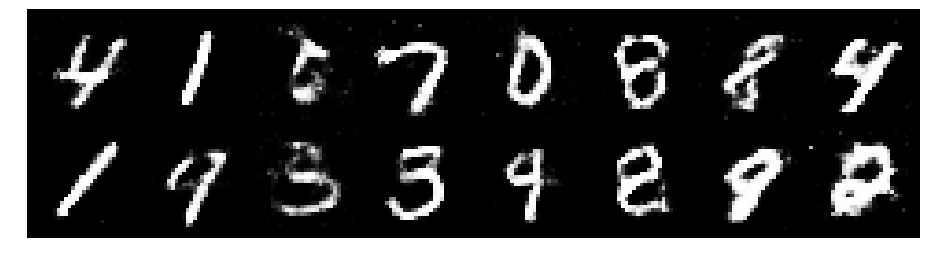

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.3457, Generator Loss: 0.8261
D(x): 0.5230, D(G(z)): 0.4640


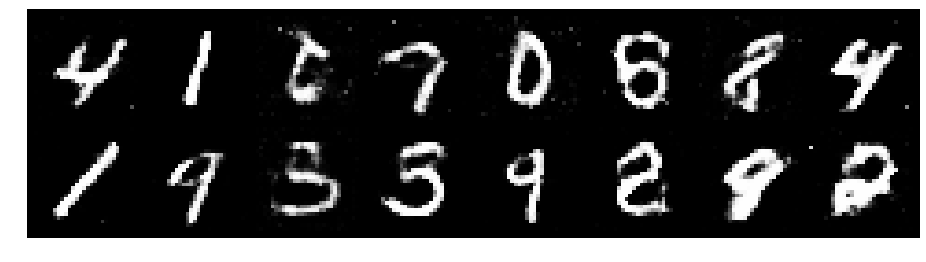

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.4047, Generator Loss: 0.7813
D(x): 0.5707, D(G(z)): 0.5156


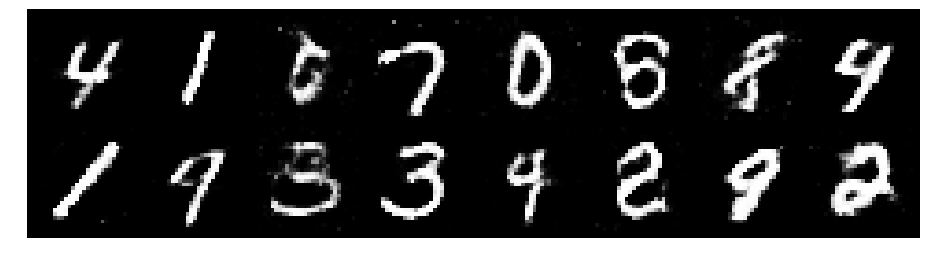

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.4470, Generator Loss: 0.9981
D(x): 0.5722, D(G(z)): 0.5009


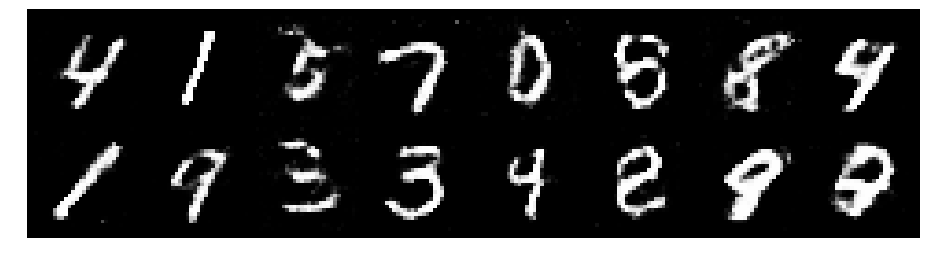

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2918, Generator Loss: 0.8431
D(x): 0.5458, D(G(z)): 0.4653


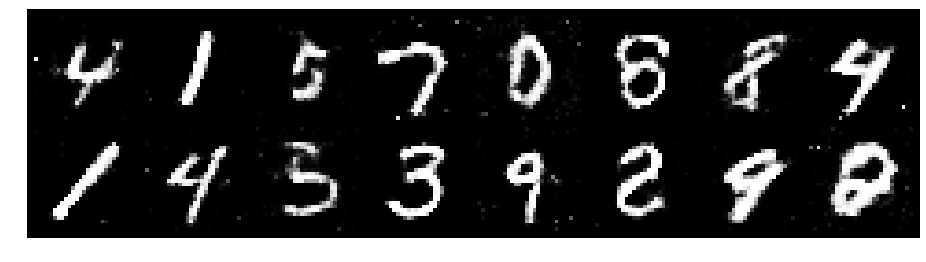

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2502, Generator Loss: 0.9247
D(x): 0.5571, D(G(z)): 0.4430


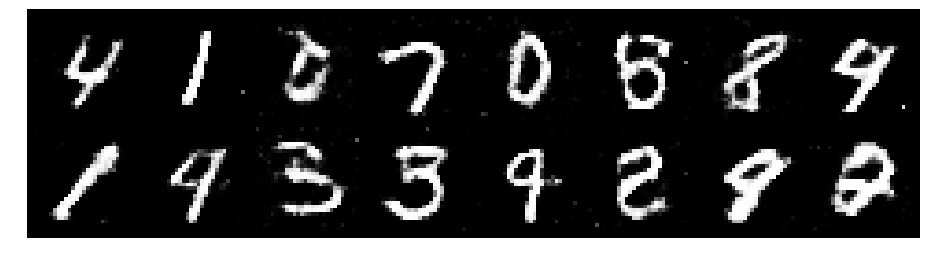

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9614
D(x): 0.5303, D(G(z)): 0.4138


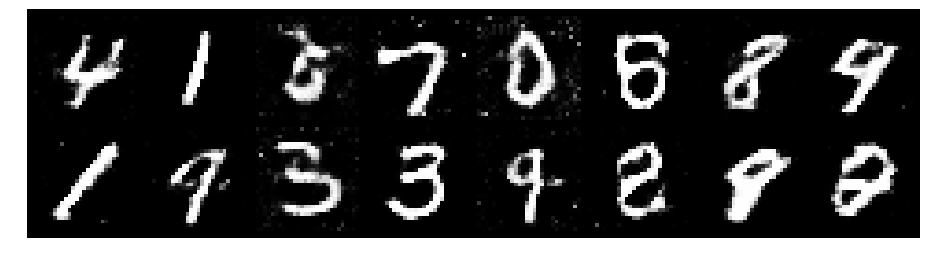

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.3278, Generator Loss: 0.7914
D(x): 0.5359, D(G(z)): 0.4680


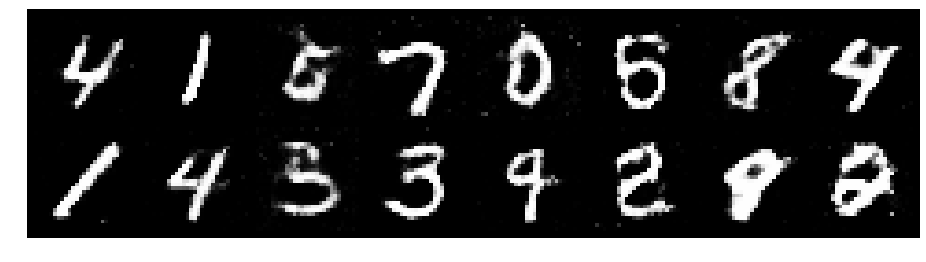

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.2725, Generator Loss: 0.7818
D(x): 0.5694, D(G(z)): 0.4703


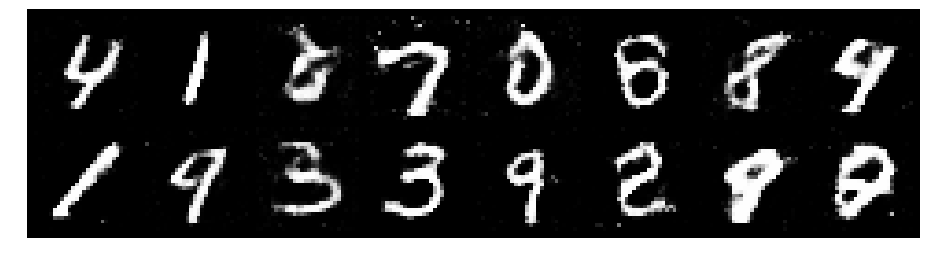

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.2187, Generator Loss: 0.9031
D(x): 0.5824, D(G(z)): 0.4519


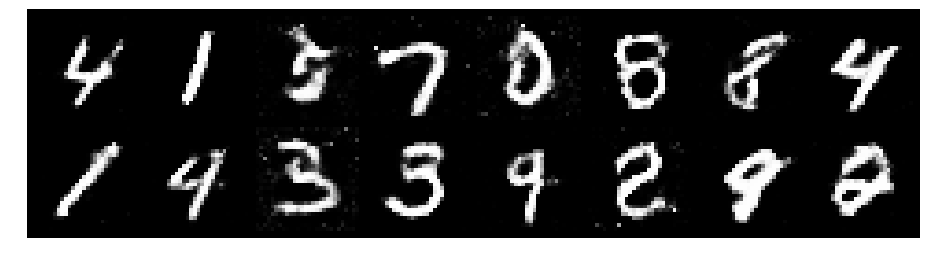

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2215, Generator Loss: 0.9286
D(x): 0.6003, D(G(z)): 0.4349


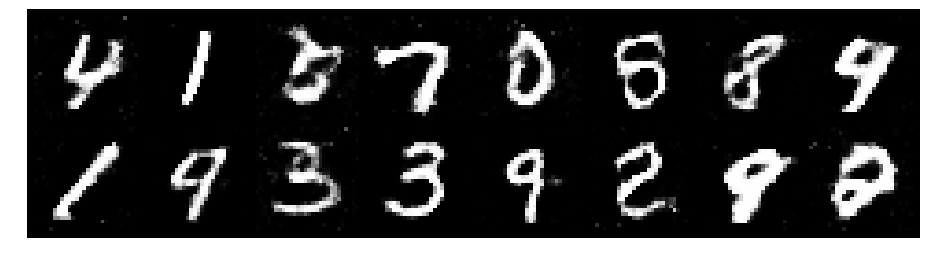

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.3175, Generator Loss: 0.8220
D(x): 0.5985, D(G(z)): 0.4767


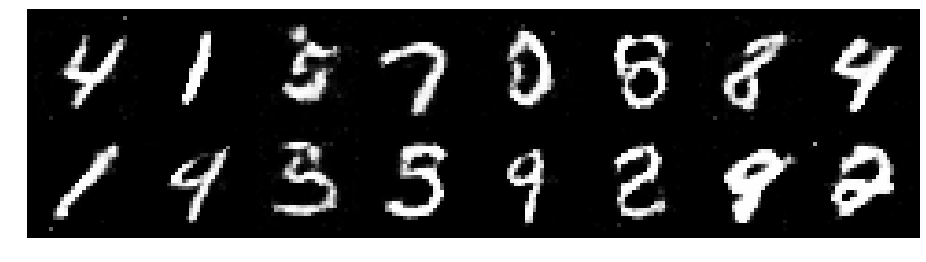

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3593, Generator Loss: 0.8689
D(x): 0.5355, D(G(z)): 0.4529


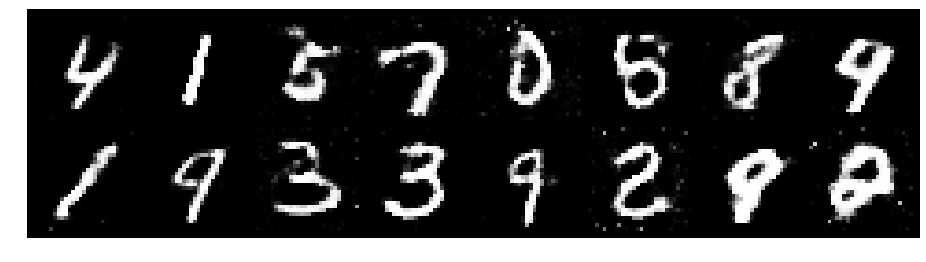

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.2921, Generator Loss: 0.8246
D(x): 0.5591, D(G(z)): 0.4545


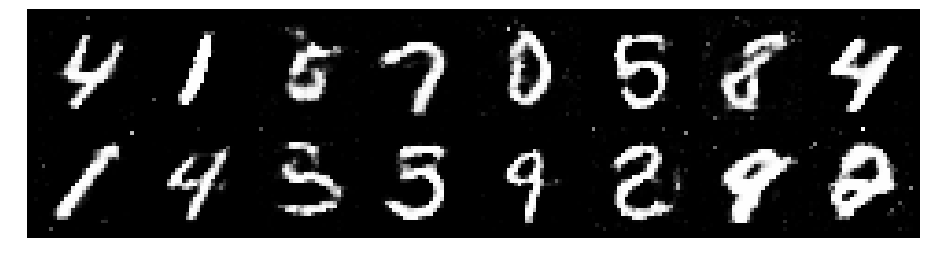

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.2306, Generator Loss: 0.8631
D(x): 0.5795, D(G(z)): 0.4418


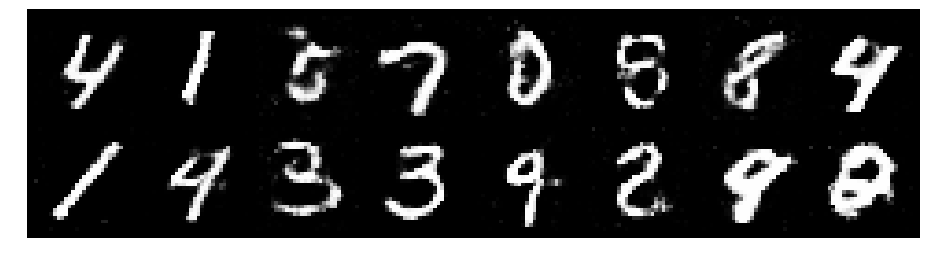

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.2176, Generator Loss: 0.9047
D(x): 0.5689, D(G(z)): 0.4335


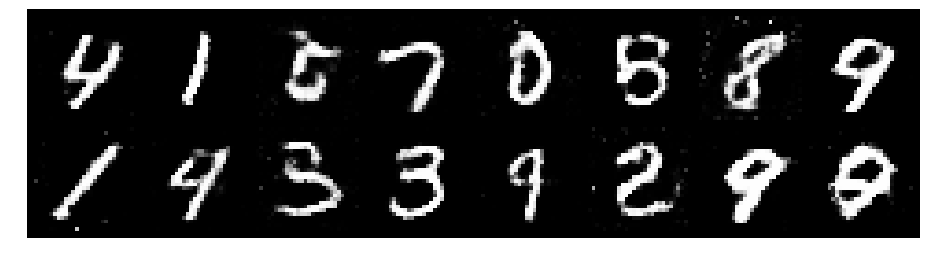

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2542, Generator Loss: 1.0201
D(x): 0.5625, D(G(z)): 0.4439


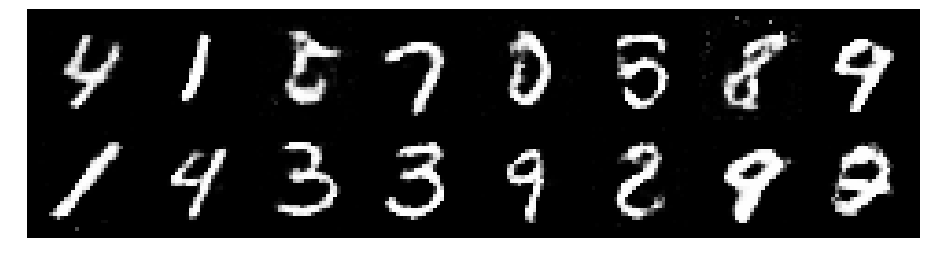

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2414, Generator Loss: 0.9720
D(x): 0.5665, D(G(z)): 0.4212


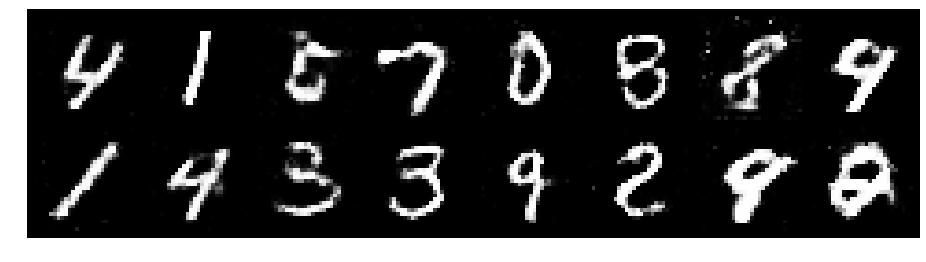

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2056, Generator Loss: 0.9584
D(x): 0.5829, D(G(z)): 0.4425


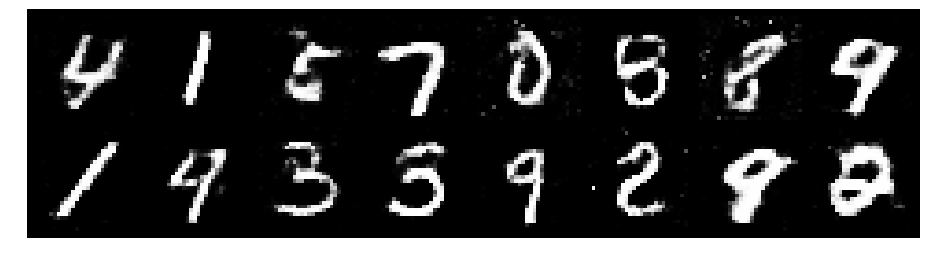

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.3125, Generator Loss: 0.9258
D(x): 0.5405, D(G(z)): 0.4481


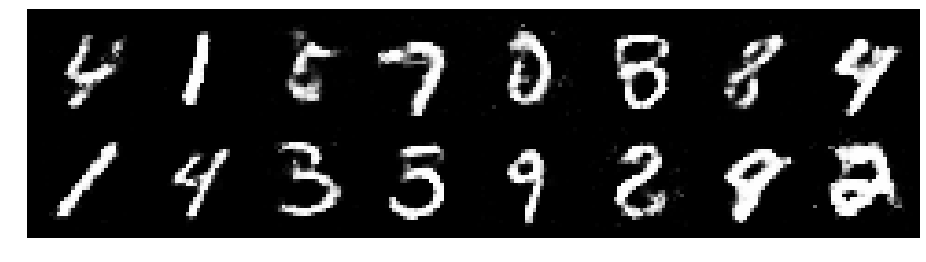

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2824, Generator Loss: 0.7734
D(x): 0.5244, D(G(z)): 0.4163


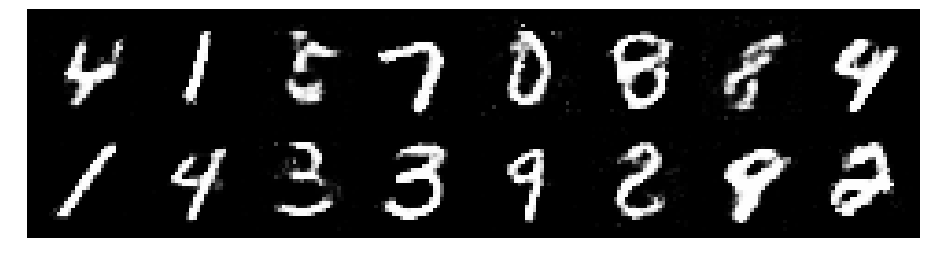

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.4487, Generator Loss: 0.8519
D(x): 0.5372, D(G(z)): 0.4826


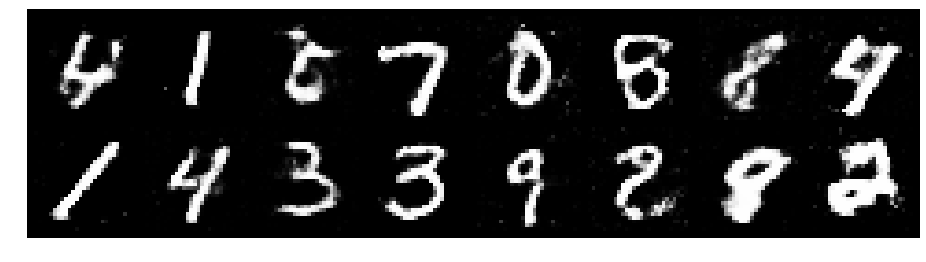

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.3923, Generator Loss: 0.9644
D(x): 0.5330, D(G(z)): 0.4583


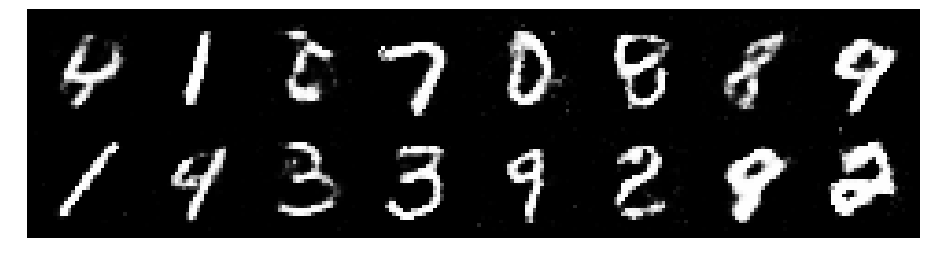

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2461, Generator Loss: 1.0087
D(x): 0.5612, D(G(z)): 0.4212


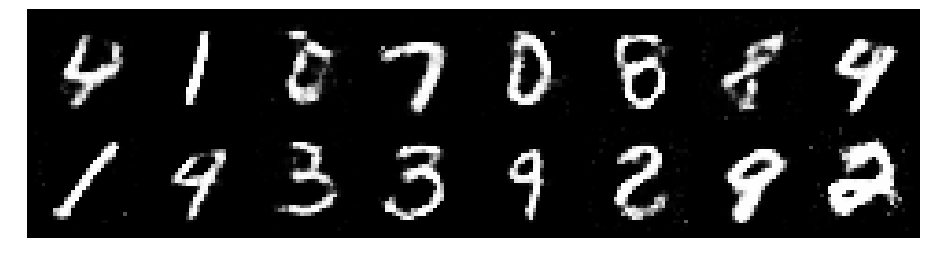

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8756
D(x): 0.5735, D(G(z)): 0.4627


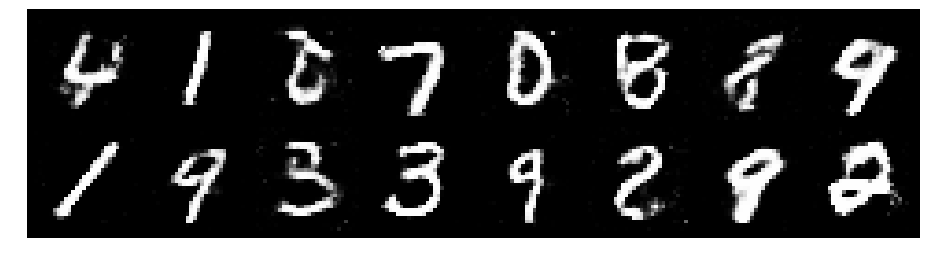

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3458, Generator Loss: 0.7960
D(x): 0.5342, D(G(z)): 0.4737


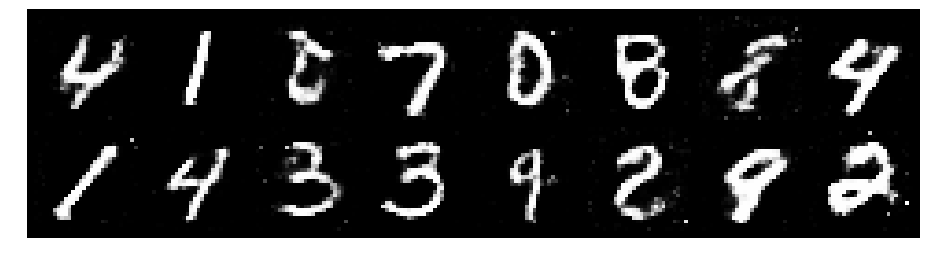

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2388, Generator Loss: 0.9448
D(x): 0.5551, D(G(z)): 0.4434


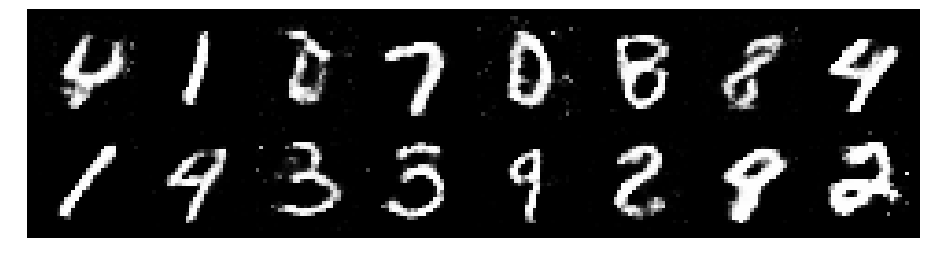

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.3697, Generator Loss: 0.8456
D(x): 0.5350, D(G(z)): 0.4798


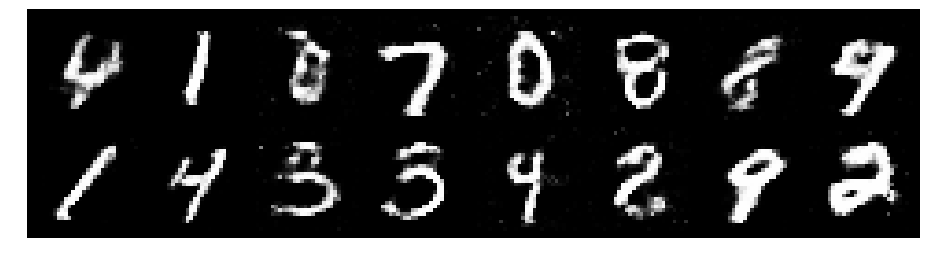

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2382, Generator Loss: 0.8175
D(x): 0.5575, D(G(z)): 0.4330


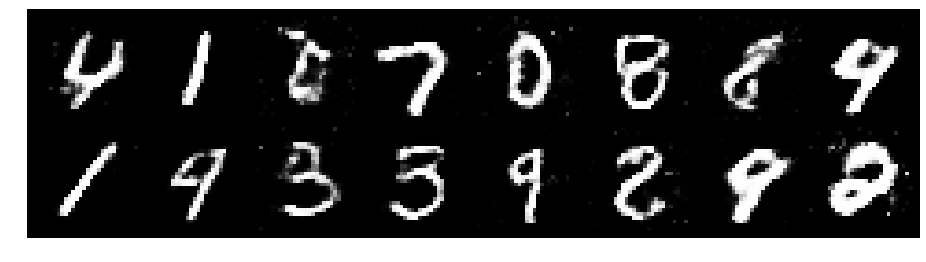

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3422, Generator Loss: 0.7944
D(x): 0.5542, D(G(z)): 0.4749


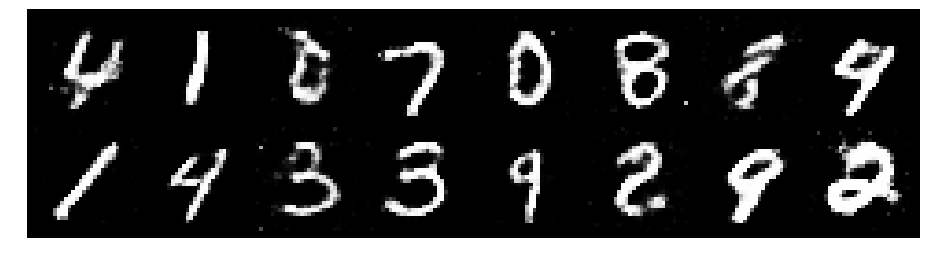

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2752, Generator Loss: 0.8847
D(x): 0.5429, D(G(z)): 0.4291


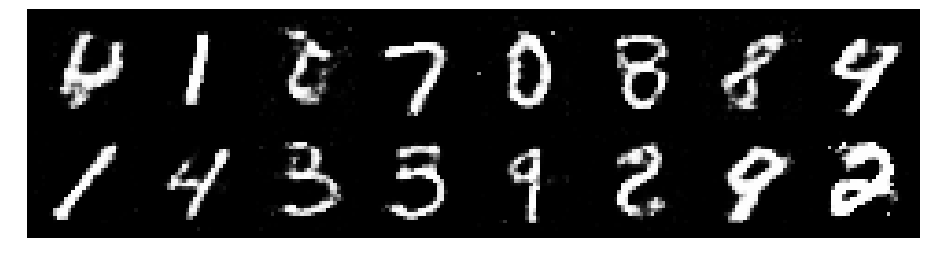

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.1243, Generator Loss: 0.8285
D(x): 0.5812, D(G(z)): 0.4020


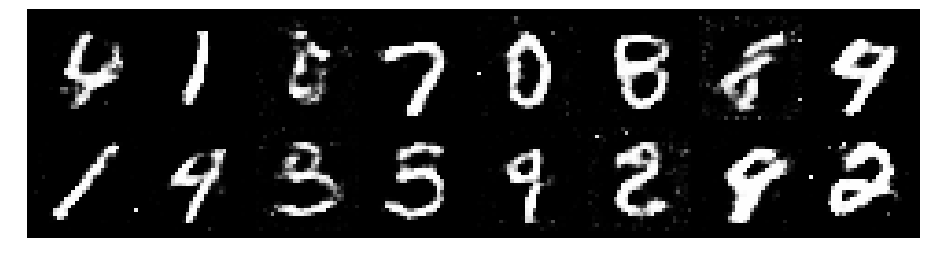

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.3299, Generator Loss: 0.9339
D(x): 0.5040, D(G(z)): 0.4254


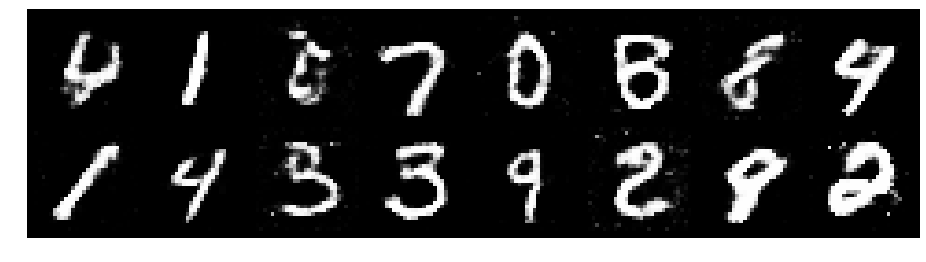

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.3244, Generator Loss: 0.7944
D(x): 0.5513, D(G(z)): 0.4596


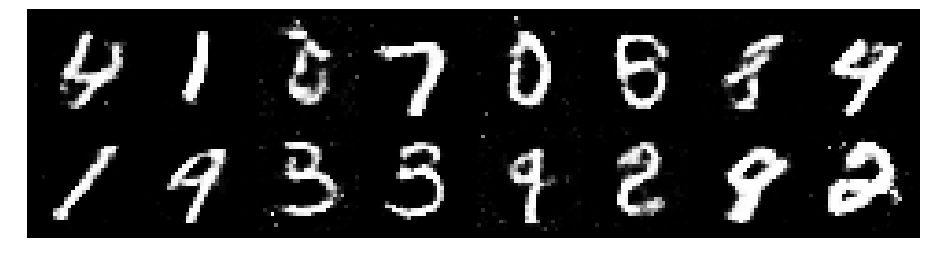

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3064, Generator Loss: 0.8249
D(x): 0.5439, D(G(z)): 0.4558


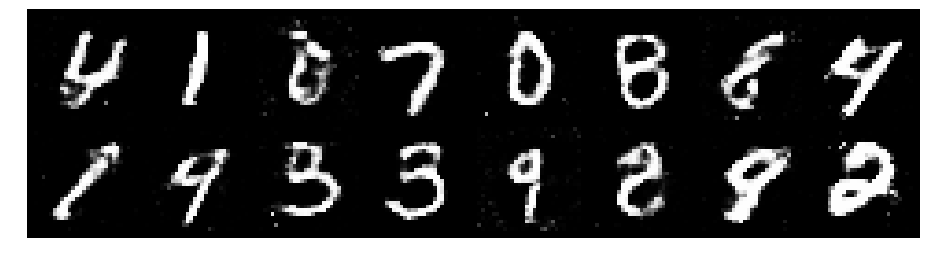

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9109
D(x): 0.5258, D(G(z)): 0.4357


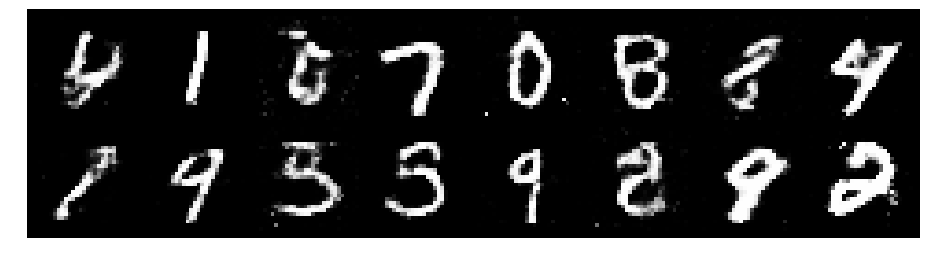

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.3358, Generator Loss: 0.8341
D(x): 0.5364, D(G(z)): 0.4738


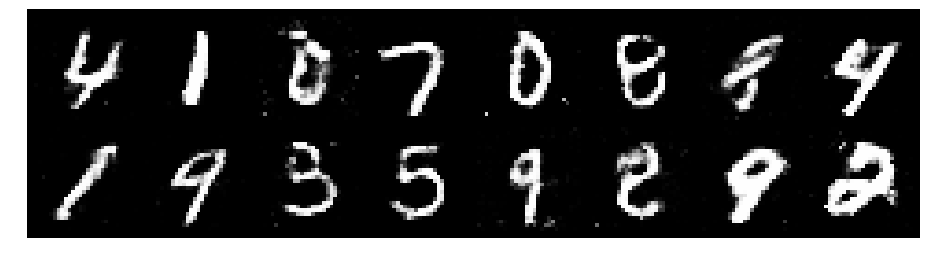

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2111, Generator Loss: 0.7517
D(x): 0.5841, D(G(z)): 0.4533


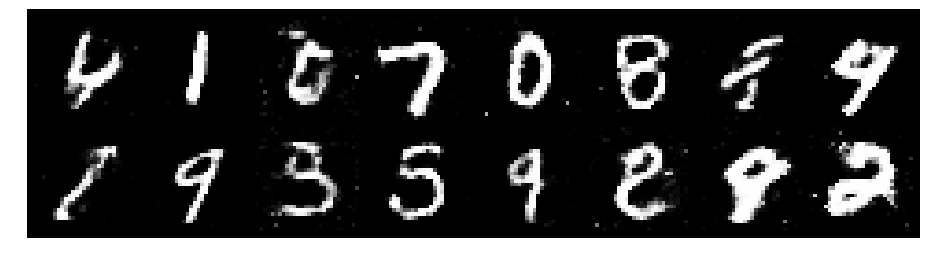

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.2383, Generator Loss: 0.8725
D(x): 0.5523, D(G(z)): 0.4260


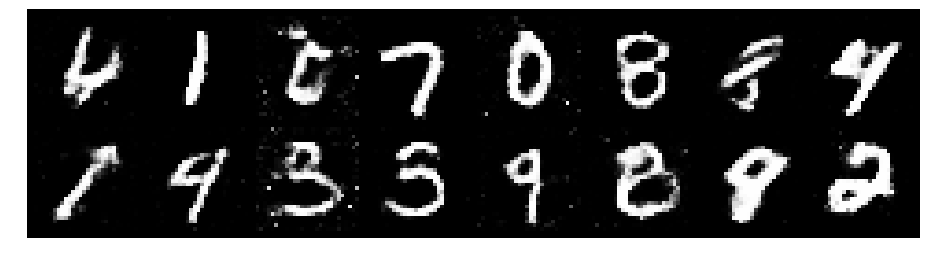

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.1742, Generator Loss: 0.8689
D(x): 0.5947, D(G(z)): 0.4308


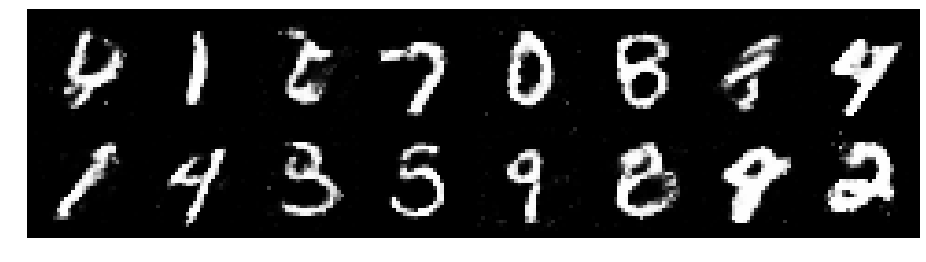

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.4490, Generator Loss: 0.8809
D(x): 0.5054, D(G(z)): 0.4496


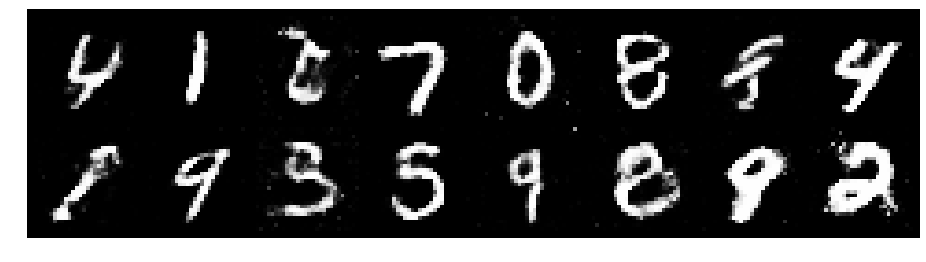

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2794, Generator Loss: 0.9750
D(x): 0.5921, D(G(z)): 0.4736


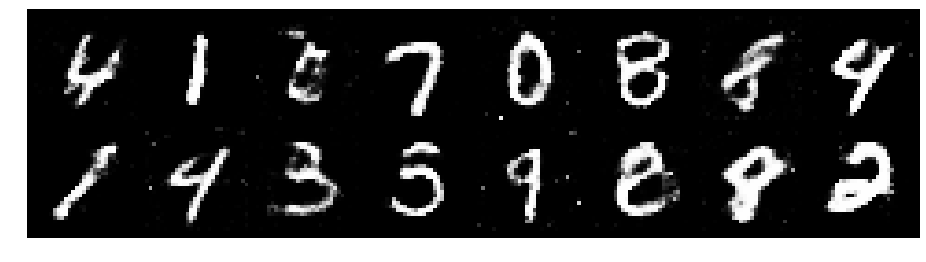

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3250, Generator Loss: 0.8086
D(x): 0.5527, D(G(z)): 0.4767


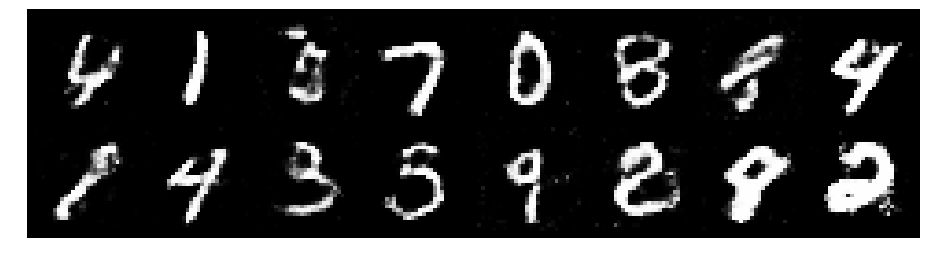

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2332, Generator Loss: 0.8814
D(x): 0.5628, D(G(z)): 0.4321


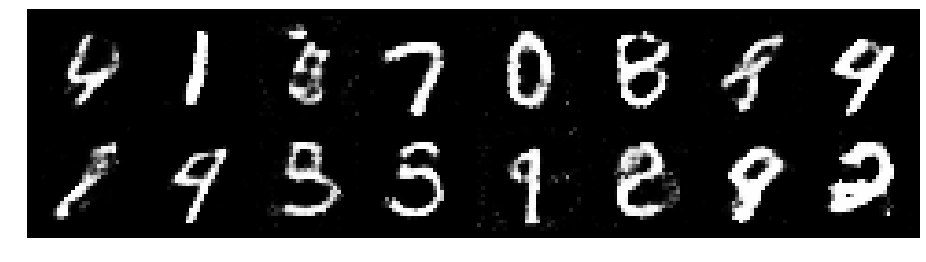

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2805, Generator Loss: 0.8027
D(x): 0.5345, D(G(z)): 0.4375


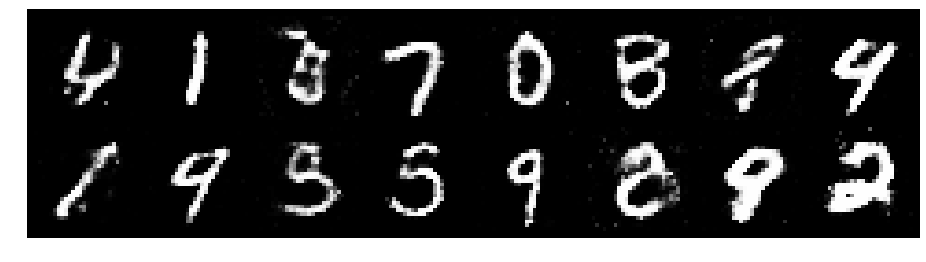

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.2672, Generator Loss: 0.8715
D(x): 0.5465, D(G(z)): 0.4454


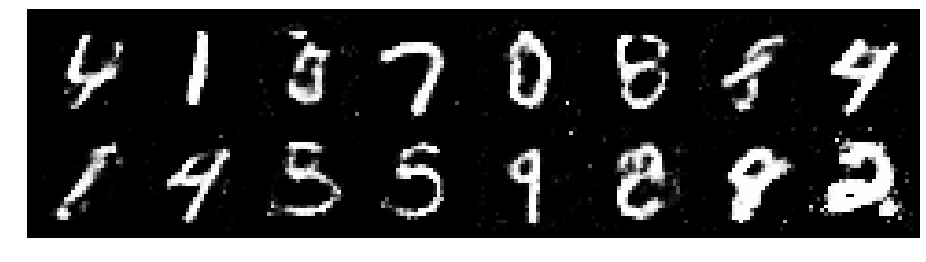

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.3058, Generator Loss: 0.8526
D(x): 0.5428, D(G(z)): 0.4595


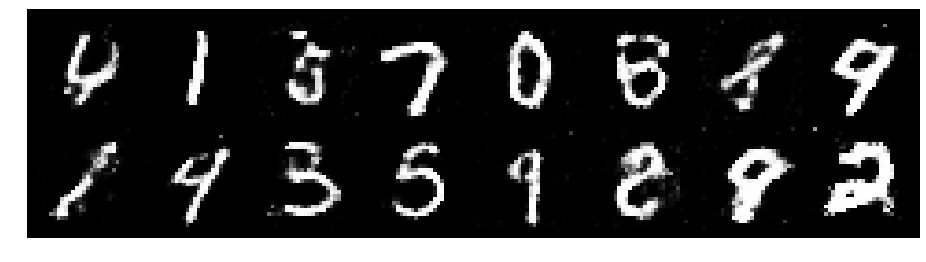

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8982
D(x): 0.5538, D(G(z)): 0.4599


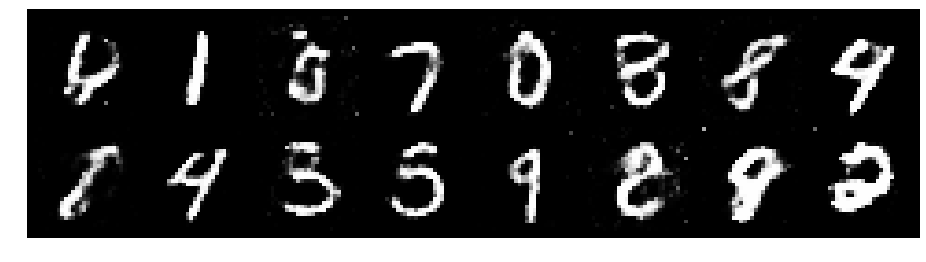

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.3789, Generator Loss: 0.9098
D(x): 0.5353, D(G(z)): 0.4757


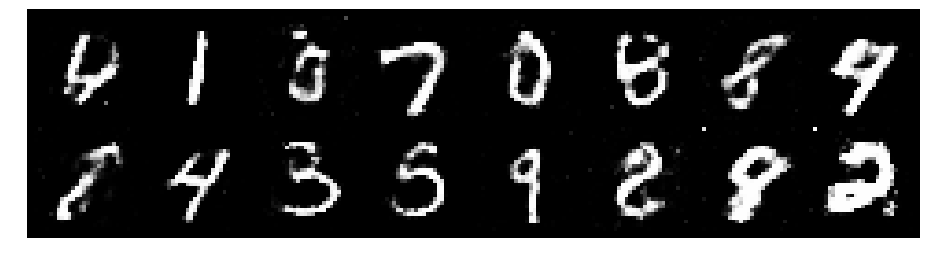

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.3779, Generator Loss: 0.7868
D(x): 0.5472, D(G(z)): 0.4975


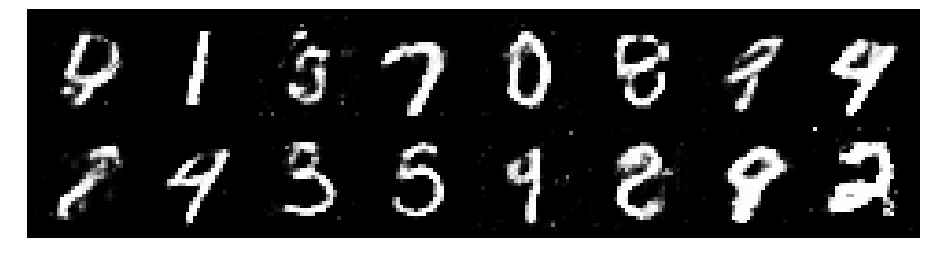

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3350, Generator Loss: 0.7935
D(x): 0.5139, D(G(z)): 0.4582


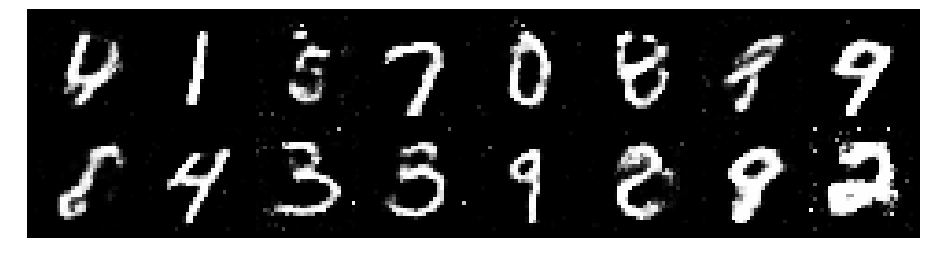

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.2770, Generator Loss: 0.8605
D(x): 0.5428, D(G(z)): 0.4484


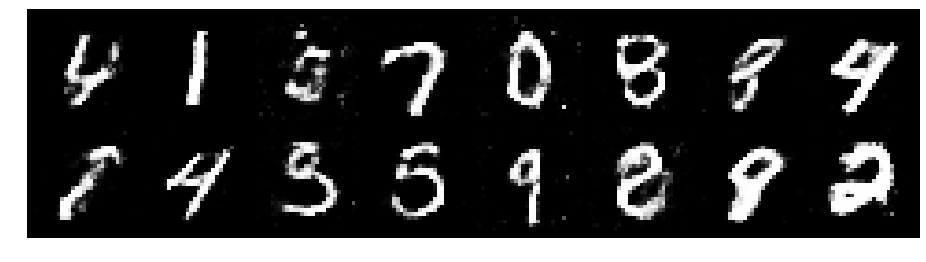

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.2542, Generator Loss: 0.8595
D(x): 0.5485, D(G(z)): 0.4443


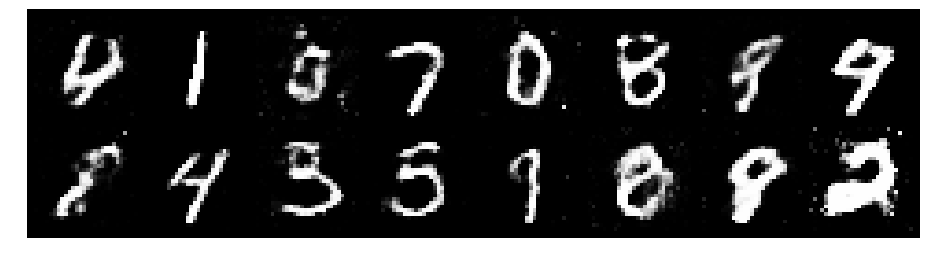

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3309, Generator Loss: 0.9181
D(x): 0.5238, D(G(z)): 0.4374


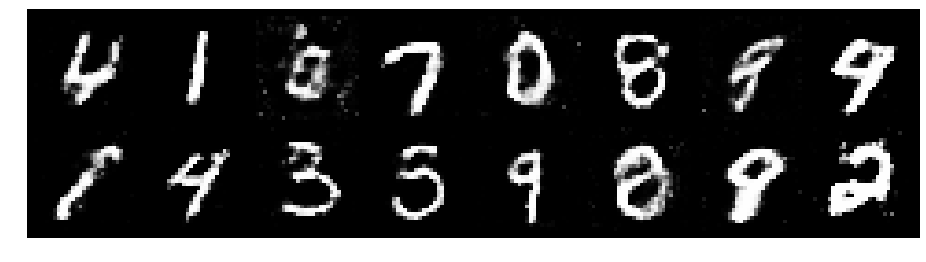

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.4430, Generator Loss: 0.7928
D(x): 0.5079, D(G(z)): 0.4803


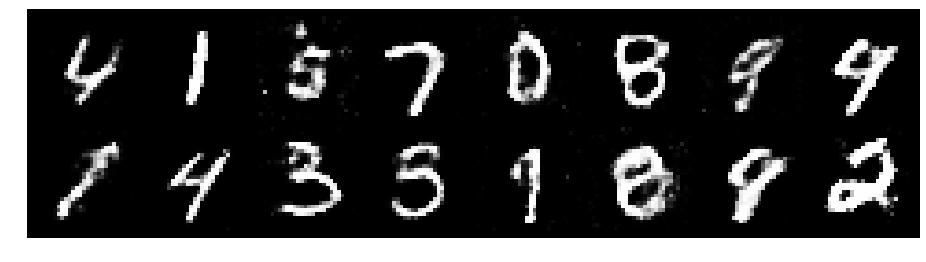

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.3400, Generator Loss: 0.8126
D(x): 0.5590, D(G(z)): 0.4872


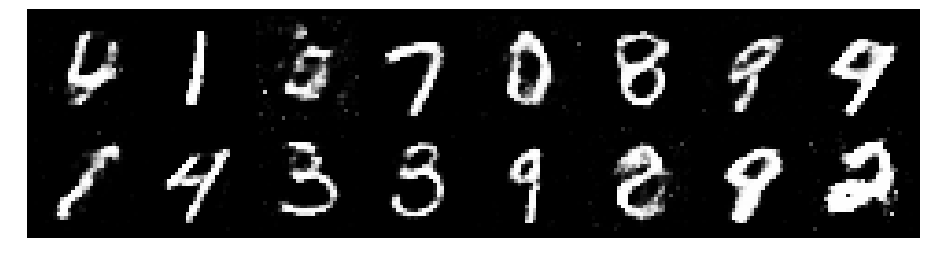

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.4060, Generator Loss: 0.9836
D(x): 0.5012, D(G(z)): 0.4500


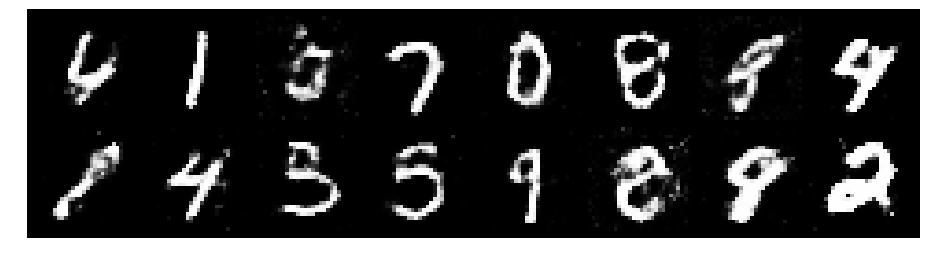

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.3492, Generator Loss: 0.9033
D(x): 0.5130, D(G(z)): 0.4394


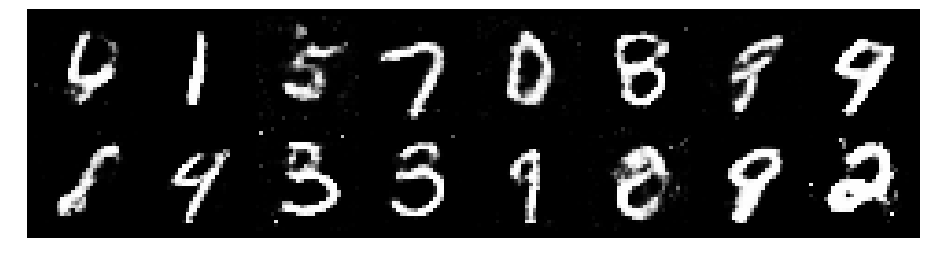

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.3154, Generator Loss: 0.9409
D(x): 0.5227, D(G(z)): 0.4168


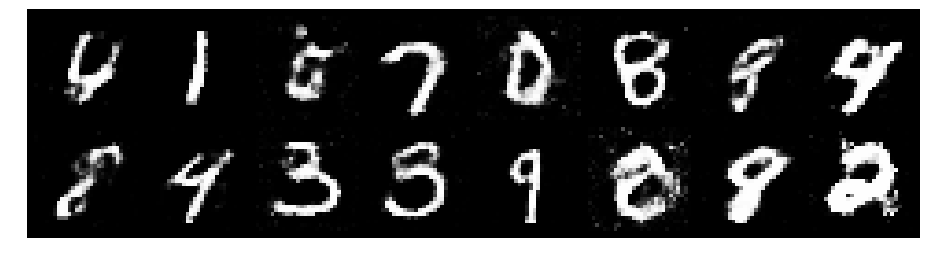

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2573, Generator Loss: 0.9259
D(x): 0.5672, D(G(z)): 0.4530


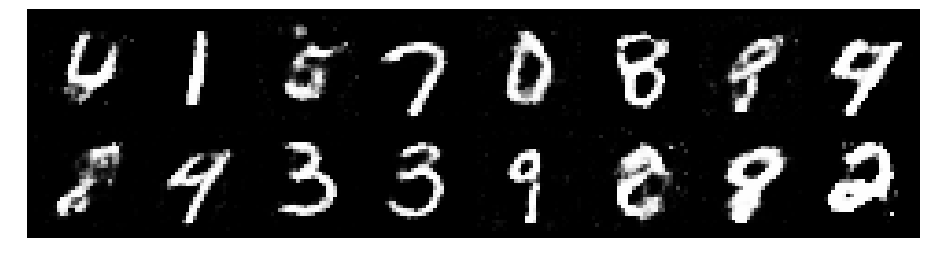

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.1828, Generator Loss: 0.8828
D(x): 0.6007, D(G(z)): 0.4465


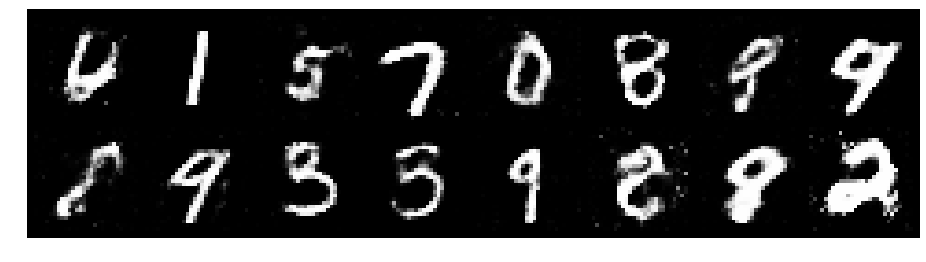

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2800, Generator Loss: 0.9767
D(x): 0.5334, D(G(z)): 0.4277


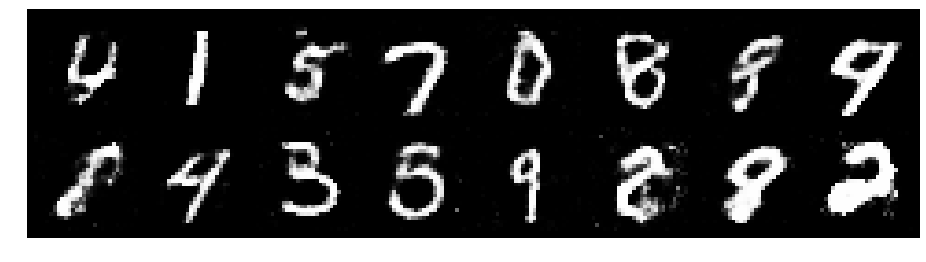

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2044, Generator Loss: 0.8891
D(x): 0.5607, D(G(z)): 0.4284


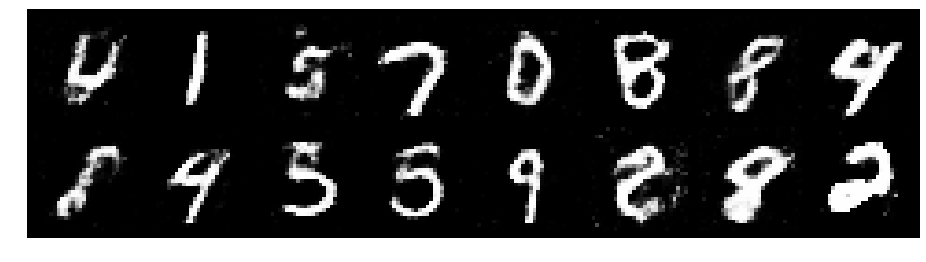

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.1670, Generator Loss: 0.9255
D(x): 0.5777, D(G(z)): 0.3963


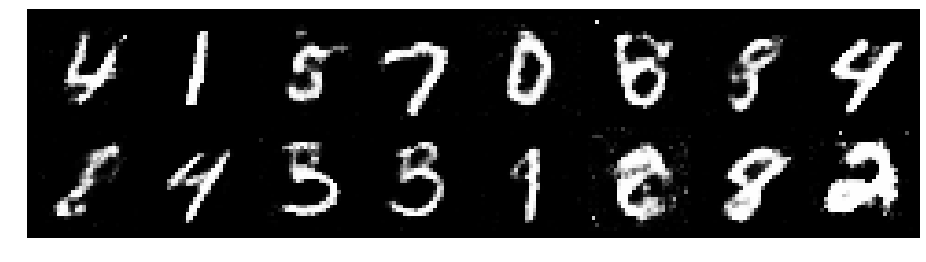

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2772, Generator Loss: 0.8274
D(x): 0.5584, D(G(z)): 0.4644


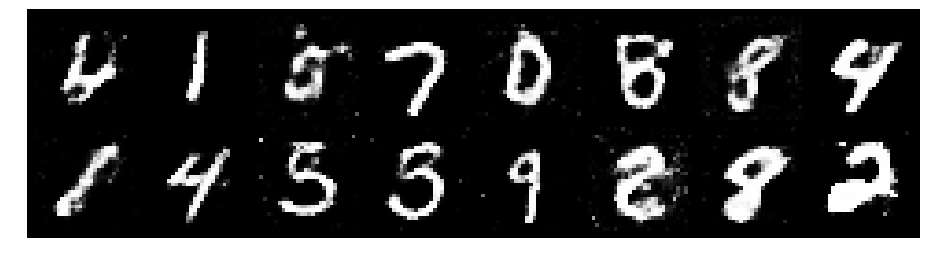

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2251, Generator Loss: 0.9029
D(x): 0.5854, D(G(z)): 0.4451


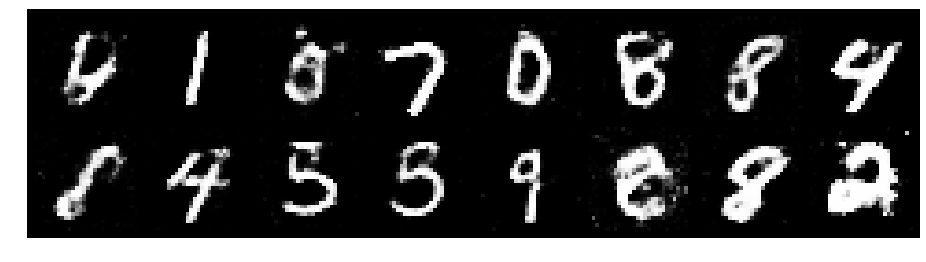

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3053, Generator Loss: 0.8588
D(x): 0.5422, D(G(z)): 0.4462


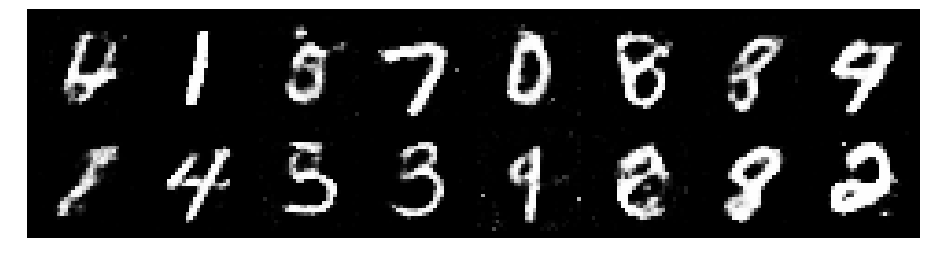

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2792, Generator Loss: 0.8258
D(x): 0.5686, D(G(z)): 0.4811


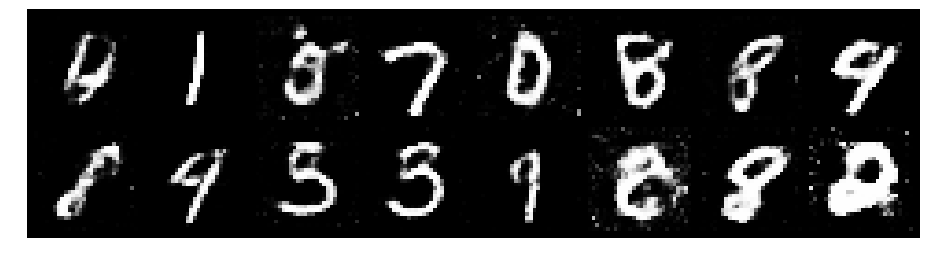

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2715, Generator Loss: 0.8181
D(x): 0.5555, D(G(z)): 0.4555


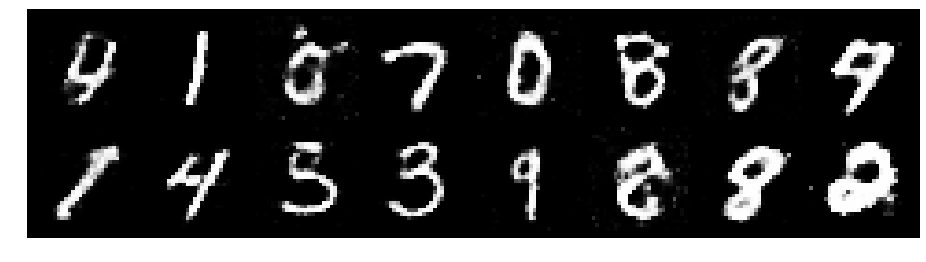

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.1712, Generator Loss: 0.9455
D(x): 0.5631, D(G(z)): 0.3989


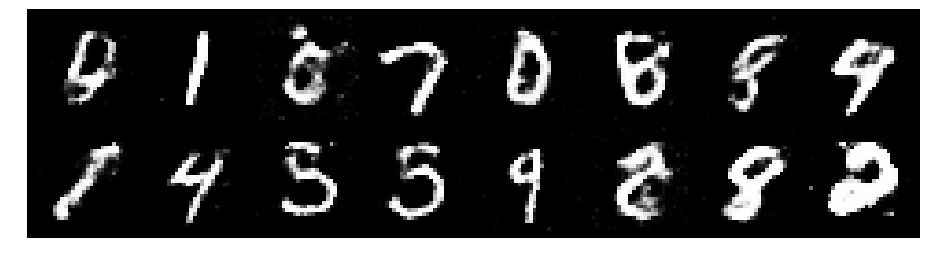

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2846, Generator Loss: 0.8099
D(x): 0.5705, D(G(z)): 0.4810


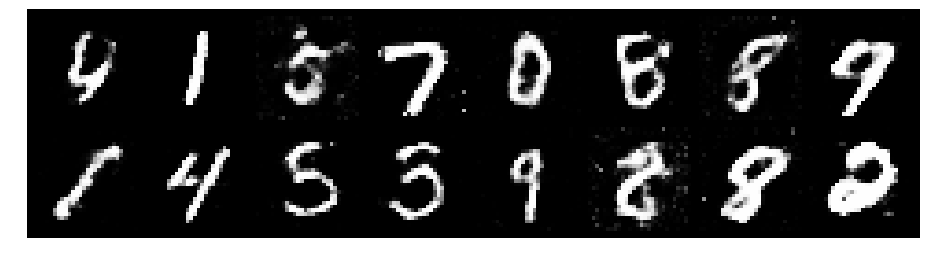

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.4035, Generator Loss: 0.7085
D(x): 0.5708, D(G(z)): 0.5340


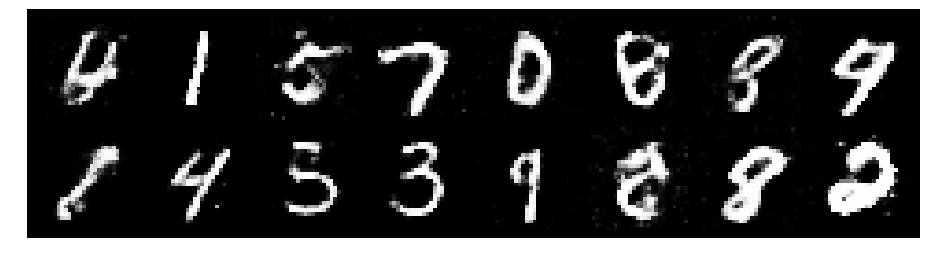

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.3820, Generator Loss: 0.8538
D(x): 0.5015, D(G(z)): 0.4611


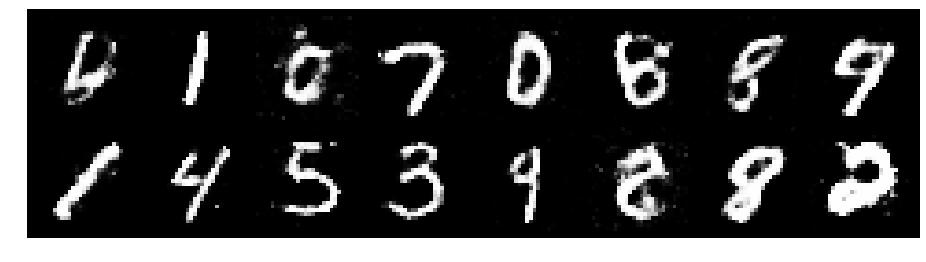

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.1899, Generator Loss: 0.8923
D(x): 0.5833, D(G(z)): 0.4436


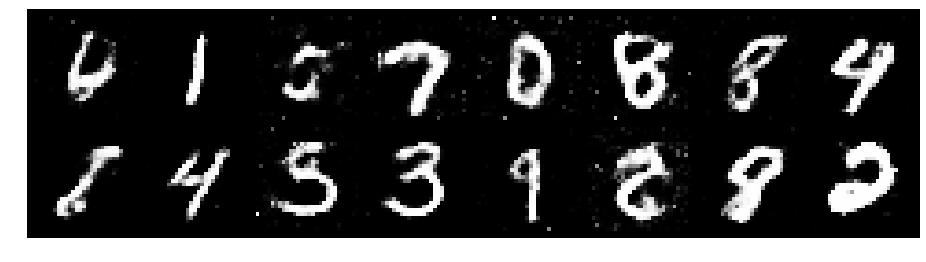

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2984, Generator Loss: 0.8751
D(x): 0.5416, D(G(z)): 0.4542


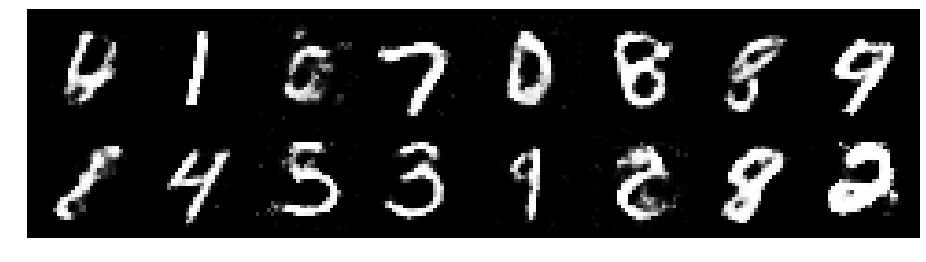

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.1601, Generator Loss: 1.0613
D(x): 0.5741, D(G(z)): 0.3944


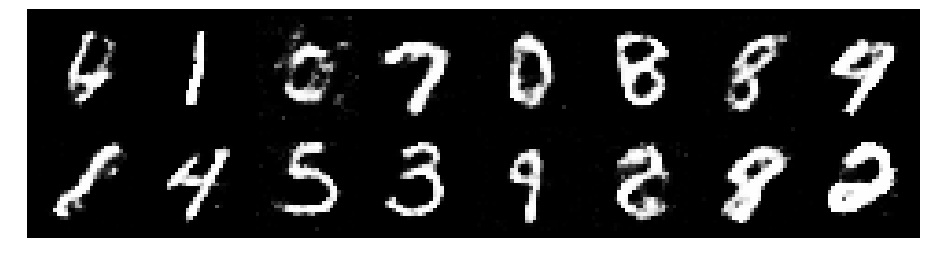

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2018, Generator Loss: 0.9293
D(x): 0.5068, D(G(z)): 0.3629


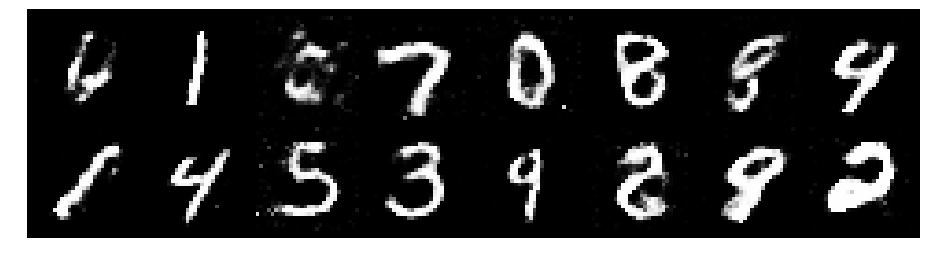

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.1595, Generator Loss: 1.0262
D(x): 0.5861, D(G(z)): 0.4166


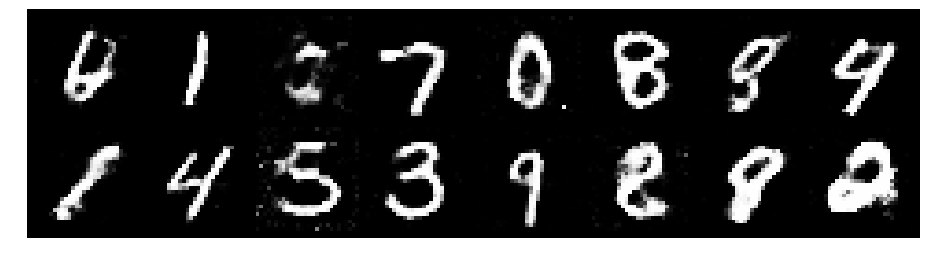

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2517, Generator Loss: 0.8336
D(x): 0.5958, D(G(z)): 0.4469


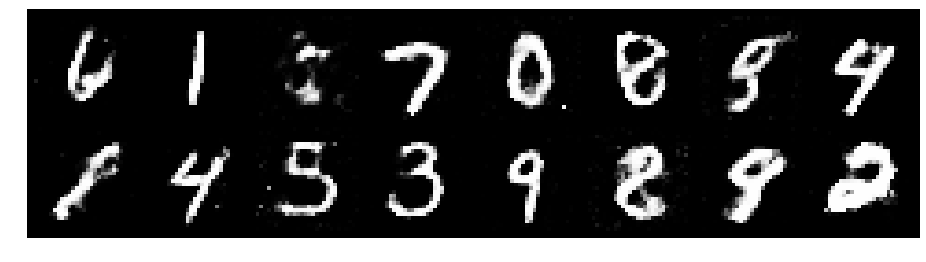

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.2490, Generator Loss: 1.0242
D(x): 0.5700, D(G(z)): 0.4260


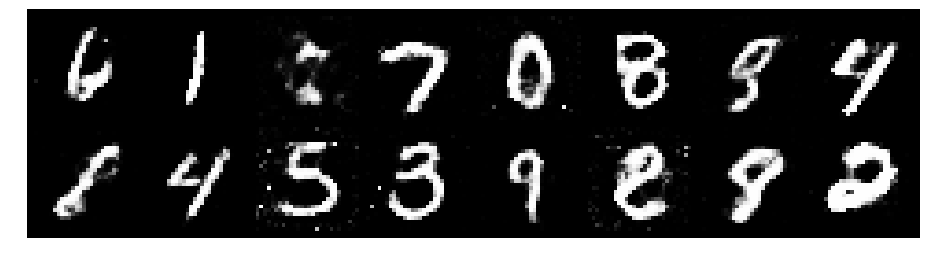

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3422, Generator Loss: 0.8351
D(x): 0.5736, D(G(z)): 0.4743


In [ ]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')

# Total number of epochs to train
num_epochs = 200

for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)

        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))

        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()

        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator

        # Generate fake data
        fake_data = generator(noise(N))

        # Train G
        g_error = train_generator(g_optimizer, fake_data)

        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)

        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data

            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )
